In [2]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/mobile-price-classification/train.csv
/kaggle/input/mobile-price-classification/test.csv


## **DATA CARD**
**relation between features of a mobile phone(eg:- RAM,Internal Memory etc) and its selling price**.

**In this problem you do not have to predict actual price but a price range indicating how high the price is**

In [3]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
import json

In [4]:
df_test=pd.read_csv('/kaggle/input/mobile-price-classification/test.csv')
df_test

,id,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,...,pc,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi
0,1,1043,1,1.8,1,14,0,5,0.1,193,...,16,226,1412,3476,12,7,2,0,1,0
1,2,841,1,0.5,1,4,1,61,0.8,191,...,12,746,857,3895,6,0,7,1,0,0
2,3,1807,1,2.8,0,1,0,27,0.9,186,...,4,1270,1366,2396,17,10,10,0,1,1
3,4,1546,0,0.5,1,18,1,25,0.5,96,...,20,295,1752,3893,10,0,7,1,1,0
4,5,1434,0,1.4,0,11,1,49,0.5,108,...,18,749,810,1773,15,8,7,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,996,1700,1,1.9,0,0,1,54,0.5,170,...,17,644,913,2121,14,8,15,1,1,0
996,997,609,0,1.8,1,0,0,13,0.9,186,...,2,1152,1632,1933,8,1,19,0,1,1
997,998,1185,0,1.4,0,1,1,8,0.5,80,...,12,477,825,1223,5,0,14,1,0,0
998,999,1533,1,0.5,1,0,0,50,0.4,171,...,12,38,832,2509,15,11,6,0,1,0


#  NOTE!!  THER İS  X_TEST_CSV   BUT  NOT  Y_TEST İS GİVEN!!  SO TRAİN DATA İS SPLİT TO TEST_AND_TRAİN !!

In [5]:
df=pd.read_csv('/kaggle/input/mobile-price-classification/train.csv')
df.head()

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,...,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
0,842,0,2.2,0,1,0,7,0.6,188,2,...,20,756,2549,9,7,19,0,0,1,1
1,1021,1,0.5,1,0,1,53,0.7,136,3,...,905,1988,2631,17,3,7,1,1,0,2
2,563,1,0.5,1,2,1,41,0.9,145,5,...,1263,1716,2603,11,2,9,1,1,0,2
3,615,1,2.5,0,0,0,10,0.8,131,6,...,1216,1786,2769,16,8,11,1,0,0,2
4,1821,1,1.2,0,13,1,44,0.6,141,2,...,1208,1212,1411,8,2,15,1,1,0,1


In [40]:
df2=pd.read_csv('/kaggle/input/mobile-price-classification/train.csv')
df2

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,...,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
0,842,0,2.2,0,1,0,7,0.6,188,2,...,20,756,2549,9,7,19,0,0,1,1
1,1021,1,0.5,1,0,1,53,0.7,136,3,...,905,1988,2631,17,3,7,1,1,0,2
2,563,1,0.5,1,2,1,41,0.9,145,5,...,1263,1716,2603,11,2,9,1,1,0,2
3,615,1,2.5,0,0,0,10,0.8,131,6,...,1216,1786,2769,16,8,11,1,0,0,2
4,1821,1,1.2,0,13,1,44,0.6,141,2,...,1208,1212,1411,8,2,15,1,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,794,1,0.5,1,0,1,2,0.8,106,6,...,1222,1890,668,13,4,19,1,1,0,0
1996,1965,1,2.6,1,0,0,39,0.2,187,4,...,915,1965,2032,11,10,16,1,1,1,2
1997,1911,0,0.9,1,1,1,36,0.7,108,8,...,868,1632,3057,9,1,5,1,1,0,3
1998,1512,0,0.9,0,4,1,46,0.1,145,5,...,336,670,869,18,10,19,1,1,1,0


In [7]:
df=pd.read_csv('/kaggle/input/mobile-price-classification/train.csv')
df

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,...,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
0,842,0,2.2,0,1,0,7,0.6,188,2,...,20,756,2549,9,7,19,0,0,1,1
1,1021,1,0.5,1,0,1,53,0.7,136,3,...,905,1988,2631,17,3,7,1,1,0,2
2,563,1,0.5,1,2,1,41,0.9,145,5,...,1263,1716,2603,11,2,9,1,1,0,2
3,615,1,2.5,0,0,0,10,0.8,131,6,...,1216,1786,2769,16,8,11,1,0,0,2
4,1821,1,1.2,0,13,1,44,0.6,141,2,...,1208,1212,1411,8,2,15,1,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,794,1,0.5,1,0,1,2,0.8,106,6,...,1222,1890,668,13,4,19,1,1,0,0
1996,1965,1,2.6,1,0,0,39,0.2,187,4,...,915,1965,2032,11,10,16,1,1,1,2
1997,1911,0,0.9,1,1,1,36,0.7,108,8,...,868,1632,3057,9,1,5,1,1,0,3
1998,1512,0,0.9,0,4,1,46,0.1,145,5,...,336,670,869,18,10,19,1,1,1,0


In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2000 entries, 0 to 1999
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   battery_power  2000 non-null   int64  
 1   blue           2000 non-null   int64  
 2   clock_speed    2000 non-null   float64
 3   dual_sim       2000 non-null   int64  
 4   fc             2000 non-null   int64  
 5   four_g         2000 non-null   int64  
 6   int_memory     2000 non-null   int64  
 7   m_dep          2000 non-null   float64
 8   mobile_wt      2000 non-null   int64  
 9   n_cores        2000 non-null   int64  
 10  pc             2000 non-null   int64  
 11  px_height      2000 non-null   int64  
 12  px_width       2000 non-null   int64  
 13  ram            2000 non-null   int64  
 14  sc_h           2000 non-null   int64  
 15  sc_w           2000 non-null   int64  
 16  talk_time      2000 non-null   int64  
 17  three_g        2000 non-null   int64  
 18  touch_sc

In [9]:
df.describe()

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,...,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
count,2000.000000,2000.0000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,...,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000
mean,1238.518500,0.4950,1.522250,0.509500,4.309500,0.521500,32.046500,0.501750,140.249000,4.520500,...,645.108000,1251.515500,2124.213000,12.306500,5.767000,11.011000,0.761500,0.503000,0.507000,1.500000
std,439.418206,0.5001,0.816004,0.500035,4.341444,0.499662,18.145715,0.288416,35.399655,2.287837,...,443.780811,432.199447,1084.732044,4.213245,4.356398,5.463955,0.426273,0.500116,0.500076,1.118314
min,501.000000,0.0000,0.500000,0.000000,0.000000,0.000000,2.000000,0.100000,80.000000,1.000000,...,0.000000,500.000000,256.000000,5.000000,0.000000,2.000000,0.000000,0.000000,0.000000,0.000000
25%,851.750000,0.0000,0.700000,0.000000,1.000000,0.000000,16.000000,0.200000,109.000000,3.000000,...,282.750000,874.750000,1207.500000,9.000000,2.000000,6.000000,1.000000,0.000000,0.000000,0.750000
50%,1226.000000,0.0000,1.500000,1.000000,3.000000,1.000000,32.000000,0.500000,141.000000,4.000000,...,564.000000,1247.000000,2146.500000,12.000000,5.000000,11.000000,1.000000,1.000000,1.000000,1.500000
75%,1615.250000,1.0000,2.200000,1.000000,7.000000,1.000000,48.000000,0.800000,170.000000,7.000000,...,947.250000,1633.000000,3064.500000,16.000000,9.000000,16.000000,1.000000,1.000000,1.000000,2.250000
max,1998.000000,1.0000,3.000000,1.000000,19.000000,1.000000,64.000000,1.000000,200.000000,8.000000,...,1960.000000,1998.000000,3998.000000,19.000000,18.000000,20.000000,1.000000,1.000000,1.000000,3.000000


In [10]:
df.isna().sum()

battery_power    0
blue             0
clock_speed      0
dual_sim         0
fc               0
four_g           0
int_memory       0
m_dep            0
mobile_wt        0
n_cores          0
pc               0
px_height        0
px_width         0
ram              0
sc_h             0
sc_w             0
talk_time        0
three_g          0
touch_screen     0
wifi             0
price_range      0
dtype: int64

In [11]:
for col in df.columns:
    if df[col].dtype==np.int64:
        df[col]=df[col].astype('int16')
        

In [12]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2000 entries, 0 to 1999
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   battery_power  2000 non-null   int16  
 1   blue           2000 non-null   int16  
 2   clock_speed    2000 non-null   float64
 3   dual_sim       2000 non-null   int16  
 4   fc             2000 non-null   int16  
 5   four_g         2000 non-null   int16  
 6   int_memory     2000 non-null   int16  
 7   m_dep          2000 non-null   float64
 8   mobile_wt      2000 non-null   int16  
 9   n_cores        2000 non-null   int16  
 10  pc             2000 non-null   int16  
 11  px_height      2000 non-null   int16  
 12  px_width       2000 non-null   int16  
 13  ram            2000 non-null   int16  
 14  sc_h           2000 non-null   int16  
 15  sc_w           2000 non-null   int16  
 16  talk_time      2000 non-null   int16  
 17  three_g        2000 non-null   int16  
 18  touch_sc

In [13]:
df

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,...,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
0,842,0,2.2,0,1,0,7,0.6,188,2,...,20,756,2549,9,7,19,0,0,1,1
1,1021,1,0.5,1,0,1,53,0.7,136,3,...,905,1988,2631,17,3,7,1,1,0,2
2,563,1,0.5,1,2,1,41,0.9,145,5,...,1263,1716,2603,11,2,9,1,1,0,2
3,615,1,2.5,0,0,0,10,0.8,131,6,...,1216,1786,2769,16,8,11,1,0,0,2
4,1821,1,1.2,0,13,1,44,0.6,141,2,...,1208,1212,1411,8,2,15,1,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,794,1,0.5,1,0,1,2,0.8,106,6,...,1222,1890,668,13,4,19,1,1,0,0
1996,1965,1,2.6,1,0,0,39,0.2,187,4,...,915,1965,2032,11,10,16,1,1,1,2
1997,1911,0,0.9,1,1,1,36,0.7,108,8,...,868,1632,3057,9,1,5,1,1,0,3
1998,1512,0,0.9,0,4,1,46,0.1,145,5,...,336,670,869,18,10,19,1,1,1,0


In [30]:
dir int?

Init signature: int(self, /, *args, **kwargs)
Docstring:     
int([x]) -> integer
int(x, base=10) -> integer

Convert a number or string to an integer, or return 0 if no arguments
are given.  If x is a number, return x.__int__().  For floating point
numbers, this truncates towards zero.

If x is not a number or if base is given, then x must be a string,
bytes, or bytearray instance representing an integer literal in the
given base.  The literal can be preceded by '+' or '-' and be surrounded
by whitespace.  The base defaults to 10.  Valid bases are 0 and 2-36.
Base 0 means to interpret the base from the string as an integer literal.
>>> int('0b100', base=0)
4
Type:           type
Subclasses:     bool, IntEnum, IntFlag, _NamedIntConstant, _CacheHashWrapper, _InitialMetadataFlags, symbol


In [14]:
a=df['battery_power'].dtype
a

dtype('int16')

In [15]:
cols=df.columns
for col in cols:
    (df
    .assign(col=df[col].astype([lambda x: df['x'].astype('int16') if  df['x'].dtype==dtype('int64') else df['x'].dtype==dtype('int64')])
    )
    )

TypeError: Field elements must be 2- or 3-tuples, got '<function <lambda> at 0x7fcfbe5d7710>'

In [16]:

import matplotlib.pyplot as plt


In [17]:
df.columns

Index(['battery_power', 'blue', 'clock_speed', 'dual_sim', 'fc', 'four_g',
       'int_memory', 'm_dep', 'mobile_wt', 'n_cores', 'pc', 'px_height',
       'px_width', 'ram', 'sc_h', 'sc_w', 'talk_time', 'three_g',
       'touch_screen', 'wifi', 'price_range'],
      dtype='object')

In [18]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2000 entries, 0 to 1999
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   battery_power  2000 non-null   int16  
 1   blue           2000 non-null   int16  
 2   clock_speed    2000 non-null   float64
 3   dual_sim       2000 non-null   int16  
 4   fc             2000 non-null   int16  
 5   four_g         2000 non-null   int16  
 6   int_memory     2000 non-null   int16  
 7   m_dep          2000 non-null   float64
 8   mobile_wt      2000 non-null   int16  
 9   n_cores        2000 non-null   int16  
 10  pc             2000 non-null   int16  
 11  px_height      2000 non-null   int16  
 12  px_width       2000 non-null   int16  
 13  ram            2000 non-null   int16  
 14  sc_h           2000 non-null   int16  
 15  sc_w           2000 non-null   int16  
 16  talk_time      2000 non-null   int16  
 17  three_g        2000 non-null   int16  
 18  touch_sc

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


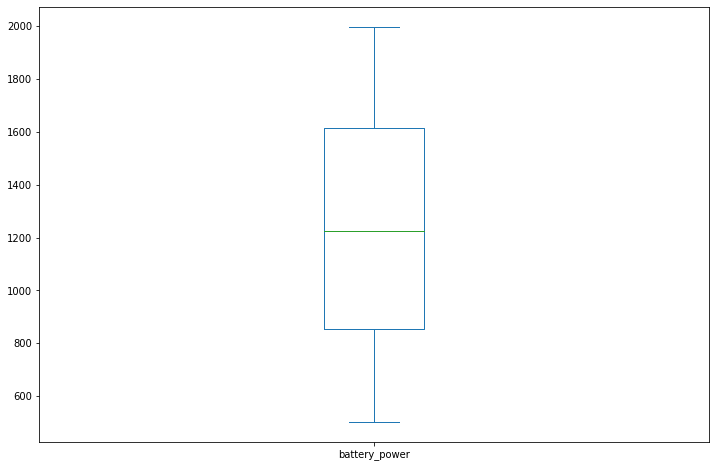

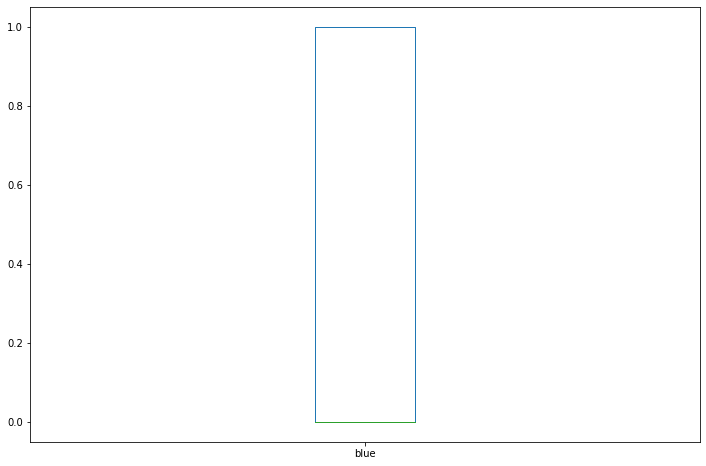

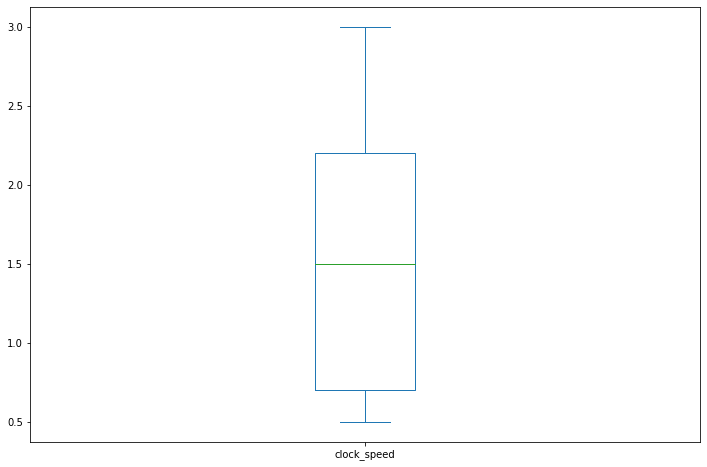

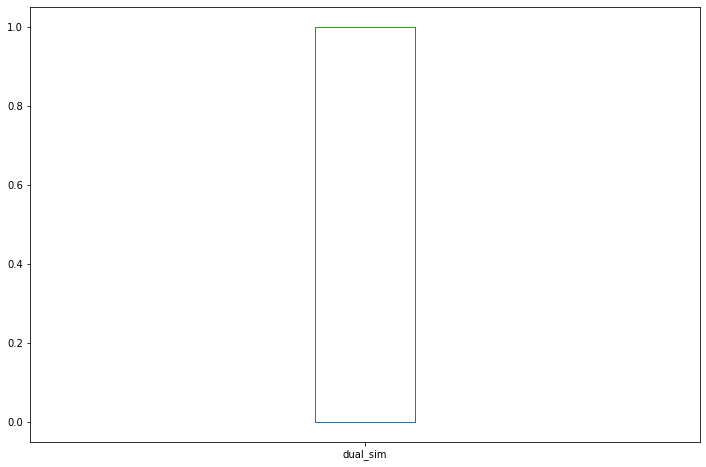

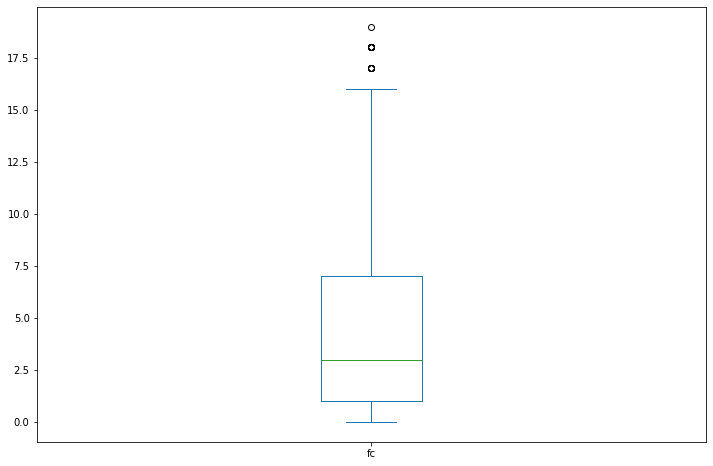

...

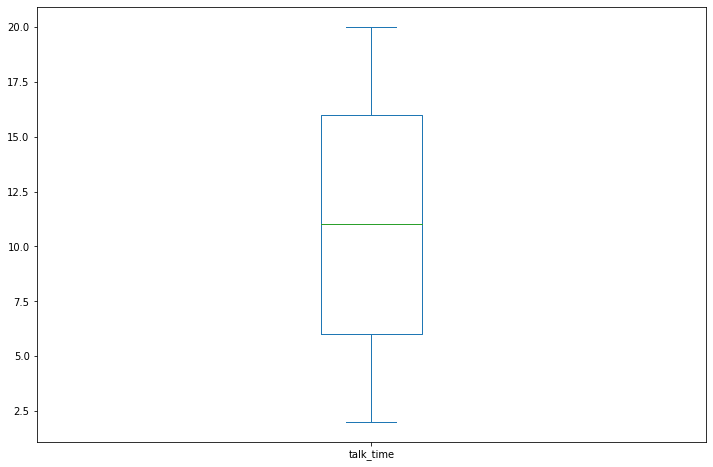

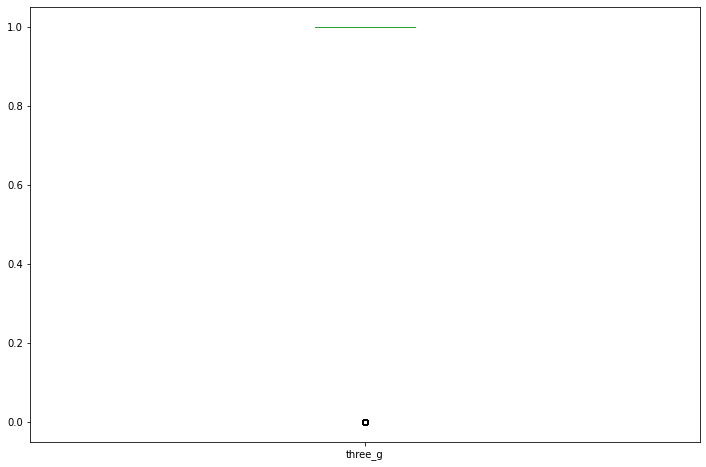

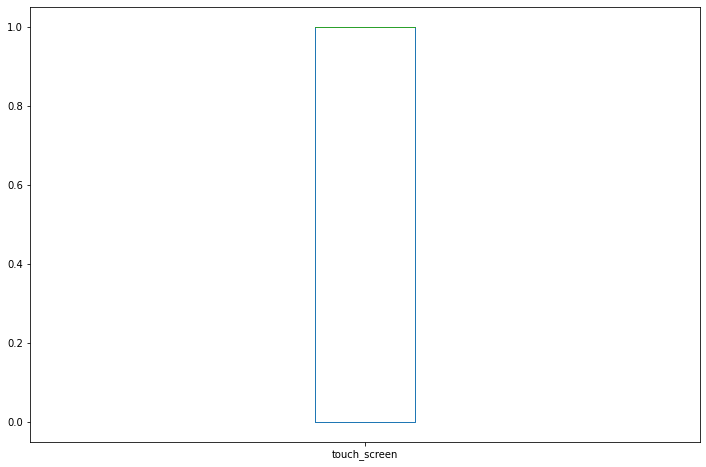

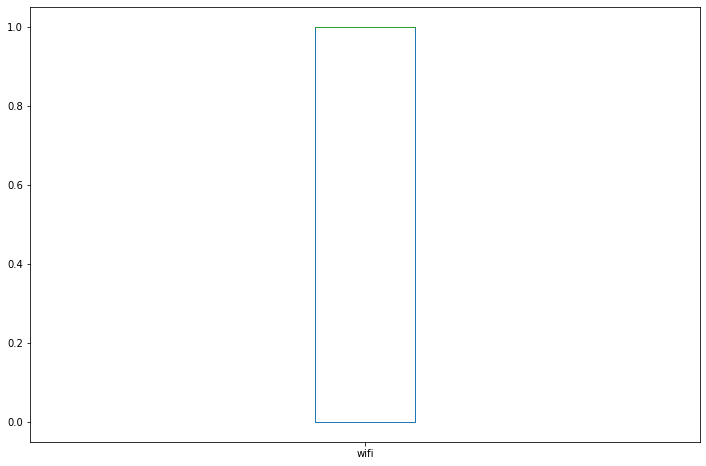

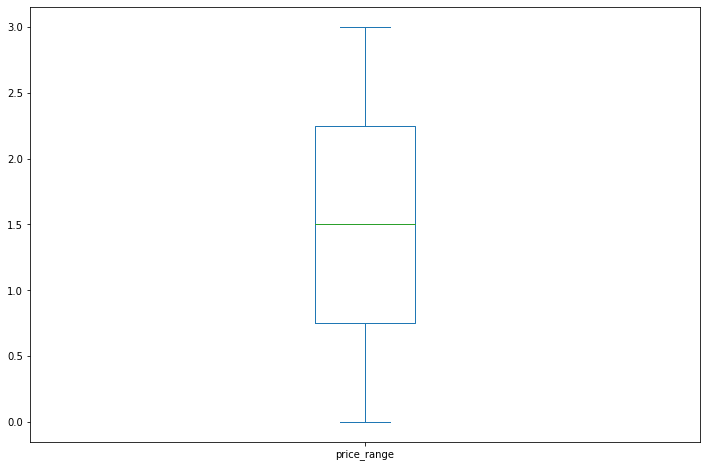

In [20]:
cols=df.columns
for i in cols:
    plt.figure(figsize=(12,8))
    df[i].plot.box()
    
   ###  Grapfhs shows that there are not significant outliers  in this data

In [24]:
df.three_g.isna().any()

False

In [25]:
df.columns

Index(['battery_power', 'blue', 'clock_speed', 'dual_sim', 'fc', 'four_g',
       'int_memory', 'm_dep', 'mobile_wt', 'n_cores', 'pc', 'px_height',
       'px_width', 'ram', 'sc_h', 'sc_w', 'talk_time', 'three_g',
       'touch_screen', 'wifi', 'price_range'],
      dtype='object')

In [26]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
battery_power,2000.0,1238.51850,439.418206,501.0,851.75,1226.0,1615.25,1998.0
blue,2000.0,0.49500,0.500100,0.0,0.00,0.0,1.00,1.0
clock_speed,2000.0,1.52225,0.816004,0.5,0.70,1.5,2.20,3.0
dual_sim,2000.0,0.50950,0.500035,0.0,0.00,1.0,1.00,1.0
fc,2000.0,4.30950,4.341444,0.0,1.00,3.0,7.00,19.0
four_g,2000.0,0.52150,0.499662,0.0,0.00,1.0,1.00,1.0
int_memory,2000.0,32.04650,18.145715,2.0,16.00,32.0,48.00,64.0
m_dep,2000.0,0.50175,0.288416,0.1,0.20,0.5,0.80,1.0
mobile_wt,2000.0,140.24900,35.399655,80.0,109.00,141.0,170.00,200.0
n_cores,2000.0,4.52050,2.287837,1.0,3.00,4.0,7.00,8.0


array([[<AxesSubplot:title={'center':'battery_power'}>,
        <AxesSubplot:title={'center':'blue'}>,
        <AxesSubplot:title={'center':'clock_speed'}>,
        <AxesSubplot:title={'center':'dual_sim'}>,
        <AxesSubplot:title={'center':'fc'}>],
       [<AxesSubplot:title={'center':'four_g'}>,
        <AxesSubplot:title={'center':'int_memory'}>,
        <AxesSubplot:title={'center':'m_dep'}>,
        <AxesSubplot:title={'center':'mobile_wt'}>,
        <AxesSubplot:title={'center':'n_cores'}>],
       [<AxesSubplot:title={'center':'pc'}>,
        <AxesSubplot:title={'center':'px_height'}>,
        <AxesSubplot:title={'center':'px_width'}>,
        <AxesSubplot:title={'center':'ram'}>,
        <AxesSubplot:title={'center':'sc_h'}>],
       [<AxesSubplot:title={'center':'sc_w'}>,
        <AxesSubplot:title={'center':'talk_time'}>,
        <AxesSubplot:title={'center':'three_g'}>,
        <AxesSubplot:title={'center':'touch_screen'}>,
        <AxesSubplot:title={'center':'wifi'}>],

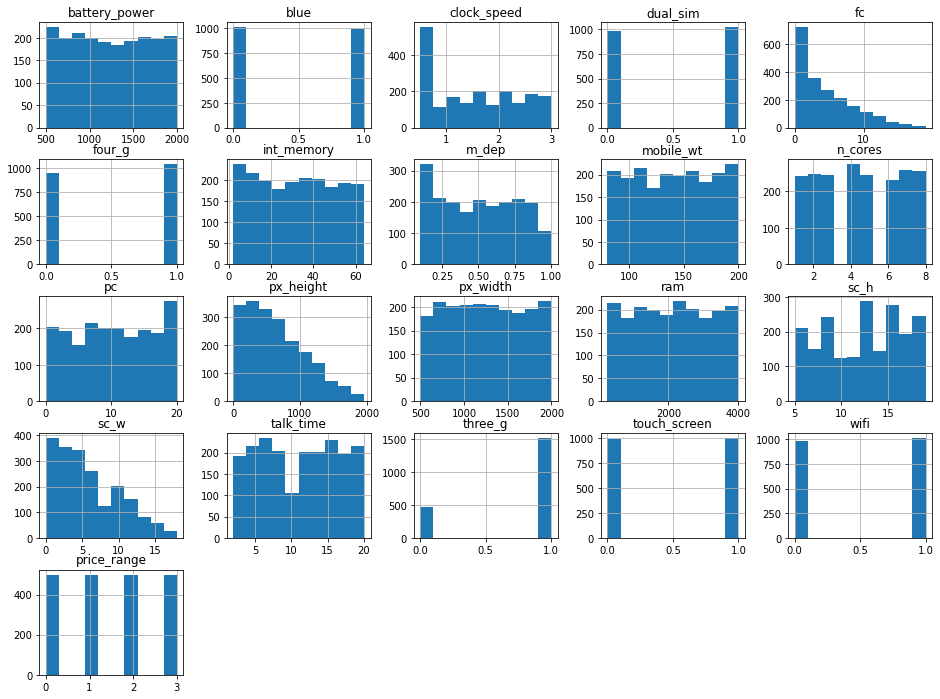

In [31]:
df.hist(figsize=(16,12))

In [32]:
y=df.price_range.copy()
X=df.drop(columns='price_range').copy()
X

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,pc,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi
0,842,0,2.2,0,1,0,7,0.6,188,2,2,20,756,2549,9,7,19,0,0,1
1,1021,1,0.5,1,0,1,53,0.7,136,3,6,905,1988,2631,17,3,7,1,1,0
2,563,1,0.5,1,2,1,41,0.9,145,5,6,1263,1716,2603,11,2,9,1,1,0
3,615,1,2.5,0,0,0,10,0.8,131,6,9,1216,1786,2769,16,8,11,1,0,0
4,1821,1,1.2,0,13,1,44,0.6,141,2,14,1208,1212,1411,8,2,15,1,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,794,1,0.5,1,0,1,2,0.8,106,6,14,1222,1890,668,13,4,19,1,1,0
1996,1965,1,2.6,1,0,0,39,0.2,187,4,3,915,1965,2032,11,10,16,1,1,1
1997,1911,0,0.9,1,1,1,36,0.7,108,8,3,868,1632,3057,9,1,5,1,1,0
1998,1512,0,0.9,0,4,1,46,0.1,145,5,5,336,670,869,18,10,19,1,1,1


In [33]:
y

0       1
1       2
2       2
3       2
4       1
       ..
1995    0
1996    2
1997    3
1998    0
1999    3
Name: price_range, Length: 2000, dtype: int16

In [35]:
scale_list=['battery_power', 'clock_speed', 'fc',
       'int_memory', 'm_dep', 'mobile_wt', 'n_cores', 'pc', 'px_height',
       'px_width', 'ram', 'sc_h', 'sc_w', 'talk_time']
df1=df[scale_list].copy()


In [36]:
df[scale_list]

,battery_power,clock_speed,fc,int_memory,m_dep,mobile_wt,n_cores,pc,px_height,px_width,ram,sc_h,sc_w,talk_time
0,842,2.2,1,7,0.6,188,2,2,20,756,2549,9,7,19
1,1021,0.5,0,53,0.7,136,3,6,905,1988,2631,17,3,7
2,563,0.5,2,41,0.9,145,5,6,1263,1716,2603,11,2,9
3,615,2.5,0,10,0.8,131,6,9,1216,1786,2769,16,8,11
4,1821,1.2,13,44,0.6,141,2,14,1208,1212,1411,8,2,15
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,794,0.5,0,2,0.8,106,6,14,1222,1890,668,13,4,19
1996,1965,2.6,0,39,0.2,187,4,3,915,1965,2032,11,10,16
1997,1911,0.9,1,36,0.7,108,8,3,868,1632,3057,9,1,5
1998,1512,0.9,4,46,0.1,145,5,5,336,670,869,18,10,19


In [37]:
from sklearn import preprocessing
transform_power = preprocessing.PowerTransformer()
scaled_df = transform_power.fit_transform(df1)
df_sc = pd.DataFrame(scaled_df)

In [38]:
df[scale_list]=df_sc.copy()
df

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,...,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
0,-0.882102,0,0.864859,0,-0.678681,0,-1.478784,0.390185,1.320391,-1.103136,...,-2.133710,-1.156055,0.444771,-0.777037,0.464020,1.387539,0,0,1,1
1,-0.443319,1,-1.349676,1,-1.378945,1,1.109283,0.715954,-0.084928,-0.618098,...,0.699735,1.620649,0.513836,1.108859,-0.486762,-0.685321,1,1,0,2
2,-1.631335,1,-1.349676,1,-0.249635,1,0.550845,1.334562,0.167480,0.263015,...,1.273195,1.062404,0.490319,-0.296962,-0.812923,-0.299422,1,1,0,2
3,-1.484093,1,1.157974,0,-1.378945,0,-1.243379,1.030416,-0.227098,0.672306,...,1.203384,1.208232,0.628775,0.877539,0.652224,0.065688,1,0,0,2
4,1.281431,1,-0.286815,0,1.521207,1,0.694804,0.390185,0.055837,-1.103136,...,1.191358,-0.041729,-0.590591,-1.019867,-0.812923,0.749580,1,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,-1.004622,1,-1.349676,1,-1.378945,1,-1.953278,1.030416,-0.961626,0.672306,...,1.212375,1.422063,-1.396857,0.176768,-0.207794,1.387539,1,1,0,0
1996,1.563423,1,1.251593,1,-1.378945,0,0.453030,-1.052426,1.294452,-0.165428,...,0.717261,1.574285,-0.005649,-0.296962,0.993119,0.912820,1,1,1,2
1997,1.458467,0,-0.706681,1,-0.678681,1,0.303293,0.715954,-0.901262,1.446227,...,0.633973,0.885258,0.863817,-0.777037,-1.215608,-1.099005,1,1,0,3
1998,0.651149,0,-0.706681,0,0.312247,1,0.789059,-1.457049,0.167480,0.263015,...,-0.563247,-1.384740,-1.161835,1.339161,0.993119,1.387539,1,1,1,0


In [39]:
X[scale_list]=df_sc.copy()
X

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,pc,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi
0,-0.882102,0,0.864859,0,-0.678681,0,-1.478784,0.390185,1.320391,-1.103136,-1.351153,-2.133710,-1.156055,0.444771,-0.777037,0.464020,1.387539,0,0,1
1,-0.443319,1,-1.349676,1,-1.378945,1,1.109283,0.715954,-0.084928,-0.618098,-0.561397,0.699735,1.620649,0.513836,1.108859,-0.486762,-0.685321,1,1,0
2,-1.631335,1,-1.349676,1,-0.249635,1,0.550845,1.334562,0.167480,0.263015,-0.561397,1.273195,1.062404,0.490319,-0.296962,-0.812923,-0.299422,1,1,0
3,-1.484093,1,1.157974,0,-1.378945,0,-1.243379,1.030416,-0.227098,0.672306,-0.055479,1.203384,1.208232,0.628775,0.877539,0.652224,0.065688,1,0,0
4,1.281431,1,-0.286815,0,1.521207,1,0.694804,0.390185,0.055837,-1.103136,0.701389,1.191358,-0.041729,-0.590591,-1.019867,-0.812923,0.749580,1,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,-1.004622,1,-1.349676,1,-1.378945,1,-1.953278,1.030416,-0.961626,0.672306,0.701389,1.212375,1.422063,-1.396857,0.176768,-0.207794,1.387539,1,1,0
1996,1.563423,1,1.251593,1,-1.378945,0,0.453030,-1.052426,1.294452,-0.165428,-1.134810,0.717261,1.574285,-0.005649,-0.296962,0.993119,0.912820,1,1,1
1997,1.458467,0,-0.706681,1,-0.678681,1,0.303293,0.715954,-0.901262,1.446227,-1.134810,0.633973,0.885258,0.863817,-0.777037,-1.215608,-1.099005,1,1,0
1998,0.651149,0,-0.706681,0,0.312247,1,0.789059,-1.457049,0.167480,0.263015,-0.742985,-0.563247,-1.384740,-1.161835,1.339161,0.993119,1.387539,1,1,1


In [ ]:
df.info()

In [ ]:
cols=df.columns
(df
 [cols]
 #.assign()
 .astype({'blue': 'int8', 'fc': 'int8', 'four_g': 'int8', 'three_g': 'int8',
          'touch_screen': 'int8', 'wifi': 'int8', })
 #.describe()
 #.info()
 .to_json('mobilee.json')
 #.info()
)

In [ ]:
cols=df.columns
df[cols].astype({'blue': 'int8', 'fc': 'int8', 'four_g': 'int8', 'three_g': 'int8',
          'touch_screen': 'int8', 'wifi': 'int8'}).info()

 


In [ ]:
X.astype({'blue': 'int8', 'fc': 'int8', 'four_g': 'int8', 'three_g': 'int8',
          'touch_screen': 'int8', 'wifi': 'int8'})
X.info()


In [ ]:
#y_test=df_test['price_range'].copy()
#X_test=df_test.drop(columns='price_range').copy()
#X_test.describe()

In [ ]:
y=df.price_range.copy()
X=df.drop(columns='price_range').copy()
X

In [43]:
from pandas.api.types import CategoricalDtype

cat_dtype = CategoricalDtype(

    categories=[0,1,2,3], ordered=True)

#yy=y.copy()
y.astype(cat_dtype)


0       1
1       2
2       2
3       2
4       1
       ..
1995    0
1996    2
1997    3
1998    0
1999    3
Name: price_range, Length: 2000, dtype: category
Categories (4, int64): [0 < 1 < 2 < 3]

In [99]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)
X_test.shape

(400, 20)

#  **CREATE  MODELS**

In [147]:
from sklearn import metrics as metrics
from sklearn.metrics import make_scorer,f1_score, recall_score,accuracy_score ,precision_score
scorers = {
            'f1_score': make_scorer(f1_score, average='micro'),
            'precision_score': make_scorer(precision_score, average='micro'),
            'recall_score': make_scorer(recall_score, average='micro'),
            'accuracy_score': make_scorer(accuracy_score)
          }

## 1-  **trying  RandomForestClassifier**

In [144]:
from sklearn.metrics import precision_score, recall_score
from sklearn.ensemble import RandomForestClassifier

clf = RandomForestClassifier(max_depth=23, random_state=0)
clf.fit(X_train, y_train)
y_pred=clf.predict(X_test)

print('RandomForestClassifier precision_score: {0:0.2f}'.format(accuracy_score(y_test, y_pred)))
print('recall scoree : {0:0.2f}'.format(recall_score(y_test, y_pred,average= 'micro')))


RandomForestClassifier precision_score: 0.89
recall scoree : 0.89


## 2-  **trying  LogisticRegression**

In [149]:
from sklearn import metrics

from sklearn.linear_model import LogisticRegression
logreg = LogisticRegression(max_iter=10000)   
logreg.fit(X_train, y_train)
y_pred = logreg.predict(X_test)
print(metrics.recall_score(y_test, y_pred,average= 'micro'))

0.945


## 3-  **trying  KNeighborsClassifier**

In [152]:
from sklearn.neighbors import KNeighborsClassifier
knn = KNeighborsClassifier(n_neighbors=7)
knn.fit(X_train,y_train)
y_pred = knn.predict(X_test)
print(metrics.accuracy_score(y_test, y_pred))
print(metrics.recall_score(y_test, y_pred,average= 'micro'))

0.5875
0.5875


## 4-  **trying  DecisionTreeClassifier**

In [153]:
from sklearn import tree

model = tree.DecisionTreeClassifier()

model.fit(X_train, y_train)


#Predict the response for test dataset
y_pred_tree = model.predict(X_test)

# scores
print('precision_score: {0:0.3f}'.format(metrics.precision_score(y_test, y_pred_tree,average= 'micro')))
print('recall scoree : {0:0.3f}'.format(metrics.recall_score(y_test, y_pred_tree,average= 'micro')))
print('DecisionTreeClassifier Model accuracy score: {0:0.4f}'.format(accuracy_score(y_test, y_pred_tree)))


precision_score: 0.845
recall scoree : 0.845
DecisionTreeClassifier Model accuracy score: 0.8450


 ## 5-  **lightgbm Classifier**  via Optuna Hyper Parameter Tuning

In [126]:
import optuna  # pip install optuna
from sklearn.metrics import log_loss
from sklearn.metrics import recall_score, precision_recall_curve

from sklearn.model_selection import StratifiedKFold
import lightgbm as lgbm

def objective(trial, X, y):
    param_grid = {}  # to be filled in later
    cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=1121218)

    cv_scores = np.empty(5)
    for idx, (train_idx, test_idx) in enumerate(cv.split(X, y)):
        X_train, X_test = X.iloc[train_idx], X.iloc[test_idx]
        y_train, y_test = y[train_idx], y[test_idx]

        model = lgbm.LGBMClassifier(objective="multiclass", **param_grid, num_classes = 4)
        model.fit(
            X_train,
            y_train,
            eval_set=[(X_test, y_test)],
            eval_metric='multi_logloss',
            early_stopping_rounds=100,
        )
        preds = model.predict(X_test)
        cv_scores[idx] = preds

    return np.mean(cv_scores)

In [127]:
def objective(trial, X, y):
    param_grid = {
        #         "device_type": trial.suggest_categorical("device_type", ['gpu']),
        "n_estimators": trial.suggest_categorical("n_estimators", [10000]),
        "learning_rate": trial.suggest_float("learning_rate", 0.01, 1, step=0.05),
        "num_leaves": trial.suggest_int("num_leaves", 20, 3000, step=20),
        "max_depth": trial.suggest_int("max_depth", 6, 23),
        "min_data_in_leaf": trial.suggest_int("min_data_in_leaf", 100, 10000, step=50),
        "max_bin": trial.suggest_int("max_bin", 200, 300),
        "lambda_l1": trial.suggest_int("lambda_l1", 0, 100, step=5),
        "lambda_l2": trial.suggest_int("lambda_l2", 0, 100, step=5),
        "min_gain_to_split": trial.suggest_float("min_gain_to_split", 0, 15),
        "bagging_fraction": trial.suggest_float(
            "bagging_fraction", 0.2, 0.95, step=0.1
        ),
        "bagging_freq": trial.suggest_categorical("bagging_freq", [1]),
        "feature_fraction": trial.suggest_float(
            "feature_fraction", 0.2, 0.95, step=0.1
        ),
    }

In [128]:
from optuna.integration import LightGBMPruningCallback
from sklearn.model_selection import StratifiedKFold
def objective(trial, X, y):
    param_grid = {
        #         "device_type": trial.suggest_categorical("device_type", ['gpu']),
        "n_estimators": trial.suggest_categorical("n_estimators", [10000]),
        "learning_rate": trial.suggest_float("learning_rate", 0.01, 1, step=0.05),
        "num_leaves": trial.suggest_int("num_leaves", 20, 3000, step=20),
        "max_depth": trial.suggest_int("max_depth", 6, 23),
        "min_data_in_leaf": trial.suggest_int("min_data_in_leaf", 100, 10000, step=50),
        "max_bin": trial.suggest_int("max_bin", 200, 300),
        "lambda_l1": trial.suggest_int("lambda_l1", 0, 100, step=5),
        "lambda_l2": trial.suggest_int("lambda_l2", 0, 100, step=5),
        "min_gain_to_split": trial.suggest_float("min_gain_to_split", 0, 15),
        "bagging_fraction": trial.suggest_float(
            "bagging_fraction", 0.2, 0.95, step=0.1
        ),
        "bagging_freq": trial.suggest_categorical("bagging_freq", [1]),
        "feature_fraction": trial.suggest_float(
            "feature_fraction", 0.2, 0.95, step=0.1
        ),
    }

    cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=1121218)

    cv_scores = np.empty(5)
    for idx, (train_idx, test_idx) in enumerate(cv.split(X, y)):
        X_train, X_test = X.iloc[train_idx], X.iloc[test_idx]
        y_train, y_test = y[train_idx], y[test_idx]

        model = lgbm.LGBMClassifier(objective="multiclass", **param_grid, num_classes = 4,)
        model.fit(
            X_train,
            y_train,
            eval_set=[(X_test, y_test)],
            eval_metric='multi_logloss',
            early_stopping_rounds=10,
              # Add a pruning callback  num_classes = INSERT NUMBER OF TARGET CLASSES HERE,
        )
        preds = model.predict(X_test)
        cv_scores[idx] = metrics.f1_score(y_test, preds, average='micro')
        
        #cv_scores[idx] = metrics.recall_score(y_test, preds)
        #acc = metrics.accuracy_score(preds, y_test)
        ##recall = metrics.recall_score(preds, y_test)
        #precision = metrics.precision_score(preds, y_test)
        #f1 = metrics.f1_score(preds, y_test)

   
    return np.mean(cv_scores) #,acc, f1, recall, precision

In [129]:
study = optuna.create_study(direction="maximize", study_name="LGBdM Classifier")
func = lambda trial: objective(trial, X, y)
study.optimize(func, n_trials=1000)

[I 2023-01-08 23:19:42,549] A new study created in memory with name: LGBdM Classifier
[I 2023-01-08 23:19:42,647] Trial 0 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.21000000000000002, 'num_leaves': 160, 'max_depth': 8, 'min_data_in_leaf': 1500, 'max_bin': 282, 'lambda_l1': 25, 'lambda_l2': 55, 'min_gain_to_split': 14.691854114278303, 'bagging_fraction': 0.5, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 0 with value: 0.25.
[I 2023-01-08 23:19:42,750] Trial 1 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.51, 'num_leaves': 480, 'max_depth': 23, 'min_data_in_leaf': 3600, 'max_bin': 283, 'lambda_l1': 35, 'lambda_l2': 0, 'min_gain_to_split': 13.695786743054555, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 0 with value: 0.25.


[LightGBM] [Warning] lambda_l1 is set=25, reg_alpha=0.0 will be ignored. Current value: lambda_l1=25
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] min_gain_to_split is set=14.691854114278303, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=14.691854114278303
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] feature_fraction is set=0.30000000000000004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.30000000000000004
[LightGBM] [Warning] min_data_in_leaf is set=1500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1500
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_loglo

[I 2023-01-08 23:19:42,853] Trial 2 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.01, 'num_leaves': 1120, 'max_depth': 15, 'min_data_in_leaf': 5300, 'max_bin': 213, 'lambda_l1': 100, 'lambda_l2': 85, 'min_gain_to_split': 1.4354125410279788, 'bagging_fraction': 0.2, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 0 with value: 0.25.
[I 2023-01-08 23:19:42,960] Trial 3 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.060000000000000005, 'num_leaves': 1420, 'max_depth': 9, 'min_data_in_leaf': 5650, 'max_bin': 251, 'lambda_l1': 85, 'lambda_l2': 70, 'min_gain_to_split': 9.604704567078073, 'bagging_fraction': 0.30000000000000004, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 0 with value: 0.25.


[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logloss: 1.38629
[6]	valid_0's multi_logloss: 1.38629
[7]	valid_0's multi_logloss: 1.38629
[8]	valid_0's multi_logloss: 1.38629
[9]	valid_0's multi_logloss: 1.38629
[10]	valid_0's multi_logloss: 1.38629
[11]	valid_0's multi_logloss: 1.38629
[LightGBM] [Warning] lambda_l1 is set=100, reg_alpha=0.0 will be ignored. Current value: lambda_l1=100
[LightGBM] [Warning] bagging_fraction is set=0.2, subsample=1.0 will be ignored. Current value: bagging_fraction=0.2
[LightGBM] [Warning] min_gain_to_split is set=1.4354125410279788, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.4354125410279788
[LightGBM] [Warning] lambda_l2 is set=85, reg_lambda=0.0 will be ignored. Current value: lambda_l2=85
[LightGBM] [Warning] feature_fraction is set=0.30000000000000004, colsample_bytree=1.0 will be ignored. Current val

[I 2023-01-08 23:19:43,065] Trial 4 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.36000000000000004, 'num_leaves': 920, 'max_depth': 13, 'min_data_in_leaf': 9850, 'max_bin': 275, 'lambda_l1': 55, 'lambda_l2': 60, 'min_gain_to_split': 12.732164341847302, 'bagging_fraction': 0.4, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 0 with value: 0.25.
[I 2023-01-08 23:19:43,172] Trial 5 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.6100000000000001, 'num_leaves': 2980, 'max_depth': 13, 'min_data_in_leaf': 7250, 'max_bin': 270, 'lambda_l1': 70, 'lambda_l2': 100, 'min_gain_to_split': 10.249806427929109, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.9}. Best is trial 0 with value: 0.25.


[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logloss: 1.38629
[6]	valid_0's multi_logloss: 1.38629
[7]	valid_0's multi_logloss: 1.38629
[8]	valid_0's multi_logloss: 1.38629
[9]	valid_0's multi_logloss: 1.38629
[10]	valid_0's multi_logloss: 1.38629
[11]	valid_0's multi_logloss: 1.38629
[LightGBM] [Warning] lambda_l1 is set=55, reg_alpha=0.0 will be ignored. Current value: lambda_l1=55
[LightGBM] [Warning] bagging_fraction is set=0.4, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4
[LightGBM] [Warning] min_gain_to_split is set=12.732164341847302, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=12.732164341847302
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

[I 2023-01-08 23:19:43,276] Trial 6 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.46, 'num_leaves': 1580, 'max_depth': 22, 'min_data_in_leaf': 4200, 'max_bin': 224, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 7.993919206671297, 'bagging_fraction': 0.4, 'bagging_freq': 1, 'feature_fraction': 0.2}. Best is trial 0 with value: 0.25.
[I 2023-01-08 23:19:43,371] Trial 7 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.66, 'num_leaves': 980, 'max_depth': 7, 'min_data_in_leaf': 1500, 'max_bin': 293, 'lambda_l1': 95, 'lambda_l2': 75, 'min_gain_to_split': 10.127790751982303, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 0 with value: 0.25.


[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logloss: 1.38629
[6]	valid_0's multi_logloss: 1.38629
[7]	valid_0's multi_logloss: 1.38629
[8]	valid_0's multi_logloss: 1.38629
[9]	valid_0's multi_logloss: 1.38629
[10]	valid_0's multi_logloss: 1.38629
[11]	valid_0's multi_logloss: 1.38629
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.4, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4
[LightGBM] [Warning] min_gain_to_split is set=7.993919206671297, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=7.993919206671297
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] feature_fraction is set=0.2, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0

[I 2023-01-08 23:19:43,571] Trial 8 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 2700, 'max_depth': 18, 'min_data_in_leaf': 600, 'max_bin': 218, 'lambda_l1': 75, 'lambda_l2': 100, 'min_gain_to_split': 7.887873478686699, 'bagging_fraction': 0.2, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 0 with value: 0.25.


[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logloss: 1.38629
[6]	valid_0's multi_logloss: 1.38629
[7]	valid_0's multi_logloss: 1.38629
[8]	valid_0's multi_logloss: 1.38629
[9]	valid_0's multi_logloss: 1.38629
[10]	valid_0's multi_logloss: 1.38629
[11]	valid_0's multi_logloss: 1.38629
[LightGBM] [Warning] lambda_l1 is set=75, reg_alpha=0.0 will be ignored. Current value: lambda_l1=75
[LightGBM] [Warning] bagging_fraction is set=0.2, subsample=1.0 will be ignored. Current value: bagging_fraction=0.2
[LightGBM] [Warning] min_gain_to_split is set=7.887873478686699, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=7.887873478686699
[LightGBM] [Warning] lambda_l2 is set=100, reg_lambda=0.0 will be ignored. Current value: lambda_l2=100
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

[I 2023-01-08 23:19:43,670] Trial 9 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 80, 'max_depth': 21, 'min_data_in_leaf': 2050, 'max_bin': 277, 'lambda_l1': 15, 'lambda_l2': 15, 'min_gain_to_split': 13.26445125762417, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 0 with value: 0.25.


[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logloss: 1.38629
[6]	valid_0's multi_logloss: 1.38629
[7]	valid_0's multi_logloss: 1.38629
[8]	valid_0's multi_logloss: 1.38629
[9]	valid_0's multi_logloss: 1.38629
[10]	valid_0's multi_logloss: 1.38629
[11]	valid_0's multi_logloss: 1.38629
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] min_gain_to_split is set=13.26445125762417, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=13.26445125762417
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction

[I 2023-01-08 23:19:43,898] Trial 10 finished with value: 0.6835 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2160, 'max_depth': 10, 'min_data_in_leaf': 100, 'max_bin': 249, 'lambda_l1': 30, 'lambda_l2': 40, 'min_gain_to_split': 3.0302962764493113, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 10 with value: 0.6835.


[1]	valid_0's multi_logloss: 1.23605
[2]	valid_0's multi_logloss: 0.909227
[3]	valid_0's multi_logloss: 0.831218
[4]	valid_0's multi_logloss: 0.7148
[5]	valid_0's multi_logloss: 0.7148
[6]	valid_0's multi_logloss: 0.703446
[7]	valid_0's multi_logloss: 0.703446
[8]	valid_0's multi_logloss: 0.703446
[9]	valid_0's multi_logloss: 0.69617
[10]	valid_0's multi_logloss: 0.680748
[11]	valid_0's multi_logloss: 0.680748
[12]	valid_0's multi_logloss: 0.680748
[13]	valid_0's multi_logloss: 0.680748
[14]	valid_0's multi_logloss: 0.680748
[15]	valid_0's multi_logloss: 0.680748
[16]	valid_0's multi_logloss: 0.680748
[17]	valid_0's multi_logloss: 0.680748
[18]	valid_0's multi_logloss: 0.680748
[19]	valid_0's multi_logloss: 0.680748
[20]	valid_0's multi_logloss: 0.680748
[LightGBM] [Warning] lambda_l1 is set=30, reg_alpha=0.0 will be ignored. Current value: lambda_l1=30
[LightGBM] [Warning] bagging_fraction is set=0.6000000000000001, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6000

[I 2023-01-08 23:19:44,108] Trial 11 finished with value: 0.7070000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2140, 'max_depth': 9, 'min_data_in_leaf': 150, 'max_bin': 245, 'lambda_l1': 30, 'lambda_l2': 40, 'min_gain_to_split': 3.062729268483102, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 11 with value: 0.7070000000000001.


[1]	valid_0's multi_logloss: 1.2525
[2]	valid_0's multi_logloss: 0.938112
[3]	valid_0's multi_logloss: 0.853749
[4]	valid_0's multi_logloss: 0.741664
[5]	valid_0's multi_logloss: 0.722045
[6]	valid_0's multi_logloss: 0.722045
[7]	valid_0's multi_logloss: 0.722045
[8]	valid_0's multi_logloss: 0.722045
[9]	valid_0's multi_logloss: 0.722045
[10]	valid_0's multi_logloss: 0.713857
[11]	valid_0's multi_logloss: 0.713857
[12]	valid_0's multi_logloss: 0.713857
[13]	valid_0's multi_logloss: 0.713857
[14]	valid_0's multi_logloss: 0.713857
[15]	valid_0's multi_logloss: 0.713857
[16]	valid_0's multi_logloss: 0.703896
[17]	valid_0's multi_logloss: 0.703896
[18]	valid_0's multi_logloss: 0.703896
[19]	valid_0's multi_logloss: 0.703896
[20]	valid_0's multi_logloss: 0.703896
[21]	valid_0's multi_logloss: 0.703896
[22]	valid_0's multi_logloss: 0.703896
[23]	valid_0's multi_logloss: 0.703896
[24]	valid_0's multi_logloss: 0.703896
[25]	valid_0's multi_logloss: 0.703896
[26]	valid_0's multi_logloss: 0.7038

[I 2023-01-08 23:19:44,346] Trial 12 finished with value: 0.471 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2220, 'max_depth': 10, 'min_data_in_leaf': 250, 'max_bin': 243, 'lambda_l1': 45, 'lambda_l2': 35, 'min_gain_to_split': 2.7642729345440387, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 11 with value: 0.7070000000000001.


[19]	valid_0's multi_logloss: 0.729111
[20]	valid_0's multi_logloss: 0.729111
[21]	valid_0's multi_logloss: 0.729111
[22]	valid_0's multi_logloss: 0.729111
[23]	valid_0's multi_logloss: 0.729111
[24]	valid_0's multi_logloss: 0.729111
[25]	valid_0's multi_logloss: 0.729111
[26]	valid_0's multi_logloss: 0.729111
[27]	valid_0's multi_logloss: 0.729111
[LightGBM] [Warning] lambda_l1 is set=45, reg_alpha=0.0 will be ignored. Current value: lambda_l1=45
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] min_gain_to_split is set=2.7642729345440387, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.7642729345440387
[LightGBM] [Warning] lambda_l2 is set=35, reg_lambda=0.0 will be ignored. Current value: lambda_l2=35
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=250, m

[I 2023-01-08 23:19:44,485] Trial 13 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2040, 'max_depth': 11, 'min_data_in_leaf': 2700, 'max_bin': 246, 'lambda_l1': 15, 'lambda_l2': 40, 'min_gain_to_split': 4.231344861944265, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 11 with value: 0.7070000000000001.
[I 2023-01-08 23:19:44,630] Trial 14 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2220, 'max_depth': 6, 'min_data_in_leaf': 500, 'max_bin': 257, 'lambda_l1': 50, 'lambda_l2': 40, 'min_gain_to_split': 4.81430144414356, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 1, 'feature_fraction': 0.9}. Best is trial 11 with value: 0.7070000000000001.


[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.6000000000000001, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6000000000000001
[LightGBM] [Warning] min_gain_to_split is set=4.231344861944265, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=4.231344861944265
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=2700, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2700
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 

[I 2023-01-08 23:19:44,767] Trial 15 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1840, 'max_depth': 11, 'min_data_in_leaf': 7800, 'max_bin': 236, 'lambda_l1': 35, 'lambda_l2': 25, 'min_gain_to_split': 0.9085738075605918, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 11 with value: 0.7070000000000001.


[LightGBM] [Warning] lambda_l1 is set=35, reg_alpha=0.0 will be ignored. Current value: lambda_l1=35
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=0.9085738075605918, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9085738075605918
[LightGBM] [Warning] lambda_l2 is set=25, reg_lambda=0.0 will be ignored. Current value: lambda_l2=25
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=7800, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7800
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_

[I 2023-01-08 23:19:44,898] Trial 16 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2540, 'max_depth': 15, 'min_data_in_leaf': 3000, 'max_bin': 201, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 5.05641915989633, 'bagging_fraction': 0.5, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 11 with value: 0.7070000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] min_gain_to_split is set=5.05641915989633, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=5.05641915989633
[LightGBM] [Warning] lambda_l2 is set=50, reg_lambda=0.0 will be ignored. Current value: lambda_l2=50
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=3000, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3000
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38

[I 2023-01-08 23:19:45,976] Trial 17 finished with value: 0.7505000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.56, 'num_leaves': 2480, 'max_depth': 17, 'min_data_in_leaf': 150, 'max_bin': 262, 'lambda_l1': 25, 'lambda_l2': 25, 'min_gain_to_split': 0.0021203474864406324, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 17 with value: 0.7505000000000001.
[I 2023-01-08 23:19:46,109] Trial 18 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.26, 'num_leaves': 2600, 'max_depth': 18, 'min_data_in_leaf': 1750, 'max_bin': 263, 'lambda_l1': 15, 'lambda_l2': 0, 'min_gain_to_split': 0.7303186480930668, 'bagging_fraction': 0.4, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 17 with value: 0.7505000000000001.


[92]	valid_0's multi_logloss: 0.577438
[93]	valid_0's multi_logloss: 0.57704
[94]	valid_0's multi_logloss: 0.57704
[95]	valid_0's multi_logloss: 0.576842
[96]	valid_0's multi_logloss: 0.576842
[97]	valid_0's multi_logloss: 0.576776
[98]	valid_0's multi_logloss: 0.576724
[99]	valid_0's multi_logloss: 0.576463
[100]	valid_0's multi_logloss: 0.576463
[101]	valid_0's multi_logloss: 0.576463
[102]	valid_0's multi_logloss: 0.576463
[103]	valid_0's multi_logloss: 0.57545
[104]	valid_0's multi_logloss: 0.57545
[105]	valid_0's multi_logloss: 0.57545
[106]	valid_0's multi_logloss: 0.57545
[107]	valid_0's multi_logloss: 0.575308
[108]	valid_0's multi_logloss: 0.575308
[109]	valid_0's multi_logloss: 0.5749
[110]	valid_0's multi_logloss: 0.5749
[111]	valid_0's multi_logloss: 0.574101
[112]	valid_0's multi_logloss: 0.574051
[113]	valid_0's multi_logloss: 0.574051
[114]	valid_0's multi_logloss: 0.574051
[115]	valid_0's multi_logloss: 0.574051
[116]	valid_0's multi_logloss: 0.574051
[117]	valid_0's mu

[I 2023-01-08 23:19:46,242] Trial 19 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.56, 'num_leaves': 1780, 'max_depth': 18, 'min_data_in_leaf': 7000, 'max_bin': 237, 'lambda_l1': 60, 'lambda_l2': 15, 'min_gain_to_split': 0.14497451015808993, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 17 with value: 0.7505000000000001.


[LightGBM] [Warning] lambda_l1 is set=60, reg_alpha=0.0 will be ignored. Current value: lambda_l1=60
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=0.14497451015808993, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.14497451015808993
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=7000, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7000
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's mult

[I 2023-01-08 23:19:46,379] Trial 20 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.41000000000000003, 'num_leaves': 2920, 'max_depth': 20, 'min_data_in_leaf': 9450, 'max_bin': 230, 'lambda_l1': 40, 'lambda_l2': 25, 'min_gain_to_split': 2.5194056524023027, 'bagging_fraction': 0.5, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 17 with value: 0.7505000000000001.


[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] min_gain_to_split is set=2.5194056524023027, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.5194056524023027
[LightGBM] [Warning] lambda_l2 is set=25, reg_lambda=0.0 will be ignored. Current value: lambda_l2=25
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=9450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9450
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss

[I 2023-01-08 23:19:46,648] Trial 21 finished with value: 0.6725000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2320, 'max_depth': 13, 'min_data_in_leaf': 150, 'max_bin': 259, 'lambda_l1': 25, 'lambda_l2': 30, 'min_gain_to_split': 3.6847287015777774, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 17 with value: 0.7505000000000001.


[1]	valid_0's multi_logloss: 1.1073
[2]	valid_0's multi_logloss: 0.978228
[3]	valid_0's multi_logloss: 0.894531
[4]	valid_0's multi_logloss: 0.706818
[5]	valid_0's multi_logloss: 0.6988
[6]	valid_0's multi_logloss: 0.689658
[7]	valid_0's multi_logloss: 0.689658
[8]	valid_0's multi_logloss: 0.689658
[9]	valid_0's multi_logloss: 0.682793
[10]	valid_0's multi_logloss: 0.677872
[11]	valid_0's multi_logloss: 0.677872
[12]	valid_0's multi_logloss: 0.677872
[13]	valid_0's multi_logloss: 0.669345
[14]	valid_0's multi_logloss: 0.669345
[15]	valid_0's multi_logloss: 0.669345
[16]	valid_0's multi_logloss: 0.669345
[17]	valid_0's multi_logloss: 0.669345
[18]	valid_0's multi_logloss: 0.669345
[19]	valid_0's multi_logloss: 0.669345
[20]	valid_0's multi_logloss: 0.669345
[21]	valid_0's multi_logloss: 0.669345
[22]	valid_0's multi_logloss: 0.669345
[23]	valid_0's multi_logloss: 0.669345
[LightGBM] [Warning] lambda_l1 is set=25, reg_alpha=0.0 will be ignored. Current value: lambda_l1=25
[LightGBM] [War

[I 2023-01-08 23:19:46,789] Trial 22 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 2380, 'max_depth': 16, 'min_data_in_leaf': 1100, 'max_bin': 253, 'lambda_l1': 25, 'lambda_l2': 45, 'min_gain_to_split': 6.014267151251449, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 17 with value: 0.7505000000000001.
[I 2023-01-08 23:19:46,934] Trial 23 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1980, 'max_depth': 11, 'min_data_in_leaf': 2200, 'max_bin': 265, 'lambda_l1': 30, 'lambda_l2': 60, 'min_gain_to_split': 2.4340322379830597, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 17 with value: 0.7505000000000001.


[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logloss: 1.38629
[6]	valid_0's multi_logloss: 1.38629
[7]	valid_0's multi_logloss: 1.38629
[8]	valid_0's multi_logloss: 1.38629
[9]	valid_0's multi_logloss: 1.38629
[10]	valid_0's multi_logloss: 1.38629
[11]	valid_0's multi_logloss: 1.38629
[LightGBM] [Warning] lambda_l1 is set=30, reg_alpha=0.0 will be ignored. Current value: lambda_l1=30
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] min_gain_to_split is set=2.4340322379830597, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.4340322379830597
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value:

[I 2023-01-08 23:19:47,074] Trial 24 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1540, 'max_depth': 9, 'min_data_in_leaf': 950, 'max_bin': 243, 'lambda_l1': 10, 'lambda_l2': 25, 'min_gain_to_split': 6.474222576583825, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 17 with value: 0.7505000000000001.


[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logloss: 1.38629
[6]	valid_0's multi_logloss: 1.38629
[7]	valid_0's multi_logloss: 1.38629
[8]	valid_0's multi_logloss: 1.38629
[9]	valid_0's multi_logloss: 1.38629
[10]	valid_0's multi_logloss: 1.38629
[11]	valid_0's multi_logloss: 1.38629
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=6.474222576583825, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=6.474222576583825
[LightGBM] [Warning] lambda_l2 is set=25, reg_lambda=0.0 will be ignored. Current value: lambda_l2=25
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction

[I 2023-01-08 23:19:47,209] Trial 25 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.31000000000000005, 'num_leaves': 2760, 'max_depth': 6, 'min_data_in_leaf': 3950, 'max_bin': 234, 'lambda_l1': 45, 'lambda_l2': 10, 'min_gain_to_split': 2.221385344929016, 'bagging_fraction': 0.5, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 17 with value: 0.7505000000000001.
[I 2023-01-08 23:19:47,344] Trial 26 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.16000000000000003, 'num_leaves': 2060, 'max_depth': 16, 'min_data_in_leaf': 2500, 'max_bin': 249, 'lambda_l1': 20, 'lambda_l2': 35, 'min_gain_to_split': 3.5347253343786083, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 17 with value: 0.7505000000000001.


[LightGBM] [Warning] lambda_l1 is set=45, reg_alpha=0.0 will be ignored. Current value: lambda_l1=45
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] min_gain_to_split is set=2.221385344929016, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.221385344929016
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=3950, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3950
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_lo

[I 2023-01-08 23:19:47,888] Trial 27 finished with value: 0.7834999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.6100000000000001, 'num_leaves': 2440, 'max_depth': 12, 'min_data_in_leaf': 150, 'max_bin': 268, 'lambda_l1': 5, 'lambda_l2': 50, 'min_gain_to_split': 1.7109691191606369, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 27 with value: 0.7834999999999999.


[25]	valid_0's multi_logloss: 0.469793
[26]	valid_0's multi_logloss: 0.464502
[27]	valid_0's multi_logloss: 0.464332
[28]	valid_0's multi_logloss: 0.462776
[29]	valid_0's multi_logloss: 0.462776
[30]	valid_0's multi_logloss: 0.462776
[31]	valid_0's multi_logloss: 0.462085
[32]	valid_0's multi_logloss: 0.460923
[33]	valid_0's multi_logloss: 0.461094
[34]	valid_0's multi_logloss: 0.459394
[35]	valid_0's multi_logloss: 0.459394
[36]	valid_0's multi_logloss: 0.459394
[37]	valid_0's multi_logloss: 0.459394
[38]	valid_0's multi_logloss: 0.459394
[39]	valid_0's multi_logloss: 0.459394
[40]	valid_0's multi_logloss: 0.459394
[41]	valid_0's multi_logloss: 0.459394
[42]	valid_0's multi_logloss: 0.458106
[43]	valid_0's multi_logloss: 0.458106
[44]	valid_0's multi_logloss: 0.456655
[45]	valid_0's multi_logloss: 0.456655
[46]	valid_0's multi_logloss: 0.456655
[47]	valid_0's multi_logloss: 0.452768
[48]	valid_0's multi_logloss: 0.451525
[49]	valid_0's multi_logloss: 0.451525
[50]	valid_0's multi_logl

[I 2023-01-08 23:19:48,038] Trial 28 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.56, 'num_leaves': 2580, 'max_depth': 12, 'min_data_in_leaf': 1150, 'max_bin': 293, 'lambda_l1': 5, 'lambda_l2': 50, 'min_gain_to_split': 1.5639563692658944, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 27 with value: 0.7834999999999999.
[I 2023-01-08 23:19:48,172] Trial 29 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.46, 'num_leaves': 2460, 'max_depth': 8, 'min_data_in_leaf': 3100, 'max_bin': 285, 'lambda_l1': 10, 'lambda_l2': 60, 'min_gain_to_split': 0.261329147328592, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 27 with value: 0.7834999999999999.


[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logloss: 1.38629
[6]	valid_0's multi_logloss: 1.38629
[7]	valid_0's multi_logloss: 1.38629
[8]	valid_0's multi_logloss: 1.38629
[9]	valid_0's multi_logloss: 1.38629
[10]	valid_0's multi_logloss: 1.38629
[11]	valid_0's multi_logloss: 1.38629
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=0.261329147328592, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.261329147328592
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction

[I 2023-01-08 23:19:48,310] Trial 30 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.6100000000000001, 'num_leaves': 1840, 'max_depth': 14, 'min_data_in_leaf': 4650, 'max_bin': 264, 'lambda_l1': 20, 'lambda_l2': 50, 'min_gain_to_split': 1.633417842096975, 'bagging_fraction': 0.5, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 27 with value: 0.7834999999999999.


[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] min_gain_to_split is set=1.633417842096975, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.633417842096975
[LightGBM] [Warning] lambda_l2 is set=50, reg_lambda=0.0 will be ignored. Current value: lambda_l2=50
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=4650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=4650
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 

[I 2023-01-08 23:19:48,525] Trial 31 finished with value: 0.6965 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 2220, 'max_depth': 9, 'min_data_in_leaf': 100, 'max_bin': 271, 'lambda_l1': 30, 'lambda_l2': 40, 'min_gain_to_split': 3.3045753772368403, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 27 with value: 0.7834999999999999.


[17]	valid_0's multi_logloss: 0.687209
[18]	valid_0's multi_logloss: 0.687209
[19]	valid_0's multi_logloss: 0.687209
[20]	valid_0's multi_logloss: 0.687209
[21]	valid_0's multi_logloss: 0.687209
[22]	valid_0's multi_logloss: 0.687209
[23]	valid_0's multi_logloss: 0.687209
[24]	valid_0's multi_logloss: 0.687209
[25]	valid_0's multi_logloss: 0.687209
[26]	valid_0's multi_logloss: 0.687209
[LightGBM] [Warning] lambda_l1 is set=30, reg_alpha=0.0 will be ignored. Current value: lambda_l1=30
[LightGBM] [Warning] bagging_fraction is set=0.6000000000000001, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6000000000000001
[LightGBM] [Warning] min_gain_to_split is set=3.3045753772368403, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=3.3045753772368403
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: fea

[I 2023-01-08 23:19:48,655] Trial 32 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 2780, 'max_depth': 8, 'min_data_in_leaf': 1450, 'max_bin': 273, 'lambda_l1': 35, 'lambda_l2': 30, 'min_gain_to_split': 5.8028599386666535, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 27 with value: 0.7834999999999999.
[I 2023-01-08 23:19:48,789] Trial 33 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.51, 'num_leaves': 2340, 'max_depth': 10, 'min_data_in_leaf': 900, 'max_bin': 285, 'lambda_l1': 30, 'lambda_l2': 55, 'min_gain_to_split': 1.4540843560422907, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 27 with value: 0.7834999999999999.


[LightGBM] [Warning] lambda_l1 is set=30, reg_alpha=0.0 will be ignored. Current value: lambda_l1=30
[LightGBM] [Warning] bagging_fraction is set=0.6000000000000001, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6000000000000001
[LightGBM] [Warning] min_gain_to_split is set=1.4540843560422907, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.4540843560422907
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=900, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=900
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 

[I 2023-01-08 23:19:48,968] Trial 34 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 1700, 'max_depth': 8, 'min_data_in_leaf': 600, 'max_bin': 267, 'lambda_l1': 40, 'lambda_l2': 70, 'min_gain_to_split': 4.274392743492221, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 27 with value: 0.7834999999999999.
[I 2023-01-08 23:19:49,104] Trial 35 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.6100000000000001, 'num_leaves': 520, 'max_depth': 12, 'min_data_in_leaf': 5900, 'max_bin': 279, 'lambda_l1': 5, 'lambda_l2': 45, 'min_gain_to_split': 6.863789116130382, 'bagging_fraction': 0.4, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 27 with value: 0.7834999999999999.


[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logloss: 1.38629
[6]	valid_0's multi_logloss: 1.38629
[7]	valid_0's multi_logloss: 1.38629
[8]	valid_0's multi_logloss: 1.38629
[9]	valid_0's multi_logloss: 1.38629
[10]	valid_0's multi_logloss: 1.38629
[11]	valid_0's multi_logloss: 1.38629
[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] min_gain_to_split is set=4.274392743492221, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=4.274392743492221
[LightGBM] [Warning] lambda_l2 is set=70, reg_lambda=0.0 will be ignored. Current value: lambda_l2=70
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction

[I 2023-01-08 23:19:49,251] Trial 36 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.66, 'num_leaves': 1280, 'max_depth': 17, 'min_data_in_leaf': 1750, 'max_bin': 257, 'lambda_l1': 20, 'lambda_l2': 20, 'min_gain_to_split': 0.16212814759684196, 'bagging_fraction': 0.5, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 27 with value: 0.7834999999999999.


[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] min_gain_to_split is set=0.16212814759684196, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.16212814759684196
[LightGBM] [Warning] lambda_l2 is set=20, reg_lambda=0.0 will be ignored. Current value: lambda_l2=20
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=1750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1750
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_loglo

[I 2023-01-08 23:19:49,536] Trial 37 finished with value: 0.655 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2840, 'max_depth': 14, 'min_data_in_leaf': 100, 'max_bin': 271, 'lambda_l1': 60, 'lambda_l2': 5, 'min_gain_to_split': 3.2929857914603655, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 27 with value: 0.7834999999999999.


[LightGBM] [Warning] lambda_l1 is set=60, reg_alpha=0.0 will be ignored. Current value: lambda_l1=60
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] min_gain_to_split is set=3.2929857914603655, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=3.2929857914603655
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.28112
[2]	valid_0's multi_logloss: 0.908848
[3]	valid_0's multi_logloss: 0.860766
[4]	valid_0's multi_logloss: 0.713835
[5]	valid_0's multi_l

[I 2023-01-08 23:19:49,672] Trial 38 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.56, 'num_leaves': 1940, 'max_depth': 9, 'min_data_in_leaf': 1200, 'max_bin': 281, 'lambda_l1': 10, 'lambda_l2': 65, 'min_gain_to_split': 1.942280969376027, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 1, 'feature_fraction': 0.9}. Best is trial 27 with value: 0.7834999999999999.


[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.6000000000000001, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6000000000000001
[LightGBM] [Warning] min_gain_to_split is set=1.942280969376027, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.942280969376027
[LightGBM] [Warning] lambda_l2 is set=65, reg_lambda=0.0 will be ignored. Current value: lambda_l2=65
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] min_data_in_leaf is set=1200, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1200
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 

[I 2023-01-08 23:19:49,805] Trial 39 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.41000000000000003, 'num_leaves': 2460, 'max_depth': 7, 'min_data_in_leaf': 3300, 'max_bin': 300, 'lambda_l1': 40, 'lambda_l2': 35, 'min_gain_to_split': 14.922288281000304, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 27 with value: 0.7834999999999999.


[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=14.922288281000304, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=14.922288281000304
[LightGBM] [Warning] lambda_l2 is set=35, reg_lambda=0.0 will be ignored. Current value: lambda_l2=35
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=3300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3300
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_

[I 2023-01-08 23:19:50,399] Trial 40 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 2140, 'max_depth': 20, 'min_data_in_leaf': 2150, 'max_bin': 255, 'lambda_l1': 25, 'lambda_l2': 45, 'min_gain_to_split': 8.531230120969985, 'bagging_fraction': 0.30000000000000004, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 27 with value: 0.7834999999999999.


[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logloss: 1.38629
[6]	valid_0's multi_logloss: 1.38629
[7]	valid_0's multi_logloss: 1.38629
[8]	valid_0's multi_logloss: 1.38629
[9]	valid_0's multi_logloss: 1.38629
[10]	valid_0's multi_logloss: 1.38629
[11]	valid_0's multi_logloss: 1.38629
[LightGBM] [Warning] lambda_l1 is set=25, reg_alpha=0.0 will be ignored. Current value: lambda_l1=25
[LightGBM] [Warning] bagging_fraction is set=0.30000000000000004, subsample=1.0 will be ignored. Current value: bagging_fraction=0.30000000000000004
[LightGBM] [Warning] min_gain_to_split is set=8.531230120969985, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=8.531230120969985
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored.

[I 2023-01-08 23:19:51,171] Trial 41 finished with value: 0.6890000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2260, 'max_depth': 10, 'min_data_in_leaf': 100, 'max_bin': 249, 'lambda_l1': 30, 'lambda_l2': 30, 'min_gain_to_split': 11.482591101636327, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 27 with value: 0.7834999999999999.


[1]	valid_0's multi_logloss: 1.27758
[2]	valid_0's multi_logloss: 0.931189
[3]	valid_0's multi_logloss: 0.871074
[4]	valid_0's multi_logloss: 0.765973
[5]	valid_0's multi_logloss: 0.745367
[6]	valid_0's multi_logloss: 0.745367
[7]	valid_0's multi_logloss: 0.745367
[8]	valid_0's multi_logloss: 0.745367
[9]	valid_0's multi_logloss: 0.745367
[10]	valid_0's multi_logloss: 0.745367
[11]	valid_0's multi_logloss: 0.745367
[12]	valid_0's multi_logloss: 0.745367
[13]	valid_0's multi_logloss: 0.745367
[14]	valid_0's multi_logloss: 0.745367
[15]	valid_0's multi_logloss: 0.745367
[LightGBM] [Warning] lambda_l1 is set=30, reg_alpha=0.0 will be ignored. Current value: lambda_l1=30
[LightGBM] [Warning] bagging_fraction is set=0.6000000000000001, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6000000000000001
[LightGBM] [Warning] min_gain_to_split is set=11.482591101636327, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=11.482591101636327
[LightGBM] [Warning] la

[I 2023-01-08 23:19:51,350] Trial 42 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2660, 'max_depth': 9, 'min_data_in_leaf': 700, 'max_bin': 260, 'lambda_l1': 35, 'lambda_l2': 30, 'min_gain_to_split': 14.139842449275049, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 27 with value: 0.7834999999999999.


[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logloss: 1.38629
[6]	valid_0's multi_logloss: 1.38629
[7]	valid_0's multi_logloss: 1.38629
[8]	valid_0's multi_logloss: 1.38629
[9]	valid_0's multi_logloss: 1.38629
[10]	valid_0's multi_logloss: 1.38629
[11]	valid_0's multi_logloss: 1.38629
[LightGBM] [Warning] lambda_l1 is set=35, reg_alpha=0.0 will be ignored. Current value: lambda_l1=35
[LightGBM] [Warning] bagging_fraction is set=0.6000000000000001, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6000000000000001
[LightGBM] [Warning] min_gain_to_split is set=14.139842449275049, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=14.139842449275049
[LightGBM] [Warning] lambda_l2 is set=30, reg_lambda=0.0 will be ignored. Current value: lambda_l2=30
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored.

[I 2023-01-08 23:19:51,566] Trial 43 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.66, 'num_leaves': 2240, 'max_depth': 12, 'min_data_in_leaf': 650, 'max_bin': 268, 'lambda_l1': 30, 'lambda_l2': 20, 'min_gain_to_split': 11.303283251841156, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 27 with value: 0.7834999999999999.


[LightGBM] [Warning] lambda_l1 is set=30, reg_alpha=0.0 will be ignored. Current value: lambda_l1=30
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] min_gain_to_split is set=11.303283251841156, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=11.303283251841156
[LightGBM] [Warning] lambda_l2 is set=20, reg_lambda=0.0 will be ignored. Current value: lambda_l2=20
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=650
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 

[I 2023-01-08 23:19:51,706] Trial 44 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2440, 'max_depth': 10, 'min_data_in_leaf': 1550, 'max_bin': 275, 'lambda_l1': 50, 'lambda_l2': 85, 'min_gain_to_split': 11.133541753862756, 'bagging_fraction': 0.5, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 27 with value: 0.7834999999999999.


[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logloss: 1.38629
[6]	valid_0's multi_logloss: 1.38629
[7]	valid_0's multi_logloss: 1.38629
[8]	valid_0's multi_logloss: 1.38629
[9]	valid_0's multi_logloss: 1.38629
[10]	valid_0's multi_logloss: 1.38629
[11]	valid_0's multi_logloss: 1.38629
[LightGBM] [Warning] lambda_l1 is set=50, reg_alpha=0.0 will be ignored. Current value: lambda_l1=50
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] min_gain_to_split is set=11.133541753862756, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=11.133541753862756
[LightGBM] [Warning] lambda_l2 is set=85, reg_lambda=0.0 will be ignored. Current value: lambda_l2=85
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

[I 2023-01-08 23:19:51,900] Trial 45 finished with value: 0.71 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2100, 'max_depth': 7, 'min_data_in_leaf': 150, 'max_bin': 247, 'lambda_l1': 20, 'lambda_l2': 40, 'min_gain_to_split': 12.71914738561252, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 27 with value: 0.7834999999999999.
[I 2023-01-08 23:19:52,054] Trial 46 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1700, 'max_depth': 7, 'min_data_in_leaf': 600, 'max_bin': 245, 'lambda_l1': 5, 'lambda_l2': 55, 'min_gain_to_split': 8.996102172168307, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.2}. Best is trial 27 with value: 0.7834999999999999.


[4]	valid_0's multi_logloss: 0.722106
[5]	valid_0's multi_logloss: 0.722106
[6]	valid_0's multi_logloss: 0.722106
[7]	valid_0's multi_logloss: 0.708034
[8]	valid_0's multi_logloss: 0.708034
[9]	valid_0's multi_logloss: 0.708034
[10]	valid_0's multi_logloss: 0.708034
[11]	valid_0's multi_logloss: 0.708034
[12]	valid_0's multi_logloss: 0.708034
[13]	valid_0's multi_logloss: 0.708034
[14]	valid_0's multi_logloss: 0.708034
[15]	valid_0's multi_logloss: 0.708034
[16]	valid_0's multi_logloss: 0.708034
[17]	valid_0's multi_logloss: 0.708034
[18]	valid_0's multi_logloss: 0.708034
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] min_gain_to_split is set=8.996102172168307, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=8.996102172168307
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=

[I 2023-01-08 23:19:52,208] Trial 47 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 1420, 'max_depth': 6, 'min_data_in_leaf': 1350, 'max_bin': 241, 'lambda_l1': 20, 'lambda_l2': 40, 'min_gain_to_split': 0.8589981195861411, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 27 with value: 0.7834999999999999.


[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] bagging_fraction is set=0.6000000000000001, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6000000000000001
[LightGBM] [Warning] min_gain_to_split is set=0.8589981195861411, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8589981195861411
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=1350, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1350
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.386

[I 2023-01-08 23:19:52,353] Trial 48 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2060, 'max_depth': 8, 'min_data_in_leaf': 1850, 'max_bin': 225, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 12.291868853770104, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 27 with value: 0.7834999999999999.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=12.291868853770104, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=12.291868853770104
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=1850, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1850
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_lo

[I 2023-01-08 23:19:52,565] Trial 49 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.51, 'num_leaves': 1940, 'max_depth': 13, 'min_data_in_leaf': 400, 'max_bin': 262, 'lambda_l1': 15, 'lambda_l2': 35, 'min_gain_to_split': 5.302545448972948, 'bagging_fraction': 0.4, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 27 with value: 0.7834999999999999.
[I 2023-01-08 23:19:52,700] Trial 50 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2980, 'max_depth': 7, 'min_data_in_leaf': 2700, 'max_bin': 254, 'lambda_l1': 85, 'lambda_l2': 40, 'min_gain_to_split': 7.253534272579809, 'bagging_fraction': 0.5, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 27 with value: 0.7834999999999999.


[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.4, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4
[LightGBM] [Warning] min_gain_to_split is set=5.302545448972948, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=5.302545448972948
[LightGBM] [Warning] lambda_l2 is set=35, reg_lambda=0.0 will be ignored. Current value: lambda_l2=35
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logl

[I 2023-01-08 23:19:52,918] Trial 51 finished with value: 0.6925 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2240, 'max_depth': 10, 'min_data_in_leaf': 100, 'max_bin': 249, 'lambda_l1': 25, 'lambda_l2': 30, 'min_gain_to_split': 12.899829916592392, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 27 with value: 0.7834999999999999.


[LightGBM] [Warning] lambda_l1 is set=25, reg_alpha=0.0 will be ignored. Current value: lambda_l1=25
[LightGBM] [Warning] bagging_fraction is set=0.6000000000000001, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6000000000000001
[LightGBM] [Warning] min_gain_to_split is set=12.899829916592392, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=12.899829916592392
[LightGBM] [Warning] lambda_l2 is set=30, reg_lambda=0.0 will be ignored. Current value: lambda_l2=30
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.24542
[2]	valid_0's multi_logloss: 0.906682
[3]	valid_0's multi_logloss: 0.838647
[4]	valid_0's multi_logloss

[I 2023-01-08 23:19:53,061] Trial 52 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2520, 'max_depth': 11, 'min_data_in_leaf': 900, 'max_bin': 239, 'lambda_l1': 25, 'lambda_l2': 20, 'min_gain_to_split': 13.155002250979322, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 27 with value: 0.7834999999999999.


[LightGBM] [Warning] lambda_l1 is set=25, reg_alpha=0.0 will be ignored. Current value: lambda_l1=25
[LightGBM] [Warning] bagging_fraction is set=0.6000000000000001, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6000000000000001
[LightGBM] [Warning] min_gain_to_split is set=13.155002250979322, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=13.155002250979322
[LightGBM] [Warning] lambda_l2 is set=20, reg_lambda=0.0 will be ignored. Current value: lambda_l2=20
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=900, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=900
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 

[I 2023-01-08 23:19:53,310] Trial 53 finished with value: 0.7369999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 2160, 'max_depth': 9, 'min_data_in_leaf': 400, 'max_bin': 250, 'lambda_l1': 15, 'lambda_l2': 35, 'min_gain_to_split': 12.091855645185964, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 27 with value: 0.7834999999999999.


[15]	valid_0's multi_logloss: 0.683376
[16]	valid_0's multi_logloss: 0.683376
[17]	valid_0's multi_logloss: 0.683376
[18]	valid_0's multi_logloss: 0.683376
[19]	valid_0's multi_logloss: 0.683376
[20]	valid_0's multi_logloss: 0.683376
[21]	valid_0's multi_logloss: 0.683376
[22]	valid_0's multi_logloss: 0.683376
[23]	valid_0's multi_logloss: 0.683376
[24]	valid_0's multi_logloss: 0.683376
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] min_gain_to_split is set=12.091855645185964, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=12.091855645185964
[LightGBM] [Warning] lambda_l2 is set=35, reg_lambda=0.0 will be ignored. Current value: lambda_l2=35
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0

[I 2023-01-08 23:19:53,552] Trial 54 finished with value: 0.7185 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 2080, 'max_depth': 7, 'min_data_in_leaf': 450, 'max_bin': 232, 'lambda_l1': 15, 'lambda_l2': 35, 'min_gain_to_split': 10.280367990381158, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 27 with value: 0.7834999999999999.


[4]	valid_0's multi_logloss: 0.875577
[5]	valid_0's multi_logloss: 0.78879
[6]	valid_0's multi_logloss: 0.76332
[7]	valid_0's multi_logloss: 0.738667
[8]	valid_0's multi_logloss: 0.716513
[9]	valid_0's multi_logloss: 0.716513
[10]	valid_0's multi_logloss: 0.716513
[11]	valid_0's multi_logloss: 0.702231
[12]	valid_0's multi_logloss: 0.691787
[13]	valid_0's multi_logloss: 0.691787
[14]	valid_0's multi_logloss: 0.691787
[15]	valid_0's multi_logloss: 0.691787
[16]	valid_0's multi_logloss: 0.691787
[17]	valid_0's multi_logloss: 0.68145
[18]	valid_0's multi_logloss: 0.68145
[19]	valid_0's multi_logloss: 0.68145
[20]	valid_0's multi_logloss: 0.68145
[21]	valid_0's multi_logloss: 0.68145
[22]	valid_0's multi_logloss: 0.68145
[23]	valid_0's multi_logloss: 0.68145
[24]	valid_0's multi_logloss: 0.68145
[25]	valid_0's multi_logloss: 0.68145
[26]	valid_0's multi_logloss: 0.68145
[27]	valid_0's multi_logloss: 0.68145
[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current va

[I 2023-01-08 23:19:53,778] Trial 55 finished with value: 0.742 and parameters: {'n_estimators': 10000, 'learning_rate': 0.66, 'num_leaves': 2120, 'max_depth': 7, 'min_data_in_leaf': 500, 'max_bin': 229, 'lambda_l1': 15, 'lambda_l2': 35, 'min_gain_to_split': 10.08297718528212, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 27 with value: 0.7834999999999999.


[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] min_gain_to_split is set=10.08297718528212, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=10.08297718528212
[LightGBM] [Warning] lambda_l2 is set=35, reg_lambda=0.0 will be ignored. Current value: lambda_l2=35
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.42816
[2]	valid_0's multi_logloss: 1.07824
[3]	valid_0's multi_logloss: 0.979011
[4]	valid_0's multi_logloss: 0

[I 2023-01-08 23:19:53,922] Trial 56 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.66, 'num_leaves': 2120, 'max_depth': 6, 'min_data_in_leaf': 1000, 'max_bin': 217, 'lambda_l1': 10, 'lambda_l2': 25, 'min_gain_to_split': 10.175310493209414, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 27 with value: 0.7834999999999999.


[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=10.175310493209414, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=10.175310493209414
[LightGBM] [Warning] lambda_l2 is set=25, reg_lambda=0.0 will be ignored. Current value: lambda_l2=25
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=1000, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1000
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_

[I 2023-01-08 23:19:54,082] Trial 57 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.6100000000000001, 'num_leaves': 680, 'max_depth': 7, 'min_data_in_leaf': 650, 'max_bin': 207, 'lambda_l1': 5, 'lambda_l2': 35, 'min_gain_to_split': 12.105907217274908, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 27 with value: 0.7834999999999999.
[I 2023-01-08 23:19:54,227] Trial 58 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 1660, 'max_depth': 23, 'min_data_in_leaf': 6050, 'max_bin': 232, 'lambda_l1': 15, 'lambda_l2': 50, 'min_gain_to_split': 14.24941018415125, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 27 with value: 0.7834999999999999.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] min_gain_to_split is set=12.105907217274908, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=12.105907217274908
[LightGBM] [Warning] lambda_l2 is set=35, reg_lambda=0.0 will be ignored. Current value: lambda_l2=35
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=650
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.

[I 2023-01-08 23:19:54,366] Trial 59 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.66, 'num_leaves': 1840, 'max_depth': 7, 'min_data_in_leaf': 8200, 'max_bin': 230, 'lambda_l1': 15, 'lambda_l2': 15, 'min_gain_to_split': 10.829652277009718, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 27 with value: 0.7834999999999999.


[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=10.829652277009718, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=10.829652277009718
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=8200, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8200
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_

[I 2023-01-08 23:19:54,517] Trial 60 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.46, 'num_leaves': 2360, 'max_depth': 19, 'min_data_in_leaf': 1400, 'max_bin': 221, 'lambda_l1': 10, 'lambda_l2': 55, 'min_gain_to_split': 9.428809174387121, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 27 with value: 0.7834999999999999.


[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logloss: 1.38629
[6]	valid_0's multi_logloss: 1.38629
[7]	valid_0's multi_logloss: 1.38629
[8]	valid_0's multi_logloss: 1.38629
[9]	valid_0's multi_logloss: 1.38629
[10]	valid_0's multi_logloss: 1.38629
[11]	valid_0's multi_logloss: 1.38629
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] min_gain_to_split is set=9.428809174387121, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=9.428809174387121
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: f

[I 2023-01-08 23:19:54,767] Trial 61 finished with value: 0.7115 and parameters: {'n_estimators': 10000, 'learning_rate': 0.56, 'num_leaves': 1940, 'max_depth': 6, 'min_data_in_leaf': 450, 'max_bin': 227, 'lambda_l1': 20, 'lambda_l2': 35, 'min_gain_to_split': 12.033813579228124, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 27 with value: 0.7834999999999999.


[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] min_gain_to_split is set=12.033813579228124, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=12.033813579228124
[LightGBM] [Warning] lambda_l2 is set=35, reg_lambda=0.0 will be ignored. Current value: lambda_l2=35
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.43963
[2]	valid_0's multi_logloss: 1.11017
[3]	valid_0's multi_logloss: 1.01397
[4]	valid_0's multi_logloss: 

[I 2023-01-08 23:19:55,022] Trial 62 finished with value: 0.7555 and parameters: {'n_estimators': 10000, 'learning_rate': 0.56, 'num_leaves': 1980, 'max_depth': 6, 'min_data_in_leaf': 500, 'max_bin': 227, 'lambda_l1': 0, 'lambda_l2': 35, 'min_gain_to_split': 12.038566757325027, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 27 with value: 0.7834999999999999.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=12.038566757325027, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=12.038566757325027
[LightGBM] [Warning] lambda_l2 is set=35, reg_lambda=0.0 will be ignored. Current value: lambda_l2=35
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.34006
[2]	valid_0's multi_logloss: 1.11342
[3]	valid_0's multi_logloss: 1.0387
[4]	valid_0's multi_logloss: 0.9

[I 2023-01-08 23:19:55,277] Trial 63 finished with value: 0.756 and parameters: {'n_estimators': 10000, 'learning_rate': 0.56, 'num_leaves': 1940, 'max_depth': 6, 'min_data_in_leaf': 550, 'max_bin': 226, 'lambda_l1': 0, 'lambda_l2': 25, 'min_gain_to_split': 10.575750912504553, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 27 with value: 0.7834999999999999.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=10.575750912504553, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=10.575750912504553
[LightGBM] [Warning] lambda_l2 is set=25, reg_lambda=0.0 will be ignored. Current value: lambda_l2=25
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=550
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.32621
[2]	valid_0's multi_logloss: 1.16111
[3]	valid_0's multi_logloss: 0.936556
[4]	valid_0's multi_logloss: 0.891348
[5]	valid_0's multi_lo

[I 2023-01-08 23:19:55,411] Trial 64 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.6100000000000001, 'num_leaves': 2660, 'max_depth': 6, 'min_data_in_leaf': 850, 'max_bin': 218, 'lambda_l1': 0, 'lambda_l2': 25, 'min_gain_to_split': 9.633847888327619, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 27 with value: 0.7834999999999999.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=9.633847888327619, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=9.633847888327619
[LightGBM] [Warning] lambda_l2 is set=25, reg_lambda=0.0 will be ignored. Current value: lambda_l2=25
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=850, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=850
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_loglos

[I 2023-01-08 23:19:55,553] Trial 65 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.51, 'num_leaves': 2020, 'max_depth': 8, 'min_data_in_leaf': 1900, 'max_bin': 210, 'lambda_l1': 5, 'lambda_l2': 10, 'min_gain_to_split': 8.29301206999413, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 27 with value: 0.7834999999999999.
[I 2023-01-08 23:19:55,692] Trial 66 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.56, 'num_leaves': 1840, 'max_depth': 8, 'min_data_in_leaf': 2350, 'max_bin': 221, 'lambda_l1': 0, 'lambda_l2': 20, 'min_gain_to_split': 10.629410226919745, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 27 with value: 0.7834999999999999.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=8.29301206999413, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=8.29301206999413
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=1900, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1900
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_loglos

[I 2023-01-08 23:19:55,833] Trial 67 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.41000000000000003, 'num_leaves': 2320, 'max_depth': 16, 'min_data_in_leaf': 1150, 'max_bin': 227, 'lambda_l1': 5, 'lambda_l2': 30, 'min_gain_to_split': 9.737863001996224, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 27 with value: 0.7834999999999999.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=9.737863001996224, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=9.737863001996224
[LightGBM] [Warning] lambda_l2 is set=30, reg_lambda=0.0 will be ignored. Current value: lambda_l2=30
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=1150, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1150
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.

[I 2023-01-08 23:19:56,067] Trial 68 finished with value: 0.75 and parameters: {'n_estimators': 10000, 'learning_rate': 0.51, 'num_leaves': 2420, 'max_depth': 6, 'min_data_in_leaf': 500, 'max_bin': 214, 'lambda_l1': 10, 'lambda_l2': 25, 'min_gain_to_split': 11.748454727094837, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 27 with value: 0.7834999999999999.


[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=11.748454727094837, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=11.748454727094837
[LightGBM] [Warning] lambda_l2 is set=25, reg_lambda=0.0 will be ignored. Current value: lambda_l2=25
[LightGBM] [Warning] feature_fraction is set=0.30000000000000004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.30000000000000004
[LightGBM] [Warning] min_data_in_leaf is set=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.4551
[2]	valid_0's multi_logloss: 1.16068
[3]	valid_0's multi_logloss: 1.02378
[4]	valid_0's multi_logloss:

[I 2023-01-08 23:19:56,211] Trial 69 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.46, 'num_leaves': 2560, 'max_depth': 6, 'min_data_in_leaf': 1700, 'max_bin': 200, 'lambda_l1': 0, 'lambda_l2': 25, 'min_gain_to_split': 11.589513527839763, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 27 with value: 0.7834999999999999.


[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logloss: 1.38629
[6]	valid_0's multi_logloss: 1.38629
[7]	valid_0's multi_logloss: 1.38629
[8]	valid_0's multi_logloss: 1.38629
[9]	valid_0's multi_logloss: 1.38629
[10]	valid_0's multi_logloss: 1.38629
[11]	valid_0's multi_logloss: 1.38629
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=11.589513527839763, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=11.589513527839763
[LightGBM] [Warning] lambda_l2 is set=25, reg_lambda=0.0 will be ignored. Current value: lambda_l2=25
[LightGBM] [Warning] feature_fraction is set=0.30000000000000004, colsample_bytree=1.0 will be ignored. Current value: 

[I 2023-01-08 23:19:56,606] Trial 70 finished with value: 0.737 and parameters: {'n_estimators': 10000, 'learning_rate': 0.36000000000000004, 'num_leaves': 2420, 'max_depth': 17, 'min_data_in_leaf': 400, 'max_bin': 211, 'lambda_l1': 10, 'lambda_l2': 20, 'min_gain_to_split': 13.860711719605892, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.2}. Best is trial 27 with value: 0.7834999999999999.


[15]	valid_0's multi_logloss: 0.680887
[16]	valid_0's multi_logloss: 0.680887
[17]	valid_0's multi_logloss: 0.680887
[18]	valid_0's multi_logloss: 0.680887
[19]	valid_0's multi_logloss: 0.672423
[20]	valid_0's multi_logloss: 0.667096
[21]	valid_0's multi_logloss: 0.667096
[22]	valid_0's multi_logloss: 0.661719
[23]	valid_0's multi_logloss: 0.661719
[24]	valid_0's multi_logloss: 0.661719
[25]	valid_0's multi_logloss: 0.661719
[26]	valid_0's multi_logloss: 0.656473
[27]	valid_0's multi_logloss: 0.656473
[28]	valid_0's multi_logloss: 0.642931
[29]	valid_0's multi_logloss: 0.632181
[30]	valid_0's multi_logloss: 0.632181
[31]	valid_0's multi_logloss: 0.632181
[32]	valid_0's multi_logloss: 0.632181
[33]	valid_0's multi_logloss: 0.632181
[34]	valid_0's multi_logloss: 0.632181
[35]	valid_0's multi_logloss: 0.632181
[36]	valid_0's multi_logloss: 0.632181
[37]	valid_0's multi_logloss: 0.632181
[38]	valid_0's multi_logloss: 0.632181
[39]	valid_0's multi_logloss: 0.632181
[LightGBM] [Warning] lamb

[I 2023-01-08 23:19:57,138] Trial 71 finished with value: 0.7369999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.21000000000000002, 'num_leaves': 2380, 'max_depth': 17, 'min_data_in_leaf': 400, 'max_bin': 214, 'lambda_l1': 10, 'lambda_l2': 20, 'min_gain_to_split': 13.605920197343613, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.2}. Best is trial 27 with value: 0.7834999999999999.


[14]	valid_0's multi_logloss: 0.803575
[15]	valid_0's multi_logloss: 0.795
[16]	valid_0's multi_logloss: 0.790488
[17]	valid_0's multi_logloss: 0.786568
[18]	valid_0's multi_logloss: 0.78292
[19]	valid_0's multi_logloss: 0.772163
[20]	valid_0's multi_logloss: 0.76187
[21]	valid_0's multi_logloss: 0.759659
[22]	valid_0's multi_logloss: 0.756155
[23]	valid_0's multi_logloss: 0.756155
[24]	valid_0's multi_logloss: 0.752995
[25]	valid_0's multi_logloss: 0.752995
[26]	valid_0's multi_logloss: 0.746336
[27]	valid_0's multi_logloss: 0.744703
[28]	valid_0's multi_logloss: 0.722536
[29]	valid_0's multi_logloss: 0.710844
[30]	valid_0's multi_logloss: 0.708873
[31]	valid_0's multi_logloss: 0.705712
[32]	valid_0's multi_logloss: 0.705712
[33]	valid_0's multi_logloss: 0.705712
[34]	valid_0's multi_logloss: 0.702094
[35]	valid_0's multi_logloss: 0.702094
[36]	valid_0's multi_logloss: 0.700174
[37]	valid_0's multi_logloss: 0.700174
[38]	valid_0's multi_logloss: 0.698265
[39]	valid_0's multi_logloss: 

[I 2023-01-08 23:19:57,285] Trial 72 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.51, 'num_leaves': 2500, 'max_depth': 17, 'min_data_in_leaf': 850, 'max_bin': 205, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 13.705285226345767, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.2}. Best is trial 27 with value: 0.7834999999999999.


[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logloss: 1.38629
[6]	valid_0's multi_logloss: 1.38629
[7]	valid_0's multi_logloss: 1.38629
[8]	valid_0's multi_logloss: 1.38629
[9]	valid_0's multi_logloss: 1.38629
[10]	valid_0's multi_logloss: 1.38629
[11]	valid_0's multi_logloss: 1.38629
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=13.705285226345767, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=13.705285226345767
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] feature_fraction is set=0.2, colsample_bytree=1.0 will be ignored. Current value: feature_fraction

[I 2023-01-08 23:19:57,439] Trial 73 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.36000000000000004, 'num_leaves': 2700, 'max_depth': 15, 'min_data_in_leaf': 1200, 'max_bin': 215, 'lambda_l1': 10, 'lambda_l2': 15, 'min_gain_to_split': 12.560006541705773, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 27 with value: 0.7834999999999999.


[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=12.560006541705773, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=12.560006541705773
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] feature_fraction is set=0.30000000000000004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.30000000000000004
[LightGBM] [Warning] min_data_in_leaf is set=1200, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1200
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_loglo

[I 2023-01-08 23:19:58,117] Trial 74 finished with value: 0.744 and parameters: {'n_estimators': 10000, 'learning_rate': 0.16000000000000003, 'num_leaves': 2420, 'max_depth': 17, 'min_data_in_leaf': 400, 'max_bin': 212, 'lambda_l1': 5, 'lambda_l2': 20, 'min_gain_to_split': 13.590616501267027, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.2}. Best is trial 27 with value: 0.7834999999999999.


[25]	valid_0's multi_logloss: 0.802232
[26]	valid_0's multi_logloss: 0.789819
[27]	valid_0's multi_logloss: 0.788304
[28]	valid_0's multi_logloss: 0.755438
[29]	valid_0's multi_logloss: 0.741501
[30]	valid_0's multi_logloss: 0.739821
[31]	valid_0's multi_logloss: 0.731952
[32]	valid_0's multi_logloss: 0.730719
[33]	valid_0's multi_logloss: 0.728851
[34]	valid_0's multi_logloss: 0.723513
[35]	valid_0's multi_logloss: 0.723513
[36]	valid_0's multi_logloss: 0.718581
[37]	valid_0's multi_logloss: 0.718581
[38]	valid_0's multi_logloss: 0.715935
[39]	valid_0's multi_logloss: 0.711459
[40]	valid_0's multi_logloss: 0.711459
[41]	valid_0's multi_logloss: 0.70884
[42]	valid_0's multi_logloss: 0.707737
[43]	valid_0's multi_logloss: 0.70183
[44]	valid_0's multi_logloss: 0.70183
[45]	valid_0's multi_logloss: 0.70183
[46]	valid_0's multi_logloss: 0.691805
[47]	valid_0's multi_logloss: 0.691805
[48]	valid_0's multi_logloss: 0.691805
[49]	valid_0's multi_logloss: 0.681607
[50]	valid_0's multi_logloss:

[I 2023-01-08 23:19:58,268] Trial 75 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.060000000000000005, 'num_leaves': 2840, 'max_depth': 18, 'min_data_in_leaf': 800, 'max_bin': 209, 'lambda_l1': 5, 'lambda_l2': 15, 'min_gain_to_split': 14.471084639065676, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.2}. Best is trial 27 with value: 0.7834999999999999.
[I 2023-01-08 23:19:58,415] Trial 76 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.060000000000000005, 'num_leaves': 2420, 'max_depth': 19, 'min_data_in_leaf': 1450, 'max_bin': 212, 'lambda_l1': 0, 'lambda_l2': 20, 'min_gain_to_split': 13.50813590402782, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 27 with value: 0.7834999999999999.


[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logloss: 1.38629
[6]	valid_0's multi_logloss: 1.38629
[7]	valid_0's multi_logloss: 1.38629
[8]	valid_0's multi_logloss: 1.38629
[9]	valid_0's multi_logloss: 1.38629
[10]	valid_0's multi_logloss: 1.38629
[11]	valid_0's multi_logloss: 1.38629
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=14.471084639065676, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=14.471084639065676
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] feature_fraction is set=0.2, colsample_bytree=1.0 will be ignored. Current value: feature_fraction

[I 2023-01-08 23:19:59,044] Trial 77 finished with value: 0.7215 and parameters: {'n_estimators': 10000, 'learning_rate': 0.36000000000000004, 'num_leaves': 2600, 'max_depth': 16, 'min_data_in_leaf': 350, 'max_bin': 204, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 10.750144455539353, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.2}. Best is trial 27 with value: 0.7834999999999999.


[7]	valid_0's multi_logloss: 1.45793
[8]	valid_0's multi_logloss: 1.19382
[9]	valid_0's multi_logloss: 1.18277
[10]	valid_0's multi_logloss: 1.07502
[11]	valid_0's multi_logloss: 1.0479
[12]	valid_0's multi_logloss: 0.942228
[13]	valid_0's multi_logloss: 0.942228
[14]	valid_0's multi_logloss: 0.885863
[15]	valid_0's multi_logloss: 0.885863
[16]	valid_0's multi_logloss: 0.843098
[17]	valid_0's multi_logloss: 0.843098
[18]	valid_0's multi_logloss: 0.843098
[19]	valid_0's multi_logloss: 0.837022
[20]	valid_0's multi_logloss: 0.837022
[21]	valid_0's multi_logloss: 0.833052
[22]	valid_0's multi_logloss: 0.833052
[23]	valid_0's multi_logloss: 0.806218
[24]	valid_0's multi_logloss: 0.806218
[25]	valid_0's multi_logloss: 0.765453
[26]	valid_0's multi_logloss: 0.765453
[27]	valid_0's multi_logloss: 0.743552
[28]	valid_0's multi_logloss: 0.743552
[29]	valid_0's multi_logloss: 0.724308
[30]	valid_0's multi_logloss: 0.702077
[31]	valid_0's multi_logloss: 0.701067
[32]	valid_0's multi_logloss: 0.69

[I 2023-01-08 23:19:59,184] Trial 78 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.26, 'num_leaves': 2300, 'max_depth': 15, 'min_data_in_leaf': 1150, 'max_bin': 223, 'lambda_l1': 10, 'lambda_l2': 25, 'min_gain_to_split': 11.727319023820314, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 27 with value: 0.7834999999999999.


[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=11.727319023820314, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=11.727319023820314
[LightGBM] [Warning] lambda_l2 is set=25, reg_lambda=0.0 will be ignored. Current value: lambda_l2=25
[LightGBM] [Warning] feature_fraction is set=0.30000000000000004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.30000000000000004
[LightGBM] [Warning] min_data_in_leaf is set=1150, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1150
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_loglo

[I 2023-01-08 23:19:59,321] Trial 79 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.01, 'num_leaves': 2200, 'max_depth': 22, 'min_data_in_leaf': 5400, 'max_bin': 219, 'lambda_l1': 5, 'lambda_l2': 30, 'min_gain_to_split': 13.921240963967758, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.2}. Best is trial 27 with value: 0.7834999999999999.
[I 2023-01-08 23:19:59,454] Trial 80 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.6100000000000001, 'num_leaves': 180, 'max_depth': 19, 'min_data_in_leaf': 9050, 'max_bin': 212, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 13.167941537897875, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 27 with value: 0.7834999999999999.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=13.921240963967758, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=13.921240963967758
[LightGBM] [Warning] lambda_l2 is set=30, reg_lambda=0.0 will be ignored. Current value: lambda_l2=30
[LightGBM] [Warning] feature_fraction is set=0.2, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.2
[LightGBM] [Warning] min_data_in_leaf is set=5400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5400
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_lo

[I 2023-01-08 23:20:00,049] Trial 81 finished with value: 0.7105 and parameters: {'n_estimators': 10000, 'learning_rate': 0.16000000000000003, 'num_leaves': 2380, 'max_depth': 17, 'min_data_in_leaf': 350, 'max_bin': 214, 'lambda_l1': 10, 'lambda_l2': 20, 'min_gain_to_split': 14.982611074186137, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.2}. Best is trial 27 with value: 0.7834999999999999.


[67]	valid_0's multi_logloss: 0.839198
[68]	valid_0's multi_logloss: 0.839198
[69]	valid_0's multi_logloss: 0.839198
[70]	valid_0's multi_logloss: 0.839198
[71]	valid_0's multi_logloss: 0.831063
[72]	valid_0's multi_logloss: 0.831063
[73]	valid_0's multi_logloss: 0.831063
[74]	valid_0's multi_logloss: 0.822538
[75]	valid_0's multi_logloss: 0.816734
[76]	valid_0's multi_logloss: 0.816734
[77]	valid_0's multi_logloss: 0.816734
[78]	valid_0's multi_logloss: 0.816734
[79]	valid_0's multi_logloss: 0.816734
[80]	valid_0's multi_logloss: 0.804793
[81]	valid_0's multi_logloss: 0.797881
[82]	valid_0's multi_logloss: 0.79378
[83]	valid_0's multi_logloss: 0.79378
[84]	valid_0's multi_logloss: 0.79378
[85]	valid_0's multi_logloss: 0.79378
[86]	valid_0's multi_logloss: 0.79378
[87]	valid_0's multi_logloss: 0.79378
[88]	valid_0's multi_logloss: 0.79378
[89]	valid_0's multi_logloss: 0.79378
[90]	valid_0's multi_logloss: 0.79378
[91]	valid_0's multi_logloss: 0.79378
[92]	valid_0's multi_logloss: 0.793

[I 2023-01-08 23:20:00,236] Trial 82 finished with value: 0.5605 and parameters: {'n_estimators': 10000, 'learning_rate': 0.46, 'num_leaves': 2160, 'max_depth': 6, 'min_data_in_leaf': 650, 'max_bin': 222, 'lambda_l1': 15, 'lambda_l2': 25, 'min_gain_to_split': 11.834146945887198, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 27 with value: 0.7834999999999999.


[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logloss: 1.38629
[6]	valid_0's multi_logloss: 1.38629
[7]	valid_0's multi_logloss: 1.38629
[8]	valid_0's multi_logloss: 1.38629
[9]	valid_0's multi_logloss: 1.24426
[10]	valid_0's multi_logloss: 1.24426
[11]	valid_0's multi_logloss: 1.24426
[12]	valid_0's multi_logloss: 1.24426
[13]	valid_0's multi_logloss: 1.24426
[14]	valid_0's multi_logloss: 1.18206
[15]	valid_0's multi_logloss: 1.18206
[16]	valid_0's multi_logloss: 1.02097
[17]	valid_0's multi_logloss: 1.02097
[18]	valid_0's multi_logloss: 1.02097
[19]	valid_0's multi_logloss: 1.02097
[20]	valid_0's multi_logloss: 1.02097
[21]	valid_0's multi_logloss: 1.02097
[22]	valid_0's multi_logloss: 1.02097
[23]	valid_0's multi_logloss: 1.02097
[24]	valid_0's multi_logloss: 1.02097
[25]	valid_0's multi_logloss: 1.02097
[26]	valid_0's multi_logloss: 1.02097
[27]	valid_0's multi_

[I 2023-01-08 23:20:00,878] Trial 83 finished with value: 0.7595000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.16000000000000003, 'num_leaves': 2440, 'max_depth': 17, 'min_data_in_leaf': 600, 'max_bin': 209, 'lambda_l1': 10, 'lambda_l2': 10, 'min_gain_to_split': 13.595683723505894, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.2}. Best is trial 27 with value: 0.7834999999999999.


[10]	valid_0's multi_logloss: 1.03296
[11]	valid_0's multi_logloss: 1.00497
[12]	valid_0's multi_logloss: 0.971231
[13]	valid_0's multi_logloss: 0.962236
[14]	valid_0's multi_logloss: 0.953446
[15]	valid_0's multi_logloss: 0.942008
[16]	valid_0's multi_logloss: 0.935906
[17]	valid_0's multi_logloss: 0.930484
[18]	valid_0's multi_logloss: 0.925954
[19]	valid_0's multi_logloss: 0.911422
[20]	valid_0's multi_logloss: 0.893339
[21]	valid_0's multi_logloss: 0.89001
[22]	valid_0's multi_logloss: 0.887325
[23]	valid_0's multi_logloss: 0.885165
[24]	valid_0's multi_logloss: 0.883449
[25]	valid_0's multi_logloss: 0.882021
[26]	valid_0's multi_logloss: 0.873312
[27]	valid_0's multi_logloss: 0.871251
[28]	valid_0's multi_logloss: 0.850529
[29]	valid_0's multi_logloss: 0.833103
[30]	valid_0's multi_logloss: 0.831483
[31]	valid_0's multi_logloss: 0.824562
[32]	valid_0's multi_logloss: 0.822697
[33]	valid_0's multi_logloss: 0.822697
[34]	valid_0's multi_logloss: 0.816388
[35]	valid_0's multi_logloss

[I 2023-01-08 23:20:01,051] Trial 84 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.16000000000000003, 'num_leaves': 2480, 'max_depth': 18, 'min_data_in_leaf': 1000, 'max_bin': 202, 'lambda_l1': 5, 'lambda_l2': 15, 'min_gain_to_split': 12.407158417383757, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.2}. Best is trial 27 with value: 0.7834999999999999.


[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logloss: 1.38629
[6]	valid_0's multi_logloss: 1.38629
[7]	valid_0's multi_logloss: 1.38629
[8]	valid_0's multi_logloss: 1.38629
[9]	valid_0's multi_logloss: 1.38629
[10]	valid_0's multi_logloss: 1.38629
[11]	valid_0's multi_logloss: 1.38629
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=12.407158417383757, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=12.407158417383757
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] feature_fraction is set=0.2, colsample_bytree=1.0 will be ignored. Current value: feature_fraction

[I 2023-01-08 23:20:01,809] Trial 85 finished with value: 0.744 and parameters: {'n_estimators': 10000, 'learning_rate': 0.11, 'num_leaves': 2680, 'max_depth': 16, 'min_data_in_leaf': 650, 'max_bin': 208, 'lambda_l1': 10, 'lambda_l2': 10, 'min_gain_to_split': 11.144590952400588, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 27 with value: 0.7834999999999999.
[I 2023-01-08 23:20:01,968] Trial 86 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.11, 'num_leaves': 2760, 'max_depth': 16, 'min_data_in_leaf': 1600, 'max_bin': 209, 'lambda_l1': 100, 'lambda_l2': 0, 'min_gain_to_split': 11.00053075953221, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 27 with value: 0.7834999999999999.


[LightGBM] [Warning] lambda_l1 is set=100, reg_alpha=0.0 will be ignored. Current value: lambda_l1=100
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=11.00053075953221, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=11.00053075953221
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] feature_fraction is set=0.30000000000000004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.30000000000000004
[LightGBM] [Warning] min_data_in_leaf is set=1600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1600
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss

[I 2023-01-08 23:20:02,127] Trial 87 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.56, 'num_leaves': 2900, 'max_depth': 15, 'min_data_in_leaf': 4450, 'max_bin': 236, 'lambda_l1': 15, 'lambda_l2': 10, 'min_gain_to_split': 9.095405451776013, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 27 with value: 0.7834999999999999.


[LightGBM] [Warning] lambda_l1 is set=15, reg_alpha=0.0 will be ignored. Current value: lambda_l1=15
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=9.095405451776013, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=9.095405451776013
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=4450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=4450
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_lo

[I 2023-01-08 23:20:02,282] Trial 88 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.11, 'num_leaves': 2640, 'max_depth': 14, 'min_data_in_leaf': 3700, 'max_bin': 207, 'lambda_l1': 65, 'lambda_l2': 10, 'min_gain_to_split': 10.402406078742287, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 27 with value: 0.7834999999999999.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=12.953869709864684, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=12.953869709864684
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=700, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=700
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.45196
[2]	valid_0's multi_logloss: 1.39176
[3]	valid_0's multi_logloss: 1.27496
[4]	valid_0's multi_logloss: 1.27091
[5]	valid_0's multi_loglos

[I 2023-01-08 23:20:02,819] Trial 89 finished with value: 0.7455 and parameters: {'n_estimators': 10000, 'learning_rate': 0.21000000000000002, 'num_leaves': 2540, 'max_depth': 18, 'min_data_in_leaf': 700, 'max_bin': 217, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 12.953869709864684, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 27 with value: 0.7834999999999999.


[13]	valid_0's multi_logloss: 0.87453
[14]	valid_0's multi_logloss: 0.850959
[15]	valid_0's multi_logloss: 0.813531
[16]	valid_0's multi_logloss: 0.800955
[17]	valid_0's multi_logloss: 0.77285
[18]	valid_0's multi_logloss: 0.76636
[19]	valid_0's multi_logloss: 0.743129
[20]	valid_0's multi_logloss: 0.730361
[21]	valid_0's multi_logloss: 0.721086
[22]	valid_0's multi_logloss: 0.700402
[23]	valid_0's multi_logloss: 0.692169
[24]	valid_0's multi_logloss: 0.676273
[25]	valid_0's multi_logloss: 0.668338
[26]	valid_0's multi_logloss: 0.653562
[27]	valid_0's multi_logloss: 0.643101
[28]	valid_0's multi_logloss: 0.635027
[29]	valid_0's multi_logloss: 0.630738
[30]	valid_0's multi_logloss: 0.624164
[31]	valid_0's multi_logloss: 0.619577
[32]	valid_0's multi_logloss: 0.613224
[33]	valid_0's multi_logloss: 0.607939
[34]	valid_0's multi_logloss: 0.601883
[35]	valid_0's multi_logloss: 0.597239
[36]	valid_0's multi_logloss: 0.595709
[37]	valid_0's multi_logloss: 0.594708
[38]	valid_0's multi_logloss

[I 2023-01-08 23:20:02,964] Trial 90 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.21000000000000002, 'num_leaves': 2700, 'max_depth': 16, 'min_data_in_leaf': 1200, 'max_bin': 216, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.4591564548458622, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 27 with value: 0.7834999999999999.
[I 2023-01-08 23:20:03,175] Trial 91 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.11, 'num_leaves': 2540, 'max_depth': 18, 'min_data_in_leaf': 750, 'max_bin': 219, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 12.767738985246098, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 27 with value: 0.7834999999999999.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=12.767738985246098, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=12.767738985246098
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=750
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_loglos

[I 2023-01-08 23:20:03,600] Trial 92 finished with value: 0.743 and parameters: {'n_estimators': 10000, 'learning_rate': 0.21000000000000002, 'num_leaves': 2300, 'max_depth': 18, 'min_data_in_leaf': 100, 'max_bin': 206, 'lambda_l1': 10, 'lambda_l2': 5, 'min_gain_to_split': 11.312892351462725, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 27 with value: 0.7834999999999999.


[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=11.312892351462725, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=11.312892351462725
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.52019
[2]	valid_0's multi_logloss: 1.264
[3]	valid_0's multi_logloss: 1.20648
[4]	valid_0's multi_logloss: 1.12846
[5]	valid_0's multi_loglos

[I 2023-01-08 23:20:04,016] Trial 93 finished with value: 0.7505000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.21000000000000002, 'num_leaves': 2580, 'max_depth': 20, 'min_data_in_leaf': 200, 'max_bin': 204, 'lambda_l1': 10, 'lambda_l2': 5, 'min_gain_to_split': 13.252949424776636, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 27 with value: 0.7834999999999999.


[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=13.252949424776636, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=13.252949424776636
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=200, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=200
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.52066
[2]	valid_0's multi_logloss: 1.26653
[3]	valid_0's multi_logloss: 1.21469
[4]	valid_0's multi_logloss: 1.13848
[5]	valid_0's multi_logl

[I 2023-01-08 23:20:04,239] Trial 94 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.16000000000000003, 'num_leaves': 2800, 'max_depth': 21, 'min_data_in_leaf': 750, 'max_bin': 208, 'lambda_l1': 5, 'lambda_l2': 10, 'min_gain_to_split': 13.334978681245792, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 27 with value: 0.7834999999999999.


[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logloss: 1.38629
[6]	valid_0's multi_logloss: 1.38629
[7]	valid_0's multi_logloss: 1.38629
[8]	valid_0's multi_logloss: 1.38629
[9]	valid_0's multi_logloss: 1.38629
[10]	valid_0's multi_logloss: 1.38629
[11]	valid_0's multi_logloss: 1.38629
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=13.334978681245792, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=13.334978681245792
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction

[I 2023-01-08 23:20:04,707] Trial 95 finished with value: 0.7505 and parameters: {'n_estimators': 10000, 'learning_rate': 0.26, 'num_leaves': 2600, 'max_depth': 19, 'min_data_in_leaf': 200, 'max_bin': 202, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 13.034359484309975, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 27 with value: 0.7834999999999999.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=12.849861789792648, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=12.849861789792648
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.50364
[2]	valid_0's multi_logloss: 1.18166
[3]	valid_0's multi_logloss: 1.11813
[4]	valid_0's multi_logloss: 1.04136
[5]	valid_0's multi_loglos

[I 2023-01-08 23:20:05,149] Trial 96 finished with value: 0.768 and parameters: {'n_estimators': 10000, 'learning_rate': 0.26, 'num_leaves': 1260, 'max_depth': 20, 'min_data_in_leaf': 250, 'max_bin': 202, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 12.849861789792648, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 27 with value: 0.7834999999999999.


[34]	valid_0's multi_logloss: 0.521975
[35]	valid_0's multi_logloss: 0.518248
[36]	valid_0's multi_logloss: 0.518248
[37]	valid_0's multi_logloss: 0.515803
[38]	valid_0's multi_logloss: 0.514235
[39]	valid_0's multi_logloss: 0.514235
[40]	valid_0's multi_logloss: 0.512074
[41]	valid_0's multi_logloss: 0.512074
[42]	valid_0's multi_logloss: 0.510353
[43]	valid_0's multi_logloss: 0.50831
[44]	valid_0's multi_logloss: 0.50831
[45]	valid_0's multi_logloss: 0.50831
[46]	valid_0's multi_logloss: 0.50831
[47]	valid_0's multi_logloss: 0.50831
[48]	valid_0's multi_logloss: 0.50831
[49]	valid_0's multi_logloss: 0.50831
[50]	valid_0's multi_logloss: 0.50831
[51]	valid_0's multi_logloss: 0.50831
[52]	valid_0's multi_logloss: 0.50831
[53]	valid_0's multi_logloss: 0.50831
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [War

[I 2023-01-08 23:20:05,592] Trial 97 finished with value: 0.7605 and parameters: {'n_estimators': 10000, 'learning_rate': 0.26, 'num_leaves': 1320, 'max_depth': 20, 'min_data_in_leaf': 250, 'max_bin': 204, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 14.523608638426223, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 27 with value: 0.7834999999999999.


[21]	valid_0's multi_logloss: 0.592061
[22]	valid_0's multi_logloss: 0.587648
[23]	valid_0's multi_logloss: 0.583817
[24]	valid_0's multi_logloss: 0.574956
[25]	valid_0's multi_logloss: 0.571765
[26]	valid_0's multi_logloss: 0.564408
[27]	valid_0's multi_logloss: 0.559959
[28]	valid_0's multi_logloss: 0.553367
[29]	valid_0's multi_logloss: 0.548412
[30]	valid_0's multi_logloss: 0.548412
[31]	valid_0's multi_logloss: 0.538794
[32]	valid_0's multi_logloss: 0.537009
[33]	valid_0's multi_logloss: 0.537009
[34]	valid_0's multi_logloss: 0.532712
[35]	valid_0's multi_logloss: 0.530328
[36]	valid_0's multi_logloss: 0.530328
[37]	valid_0's multi_logloss: 0.527759
[38]	valid_0's multi_logloss: 0.525969
[39]	valid_0's multi_logloss: 0.525969
[40]	valid_0's multi_logloss: 0.523897
[41]	valid_0's multi_logloss: 0.523897
[42]	valid_0's multi_logloss: 0.523897
[43]	valid_0's multi_logloss: 0.523897
[44]	valid_0's multi_logloss: 0.523897
[45]	valid_0's multi_logloss: 0.523897
[46]	valid_0's multi_logl

[I 2023-01-08 23:20:06,030] Trial 98 finished with value: 0.762 and parameters: {'n_estimators': 10000, 'learning_rate': 0.26, 'num_leaves': 1140, 'max_depth': 20, 'min_data_in_leaf': 250, 'max_bin': 202, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 14.368981070524772, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 27 with value: 0.7834999999999999.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=14.368981070524772, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=14.368981070524772
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.49759
[2]	valid_0's multi_logloss: 1.18756
[3]	valid_0's multi_logloss: 1.12153
[4]	valid_0's multi_logloss: 1.04804
[5]	valid_0's multi_loglos

[I 2023-01-08 23:20:06,440] Trial 99 finished with value: 0.7554999999999998 and parameters: {'n_estimators': 10000, 'learning_rate': 0.26, 'num_leaves': 1200, 'max_depth': 20, 'min_data_in_leaf': 200, 'max_bin': 203, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 14.515074158655327, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 27 with value: 0.7834999999999999.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=14.515074158655327, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=14.515074158655327
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=200, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=200
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.49593
[2]	valid_0's multi_logloss: 1.17243
[3]	valid_0's multi_logloss: 1.10756
[4]	valid_0's multi_logloss: 1.03415
[5]	valid_0's multi_loglos

[I 2023-01-08 23:20:06,798] Trial 100 finished with value: 0.7565000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.31000000000000005, 'num_leaves': 1060, 'max_depth': 20, 'min_data_in_leaf': 100, 'max_bin': 203, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 14.470872209043337, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 27 with value: 0.7834999999999999.


[37]	valid_0's multi_logloss: 0.489904
[38]	valid_0's multi_logloss: 0.489904
[39]	valid_0's multi_logloss: 0.486148
[40]	valid_0's multi_logloss: 0.486148
[41]	valid_0's multi_logloss: 0.486148
[42]	valid_0's multi_logloss: 0.486148
[43]	valid_0's multi_logloss: 0.486148
[44]	valid_0's multi_logloss: 0.486148
[45]	valid_0's multi_logloss: 0.486148
[46]	valid_0's multi_logloss: 0.486148
[47]	valid_0's multi_logloss: 0.486148
[48]	valid_0's multi_logloss: 0.486148
[49]	valid_0's multi_logloss: 0.486148
[50]	valid_0's multi_logloss: 0.486148
[51]	valid_0's multi_logloss: 0.486148
[52]	valid_0's multi_logloss: 0.486148
[53]	valid_0's multi_logloss: 0.486148
[54]	valid_0's multi_logloss: 0.484667
[55]	valid_0's multi_logloss: 0.484667
[56]	valid_0's multi_logloss: 0.484667
[57]	valid_0's multi_logloss: 0.484667
[58]	valid_0's multi_logloss: 0.484667
[59]	valid_0's multi_logloss: 0.482582
[60]	valid_0's multi_logloss: 0.482582
[61]	valid_0's multi_logloss: 0.480774
[62]	valid_0's multi_logl

[I 2023-01-08 23:20:07,202] Trial 101 finished with value: 0.764 and parameters: {'n_estimators': 10000, 'learning_rate': 0.31000000000000005, 'num_leaves': 1100, 'max_depth': 20, 'min_data_in_leaf': 200, 'max_bin': 203, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 14.445106876118194, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 27 with value: 0.7834999999999999.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=14.445106876118194, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=14.445106876118194
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=200, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=200
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.46936
[2]	valid_0's multi_logloss: 1.06821
[3]	valid_0's multi_logloss: 1.00814
[4]	valid_0's multi_logloss: 0.934239
[5]	valid_0's multi_loglo

[I 2023-01-08 23:20:07,566] Trial 102 finished with value: 0.748 and parameters: {'n_estimators': 10000, 'learning_rate': 0.31000000000000005, 'num_leaves': 1140, 'max_depth': 20, 'min_data_in_leaf': 100, 'max_bin': 203, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 14.716787932328353, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 27 with value: 0.7834999999999999.
[I 2023-01-08 23:20:07,710] Trial 103 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.31000000000000005, 'num_leaves': 1000, 'max_depth': 21, 'min_data_in_leaf': 1000, 'max_bin': 200, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 14.250430406700806, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 27 with value: 0.7834999999999999.


[38]	valid_0's multi_logloss: 0.494053
[39]	valid_0's multi_logloss: 0.494053
[40]	valid_0's multi_logloss: 0.494053
[41]	valid_0's multi_logloss: 0.494053
[42]	valid_0's multi_logloss: 0.494053
[43]	valid_0's multi_logloss: 0.494053
[44]	valid_0's multi_logloss: 0.494053
[45]	valid_0's multi_logloss: 0.494053
[46]	valid_0's multi_logloss: 0.494053
[47]	valid_0's multi_logloss: 0.494053
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=14.250430406700806, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=14.250430406700806
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warn

[I 2023-01-08 23:20:08,181] Trial 104 finished with value: 0.7605 and parameters: {'n_estimators': 10000, 'learning_rate': 0.26, 'num_leaves': 1300, 'max_depth': 20, 'min_data_in_leaf': 250, 'max_bin': 204, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 14.539737095749071, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 27 with value: 0.7834999999999999.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=14.57536425057614, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=14.57536425057614
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.50364
[2]	valid_0's multi_logloss: 1.20318
[3]	valid_0's multi_logloss: 1.13756
[4]	valid_0's multi_logloss: 1.05393
[5]	valid_0's multi_logloss:

[I 2023-01-08 23:20:08,605] Trial 105 finished with value: 0.7665 and parameters: {'n_estimators': 10000, 'learning_rate': 0.26, 'num_leaves': 1240, 'max_depth': 21, 'min_data_in_leaf': 300, 'max_bin': 200, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 14.57536425057614, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 27 with value: 0.7834999999999999.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=14.57536425057614, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=14.57536425057614
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.49952
[2]	valid_0's multi_logloss: 1.19953
[3]	valid_0's multi_logloss: 1.13196
[4]	valid_0's multi_logloss: 1.05755
[5]	valid_0's multi_logloss:

[I 2023-01-08 23:20:08,752] Trial 106 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.31000000000000005, 'num_leaves': 1320, 'max_depth': 22, 'min_data_in_leaf': 1300, 'max_bin': 200, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 14.136439423275094, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 27 with value: 0.7834999999999999.


[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logloss: 1.38629
[6]	valid_0's multi_logloss: 1.38629
[7]	valid_0's multi_logloss: 1.38629
[8]	valid_0's multi_logloss: 1.38629
[9]	valid_0's multi_logloss: 1.38629
[10]	valid_0's multi_logloss: 1.38629
[11]	valid_0's multi_logloss: 1.38629
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=14.136439423275094, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=14.136439423275094
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0

[I 2023-01-08 23:20:08,894] Trial 107 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.26, 'num_leaves': 1400, 'max_depth': 22, 'min_data_in_leaf': 950, 'max_bin': 204, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 14.703146989578654, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 27 with value: 0.7834999999999999.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=14.703146989578654, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=14.703146989578654
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=950, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=950
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_loglos

[I 2023-01-08 23:20:09,279] Trial 108 finished with value: 0.7529999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.31000000000000005, 'num_leaves': 940, 'max_depth': 21, 'min_data_in_leaf': 550, 'max_bin': 205, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 14.008105564233137, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 27 with value: 0.7834999999999999.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=14.008105564233137, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=14.008105564233137
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=550
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.49157
[2]	valid_0's multi_logloss: 1.41926
[3]	valid_0's multi_logloss: 1.31063
[4]	valid_0's multi_logloss: 1.30126
[5]	valid_0's multi_loglos

[I 2023-01-08 23:20:09,426] Trial 109 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.26, 'num_leaves': 800, 'max_depth': 21, 'min_data_in_leaf': 6400, 'max_bin': 206, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 14.568205790883503, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 27 with value: 0.7834999999999999.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=14.568205790883503, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=14.568205790883503
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=6400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6400
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logl

[I 2023-01-08 23:20:09,786] Trial 110 finished with value: 0.759 and parameters: {'n_estimators': 10000, 'learning_rate': 0.36000000000000004, 'num_leaves': 1120, 'max_depth': 20, 'min_data_in_leaf': 350, 'max_bin': 202, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 14.975137300343539, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 27 with value: 0.7834999999999999.


[2]	valid_0's multi_logloss: 1.13093
[3]	valid_0's multi_logloss: 1.05825
[4]	valid_0's multi_logloss: 0.831694
[5]	valid_0's multi_logloss: 0.776
[6]	valid_0's multi_logloss: 0.738577
[7]	valid_0's multi_logloss: 0.696743
[8]	valid_0's multi_logloss: 0.692409
[9]	valid_0's multi_logloss: 0.665827
[10]	valid_0's multi_logloss: 0.646389
[11]	valid_0's multi_logloss: 0.626919
[12]	valid_0's multi_logloss: 0.617194
[13]	valid_0's multi_logloss: 0.607065
[14]	valid_0's multi_logloss: 0.591977
[15]	valid_0's multi_logloss: 0.575413
[16]	valid_0's multi_logloss: 0.568368
[17]	valid_0's multi_logloss: 0.562703
[18]	valid_0's multi_logloss: 0.55747
[19]	valid_0's multi_logloss: 0.552424
[20]	valid_0's multi_logloss: 0.547747
[21]	valid_0's multi_logloss: 0.544087
[22]	valid_0's multi_logloss: 0.544087
[23]	valid_0's multi_logloss: 0.544087
[24]	valid_0's multi_logloss: 0.54159
[25]	valid_0's multi_logloss: 0.54159
[26]	valid_0's multi_logloss: 0.537903
[27]	valid_0's multi_logloss: 0.537903
[2

[I 2023-01-08 23:20:10,114] Trial 111 finished with value: 0.761 and parameters: {'n_estimators': 10000, 'learning_rate': 0.36000000000000004, 'num_leaves': 1040, 'max_depth': 20, 'min_data_in_leaf': 300, 'max_bin': 202, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 14.930373643506188, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 27 with value: 0.7834999999999999.


[1]	valid_0's multi_logloss: 1.46956
[2]	valid_0's multi_logloss: 1.12044
[3]	valid_0's multi_logloss: 1.05471
[4]	valid_0's multi_logloss: 0.840437
[5]	valid_0's multi_logloss: 0.787943
[6]	valid_0's multi_logloss: 0.746242
[7]	valid_0's multi_logloss: 0.700573
[8]	valid_0's multi_logloss: 0.695844
[9]	valid_0's multi_logloss: 0.66851
[10]	valid_0's multi_logloss: 0.649338
[11]	valid_0's multi_logloss: 0.630223
[12]	valid_0's multi_logloss: 0.619577
[13]	valid_0's multi_logloss: 0.607564
[14]	valid_0's multi_logloss: 0.596305
[15]	valid_0's multi_logloss: 0.580319
[16]	valid_0's multi_logloss: 0.571695
[17]	valid_0's multi_logloss: 0.563901
[18]	valid_0's multi_logloss: 0.561044
[19]	valid_0's multi_logloss: 0.557059
[20]	valid_0's multi_logloss: 0.557059
[21]	valid_0's multi_logloss: 0.552733
[22]	valid_0's multi_logloss: 0.549015
[23]	valid_0's multi_logloss: 0.544466
[24]	valid_0's multi_logloss: 0.544466
[25]	valid_0's multi_logloss: 0.544466
[26]	valid_0's multi_logloss: 0.541643

[I 2023-01-08 23:20:10,360] Trial 112 finished with value: 0.5715 and parameters: {'n_estimators': 10000, 'learning_rate': 0.36000000000000004, 'num_leaves': 1040, 'max_depth': 20, 'min_data_in_leaf': 300, 'max_bin': 202, 'lambda_l1': 80, 'lambda_l2': 5, 'min_gain_to_split': 14.952911726979407, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 27 with value: 0.7834999999999999.


[LightGBM] [Warning] lambda_l1 is set=80, reg_alpha=0.0 will be ignored. Current value: lambda_l1=80
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=14.952911726979407, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=14.952911726979407
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.51161
[2]	valid_0's multi_logloss: 1.20031
[3]	valid_0's multi_logloss: 1.18406
[4]	valid_0's multi_logloss: 1.04598
[5]	valid_0's multi_logl

[I 2023-01-08 23:20:10,718] Trial 113 finished with value: 0.7635000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.31000000000000005, 'num_leaves': 1240, 'max_depth': 21, 'min_data_in_leaf': 300, 'max_bin': 200, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 14.340687418107978, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 27 with value: 0.7834999999999999.


[35]	valid_0's multi_logloss: 0.563339
[36]	valid_0's multi_logloss: 0.563339
[37]	valid_0's multi_logloss: 0.563339
[38]	valid_0's multi_logloss: 0.563339
[39]	valid_0's multi_logloss: 0.563339
[40]	valid_0's multi_logloss: 0.563339
[41]	valid_0's multi_logloss: 0.563339
[42]	valid_0's multi_logloss: 0.563339
[43]	valid_0's multi_logloss: 0.563339
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=14.340687418107978, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=14.340687418107978
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_c

[I 2023-01-08 23:20:11,084] Trial 114 finished with value: 0.7535 and parameters: {'n_estimators': 10000, 'learning_rate': 0.31000000000000005, 'num_leaves': 1220, 'max_depth': 20, 'min_data_in_leaf': 250, 'max_bin': 200, 'lambda_l1': 5, 'lambda_l2': 80, 'min_gain_to_split': 14.34913288448582, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 27 with value: 0.7834999999999999.
[I 2023-01-08 23:20:11,227] Trial 115 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.41000000000000003, 'num_leaves': 1100, 'max_depth': 19, 'min_data_in_leaf': 800, 'max_bin': 206, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 14.69977904526403, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 27 with value: 0.7834999999999999.


[13]	valid_0's multi_logloss: 0.723978
[14]	valid_0's multi_logloss: 0.711343
[15]	valid_0's multi_logloss: 0.698243
[16]	valid_0's multi_logloss: 0.684016
[17]	valid_0's multi_logloss: 0.673941
[18]	valid_0's multi_logloss: 0.662517
[19]	valid_0's multi_logloss: 0.658217
[20]	valid_0's multi_logloss: 0.658217
[21]	valid_0's multi_logloss: 0.653832
[22]	valid_0's multi_logloss: 0.653832
[23]	valid_0's multi_logloss: 0.649931
[24]	valid_0's multi_logloss: 0.649931
[25]	valid_0's multi_logloss: 0.649931
[26]	valid_0's multi_logloss: 0.649931
[27]	valid_0's multi_logloss: 0.647866
[28]	valid_0's multi_logloss: 0.647866
[29]	valid_0's multi_logloss: 0.647866
[30]	valid_0's multi_logloss: 0.647866
[31]	valid_0's multi_logloss: 0.647866
[32]	valid_0's multi_logloss: 0.647866
[33]	valid_0's multi_logloss: 0.644603
[34]	valid_0's multi_logloss: 0.644603
[35]	valid_0's multi_logloss: 0.644603
[36]	valid_0's multi_logloss: 0.644603
[37]	valid_0's multi_logloss: 0.644603
[38]	valid_0's multi_logl

[I 2023-01-08 23:20:11,622] Trial 116 finished with value: 0.7509999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.36000000000000004, 'num_leaves': 1460, 'max_depth': 21, 'min_data_in_leaf': 350, 'max_bin': 210, 'lambda_l1': 0, 'lambda_l2': 100, 'min_gain_to_split': 13.887797522298488, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 27 with value: 0.7834999999999999.


[1]	valid_0's multi_logloss: 1.50545
[2]	valid_0's multi_logloss: 1.23944
[3]	valid_0's multi_logloss: 1.19828
[4]	valid_0's multi_logloss: 1.10962
[5]	valid_0's multi_logloss: 1.03781
[6]	valid_0's multi_logloss: 0.99188
[7]	valid_0's multi_logloss: 0.898762
[8]	valid_0's multi_logloss: 0.898762
[9]	valid_0's multi_logloss: 0.843418
[10]	valid_0's multi_logloss: 0.807438
[11]	valid_0's multi_logloss: 0.794392
[12]	valid_0's multi_logloss: 0.764101
[13]	valid_0's multi_logloss: 0.755617
[14]	valid_0's multi_logloss: 0.742319
[15]	valid_0's multi_logloss: 0.725268
[16]	valid_0's multi_logloss: 0.721032
[17]	valid_0's multi_logloss: 0.708983
[18]	valid_0's multi_logloss: 0.705676
[19]	valid_0's multi_logloss: 0.698911
[20]	valid_0's multi_logloss: 0.698911
[21]	valid_0's multi_logloss: 0.69325
[22]	valid_0's multi_logloss: 0.69325
[23]	valid_0's multi_logloss: 0.688485
[24]	valid_0's multi_logloss: 0.678211
[25]	valid_0's multi_logloss: 0.678211
[26]	valid_0's multi_logloss: 0.67187
[27]

[I 2023-01-08 23:20:12,078] Trial 117 finished with value: 0.7495 and parameters: {'n_estimators': 10000, 'learning_rate': 0.26, 'num_leaves': 1320, 'max_depth': 20, 'min_data_in_leaf': 100, 'max_bin': 202, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 14.290815242800267, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 27 with value: 0.7834999999999999.


[13]	valid_0's multi_logloss: 0.655793
[14]	valid_0's multi_logloss: 0.641831
[15]	valid_0's multi_logloss: 0.62449
[16]	valid_0's multi_logloss: 0.618679
[17]	valid_0's multi_logloss: 0.60516
[18]	valid_0's multi_logloss: 0.59718
[19]	valid_0's multi_logloss: 0.594381
[20]	valid_0's multi_logloss: 0.591123
[21]	valid_0's multi_logloss: 0.586893
[22]	valid_0's multi_logloss: 0.584647
[23]	valid_0's multi_logloss: 0.581592
[24]	valid_0's multi_logloss: 0.571691
[25]	valid_0's multi_logloss: 0.568748
[26]	valid_0's multi_logloss: 0.561841
[27]	valid_0's multi_logloss: 0.557193
[28]	valid_0's multi_logloss: 0.551257
[29]	valid_0's multi_logloss: 0.545853
[30]	valid_0's multi_logloss: 0.545853
[31]	valid_0's multi_logloss: 0.540537
[32]	valid_0's multi_logloss: 0.538956
[33]	valid_0's multi_logloss: 0.538956
[34]	valid_0's multi_logloss: 0.534433
[35]	valid_0's multi_logloss: 0.534433
[36]	valid_0's multi_logloss: 0.534433
[37]	valid_0's multi_logloss: 0.534433
[38]	valid_0's multi_logloss

[I 2023-01-08 23:20:12,438] Trial 118 finished with value: 0.7485 and parameters: {'n_estimators': 10000, 'learning_rate': 0.31000000000000005, 'num_leaves': 900, 'max_depth': 21, 'min_data_in_leaf': 550, 'max_bin': 200, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 14.747507782806041, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 27 with value: 0.7834999999999999.


[22]	valid_0's multi_logloss: 0.706446
[23]	valid_0's multi_logloss: 0.7031
[24]	valid_0's multi_logloss: 0.682665
[25]	valid_0's multi_logloss: 0.66428
[26]	valid_0's multi_logloss: 0.657383
[27]	valid_0's multi_logloss: 0.646222
[28]	valid_0's multi_logloss: 0.641018
[29]	valid_0's multi_logloss: 0.637735
[30]	valid_0's multi_logloss: 0.631424
[31]	valid_0's multi_logloss: 0.626347
[32]	valid_0's multi_logloss: 0.626347
[33]	valid_0's multi_logloss: 0.622105
[34]	valid_0's multi_logloss: 0.622105
[35]	valid_0's multi_logloss: 0.622105
[36]	valid_0's multi_logloss: 0.622105
[37]	valid_0's multi_logloss: 0.622105
[38]	valid_0's multi_logloss: 0.622105
[39]	valid_0's multi_logloss: 0.622105
[40]	valid_0's multi_logloss: 0.622105
[41]	valid_0's multi_logloss: 0.622105
[42]	valid_0's multi_logloss: 0.614772
[43]	valid_0's multi_logloss: 0.614772
[44]	valid_0's multi_logloss: 0.614772
[45]	valid_0's multi_logloss: 0.61117
[46]	valid_0's multi_logloss: 0.606153
[47]	valid_0's multi_logloss:

[I 2023-01-08 23:20:12,592] Trial 119 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.26, 'num_leaves': 1100, 'max_depth': 22, 'min_data_in_leaf': 950, 'max_bin': 204, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 13.702554056776657, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 27 with value: 0.7834999999999999.


[7]	valid_0's multi_logloss: 1.38629
[8]	valid_0's multi_logloss: 1.38629
[9]	valid_0's multi_logloss: 1.38629
[10]	valid_0's multi_logloss: 1.38629
[11]	valid_0's multi_logloss: 1.38629
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=13.702554056776657, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=13.702554056776657
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=950, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=950
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: ba

[I 2023-01-08 23:20:12,949] Trial 120 finished with value: 0.7625 and parameters: {'n_estimators': 10000, 'learning_rate': 0.41000000000000003, 'num_leaves': 1240, 'max_depth': 23, 'min_data_in_leaf': 300, 'max_bin': 207, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 14.998008635880266, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 27 with value: 0.7834999999999999.


[40]	valid_0's multi_logloss: 0.495371
[41]	valid_0's multi_logloss: 0.495371
[42]	valid_0's multi_logloss: 0.495371
[43]	valid_0's multi_logloss: 0.495371
[44]	valid_0's multi_logloss: 0.495371
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=14.998008635880266, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=14.998008635880266
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current v

[I 2023-01-08 23:20:13,303] Trial 121 finished with value: 0.7585 and parameters: {'n_estimators': 10000, 'learning_rate': 0.36000000000000004, 'num_leaves': 1240, 'max_depth': 19, 'min_data_in_leaf': 350, 'max_bin': 207, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 14.417720654106162, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 27 with value: 0.7834999999999999.


[17]	valid_0's multi_logloss: 0.551522
[18]	valid_0's multi_logloss: 0.546377
[19]	valid_0's multi_logloss: 0.539809
[20]	valid_0's multi_logloss: 0.539809
[21]	valid_0's multi_logloss: 0.53504
[22]	valid_0's multi_logloss: 0.53504
[23]	valid_0's multi_logloss: 0.533036
[24]	valid_0's multi_logloss: 0.533036
[25]	valid_0's multi_logloss: 0.529806
[26]	valid_0's multi_logloss: 0.529806
[27]	valid_0's multi_logloss: 0.529806
[28]	valid_0's multi_logloss: 0.528757
[29]	valid_0's multi_logloss: 0.526075
[30]	valid_0's multi_logloss: 0.519882
[31]	valid_0's multi_logloss: 0.519882
[32]	valid_0's multi_logloss: 0.519882
[33]	valid_0's multi_logloss: 0.519882
[34]	valid_0's multi_logloss: 0.519882
[35]	valid_0's multi_logloss: 0.519882
[36]	valid_0's multi_logloss: 0.519882
[37]	valid_0's multi_logloss: 0.519882
[38]	valid_0's multi_logloss: 0.519882
[39]	valid_0's multi_logloss: 0.515847
[40]	valid_0's multi_logloss: 0.515847
[41]	valid_0's multi_logloss: 0.515847
[42]	valid_0's multi_loglos

[I 2023-01-08 23:20:13,631] Trial 122 finished with value: 0.7485 and parameters: {'n_estimators': 10000, 'learning_rate': 0.41000000000000003, 'num_leaves': 1240, 'max_depth': 23, 'min_data_in_leaf': 350, 'max_bin': 206, 'lambda_l1': 0, 'lambda_l2': 95, 'min_gain_to_split': 14.126246807238068, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 27 with value: 0.7834999999999999.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=14.838534910359883, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=14.838534910359883
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.47798
[2]	valid_0's multi_logloss: 1.20759
[3]	valid_0's multi_logloss: 1.07354
[4]	valid_0's multi_logloss: 1.05398
[5]	valid_0's multi_loglos

[I 2023-01-08 23:20:13,968] Trial 123 finished with value: 0.75 and parameters: {'n_estimators': 10000, 'learning_rate': 0.36000000000000004, 'num_leaves': 1160, 'max_depth': 19, 'min_data_in_leaf': 600, 'max_bin': 209, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 14.838534910359883, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 27 with value: 0.7834999999999999.


[33]	valid_0's multi_logloss: 0.592244
[34]	valid_0's multi_logloss: 0.592244
[35]	valid_0's multi_logloss: 0.587654
[36]	valid_0's multi_logloss: 0.587654
[37]	valid_0's multi_logloss: 0.587654
[38]	valid_0's multi_logloss: 0.587654
[39]	valid_0's multi_logloss: 0.587654
[40]	valid_0's multi_logloss: 0.587654
[41]	valid_0's multi_logloss: 0.587654
[42]	valid_0's multi_logloss: 0.587654
[43]	valid_0's multi_logloss: 0.587654
[44]	valid_0's multi_logloss: 0.587654
[45]	valid_0's multi_logloss: 0.583795
[46]	valid_0's multi_logloss: 0.578917
[47]	valid_0's multi_logloss: 0.578917
[48]	valid_0's multi_logloss: 0.578917
[49]	valid_0's multi_logloss: 0.578917
[50]	valid_0's multi_logloss: 0.578917
[51]	valid_0's multi_logloss: 0.578917
[52]	valid_0's multi_logloss: 0.578917
[53]	valid_0's multi_logloss: 0.578917
[54]	valid_0's multi_logloss: 0.578917
[55]	valid_0's multi_logloss: 0.578917
[56]	valid_0's multi_logloss: 0.578917
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be i

[I 2023-01-08 23:20:14,126] Trial 124 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.36000000000000004, 'num_leaves': 1360, 'max_depth': 21, 'min_data_in_leaf': 800, 'max_bin': 207, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 14.985804199305305, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 27 with value: 0.7834999999999999.


[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logloss: 1.38629
[6]	valid_0's multi_logloss: 1.38629
[7]	valid_0's multi_logloss: 1.38629
[8]	valid_0's multi_logloss: 1.38629
[9]	valid_0's multi_logloss: 1.38629
[10]	valid_0's multi_logloss: 1.38629
[11]	valid_0's multi_logloss: 1.38629
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=14.985804199305305, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=14.985804199305305
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0

[I 2023-01-08 23:20:14,469] Trial 125 finished with value: 0.75 and parameters: {'n_estimators': 10000, 'learning_rate': 0.41000000000000003, 'num_leaves': 1580, 'max_depth': 23, 'min_data_in_leaf': 300, 'max_bin': 202, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 13.51171726414577, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 27 with value: 0.7834999999999999.


[1]	valid_0's multi_logloss: 1.45328
[2]	valid_0's multi_logloss: 1.06126
[3]	valid_0's multi_logloss: 1.01065
[4]	valid_0's multi_logloss: 0.806821
[5]	valid_0's multi_logloss: 0.757468
[6]	valid_0's multi_logloss: 0.726962
[7]	valid_0's multi_logloss: 0.687675
[8]	valid_0's multi_logloss: 0.687675
[9]	valid_0's multi_logloss: 0.661497
[10]	valid_0's multi_logloss: 0.641427
[11]	valid_0's multi_logloss: 0.627703
[12]	valid_0's multi_logloss: 0.618579
[13]	valid_0's multi_logloss: 0.612092
[14]	valid_0's multi_logloss: 0.599645
[15]	valid_0's multi_logloss: 0.592594
[16]	valid_0's multi_logloss: 0.592594
[17]	valid_0's multi_logloss: 0.588316
[18]	valid_0's multi_logloss: 0.584048
[19]	valid_0's multi_logloss: 0.584048
[20]	valid_0's multi_logloss: 0.584048
[21]	valid_0's multi_logloss: 0.584048
[22]	valid_0's multi_logloss: 0.584048
[23]	valid_0's multi_logloss: 0.578802
[24]	valid_0's multi_logloss: 0.578802
[25]	valid_0's multi_logloss: 0.578802
[26]	valid_0's multi_logloss: 0.57880

[I 2023-01-08 23:20:14,879] Trial 126 finished with value: 0.7485 and parameters: {'n_estimators': 10000, 'learning_rate': 0.31000000000000005, 'num_leaves': 1280, 'max_depth': 19, 'min_data_in_leaf': 550, 'max_bin': 211, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 13.970778122520414, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 27 with value: 0.7834999999999999.


[1]	valid_0's multi_logloss: 1.48006
[2]	valid_0's multi_logloss: 1.24228
[3]	valid_0's multi_logloss: 1.10246
[4]	valid_0's multi_logloss: 1.06106
[5]	valid_0's multi_logloss: 0.937314
[6]	valid_0's multi_logloss: 0.873676
[7]	valid_0's multi_logloss: 0.83872
[8]	valid_0's multi_logloss: 0.785297
[9]	valid_0's multi_logloss: 0.770134
[10]	valid_0's multi_logloss: 0.76691
[11]	valid_0's multi_logloss: 0.726933
[12]	valid_0's multi_logloss: 0.701968
[13]	valid_0's multi_logloss: 0.697048
[14]	valid_0's multi_logloss: 0.683609
[15]	valid_0's multi_logloss: 0.664018
[16]	valid_0's multi_logloss: 0.658195
[17]	valid_0's multi_logloss: 0.64445
[18]	valid_0's multi_logloss: 0.638754
[19]	valid_0's multi_logloss: 0.627717
[20]	valid_0's multi_logloss: 0.622157
[21]	valid_0's multi_logloss: 0.609667
[22]	valid_0's multi_logloss: 0.604934
[23]	valid_0's multi_logloss: 0.598027
[24]	valid_0's multi_logloss: 0.593263
[25]	valid_0's multi_logloss: 0.590611
[26]	valid_0's multi_logloss: 0.590611
[2

[I 2023-01-08 23:20:15,031] Trial 127 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.41000000000000003, 'num_leaves': 1480, 'max_depth': 20, 'min_data_in_leaf': 1000, 'max_bin': 290, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 14.41451426652992, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 27 with value: 0.7834999999999999.


[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logloss: 1.38629
[6]	valid_0's multi_logloss: 1.38629
[7]	valid_0's multi_logloss: 1.38629
[8]	valid_0's multi_logloss: 1.38629
[9]	valid_0's multi_logloss: 1.38629
[10]	valid_0's multi_logloss: 1.38629
[11]	valid_0's multi_logloss: 1.38629
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=14.41451426652992, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=14.41451426652992
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5

[I 2023-01-08 23:20:15,219] Trial 128 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.26, 'num_leaves': 840, 'max_depth': 22, 'min_data_in_leaf': 400, 'max_bin': 200, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 13.791293456985409, 'bagging_fraction': 0.30000000000000004, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 27 with value: 0.7834999999999999.


[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logloss: 1.38629
[6]	valid_0's multi_logloss: 1.38629
[7]	valid_0's multi_logloss: 1.38629
[8]	valid_0's multi_logloss: 1.38629
[9]	valid_0's multi_logloss: 1.38629
[10]	valid_0's multi_logloss: 1.38629
[11]	valid_0's multi_logloss: 1.38629
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.30000000000000004, subsample=1.0 will be ignored. Current value: bagging_fraction=0.30000000000000004
[LightGBM] [Warning] min_gain_to_split is set=13.791293456985409, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=13.791293456985409
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. C

[I 2023-01-08 23:20:15,372] Trial 129 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.36000000000000004, 'num_leaves': 1180, 'max_depth': 20, 'min_data_in_leaf': 1350, 'max_bin': 205, 'lambda_l1': 95, 'lambda_l2': 10, 'min_gain_to_split': 14.43888183341126, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 27 with value: 0.7834999999999999.
[I 2023-01-08 23:20:15,523] Trial 130 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.21000000000000002, 'num_leaves': 1260, 'max_depth': 21, 'min_data_in_leaf': 800, 'max_bin': 208, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 14.184542091236903, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 27 with value: 0.7834999999999999.


[LightGBM] [Warning] lambda_l1 is set=95, reg_alpha=0.0 will be ignored. Current value: lambda_l1=95
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] min_gain_to_split is set=14.43888183341126, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=14.43888183341126
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=1350, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1350
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_lo

[I 2023-01-08 23:20:15,905] Trial 131 finished with value: 0.7655 and parameters: {'n_estimators': 10000, 'learning_rate': 0.31000000000000005, 'num_leaves': 1040, 'max_depth': 20, 'min_data_in_leaf': 250, 'max_bin': 203, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 14.593011574713707, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 27 with value: 0.7834999999999999.


[3]	valid_0's multi_logloss: 1.06871
[4]	valid_0's multi_logloss: 0.995023
[5]	valid_0's multi_logloss: 0.866382
[6]	valid_0's multi_logloss: 0.816813
[7]	valid_0's multi_logloss: 0.732283
[8]	valid_0's multi_logloss: 0.726949
[9]	valid_0's multi_logloss: 0.687949
[10]	valid_0's multi_logloss: 0.657484
[11]	valid_0's multi_logloss: 0.641472
[12]	valid_0's multi_logloss: 0.619604
[13]	valid_0's multi_logloss: 0.605167
[14]	valid_0's multi_logloss: 0.585935
[15]	valid_0's multi_logloss: 0.562574
[16]	valid_0's multi_logloss: 0.558475
[17]	valid_0's multi_logloss: 0.551036
[18]	valid_0's multi_logloss: 0.548631
[19]	valid_0's multi_logloss: 0.544751
[20]	valid_0's multi_logloss: 0.542833
[21]	valid_0's multi_logloss: 0.537511
[22]	valid_0's multi_logloss: 0.537511
[23]	valid_0's multi_logloss: 0.532978
[24]	valid_0's multi_logloss: 0.52633
[25]	valid_0's multi_logloss: 0.52633
[26]	valid_0's multi_logloss: 0.52333
[27]	valid_0's multi_logloss: 0.516073
[28]	valid_0's multi_logloss: 0.5117

[I 2023-01-08 23:20:16,278] Trial 132 finished with value: 0.7585 and parameters: {'n_estimators': 10000, 'learning_rate': 0.31000000000000005, 'num_leaves': 1020, 'max_depth': 19, 'min_data_in_leaf': 300, 'max_bin': 202, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 14.953463976895012, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 27 with value: 0.7834999999999999.


[58]	valid_0's multi_logloss: 0.517272
[59]	valid_0's multi_logloss: 0.517272
[60]	valid_0's multi_logloss: 0.515332
[61]	valid_0's multi_logloss: 0.515332
[62]	valid_0's multi_logloss: 0.515332
[63]	valid_0's multi_logloss: 0.515332
[64]	valid_0's multi_logloss: 0.515332
[65]	valid_0's multi_logloss: 0.515332
[66]	valid_0's multi_logloss: 0.515332
[67]	valid_0's multi_logloss: 0.515332
[68]	valid_0's multi_logloss: 0.515332
[69]	valid_0's multi_logloss: 0.515332
[70]	valid_0's multi_logloss: 0.515332
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=14.953463976895012, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=14.953463976895012
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] fe

[I 2023-01-08 23:20:16,640] Trial 133 finished with value: 0.751 and parameters: {'n_estimators': 10000, 'learning_rate': 0.31000000000000005, 'num_leaves': 1000, 'max_depth': 20, 'min_data_in_leaf': 600, 'max_bin': 202, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 14.959928915514372, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 27 with value: 0.7834999999999999.


[35]	valid_0's multi_logloss: 0.570823
[36]	valid_0's multi_logloss: 0.567595
[37]	valid_0's multi_logloss: 0.567595
[38]	valid_0's multi_logloss: 0.567595
[39]	valid_0's multi_logloss: 0.567595
[40]	valid_0's multi_logloss: 0.567595
[41]	valid_0's multi_logloss: 0.567595
[42]	valid_0's multi_logloss: 0.567595
[43]	valid_0's multi_logloss: 0.567595
[44]	valid_0's multi_logloss: 0.567595
[45]	valid_0's multi_logloss: 0.567595
[46]	valid_0's multi_logloss: 0.560482
[47]	valid_0's multi_logloss: 0.560482
[48]	valid_0's multi_logloss: 0.560482
[49]	valid_0's multi_logloss: 0.560482
[50]	valid_0's multi_logloss: 0.560482
[51]	valid_0's multi_logloss: 0.560482
[52]	valid_0's multi_logloss: 0.558187
[53]	valid_0's multi_logloss: 0.558187
[54]	valid_0's multi_logloss: 0.558187
[55]	valid_0's multi_logloss: 0.558187
[56]	valid_0's multi_logloss: 0.555889
[57]	valid_0's multi_logloss: 0.555889
[58]	valid_0's multi_logloss: 0.555889
[59]	valid_0's multi_logloss: 0.555889
[60]	valid_0's multi_logl

[I 2023-01-08 23:20:17,081] Trial 134 finished with value: 0.7615000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.26, 'num_leaves': 1360, 'max_depth': 21, 'min_data_in_leaf': 100, 'max_bin': 205, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 14.568256008148495, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 27 with value: 0.7834999999999999.


[1]	valid_0's multi_logloss: 1.48607
[2]	valid_0's multi_logloss: 1.12213
[3]	valid_0's multi_logloss: 1.05637
[4]	valid_0's multi_logloss: 0.983825
[5]	valid_0's multi_logloss: 0.880478
[6]	valid_0's multi_logloss: 0.833764
[7]	valid_0's multi_logloss: 0.744775
[8]	valid_0's multi_logloss: 0.74032
[9]	valid_0's multi_logloss: 0.688466
[10]	valid_0's multi_logloss: 0.65564
[11]	valid_0's multi_logloss: 0.642813
[12]	valid_0's multi_logloss: 0.621316
[13]	valid_0's multi_logloss: 0.607281
[14]	valid_0's multi_logloss: 0.593288
[15]	valid_0's multi_logloss: 0.571836
[16]	valid_0's multi_logloss: 0.563229
[17]	valid_0's multi_logloss: 0.558393
[18]	valid_0's multi_logloss: 0.551338
[19]	valid_0's multi_logloss: 0.548205
[20]	valid_0's multi_logloss: 0.545568
[21]	valid_0's multi_logloss: 0.54079
[22]	valid_0's multi_logloss: 0.537796
[23]	valid_0's multi_logloss: 0.534508
[24]	valid_0's multi_logloss: 0.525997
[25]	valid_0's multi_logloss: 0.525997
[26]	valid_0's multi_logloss: 0.520456
[

[I 2023-01-08 23:20:17,456] Trial 135 finished with value: 0.7455 and parameters: {'n_estimators': 10000, 'learning_rate': 0.26, 'num_leaves': 1400, 'max_depth': 21, 'min_data_in_leaf': 100, 'max_bin': 205, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 14.61945144086882, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 27 with value: 0.7834999999999999.
[I 2023-01-08 23:20:17,595] Trial 136 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.26, 'num_leaves': 1320, 'max_depth': 22, 'min_data_in_leaf': 4850, 'max_bin': 210, 'lambda_l1': 10, 'lambda_l2': 5, 'min_gain_to_split': 13.480870248474224, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 27 with value: 0.7834999999999999.


[55]	valid_0's multi_logloss: 0.551069
[56]	valid_0's multi_logloss: 0.551069
[57]	valid_0's multi_logloss: 0.551069
[58]	valid_0's multi_logloss: 0.551069
[59]	valid_0's multi_logloss: 0.551069
[60]	valid_0's multi_logloss: 0.551069
[61]	valid_0's multi_logloss: 0.551069
[62]	valid_0's multi_logloss: 0.551069
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=13.480870248474224, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=13.480870248474224
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=4850, min_child_samples=20 will be ignored. Cur

[I 2023-01-08 23:20:18,056] Trial 137 finished with value: 0.7460000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.21000000000000002, 'num_leaves': 1100, 'max_depth': 21, 'min_data_in_leaf': 500, 'max_bin': 204, 'lambda_l1': 5, 'lambda_l2': 10, 'min_gain_to_split': 13.854017544088824, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 27 with value: 0.7834999999999999.


[50]	valid_0's multi_logloss: 0.654209
[51]	valid_0's multi_logloss: 0.651554
[52]	valid_0's multi_logloss: 0.651554
[53]	valid_0's multi_logloss: 0.651554
[54]	valid_0's multi_logloss: 0.651554
[55]	valid_0's multi_logloss: 0.649374
[56]	valid_0's multi_logloss: 0.649374
[57]	valid_0's multi_logloss: 0.646917
[58]	valid_0's multi_logloss: 0.646917
[59]	valid_0's multi_logloss: 0.646917
[60]	valid_0's multi_logloss: 0.646917
[61]	valid_0's multi_logloss: 0.646917
[62]	valid_0's multi_logloss: 0.646917
[63]	valid_0's multi_logloss: 0.645133
[64]	valid_0's multi_logloss: 0.642687
[65]	valid_0's multi_logloss: 0.642687
[66]	valid_0's multi_logloss: 0.642687
[67]	valid_0's multi_logloss: 0.642687
[68]	valid_0's multi_logloss: 0.642687
[69]	valid_0's multi_logloss: 0.642687
[70]	valid_0's multi_logloss: 0.642687
[71]	valid_0's multi_logloss: 0.642687
[72]	valid_0's multi_logloss: 0.642687
[73]	valid_0's multi_logloss: 0.642687
[74]	valid_0's multi_logloss: 0.642687
[LightGBM] [Warning] lamb

[I 2023-01-08 23:20:18,239] Trial 138 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.21000000000000002, 'num_leaves': 920, 'max_depth': 20, 'min_data_in_leaf': 700, 'max_bin': 200, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 14.121650155129046, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 27 with value: 0.7834999999999999.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=14.121650155129046, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=14.121650155129046
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=700, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=700
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_loglos

[I 2023-01-08 23:20:18,402] Trial 139 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.31000000000000005, 'num_leaves': 1180, 'max_depth': 20, 'min_data_in_leaf': 1100, 'max_bin': 208, 'lambda_l1': 10, 'lambda_l2': 5, 'min_gain_to_split': 4.287678590911868, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 27 with value: 0.7834999999999999.


[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=4.287678590911868, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=4.287678590911868
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.30000000000000004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.30000000000000004
[LightGBM] [Warning] min_data_in_leaf is set=1100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 

[I 2023-01-08 23:20:18,822] Trial 140 finished with value: 0.7485 and parameters: {'n_estimators': 10000, 'learning_rate': 0.26, 'num_leaves': 1560, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 204, 'lambda_l1': 5, 'lambda_l2': 65, 'min_gain_to_split': 14.598542358689384, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 27 with value: 0.7834999999999999.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=14.598542358689384, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=14.598542358689384
[LightGBM] [Warning] lambda_l2 is set=65, reg_lambda=0.0 will be ignored. Current value: lambda_l2=65
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.51712
[2]	valid_0's multi_logloss: 1.27498
[3]	valid_0's multi_logloss: 1.2317
[4]	valid_0's multi_logloss: 1.14035
[5]	valid_0's multi_loglo

[I 2023-01-08 23:20:19,219] Trial 141 finished with value: 0.764 and parameters: {'n_estimators': 10000, 'learning_rate': 0.31000000000000005, 'num_leaves': 1060, 'max_depth': 19, 'min_data_in_leaf': 250, 'max_bin': 202, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 14.98550647950815, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 27 with value: 0.7834999999999999.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=14.98550647950815, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=14.98550647950815
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.47516
[2]	valid_0's multi_logloss: 1.14936
[3]	valid_0's multi_logloss: 1.07897
[4]	valid_0's multi_logloss: 1.00166
[5]	valid_0's multi_logloss:

[I 2023-01-08 23:20:19,582] Trial 142 finished with value: 0.7645000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.31000000000000005, 'num_leaves': 1060, 'max_depth': 21, 'min_data_in_leaf': 300, 'max_bin': 202, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 14.732173553049636, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 27 with value: 0.7834999999999999.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=14.097145139286937, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=14.097145139286937
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.40696
[2]	valid_0's multi_logloss: 1.39795
[3]	valid_0's multi_logloss: 1.23389
[4]	valid_0's multi_logloss: 1.22934
[5]	valid_0's multi_loglos

[I 2023-01-08 23:20:19,965] Trial 143 finished with value: 0.729 and parameters: {'n_estimators': 10000, 'learning_rate': 0.31000000000000005, 'num_leaves': 1060, 'max_depth': 21, 'min_data_in_leaf': 600, 'max_bin': 206, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 14.097145139286937, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 27 with value: 0.7834999999999999.


[8]	valid_0's multi_logloss: 1.00735
[9]	valid_0's multi_logloss: 0.96782
[10]	valid_0's multi_logloss: 0.96782
[11]	valid_0's multi_logloss: 0.883255
[12]	valid_0's multi_logloss: 0.839804
[13]	valid_0's multi_logloss: 0.829656
[14]	valid_0's multi_logloss: 0.797002
[15]	valid_0's multi_logloss: 0.748308
[16]	valid_0's multi_logloss: 0.728798
[17]	valid_0's multi_logloss: 0.708049
[18]	valid_0's multi_logloss: 0.698787
[19]	valid_0's multi_logloss: 0.678149
[20]	valid_0's multi_logloss: 0.666583
[21]	valid_0's multi_logloss: 0.656513
[22]	valid_0's multi_logloss: 0.636567
[23]	valid_0's multi_logloss: 0.635474
[24]	valid_0's multi_logloss: 0.621623
[25]	valid_0's multi_logloss: 0.612275
[26]	valid_0's multi_logloss: 0.606222
[27]	valid_0's multi_logloss: 0.598417
[28]	valid_0's multi_logloss: 0.598417
[29]	valid_0's multi_logloss: 0.596348
[30]	valid_0's multi_logloss: 0.585814
[31]	valid_0's multi_logloss: 0.580692
[32]	valid_0's multi_logloss: 0.575897
[33]	valid_0's multi_logloss: 

[I 2023-01-08 23:20:20,288] Trial 144 finished with value: 0.76 and parameters: {'n_estimators': 10000, 'learning_rate': 0.26, 'num_leaves': 740, 'max_depth': 21, 'min_data_in_leaf': 250, 'max_bin': 200, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 14.604841792014124, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 27 with value: 0.7834999999999999.


[12]	valid_0's multi_logloss: 0.688975
[13]	valid_0's multi_logloss: 0.679632
[14]	valid_0's multi_logloss: 0.660591
[15]	valid_0's multi_logloss: 0.646998
[16]	valid_0's multi_logloss: 0.639611
[17]	valid_0's multi_logloss: 0.633648
[18]	valid_0's multi_logloss: 0.622753
[19]	valid_0's multi_logloss: 0.618144
[20]	valid_0's multi_logloss: 0.614098
[21]	valid_0's multi_logloss: 0.608304
[22]	valid_0's multi_logloss: 0.608304
[23]	valid_0's multi_logloss: 0.604419
[24]	valid_0's multi_logloss: 0.596023
[25]	valid_0's multi_logloss: 0.596023
[26]	valid_0's multi_logloss: 0.592519
[27]	valid_0's multi_logloss: 0.59044
[28]	valid_0's multi_logloss: 0.584867
[29]	valid_0's multi_logloss: 0.584867
[30]	valid_0's multi_logloss: 0.584867
[31]	valid_0's multi_logloss: 0.584867
[32]	valid_0's multi_logloss: 0.580724
[33]	valid_0's multi_logloss: 0.580724
[34]	valid_0's multi_logloss: 0.576608
[35]	valid_0's multi_logloss: 0.576608
[36]	valid_0's multi_logloss: 0.576608
[37]	valid_0's multi_loglo

[I 2023-01-08 23:20:20,618] Trial 145 finished with value: 0.7605000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.26, 'num_leaves': 620, 'max_depth': 21, 'min_data_in_leaf': 250, 'max_bin': 200, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 14.633133880314613, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 27 with value: 0.7834999999999999.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] min_gain_to_split is set=14.633133880314613, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=14.633133880314613
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.49614
[2]	valid_0's multi_logloss: 1.19143
[3]	valid_0's multi_logloss: 1.13407
[4]	valid_0's multi_logloss: 1.05326
[5]	valid_0's multi_loglos

[I 2023-01-08 23:20:21,047] Trial 146 finished with value: 0.7579999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.26, 'num_leaves': 1340, 'max_depth': 22, 'min_data_in_leaf': 100, 'max_bin': 203, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 14.353619323098648, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 27 with value: 0.7834999999999999.


[41]	valid_0's multi_logloss: 0.514141
[42]	valid_0's multi_logloss: 0.514141
[43]	valid_0's multi_logloss: 0.511183
[44]	valid_0's multi_logloss: 0.511183
[45]	valid_0's multi_logloss: 0.511183
[46]	valid_0's multi_logloss: 0.511183
[47]	valid_0's multi_logloss: 0.511183
[48]	valid_0's multi_logloss: 0.511183
[49]	valid_0's multi_logloss: 0.511183
[50]	valid_0's multi_logloss: 0.511183
[51]	valid_0's multi_logloss: 0.511183
[52]	valid_0's multi_logloss: 0.511183
[53]	valid_0's multi_logloss: 0.511183
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=14.353619323098648, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=14.353619323098648
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] fe

[I 2023-01-08 23:20:21,894] Trial 147 finished with value: 0.7865 and parameters: {'n_estimators': 10000, 'learning_rate': 0.31000000000000005, 'num_leaves': 200, 'max_depth': 21, 'min_data_in_leaf': 450, 'max_bin': 201, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 14.648138388941534, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 147 with value: 0.7865.


[16]	valid_0's multi_logloss: 0.649959
[17]	valid_0's multi_logloss: 0.63937
[18]	valid_0's multi_logloss: 0.628403
[19]	valid_0's multi_logloss: 0.621412
[20]	valid_0's multi_logloss: 0.615378
[21]	valid_0's multi_logloss: 0.615378
[22]	valid_0's multi_logloss: 0.604228
[23]	valid_0's multi_logloss: 0.604228
[24]	valid_0's multi_logloss: 0.587567
[25]	valid_0's multi_logloss: 0.581494
[26]	valid_0's multi_logloss: 0.575761
[27]	valid_0's multi_logloss: 0.56711
[28]	valid_0's multi_logloss: 0.564195
[29]	valid_0's multi_logloss: 0.55956
[30]	valid_0's multi_logloss: 0.55539
[31]	valid_0's multi_logloss: 0.551855
[32]	valid_0's multi_logloss: 0.551855
[33]	valid_0's multi_logloss: 0.551855
[34]	valid_0's multi_logloss: 0.547547
[35]	valid_0's multi_logloss: 0.547547
[36]	valid_0's multi_logloss: 0.547547
[37]	valid_0's multi_logloss: 0.547547
[38]	valid_0's multi_logloss: 0.543779
[39]	valid_0's multi_logloss: 0.543779
[40]	valid_0's multi_logloss: 0.542101
[41]	valid_0's multi_logloss:

[I 2023-01-08 23:20:22,786] Trial 148 finished with value: 0.771 and parameters: {'n_estimators': 10000, 'learning_rate': 0.31000000000000005, 'num_leaves': 320, 'max_depth': 21, 'min_data_in_leaf': 450, 'max_bin': 201, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 6.368953629974724, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 147 with value: 0.7865.


[30]	valid_0's multi_logloss: 0.571388
[31]	valid_0's multi_logloss: 0.567214
[32]	valid_0's multi_logloss: 0.565726
[33]	valid_0's multi_logloss: 0.560345
[34]	valid_0's multi_logloss: 0.556428
[35]	valid_0's multi_logloss: 0.556428
[36]	valid_0's multi_logloss: 0.553875
[37]	valid_0's multi_logloss: 0.552343
[38]	valid_0's multi_logloss: 0.552343
[39]	valid_0's multi_logloss: 0.552343
[40]	valid_0's multi_logloss: 0.550629
[41]	valid_0's multi_logloss: 0.549529
[42]	valid_0's multi_logloss: 0.548783
[43]	valid_0's multi_logloss: 0.546479
[44]	valid_0's multi_logloss: 0.546479
[45]	valid_0's multi_logloss: 0.544565
[46]	valid_0's multi_logloss: 0.544565
[47]	valid_0's multi_logloss: 0.541772
[48]	valid_0's multi_logloss: 0.541772
[49]	valid_0's multi_logloss: 0.541772
[50]	valid_0's multi_logloss: 0.541772
[51]	valid_0's multi_logloss: 0.541772
[52]	valid_0's multi_logloss: 0.541772
[53]	valid_0's multi_logloss: 0.541772
[54]	valid_0's multi_logloss: 0.541193
[55]	valid_0's multi_logl

[I 2023-01-08 23:20:22,971] Trial 149 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.31000000000000005, 'num_leaves': 220, 'max_depth': 22, 'min_data_in_leaf': 850, 'max_bin': 200, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 14.75811610746819, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 147 with value: 0.7865.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] min_gain_to_split is set=14.75811610746819, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=14.75811610746819
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=850, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=850
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logloss:

[I 2023-01-08 23:20:23,373] Trial 150 finished with value: 0.7449999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.31000000000000005, 'num_leaves': 560, 'max_depth': 21, 'min_data_in_leaf': 500, 'max_bin': 202, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 6.887413298448496, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 147 with value: 0.7865.


[1]	valid_0's multi_logloss: 1.39436
[2]	valid_0's multi_logloss: 1.38025
[3]	valid_0's multi_logloss: 1.17542
[4]	valid_0's multi_logloss: 1.17289
[5]	valid_0's multi_logloss: 1.0422
[6]	valid_0's multi_logloss: 0.943961
[7]	valid_0's multi_logloss: 0.93866
[8]	valid_0's multi_logloss: 0.937344
[9]	valid_0's multi_logloss: 0.904459
[10]	valid_0's multi_logloss: 0.898736
[11]	valid_0's multi_logloss: 0.815615
[12]	valid_0's multi_logloss: 0.782709
[13]	valid_0's multi_logloss: 0.774248
[14]	valid_0's multi_logloss: 0.736808
[15]	valid_0's multi_logloss: 0.696277
[16]	valid_0's multi_logloss: 0.678917
[17]	valid_0's multi_logloss: 0.660143
[18]	valid_0's multi_logloss: 0.654693
[19]	valid_0's multi_logloss: 0.644264
[20]	valid_0's multi_logloss: 0.638117
[21]	valid_0's multi_logloss: 0.634583
[22]	valid_0's multi_logloss: 0.617629
[23]	valid_0's multi_logloss: 0.617629
[24]	valid_0's multi_logloss: 0.605643
[25]	valid_0's multi_logloss: 0.600627
[26]	valid_0's multi_logloss: 0.594242
[2

[I 2023-01-08 23:20:24,272] Trial 151 finished with value: 0.8975000000000002 and parameters: {'n_estimators': 10000, 'learning_rate': 0.36000000000000004, 'num_leaves': 360, 'max_depth': 21, 'min_data_in_leaf': 400, 'max_bin': 205, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.1268853059403754, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 151 with value: 0.8975000000000002.


[23]	valid_0's multi_logloss: 0.516549
[24]	valid_0's multi_logloss: 0.502933
[25]	valid_0's multi_logloss: 0.499458
[26]	valid_0's multi_logloss: 0.492991
[27]	valid_0's multi_logloss: 0.481907
[28]	valid_0's multi_logloss: 0.476277
[29]	valid_0's multi_logloss: 0.46722
[30]	valid_0's multi_logloss: 0.462409
[31]	valid_0's multi_logloss: 0.455884
[32]	valid_0's multi_logloss: 0.452254
[33]	valid_0's multi_logloss: 0.442987
[34]	valid_0's multi_logloss: 0.433052
[35]	valid_0's multi_logloss: 0.426641
[36]	valid_0's multi_logloss: 0.423682
[37]	valid_0's multi_logloss: 0.42041
[38]	valid_0's multi_logloss: 0.416701
[39]	valid_0's multi_logloss: 0.411183
[40]	valid_0's multi_logloss: 0.408327
[41]	valid_0's multi_logloss: 0.405659
[42]	valid_0's multi_logloss: 0.400428
[43]	valid_0's multi_logloss: 0.39254
[44]	valid_0's multi_logloss: 0.389864
[45]	valid_0's multi_logloss: 0.385769
[46]	valid_0's multi_logloss: 0.381294
[47]	valid_0's multi_logloss: 0.377494
[48]	valid_0's multi_logloss

[I 2023-01-08 23:20:25,072] Trial 152 finished with value: 0.8629999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.36000000000000004, 'num_leaves': 320, 'max_depth': 21, 'min_data_in_leaf': 450, 'max_bin': 201, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 2.0819865098974715, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 151 with value: 0.8975000000000002.


[66]	valid_0's multi_logloss: 0.374728
[67]	valid_0's multi_logloss: 0.374289
[68]	valid_0's multi_logloss: 0.376066
[69]	valid_0's multi_logloss: 0.376275
[70]	valid_0's multi_logloss: 0.374741
[71]	valid_0's multi_logloss: 0.374513
[72]	valid_0's multi_logloss: 0.374024
[73]	valid_0's multi_logloss: 0.371334
[74]	valid_0's multi_logloss: 0.371154
[75]	valid_0's multi_logloss: 0.371205
[76]	valid_0's multi_logloss: 0.369664
[77]	valid_0's multi_logloss: 0.367813
[78]	valid_0's multi_logloss: 0.367813
[79]	valid_0's multi_logloss: 0.366656
[80]	valid_0's multi_logloss: 0.366074
[81]	valid_0's multi_logloss: 0.366074
[82]	valid_0's multi_logloss: 0.365624
[83]	valid_0's multi_logloss: 0.364915
[84]	valid_0's multi_logloss: 0.364955
[85]	valid_0's multi_logloss: 0.363673
[86]	valid_0's multi_logloss: 0.3639
[87]	valid_0's multi_logloss: 0.36166
[88]	valid_0's multi_logloss: 0.360552
[89]	valid_0's multi_logloss: 0.360024
[90]	valid_0's multi_logloss: 0.359424
[91]	valid_0's multi_logloss

[I 2023-01-08 23:20:25,967] Trial 153 finished with value: 0.8745 and parameters: {'n_estimators': 10000, 'learning_rate': 0.36000000000000004, 'num_leaves': 280, 'max_depth': 22, 'min_data_in_leaf': 450, 'max_bin': 206, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.2608777200617034, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 151 with value: 0.8975000000000002.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=1.2608777200617034, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.2608777200617034
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.22294
[2]	valid_0's multi_logloss: 1.20964
[3]	valid_0's multi_logloss: 1.09894
[4]	valid_0's multi_logloss: 1.09356
[5]	valid_0's multi_loglos

[I 2023-01-08 23:20:26,116] Trial 154 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.41000000000000003, 'num_leaves': 320, 'max_depth': 22, 'min_data_in_leaf': 800, 'max_bin': 206, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.1904604892811694, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 151 with value: 0.8975000000000002.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=1.1904604892811694, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.1904604892811694
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=800, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=800
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_loglos

[I 2023-01-08 23:20:26,727] Trial 155 finished with value: 0.8265 and parameters: {'n_estimators': 10000, 'learning_rate': 0.36000000000000004, 'num_leaves': 20, 'max_depth': 23, 'min_data_in_leaf': 500, 'max_bin': 207, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.7088830933137031, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 151 with value: 0.8975000000000002.


[13]	valid_0's multi_logloss: 0.714001
[14]	valid_0's multi_logloss: 0.674296
[15]	valid_0's multi_logloss: 0.634316
[16]	valid_0's multi_logloss: 0.615982
[17]	valid_0's multi_logloss: 0.603129
[18]	valid_0's multi_logloss: 0.598919
[19]	valid_0's multi_logloss: 0.588649
[20]	valid_0's multi_logloss: 0.583601
[21]	valid_0's multi_logloss: 0.580466
[22]	valid_0's multi_logloss: 0.566493
[23]	valid_0's multi_logloss: 0.564463
[24]	valid_0's multi_logloss: 0.555156
[25]	valid_0's multi_logloss: 0.550802
[26]	valid_0's multi_logloss: 0.542416
[27]	valid_0's multi_logloss: 0.534177
[28]	valid_0's multi_logloss: 0.530029
[29]	valid_0's multi_logloss: 0.521447
[30]	valid_0's multi_logloss: 0.517353
[31]	valid_0's multi_logloss: 0.514694
[32]	valid_0's multi_logloss: 0.509501
[33]	valid_0's multi_logloss: 0.505119
[34]	valid_0's multi_logloss: 0.499308
[35]	valid_0's multi_logloss: 0.495715
[36]	valid_0's multi_logloss: 0.493324
[37]	valid_0's multi_logloss: 0.491938
[38]	valid_0's multi_logl

[I 2023-01-08 23:20:26,885] Trial 156 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.36000000000000004, 'num_leaves': 40, 'max_depth': 23, 'min_data_in_leaf': 1050, 'max_bin': 213, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.9750038121755482, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 151 with value: 0.8975000000000002.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=1.9750038121755482, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.9750038121755482
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=1050, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1050
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logl

[I 2023-01-08 23:20:27,519] Trial 157 finished with value: 0.8255000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.36000000000000004, 'num_leaves': 340, 'max_depth': 22, 'min_data_in_leaf': 500, 'max_bin': 202, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.691705073377878, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 151 with value: 0.8975000000000002.
[I 2023-01-08 23:20:27,687] Trial 158 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.41000000000000003, 'num_leaves': 380, 'max_depth': 23, 'min_data_in_leaf': 700, 'max_bin': 208, 'lambda_l1': 50, 'lambda_l2': 5, 'min_gain_to_split': 1.17884140069044, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 151 with value: 0.8975000000000002.


[50]	valid_0's multi_logloss: 0.46341
[51]	valid_0's multi_logloss: 0.460819
[52]	valid_0's multi_logloss: 0.455796
[53]	valid_0's multi_logloss: 0.454136
[54]	valid_0's multi_logloss: 0.45069
[55]	valid_0's multi_logloss: 0.449464
[56]	valid_0's multi_logloss: 0.448398
[57]	valid_0's multi_logloss: 0.447253
[58]	valid_0's multi_logloss: 0.446371
[59]	valid_0's multi_logloss: 0.444316
[60]	valid_0's multi_logloss: 0.444273
[61]	valid_0's multi_logloss: 0.444857
[62]	valid_0's multi_logloss: 0.444969
[63]	valid_0's multi_logloss: 0.442282
[64]	valid_0's multi_logloss: 0.437297
[65]	valid_0's multi_logloss: 0.435863
[66]	valid_0's multi_logloss: 0.435919
[67]	valid_0's multi_logloss: 0.434646
[68]	valid_0's multi_logloss: 0.436337
[69]	valid_0's multi_logloss: 0.436419
[70]	valid_0's multi_logloss: 0.434984
[71]	valid_0's multi_logloss: 0.43566
[72]	valid_0's multi_logloss: 0.435238
[73]	valid_0's multi_logloss: 0.436205
[74]	valid_0's multi_logloss: 0.43632
[75]	valid_0's multi_logloss:

[I 2023-01-08 23:20:28,160] Trial 159 finished with value: 0.7470000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.36000000000000004, 'num_leaves': 400, 'max_depth': 22, 'min_data_in_leaf': 600, 'max_bin': 210, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 2.3892715235357977, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 151 with value: 0.8975000000000002.
[I 2023-01-08 23:20:28,310] Trial 160 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.46, 'num_leaves': 260, 'max_depth': 23, 'min_data_in_leaf': 7300, 'max_bin': 207, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.6556627626923732, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 151 with value: 0.8975000000000002.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=1.6556627626923732, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.6556627626923732
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=7300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7300
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_lo

[I 2023-01-08 23:20:29,013] Trial 161 finished with value: 0.8620000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.31000000000000005, 'num_leaves': 80, 'max_depth': 22, 'min_data_in_leaf': 450, 'max_bin': 202, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.9101570960513543, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 151 with value: 0.8975000000000002.


[211]	valid_0's multi_logloss: 0.315134
[212]	valid_0's multi_logloss: 0.315134
[213]	valid_0's multi_logloss: 0.315134
[214]	valid_0's multi_logloss: 0.315134
[215]	valid_0's multi_logloss: 0.315134
[216]	valid_0's multi_logloss: 0.315134
[217]	valid_0's multi_logloss: 0.315134
[218]	valid_0's multi_logloss: 0.315134
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=1.9101570960513543, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.9101570960513543
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored

[I 2023-01-08 23:20:29,672] Trial 162 finished with value: 0.8324999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.31000000000000005, 'num_leaves': 100, 'max_depth': 22, 'min_data_in_leaf': 450, 'max_bin': 204, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 2.7766696387687237, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 151 with value: 0.8975000000000002.


[182]	valid_0's multi_logloss: 0.359173
[183]	valid_0's multi_logloss: 0.358306
[184]	valid_0's multi_logloss: 0.358237
[185]	valid_0's multi_logloss: 0.358237
[186]	valid_0's multi_logloss: 0.358237
[187]	valid_0's multi_logloss: 0.357073
[188]	valid_0's multi_logloss: 0.357073
[189]	valid_0's multi_logloss: 0.357073
[190]	valid_0's multi_logloss: 0.357073
[191]	valid_0's multi_logloss: 0.357759
[192]	valid_0's multi_logloss: 0.357759
[193]	valid_0's multi_logloss: 0.357759
[194]	valid_0's multi_logloss: 0.356488
[195]	valid_0's multi_logloss: 0.356488
[196]	valid_0's multi_logloss: 0.356488
[197]	valid_0's multi_logloss: 0.356488
[198]	valid_0's multi_logloss: 0.356488
[199]	valid_0's multi_logloss: 0.356488
[200]	valid_0's multi_logloss: 0.356488
[201]	valid_0's multi_logloss: 0.35614
[202]	valid_0's multi_logloss: 0.35614
[203]	valid_0's multi_logloss: 0.355062
[204]	valid_0's multi_logloss: 0.355062
[205]	valid_0's multi_logloss: 0.354169
[206]	valid_0's multi_logloss: 0.353299
[2

[I 2023-01-08 23:20:30,227] Trial 163 finished with value: 0.7765000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.31000000000000005, 'num_leaves': 120, 'max_depth': 22, 'min_data_in_leaf': 500, 'max_bin': 203, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 1.8959500259192152, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 151 with value: 0.8975000000000002.


[25]	valid_0's multi_logloss: 0.589837
[26]	valid_0's multi_logloss: 0.582378
[27]	valid_0's multi_logloss: 0.573711
[28]	valid_0's multi_logloss: 0.567934
[29]	valid_0's multi_logloss: 0.564212
[30]	valid_0's multi_logloss: 0.560208
[31]	valid_0's multi_logloss: 0.55497
[32]	valid_0's multi_logloss: 0.550485
[33]	valid_0's multi_logloss: 0.543918
[34]	valid_0's multi_logloss: 0.539304
[35]	valid_0's multi_logloss: 0.535303
[36]	valid_0's multi_logloss: 0.531739
[37]	valid_0's multi_logloss: 0.529544
[38]	valid_0's multi_logloss: 0.526429
[39]	valid_0's multi_logloss: 0.523253
[40]	valid_0's multi_logloss: 0.521887
[41]	valid_0's multi_logloss: 0.521566
[42]	valid_0's multi_logloss: 0.517942
[43]	valid_0's multi_logloss: 0.51539
[44]	valid_0's multi_logloss: 0.514609
[45]	valid_0's multi_logloss: 0.51319
[46]	valid_0's multi_logloss: 0.509696
[47]	valid_0's multi_logloss: 0.508894
[48]	valid_0's multi_logloss: 0.506385
[49]	valid_0's multi_logloss: 0.505212
[50]	valid_0's multi_logloss

[I 2023-01-08 23:20:30,877] Trial 164 finished with value: 0.8005000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.31000000000000005, 'num_leaves': 120, 'max_depth': 22, 'min_data_in_leaf': 500, 'max_bin': 204, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 2.717950082190575, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 151 with value: 0.8975000000000002.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=2.717950082190575, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.717950082190575
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.25193
[2]	valid_0's multi_logloss: 1.24219
[3]	valid_0's multi_logloss: 1.14022
[4]	valid_0's multi_logloss: 1.13656
[5]	valid_0's multi_logloss:

[I 2023-01-08 23:20:31,022] Trial 165 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.36000000000000004, 'num_leaves': 120, 'max_depth': 22, 'min_data_in_leaf': 950, 'max_bin': 205, 'lambda_l1': 55, 'lambda_l2': 10, 'min_gain_to_split': 2.8493991530731426, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 151 with value: 0.8975000000000002.


[LightGBM] [Warning] lambda_l1 is set=55, reg_alpha=0.0 will be ignored. Current value: lambda_l1=55
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=2.8493991530731426, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.8493991530731426
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=950, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=950
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_lo

[I 2023-01-08 23:20:31,645] Trial 166 finished with value: 0.8195 and parameters: {'n_estimators': 10000, 'learning_rate': 0.31000000000000005, 'num_leaves': 20, 'max_depth': 22, 'min_data_in_leaf': 500, 'max_bin': 203, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.8588881674648625, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 151 with value: 0.8975000000000002.


[129]	valid_0's multi_logloss: 0.427774
[130]	valid_0's multi_logloss: 0.427774
[131]	valid_0's multi_logloss: 0.427575
[132]	valid_0's multi_logloss: 0.427575
[133]	valid_0's multi_logloss: 0.427467
[134]	valid_0's multi_logloss: 0.427467
[135]	valid_0's multi_logloss: 0.427467
[136]	valid_0's multi_logloss: 0.427467
[137]	valid_0's multi_logloss: 0.427599
[138]	valid_0's multi_logloss: 0.427115
[139]	valid_0's multi_logloss: 0.427115
[140]	valid_0's multi_logloss: 0.427115
[141]	valid_0's multi_logloss: 0.427396
[142]	valid_0's multi_logloss: 0.427396
[143]	valid_0's multi_logloss: 0.427396
[144]	valid_0's multi_logloss: 0.427396
[145]	valid_0's multi_logloss: 0.428343
[146]	valid_0's multi_logloss: 0.427566
[147]	valid_0's multi_logloss: 0.425919
[148]	valid_0's multi_logloss: 0.425919
[149]	valid_0's multi_logloss: 0.425919
[150]	valid_0's multi_logloss: 0.425789
[151]	valid_0's multi_logloss: 0.425789
[152]	valid_0's multi_logloss: 0.42601
[153]	valid_0's multi_logloss: 0.42601
[1

[I 2023-01-08 23:20:32,159] Trial 167 finished with value: 0.7630000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.31000000000000005, 'num_leaves': 20, 'max_depth': 22, 'min_data_in_leaf': 500, 'max_bin': 278, 'lambda_l1': 5, 'lambda_l2': 10, 'min_gain_to_split': 1.9156161651368173, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 151 with value: 0.8975000000000002.


[38]	valid_0's multi_logloss: 0.547563
[39]	valid_0's multi_logloss: 0.543399
[40]	valid_0's multi_logloss: 0.541158
[41]	valid_0's multi_logloss: 0.539358
[42]	valid_0's multi_logloss: 0.537802
[43]	valid_0's multi_logloss: 0.533427
[44]	valid_0's multi_logloss: 0.531598
[45]	valid_0's multi_logloss: 0.528521
[46]	valid_0's multi_logloss: 0.526733
[47]	valid_0's multi_logloss: 0.523627
[48]	valid_0's multi_logloss: 0.521405
[49]	valid_0's multi_logloss: 0.520908
[50]	valid_0's multi_logloss: 0.518994
[51]	valid_0's multi_logloss: 0.518434
[52]	valid_0's multi_logloss: 0.518109
[53]	valid_0's multi_logloss: 0.516801
[54]	valid_0's multi_logloss: 0.514886
[55]	valid_0's multi_logloss: 0.514126
[56]	valid_0's multi_logloss: 0.512656
[57]	valid_0's multi_logloss: 0.510534
[58]	valid_0's multi_logloss: 0.5096
[59]	valid_0's multi_logloss: 0.508689
[60]	valid_0's multi_logloss: 0.508752
[61]	valid_0's multi_logloss: 0.507755
[62]	valid_0's multi_logloss: 0.506994
[63]	valid_0's multi_loglos

[I 2023-01-08 23:20:32,330] Trial 168 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.36000000000000004, 'num_leaves': 120, 'max_depth': 22, 'min_data_in_leaf': 750, 'max_bin': 204, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 2.676939867422814, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 151 with value: 0.8975000000000002.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=2.676939867422814, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.676939867422814
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=750
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logloss:

[I 2023-01-08 23:20:32,480] Trial 169 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.36000000000000004, 'num_leaves': 180, 'max_depth': 22, 'min_data_in_leaf': 1300, 'max_bin': 202, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.7028496199257184, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 151 with value: 0.8975000000000002.
[I 2023-01-08 23:20:32,620] Trial 170 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.31000000000000005, 'num_leaves': 280, 'max_depth': 23, 'min_data_in_leaf': 1100, 'max_bin': 266, 'lambda_l1': 10, 'lambda_l2': 95, 'min_gain_to_split': 2.1603183332465927, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 151 with value: 0.8975000000000002.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=0.7028496199257184, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7028496199257184
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=1300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1300
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logl

[I 2023-01-08 23:20:33,516] Trial 171 finished with value: 0.8785000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.31000000000000005, 'num_leaves': 120, 'max_depth': 22, 'min_data_in_leaf': 450, 'max_bin': 204, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 1.25562284353663, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 151 with value: 0.8975000000000002.


[218]	valid_0's multi_logloss: 0.294796
[219]	valid_0's multi_logloss: 0.294333
[220]	valid_0's multi_logloss: 0.293333
[221]	valid_0's multi_logloss: 0.293409
[222]	valid_0's multi_logloss: 0.293409
[223]	valid_0's multi_logloss: 0.293409
[224]	valid_0's multi_logloss: 0.293283
[225]	valid_0's multi_logloss: 0.293283
[226]	valid_0's multi_logloss: 0.293576
[227]	valid_0's multi_logloss: 0.293337
[228]	valid_0's multi_logloss: 0.293337
[229]	valid_0's multi_logloss: 0.293337
[230]	valid_0's multi_logloss: 0.294426
[231]	valid_0's multi_logloss: 0.294685
[232]	valid_0's multi_logloss: 0.295106
[233]	valid_0's multi_logloss: 0.295106
[234]	valid_0's multi_logloss: 0.292965
[235]	valid_0's multi_logloss: 0.292965
[236]	valid_0's multi_logloss: 0.292965
[237]	valid_0's multi_logloss: 0.292965
[238]	valid_0's multi_logloss: 0.293418
[239]	valid_0's multi_logloss: 0.291724
[240]	valid_0's multi_logloss: 0.292392
[241]	valid_0's multi_logloss: 0.292392
[242]	valid_0's multi_logloss: 0.292392


[I 2023-01-08 23:20:34,319] Trial 172 finished with value: 0.8305 and parameters: {'n_estimators': 10000, 'learning_rate': 0.31000000000000005, 'num_leaves': 60, 'max_depth': 22, 'min_data_in_leaf': 500, 'max_bin': 204, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.306172101772231, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 151 with value: 0.8975000000000002.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=1.306172101772231, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.306172101772231
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.25193
[2]	valid_0's multi_logloss: 1.24178
[3]	valid_0's multi_logloss: 1.1398
[4]	valid_0's multi_logloss: 1.13618
[5]	valid_0's multi_logloss: 

[I 2023-01-08 23:20:35,076] Trial 173 finished with value: 0.8629999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.36000000000000004, 'num_leaves': 80, 'max_depth': 22, 'min_data_in_leaf': 450, 'max_bin': 205, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.733513985430407, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 151 with value: 0.8975000000000002.


[175]	valid_0's multi_logloss: 0.343009
[176]	valid_0's multi_logloss: 0.342714
[177]	valid_0's multi_logloss: 0.342403
[178]	valid_0's multi_logloss: 0.342403
[179]	valid_0's multi_logloss: 0.342403
[180]	valid_0's multi_logloss: 0.34163
[181]	valid_0's multi_logloss: 0.34163
[182]	valid_0's multi_logloss: 0.341685
[183]	valid_0's multi_logloss: 0.341685
[184]	valid_0's multi_logloss: 0.340805
[185]	valid_0's multi_logloss: 0.342619
[186]	valid_0's multi_logloss: 0.342164
[187]	valid_0's multi_logloss: 0.342164
[188]	valid_0's multi_logloss: 0.342164
[189]	valid_0's multi_logloss: 0.342164
[190]	valid_0's multi_logloss: 0.342517
[191]	valid_0's multi_logloss: 0.342517
[192]	valid_0's multi_logloss: 0.341196
[193]	valid_0's multi_logloss: 0.341196
[194]	valid_0's multi_logloss: 0.341196
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging

[I 2023-01-08 23:20:35,661] Trial 174 finished with value: 0.79 and parameters: {'n_estimators': 10000, 'learning_rate': 0.36000000000000004, 'num_leaves': 80, 'max_depth': 22, 'min_data_in_leaf': 500, 'max_bin': 206, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 1.191564364272762, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 151 with value: 0.8975000000000002.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=1.191564364272762, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.191564364272762
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.23297
[2]	valid_0's multi_logloss: 1.22547
[3]	valid_0's multi_logloss: 1.12202
[4]	valid_0's multi_logloss: 1.11669
[5]	valid_0's multi_logloss:

[I 2023-01-08 23:20:35,816] Trial 175 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.36000000000000004, 'num_leaves': 100, 'max_depth': 22, 'min_data_in_leaf': 850, 'max_bin': 211, 'lambda_l1': 5, 'lambda_l2': 10, 'min_gain_to_split': 1.3051755824722973, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 151 with value: 0.8975000000000002.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=1.3051755824722973, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.3051755824722973
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=850, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=850
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logl

[I 2023-01-08 23:20:36,305] Trial 176 finished with value: 0.779 and parameters: {'n_estimators': 10000, 'learning_rate': 0.36000000000000004, 'num_leaves': 60, 'max_depth': 22, 'min_data_in_leaf': 500, 'max_bin': 300, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 1.6991425756234584, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 151 with value: 0.8975000000000002.


[114]	valid_0's multi_logloss: 0.481075
[115]	valid_0's multi_logloss: 0.481075
[116]	valid_0's multi_logloss: 0.480733
[117]	valid_0's multi_logloss: 0.480733
[118]	valid_0's multi_logloss: 0.480733
[119]	valid_0's multi_logloss: 0.480733
[120]	valid_0's multi_logloss: 0.480733
[121]	valid_0's multi_logloss: 0.480733
[122]	valid_0's multi_logloss: 0.478773
[123]	valid_0's multi_logloss: 0.478773
[124]	valid_0's multi_logloss: 0.47801
[125]	valid_0's multi_logloss: 0.47801
[126]	valid_0's multi_logloss: 0.47801
[127]	valid_0's multi_logloss: 0.477897
[128]	valid_0's multi_logloss: 0.477964
[129]	valid_0's multi_logloss: 0.477964
[130]	valid_0's multi_logloss: 0.477964
[131]	valid_0's multi_logloss: 0.477964
[132]	valid_0's multi_logloss: 0.477964
[133]	valid_0's multi_logloss: 0.477964
[134]	valid_0's multi_logloss: 0.477964
[135]	valid_0's multi_logloss: 0.477964
[136]	valid_0's multi_logloss: 0.477964
[137]	valid_0's multi_logloss: 0.477915
[LightGBM] [Warning] lambda_l1 is set=5, re

[I 2023-01-08 23:20:36,741] Trial 177 finished with value: 0.7405 and parameters: {'n_estimators': 10000, 'learning_rate': 0.36000000000000004, 'num_leaves': 60, 'max_depth': 22, 'min_data_in_leaf': 600, 'max_bin': 291, 'lambda_l1': 10, 'lambda_l2': 5, 'min_gain_to_split': 1.5618739682534843, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 151 with value: 0.8975000000000002.


[71]	valid_0's multi_logloss: 0.566221
[72]	valid_0's multi_logloss: 0.566221
[73]	valid_0's multi_logloss: 0.566221
[74]	valid_0's multi_logloss: 0.565286
[75]	valid_0's multi_logloss: 0.565286
[76]	valid_0's multi_logloss: 0.564178
[77]	valid_0's multi_logloss: 0.564178
[78]	valid_0's multi_logloss: 0.564178
[79]	valid_0's multi_logloss: 0.564178
[80]	valid_0's multi_logloss: 0.564178
[81]	valid_0's multi_logloss: 0.564178
[82]	valid_0's multi_logloss: 0.564178
[83]	valid_0's multi_logloss: 0.563231
[84]	valid_0's multi_logloss: 0.563231
[85]	valid_0's multi_logloss: 0.563231
[86]	valid_0's multi_logloss: 0.563231
[87]	valid_0's multi_logloss: 0.563048
[88]	valid_0's multi_logloss: 0.563048
[89]	valid_0's multi_logloss: 0.563048
[90]	valid_0's multi_logloss: 0.563048
[91]	valid_0's multi_logloss: 0.563048
[92]	valid_0's multi_logloss: 0.563048
[93]	valid_0's multi_logloss: 0.562037
[94]	valid_0's multi_logloss: 0.562037
[95]	valid_0's multi_logloss: 0.562037
[96]	valid_0's multi_logl

[I 2023-01-08 23:20:37,561] Trial 178 finished with value: 0.7825 and parameters: {'n_estimators': 10000, 'learning_rate': 0.36000000000000004, 'num_leaves': 180, 'max_depth': 23, 'min_data_in_leaf': 500, 'max_bin': 274, 'lambda_l1': 5, 'lambda_l2': 10, 'min_gain_to_split': 0.6141219380405452, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 151 with value: 0.8975000000000002.


[3]	valid_0's multi_logloss: 1.05031
[4]	valid_0's multi_logloss: 0.979677
[5]	valid_0's multi_logloss: 0.87166
[6]	valid_0's multi_logloss: 0.821433
[7]	valid_0's multi_logloss: 0.787506
[8]	valid_0's multi_logloss: 0.727927
[9]	valid_0's multi_logloss: 0.71083
[10]	valid_0's multi_logloss: 0.694194
[11]	valid_0's multi_logloss: 0.667162
[12]	valid_0's multi_logloss: 0.645659
[13]	valid_0's multi_logloss: 0.637992
[14]	valid_0's multi_logloss: 0.626512
[15]	valid_0's multi_logloss: 0.612218
[16]	valid_0's multi_logloss: 0.60054
[17]	valid_0's multi_logloss: 0.595074
[18]	valid_0's multi_logloss: 0.588317
[19]	valid_0's multi_logloss: 0.578671
[20]	valid_0's multi_logloss: 0.577381
[21]	valid_0's multi_logloss: 0.57108
[22]	valid_0's multi_logloss: 0.561983
[23]	valid_0's multi_logloss: 0.558583
[24]	valid_0's multi_logloss: 0.553898
[25]	valid_0's multi_logloss: 0.546532
[26]	valid_0's multi_logloss: 0.541146
[27]	valid_0's multi_logloss: 0.539011
[28]	valid_0's multi_logloss: 0.53378

[I 2023-01-08 23:20:37,709] Trial 179 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.41000000000000003, 'num_leaves': 140, 'max_depth': 23, 'min_data_in_leaf': 9900, 'max_bin': 300, 'lambda_l1': 5, 'lambda_l2': 10, 'min_gain_to_split': 0.8752808765418638, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 151 with value: 0.8975000000000002.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=0.8752808765418638, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8752808765418638
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] feature_fraction is set=0.30000000000000004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.30000000000000004
[LightGBM] [Warning] min_data_in_leaf is set=9900, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9900
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss

[I 2023-01-08 23:20:37,873] Trial 180 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.36000000000000004, 'num_leaves': 220, 'max_depth': 23, 'min_data_in_leaf': 800, 'max_bin': 282, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 0.419970004866544, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 151 with value: 0.8975000000000002.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=0.419970004866544, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.419970004866544
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.30000000000000004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.30000000000000004
[LightGBM] [Warning] min_data_in_leaf is set=800, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=800
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38

[I 2023-01-08 23:20:38,366] Trial 181 finished with value: 0.7665 and parameters: {'n_estimators': 10000, 'learning_rate': 0.36000000000000004, 'num_leaves': 20, 'max_depth': 22, 'min_data_in_leaf': 500, 'max_bin': 297, 'lambda_l1': 5, 'lambda_l2': 10, 'min_gain_to_split': 1.8547501896923475, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 151 with value: 0.8975000000000002.


[66]	valid_0's multi_logloss: 0.489985
[67]	valid_0's multi_logloss: 0.489985
[68]	valid_0's multi_logloss: 0.489985
[69]	valid_0's multi_logloss: 0.488467
[70]	valid_0's multi_logloss: 0.487982
[71]	valid_0's multi_logloss: 0.487982
[72]	valid_0's multi_logloss: 0.487383
[73]	valid_0's multi_logloss: 0.487682
[74]	valid_0's multi_logloss: 0.487682
[75]	valid_0's multi_logloss: 0.487682
[76]	valid_0's multi_logloss: 0.486613
[77]	valid_0's multi_logloss: 0.486613
[78]	valid_0's multi_logloss: 0.485896
[79]	valid_0's multi_logloss: 0.48532
[80]	valid_0's multi_logloss: 0.484861
[81]	valid_0's multi_logloss: 0.48517
[82]	valid_0's multi_logloss: 0.48517
[83]	valid_0's multi_logloss: 0.48517
[84]	valid_0's multi_logloss: 0.48517
[85]	valid_0's multi_logloss: 0.482815
[86]	valid_0's multi_logloss: 0.481409
[87]	valid_0's multi_logloss: 0.48006
[88]	valid_0's multi_logloss: 0.480164
[89]	valid_0's multi_logloss: 0.480164
[90]	valid_0's multi_logloss: 0.480164
[91]	valid_0's multi_logloss: 0

[I 2023-01-08 23:20:38,907] Trial 182 finished with value: 0.7795 and parameters: {'n_estimators': 10000, 'learning_rate': 0.41000000000000003, 'num_leaves': 360, 'max_depth': 22, 'min_data_in_leaf': 500, 'max_bin': 243, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 2.234537299799727, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 151 with value: 0.8975000000000002.
[I 2023-01-08 23:20:39,077] Trial 183 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.41000000000000003, 'num_leaves': 180, 'max_depth': 22, 'min_data_in_leaf': 700, 'max_bin': 275, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 2.2869336618946905, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 151 with value: 0.8975000000000002.


[75]	valid_0's multi_logloss: 0.425681
[76]	valid_0's multi_logloss: 0.425681
[77]	valid_0's multi_logloss: 0.428061
[78]	valid_0's multi_logloss: 0.428061
[79]	valid_0's multi_logloss: 0.427155
[80]	valid_0's multi_logloss: 0.427155
[81]	valid_0's multi_logloss: 0.425743
[82]	valid_0's multi_logloss: 0.426524
[83]	valid_0's multi_logloss: 0.426524
[84]	valid_0's multi_logloss: 0.427348
[85]	valid_0's multi_logloss: 0.426594
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=2.2869336618946905, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.2869336618946905
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.30000000000000004, colsample_bytree=1.0 will be ignore

[I 2023-01-08 23:20:39,231] Trial 184 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.41000000000000003, 'num_leaves': 420, 'max_depth': 23, 'min_data_in_leaf': 1000, 'max_bin': 206, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.4188503309928746, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 151 with value: 0.8975000000000002.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=1.4188503309928746, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.4188503309928746
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.30000000000000004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.30000000000000004
[LightGBM] [Warning] min_data_in_leaf is set=1000, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1000
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 

[I 2023-01-08 23:20:39,951] Trial 185 finished with value: 0.8220000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.36000000000000004, 'num_leaves': 80, 'max_depth': 22, 'min_data_in_leaf': 500, 'max_bin': 269, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 0.9833424728213309, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 151 with value: 0.8975000000000002.


[117]	valid_0's multi_logloss: 0.426508
[118]	valid_0's multi_logloss: 0.425082
[119]	valid_0's multi_logloss: 0.423114
[120]	valid_0's multi_logloss: 0.422743
[121]	valid_0's multi_logloss: 0.422912
[122]	valid_0's multi_logloss: 0.423359
[123]	valid_0's multi_logloss: 0.424032
[124]	valid_0's multi_logloss: 0.424032
[125]	valid_0's multi_logloss: 0.420852
[126]	valid_0's multi_logloss: 0.421151
[127]	valid_0's multi_logloss: 0.419411
[128]	valid_0's multi_logloss: 0.418432
[129]	valid_0's multi_logloss: 0.417976
[130]	valid_0's multi_logloss: 0.418055
[131]	valid_0's multi_logloss: 0.415557
[132]	valid_0's multi_logloss: 0.41487
[133]	valid_0's multi_logloss: 0.415359
[134]	valid_0's multi_logloss: 0.415359
[135]	valid_0's multi_logloss: 0.414254
[136]	valid_0's multi_logloss: 0.414476
[137]	valid_0's multi_logloss: 0.413708
[138]	valid_0's multi_logloss: 0.409695
[139]	valid_0's multi_logloss: 0.408866
[140]	valid_0's multi_logloss: 0.409165
[141]	valid_0's multi_logloss: 0.407159
[

[I 2023-01-08 23:20:40,098] Trial 186 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.36000000000000004, 'num_leaves': 80, 'max_depth': 23, 'min_data_in_leaf': 900, 'max_bin': 271, 'lambda_l1': 70, 'lambda_l2': 15, 'min_gain_to_split': 1.0743909518152606, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 151 with value: 0.8975000000000002.


[LightGBM] [Warning] lambda_l1 is set=70, reg_alpha=0.0 will be ignored. Current value: lambda_l1=70
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=1.0743909518152606, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.0743909518152606
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] feature_fraction is set=0.30000000000000004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.30000000000000004
[LightGBM] [Warning] min_data_in_leaf is set=900, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=900
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss

[I 2023-01-08 23:20:40,276] Trial 187 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.36000000000000004, 'num_leaves': 240, 'max_depth': 22, 'min_data_in_leaf': 700, 'max_bin': 288, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.7044976579912249, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 151 with value: 0.8975000000000002.


[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logloss: 1.38629
[6]	valid_0's multi_logloss: 1.38629
[7]	valid_0's multi_logloss: 1.38629
[8]	valid_0's multi_logloss: 1.38629
[9]	valid_0's multi_logloss: 1.38629
[10]	valid_0's multi_logloss: 1.38629
[11]	valid_0's multi_logloss: 1.38629
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=0.7044976579912249, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7044976579912249
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] feature_fraction is set=0.30000000000000004, colsample_bytree=1.0 will be ignored. Current value: 

[I 2023-01-08 23:20:40,445] Trial 188 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.41000000000000003, 'num_leaves': 180, 'max_depth': 22, 'min_data_in_leaf': 500, 'max_bin': 268, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 3.103060229607546, 'bagging_fraction': 0.2, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 151 with value: 0.8975000000000002.
[I 2023-01-08 23:20:40,584] Trial 189 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.36000000000000004, 'num_leaves': 320, 'max_depth': 12, 'min_data_in_leaf': 1150, 'max_bin': 259, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 1.6094501049402956, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 151 with value: 0.8975000000000002.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.2, subsample=1.0 will be ignored. Current value: bagging_fraction=0.2
[LightGBM] [Warning] min_gain_to_split is set=3.103060229607546, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=3.103060229607546
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] feature_fraction is set=0.30000000000000004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.30000000000000004
[LightGBM] [Warning] min_data_in_leaf is set=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.

[I 2023-01-08 23:20:41,095] Trial 190 finished with value: 0.7779999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.36000000000000004, 'num_leaves': 80, 'max_depth': 23, 'min_data_in_leaf': 500, 'max_bin': 263, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 2.6086251643712948, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 151 with value: 0.8975000000000002.


[139]	valid_0's multi_logloss: 0.42292
[140]	valid_0's multi_logloss: 0.42292
[141]	valid_0's multi_logloss: 0.423352
[142]	valid_0's multi_logloss: 0.423352
[143]	valid_0's multi_logloss: 0.422075
[144]	valid_0's multi_logloss: 0.422075
[145]	valid_0's multi_logloss: 0.42325
[146]	valid_0's multi_logloss: 0.42325
[147]	valid_0's multi_logloss: 0.422862
[148]	valid_0's multi_logloss: 0.422862
[149]	valid_0's multi_logloss: 0.422862
[150]	valid_0's multi_logloss: 0.422026
[151]	valid_0's multi_logloss: 0.422026
[152]	valid_0's multi_logloss: 0.423628
[153]	valid_0's multi_logloss: 0.423628
[154]	valid_0's multi_logloss: 0.423307
[155]	valid_0's multi_logloss: 0.423307
[156]	valid_0's multi_logloss: 0.423307
[157]	valid_0's multi_logloss: 0.423307
[158]	valid_0's multi_logloss: 0.42088
[159]	valid_0's multi_logloss: 0.42088
[160]	valid_0's multi_logloss: 0.420467
[161]	valid_0's multi_logloss: 0.420467
[162]	valid_0's multi_logloss: 0.419197
[163]	valid_0's multi_logloss: 0.419197
[164]	

[I 2023-01-08 23:20:41,627] Trial 191 finished with value: 0.7815000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.36000000000000004, 'num_leaves': 80, 'max_depth': 23, 'min_data_in_leaf': 500, 'max_bin': 263, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 2.458527632493664, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 151 with value: 0.8975000000000002.


[42]	valid_0's multi_logloss: 0.48907
[43]	valid_0's multi_logloss: 0.486574
[44]	valid_0's multi_logloss: 0.481852
[45]	valid_0's multi_logloss: 0.482087
[46]	valid_0's multi_logloss: 0.47819
[47]	valid_0's multi_logloss: 0.476106
[48]	valid_0's multi_logloss: 0.474713
[49]	valid_0's multi_logloss: 0.475736
[50]	valid_0's multi_logloss: 0.472576
[51]	valid_0's multi_logloss: 0.472047
[52]	valid_0's multi_logloss: 0.472175
[53]	valid_0's multi_logloss: 0.472175
[54]	valid_0's multi_logloss: 0.472004
[55]	valid_0's multi_logloss: 0.472715
[56]	valid_0's multi_logloss: 0.471546
[57]	valid_0's multi_logloss: 0.470495
[58]	valid_0's multi_logloss: 0.470495
[59]	valid_0's multi_logloss: 0.465469
[60]	valid_0's multi_logloss: 0.465469
[61]	valid_0's multi_logloss: 0.463659
[62]	valid_0's multi_logloss: 0.461419
[63]	valid_0's multi_logloss: 0.457622
[64]	valid_0's multi_logloss: 0.454807
[65]	valid_0's multi_logloss: 0.454747
[66]	valid_0's multi_logloss: 0.454246
[67]	valid_0's multi_loglos

[I 2023-01-08 23:20:41,793] Trial 192 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.36000000000000004, 'num_leaves': 20, 'max_depth': 23, 'min_data_in_leaf': 750, 'max_bin': 269, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.011886846261178752, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 151 with value: 0.8975000000000002.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=0.011886846261178752, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.011886846261178752
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.30000000000000004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.30000000000000004
[LightGBM] [Warning] min_data_in_leaf is set=750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=750
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss

[I 2023-01-08 23:20:42,468] Trial 193 finished with value: 0.825 and parameters: {'n_estimators': 10000, 'learning_rate': 0.41000000000000003, 'num_leaves': 160, 'max_depth': 22, 'min_data_in_leaf': 450, 'max_bin': 265, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 2.2125851883898764, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 151 with value: 0.8975000000000002.


[71]	valid_0's multi_logloss: 0.413556
[72]	valid_0's multi_logloss: 0.410353
[73]	valid_0's multi_logloss: 0.411169
[74]	valid_0's multi_logloss: 0.408868
[75]	valid_0's multi_logloss: 0.407109
[76]	valid_0's multi_logloss: 0.405554
[77]	valid_0's multi_logloss: 0.405298
[78]	valid_0's multi_logloss: 0.404834
[79]	valid_0's multi_logloss: 0.404311
[80]	valid_0's multi_logloss: 0.404088
[81]	valid_0's multi_logloss: 0.405414
[82]	valid_0's multi_logloss: 0.402429
[83]	valid_0's multi_logloss: 0.40047
[84]	valid_0's multi_logloss: 0.401091
[85]	valid_0's multi_logloss: 0.399532
[86]	valid_0's multi_logloss: 0.398419
[87]	valid_0's multi_logloss: 0.395904
[88]	valid_0's multi_logloss: 0.397116
[89]	valid_0's multi_logloss: 0.397116
[90]	valid_0's multi_logloss: 0.397116
[91]	valid_0's multi_logloss: 0.397116
[92]	valid_0's multi_logloss: 0.39698
[93]	valid_0's multi_logloss: 0.396516
[94]	valid_0's multi_logloss: 0.396516
[95]	valid_0's multi_logloss: 0.396516
[96]	valid_0's multi_loglos

[I 2023-01-08 23:20:42,656] Trial 194 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.41000000000000003, 'num_leaves': 460, 'max_depth': 22, 'min_data_in_leaf': 700, 'max_bin': 273, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 2.142593397625984, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 151 with value: 0.8975000000000002.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=2.142593397625984, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.142593397625984
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] feature_fraction is set=0.30000000000000004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.30000000000000004
[LightGBM] [Warning] min_data_in_leaf is set=700, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=700
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.

[I 2023-01-08 23:20:43,107] Trial 195 finished with value: 0.7925000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.46, 'num_leaves': 160, 'max_depth': 23, 'min_data_in_leaf': 450, 'max_bin': 264, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 3.5491033918308226, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 151 with value: 0.8975000000000002.


[77]	valid_0's multi_logloss: 0.434198
[78]	valid_0's multi_logloss: 0.434198
[79]	valid_0's multi_logloss: 0.434198
[80]	valid_0's multi_logloss: 0.431403
[81]	valid_0's multi_logloss: 0.431403
[82]	valid_0's multi_logloss: 0.431403
[83]	valid_0's multi_logloss: 0.431005
[84]	valid_0's multi_logloss: 0.431005
[85]	valid_0's multi_logloss: 0.431005
[86]	valid_0's multi_logloss: 0.431005
[87]	valid_0's multi_logloss: 0.431005
[88]	valid_0's multi_logloss: 0.428674
[89]	valid_0's multi_logloss: 0.428674
[90]	valid_0's multi_logloss: 0.428674
[91]	valid_0's multi_logloss: 0.427955
[92]	valid_0's multi_logloss: 0.427955
[93]	valid_0's multi_logloss: 0.426463
[94]	valid_0's multi_logloss: 0.426463
[95]	valid_0's multi_logloss: 0.429114
[96]	valid_0's multi_logloss: 0.429114
[97]	valid_0's multi_logloss: 0.429114
[98]	valid_0's multi_logloss: 0.429114
[99]	valid_0's multi_logloss: 0.428197
[100]	valid_0's multi_logloss: 0.428197
[101]	valid_0's multi_logloss: 0.427286
[102]	valid_0's multi_l

[I 2023-01-08 23:20:43,267] Trial 196 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.46, 'num_leaves': 160, 'max_depth': 23, 'min_data_in_leaf': 900, 'max_bin': 264, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.9268027306471625, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 151 with value: 0.8975000000000002.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=0.9268027306471625, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9268027306471625
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=900, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=900
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logl

[I 2023-01-08 23:20:43,841] Trial 197 finished with value: 0.8155000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.41000000000000003, 'num_leaves': 240, 'max_depth': 23, 'min_data_in_leaf': 400, 'max_bin': 271, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 3.458150102161182, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 151 with value: 0.8975000000000002.


[63]	valid_0's multi_logloss: 0.392212
[64]	valid_0's multi_logloss: 0.38966
[65]	valid_0's multi_logloss: 0.389346
[66]	valid_0's multi_logloss: 0.389748
[67]	valid_0's multi_logloss: 0.390519
[68]	valid_0's multi_logloss: 0.390835
[69]	valid_0's multi_logloss: 0.391412
[70]	valid_0's multi_logloss: 0.390322
[71]	valid_0's multi_logloss: 0.390322
[72]	valid_0's multi_logloss: 0.390703
[73]	valid_0's multi_logloss: 0.390703
[74]	valid_0's multi_logloss: 0.389509
[75]	valid_0's multi_logloss: 0.388656
[76]	valid_0's multi_logloss: 0.388656
[77]	valid_0's multi_logloss: 0.387869
[78]	valid_0's multi_logloss: 0.388042
[79]	valid_0's multi_logloss: 0.38679
[80]	valid_0's multi_logloss: 0.385858
[81]	valid_0's multi_logloss: 0.385858
[82]	valid_0's multi_logloss: 0.385465
[83]	valid_0's multi_logloss: 0.385465
[84]	valid_0's multi_logloss: 0.385465
[85]	valid_0's multi_logloss: 0.384245
[86]	valid_0's multi_logloss: 0.384245
[87]	valid_0's multi_logloss: 0.382995
[88]	valid_0's multi_loglos

[I 2023-01-08 23:20:44,334] Trial 198 finished with value: 0.771 and parameters: {'n_estimators': 10000, 'learning_rate': 0.46, 'num_leaves': 260, 'max_depth': 22, 'min_data_in_leaf': 400, 'max_bin': 272, 'lambda_l1': 0, 'lambda_l2': 75, 'min_gain_to_split': 3.515873748654947, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 151 with value: 0.8975000000000002.


[78]	valid_0's multi_logloss: 0.488896
[79]	valid_0's multi_logloss: 0.488896
[80]	valid_0's multi_logloss: 0.488176
[81]	valid_0's multi_logloss: 0.488176
[82]	valid_0's multi_logloss: 0.488176
[83]	valid_0's multi_logloss: 0.488176
[84]	valid_0's multi_logloss: 0.488176
[85]	valid_0's multi_logloss: 0.488176
[86]	valid_0's multi_logloss: 0.487659
[87]	valid_0's multi_logloss: 0.485938
[88]	valid_0's multi_logloss: 0.486293
[89]	valid_0's multi_logloss: 0.486293
[90]	valid_0's multi_logloss: 0.485291
[91]	valid_0's multi_logloss: 0.485291
[92]	valid_0's multi_logloss: 0.485291
[93]	valid_0's multi_logloss: 0.485291
[94]	valid_0's multi_logloss: 0.485291
[95]	valid_0's multi_logloss: 0.485291
[96]	valid_0's multi_logloss: 0.485291
[97]	valid_0's multi_logloss: 0.485291
[98]	valid_0's multi_logloss: 0.485291
[99]	valid_0's multi_logloss: 0.485291
[100]	valid_0's multi_logloss: 0.485291
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[Li

[I 2023-01-08 23:20:44,537] Trial 199 finished with value: 0.5005 and parameters: {'n_estimators': 10000, 'learning_rate': 0.46, 'num_leaves': 200, 'max_depth': 23, 'min_data_in_leaf': 650, 'max_bin': 275, 'lambda_l1': 5, 'lambda_l2': 10, 'min_gain_to_split': 1.3481555471245485, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 151 with value: 0.8975000000000002.


[14]	valid_0's multi_logloss: 1.21381
[15]	valid_0's multi_logloss: 1.21381
[16]	valid_0's multi_logloss: 1.13902
[17]	valid_0's multi_logloss: 1.13902
[18]	valid_0's multi_logloss: 1.13902
[19]	valid_0's multi_logloss: 1.13902
[20]	valid_0's multi_logloss: 1.13902
[21]	valid_0's multi_logloss: 1.13902
[22]	valid_0's multi_logloss: 1.13902
[23]	valid_0's multi_logloss: 1.13902
[24]	valid_0's multi_logloss: 1.13902
[25]	valid_0's multi_logloss: 1.13902
[26]	valid_0's multi_logloss: 1.13902
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=1.3481555471245485, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.3481555471245485
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] feature_fract

[I 2023-01-08 23:20:45,496] Trial 200 finished with value: 0.9015000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.41000000000000003, 'num_leaves': 140, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 267, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.5336184867627476, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 200 with value: 0.9015000000000001.


[161]	valid_0's multi_logloss: 0.253017
[162]	valid_0's multi_logloss: 0.253626
[163]	valid_0's multi_logloss: 0.252262
[164]	valid_0's multi_logloss: 0.251896
[165]	valid_0's multi_logloss: 0.251265
[166]	valid_0's multi_logloss: 0.251902
[167]	valid_0's multi_logloss: 0.252247
[168]	valid_0's multi_logloss: 0.249685
[169]	valid_0's multi_logloss: 0.249685
[170]	valid_0's multi_logloss: 0.249519
[171]	valid_0's multi_logloss: 0.250296
[172]	valid_0's multi_logloss: 0.250285
[173]	valid_0's multi_logloss: 0.249495
[174]	valid_0's multi_logloss: 0.249495
[175]	valid_0's multi_logloss: 0.249699
[176]	valid_0's multi_logloss: 0.248808
[177]	valid_0's multi_logloss: 0.249574
[178]	valid_0's multi_logloss: 0.248962
[179]	valid_0's multi_logloss: 0.249158
[180]	valid_0's multi_logloss: 0.248419
[181]	valid_0's multi_logloss: 0.247352
[182]	valid_0's multi_logloss: 0.247521
[183]	valid_0's multi_logloss: 0.247521
[184]	valid_0's multi_logloss: 0.246303
[185]	valid_0's multi_logloss: 0.246393


[I 2023-01-08 23:20:46,430] Trial 201 finished with value: 0.9015000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.41000000000000003, 'num_leaves': 140, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 266, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.6246517730667089, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 200 with value: 0.9015000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=0.6246517730667089, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.6246517730667089
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.22349
[2]	valid_0's multi_logloss: 0.937532
[3]	valid_0's multi_logloss: 0.885105
[4]	valid_0's multi_logloss: 0.810438
[5]	valid_0's multi_l

[I 2023-01-08 23:20:47,284] Trial 202 finished with value: 0.8955 and parameters: {'n_estimators': 10000, 'learning_rate': 0.41000000000000003, 'num_leaves': 140, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 269, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 1.1126276005869045, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 200 with value: 0.9015000000000001.


[1]	valid_0's multi_logloss: 1.22568
[2]	valid_0's multi_logloss: 0.945138
[3]	valid_0's multi_logloss: 0.891066
[4]	valid_0's multi_logloss: 0.822937
[5]	valid_0's multi_logloss: 0.747029
[6]	valid_0's multi_logloss: 0.70198
[7]	valid_0's multi_logloss: 0.627473
[8]	valid_0's multi_logloss: 0.621981
[9]	valid_0's multi_logloss: 0.573879
[10]	valid_0's multi_logloss: 0.548374
[11]	valid_0's multi_logloss: 0.538224
[12]	valid_0's multi_logloss: 0.525411
[13]	valid_0's multi_logloss: 0.515082
[14]	valid_0's multi_logloss: 0.501478
[15]	valid_0's multi_logloss: 0.481049
[16]	valid_0's multi_logloss: 0.474651
[17]	valid_0's multi_logloss: 0.469988
[18]	valid_0's multi_logloss: 0.46021
[19]	valid_0's multi_logloss: 0.436114
[20]	valid_0's multi_logloss: 0.434395
[21]	valid_0's multi_logloss: 0.429629
[22]	valid_0's multi_logloss: 0.424163
[23]	valid_0's multi_logloss: 0.420429
[24]	valid_0's multi_logloss: 0.413535
[25]	valid_0's multi_logloss: 0.412835
[26]	valid_0's multi_logloss: 0.40623

[I 2023-01-08 23:20:47,778] Trial 203 finished with value: 0.8 and parameters: {'n_estimators': 10000, 'learning_rate': 0.41000000000000003, 'num_leaves': 120, 'max_depth': 23, 'min_data_in_leaf': 350, 'max_bin': 266, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 3.9023216064154567, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 200 with value: 0.9015000000000001.


[73]	valid_0's multi_logloss: 0.411127
[74]	valid_0's multi_logloss: 0.410509
[75]	valid_0's multi_logloss: 0.410509
[76]	valid_0's multi_logloss: 0.410509
[77]	valid_0's multi_logloss: 0.412039
[78]	valid_0's multi_logloss: 0.411851
[79]	valid_0's multi_logloss: 0.411851
[80]	valid_0's multi_logloss: 0.411851
[81]	valid_0's multi_logloss: 0.410642
[82]	valid_0's multi_logloss: 0.410642
[83]	valid_0's multi_logloss: 0.410642
[84]	valid_0's multi_logloss: 0.410642
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=3.9595043714163594, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=3.9595043714163594
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_

[I 2023-01-08 23:20:48,287] Trial 204 finished with value: 0.82 and parameters: {'n_estimators': 10000, 'learning_rate': 0.41000000000000003, 'num_leaves': 120, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 266, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 3.9595043714163594, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 200 with value: 0.9015000000000001.


[58]	valid_0's multi_logloss: 0.369615
[59]	valid_0's multi_logloss: 0.368078
[60]	valid_0's multi_logloss: 0.366872
[61]	valid_0's multi_logloss: 0.366401
[62]	valid_0's multi_logloss: 0.363541
[63]	valid_0's multi_logloss: 0.362089
[64]	valid_0's multi_logloss: 0.362089
[65]	valid_0's multi_logloss: 0.362089
[66]	valid_0's multi_logloss: 0.362089
[67]	valid_0's multi_logloss: 0.362089
[68]	valid_0's multi_logloss: 0.362089
[69]	valid_0's multi_logloss: 0.360927
[70]	valid_0's multi_logloss: 0.360927
[71]	valid_0's multi_logloss: 0.360927
[72]	valid_0's multi_logloss: 0.360927
[73]	valid_0's multi_logloss: 0.360927
[74]	valid_0's multi_logloss: 0.360927
[75]	valid_0's multi_logloss: 0.360927
[76]	valid_0's multi_logloss: 0.360927
[77]	valid_0's multi_logloss: 0.360927
[78]	valid_0's multi_logloss: 0.360927
[79]	valid_0's multi_logloss: 0.359642
[80]	valid_0's multi_logloss: 0.359642
[81]	valid_0's multi_logloss: 0.359214
[82]	valid_0's multi_logloss: 0.359214
[83]	valid_0's multi_logl

[I 2023-01-08 23:20:48,713] Trial 205 finished with value: 0.817 and parameters: {'n_estimators': 10000, 'learning_rate': 0.46, 'num_leaves': 140, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 267, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 4.037209280407853, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 200 with value: 0.9015000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=4.037209280407853, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=4.037209280407853
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.35781
[2]	valid_0's multi_logloss: 0.894061
[3]	valid_0's multi_logloss: 0.850571
[4]	valid_0's multi_logloss: 0.796398
[5]	valid_0's multi_log

[I 2023-01-08 23:20:49,210] Trial 206 finished with value: 0.8099999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.41000000000000003, 'num_leaves': 300, 'max_depth': 23, 'min_data_in_leaf': 200, 'max_bin': 267, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 3.9991225565207182, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 200 with value: 0.9015000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=4.438917687867357, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=4.438917687867357
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.37519
[2]	valid_0's multi_logloss: 0.915304
[3]	valid_0's multi_logloss: 0.862937
[4]	valid_0's multi_logloss: 0.800025
[5]	valid_0's multi_log

[I 2023-01-08 23:20:49,670] Trial 207 finished with value: 0.8065 and parameters: {'n_estimators': 10000, 'learning_rate': 0.41000000000000003, 'num_leaves': 260, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 268, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 4.438917687867357, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 200 with value: 0.9015000000000001.


[56]	valid_0's multi_logloss: 0.415123
[57]	valid_0's multi_logloss: 0.414429
[58]	valid_0's multi_logloss: 0.414429
[59]	valid_0's multi_logloss: 0.414429
[60]	valid_0's multi_logloss: 0.410861
[61]	valid_0's multi_logloss: 0.410861
[62]	valid_0's multi_logloss: 0.41043
[63]	valid_0's multi_logloss: 0.409201
[64]	valid_0's multi_logloss: 0.409201
[65]	valid_0's multi_logloss: 0.409201
[66]	valid_0's multi_logloss: 0.408249
[67]	valid_0's multi_logloss: 0.408249
[68]	valid_0's multi_logloss: 0.407428
[69]	valid_0's multi_logloss: 0.405964
[70]	valid_0's multi_logloss: 0.405964
[71]	valid_0's multi_logloss: 0.405964
[72]	valid_0's multi_logloss: 0.405964
[73]	valid_0's multi_logloss: 0.405964
[74]	valid_0's multi_logloss: 0.405964
[75]	valid_0's multi_logloss: 0.405964
[76]	valid_0's multi_logloss: 0.405756
[77]	valid_0's multi_logloss: 0.405756
[78]	valid_0's multi_logloss: 0.4041
[79]	valid_0's multi_logloss: 0.4041
[80]	valid_0's multi_logloss: 0.4041
[81]	valid_0's multi_logloss: 0.

[I 2023-01-08 23:20:50,116] Trial 208 finished with value: 0.7969999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.46, 'num_leaves': 280, 'max_depth': 23, 'min_data_in_leaf': 150, 'max_bin': 270, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 4.466805005826268, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 200 with value: 0.9015000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=4.466805005826268, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=4.466805005826268
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=150, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=150
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.35781
[2]	valid_0's multi_logloss: 0.896023
[3]	valid_0's multi_logloss: 0.852269
[4]	valid_0's multi_logloss: 0.79729
[5]	valid_0's multi_logl

[I 2023-01-08 23:20:50,539] Trial 209 finished with value: 0.79 and parameters: {'n_estimators': 10000, 'learning_rate': 0.41000000000000003, 'num_leaves': 300, 'max_depth': 23, 'min_data_in_leaf': 150, 'max_bin': 267, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 5.004136727745509, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 200 with value: 0.9015000000000001.


[51]	valid_0's multi_logloss: 0.436353
[52]	valid_0's multi_logloss: 0.435132
[53]	valid_0's multi_logloss: 0.435132
[54]	valid_0's multi_logloss: 0.434522
[55]	valid_0's multi_logloss: 0.434522
[56]	valid_0's multi_logloss: 0.434522
[57]	valid_0's multi_logloss: 0.434522
[58]	valid_0's multi_logloss: 0.434522
[59]	valid_0's multi_logloss: 0.434522
[60]	valid_0's multi_logloss: 0.434522
[61]	valid_0's multi_logloss: 0.434522
[62]	valid_0's multi_logloss: 0.434522
[63]	valid_0's multi_logloss: 0.434522
[64]	valid_0's multi_logloss: 0.434522
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=5.004136727745509, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=5.004136727745509
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current valu

[I 2023-01-08 23:20:50,974] Trial 210 finished with value: 0.794 and parameters: {'n_estimators': 10000, 'learning_rate': 0.41000000000000003, 'num_leaves': 240, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 260, 'lambda_l1': 0, 'lambda_l2': 20, 'min_gain_to_split': 4.6198730518615605, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 200 with value: 0.9015000000000001.


[48]	valid_0's multi_logloss: 0.440783
[49]	valid_0's multi_logloss: 0.439458
[50]	valid_0's multi_logloss: 0.439458
[51]	valid_0's multi_logloss: 0.439458
[52]	valid_0's multi_logloss: 0.439978
[53]	valid_0's multi_logloss: 0.439978
[54]	valid_0's multi_logloss: 0.43767
[55]	valid_0's multi_logloss: 0.434685
[56]	valid_0's multi_logloss: 0.434685
[57]	valid_0's multi_logloss: 0.434685
[58]	valid_0's multi_logloss: 0.434685
[59]	valid_0's multi_logloss: 0.434685
[60]	valid_0's multi_logloss: 0.43048
[61]	valid_0's multi_logloss: 0.43048
[62]	valid_0's multi_logloss: 0.429997
[63]	valid_0's multi_logloss: 0.426988
[64]	valid_0's multi_logloss: 0.426988
[65]	valid_0's multi_logloss: 0.426988
[66]	valid_0's multi_logloss: 0.426988
[67]	valid_0's multi_logloss: 0.426988
[68]	valid_0's multi_logloss: 0.426988
[69]	valid_0's multi_logloss: 0.425391
[70]	valid_0's multi_logloss: 0.425391
[71]	valid_0's multi_logloss: 0.425391
[72]	valid_0's multi_logloss: 0.425391
[73]	valid_0's multi_logloss

[I 2023-01-08 23:20:51,418] Trial 211 finished with value: 0.8160000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.41000000000000003, 'num_leaves': 140, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 269, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 3.9658136814331377, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 200 with value: 0.9015000000000001.


[69]	valid_0's multi_logloss: 0.384277
[70]	valid_0's multi_logloss: 0.384277
[71]	valid_0's multi_logloss: 0.382693
[72]	valid_0's multi_logloss: 0.382693
[73]	valid_0's multi_logloss: 0.382693
[74]	valid_0's multi_logloss: 0.38382
[75]	valid_0's multi_logloss: 0.38382
[76]	valid_0's multi_logloss: 0.38382
[77]	valid_0's multi_logloss: 0.38382
[78]	valid_0's multi_logloss: 0.38382
[79]	valid_0's multi_logloss: 0.38382
[80]	valid_0's multi_logloss: 0.38382
[81]	valid_0's multi_logloss: 0.38382
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=3.9658136814331377, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=3.9658136814331377
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] feature_

[I 2023-01-08 23:20:51,836] Trial 212 finished with value: 0.784 and parameters: {'n_estimators': 10000, 'learning_rate': 0.41000000000000003, 'num_leaves': 20, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 269, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 4.004439411196012, 'bagging_fraction': 0.4, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 200 with value: 0.9015000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.4, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4
[LightGBM] [Warning] min_gain_to_split is set=4.004439411196012, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=4.004439411196012
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.46108
[2]	valid_0's multi_logloss: 1.10928
[3]	valid_0's multi_logloss: 1.0128
[4]	valid_0's multi_logloss: 0.938726
[5]	valid_0's multi_loglos

[I 2023-01-08 23:20:52,492] Trial 213 finished with value: 0.8225000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.41000000000000003, 'num_leaves': 360, 'max_depth': 23, 'min_data_in_leaf': 300, 'max_bin': 266, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 3.052237498568827, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 200 with value: 0.9015000000000001.


[75]	valid_0's multi_logloss: 0.365545
[76]	valid_0's multi_logloss: 0.366236
[77]	valid_0's multi_logloss: 0.366236
[78]	valid_0's multi_logloss: 0.366236
[79]	valid_0's multi_logloss: 0.365294
[80]	valid_0's multi_logloss: 0.365294
[81]	valid_0's multi_logloss: 0.364672
[82]	valid_0's multi_logloss: 0.364672
[83]	valid_0's multi_logloss: 0.364672
[84]	valid_0's multi_logloss: 0.364672
[85]	valid_0's multi_logloss: 0.363744
[86]	valid_0's multi_logloss: 0.363331
[87]	valid_0's multi_logloss: 0.361423
[88]	valid_0's multi_logloss: 0.360421
[89]	valid_0's multi_logloss: 0.360421
[90]	valid_0's multi_logloss: 0.359117
[91]	valid_0's multi_logloss: 0.359117
[92]	valid_0's multi_logloss: 0.359117
[93]	valid_0's multi_logloss: 0.359117
[94]	valid_0's multi_logloss: 0.359117
[95]	valid_0's multi_logloss: 0.359117
[96]	valid_0's multi_logloss: 0.359086
[97]	valid_0's multi_logloss: 0.359086
[98]	valid_0's multi_logloss: 0.359086
[99]	valid_0's multi_logloss: 0.359086
[100]	valid_0's multi_log

[I 2023-01-08 23:20:54,098] Trial 214 finished with value: 0.8235000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.46, 'num_leaves': 480, 'max_depth': 23, 'min_data_in_leaf': 300, 'max_bin': 266, 'lambda_l1': 0, 'lambda_l2': 20, 'min_gain_to_split': 3.032022150012437, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 200 with value: 0.9015000000000001.


[24]	valid_0's multi_logloss: 0.487843
[25]	valid_0's multi_logloss: 0.484554
[26]	valid_0's multi_logloss: 0.48056
[27]	valid_0's multi_logloss: 0.478732
[28]	valid_0's multi_logloss: 0.475418
[29]	valid_0's multi_logloss: 0.466031
[30]	valid_0's multi_logloss: 0.466678
[31]	valid_0's multi_logloss: 0.46253
[32]	valid_0's multi_logloss: 0.459407
[33]	valid_0's multi_logloss: 0.455822
[34]	valid_0's multi_logloss: 0.451991
[35]	valid_0's multi_logloss: 0.450698
[36]	valid_0's multi_logloss: 0.450698
[37]	valid_0's multi_logloss: 0.443085
[38]	valid_0's multi_logloss: 0.441243
[39]	valid_0's multi_logloss: 0.433426
[40]	valid_0's multi_logloss: 0.430396
[41]	valid_0's multi_logloss: 0.428614
[42]	valid_0's multi_logloss: 0.427908
[43]	valid_0's multi_logloss: 0.428397
[44]	valid_0's multi_logloss: 0.428397
[45]	valid_0's multi_logloss: 0.428397
[46]	valid_0's multi_logloss: 0.42329
[47]	valid_0's multi_logloss: 0.421783
[48]	valid_0's multi_logloss: 0.419209
[49]	valid_0's multi_logloss

[I 2023-01-08 23:20:54,614] Trial 215 finished with value: 0.8004999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.51, 'num_leaves': 480, 'max_depth': 23, 'min_data_in_leaf': 350, 'max_bin': 261, 'lambda_l1': 0, 'lambda_l2': 20, 'min_gain_to_split': 3.187326984410521, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 200 with value: 0.9015000000000001.


[1]	valid_0's multi_logloss: 1.36079
[2]	valid_0's multi_logloss: 0.9225
[3]	valid_0's multi_logloss: 0.886764
[4]	valid_0's multi_logloss: 0.808148
[5]	valid_0's multi_logloss: 0.768335
[6]	valid_0's multi_logloss: 0.709603
[7]	valid_0's multi_logloss: 0.650152
[8]	valid_0's multi_logloss: 0.645032
[9]	valid_0's multi_logloss: 0.613034
[10]	valid_0's multi_logloss: 0.595441
[11]	valid_0's multi_logloss: 0.589353
[12]	valid_0's multi_logloss: 0.575679
[13]	valid_0's multi_logloss: 0.566374
[14]	valid_0's multi_logloss: 0.550778
[15]	valid_0's multi_logloss: 0.538642
[16]	valid_0's multi_logloss: 0.535472
[17]	valid_0's multi_logloss: 0.531263
[18]	valid_0's multi_logloss: 0.522572
[19]	valid_0's multi_logloss: 0.516356
[20]	valid_0's multi_logloss: 0.515109
[21]	valid_0's multi_logloss: 0.505694
[22]	valid_0's multi_logloss: 0.503463
[23]	valid_0's multi_logloss: 0.49621
[24]	valid_0's multi_logloss: 0.49229
[25]	valid_0's multi_logloss: 0.48817
[26]	valid_0's multi_logloss: 0.480919
[

[I 2023-01-08 23:20:55,209] Trial 216 finished with value: 0.8375 and parameters: {'n_estimators': 10000, 'learning_rate': 0.41000000000000003, 'num_leaves': 360, 'max_depth': 23, 'min_data_in_leaf': 100, 'max_bin': 265, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 2.972190417513978, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 200 with value: 0.9015000000000001.


[131]	valid_0's multi_logloss: 0.319296
[132]	valid_0's multi_logloss: 0.319296
[133]	valid_0's multi_logloss: 0.318231
[134]	valid_0's multi_logloss: 0.318029
[135]	valid_0's multi_logloss: 0.318029
[136]	valid_0's multi_logloss: 0.318029
[137]	valid_0's multi_logloss: 0.318029
[138]	valid_0's multi_logloss: 0.318082
[139]	valid_0's multi_logloss: 0.318082
[140]	valid_0's multi_logloss: 0.318082
[141]	valid_0's multi_logloss: 0.318082
[142]	valid_0's multi_logloss: 0.318082
[143]	valid_0's multi_logloss: 0.318082
[144]	valid_0's multi_logloss: 0.318082
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=2.972190417513978, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.972190417513978
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored

[I 2023-01-08 23:20:56,350] Trial 217 finished with value: 0.9019999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.46, 'num_leaves': 380, 'max_depth': 22, 'min_data_in_leaf': 100, 'max_bin': 265, 'lambda_l1': 0, 'lambda_l2': 20, 'min_gain_to_split': 0.3307198818123709, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 217 with value: 0.9019999999999999.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=0.29933894604882094, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.29933894604882094
[LightGBM] [Warning] lambda_l2 is set=20, reg_lambda=0.0 will be ignored. Current value: lambda_l2=20
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.23471
[2]	valid_0's multi_logloss: 0.956933
[3]	valid_0's multi_logloss: 0.910412
[4]	valid_0's multi_logloss: 0.846474
[5]	valid_0's multi

[I 2023-01-08 23:20:57,515] Trial 218 finished with value: 0.9039999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.46, 'num_leaves': 440, 'max_depth': 22, 'min_data_in_leaf': 300, 'max_bin': 266, 'lambda_l1': 0, 'lambda_l2': 20, 'min_gain_to_split': 0.29933894604882094, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[144]	valid_0's multi_logloss: 0.283705
[145]	valid_0's multi_logloss: 0.284174
[146]	valid_0's multi_logloss: 0.284303
[147]	valid_0's multi_logloss: 0.283962
[148]	valid_0's multi_logloss: 0.281984
[149]	valid_0's multi_logloss: 0.28211
[150]	valid_0's multi_logloss: 0.280928
[151]	valid_0's multi_logloss: 0.278959
[152]	valid_0's multi_logloss: 0.279148
[153]	valid_0's multi_logloss: 0.278636
[154]	valid_0's multi_logloss: 0.278101
[155]	valid_0's multi_logloss: 0.279203
[156]	valid_0's multi_logloss: 0.278064
[157]	valid_0's multi_logloss: 0.278073
[158]	valid_0's multi_logloss: 0.278316
[159]	valid_0's multi_logloss: 0.27831
[160]	valid_0's multi_logloss: 0.276247
[161]	valid_0's multi_logloss: 0.275664
[162]	valid_0's multi_logloss: 0.275107
[163]	valid_0's multi_logloss: 0.272774
[164]	valid_0's multi_logloss: 0.273016
[165]	valid_0's multi_logloss: 0.271785
[166]	valid_0's multi_logloss: 0.271479
[167]	valid_0's multi_logloss: 0.271686
[168]	valid_0's multi_logloss: 0.269168
[1

[I 2023-01-08 23:20:58,802] Trial 219 finished with value: 0.9005000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.46, 'num_leaves': 520, 'max_depth': 22, 'min_data_in_leaf': 300, 'max_bin': 256, 'lambda_l1': 0, 'lambda_l2': 20, 'min_gain_to_split': 0.3373839431982373, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[124]	valid_0's multi_logloss: 0.287534
[125]	valid_0's multi_logloss: 0.286687
[126]	valid_0's multi_logloss: 0.285926
[127]	valid_0's multi_logloss: 0.285153
[128]	valid_0's multi_logloss: 0.285203
[129]	valid_0's multi_logloss: 0.284518
[130]	valid_0's multi_logloss: 0.284575
[131]	valid_0's multi_logloss: 0.285626
[132]	valid_0's multi_logloss: 0.28555
[133]	valid_0's multi_logloss: 0.285593
[134]	valid_0's multi_logloss: 0.284279
[135]	valid_0's multi_logloss: 0.283715
[136]	valid_0's multi_logloss: 0.284202
[137]	valid_0's multi_logloss: 0.283746
[138]	valid_0's multi_logloss: 0.283585
[139]	valid_0's multi_logloss: 0.283211
[140]	valid_0's multi_logloss: 0.283226
[141]	valid_0's multi_logloss: 0.282876
[142]	valid_0's multi_logloss: 0.283738
[143]	valid_0's multi_logloss: 0.283262
[144]	valid_0's multi_logloss: 0.282261
[145]	valid_0's multi_logloss: 0.282805
[146]	valid_0's multi_logloss: 0.283582
[147]	valid_0's multi_logloss: 0.283556
[148]	valid_0's multi_logloss: 0.281569
[

[I 2023-01-08 23:20:59,845] Trial 220 finished with value: 0.8755 and parameters: {'n_estimators': 10000, 'learning_rate': 0.46, 'num_leaves': 560, 'max_depth': 22, 'min_data_in_leaf': 300, 'max_bin': 256, 'lambda_l1': 5, 'lambda_l2': 20, 'min_gain_to_split': 0.2730858776554686, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[94]	valid_0's multi_logloss: 0.367384
[95]	valid_0's multi_logloss: 0.367188
[96]	valid_0's multi_logloss: 0.367188
[97]	valid_0's multi_logloss: 0.366173
[98]	valid_0's multi_logloss: 0.365271
[99]	valid_0's multi_logloss: 0.365271
[100]	valid_0's multi_logloss: 0.365392
[101]	valid_0's multi_logloss: 0.365539
[102]	valid_0's multi_logloss: 0.363928
[103]	valid_0's multi_logloss: 0.363388
[104]	valid_0's multi_logloss: 0.363145
[105]	valid_0's multi_logloss: 0.363337
[106]	valid_0's multi_logloss: 0.363441
[107]	valid_0's multi_logloss: 0.363199
[108]	valid_0's multi_logloss: 0.362661
[109]	valid_0's multi_logloss: 0.362661
[110]	valid_0's multi_logloss: 0.361891
[111]	valid_0's multi_logloss: 0.360298
[112]	valid_0's multi_logloss: 0.35985
[113]	valid_0's multi_logloss: 0.358823
[114]	valid_0's multi_logloss: 0.358498
[115]	valid_0's multi_logloss: 0.358187
[116]	valid_0's multi_logloss: 0.357361
[117]	valid_0's multi_logloss: 0.357468
[118]	valid_0's multi_logloss: 0.357313
[119]	v

[I 2023-01-08 23:21:00,987] Trial 221 finished with value: 0.8954999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.51, 'num_leaves': 540, 'max_depth': 22, 'min_data_in_leaf': 300, 'max_bin': 255, 'lambda_l1': 0, 'lambda_l2': 25, 'min_gain_to_split': 0.29505244584464557, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=0.29505244584464557, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.29505244584464557
[LightGBM] [Warning] lambda_l2 is set=25, reg_lambda=0.0 will be ignored. Current value: lambda_l2=25
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.21211
[2]	valid_0's multi_logloss: 0.923137
[3]	valid_0's multi_logloss: 0.87283
[4]	valid_0's multi_logloss: 0.8082
[5]	valid_0's multi_lo

[I 2023-01-08 23:21:02,115] Trial 222 finished with value: 0.875 and parameters: {'n_estimators': 10000, 'learning_rate': 0.46, 'num_leaves': 560, 'max_depth': 22, 'min_data_in_leaf': 300, 'max_bin': 256, 'lambda_l1': 5, 'lambda_l2': 25, 'min_gain_to_split': 0.3077005645790035, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[318]	valid_0's multi_logloss: 0.3378
[319]	valid_0's multi_logloss: 0.3378
[320]	valid_0's multi_logloss: 0.337141
[321]	valid_0's multi_logloss: 0.337313
[322]	valid_0's multi_logloss: 0.337313
[323]	valid_0's multi_logloss: 0.337313
[324]	valid_0's multi_logloss: 0.337532
[325]	valid_0's multi_logloss: 0.337532
[326]	valid_0's multi_logloss: 0.337532
[327]	valid_0's multi_logloss: 0.337532
[328]	valid_0's multi_logloss: 0.337313
[329]	valid_0's multi_logloss: 0.337313
[330]	valid_0's multi_logloss: 0.337313
[LightGBM] [Warning] lambda_l1 is set=45, reg_alpha=0.0 will be ignored. Current value: lambda_l1=45
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=0.22695824092088557, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.22695824092088557
[LightGBM] [Warning] lambda_l2 is set=20, reg_lambda=0.0 will be ignored. Current value: lambda_l2=20
[LightGB

[I 2023-01-08 23:21:02,510] Trial 223 finished with value: 0.728 and parameters: {'n_estimators': 10000, 'learning_rate': 0.51, 'num_leaves': 640, 'max_depth': 22, 'min_data_in_leaf': 350, 'max_bin': 252, 'lambda_l1': 45, 'lambda_l2': 20, 'min_gain_to_split': 0.22695824092088557, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[55]	valid_0's multi_logloss: 0.697851
[56]	valid_0's multi_logloss: 0.697851
[57]	valid_0's multi_logloss: 0.697851
[58]	valid_0's multi_logloss: 0.697851
[59]	valid_0's multi_logloss: 0.697078
[60]	valid_0's multi_logloss: 0.696349
[61]	valid_0's multi_logloss: 0.696349
[62]	valid_0's multi_logloss: 0.696349
[63]	valid_0's multi_logloss: 0.695685
[64]	valid_0's multi_logloss: 0.695685
[65]	valid_0's multi_logloss: 0.695097
[66]	valid_0's multi_logloss: 0.695097
[67]	valid_0's multi_logloss: 0.695097
[68]	valid_0's multi_logloss: 0.695097
[69]	valid_0's multi_logloss: 0.695097
[70]	valid_0's multi_logloss: 0.695097
[71]	valid_0's multi_logloss: 0.695097
[72]	valid_0's multi_logloss: 0.695097
[73]	valid_0's multi_logloss: 0.695097
[74]	valid_0's multi_logloss: 0.695097
[75]	valid_0's multi_logloss: 0.695097
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. C

[I 2023-01-08 23:21:03,410] Trial 224 finished with value: 0.8714999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.51, 'num_leaves': 540, 'max_depth': 22, 'min_data_in_leaf': 350, 'max_bin': 258, 'lambda_l1': 5, 'lambda_l2': 20, 'min_gain_to_split': 0.40931983764602253, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[158]	valid_0's multi_logloss: 0.34899
[159]	valid_0's multi_logloss: 0.34899
[160]	valid_0's multi_logloss: 0.349236
[161]	valid_0's multi_logloss: 0.348213
[162]	valid_0's multi_logloss: 0.348213
[163]	valid_0's multi_logloss: 0.347009
[164]	valid_0's multi_logloss: 0.346839
[165]	valid_0's multi_logloss: 0.346839
[166]	valid_0's multi_logloss: 0.346669
[167]	valid_0's multi_logloss: 0.346526
[168]	valid_0's multi_logloss: 0.346126
[169]	valid_0's multi_logloss: 0.346275
[170]	valid_0's multi_logloss: 0.346275
[171]	valid_0's multi_logloss: 0.345941
[172]	valid_0's multi_logloss: 0.345941
[173]	valid_0's multi_logloss: 0.345635
[174]	valid_0's multi_logloss: 0.345635
[175]	valid_0's multi_logloss: 0.345635
[176]	valid_0's multi_logloss: 0.345635
[177]	valid_0's multi_logloss: 0.345635
[178]	valid_0's multi_logloss: 0.34543
[179]	valid_0's multi_logloss: 0.34543
[180]	valid_0's multi_logloss: 0.34543
[181]	valid_0's multi_logloss: 0.34543
[182]	valid_0's multi_logloss: 0.34543
[183]	v

[I 2023-01-08 23:21:03,558] Trial 225 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.51, 'num_leaves': 520, 'max_depth': 22, 'min_data_in_leaf': 3250, 'max_bin': 254, 'lambda_l1': 5, 'lambda_l2': 25, 'min_gain_to_split': 0.4015600163695304, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=0.4015600163695304, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.4015600163695304
[LightGBM] [Warning] lambda_l2 is set=25, reg_lambda=0.0 will be ignored. Current value: lambda_l2=25
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=3250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3250
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_lo

[I 2023-01-08 23:21:04,703] Trial 226 finished with value: 0.8859999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.51, 'num_leaves': 580, 'max_depth': 22, 'min_data_in_leaf': 300, 'max_bin': 256, 'lambda_l1': 5, 'lambda_l2': 20, 'min_gain_to_split': 0.09397128227472967, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[100]	valid_0's multi_logloss: 0.348024
[101]	valid_0's multi_logloss: 0.348335
[102]	valid_0's multi_logloss: 0.345952
[103]	valid_0's multi_logloss: 0.345478
[104]	valid_0's multi_logloss: 0.345678
[105]	valid_0's multi_logloss: 0.344786
[106]	valid_0's multi_logloss: 0.344975
[107]	valid_0's multi_logloss: 0.344734
[108]	valid_0's multi_logloss: 0.344247
[109]	valid_0's multi_logloss: 0.343923
[110]	valid_0's multi_logloss: 0.342908
[111]	valid_0's multi_logloss: 0.341206
[112]	valid_0's multi_logloss: 0.340713
[113]	valid_0's multi_logloss: 0.339431
[114]	valid_0's multi_logloss: 0.339162
[115]	valid_0's multi_logloss: 0.338779
[116]	valid_0's multi_logloss: 0.337994
[117]	valid_0's multi_logloss: 0.337908
[118]	valid_0's multi_logloss: 0.33787
[119]	valid_0's multi_logloss: 0.337763
[120]	valid_0's multi_logloss: 0.336996
[121]	valid_0's multi_logloss: 0.336612
[122]	valid_0's multi_logloss: 0.336318
[123]	valid_0's multi_logloss: 0.336095
[124]	valid_0's multi_logloss: 0.336365
[

[I 2023-01-08 23:21:04,864] Trial 227 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.51, 'num_leaves': 580, 'max_depth': 22, 'min_data_in_leaf': 8500, 'max_bin': 258, 'lambda_l1': 5, 'lambda_l2': 25, 'min_gain_to_split': 0.012087252085680636, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logloss: 1.38629
[6]	valid_0's multi_logloss: 1.38629
[7]	valid_0's multi_logloss: 1.38629
[8]	valid_0's multi_logloss: 1.38629
[9]	valid_0's multi_logloss: 1.38629
[10]	valid_0's multi_logloss: 1.38629
[11]	valid_0's multi_logloss: 1.38629
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=0.012087252085680636, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.012087252085680636
[LightGBM] [Warning] lambda_l2 is set=25, reg_lambda=0.0 will be ignored. Current value: lambda_l2=25
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_frac

[I 2023-01-08 23:21:05,054] Trial 228 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.46, 'num_leaves': 440, 'max_depth': 22, 'min_data_in_leaf': 700, 'max_bin': 256, 'lambda_l1': 5, 'lambda_l2': 20, 'min_gain_to_split': 0.508972060846916, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logloss: 1.38629
[6]	valid_0's multi_logloss: 1.38629
[7]	valid_0's multi_logloss: 1.38629
[8]	valid_0's multi_logloss: 1.38629
[9]	valid_0's multi_logloss: 1.38629
[10]	valid_0's multi_logloss: 1.38629
[11]	valid_0's multi_logloss: 1.38629
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=0.508972060846916, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.508972060846916
[LightGBM] [Warning] lambda_l2 is set=20, reg_lambda=0.0 will be ignored. Current value: lambda_l2=20
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0

[I 2023-01-08 23:21:06,107] Trial 229 finished with value: 0.8705 and parameters: {'n_estimators': 10000, 'learning_rate': 0.51, 'num_leaves': 700, 'max_depth': 22, 'min_data_in_leaf': 350, 'max_bin': 257, 'lambda_l1': 5, 'lambda_l2': 20, 'min_gain_to_split': 0.3495507113144608, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[100]	valid_0's multi_logloss: 0.366716
[101]	valid_0's multi_logloss: 0.36731
[102]	valid_0's multi_logloss: 0.367024
[103]	valid_0's multi_logloss: 0.366102
[104]	valid_0's multi_logloss: 0.365849
[105]	valid_0's multi_logloss: 0.365197
[106]	valid_0's multi_logloss: 0.365253
[107]	valid_0's multi_logloss: 0.364963
[108]	valid_0's multi_logloss: 0.363898
[109]	valid_0's multi_logloss: 0.363712
[110]	valid_0's multi_logloss: 0.362748
[111]	valid_0's multi_logloss: 0.360974
[112]	valid_0's multi_logloss: 0.361667
[113]	valid_0's multi_logloss: 0.360151
[114]	valid_0's multi_logloss: 0.359671
[115]	valid_0's multi_logloss: 0.359414
[116]	valid_0's multi_logloss: 0.358074
[117]	valid_0's multi_logloss: 0.357877
[118]	valid_0's multi_logloss: 0.357716
[119]	valid_0's multi_logloss: 0.357318
[120]	valid_0's multi_logloss: 0.357239
[121]	valid_0's multi_logloss: 0.356978
[122]	valid_0's multi_logloss: 0.356978
[123]	valid_0's multi_logloss: 0.356978
[124]	valid_0's multi_logloss: 0.357099
[

[I 2023-01-08 23:21:07,156] Trial 230 finished with value: 0.8755000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.51, 'num_leaves': 520, 'max_depth': 22, 'min_data_in_leaf': 300, 'max_bin': 256, 'lambda_l1': 5, 'lambda_l2': 20, 'min_gain_to_split': 0.3513745951172891, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[149]	valid_0's multi_logloss: 0.348434
[150]	valid_0's multi_logloss: 0.348633
[151]	valid_0's multi_logloss: 0.348015
[152]	valid_0's multi_logloss: 0.348015
[153]	valid_0's multi_logloss: 0.347601
[154]	valid_0's multi_logloss: 0.346819
[155]	valid_0's multi_logloss: 0.347236
[156]	valid_0's multi_logloss: 0.347236
[157]	valid_0's multi_logloss: 0.347236
[158]	valid_0's multi_logloss: 0.347188
[159]	valid_0's multi_logloss: 0.347188
[160]	valid_0's multi_logloss: 0.347188
[161]	valid_0's multi_logloss: 0.346859
[162]	valid_0's multi_logloss: 0.346859
[163]	valid_0's multi_logloss: 0.346719
[164]	valid_0's multi_logloss: 0.346494
[165]	valid_0's multi_logloss: 0.346494
[166]	valid_0's multi_logloss: 0.346428
[167]	valid_0's multi_logloss: 0.346471
[168]	valid_0's multi_logloss: 0.34606
[169]	valid_0's multi_logloss: 0.34606
[170]	valid_0's multi_logloss: 0.346173
[171]	valid_0's multi_logloss: 0.346173
[172]	valid_0's multi_logloss: 0.346173
[173]	valid_0's multi_logloss: 0.345766
[1

[I 2023-01-08 23:21:08,252] Trial 231 finished with value: 0.8795 and parameters: {'n_estimators': 10000, 'learning_rate': 0.51, 'num_leaves': 520, 'max_depth': 22, 'min_data_in_leaf': 300, 'max_bin': 257, 'lambda_l1': 5, 'lambda_l2': 20, 'min_gain_to_split': 0.25897368609428295, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[53]	valid_0's multi_logloss: 0.382341
[54]	valid_0's multi_logloss: 0.380712
[55]	valid_0's multi_logloss: 0.379
[56]	valid_0's multi_logloss: 0.37807
[57]	valid_0's multi_logloss: 0.378201
[58]	valid_0's multi_logloss: 0.376947
[59]	valid_0's multi_logloss: 0.37543
[60]	valid_0's multi_logloss: 0.374969
[61]	valid_0's multi_logloss: 0.373347
[62]	valid_0's multi_logloss: 0.371997
[63]	valid_0's multi_logloss: 0.371036
[64]	valid_0's multi_logloss: 0.370741
[65]	valid_0's multi_logloss: 0.370494
[66]	valid_0's multi_logloss: 0.36935
[67]	valid_0's multi_logloss: 0.366764
[68]	valid_0's multi_logloss: 0.365848
[69]	valid_0's multi_logloss: 0.365359
[70]	valid_0's multi_logloss: 0.364067
[71]	valid_0's multi_logloss: 0.363891
[72]	valid_0's multi_logloss: 0.363088
[73]	valid_0's multi_logloss: 0.362492
[74]	valid_0's multi_logloss: 0.362139
[75]	valid_0's multi_logloss: 0.361027
[76]	valid_0's multi_logloss: 0.360869
[77]	valid_0's multi_logloss: 0.360879
[78]	valid_0's multi_logloss: 0

[I 2023-01-08 23:21:09,297] Trial 232 finished with value: 0.8745 and parameters: {'n_estimators': 10000, 'learning_rate': 0.51, 'num_leaves': 540, 'max_depth': 22, 'min_data_in_leaf': 300, 'max_bin': 255, 'lambda_l1': 5, 'lambda_l2': 20, 'min_gain_to_split': 0.35275283207479147, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[90]	valid_0's multi_logloss: 0.366033
[91]	valid_0's multi_logloss: 0.364816
[92]	valid_0's multi_logloss: 0.364816
[93]	valid_0's multi_logloss: 0.365145
[94]	valid_0's multi_logloss: 0.365145
[95]	valid_0's multi_logloss: 0.364905
[96]	valid_0's multi_logloss: 0.364905
[97]	valid_0's multi_logloss: 0.364819
[98]	valid_0's multi_logloss: 0.36396
[99]	valid_0's multi_logloss: 0.36396
[100]	valid_0's multi_logloss: 0.364038
[101]	valid_0's multi_logloss: 0.364188
[102]	valid_0's multi_logloss: 0.363853
[103]	valid_0's multi_logloss: 0.363015
[104]	valid_0's multi_logloss: 0.362818
[105]	valid_0's multi_logloss: 0.363258
[106]	valid_0's multi_logloss: 0.363353
[107]	valid_0's multi_logloss: 0.363257
[108]	valid_0's multi_logloss: 0.362446
[109]	valid_0's multi_logloss: 0.362446
[110]	valid_0's multi_logloss: 0.361577
[111]	valid_0's multi_logloss: 0.360093
[112]	valid_0's multi_logloss: 0.359677
[113]	valid_0's multi_logloss: 0.358666
[114]	valid_0's multi_logloss: 0.358267
[115]	valid_

[I 2023-01-08 23:21:09,980] Trial 233 finished with value: 0.8225 and parameters: {'n_estimators': 10000, 'learning_rate': 0.56, 'num_leaves': 540, 'max_depth': 22, 'min_data_in_leaf': 300, 'max_bin': 257, 'lambda_l1': 10, 'lambda_l2': 20, 'min_gain_to_split': 0.26639760169796367, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=0.6849252292296207, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.6849252292296207
[LightGBM] [Warning] lambda_l2 is set=20, reg_lambda=0.0 will be ignored. Current value: lambda_l2=20
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.21624
[2]	valid_0's multi_logloss: 0.904178
[3]	valid_0's multi_logloss: 0.85407
[4]	valid_0's multi_logloss: 0.787721
[5]	valid_0's multi_lo

[I 2023-01-08 23:21:10,651] Trial 234 finished with value: 0.859 and parameters: {'n_estimators': 10000, 'learning_rate': 0.51, 'num_leaves': 600, 'max_depth': 22, 'min_data_in_leaf': 100, 'max_bin': 255, 'lambda_l1': 5, 'lambda_l2': 20, 'min_gain_to_split': 0.6849252292296207, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[31]	valid_0's multi_logloss: 0.389619
[32]	valid_0's multi_logloss: 0.385255
[33]	valid_0's multi_logloss: 0.383312
[34]	valid_0's multi_logloss: 0.379866
[35]	valid_0's multi_logloss: 0.379277
[36]	valid_0's multi_logloss: 0.377465
[37]	valid_0's multi_logloss: 0.377283
[38]	valid_0's multi_logloss: 0.374715
[39]	valid_0's multi_logloss: 0.37321
[40]	valid_0's multi_logloss: 0.370701
[41]	valid_0's multi_logloss: 0.368926
[42]	valid_0's multi_logloss: 0.3685
[43]	valid_0's multi_logloss: 0.368014
[44]	valid_0's multi_logloss: 0.367075
[45]	valid_0's multi_logloss: 0.366733
[46]	valid_0's multi_logloss: 0.365005
[47]	valid_0's multi_logloss: 0.363709
[48]	valid_0's multi_logloss: 0.363042
[49]	valid_0's multi_logloss: 0.360658
[50]	valid_0's multi_logloss: 0.360093
[51]	valid_0's multi_logloss: 0.360132
[52]	valid_0's multi_logloss: 0.357643
[53]	valid_0's multi_logloss: 0.35752
[54]	valid_0's multi_logloss: 0.356252
[55]	valid_0's multi_logloss: 0.35482
[56]	valid_0's multi_logloss: 

[I 2023-01-08 23:21:11,231] Trial 235 finished with value: 0.784 and parameters: {'n_estimators': 10000, 'learning_rate': 0.51, 'num_leaves': 660, 'max_depth': 22, 'min_data_in_leaf': 250, 'max_bin': 254, 'lambda_l1': 10, 'lambda_l2': 20, 'min_gain_to_split': 0.5673211684862208, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=0.5673211684862208, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5673211684862208
[LightGBM] [Warning] lambda_l2 is set=20, reg_lambda=0.0 will be ignored. Current value: lambda_l2=20
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.35131
[2]	valid_0's multi_logloss: 0.91937
[3]	valid_0's multi_logloss: 0.858175
[4]	valid_0's multi_logloss: 0.802084
[5]	valid_0's multi_

[I 2023-01-08 23:21:12,143] Trial 236 finished with value: 0.8845000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.51, 'num_leaves': 720, 'max_depth': 22, 'min_data_in_leaf': 100, 'max_bin': 256, 'lambda_l1': 5, 'lambda_l2': 20, 'min_gain_to_split': 0.28688079564541424, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[4]	valid_0's multi_logloss: 0.796951
[5]	valid_0's multi_logloss: 0.721173
[6]	valid_0's multi_logloss: 0.678334
[7]	valid_0's multi_logloss: 0.612515
[8]	valid_0's multi_logloss: 0.60812
[9]	valid_0's multi_logloss: 0.571873
[10]	valid_0's multi_logloss: 0.548672
[11]	valid_0's multi_logloss: 0.53813
[12]	valid_0's multi_logloss: 0.527985
[13]	valid_0's multi_logloss: 0.518869
[14]	valid_0's multi_logloss: 0.505936
[15]	valid_0's multi_logloss: 0.490785
[16]	valid_0's multi_logloss: 0.48419
[17]	valid_0's multi_logloss: 0.479145
[18]	valid_0's multi_logloss: 0.471789
[19]	valid_0's multi_logloss: 0.450061
[20]	valid_0's multi_logloss: 0.446906
[21]	valid_0's multi_logloss: 0.443342
[22]	valid_0's multi_logloss: 0.438811
[23]	valid_0's multi_logloss: 0.437345
[24]	valid_0's multi_logloss: 0.430225
[25]	valid_0's multi_logloss: 0.429342
[26]	valid_0's multi_logloss: 0.423912
[27]	valid_0's multi_logloss: 0.420791
[28]	valid_0's multi_logloss: 0.410673
[29]	valid_0's multi_logloss: 0.39

[I 2023-01-08 23:21:13,008] Trial 237 finished with value: 0.8844999999999998 and parameters: {'n_estimators': 10000, 'learning_rate': 0.51, 'num_leaves': 700, 'max_depth': 21, 'min_data_in_leaf': 100, 'max_bin': 256, 'lambda_l1': 5, 'lambda_l2': 25, 'min_gain_to_split': 0.34160967979452045, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[144]	valid_0's multi_logloss: 0.311308
[145]	valid_0's multi_logloss: 0.311308
[146]	valid_0's multi_logloss: 0.311308
[147]	valid_0's multi_logloss: 0.311308
[148]	valid_0's multi_logloss: 0.311308
[149]	valid_0's multi_logloss: 0.311297
[150]	valid_0's multi_logloss: 0.311297
[151]	valid_0's multi_logloss: 0.31157
[152]	valid_0's multi_logloss: 0.311333
[153]	valid_0's multi_logloss: 0.30697
[154]	valid_0's multi_logloss: 0.306283
[155]	valid_0's multi_logloss: 0.306222
[156]	valid_0's multi_logloss: 0.306222
[157]	valid_0's multi_logloss: 0.306222
[158]	valid_0's multi_logloss: 0.306222
[159]	valid_0's multi_logloss: 0.306222
[160]	valid_0's multi_logloss: 0.306222
[161]	valid_0's multi_logloss: 0.305677
[162]	valid_0's multi_logloss: 0.305677
[163]	valid_0's multi_logloss: 0.305677
[164]	valid_0's multi_logloss: 0.305677
[165]	valid_0's multi_logloss: 0.305385
[166]	valid_0's multi_logloss: 0.305321
[167]	valid_0's multi_logloss: 0.305321
[168]	valid_0's multi_logloss: 0.305076
[1

[I 2023-01-08 23:21:13,700] Trial 238 finished with value: 0.833 and parameters: {'n_estimators': 10000, 'learning_rate': 0.51, 'num_leaves': 680, 'max_depth': 21, 'min_data_in_leaf': 100, 'max_bin': 256, 'lambda_l1': 10, 'lambda_l2': 25, 'min_gain_to_split': 0.26507819938033245, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=0.7274405262511949, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7274405262511949
[LightGBM] [Warning] lambda_l2 is set=25, reg_lambda=0.0 will be ignored. Current value: lambda_l2=25
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.22934
[2]	valid_0's multi_logloss: 0.94846
[3]	valid_0's multi_logloss: 0.907938
[4]	valid_0's multi_logloss: 0.844324
[5]	valid_0's multi_lo

[I 2023-01-08 23:21:14,526] Trial 239 finished with value: 0.8465 and parameters: {'n_estimators': 10000, 'learning_rate': 0.51, 'num_leaves': 600, 'max_depth': 21, 'min_data_in_leaf': 300, 'max_bin': 252, 'lambda_l1': 5, 'lambda_l2': 25, 'min_gain_to_split': 0.7274405262511949, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[184]	valid_0's multi_logloss: 0.356836
[185]	valid_0's multi_logloss: 0.356836
[186]	valid_0's multi_logloss: 0.356836
[187]	valid_0's multi_logloss: 0.356836
[188]	valid_0's multi_logloss: 0.356836
[189]	valid_0's multi_logloss: 0.356836
[190]	valid_0's multi_logloss: 0.356836
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=0.7274405262511949, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7274405262511949
[LightGBM] [Warning] lambda_l2 is set=25, reg_lambda=0.0 will be ignored. Current value: lambda_l2=25
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300


[I 2023-01-08 23:21:15,903] Trial 240 finished with value: 0.884 and parameters: {'n_estimators': 10000, 'learning_rate': 0.56, 'num_leaves': 740, 'max_depth': 21, 'min_data_in_leaf': 300, 'max_bin': 256, 'lambda_l1': 5, 'lambda_l2': 20, 'min_gain_to_split': 0.04019241595948525, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=0.006373716230940629, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.006373716230940629
[LightGBM] [Warning] lambda_l2 is set=20, reg_lambda=0.0 will be ignored. Current value: lambda_l2=20
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.21346
[2]	valid_0's multi_logloss: 0.914828
[3]	valid_0's multi_logloss: 0.869825
[4]	valid_0's multi_logloss: 0.808854
[5]	valid_0's mul

[I 2023-01-08 23:21:17,385] Trial 241 finished with value: 0.8940000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.56, 'num_leaves': 720, 'max_depth': 21, 'min_data_in_leaf': 300, 'max_bin': 255, 'lambda_l1': 5, 'lambda_l2': 20, 'min_gain_to_split': 0.006373716230940629, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[136]	valid_0's multi_logloss: 0.317842
[137]	valid_0's multi_logloss: 0.316311
[138]	valid_0's multi_logloss: 0.316031
[139]	valid_0's multi_logloss: 0.314608
[140]	valid_0's multi_logloss: 0.314307
[141]	valid_0's multi_logloss: 0.312997
[142]	valid_0's multi_logloss: 0.31176
[143]	valid_0's multi_logloss: 0.311887
[144]	valid_0's multi_logloss: 0.311851
[145]	valid_0's multi_logloss: 0.31208
[146]	valid_0's multi_logloss: 0.311846
[147]	valid_0's multi_logloss: 0.311436
[148]	valid_0's multi_logloss: 0.311401
[149]	valid_0's multi_logloss: 0.311362
[150]	valid_0's multi_logloss: 0.310971
[151]	valid_0's multi_logloss: 0.31008
[152]	valid_0's multi_logloss: 0.30982
[153]	valid_0's multi_logloss: 0.309744
[154]	valid_0's multi_logloss: 0.309389
[155]	valid_0's multi_logloss: 0.309825
[156]	valid_0's multi_logloss: 0.309493
[157]	valid_0's multi_logloss: 0.309409
[158]	valid_0's multi_logloss: 0.30933
[159]	valid_0's multi_logloss: 0.309259
[160]	valid_0's multi_logloss: 0.309149
[161]

[I 2023-01-08 23:21:18,733] Trial 242 finished with value: 0.8935000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.56, 'num_leaves': 720, 'max_depth': 21, 'min_data_in_leaf': 250, 'max_bin': 258, 'lambda_l1': 5, 'lambda_l2': 20, 'min_gain_to_split': 0.02477598117271379, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[311]	valid_0's multi_logloss: 0.290206
[312]	valid_0's multi_logloss: 0.290104
[313]	valid_0's multi_logloss: 0.290421
[314]	valid_0's multi_logloss: 0.290412
[315]	valid_0's multi_logloss: 0.290448
[316]	valid_0's multi_logloss: 0.29041
[317]	valid_0's multi_logloss: 0.290537
[318]	valid_0's multi_logloss: 0.290537
[319]	valid_0's multi_logloss: 0.290655
[320]	valid_0's multi_logloss: 0.290201
[321]	valid_0's multi_logloss: 0.290277
[322]	valid_0's multi_logloss: 0.290277
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=0.060634425825298516, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.060634425825298516
[LightGBM] [Warning] lambda_l2 is set=20, reg_lambda=0.0 will be ignored. Current value: lambda_l2=20
[LightGBM] [Warning] feature_fraction is se

[I 2023-01-08 23:21:19,748] Trial 243 finished with value: 0.8415000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.56, 'num_leaves': 720, 'max_depth': 21, 'min_data_in_leaf': 300, 'max_bin': 258, 'lambda_l1': 10, 'lambda_l2': 20, 'min_gain_to_split': 0.060634425825298516, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=0.34711909069979574, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.34711909069979574
[LightGBM] [Warning] lambda_l2 is set=20, reg_lambda=0.0 will be ignored. Current value: lambda_l2=20
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.21313
[2]	valid_0's multi_logloss: 0.914582
[3]	valid_0's multi_logloss: 0.870831
[4]	valid_0's multi_logloss: 0.809255
[5]	valid_0's multi

[I 2023-01-08 23:21:20,664] Trial 244 finished with value: 0.8755000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.56, 'num_leaves': 740, 'max_depth': 21, 'min_data_in_leaf': 300, 'max_bin': 251, 'lambda_l1': 5, 'lambda_l2': 20, 'min_gain_to_split': 0.34711909069979574, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[255]	valid_0's multi_logloss: 0.335426
[256]	valid_0's multi_logloss: 0.335426
[257]	valid_0's multi_logloss: 0.335371
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=0.3114524776647106, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.3114524776647106
[LightGBM] [Warning] lambda_l2 is set=25, reg_lambda=0.0 will be ignored. Current value: lambda_l2=25
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.21641
[2]	valid_0's m

[I 2023-01-08 23:21:21,583] Trial 245 finished with value: 0.8785000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.56, 'num_leaves': 700, 'max_depth': 21, 'min_data_in_leaf': 250, 'max_bin': 250, 'lambda_l1': 5, 'lambda_l2': 25, 'min_gain_to_split': 0.3114524776647106, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[75]	valid_0's multi_logloss: 0.370588
[76]	valid_0's multi_logloss: 0.370283
[77]	valid_0's multi_logloss: 0.369726
[78]	valid_0's multi_logloss: 0.369908
[79]	valid_0's multi_logloss: 0.369843
[80]	valid_0's multi_logloss: 0.369574
[81]	valid_0's multi_logloss: 0.370003
[82]	valid_0's multi_logloss: 0.370182
[83]	valid_0's multi_logloss: 0.369554
[84]	valid_0's multi_logloss: 0.369554
[85]	valid_0's multi_logloss: 0.369554
[86]	valid_0's multi_logloss: 0.36911
[87]	valid_0's multi_logloss: 0.368921
[88]	valid_0's multi_logloss: 0.368085
[89]	valid_0's multi_logloss: 0.367656
[90]	valid_0's multi_logloss: 0.366837
[91]	valid_0's multi_logloss: 0.365974
[92]	valid_0's multi_logloss: 0.366099
[93]	valid_0's multi_logloss: 0.365872
[94]	valid_0's multi_logloss: 0.365872
[95]	valid_0's multi_logloss: 0.365288
[96]	valid_0's multi_logloss: 0.365288
[97]	valid_0's multi_logloss: 0.365288
[98]	valid_0's multi_logloss: 0.364892
[99]	valid_0's multi_logloss: 0.364892
[100]	valid_0's multi_logl

[I 2023-01-08 23:21:22,228] Trial 246 finished with value: 0.8240000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.56, 'num_leaves': 740, 'max_depth': 21, 'min_data_in_leaf': 250, 'max_bin': 250, 'lambda_l1': 10, 'lambda_l2': 25, 'min_gain_to_split': 0.3129741814051425, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[88]	valid_0's multi_logloss: 0.419703
[89]	valid_0's multi_logloss: 0.419812
[90]	valid_0's multi_logloss: 0.419812
[91]	valid_0's multi_logloss: 0.419162
[92]	valid_0's multi_logloss: 0.419162
[93]	valid_0's multi_logloss: 0.419162
[94]	valid_0's multi_logloss: 0.419162
[95]	valid_0's multi_logloss: 0.419162
[96]	valid_0's multi_logloss: 0.419162
[97]	valid_0's multi_logloss: 0.419162
[98]	valid_0's multi_logloss: 0.419162
[99]	valid_0's multi_logloss: 0.419162
[100]	valid_0's multi_logloss: 0.419162
[101]	valid_0's multi_logloss: 0.419162
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=0.3129741814051425, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.3129741814051425
[LightGBM] [Warning] lambda_l2 is set=25, reg_lambda=0.0 will be ignored. Curren

[I 2023-01-08 23:21:22,395] Trial 247 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.56, 'num_leaves': 820, 'max_depth': 21, 'min_data_in_leaf': 4150, 'max_bin': 256, 'lambda_l1': 5, 'lambda_l2': 25, 'min_gain_to_split': 0.03189865013180182, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logloss: 1.38629
[6]	valid_0's multi_logloss: 1.38629
[7]	valid_0's multi_logloss: 1.38629
[8]	valid_0's multi_logloss: 1.38629
[9]	valid_0's multi_logloss: 1.38629
[10]	valid_0's multi_logloss: 1.38629
[11]	valid_0's multi_logloss: 1.38629
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=0.03189865013180182, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.03189865013180182
[LightGBM] [Warning] lambda_l2 is set=25, reg_lambda=0.0 will be ignored. Current value: lambda_l2=25
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

[I 2023-01-08 23:21:23,132] Trial 248 finished with value: 0.8815000000000002 and parameters: {'n_estimators': 10000, 'learning_rate': 0.56, 'num_leaves': 780, 'max_depth': 21, 'min_data_in_leaf': 100, 'max_bin': 253, 'lambda_l1': 5, 'lambda_l2': 20, 'min_gain_to_split': 0.41815034498152653, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=0.41699905734012693, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.41699905734012693
[LightGBM] [Warning] lambda_l2 is set=20, reg_lambda=0.0 will be ignored. Current value: lambda_l2=20
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.19154
[2]	valid_0's multi_logloss: 0.85371
[3]	valid_0's multi_logloss: 0.805386
[4]	valid_0's multi_logloss: 0.743446
[5]	valid_0's multi_

[I 2023-01-08 23:21:23,846] Trial 249 finished with value: 0.8809999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.6100000000000001, 'num_leaves': 520, 'max_depth': 21, 'min_data_in_leaf': 100, 'max_bin': 248, 'lambda_l1': 5, 'lambda_l2': 20, 'min_gain_to_split': 0.41699905734012693, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[98]	valid_0's multi_logloss: 0.345269
[99]	valid_0's multi_logloss: 0.34557
[100]	valid_0's multi_logloss: 0.34613
[101]	valid_0's multi_logloss: 0.346702
[102]	valid_0's multi_logloss: 0.346702
[103]	valid_0's multi_logloss: 0.345934
[104]	valid_0's multi_logloss: 0.345934
[105]	valid_0's multi_logloss: 0.345656
[106]	valid_0's multi_logloss: 0.346188
[107]	valid_0's multi_logloss: 0.346188
[108]	valid_0's multi_logloss: 0.346188
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=0.8886850437873407, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8886850437873407
[LightGBM] [Warning] lambda_l2 is set=25, reg_lambda=0.0 will be ignored. Current value: lambda_l2=25
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Curr

[I 2023-01-08 23:21:25,402] Trial 250 finished with value: 0.8539999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.6100000000000001, 'num_leaves': 780, 'max_depth': 21, 'min_data_in_leaf': 100, 'max_bin': 253, 'lambda_l1': 5, 'lambda_l2': 25, 'min_gain_to_split': 0.8886850437873407, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[45]	valid_0's multi_logloss: 0.367239
[46]	valid_0's multi_logloss: 0.365606
[47]	valid_0's multi_logloss: 0.363563
[48]	valid_0's multi_logloss: 0.362244
[49]	valid_0's multi_logloss: 0.361145
[50]	valid_0's multi_logloss: 0.360679
[51]	valid_0's multi_logloss: 0.360679
[52]	valid_0's multi_logloss: 0.360679
[53]	valid_0's multi_logloss: 0.360843
[54]	valid_0's multi_logloss: 0.360842
[55]	valid_0's multi_logloss: 0.360842
[56]	valid_0's multi_logloss: 0.358331
[57]	valid_0's multi_logloss: 0.358331
[58]	valid_0's multi_logloss: 0.358331
[59]	valid_0's multi_logloss: 0.358351
[60]	valid_0's multi_logloss: 0.358351
[61]	valid_0's multi_logloss: 0.357775
[62]	valid_0's multi_logloss: 0.355811
[63]	valid_0's multi_logloss: 0.355664
[64]	valid_0's multi_logloss: 0.355664
[65]	valid_0's multi_logloss: 0.355664
[66]	valid_0's multi_logloss: 0.355664
[67]	valid_0's multi_logloss: 0.355664
[68]	valid_0's multi_logloss: 0.355664
[69]	valid_0's multi_logloss: 0.355664
[70]	valid_0's multi_logl

[I 2023-01-08 23:21:25,915] Trial 251 finished with value: 0.7875 and parameters: {'n_estimators': 10000, 'learning_rate': 0.6100000000000001, 'num_leaves': 520, 'max_depth': 21, 'min_data_in_leaf': 100, 'max_bin': 251, 'lambda_l1': 10, 'lambda_l2': 20, 'min_gain_to_split': 0.5492574857357972, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.
[I 2023-01-08 23:21:26,069] Trial 252 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.56, 'num_leaves': 860, 'max_depth': 21, 'min_data_in_leaf': 2850, 'max_bin': 254, 'lambda_l1': 5, 'lambda_l2': 20, 'min_gain_to_split': 0.01789677119140154, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=0.01789677119140154, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.01789677119140154
[LightGBM] [Warning] lambda_l2 is set=20, reg_lambda=0.0 will be ignored. Current value: lambda_l2=20
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=2850, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2850
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_

[I 2023-01-08 23:21:26,650] Trial 253 finished with value: 0.7785 and parameters: {'n_estimators': 10000, 'learning_rate': 0.56, 'num_leaves': 620, 'max_depth': 21, 'min_data_in_leaf': 250, 'max_bin': 247, 'lambda_l1': 10, 'lambda_l2': 30, 'min_gain_to_split': 0.5340255915899835, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[64]	valid_0's multi_logloss: 0.449651
[65]	valid_0's multi_logloss: 0.449156
[66]	valid_0's multi_logloss: 0.448566
[67]	valid_0's multi_logloss: 0.448789
[68]	valid_0's multi_logloss: 0.448843
[69]	valid_0's multi_logloss: 0.448843
[70]	valid_0's multi_logloss: 0.448008
[71]	valid_0's multi_logloss: 0.447672
[72]	valid_0's multi_logloss: 0.447672
[73]	valid_0's multi_logloss: 0.446938
[74]	valid_0's multi_logloss: 0.446938
[75]	valid_0's multi_logloss: 0.446253
[76]	valid_0's multi_logloss: 0.446253
[77]	valid_0's multi_logloss: 0.446253
[78]	valid_0's multi_logloss: 0.446253
[79]	valid_0's multi_logloss: 0.446253
[80]	valid_0's multi_logloss: 0.445518
[81]	valid_0's multi_logloss: 0.445573
[82]	valid_0's multi_logloss: 0.445573
[83]	valid_0's multi_logloss: 0.445573
[84]	valid_0's multi_logloss: 0.445573
[85]	valid_0's multi_logloss: 0.445573
[86]	valid_0's multi_logloss: 0.444366
[87]	valid_0's multi_logloss: 0.444366
[88]	valid_0's multi_logloss: 0.444848
[89]	valid_0's multi_logl

[I 2023-01-08 23:21:27,488] Trial 254 finished with value: 0.8844999999999998 and parameters: {'n_estimators': 10000, 'learning_rate': 0.56, 'num_leaves': 780, 'max_depth': 21, 'min_data_in_leaf': 100, 'max_bin': 260, 'lambda_l1': 5, 'lambda_l2': 25, 'min_gain_to_split': 0.27075672424824493, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[45]	valid_0's multi_logloss: 0.364842
[46]	valid_0's multi_logloss: 0.362786
[47]	valid_0's multi_logloss: 0.360808
[48]	valid_0's multi_logloss: 0.359292
[49]	valid_0's multi_logloss: 0.359041
[50]	valid_0's multi_logloss: 0.358773
[51]	valid_0's multi_logloss: 0.358309
[52]	valid_0's multi_logloss: 0.354141
[53]	valid_0's multi_logloss: 0.351945
[54]	valid_0's multi_logloss: 0.350444
[55]	valid_0's multi_logloss: 0.350175
[56]	valid_0's multi_logloss: 0.349269
[57]	valid_0's multi_logloss: 0.348481
[58]	valid_0's multi_logloss: 0.348481
[59]	valid_0's multi_logloss: 0.347498
[60]	valid_0's multi_logloss: 0.347236
[61]	valid_0's multi_logloss: 0.347092
[62]	valid_0's multi_logloss: 0.346476
[63]	valid_0's multi_logloss: 0.346117
[64]	valid_0's multi_logloss: 0.346117
[65]	valid_0's multi_logloss: 0.34572
[66]	valid_0's multi_logloss: 0.345356
[67]	valid_0's multi_logloss: 0.345769
[68]	valid_0's multi_logloss: 0.345724
[69]	valid_0's multi_logloss: 0.345724
[70]	valid_0's multi_loglo

[I 2023-01-08 23:21:28,093] Trial 255 finished with value: 0.8550000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.6100000000000001, 'num_leaves': 780, 'max_depth': 21, 'min_data_in_leaf': 100, 'max_bin': 261, 'lambda_l1': 5, 'lambda_l2': 25, 'min_gain_to_split': 0.8443276152527306, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[33]	valid_0's multi_logloss: 0.404606
[34]	valid_0's multi_logloss: 0.402182
[35]	valid_0's multi_logloss: 0.401705
[36]	valid_0's multi_logloss: 0.401107
[37]	valid_0's multi_logloss: 0.398027
[38]	valid_0's multi_logloss: 0.396674
[39]	valid_0's multi_logloss: 0.395841
[40]	valid_0's multi_logloss: 0.395988
[41]	valid_0's multi_logloss: 0.394143
[42]	valid_0's multi_logloss: 0.394143
[43]	valid_0's multi_logloss: 0.394453
[44]	valid_0's multi_logloss: 0.394453
[45]	valid_0's multi_logloss: 0.394453
[46]	valid_0's multi_logloss: 0.392984
[47]	valid_0's multi_logloss: 0.392099
[48]	valid_0's multi_logloss: 0.388746
[49]	valid_0's multi_logloss: 0.387693
[50]	valid_0's multi_logloss: 0.387886
[51]	valid_0's multi_logloss: 0.387886
[52]	valid_0's multi_logloss: 0.387664
[53]	valid_0's multi_logloss: 0.386411
[54]	valid_0's multi_logloss: 0.385454
[55]	valid_0's multi_logloss: 0.384761
[56]	valid_0's multi_logloss: 0.384761
[57]	valid_0's multi_logloss: 0.384761
[58]	valid_0's multi_logl

[I 2023-01-08 23:21:28,914] Trial 256 finished with value: 0.8829999999999998 and parameters: {'n_estimators': 10000, 'learning_rate': 0.56, 'num_leaves': 680, 'max_depth': 21, 'min_data_in_leaf': 100, 'max_bin': 260, 'lambda_l1': 5, 'lambda_l2': 20, 'min_gain_to_split': 0.19698849510823485, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[112]	valid_0's multi_logloss: 0.336298
[113]	valid_0's multi_logloss: 0.334946
[114]	valid_0's multi_logloss: 0.334883
[115]	valid_0's multi_logloss: 0.334883
[116]	valid_0's multi_logloss: 0.333982
[117]	valid_0's multi_logloss: 0.334236
[118]	valid_0's multi_logloss: 0.333597
[119]	valid_0's multi_logloss: 0.333597
[120]	valid_0's multi_logloss: 0.331655
[121]	valid_0's multi_logloss: 0.331655
[122]	valid_0's multi_logloss: 0.331655
[123]	valid_0's multi_logloss: 0.331655
[124]	valid_0's multi_logloss: 0.331655
[125]	valid_0's multi_logloss: 0.331655
[126]	valid_0's multi_logloss: 0.331655
[127]	valid_0's multi_logloss: 0.331655
[128]	valid_0's multi_logloss: 0.331655
[129]	valid_0's multi_logloss: 0.331781
[130]	valid_0's multi_logloss: 0.329399
[131]	valid_0's multi_logloss: 0.329391
[132]	valid_0's multi_logloss: 0.329391
[133]	valid_0's multi_logloss: 0.329391
[134]	valid_0's multi_logloss: 0.329261
[135]	valid_0's multi_logloss: 0.329246
[136]	valid_0's multi_logloss: 0.329246


[I 2023-01-08 23:21:29,607] Trial 257 finished with value: 0.834 and parameters: {'n_estimators': 10000, 'learning_rate': 0.56, 'num_leaves': 680, 'max_depth': 21, 'min_data_in_leaf': 100, 'max_bin': 248, 'lambda_l1': 10, 'lambda_l2': 25, 'min_gain_to_split': 0.2485689162153292, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[206]	valid_0's multi_logloss: 0.391977
[207]	valid_0's multi_logloss: 0.391977
[208]	valid_0's multi_logloss: 0.391977
[209]	valid_0's multi_logloss: 0.391977
[210]	valid_0's multi_logloss: 0.391977
[211]	valid_0's multi_logloss: 0.391904
[212]	valid_0's multi_logloss: 0.391904
[213]	valid_0's multi_logloss: 0.391869
[214]	valid_0's multi_logloss: 0.391869
[215]	valid_0's multi_logloss: 0.391869
[216]	valid_0's multi_logloss: 0.391869
[217]	valid_0's multi_logloss: 0.391869
[218]	valid_0's multi_logloss: 0.391869
[219]	valid_0's multi_logloss: 0.391869
[220]	valid_0's multi_logloss: 0.391869
[221]	valid_0's multi_logloss: 0.391869
[222]	valid_0's multi_logloss: 0.391956
[223]	valid_0's multi_logloss: 0.391956
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=0.24856891621532

[I 2023-01-08 23:21:31,110] Trial 258 finished with value: 0.8895 and parameters: {'n_estimators': 10000, 'learning_rate': 0.56, 'num_leaves': 740, 'max_depth': 21, 'min_data_in_leaf': 250, 'max_bin': 260, 'lambda_l1': 5, 'lambda_l2': 30, 'min_gain_to_split': 0.000519849667797001, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[117]	valid_0's multi_logloss: 0.330711
[118]	valid_0's multi_logloss: 0.330052
[119]	valid_0's multi_logloss: 0.329721
[120]	valid_0's multi_logloss: 0.329272
[121]	valid_0's multi_logloss: 0.329279
[122]	valid_0's multi_logloss: 0.329123
[123]	valid_0's multi_logloss: 0.328762
[124]	valid_0's multi_logloss: 0.328661
[125]	valid_0's multi_logloss: 0.328387
[126]	valid_0's multi_logloss: 0.328358
[127]	valid_0's multi_logloss: 0.327872
[128]	valid_0's multi_logloss: 0.327662
[129]	valid_0's multi_logloss: 0.327446
[130]	valid_0's multi_logloss: 0.327218
[131]	valid_0's multi_logloss: 0.327257
[132]	valid_0's multi_logloss: 0.327186
[133]	valid_0's multi_logloss: 0.327156
[134]	valid_0's multi_logloss: 0.325855
[135]	valid_0's multi_logloss: 0.324693
[136]	valid_0's multi_logloss: 0.324593
[137]	valid_0's multi_logloss: 0.323577
[138]	valid_0's multi_logloss: 0.323374
[139]	valid_0's multi_logloss: 0.322375
[140]	valid_0's multi_logloss: 0.322473
[141]	valid_0's multi_logloss: 0.320701


[I 2023-01-08 23:21:32,029] Trial 259 finished with value: 0.8709999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.56, 'num_leaves': 740, 'max_depth': 21, 'min_data_in_leaf': 100, 'max_bin': 262, 'lambda_l1': 10, 'lambda_l2': 20, 'min_gain_to_split': 0.03785498909388235, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[78]	valid_0's multi_logloss: 0.381646
[79]	valid_0's multi_logloss: 0.381682
[80]	valid_0's multi_logloss: 0.381474
[81]	valid_0's multi_logloss: 0.38159
[82]	valid_0's multi_logloss: 0.381516
[83]	valid_0's multi_logloss: 0.381515
[84]	valid_0's multi_logloss: 0.38168
[85]	valid_0's multi_logloss: 0.38168
[86]	valid_0's multi_logloss: 0.38168
[87]	valid_0's multi_logloss: 0.381543
[88]	valid_0's multi_logloss: 0.381726
[89]	valid_0's multi_logloss: 0.381511
[90]	valid_0's multi_logloss: 0.381511
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=0.6869033806576357, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.6869033806576357
[LightGBM] [Warning] lambda_l2 is set=30, reg_lambda=0.0 will be ignored. Current value: lambda_l2=30
[LightGBM] [Warning] feat

[I 2023-01-08 23:21:32,683] Trial 260 finished with value: 0.841 and parameters: {'n_estimators': 10000, 'learning_rate': 0.6100000000000001, 'num_leaves': 640, 'max_depth': 21, 'min_data_in_leaf': 300, 'max_bin': 260, 'lambda_l1': 5, 'lambda_l2': 30, 'min_gain_to_split': 0.6869033806576357, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[52]	valid_0's multi_logloss: 0.40726
[53]	valid_0's multi_logloss: 0.405946
[54]	valid_0's multi_logloss: 0.404217
[55]	valid_0's multi_logloss: 0.402895
[56]	valid_0's multi_logloss: 0.402212
[57]	valid_0's multi_logloss: 0.401505
[58]	valid_0's multi_logloss: 0.400334
[59]	valid_0's multi_logloss: 0.399539
[60]	valid_0's multi_logloss: 0.399388
[61]	valid_0's multi_logloss: 0.399219
[62]	valid_0's multi_logloss: 0.397836
[63]	valid_0's multi_logloss: 0.39676
[64]	valid_0's multi_logloss: 0.39676
[65]	valid_0's multi_logloss: 0.396244
[66]	valid_0's multi_logloss: 0.395419
[67]	valid_0's multi_logloss: 0.390171
[68]	valid_0's multi_logloss: 0.389573
[69]	valid_0's multi_logloss: 0.389573
[70]	valid_0's multi_logloss: 0.388649
[71]	valid_0's multi_logloss: 0.388393
[72]	valid_0's multi_logloss: 0.388393
[73]	valid_0's multi_logloss: 0.38784
[74]	valid_0's multi_logloss: 0.38784
[75]	valid_0's multi_logloss: 0.387311
[76]	valid_0's multi_logloss: 0.387311
[77]	valid_0's multi_logloss: 

[I 2023-01-08 23:21:33,295] Trial 261 finished with value: 0.8775000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.56, 'num_leaves': 780, 'max_depth': 21, 'min_data_in_leaf': 100, 'max_bin': 259, 'lambda_l1': 5, 'lambda_l2': 20, 'min_gain_to_split': 0.5637364850657677, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[32]	valid_0's multi_logloss: 0.390218
[33]	valid_0's multi_logloss: 0.388651
[34]	valid_0's multi_logloss: 0.386131
[35]	valid_0's multi_logloss: 0.385746
[36]	valid_0's multi_logloss: 0.385259
[37]	valid_0's multi_logloss: 0.383208
[38]	valid_0's multi_logloss: 0.38164
[39]	valid_0's multi_logloss: 0.378889
[40]	valid_0's multi_logloss: 0.379721
[41]	valid_0's multi_logloss: 0.378889
[42]	valid_0's multi_logloss: 0.378889
[43]	valid_0's multi_logloss: 0.379251
[44]	valid_0's multi_logloss: 0.379251
[45]	valid_0's multi_logloss: 0.378917
[46]	valid_0's multi_logloss: 0.376424
[47]	valid_0's multi_logloss: 0.37589
[48]	valid_0's multi_logloss: 0.37285
[49]	valid_0's multi_logloss: 0.371256
[50]	valid_0's multi_logloss: 0.371447
[51]	valid_0's multi_logloss: 0.371447
[52]	valid_0's multi_logloss: 0.371151
[53]	valid_0's multi_logloss: 0.37009
[54]	valid_0's multi_logloss: 0.368736
[55]	valid_0's multi_logloss: 0.368247
[56]	valid_0's multi_logloss: 0.367954
[57]	valid_0's multi_logloss:

[I 2023-01-08 23:21:33,572] Trial 262 finished with value: 0.7210000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.56, 'num_leaves': 740, 'max_depth': 21, 'min_data_in_leaf': 100, 'max_bin': 260, 'lambda_l1': 35, 'lambda_l2': 20, 'min_gain_to_split': 0.9138376329266146, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[LightGBM] [Warning] lambda_l1 is set=35, reg_alpha=0.0 will be ignored. Current value: lambda_l1=35
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=0.9138376329266146, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9138376329266146
[LightGBM] [Warning] lambda_l2 is set=20, reg_lambda=0.0 will be ignored. Current value: lambda_l2=20
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.44382
[2]	valid_0's multi_logloss: 1.04366
[3]	valid_0's multi_logloss: 0.993399
[4]	valid_0's multi_logloss: 0.924541
[5]	valid_0's multi_

[I 2023-01-08 23:21:33,789] Trial 263 finished with value: 0.534 and parameters: {'n_estimators': 10000, 'learning_rate': 0.6100000000000001, 'num_leaves': 680, 'max_depth': 21, 'min_data_in_leaf': 650, 'max_bin': 259, 'lambda_l1': 5, 'lambda_l2': 25, 'min_gain_to_split': 0.009374755512593425, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[11]	valid_0's multi_logloss: 1.28787
[12]	valid_0's multi_logloss: 1.28787
[13]	valid_0's multi_logloss: 1.28787
[14]	valid_0's multi_logloss: 1.17216
[15]	valid_0's multi_logloss: 1.17216
[16]	valid_0's multi_logloss: 1.09537
[17]	valid_0's multi_logloss: 1.09537
[18]	valid_0's multi_logloss: 1.09537
[19]	valid_0's multi_logloss: 1.09537
[20]	valid_0's multi_logloss: 1.09537
[21]	valid_0's multi_logloss: 1.09537
[22]	valid_0's multi_logloss: 1.09537
[23]	valid_0's multi_logloss: 1.09537
[24]	valid_0's multi_logloss: 1.09537
[25]	valid_0's multi_logloss: 1.09537
[26]	valid_0's multi_logloss: 1.09537
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=0.009374755512593425, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.009374755512593425
[LightGBM] [Warnin

[I 2023-01-08 23:21:34,422] Trial 264 finished with value: 0.8755 and parameters: {'n_estimators': 10000, 'learning_rate': 0.56, 'num_leaves': 800, 'max_depth': 21, 'min_data_in_leaf': 100, 'max_bin': 253, 'lambda_l1': 5, 'lambda_l2': 20, 'min_gain_to_split': 0.574424316413628, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[86]	valid_0's multi_logloss: 0.336978
[87]	valid_0's multi_logloss: 0.336117
[88]	valid_0's multi_logloss: 0.336117
[89]	valid_0's multi_logloss: 0.335989
[90]	valid_0's multi_logloss: 0.335441
[91]	valid_0's multi_logloss: 0.335441
[92]	valid_0's multi_logloss: 0.335441
[93]	valid_0's multi_logloss: 0.335441
[94]	valid_0's multi_logloss: 0.335441
[95]	valid_0's multi_logloss: 0.335441
[96]	valid_0's multi_logloss: 0.335441
[97]	valid_0's multi_logloss: 0.335441
[98]	valid_0's multi_logloss: 0.335441
[99]	valid_0's multi_logloss: 0.335441
[100]	valid_0's multi_logloss: 0.335065
[101]	valid_0's multi_logloss: 0.335065
[102]	valid_0's multi_logloss: 0.335228
[103]	valid_0's multi_logloss: 0.335336
[104]	valid_0's multi_logloss: 0.335336
[105]	valid_0's multi_logloss: 0.335218
[106]	valid_0's multi_logloss: 0.335218
[107]	valid_0's multi_logloss: 0.335218
[108]	valid_0's multi_logloss: 0.3348
[109]	valid_0's multi_logloss: 0.3348
[110]	valid_0's multi_logloss: 0.3348
[111]	valid_0's mult

[I 2023-01-08 23:21:34,962] Trial 265 finished with value: 0.7785 and parameters: {'n_estimators': 10000, 'learning_rate': 0.56, 'num_leaves': 840, 'max_depth': 21, 'min_data_in_leaf': 300, 'max_bin': 251, 'lambda_l1': 10, 'lambda_l2': 30, 'min_gain_to_split': 0.5927627947277119, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[27]	valid_0's multi_logloss: 0.498209
[28]	valid_0's multi_logloss: 0.495281
[29]	valid_0's multi_logloss: 0.493228
[30]	valid_0's multi_logloss: 0.492313
[31]	valid_0's multi_logloss: 0.488618
[32]	valid_0's multi_logloss: 0.486208
[33]	valid_0's multi_logloss: 0.483908
[34]	valid_0's multi_logloss: 0.478684
[35]	valid_0's multi_logloss: 0.477738
[36]	valid_0's multi_logloss: 0.477738
[37]	valid_0's multi_logloss: 0.476654
[38]	valid_0's multi_logloss: 0.47631
[39]	valid_0's multi_logloss: 0.475143
[40]	valid_0's multi_logloss: 0.473777
[41]	valid_0's multi_logloss: 0.472043
[42]	valid_0's multi_logloss: 0.472043
[43]	valid_0's multi_logloss: 0.471952
[44]	valid_0's multi_logloss: 0.471952
[45]	valid_0's multi_logloss: 0.471952
[46]	valid_0's multi_logloss: 0.469519
[47]	valid_0's multi_logloss: 0.468417
[48]	valid_0's multi_logloss: 0.465276
[49]	valid_0's multi_logloss: 0.462591
[50]	valid_0's multi_logloss: 0.461902
[51]	valid_0's multi_logloss: 0.461902
[52]	valid_0's multi_loglo

[I 2023-01-08 23:21:35,587] Trial 266 finished with value: 0.8404999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.51, 'num_leaves': 900, 'max_depth': 21, 'min_data_in_leaf': 300, 'max_bin': 258, 'lambda_l1': 5, 'lambda_l2': 20, 'min_gain_to_split': 0.9679446686456415, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[39]	valid_0's multi_logloss: 0.432949
[40]	valid_0's multi_logloss: 0.43153
[41]	valid_0's multi_logloss: 0.430064
[42]	valid_0's multi_logloss: 0.429013
[43]	valid_0's multi_logloss: 0.429195
[44]	valid_0's multi_logloss: 0.428519
[45]	valid_0's multi_logloss: 0.427615
[46]	valid_0's multi_logloss: 0.423344
[47]	valid_0's multi_logloss: 0.422117
[48]	valid_0's multi_logloss: 0.41943
[49]	valid_0's multi_logloss: 0.416677
[50]	valid_0's multi_logloss: 0.41532
[51]	valid_0's multi_logloss: 0.41532
[52]	valid_0's multi_logloss: 0.414938
[53]	valid_0's multi_logloss: 0.413532
[54]	valid_0's multi_logloss: 0.411434
[55]	valid_0's multi_logloss: 0.409969
[56]	valid_0's multi_logloss: 0.409836
[57]	valid_0's multi_logloss: 0.409945
[58]	valid_0's multi_logloss: 0.409106
[59]	valid_0's multi_logloss: 0.408168
[60]	valid_0's multi_logloss: 0.407918
[61]	valid_0's multi_logloss: 0.407579
[62]	valid_0's multi_logloss: 0.405921
[63]	valid_0's multi_logloss: 0.405341
[64]	valid_0's multi_logloss:

[I 2023-01-08 23:21:36,321] Trial 267 finished with value: 0.8825 and parameters: {'n_estimators': 10000, 'learning_rate': 0.56, 'num_leaves': 460, 'max_depth': 21, 'min_data_in_leaf': 100, 'max_bin': 262, 'lambda_l1': 5, 'lambda_l2': 20, 'min_gain_to_split': 0.35714538845707045, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[127]	valid_0's multi_logloss: 0.312225
[128]	valid_0's multi_logloss: 0.312167
[129]	valid_0's multi_logloss: 0.312124
[130]	valid_0's multi_logloss: 0.312124
[131]	valid_0's multi_logloss: 0.311465
[132]	valid_0's multi_logloss: 0.311465
[133]	valid_0's multi_logloss: 0.311465
[134]	valid_0's multi_logloss: 0.311414
[135]	valid_0's multi_logloss: 0.311414
[136]	valid_0's multi_logloss: 0.311414
[137]	valid_0's multi_logloss: 0.311902
[138]	valid_0's multi_logloss: 0.310395
[139]	valid_0's multi_logloss: 0.31019
[140]	valid_0's multi_logloss: 0.31019
[141]	valid_0's multi_logloss: 0.31019
[142]	valid_0's multi_logloss: 0.31019
[143]	valid_0's multi_logloss: 0.309806
[144]	valid_0's multi_logloss: 0.308643
[145]	valid_0's multi_logloss: 0.308643
[146]	valid_0's multi_logloss: 0.308643
[147]	valid_0's multi_logloss: 0.308643
[148]	valid_0's multi_logloss: 0.30805
[149]	valid_0's multi_logloss: 0.307698
[150]	valid_0's multi_logloss: 0.307698
[151]	valid_0's multi_logloss: 0.308049
[152]

[I 2023-01-08 23:21:37,309] Trial 268 finished with value: 0.875 and parameters: {'n_estimators': 10000, 'learning_rate': 0.56, 'num_leaves': 440, 'max_depth': 21, 'min_data_in_leaf': 100, 'max_bin': 262, 'lambda_l1': 10, 'lambda_l2': 20, 'min_gain_to_split': 0.010754191617880438, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[17]	valid_0's multi_logloss: 0.487685
[18]	valid_0's multi_logloss: 0.480585
[19]	valid_0's multi_logloss: 0.459876
[20]	valid_0's multi_logloss: 0.457681
[21]	valid_0's multi_logloss: 0.454856
[22]	valid_0's multi_logloss: 0.451964
[23]	valid_0's multi_logloss: 0.450369
[24]	valid_0's multi_logloss: 0.44484
[25]	valid_0's multi_logloss: 0.443606
[26]	valid_0's multi_logloss: 0.439165
[27]	valid_0's multi_logloss: 0.43704
[28]	valid_0's multi_logloss: 0.429008
[29]	valid_0's multi_logloss: 0.420854
[30]	valid_0's multi_logloss: 0.420408
[31]	valid_0's multi_logloss: 0.416034
[32]	valid_0's multi_logloss: 0.410632
[33]	valid_0's multi_logloss: 0.403024
[34]	valid_0's multi_logloss: 0.400565
[35]	valid_0's multi_logloss: 0.39798
[36]	valid_0's multi_logloss: 0.397896
[37]	valid_0's multi_logloss: 0.395923
[38]	valid_0's multi_logloss: 0.394667
[39]	valid_0's multi_logloss: 0.394019
[40]	valid_0's multi_logloss: 0.391284
[41]	valid_0's multi_logloss: 0.390161
[42]	valid_0's multi_logloss

[I 2023-01-08 23:21:37,534] Trial 269 finished with value: 0.531 and parameters: {'n_estimators': 10000, 'learning_rate': 0.6100000000000001, 'num_leaves': 480, 'max_depth': 20, 'min_data_in_leaf': 650, 'max_bin': 260, 'lambda_l1': 5, 'lambda_l2': 25, 'min_gain_to_split': 0.7098428781669934, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=0.7098428781669934, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7098428781669934
[LightGBM] [Warning] lambda_l2 is set=25, reg_lambda=0.0 will be ignored. Current value: lambda_l2=25
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=650
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logl

[I 2023-01-08 23:21:38,394] Trial 270 finished with value: 0.8795 and parameters: {'n_estimators': 10000, 'learning_rate': 0.51, 'num_leaves': 620, 'max_depth': 21, 'min_data_in_leaf': 100, 'max_bin': 262, 'lambda_l1': 5, 'lambda_l2': 25, 'min_gain_to_split': 0.42770350131856705, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[181]	valid_0's multi_logloss: 0.315006
[182]	valid_0's multi_logloss: 0.315006
[183]	valid_0's multi_logloss: 0.315006
[184]	valid_0's multi_logloss: 0.315107
[185]	valid_0's multi_logloss: 0.315107
[186]	valid_0's multi_logloss: 0.315107
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=0.42770350131856705, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.42770350131856705
[LightGBM] [Warning] lambda_l2 is set=25, reg_lambda=0.0 will be ignored. Current value: lambda_l2=25
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] bagging_freq is s

[I 2023-01-08 23:21:39,006] Trial 271 finished with value: 0.8504999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.56, 'num_leaves': 640, 'max_depth': 21, 'min_data_in_leaf': 100, 'max_bin': 263, 'lambda_l1': 5, 'lambda_l2': 25, 'min_gain_to_split': 0.9966342535101651, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[84]	valid_0's multi_logloss: 0.367638
[85]	valid_0's multi_logloss: 0.367638
[86]	valid_0's multi_logloss: 0.366614
[87]	valid_0's multi_logloss: 0.365554
[88]	valid_0's multi_logloss: 0.365554
[89]	valid_0's multi_logloss: 0.365554
[90]	valid_0's multi_logloss: 0.364624
[91]	valid_0's multi_logloss: 0.364278
[92]	valid_0's multi_logloss: 0.364278
[93]	valid_0's multi_logloss: 0.364278
[94]	valid_0's multi_logloss: 0.364278
[95]	valid_0's multi_logloss: 0.364278
[96]	valid_0's multi_logloss: 0.364278
[97]	valid_0's multi_logloss: 0.364278
[98]	valid_0's multi_logloss: 0.364278
[99]	valid_0's multi_logloss: 0.364278
[100]	valid_0's multi_logloss: 0.364278
[101]	valid_0's multi_logloss: 0.364278
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=0.9966342535101651, min_split_gain

[I 2023-01-08 23:21:39,698] Trial 272 finished with value: 0.8809999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.51, 'num_leaves': 780, 'max_depth': 20, 'min_data_in_leaf': 100, 'max_bin': 262, 'lambda_l1': 5, 'lambda_l2': 30, 'min_gain_to_split': 0.5548019417508516, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.9}. Best is trial 218 with value: 0.9039999999999999.


[4]	valid_0's multi_logloss: 0.63326
[5]	valid_0's multi_logloss: 0.591448
[6]	valid_0's multi_logloss: 0.555487
[7]	valid_0's multi_logloss: 0.512029
[8]	valid_0's multi_logloss: 0.490338
[9]	valid_0's multi_logloss: 0.467473
[10]	valid_0's multi_logloss: 0.447725
[11]	valid_0's multi_logloss: 0.426575
[12]	valid_0's multi_logloss: 0.418295
[13]	valid_0's multi_logloss: 0.409571
[14]	valid_0's multi_logloss: 0.401868
[15]	valid_0's multi_logloss: 0.388003
[16]	valid_0's multi_logloss: 0.378019
[17]	valid_0's multi_logloss: 0.373309
[18]	valid_0's multi_logloss: 0.368153
[19]	valid_0's multi_logloss: 0.364018
[20]	valid_0's multi_logloss: 0.358876
[21]	valid_0's multi_logloss: 0.352228
[22]	valid_0's multi_logloss: 0.349377
[23]	valid_0's multi_logloss: 0.346517
[24]	valid_0's multi_logloss: 0.344866
[25]	valid_0's multi_logloss: 0.335567
[26]	valid_0's multi_logloss: 0.335083
[27]	valid_0's multi_logloss: 0.33445
[28]	valid_0's multi_logloss: 0.333893
[29]	valid_0's multi_logloss: 0.3

[I 2023-01-08 23:21:40,683] Trial 273 finished with value: 0.826 and parameters: {'n_estimators': 10000, 'learning_rate': 0.51, 'num_leaves': 700, 'max_depth': 20, 'min_data_in_leaf': 300, 'max_bin': 262, 'lambda_l1': 10, 'lambda_l2': 30, 'min_gain_to_split': 0.2347688854861506, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[123]	valid_0's multi_logloss: 0.433413
[124]	valid_0's multi_logloss: 0.433413
[125]	valid_0's multi_logloss: 0.433413
[126]	valid_0's multi_logloss: 0.433413
[127]	valid_0's multi_logloss: 0.433413
[128]	valid_0's multi_logloss: 0.433413
[129]	valid_0's multi_logloss: 0.43338
[130]	valid_0's multi_logloss: 0.43338
[131]	valid_0's multi_logloss: 0.432853
[132]	valid_0's multi_logloss: 0.432746
[133]	valid_0's multi_logloss: 0.432746
[134]	valid_0's multi_logloss: 0.432449
[135]	valid_0's multi_logloss: 0.432301
[136]	valid_0's multi_logloss: 0.432301
[137]	valid_0's multi_logloss: 0.431954
[138]	valid_0's multi_logloss: 0.431666
[139]	valid_0's multi_logloss: 0.431539
[140]	valid_0's multi_logloss: 0.43114
[141]	valid_0's multi_logloss: 0.430903
[142]	valid_0's multi_logloss: 0.43069
[143]	valid_0's multi_logloss: 0.43069
[144]	valid_0's multi_logloss: 0.43069
[145]	valid_0's multi_logloss: 0.430887
[146]	valid_0's multi_logloss: 0.430742
[147]	valid_0's multi_logloss: 0.43032
[148]	v

[I 2023-01-08 23:21:41,433] Trial 274 finished with value: 0.8074999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.51, 'num_leaves': 600, 'max_depth': 20, 'min_data_in_leaf': 550, 'max_bin': 261, 'lambda_l1': 5, 'lambda_l2': 30, 'min_gain_to_split': 0.003966344139653577, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=0.7364278608678672, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7364278608678672
[LightGBM] [Warning] lambda_l2 is set=25, reg_lambda=0.0 will be ignored. Current value: lambda_l2=25
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.22893
[2]	valid_0's multi_logloss: 0.947656
[3]	valid_0's multi_logloss: 0.907175
[4]	valid_0's multi_logloss: 0.843626
[5]	valid_0's multi_l

[I 2023-01-08 23:21:42,189] Trial 275 finished with value: 0.8495000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.51, 'num_leaves': 440, 'max_depth': 21, 'min_data_in_leaf': 300, 'max_bin': 258, 'lambda_l1': 5, 'lambda_l2': 25, 'min_gain_to_split': 0.7364278608678672, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[1]	valid_0's multi_logloss: 1.21579
[2]	valid_0's multi_logloss: 0.933159
[3]	valid_0's multi_logloss: 0.883918
[4]	valid_0's multi_logloss: 0.817463
[5]	valid_0's multi_logloss: 0.758784
[6]	valid_0's multi_logloss: 0.714741
[7]	valid_0's multi_logloss: 0.65357
[8]	valid_0's multi_logloss: 0.649938
[9]	valid_0's multi_logloss: 0.619825
[10]	valid_0's multi_logloss: 0.602301
[11]	valid_0's multi_logloss: 0.589739
[12]	valid_0's multi_logloss: 0.575151
[13]	valid_0's multi_logloss: 0.563031
[14]	valid_0's multi_logloss: 0.548703
[15]	valid_0's multi_logloss: 0.537206
[16]	valid_0's multi_logloss: 0.532472
[17]	valid_0's multi_logloss: 0.529411
[18]	valid_0's multi_logloss: 0.521487
[19]	valid_0's multi_logloss: 0.513374
[20]	valid_0's multi_logloss: 0.510652
[21]	valid_0's multi_logloss: 0.504823
[22]	valid_0's multi_logloss: 0.49958
[23]	valid_0's multi_logloss: 0.495768
[24]	valid_0's multi_logloss: 0.491057
[25]	valid_0's multi_logloss: 0.489321
[26]	valid_0's multi_logloss: 0.48432

[I 2023-01-08 23:21:42,752] Trial 276 finished with value: 0.8525 and parameters: {'n_estimators': 10000, 'learning_rate': 0.46, 'num_leaves': 660, 'max_depth': 21, 'min_data_in_leaf': 100, 'max_bin': 264, 'lambda_l1': 10, 'lambda_l2': 25, 'min_gain_to_split': 0.4726617523707891, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 218 with value: 0.9039999999999999.


[94]	valid_0's multi_logloss: 0.407206
[95]	valid_0's multi_logloss: 0.406602
[96]	valid_0's multi_logloss: 0.406602
[97]	valid_0's multi_logloss: 0.406602
[98]	valid_0's multi_logloss: 0.406602
[99]	valid_0's multi_logloss: 0.406602
[100]	valid_0's multi_logloss: 0.406682
[101]	valid_0's multi_logloss: 0.406682
[102]	valid_0's multi_logloss: 0.406682
[103]	valid_0's multi_logloss: 0.406682
[104]	valid_0's multi_logloss: 0.406682
[105]	valid_0's multi_logloss: 0.406682
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.4, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4
[LightGBM] [Warning] min_gain_to_split is set=0.9175771555494532, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9175771555494532
[LightGBM] [Warning] lambda_l2 is set=25, reg_lambda=0.0 will be ignored. Current value: lambda_l2=25
[LightGBM] [Warning] feature_fraction is set=0.8, cols

[I 2023-01-08 23:21:42,953] Trial 277 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.56, 'num_leaves': 860, 'max_depth': 21, 'min_data_in_leaf': 650, 'max_bin': 261, 'lambda_l1': 5, 'lambda_l2': 25, 'min_gain_to_split': 0.9175771555494532, 'bagging_fraction': 0.4, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 218 with value: 0.9039999999999999.


[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logloss: 1.38629
[6]	valid_0's multi_logloss: 1.38629
[7]	valid_0's multi_logloss: 1.38629
[8]	valid_0's multi_logloss: 1.38629
[9]	valid_0's multi_logloss: 1.38629
[10]	valid_0's multi_logloss: 1.38629
[11]	valid_0's multi_logloss: 1.38629
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=0.263395649765341, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.263395649765341
[LightGBM] [Warning] lambda_l2 is set=30, reg_lambda=0.0 will be ignored. Current value: lambda_l2=30
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction

[I 2023-01-08 23:21:43,807] Trial 278 finished with value: 0.8105 and parameters: {'n_estimators': 10000, 'learning_rate': 0.51, 'num_leaves': 760, 'max_depth': 20, 'min_data_in_leaf': 400, 'max_bin': 254, 'lambda_l1': 10, 'lambda_l2': 30, 'min_gain_to_split': 0.263395649765341, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[257]	valid_0's multi_logloss: 0.424749
[258]	valid_0's multi_logloss: 0.424749
[259]	valid_0's multi_logloss: 0.424749
[260]	valid_0's multi_logloss: 0.424749
[261]	valid_0's multi_logloss: 0.424749
[262]	valid_0's multi_logloss: 0.424749
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=0.5379845269758673, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5379845269758673
[LightGBM] [Warning] lambda_l2 is set=25, reg_lambda=0.0 will be ignored. Current value: lambda_l2=25
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] bagging_freq is set

[I 2023-01-08 23:21:44,476] Trial 279 finished with value: 0.8625 and parameters: {'n_estimators': 10000, 'learning_rate': 0.6100000000000001, 'num_leaves': 600, 'max_depth': 21, 'min_data_in_leaf': 300, 'max_bin': 258, 'lambda_l1': 5, 'lambda_l2': 25, 'min_gain_to_split': 0.5379845269758673, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[5]	valid_0's multi_logloss: 0.707597
[6]	valid_0's multi_logloss: 0.666551
[7]	valid_0's multi_logloss: 0.617536
[8]	valid_0's multi_logloss: 0.611381
[9]	valid_0's multi_logloss: 0.586078
[10]	valid_0's multi_logloss: 0.568485
[11]	valid_0's multi_logloss: 0.557136
[12]	valid_0's multi_logloss: 0.547708
[13]	valid_0's multi_logloss: 0.538169
[14]	valid_0's multi_logloss: 0.523069
[15]	valid_0's multi_logloss: 0.51114
[16]	valid_0's multi_logloss: 0.50441
[17]	valid_0's multi_logloss: 0.501081
[18]	valid_0's multi_logloss: 0.493401
[19]	valid_0's multi_logloss: 0.487663
[20]	valid_0's multi_logloss: 0.484516
[21]	valid_0's multi_logloss: 0.479136
[22]	valid_0's multi_logloss: 0.475119
[23]	valid_0's multi_logloss: 0.472151
[24]	valid_0's multi_logloss: 0.467719
[25]	valid_0's multi_logloss: 0.464845
[26]	valid_0's multi_logloss: 0.459036
[27]	valid_0's multi_logloss: 0.456735
[28]	valid_0's multi_logloss: 0.451252
[29]	valid_0's multi_logloss: 0.442399
[30]	valid_0's multi_logloss: 0.

[I 2023-01-08 23:21:44,993] Trial 280 finished with value: 0.8664999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.51, 'num_leaves': 480, 'max_depth': 21, 'min_data_in_leaf': 100, 'max_bin': 263, 'lambda_l1': 5, 'lambda_l2': 20, 'min_gain_to_split': 1.1531508100352732, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.9}. Best is trial 218 with value: 0.9039999999999999.


[1]	valid_0's multi_logloss: 0.971315
[2]	valid_0's multi_logloss: 0.822911
[3]	valid_0's multi_logloss: 0.684484
[4]	valid_0's multi_logloss: 0.605889
[5]	valid_0's multi_logloss: 0.560896
[6]	valid_0's multi_logloss: 0.525217
[7]	valid_0's multi_logloss: 0.49349
[8]	valid_0's multi_logloss: 0.470969
[9]	valid_0's multi_logloss: 0.455642
[10]	valid_0's multi_logloss: 0.439676
[11]	valid_0's multi_logloss: 0.428695
[12]	valid_0's multi_logloss: 0.41768
[13]	valid_0's multi_logloss: 0.408879
[14]	valid_0's multi_logloss: 0.402983
[15]	valid_0's multi_logloss: 0.386797
[16]	valid_0's multi_logloss: 0.380467
[17]	valid_0's multi_logloss: 0.37606
[18]	valid_0's multi_logloss: 0.372932
[19]	valid_0's multi_logloss: 0.369634
[20]	valid_0's multi_logloss: 0.368972
[21]	valid_0's multi_logloss: 0.366833
[22]	valid_0's multi_logloss: 0.366201
[23]	valid_0's multi_logloss: 0.365631
[24]	valid_0's multi_logloss: 0.364912
[25]	valid_0's multi_logloss: 0.364347
[26]	valid_0's multi_logloss: 0.36413

[I 2023-01-08 23:21:45,191] Trial 281 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.6100000000000001, 'num_leaves': 700, 'max_depth': 21, 'min_data_in_leaf': 600, 'max_bin': 253, 'lambda_l1': 5, 'lambda_l2': 25, 'min_gain_to_split': 0.29852780668260287, 'bagging_fraction': 0.5, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] min_gain_to_split is set=0.29852780668260287, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.29852780668260287
[LightGBM] [Warning] lambda_l2 is set=25, reg_lambda=0.0 will be ignored. Current value: lambda_l2=25
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_lo

[I 2023-01-08 23:21:45,356] Trial 282 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.46, 'num_leaves': 400, 'max_depth': 21, 'min_data_in_leaf': 5200, 'max_bin': 249, 'lambda_l1': 5, 'lambda_l2': 20, 'min_gain_to_split': 0.7656563250690418, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logloss: 1.38629
[6]	valid_0's multi_logloss: 1.38629
[7]	valid_0's multi_logloss: 1.38629
[8]	valid_0's multi_logloss: 1.38629
[9]	valid_0's multi_logloss: 1.38629
[10]	valid_0's multi_logloss: 1.38629
[11]	valid_0's multi_logloss: 1.38629
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=0.7656563250690418, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7656563250690418
[LightGBM] [Warning] lambda_l2 is set=20, reg_lambda=0.0 will be ignored. Current value: lambda_l2=20
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction

[I 2023-01-08 23:21:45,988] Trial 283 finished with value: 0.7925 and parameters: {'n_estimators': 10000, 'learning_rate': 0.56, 'num_leaves': 640, 'max_depth': 20, 'min_data_in_leaf': 300, 'max_bin': 256, 'lambda_l1': 10, 'lambda_l2': 20, 'min_gain_to_split': 0.48124474278111373, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[20]	valid_0's multi_logloss: 0.539531
[21]	valid_0's multi_logloss: 0.533935
[22]	valid_0's multi_logloss: 0.529442
[23]	valid_0's multi_logloss: 0.526382
[24]	valid_0's multi_logloss: 0.522372
[25]	valid_0's multi_logloss: 0.521983
[26]	valid_0's multi_logloss: 0.517077
[27]	valid_0's multi_logloss: 0.51546
[28]	valid_0's multi_logloss: 0.511322
[29]	valid_0's multi_logloss: 0.509047
[30]	valid_0's multi_logloss: 0.508192
[31]	valid_0's multi_logloss: 0.503451
[32]	valid_0's multi_logloss: 0.499362
[33]	valid_0's multi_logloss: 0.497446
[34]	valid_0's multi_logloss: 0.491861
[35]	valid_0's multi_logloss: 0.490699
[36]	valid_0's multi_logloss: 0.490699
[37]	valid_0's multi_logloss: 0.48886
[38]	valid_0's multi_logloss: 0.487601
[39]	valid_0's multi_logloss: 0.487026
[40]	valid_0's multi_logloss: 0.486657
[41]	valid_0's multi_logloss: 0.484988
[42]	valid_0's multi_logloss: 0.484647
[43]	valid_0's multi_logloss: 0.484354
[44]	valid_0's multi_logloss: 0.484354
[45]	valid_0's multi_loglos

[I 2023-01-08 23:21:47,511] Trial 284 finished with value: 0.8705 and parameters: {'n_estimators': 10000, 'learning_rate': 0.56, 'num_leaves': 800, 'max_depth': 21, 'min_data_in_leaf': 450, 'max_bin': 259, 'lambda_l1': 5, 'lambda_l2': 25, 'min_gain_to_split': 0.008360628098022127, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.9}. Best is trial 218 with value: 0.9039999999999999.


[164]	valid_0's multi_logloss: 0.3427
[165]	valid_0's multi_logloss: 0.342435
[166]	valid_0's multi_logloss: 0.341987
[167]	valid_0's multi_logloss: 0.342223
[168]	valid_0's multi_logloss: 0.342085
[169]	valid_0's multi_logloss: 0.342232
[170]	valid_0's multi_logloss: 0.342386
[171]	valid_0's multi_logloss: 0.34207
[172]	valid_0's multi_logloss: 0.34074
[173]	valid_0's multi_logloss: 0.34073
[174]	valid_0's multi_logloss: 0.340936
[175]	valid_0's multi_logloss: 0.340478
[176]	valid_0's multi_logloss: 0.340441
[177]	valid_0's multi_logloss: 0.340276
[178]	valid_0's multi_logloss: 0.340108
[179]	valid_0's multi_logloss: 0.339652
[180]	valid_0's multi_logloss: 0.339102
[181]	valid_0's multi_logloss: 0.339101
[182]	valid_0's multi_logloss: 0.339559
[183]	valid_0's multi_logloss: 0.339533
[184]	valid_0's multi_logloss: 0.339228
[185]	valid_0's multi_logloss: 0.339829
[186]	valid_0's multi_logloss: 0.339703
[187]	valid_0's multi_logloss: 0.339676
[188]	valid_0's multi_logloss: 0.338705
[189]

[I 2023-01-08 23:21:48,384] Trial 285 finished with value: 0.8835000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.51, 'num_leaves': 520, 'max_depth': 22, 'min_data_in_leaf': 100, 'max_bin': 263, 'lambda_l1': 5, 'lambda_l2': 20, 'min_gain_to_split': 0.29558857415679296, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[120]	valid_0's multi_logloss: 0.306429
[121]	valid_0's multi_logloss: 0.305875
[122]	valid_0's multi_logloss: 0.306145
[123]	valid_0's multi_logloss: 0.306186
[124]	valid_0's multi_logloss: 0.306186
[125]	valid_0's multi_logloss: 0.306186
[126]	valid_0's multi_logloss: 0.306186
[127]	valid_0's multi_logloss: 0.306186
[128]	valid_0's multi_logloss: 0.305347
[129]	valid_0's multi_logloss: 0.305347
[130]	valid_0's multi_logloss: 0.305347
[131]	valid_0's multi_logloss: 0.304745
[132]	valid_0's multi_logloss: 0.304745
[133]	valid_0's multi_logloss: 0.304745
[134]	valid_0's multi_logloss: 0.304584
[135]	valid_0's multi_logloss: 0.304584
[136]	valid_0's multi_logloss: 0.304584
[137]	valid_0's multi_logloss: 0.305254
[138]	valid_0's multi_logloss: 0.303722
[139]	valid_0's multi_logloss: 0.303722
[140]	valid_0's multi_logloss: 0.303722
[141]	valid_0's multi_logloss: 0.303477
[142]	valid_0's multi_logloss: 0.303477
[143]	valid_0's multi_logloss: 0.302668
[144]	valid_0's multi_logloss: 0.301733


[I 2023-01-08 23:21:48,541] Trial 286 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.66, 'num_leaves': 500, 'max_depth': 22, 'min_data_in_leaf': 9500, 'max_bin': 263, 'lambda_l1': 5, 'lambda_l2': 15, 'min_gain_to_split': 0.763078072339876, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=0.763078072339876, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.763078072339876
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=9500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9500
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logl

[I 2023-01-08 23:21:48,820] Trial 287 finished with value: 0.7394999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.51, 'num_leaves': 580, 'max_depth': 22, 'min_data_in_leaf': 100, 'max_bin': 264, 'lambda_l1': 40, 'lambda_l2': 20, 'min_gain_to_split': 1.0947294124355205, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[1]	valid_0's multi_logloss: 1.45147
[2]	valid_0's multi_logloss: 1.02267
[3]	valid_0's multi_logloss: 0.966997
[4]	valid_0's multi_logloss: 0.907804
[5]	valid_0's multi_logloss: 0.824483
[6]	valid_0's multi_logloss: 0.797607
[7]	valid_0's multi_logloss: 0.747133
[8]	valid_0's multi_logloss: 0.747133
[9]	valid_0's multi_logloss: 0.724493
[10]	valid_0's multi_logloss: 0.715058
[11]	valid_0's multi_logloss: 0.711582
[12]	valid_0's multi_logloss: 0.707113
[13]	valid_0's multi_logloss: 0.707113
[14]	valid_0's multi_logloss: 0.707113
[15]	valid_0's multi_logloss: 0.705463
[16]	valid_0's multi_logloss: 0.705463
[17]	valid_0's multi_logloss: 0.702566
[18]	valid_0's multi_logloss: 0.702566
[19]	valid_0's multi_logloss: 0.698718
[20]	valid_0's multi_logloss: 0.698718
[21]	valid_0's multi_logloss: 0.698718
[22]	valid_0's multi_logloss: 0.698718
[23]	valid_0's multi_logloss: 0.698718
[24]	valid_0's multi_logloss: 0.698718
[25]	valid_0's multi_logloss: 0.698718
[26]	valid_0's multi_logloss: 0.6987

[I 2023-01-08 23:21:49,345] Trial 288 finished with value: 0.7665 and parameters: {'n_estimators': 10000, 'learning_rate': 0.51, 'num_leaves': 400, 'max_depth': 21, 'min_data_in_leaf': 250, 'max_bin': 261, 'lambda_l1': 15, 'lambda_l2': 20, 'min_gain_to_split': 0.26488011783134624, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[62]	valid_0's multi_logloss: 0.501856
[63]	valid_0's multi_logloss: 0.501856
[64]	valid_0's multi_logloss: 0.501856
[65]	valid_0's multi_logloss: 0.501094
[66]	valid_0's multi_logloss: 0.501094
[67]	valid_0's multi_logloss: 0.501138
[68]	valid_0's multi_logloss: 0.500784
[69]	valid_0's multi_logloss: 0.500784
[70]	valid_0's multi_logloss: 0.499999
[71]	valid_0's multi_logloss: 0.499595
[72]	valid_0's multi_logloss: 0.499595
[73]	valid_0's multi_logloss: 0.499595
[74]	valid_0's multi_logloss: 0.499595
[75]	valid_0's multi_logloss: 0.498958
[76]	valid_0's multi_logloss: 0.498958
[77]	valid_0's multi_logloss: 0.498958
[78]	valid_0's multi_logloss: 0.498722
[79]	valid_0's multi_logloss: 0.498722
[80]	valid_0's multi_logloss: 0.498428
[81]	valid_0's multi_logloss: 0.498412
[82]	valid_0's multi_logloss: 0.498412
[83]	valid_0's multi_logloss: 0.498412
[84]	valid_0's multi_logloss: 0.498412
[85]	valid_0's multi_logloss: 0.498412
[86]	valid_0's multi_logloss: 0.498412
[87]	valid_0's multi_logl

[I 2023-01-08 23:21:50,146] Trial 289 finished with value: 0.7819999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.46, 'num_leaves': 700, 'max_depth': 20, 'min_data_in_leaf': 300, 'max_bin': 257, 'lambda_l1': 10, 'lambda_l2': 35, 'min_gain_to_split': 0.5087020904553304, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[185]	valid_0's multi_logloss: 0.449222
[186]	valid_0's multi_logloss: 0.449222
[187]	valid_0's multi_logloss: 0.449222
[188]	valid_0's multi_logloss: 0.449222
[189]	valid_0's multi_logloss: 0.448907
[190]	valid_0's multi_logloss: 0.448907
[191]	valid_0's multi_logloss: 0.448895
[192]	valid_0's multi_logloss: 0.448895
[193]	valid_0's multi_logloss: 0.448895
[194]	valid_0's multi_logloss: 0.448895
[195]	valid_0's multi_logloss: 0.448895
[196]	valid_0's multi_logloss: 0.448895
[197]	valid_0's multi_logloss: 0.448895
[198]	valid_0's multi_logloss: 0.448895
[199]	valid_0's multi_logloss: 0.448895
[200]	valid_0's multi_logloss: 0.448895
[201]	valid_0's multi_logloss: 0.448627
[202]	valid_0's multi_logloss: 0.448627
[203]	valid_0's multi_logloss: 0.448627
[204]	valid_0's multi_logloss: 0.448627
[205]	valid_0's multi_logloss: 0.44798
[206]	valid_0's multi_logloss: 0.447379
[207]	valid_0's multi_logloss: 0.447379
[208]	valid_0's multi_logloss: 0.447379
[209]	valid_0's multi_logloss: 0.447379
[

[I 2023-01-08 23:21:50,912] Trial 290 finished with value: 0.8029999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.51, 'num_leaves': 560, 'max_depth': 22, 'min_data_in_leaf': 600, 'max_bin': 265, 'lambda_l1': 5, 'lambda_l2': 15, 'min_gain_to_split': 0.018135453018419345, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[153]	valid_0's multi_logloss: 0.47398
[154]	valid_0's multi_logloss: 0.473985
[155]	valid_0's multi_logloss: 0.474001
[156]	valid_0's multi_logloss: 0.474023
[157]	valid_0's multi_logloss: 0.474002
[158]	valid_0's multi_logloss: 0.47409
[159]	valid_0's multi_logloss: 0.473727
[160]	valid_0's multi_logloss: 0.473626
[161]	valid_0's multi_logloss: 0.47383
[162]	valid_0's multi_logloss: 0.47376
[163]	valid_0's multi_logloss: 0.473734
[164]	valid_0's multi_logloss: 0.473935
[165]	valid_0's multi_logloss: 0.473944
[166]	valid_0's multi_logloss: 0.474393
[167]	valid_0's multi_logloss: 0.474798
[168]	valid_0's multi_logloss: 0.474484
[169]	valid_0's multi_logloss: 0.474376
[170]	valid_0's multi_logloss: 0.474307
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=0.7444845442906007, mi

[I 2023-01-08 23:21:51,634] Trial 291 finished with value: 0.829 and parameters: {'n_estimators': 10000, 'learning_rate': 0.46, 'num_leaves': 460, 'max_depth': 22, 'min_data_in_leaf': 450, 'max_bin': 260, 'lambda_l1': 5, 'lambda_l2': 20, 'min_gain_to_split': 0.7444845442906007, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[179]	valid_0's multi_logloss: 0.401335
[180]	valid_0's multi_logloss: 0.401259
[181]	valid_0's multi_logloss: 0.401563
[182]	valid_0's multi_logloss: 0.401563
[183]	valid_0's multi_logloss: 0.400533
[184]	valid_0's multi_logloss: 0.400533
[185]	valid_0's multi_logloss: 0.400533
[186]	valid_0's multi_logloss: 0.400533
[187]	valid_0's multi_logloss: 0.399613
[188]	valid_0's multi_logloss: 0.399613
[189]	valid_0's multi_logloss: 0.399613
[190]	valid_0's multi_logloss: 0.399613
[191]	valid_0's multi_logloss: 0.399613
[192]	valid_0's multi_logloss: 0.399613
[193]	valid_0's multi_logloss: 0.399613
[194]	valid_0's multi_logloss: 0.399613
[195]	valid_0's multi_logloss: 0.399613
[196]	valid_0's multi_logloss: 0.399613
[197]	valid_0's multi_logloss: 0.399613
[198]	valid_0's multi_logloss: 0.399613
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: baggi

[I 2023-01-08 23:21:52,169] Trial 292 finished with value: 0.829 and parameters: {'n_estimators': 10000, 'learning_rate': 0.51, 'num_leaves': 620, 'max_depth': 22, 'min_data_in_leaf': 100, 'max_bin': 254, 'lambda_l1': 10, 'lambda_l2': 15, 'min_gain_to_split': 0.4803855415294289, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[27]	valid_0's multi_logloss: 0.465507
[28]	valid_0's multi_logloss: 0.460071
[29]	valid_0's multi_logloss: 0.458486
[30]	valid_0's multi_logloss: 0.457969
[31]	valid_0's multi_logloss: 0.456736
[32]	valid_0's multi_logloss: 0.454843
[33]	valid_0's multi_logloss: 0.445304
[34]	valid_0's multi_logloss: 0.443981
[35]	valid_0's multi_logloss: 0.443381
[36]	valid_0's multi_logloss: 0.443381
[37]	valid_0's multi_logloss: 0.44121
[38]	valid_0's multi_logloss: 0.440492
[39]	valid_0's multi_logloss: 0.439661
[40]	valid_0's multi_logloss: 0.439326
[41]	valid_0's multi_logloss: 0.437687
[42]	valid_0's multi_logloss: 0.437687
[43]	valid_0's multi_logloss: 0.437692
[44]	valid_0's multi_logloss: 0.437692
[45]	valid_0's multi_logloss: 0.437692
[46]	valid_0's multi_logloss: 0.436525
[47]	valid_0's multi_logloss: 0.436525
[48]	valid_0's multi_logloss: 0.434263
[49]	valid_0's multi_logloss: 0.433229
[50]	valid_0's multi_logloss: 0.433229
[51]	valid_0's multi_logloss: 0.433229
[52]	valid_0's multi_loglo

[I 2023-01-08 23:21:53,037] Trial 293 finished with value: 0.884 and parameters: {'n_estimators': 10000, 'learning_rate': 0.56, 'num_leaves': 860, 'max_depth': 21, 'min_data_in_leaf': 100, 'max_bin': 255, 'lambda_l1': 5, 'lambda_l2': 30, 'min_gain_to_split': 0.25723748071818525, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[24]	valid_0's multi_logloss: 0.43736
[25]	valid_0's multi_logloss: 0.435483
[26]	valid_0's multi_logloss: 0.430129
[27]	valid_0's multi_logloss: 0.426823
[28]	valid_0's multi_logloss: 0.419099
[29]	valid_0's multi_logloss: 0.408422
[30]	valid_0's multi_logloss: 0.407423
[31]	valid_0's multi_logloss: 0.401299
[32]	valid_0's multi_logloss: 0.394909
[33]	valid_0's multi_logloss: 0.394328
[34]	valid_0's multi_logloss: 0.391011
[35]	valid_0's multi_logloss: 0.389116
[36]	valid_0's multi_logloss: 0.389387
[37]	valid_0's multi_logloss: 0.38644
[38]	valid_0's multi_logloss: 0.384845
[39]	valid_0's multi_logloss: 0.383942
[40]	valid_0's multi_logloss: 0.381691
[41]	valid_0's multi_logloss: 0.380314
[42]	valid_0's multi_logloss: 0.379717
[43]	valid_0's multi_logloss: 0.380819
[44]	valid_0's multi_logloss: 0.380385
[45]	valid_0's multi_logloss: 0.380193
[46]	valid_0's multi_logloss: 0.377995
[47]	valid_0's multi_logloss: 0.376513
[48]	valid_0's multi_logloss: 0.374426
[49]	valid_0's multi_loglos

[I 2023-01-08 23:21:53,194] Trial 294 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.6100000000000001, 'num_leaves': 860, 'max_depth': 21, 'min_data_in_leaf': 2400, 'max_bin': 255, 'lambda_l1': 10, 'lambda_l2': 30, 'min_gain_to_split': 0.24770998803818342, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logloss: 1.38629
[6]	valid_0's multi_logloss: 1.38629
[7]	valid_0's multi_logloss: 1.38629
[8]	valid_0's multi_logloss: 1.38629
[9]	valid_0's multi_logloss: 1.38629
[10]	valid_0's multi_logloss: 1.38629
[11]	valid_0's multi_logloss: 1.38629
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=0.24770998803818342, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.24770998803818342
[LightGBM] [Warning] lambda_l2 is set=30, reg_lambda=0.0 will be ignored. Current value: lambda_l2=30
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_frac

[I 2023-01-08 23:21:54,514] Trial 295 finished with value: 0.893 and parameters: {'n_estimators': 10000, 'learning_rate': 0.56, 'num_leaves': 800, 'max_depth': 20, 'min_data_in_leaf': 100, 'max_bin': 258, 'lambda_l1': 5, 'lambda_l2': 30, 'min_gain_to_split': 0.012835485799400748, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[116]	valid_0's multi_logloss: 0.3049
[117]	valid_0's multi_logloss: 0.305058
[118]	valid_0's multi_logloss: 0.304456
[119]	valid_0's multi_logloss: 0.304451
[120]	valid_0's multi_logloss: 0.303366
[121]	valid_0's multi_logloss: 0.303088
[122]	valid_0's multi_logloss: 0.303088
[123]	valid_0's multi_logloss: 0.303114
[124]	valid_0's multi_logloss: 0.30321
[125]	valid_0's multi_logloss: 0.302913
[126]	valid_0's multi_logloss: 0.302782
[127]	valid_0's multi_logloss: 0.302664
[128]	valid_0's multi_logloss: 0.303035
[129]	valid_0's multi_logloss: 0.302902
[130]	valid_0's multi_logloss: 0.300848
[131]	valid_0's multi_logloss: 0.30086
[132]	valid_0's multi_logloss: 0.300799
[133]	valid_0's multi_logloss: 0.300805
[134]	valid_0's multi_logloss: 0.299521
[135]	valid_0's multi_logloss: 0.298626
[136]	valid_0's multi_logloss: 0.298642
[137]	valid_0's multi_logloss: 0.297768
[138]	valid_0's multi_logloss: 0.29759
[139]	valid_0's multi_logloss: 0.297138
[140]	valid_0's multi_logloss: 0.296557
[141]

[I 2023-01-08 23:21:54,671] Trial 296 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.56, 'num_leaves': 940, 'max_depth': 20, 'min_data_in_leaf': 6200, 'max_bin': 259, 'lambda_l1': 5, 'lambda_l2': 30, 'min_gain_to_split': 0.009707501867953328, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logloss: 1.38629
[6]	valid_0's multi_logloss: 1.38629
[7]	valid_0's multi_logloss: 1.38629
[8]	valid_0's multi_logloss: 1.38629
[9]	valid_0's multi_logloss: 1.38629
[10]	valid_0's multi_logloss: 1.38629
[11]	valid_0's multi_logloss: 1.38629
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=0.009707501867953328, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.009707501867953328
[LightGBM] [Warning] lambda_l2 is set=30, reg_lambda=0.0 will be ignored. Current value: lambda_l2=30
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_frac

[I 2023-01-08 23:21:54,981] Trial 297 finished with value: 0.563 and parameters: {'n_estimators': 10000, 'learning_rate': 0.56, 'num_leaves': 820, 'max_depth': 20, 'min_data_in_leaf': 300, 'max_bin': 257, 'lambda_l1': 85, 'lambda_l2': 30, 'min_gain_to_split': 0.24742012088194404, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[15]	valid_0's multi_logloss: 0.865481
[16]	valid_0's multi_logloss: 0.865481
[17]	valid_0's multi_logloss: 0.863318
[18]	valid_0's multi_logloss: 0.863318
[19]	valid_0's multi_logloss: 0.860851
[20]	valid_0's multi_logloss: 0.860851
[21]	valid_0's multi_logloss: 0.860851
[22]	valid_0's multi_logloss: 0.860851
[23]	valid_0's multi_logloss: 0.860851
[24]	valid_0's multi_logloss: 0.860851
[25]	valid_0's multi_logloss: 0.860851
[26]	valid_0's multi_logloss: 0.860851
[27]	valid_0's multi_logloss: 0.860851
[28]	valid_0's multi_logloss: 0.860851
[29]	valid_0's multi_logloss: 0.860851
[30]	valid_0's multi_logloss: 0.858901
[31]	valid_0's multi_logloss: 0.858901
[32]	valid_0's multi_logloss: 0.858901
[33]	valid_0's multi_logloss: 0.858901
[34]	valid_0's multi_logloss: 0.858901
[35]	valid_0's multi_logloss: 0.858901
[36]	valid_0's multi_logloss: 0.858901
[37]	valid_0's multi_logloss: 0.858901
[38]	valid_0's multi_logloss: 0.858901
[39]	valid_0's multi_logloss: 0.858901
[40]	valid_0's multi_logl

[I 2023-01-08 23:21:55,548] Trial 298 finished with value: 0.86 and parameters: {'n_estimators': 10000, 'learning_rate': 0.66, 'num_leaves': 760, 'max_depth': 21, 'min_data_in_leaf': 100, 'max_bin': 255, 'lambda_l1': 5, 'lambda_l2': 20, 'min_gain_to_split': 0.7416872162731045, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[2]	valid_0's multi_logloss: 0.840336
[3]	valid_0's multi_logloss: 0.779287
[4]	valid_0's multi_logloss: 0.724171
[5]	valid_0's multi_logloss: 0.651722
[6]	valid_0's multi_logloss: 0.608551
[7]	valid_0's multi_logloss: 0.557174
[8]	valid_0's multi_logloss: 0.551933
[9]	valid_0's multi_logloss: 0.523339
[10]	valid_0's multi_logloss: 0.500926
[11]	valid_0's multi_logloss: 0.495044
[12]	valid_0's multi_logloss: 0.487897
[13]	valid_0's multi_logloss: 0.478598
[14]	valid_0's multi_logloss: 0.47034
[15]	valid_0's multi_logloss: 0.456655
[16]	valid_0's multi_logloss: 0.44858
[17]	valid_0's multi_logloss: 0.445005
[18]	valid_0's multi_logloss: 0.439517
[19]	valid_0's multi_logloss: 0.431517
[20]	valid_0's multi_logloss: 0.429608
[21]	valid_0's multi_logloss: 0.426625
[22]	valid_0's multi_logloss: 0.423565
[23]	valid_0's multi_logloss: 0.421417
[24]	valid_0's multi_logloss: 0.416758
[25]	valid_0's multi_logloss: 0.415979
[26]	valid_0's multi_logloss: 0.413536
[27]	valid_0's multi_logloss: 0.411

[I 2023-01-08 23:21:56,627] Trial 299 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.56, 'num_leaves': 880, 'max_depth': 22, 'min_data_in_leaf': 650, 'max_bin': 252, 'lambda_l1': 10, 'lambda_l2': 35, 'min_gain_to_split': 0.5541299081776699, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logloss: 1.38629
[6]	valid_0's multi_logloss: 1.38629
[7]	valid_0's multi_logloss: 1.38629
[8]	valid_0's multi_logloss: 1.38629
[9]	valid_0's multi_logloss: 1.38629
[10]	valid_0's multi_logloss: 1.38629
[11]	valid_0's multi_logloss: 1.38629
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] min_gain_to_split is set=0.5541299081776699, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5541299081776699
[LightGBM] [Warning] lambda_l2 is set=35, reg_lambda=0.0 will be ignored. Current value: lambda_l2=35
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

[I 2023-01-08 23:21:57,125] Trial 300 finished with value: 0.7769999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.56, 'num_leaves': 760, 'max_depth': 20, 'min_data_in_leaf': 100, 'max_bin': 262, 'lambda_l1': 5, 'lambda_l2': 30, 'min_gain_to_split': 0.9856656603202457, 'bagging_fraction': 0.30000000000000004, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=0.029528281348389418, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.029528281348389418
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.14257
[2]	valid_0's multi_logloss: 1.12778
[3]	valid_0's multi_logloss: 1.01938
[4]	valid_0's multi_logloss: 1.01062
[5]	valid_0's multi_

[I 2023-01-08 23:21:58,292] Trial 301 finished with value: 0.8859999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.6100000000000001, 'num_leaves': 500, 'max_depth': 21, 'min_data_in_leaf': 400, 'max_bin': 258, 'lambda_l1': 5, 'lambda_l2': 15, 'min_gain_to_split': 0.029528281348389418, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=0.0690483866513711, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0690483866513711
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.14295
[2]	valid_0's multi_logloss: 1.12859
[3]	valid_0's multi_logloss: 1.01275
[4]	valid_0's multi_logloss: 1.00823
[5]	valid_0's multi_logl

[I 2023-01-08 23:21:59,334] Trial 302 finished with value: 0.861 and parameters: {'n_estimators': 10000, 'learning_rate': 0.6100000000000001, 'num_leaves': 400, 'max_depth': 21, 'min_data_in_leaf': 450, 'max_bin': 259, 'lambda_l1': 5, 'lambda_l2': 15, 'min_gain_to_split': 0.0690483866513711, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[69]	valid_0's multi_logloss: 0.391982
[70]	valid_0's multi_logloss: 0.390251
[71]	valid_0's multi_logloss: 0.390282
[72]	valid_0's multi_logloss: 0.38963
[73]	valid_0's multi_logloss: 0.38895
[74]	valid_0's multi_logloss: 0.388346
[75]	valid_0's multi_logloss: 0.386476
[76]	valid_0's multi_logloss: 0.385284
[77]	valid_0's multi_logloss: 0.384276
[78]	valid_0's multi_logloss: 0.384663
[79]	valid_0's multi_logloss: 0.384109
[80]	valid_0's multi_logloss: 0.383283
[81]	valid_0's multi_logloss: 0.38354
[82]	valid_0's multi_logloss: 0.383406
[83]	valid_0's multi_logloss: 0.383055
[84]	valid_0's multi_logloss: 0.382968
[85]	valid_0's multi_logloss: 0.3815
[86]	valid_0's multi_logloss: 0.381485
[87]	valid_0's multi_logloss: 0.380211
[88]	valid_0's multi_logloss: 0.379792
[89]	valid_0's multi_logloss: 0.378144
[90]	valid_0's multi_logloss: 0.377859
[91]	valid_0's multi_logloss: 0.376311
[92]	valid_0's multi_logloss: 0.376145
[93]	valid_0's multi_logloss: 0.376507
[94]	valid_0's multi_logloss: 

[I 2023-01-08 23:22:00,176] Trial 303 finished with value: 0.8949999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.6100000000000001, 'num_leaves': 800, 'max_depth': 21, 'min_data_in_leaf': 400, 'max_bin': 257, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 0.5155947428001377, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[21]	valid_0's multi_logloss: 0.464092
[22]	valid_0's multi_logloss: 0.452544
[23]	valid_0's multi_logloss: 0.450557
[24]	valid_0's multi_logloss: 0.438536
[25]	valid_0's multi_logloss: 0.436568
[26]	valid_0's multi_logloss: 0.432817
[27]	valid_0's multi_logloss: 0.42416
[28]	valid_0's multi_logloss: 0.419231
[29]	valid_0's multi_logloss: 0.413995
[30]	valid_0's multi_logloss: 0.411975
[31]	valid_0's multi_logloss: 0.40731
[32]	valid_0's multi_logloss: 0.402846
[33]	valid_0's multi_logloss: 0.396704
[34]	valid_0's multi_logloss: 0.393984
[35]	valid_0's multi_logloss: 0.385979
[36]	valid_0's multi_logloss: 0.385557
[37]	valid_0's multi_logloss: 0.383474
[38]	valid_0's multi_logloss: 0.382751
[39]	valid_0's multi_logloss: 0.379551
[40]	valid_0's multi_logloss: 0.376103
[41]	valid_0's multi_logloss: 0.37444
[42]	valid_0's multi_logloss: 0.366304
[43]	valid_0's multi_logloss: 0.361178
[44]	valid_0's multi_logloss: 0.359841
[45]	valid_0's multi_logloss: 0.356472
[46]	valid_0's multi_logloss

[I 2023-01-08 23:22:00,375] Trial 304 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.6100000000000001, 'num_leaves': 940, 'max_depth': 21, 'min_data_in_leaf': 750, 'max_bin': 255, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 0.7764062315181147, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=0.7764062315181147, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7764062315181147
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=750
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logl

[I 2023-01-08 23:22:00,536] Trial 305 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.6100000000000001, 'num_leaves': 500, 'max_depth': 21, 'min_data_in_leaf': 5750, 'max_bin': 253, 'lambda_l1': 60, 'lambda_l2': 15, 'min_gain_to_split': 0.3251568796841088, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[LightGBM] [Warning] lambda_l1 is set=60, reg_alpha=0.0 will be ignored. Current value: lambda_l1=60
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=0.3251568796841088, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.3251568796841088
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=5750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5750
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_

[I 2023-01-08 23:22:01,397] Trial 306 finished with value: 0.8945000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.66, 'num_leaves': 680, 'max_depth': 21, 'min_data_in_leaf': 400, 'max_bin': 257, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 0.015221725500321193, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[32]	valid_0's multi_logloss: 0.384604
[33]	valid_0's multi_logloss: 0.377841
[34]	valid_0's multi_logloss: 0.365645
[35]	valid_0's multi_logloss: 0.358254
[36]	valid_0's multi_logloss: 0.356485
[37]	valid_0's multi_logloss: 0.354678
[38]	valid_0's multi_logloss: 0.354466
[39]	valid_0's multi_logloss: 0.350272
[40]	valid_0's multi_logloss: 0.348368
[41]	valid_0's multi_logloss: 0.348377
[42]	valid_0's multi_logloss: 0.344037
[43]	valid_0's multi_logloss: 0.340341
[44]	valid_0's multi_logloss: 0.336345
[45]	valid_0's multi_logloss: 0.333914
[46]	valid_0's multi_logloss: 0.332294
[47]	valid_0's multi_logloss: 0.329758
[48]	valid_0's multi_logloss: 0.325045
[49]	valid_0's multi_logloss: 0.322779
[50]	valid_0's multi_logloss: 0.318672
[51]	valid_0's multi_logloss: 0.316759
[52]	valid_0's multi_logloss: 0.316267
[53]	valid_0's multi_logloss: 0.31354
[54]	valid_0's multi_logloss: 0.309875
[55]	valid_0's multi_logloss: 0.311692
[56]	valid_0's multi_logloss: 0.310336
[57]	valid_0's multi_loglo

[I 2023-01-08 23:22:02,217] Trial 307 finished with value: 0.7550000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.66, 'num_leaves': 680, 'max_depth': 21, 'min_data_in_leaf': 600, 'max_bin': 258, 'lambda_l1': 15, 'lambda_l2': 15, 'min_gain_to_split': 0.012039399076803764, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[59]	valid_0's multi_logloss: 0.499767
[60]	valid_0's multi_logloss: 0.499419
[61]	valid_0's multi_logloss: 0.499419
[62]	valid_0's multi_logloss: 0.49831
[63]	valid_0's multi_logloss: 0.49794
[64]	valid_0's multi_logloss: 0.497848
[65]	valid_0's multi_logloss: 0.49785
[66]	valid_0's multi_logloss: 0.497817
[67]	valid_0's multi_logloss: 0.497729
[68]	valid_0's multi_logloss: 0.4977
[69]	valid_0's multi_logloss: 0.497696
[70]	valid_0's multi_logloss: 0.496751
[71]	valid_0's multi_logloss: 0.496491
[72]	valid_0's multi_logloss: 0.496491
[73]	valid_0's multi_logloss: 0.496273
[74]	valid_0's multi_logloss: 0.496205
[75]	valid_0's multi_logloss: 0.495895
[76]	valid_0's multi_logloss: 0.495788
[77]	valid_0's multi_logloss: 0.495737
[78]	valid_0's multi_logloss: 0.495626
[79]	valid_0's multi_logloss: 0.495643
[80]	valid_0's multi_logloss: 0.495417
[81]	valid_0's multi_logloss: 0.495417
[82]	valid_0's multi_logloss: 0.495314
[83]	valid_0's multi_logloss: 0.495057
[84]	valid_0's multi_logloss: 

[I 2023-01-08 23:22:03,090] Trial 308 finished with value: 0.8775000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.56, 'num_leaves': 800, 'max_depth': 21, 'min_data_in_leaf': 450, 'max_bin': 257, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 0.025455528415674833, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=0.025455528415674833, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.025455528415674833
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.16033
[2]	valid_0's multi_logloss: 1.14394
[3]	valid_0's multi_logloss: 1.02016
[4]	valid_0's multi_logloss: 1.01266
[5]	valid_0's multi_

[I 2023-01-08 23:22:03,278] Trial 309 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.66, 'num_leaves': 720, 'max_depth': 22, 'min_data_in_leaf': 750, 'max_bin': 255, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 0.2640846597148773, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logloss: 1.38629
[6]	valid_0's multi_logloss: 1.38629
[7]	valid_0's multi_logloss: 1.38629
[8]	valid_0's multi_logloss: 1.38629
[9]	valid_0's multi_logloss: 1.38629
[10]	valid_0's multi_logloss: 1.38629
[11]	valid_0's multi_logloss: 1.38629
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] min_gain_to_split is set=0.2640846597148773, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2640846597148773
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction

[I 2023-01-08 23:22:03,433] Trial 310 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 660, 'max_depth': 21, 'min_data_in_leaf': 3800, 'max_bin': 260, 'lambda_l1': 0, 'lambda_l2': 20, 'min_gain_to_split': 0.5636428908406943, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logloss: 1.38629
[6]	valid_0's multi_logloss: 1.38629
[7]	valid_0's multi_logloss: 1.38629
[8]	valid_0's multi_logloss: 1.38629
[9]	valid_0's multi_logloss: 1.38629
[10]	valid_0's multi_logloss: 1.38629
[11]	valid_0's multi_logloss: 1.38629
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=0.5636428908406943, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5636428908406943
[LightGBM] [Warning] lambda_l2 is set=20, reg_lambda=0.0 will be ignored. Current value: lambda_l2=20
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction

[I 2023-01-08 23:22:04,317] Trial 311 finished with value: 0.893 and parameters: {'n_estimators': 10000, 'learning_rate': 0.56, 'num_leaves': 840, 'max_depth': 20, 'min_data_in_leaf': 400, 'max_bin': 253, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 0.9432748345258726, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[25]	valid_0's multi_logloss: 0.44534
[26]	valid_0's multi_logloss: 0.440715
[27]	valid_0's multi_logloss: 0.432604
[28]	valid_0's multi_logloss: 0.429773
[29]	valid_0's multi_logloss: 0.42651
[30]	valid_0's multi_logloss: 0.422543
[31]	valid_0's multi_logloss: 0.419044
[32]	valid_0's multi_logloss: 0.415486
[33]	valid_0's multi_logloss: 0.40789
[34]	valid_0's multi_logloss: 0.401988
[35]	valid_0's multi_logloss: 0.393431
[36]	valid_0's multi_logloss: 0.392241
[37]	valid_0's multi_logloss: 0.390951
[38]	valid_0's multi_logloss: 0.391426
[39]	valid_0's multi_logloss: 0.3881
[40]	valid_0's multi_logloss: 0.38724
[41]	valid_0's multi_logloss: 0.385102
[42]	valid_0's multi_logloss: 0.380271
[43]	valid_0's multi_logloss: 0.373501
[44]	valid_0's multi_logloss: 0.371209
[45]	valid_0's multi_logloss: 0.36624
[46]	valid_0's multi_logloss: 0.365198
[47]	valid_0's multi_logloss: 0.364026
[48]	valid_0's multi_logloss: 0.360277
[49]	valid_0's multi_logloss: 0.357703
[50]	valid_0's multi_logloss: 0.

[I 2023-01-08 23:22:04,852] Trial 312 finished with value: 0.7969999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.46, 'num_leaves': 860, 'max_depth': 14, 'min_data_in_leaf': 600, 'max_bin': 258, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 1.034836578203426, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[68]	valid_0's multi_logloss: 0.473688
[69]	valid_0's multi_logloss: 0.473688
[70]	valid_0's multi_logloss: 0.472498
[71]	valid_0's multi_logloss: 0.472498
[72]	valid_0's multi_logloss: 0.472498
[73]	valid_0's multi_logloss: 0.47176
[74]	valid_0's multi_logloss: 0.470967
[75]	valid_0's multi_logloss: 0.470969
[76]	valid_0's multi_logloss: 0.470565
[77]	valid_0's multi_logloss: 0.470059
[78]	valid_0's multi_logloss: 0.470553
[79]	valid_0's multi_logloss: 0.470209
[80]	valid_0's multi_logloss: 0.469633
[81]	valid_0's multi_logloss: 0.469633
[82]	valid_0's multi_logloss: 0.469784
[83]	valid_0's multi_logloss: 0.469784
[84]	valid_0's multi_logloss: 0.470175
[85]	valid_0's multi_logloss: 0.469884
[86]	valid_0's multi_logloss: 0.470359
[87]	valid_0's multi_logloss: 0.469772
[88]	valid_0's multi_logloss: 0.469671
[89]	valid_0's multi_logloss: 0.469671
[90]	valid_0's multi_logloss: 0.469834
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[Ligh

[I 2023-01-08 23:22:05,710] Trial 313 finished with value: 0.8960000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.6100000000000001, 'num_leaves': 580, 'max_depth': 20, 'min_data_in_leaf': 400, 'max_bin': 257, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 0.8123107543360553, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[70]	valid_0's multi_logloss: 0.305207
[71]	valid_0's multi_logloss: 0.305057
[72]	valid_0's multi_logloss: 0.304112
[73]	valid_0's multi_logloss: 0.301106
[74]	valid_0's multi_logloss: 0.301149
[75]	valid_0's multi_logloss: 0.300626
[76]	valid_0's multi_logloss: 0.300951
[77]	valid_0's multi_logloss: 0.299227
[78]	valid_0's multi_logloss: 0.300756
[79]	valid_0's multi_logloss: 0.298998
[80]	valid_0's multi_logloss: 0.295663
[81]	valid_0's multi_logloss: 0.295663
[82]	valid_0's multi_logloss: 0.294351
[83]	valid_0's multi_logloss: 0.294203
[84]	valid_0's multi_logloss: 0.295223
[85]	valid_0's multi_logloss: 0.293477
[86]	valid_0's multi_logloss: 0.293266
[87]	valid_0's multi_logloss: 0.293704
[88]	valid_0's multi_logloss: 0.292442
[89]	valid_0's multi_logloss: 0.291844
[90]	valid_0's multi_logloss: 0.291678
[91]	valid_0's multi_logloss: 0.288441
[92]	valid_0's multi_logloss: 0.28751
[93]	valid_0's multi_logloss: 0.287032
[94]	valid_0's multi_logloss: 0.287329
[95]	valid_0's multi_loglo

[I 2023-01-08 23:22:05,878] Trial 314 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.6100000000000001, 'num_leaves': 700, 'max_depth': 20, 'min_data_in_leaf': 6900, 'max_bin': 256, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 1.398497572346535, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] min_gain_to_split is set=1.398497572346535, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.398497572346535
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=6900, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6900
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logl

[I 2023-01-08 23:22:06,072] Trial 315 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.66, 'num_leaves': 580, 'max_depth': 19, 'min_data_in_leaf': 750, 'max_bin': 257, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 7.992540556762069, 'bagging_fraction': 0.8, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.8264778451956765, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8264778451956765
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.11167
[2]	valid_0's multi_logloss: 1.09359
[3]	valid_0's multi_logloss: 0.94205
[4]	valid_0's multi_logloss: 0.936088
[5]	valid_0's multi_log

[I 2023-01-08 23:22:06,918] Trial 316 finished with value: 0.901 and parameters: {'n_estimators': 10000, 'learning_rate': 0.6100000000000001, 'num_leaves': 640, 'max_depth': 20, 'min_data_in_leaf': 400, 'max_bin': 254, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 0.8264778451956765, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.8264778451956765, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8264778451956765
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.0955
[2]	valid_0's multi_logloss: 1.07766
[3]	valid_0's multi_logloss: 0.9169
[4]	valid_0's multi_logloss: 0.911949
[5]	valid_0's multi_loglo

[I 2023-01-08 23:22:07,072] Trial 317 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.66, 'num_leaves': 580, 'max_depth': 20, 'min_data_in_leaf': 850, 'max_bin': 253, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 1.0339557639602783, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=1.0339557639602783, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.0339557639602783
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=850, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=850
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logl

[I 2023-01-08 23:22:07,998] Trial 318 finished with value: 0.877 and parameters: {'n_estimators': 10000, 'learning_rate': 0.6100000000000001, 'num_leaves': 820, 'max_depth': 20, 'min_data_in_leaf': 450, 'max_bin': 252, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.8397819941672735, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.8397819941672735, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8397819941672735
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.15842
[2]	valid_0's multi_logloss: 1.14256
[3]	valid_0's multi_logloss: 1.02896
[4]	valid_0's multi_logloss: 1.02458
[5]	valid_0's multi_logl

[I 2023-01-08 23:22:08,472] Trial 319 finished with value: 0.8195 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 640, 'max_depth': 19, 'min_data_in_leaf': 600, 'max_bin': 255, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 1.212289562134083, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[17]	valid_0's multi_logloss: 0.539092
[18]	valid_0's multi_logloss: 0.535761
[19]	valid_0's multi_logloss: 0.526743
[20]	valid_0's multi_logloss: 0.524512
[21]	valid_0's multi_logloss: 0.52175
[22]	valid_0's multi_logloss: 0.514957
[23]	valid_0's multi_logloss: 0.515088
[24]	valid_0's multi_logloss: 0.513122
[25]	valid_0's multi_logloss: 0.507282
[26]	valid_0's multi_logloss: 0.500363
[27]	valid_0's multi_logloss: 0.496722
[28]	valid_0's multi_logloss: 0.496541
[29]	valid_0's multi_logloss: 0.495683
[30]	valid_0's multi_logloss: 0.492112
[31]	valid_0's multi_logloss: 0.48652
[32]	valid_0's multi_logloss: 0.485558
[33]	valid_0's multi_logloss: 0.483657
[34]	valid_0's multi_logloss: 0.483703
[35]	valid_0's multi_logloss: 0.480194
[36]	valid_0's multi_logloss: 0.483024
[37]	valid_0's multi_logloss: 0.483961
[38]	valid_0's multi_logloss: 0.486969
[39]	valid_0's multi_logloss: 0.483741
[40]	valid_0's multi_logloss: 0.479108
[41]	valid_0's multi_logloss: 0.477575
[42]	valid_0's multi_loglos

[I 2023-01-08 23:22:09,322] Trial 320 finished with value: 0.8989999999999998 and parameters: {'n_estimators': 10000, 'learning_rate': 0.6100000000000001, 'num_leaves': 740, 'max_depth': 20, 'min_data_in_leaf': 400, 'max_bin': 254, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 0.7404048978479274, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.7404048978479274, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7404048978479274
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.0955
[2]	valid_0's multi_logloss: 1.07766
[3]	valid_0's multi_logloss: 0.9169
[4]	valid_0's multi_logloss: 0.911949
[5]	valid_0's multi_loglo

[I 2023-01-08 23:22:09,477] Trial 321 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.6100000000000001, 'num_leaves': 900, 'max_depth': 20, 'min_data_in_leaf': 900, 'max_bin': 251, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 5.411932405508104, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] min_gain_to_split is set=5.411932405508104, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=5.411932405508104
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=900, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=900
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_loglos

[I 2023-01-08 23:22:10,303] Trial 322 finished with value: 0.8885 and parameters: {'n_estimators': 10000, 'learning_rate': 0.6100000000000001, 'num_leaves': 740, 'max_depth': 19, 'min_data_in_leaf': 450, 'max_bin': 254, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 0.8565688492933631, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[44]	valid_0's multi_logloss: 0.352013
[45]	valid_0's multi_logloss: 0.34836
[46]	valid_0's multi_logloss: 0.346126
[47]	valid_0's multi_logloss: 0.34552
[48]	valid_0's multi_logloss: 0.342538
[49]	valid_0's multi_logloss: 0.340198
[50]	valid_0's multi_logloss: 0.339281
[51]	valid_0's multi_logloss: 0.336037
[52]	valid_0's multi_logloss: 0.335468
[53]	valid_0's multi_logloss: 0.333254
[54]	valid_0's multi_logloss: 0.328547
[55]	valid_0's multi_logloss: 0.328501
[56]	valid_0's multi_logloss: 0.325984
[57]	valid_0's multi_logloss: 0.326066
[58]	valid_0's multi_logloss: 0.324081
[59]	valid_0's multi_logloss: 0.321071
[60]	valid_0's multi_logloss: 0.320095
[61]	valid_0's multi_logloss: 0.319411
[62]	valid_0's multi_logloss: 0.319166
[63]	valid_0's multi_logloss: 0.317683
[64]	valid_0's multi_logloss: 0.31605
[65]	valid_0's multi_logloss: 0.315331
[66]	valid_0's multi_logloss: 0.315587
[67]	valid_0's multi_logloss: 0.315704
[68]	valid_0's multi_logloss: 0.316871
[69]	valid_0's multi_logloss

[I 2023-01-08 23:22:10,743] Trial 323 finished with value: 0.8075000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.6100000000000001, 'num_leaves': 740, 'max_depth': 19, 'min_data_in_leaf': 650, 'max_bin': 254, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 1.4031298565444814, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[43]	valid_0's multi_logloss: 0.482105
[44]	valid_0's multi_logloss: 0.483188
[45]	valid_0's multi_logloss: 0.482256
[46]	valid_0's multi_logloss: 0.481001
[47]	valid_0's multi_logloss: 0.480822
[48]	valid_0's multi_logloss: 0.481228
[49]	valid_0's multi_logloss: 0.482185
[50]	valid_0's multi_logloss: 0.480788
[51]	valid_0's multi_logloss: 0.480788
[52]	valid_0's multi_logloss: 0.480788
[53]	valid_0's multi_logloss: 0.478588
[54]	valid_0's multi_logloss: 0.478588
[55]	valid_0's multi_logloss: 0.478584
[56]	valid_0's multi_logloss: 0.477397
[57]	valid_0's multi_logloss: 0.476011
[58]	valid_0's multi_logloss: 0.476843
[59]	valid_0's multi_logloss: 0.476796
[60]	valid_0's multi_logloss: 0.476234
[61]	valid_0's multi_logloss: 0.477207
[62]	valid_0's multi_logloss: 0.47567
[63]	valid_0's multi_logloss: 0.474717
[64]	valid_0's multi_logloss: 0.473245
[65]	valid_0's multi_logloss: 0.47363
[66]	valid_0's multi_logloss: 0.47363
[67]	valid_0's multi_logloss: 0.47363
[68]	valid_0's multi_logloss:

[I 2023-01-08 23:22:11,518] Trial 324 finished with value: 0.8955 and parameters: {'n_estimators': 10000, 'learning_rate': 0.66, 'num_leaves': 740, 'max_depth': 19, 'min_data_in_leaf': 450, 'max_bin': 252, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.8849058296238507, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[65]	valid_0's multi_logloss: 0.30403
[66]	valid_0's multi_logloss: 0.304288
[67]	valid_0's multi_logloss: 0.303842
[68]	valid_0's multi_logloss: 0.303007
[69]	valid_0's multi_logloss: 0.304232
[70]	valid_0's multi_logloss: 0.301475
[71]	valid_0's multi_logloss: 0.302088
[72]	valid_0's multi_logloss: 0.301713
[73]	valid_0's multi_logloss: 0.29988
[74]	valid_0's multi_logloss: 0.298834
[75]	valid_0's multi_logloss: 0.299332
[76]	valid_0's multi_logloss: 0.299769
[77]	valid_0's multi_logloss: 0.298149
[78]	valid_0's multi_logloss: 0.298984
[79]	valid_0's multi_logloss: 0.297443
[80]	valid_0's multi_logloss: 0.297245
[81]	valid_0's multi_logloss: 0.297693
[82]	valid_0's multi_logloss: 0.297693
[83]	valid_0's multi_logloss: 0.297085
[84]	valid_0's multi_logloss: 0.297085
[85]	valid_0's multi_logloss: 0.297235
[86]	valid_0's multi_logloss: 0.297477
[87]	valid_0's multi_logloss: 0.29718
[88]	valid_0's multi_logloss: 0.296325
[89]	valid_0's multi_logloss: 0.296254
[90]	valid_0's multi_logloss

[I 2023-01-08 23:22:11,698] Trial 325 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.66, 'num_leaves': 660, 'max_depth': 19, 'min_data_in_leaf': 800, 'max_bin': 249, 'lambda_l1': 90, 'lambda_l2': 10, 'min_gain_to_split': 1.0170143012164539, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[LightGBM] [Warning] lambda_l1 is set=90, reg_alpha=0.0 will be ignored. Current value: lambda_l1=90
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=1.0170143012164539, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.0170143012164539
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=800, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=800
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_lo

[I 2023-01-08 23:22:12,552] Trial 326 finished with value: 0.8859999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.66, 'num_leaves': 760, 'max_depth': 18, 'min_data_in_leaf': 500, 'max_bin': 251, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.6947070305277712, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[123]	valid_0's multi_logloss: 0.308644
[124]	valid_0's multi_logloss: 0.308501
[125]	valid_0's multi_logloss: 0.307653
[126]	valid_0's multi_logloss: 0.307653
[127]	valid_0's multi_logloss: 0.306322
[128]	valid_0's multi_logloss: 0.305909
[129]	valid_0's multi_logloss: 0.306549
[130]	valid_0's multi_logloss: 0.305687
[131]	valid_0's multi_logloss: 0.305107
[132]	valid_0's multi_logloss: 0.304325
[133]	valid_0's multi_logloss: 0.304297
[134]	valid_0's multi_logloss: 0.305186
[135]	valid_0's multi_logloss: 0.305001
[136]	valid_0's multi_logloss: 0.304389
[137]	valid_0's multi_logloss: 0.304529
[138]	valid_0's multi_logloss: 0.304529
[139]	valid_0's multi_logloss: 0.304142
[140]	valid_0's multi_logloss: 0.304171
[141]	valid_0's multi_logloss: 0.303562
[142]	valid_0's multi_logloss: 0.303435
[143]	valid_0's multi_logloss: 0.304185
[144]	valid_0's multi_logloss: 0.304185
[145]	valid_0's multi_logloss: 0.303528
[146]	valid_0's multi_logloss: 0.303528
[147]	valid_0's multi_logloss: 0.30264
[

[I 2023-01-08 23:22:12,721] Trial 327 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.66, 'num_leaves': 800, 'max_depth': 18, 'min_data_in_leaf': 950, 'max_bin': 250, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.773815682869002, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.773815682869002, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.773815682869002
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=950, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=950
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_loglos

[I 2023-01-08 23:22:13,204] Trial 328 finished with value: 0.8205 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 720, 'max_depth': 18, 'min_data_in_leaf': 600, 'max_bin': 252, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.367497165589997, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=1.367497165589997, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.367497165589997
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.13815
[2]	valid_0's multi_logloss: 1.11923
[3]	valid_0's multi_logloss: 0.992047
[4]	valid_0's multi_logloss: 0.988525
[5]	valid_0's multi_logl

[I 2023-01-08 23:22:13,967] Trial 329 finished with value: 0.8955 and parameters: {'n_estimators': 10000, 'learning_rate': 0.66, 'num_leaves': 620, 'max_depth': 19, 'min_data_in_leaf': 450, 'max_bin': 253, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.0304029846561538, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=1.1158586705249787, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.1158586705249787
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.11391
[2]	valid_0's multi_logloss: 1.09655
[3]	valid_0's multi_logloss: 0.977881
[4]	valid_0's multi_logloss: 0.972668
[5]	valid_0's multi_lo

[I 2023-01-08 23:22:14,626] Trial 330 finished with value: 0.8755 and parameters: {'n_estimators': 10000, 'learning_rate': 0.66, 'num_leaves': 600, 'max_depth': 18, 'min_data_in_leaf': 500, 'max_bin': 251, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.1158586705249787, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[111]	valid_0's multi_logloss: 0.319884
[112]	valid_0's multi_logloss: 0.319884
[113]	valid_0's multi_logloss: 0.319884
[114]	valid_0's multi_logloss: 0.318476
[115]	valid_0's multi_logloss: 0.320019
[116]	valid_0's multi_logloss: 0.320019
[117]	valid_0's multi_logloss: 0.31754
[118]	valid_0's multi_logloss: 0.317832
[119]	valid_0's multi_logloss: 0.317586
[120]	valid_0's multi_logloss: 0.318359
[121]	valid_0's multi_logloss: 0.316783
[122]	valid_0's multi_logloss: 0.315371
[123]	valid_0's multi_logloss: 0.315371
[124]	valid_0's multi_logloss: 0.313754
[125]	valid_0's multi_logloss: 0.3127
[126]	valid_0's multi_logloss: 0.313864
[127]	valid_0's multi_logloss: 0.314439
[128]	valid_0's multi_logloss: 0.314439
[129]	valid_0's multi_logloss: 0.314439
[130]	valid_0's multi_logloss: 0.315246
[131]	valid_0's multi_logloss: 0.315687
[132]	valid_0's multi_logloss: 0.314023
[133]	valid_0's multi_logloss: 0.313843
[134]	valid_0's multi_logloss: 0.314357
[135]	valid_0's multi_logloss: 0.314357
[Li

[I 2023-01-08 23:22:14,795] Trial 331 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.66, 'num_leaves': 580, 'max_depth': 20, 'min_data_in_leaf': 800, 'max_bin': 253, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.8549515676937975, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.8549515676937975, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8549515676937975
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=800, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=800
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logl

[I 2023-01-08 23:22:15,471] Trial 332 finished with value: 0.8940000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.66, 'num_leaves': 660, 'max_depth': 19, 'min_data_in_leaf': 450, 'max_bin': 245, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.2045402128260012, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[153]	valid_0's multi_logloss: 0.282226
[154]	valid_0's multi_logloss: 0.282226
[155]	valid_0's multi_logloss: 0.282226
[156]	valid_0's multi_logloss: 0.283919
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=1.2045402128260012, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.2045402128260012
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0'

[I 2023-01-08 23:22:15,893] Trial 333 finished with value: 0.8084999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.66, 'num_leaves': 640, 'max_depth': 19, 'min_data_in_leaf': 650, 'max_bin': 247, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.4994015084878383, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=1.4994015084878383, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.4994015084878383
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=650
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.15427
[2]	valid_0's multi_logloss: 1.14322
[3]	valid_0's multi_logloss: 1.02762
[4]	valid_0's multi_logloss: 1.01983
[5]	valid_0's multi_logl

[I 2023-01-08 23:22:16,471] Trial 334 finished with value: 0.8774999999999998 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 560, 'max_depth': 19, 'min_data_in_leaf': 500, 'max_bin': 246, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.2166231579638211, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[19]	valid_0's multi_logloss: 0.469
[20]	valid_0's multi_logloss: 0.461942
[21]	valid_0's multi_logloss: 0.459397
[22]	valid_0's multi_logloss: 0.446361
[23]	valid_0's multi_logloss: 0.442064
[24]	valid_0's multi_logloss: 0.43624
[25]	valid_0's multi_logloss: 0.431738
[26]	valid_0's multi_logloss: 0.426589
[27]	valid_0's multi_logloss: 0.418349
[28]	valid_0's multi_logloss: 0.413328
[29]	valid_0's multi_logloss: 0.40863
[30]	valid_0's multi_logloss: 0.407019
[31]	valid_0's multi_logloss: 0.400655
[32]	valid_0's multi_logloss: 0.398818
[33]	valid_0's multi_logloss: 0.3901
[34]	valid_0's multi_logloss: 0.382472
[35]	valid_0's multi_logloss: 0.379994
[36]	valid_0's multi_logloss: 0.37911
[37]	valid_0's multi_logloss: 0.377581
[38]	valid_0's multi_logloss: 0.375706
[39]	valid_0's multi_logloss: 0.373953
[40]	valid_0's multi_logloss: 0.370618
[41]	valid_0's multi_logloss: 0.371247
[42]	valid_0's multi_logloss: 0.365728
[43]	valid_0's multi_logloss: 0.360434
[44]	valid_0's multi_logloss: 0.3

[I 2023-01-08 23:22:16,631] Trial 335 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.66, 'num_leaves': 420, 'max_depth': 19, 'min_data_in_leaf': 1000, 'max_bin': 239, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.9907874138062995, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logloss: 1.38629
[6]	valid_0's multi_logloss: 1.38629
[7]	valid_0's multi_logloss: 1.38629
[8]	valid_0's multi_logloss: 1.38629
[9]	valid_0's multi_logloss: 1.38629
[10]	valid_0's multi_logloss: 1.38629
[11]	valid_0's multi_logloss: 1.38629
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.9907874138062995, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9907874138062995
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction

[I 2023-01-08 23:22:16,793] Trial 336 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.66, 'num_leaves': 640, 'max_depth': 19, 'min_data_in_leaf': 800, 'max_bin': 250, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 0.7936201873103641, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=1.4358308386922147, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.4358308386922147
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.11167
[2]	valid_0's multi_logloss: 1.09272
[3]	valid_0's multi_logloss: 0.943591
[4]	valid_0's multi_logloss: 0.937296
[5]	valid_0's multi_lo

[I 2023-01-08 23:22:17,483] Trial 337 finished with value: 0.8825 and parameters: {'n_estimators': 10000, 'learning_rate': 0.6100000000000001, 'num_leaves': 380, 'max_depth': 19, 'min_data_in_leaf': 400, 'max_bin': 271, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 1.4358308386922147, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.7158141121613808, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7158141121613808
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=650
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.14844
[2]	valid_0's multi_logloss: 1.13245
[3]	valid_0's multi_logloss: 1.02773
[4]	valid_0's multi_logloss: 1.01962
[5]	valid_0's multi_logl

[I 2023-01-08 23:22:17,886] Trial 338 finished with value: 0.808 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 620, 'max_depth': 19, 'min_data_in_leaf': 650, 'max_bin': 253, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.7158141121613808, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[1]	valid_0's multi_logloss: 1.14053
[2]	valid_0's multi_logloss: 1.12914
[3]	valid_0's multi_logloss: 1.01124
[4]	valid_0's multi_logloss: 1.00297
[5]	valid_0's multi_logloss: 0.815701
[6]	valid_0's multi_logloss: 0.740816
[7]	valid_0's multi_logloss: 0.730854
[8]	valid_0's multi_logloss: 0.72888
[9]	valid_0's multi_logloss: 0.717684
[10]	valid_0's multi_logloss: 0.71391
[11]	valid_0's multi_logloss: 0.636328
[12]	valid_0's multi_logloss: 0.619011
[13]	valid_0's multi_logloss: 0.615089
[14]	valid_0's multi_logloss: 0.582129
[15]	valid_0's multi_logloss: 0.557959
[16]	valid_0's multi_logloss: 0.550937
[17]	valid_0's multi_logloss: 0.547768
[18]	valid_0's multi_logloss: 0.534486
[19]	valid_0's multi_logloss: 0.522095
[20]	valid_0's multi_logloss: 0.521335
[21]	valid_0's multi_logloss: 0.519632
[22]	valid_0's multi_logloss: 0.511553
[23]	valid_0's multi_logloss: 0.506096
[24]	valid_0's multi_logloss: 0.502907
[25]	valid_0's multi_logloss: 0.497873
[26]	valid_0's multi_logloss: 0.498201
[

[I 2023-01-08 23:22:18,223] Trial 339 finished with value: 0.79 and parameters: {'n_estimators': 10000, 'learning_rate': 0.66, 'num_leaves': 540, 'max_depth': 19, 'min_data_in_leaf': 450, 'max_bin': 244, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 7.395648045258754, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[1]	valid_0's multi_logloss: 1.24283
[2]	valid_0's multi_logloss: 1.21061
[3]	valid_0's multi_logloss: 0.968996
[4]	valid_0's multi_logloss: 0.965251
[5]	valid_0's multi_logloss: 0.764278
[6]	valid_0's multi_logloss: 0.690682
[7]	valid_0's multi_logloss: 0.681603
[8]	valid_0's multi_logloss: 0.677047
[9]	valid_0's multi_logloss: 0.654666
[10]	valid_0's multi_logloss: 0.647632
[11]	valid_0's multi_logloss: 0.594153
[12]	valid_0's multi_logloss: 0.574788
[13]	valid_0's multi_logloss: 0.572486
[14]	valid_0's multi_logloss: 0.545269
[15]	valid_0's multi_logloss: 0.528675
[16]	valid_0's multi_logloss: 0.517227
[17]	valid_0's multi_logloss: 0.505513
[18]	valid_0's multi_logloss: 0.495662
[19]	valid_0's multi_logloss: 0.490073
[20]	valid_0's multi_logloss: 0.484813
[21]	valid_0's multi_logloss: 0.480416
[22]	valid_0's multi_logloss: 0.474305
[23]	valid_0's multi_logloss: 0.474305
[24]	valid_0's multi_logloss: 0.471858
[25]	valid_0's multi_logloss: 0.468473
[26]	valid_0's multi_logloss: 0.4662

[I 2023-01-08 23:22:18,990] Trial 340 finished with value: 0.8869999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.6100000000000001, 'num_leaves': 720, 'max_depth': 18, 'min_data_in_leaf': 400, 'max_bin': 268, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 1.1737236495744878, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[138]	valid_0's multi_logloss: 0.280943
[139]	valid_0's multi_logloss: 0.280156
[140]	valid_0's multi_logloss: 0.280156
[141]	valid_0's multi_logloss: 0.279707
[142]	valid_0's multi_logloss: 0.279707
[143]	valid_0's multi_logloss: 0.278466
[144]	valid_0's multi_logloss: 0.278806
[145]	valid_0's multi_logloss: 0.279551
[146]	valid_0's multi_logloss: 0.279551
[147]	valid_0's multi_logloss: 0.278345
[148]	valid_0's multi_logloss: 0.278345
[149]	valid_0's multi_logloss: 0.278345
[150]	valid_0's multi_logloss: 0.278345
[151]	valid_0's multi_logloss: 0.278345
[152]	valid_0's multi_logloss: 0.278345
[153]	valid_0's multi_logloss: 0.276327
[154]	valid_0's multi_logloss: 0.276812
[155]	valid_0's multi_logloss: 0.276812
[156]	valid_0's multi_logloss: 0.277228
[157]	valid_0's multi_logloss: 0.276152
[158]	valid_0's multi_logloss: 0.276152
[159]	valid_0's multi_logloss: 0.276152
[160]	valid_0's multi_logloss: 0.276156
[161]	valid_0's multi_logloss: 0.276156
[162]	valid_0's multi_logloss: 0.276156


[I 2023-01-08 23:22:19,448] Trial 341 finished with value: 0.8175000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.6100000000000001, 'num_leaves': 720, 'max_depth': 18, 'min_data_in_leaf': 600, 'max_bin': 268, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.1430914889550603, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[52]	valid_0's multi_logloss: 0.469374
[53]	valid_0's multi_logloss: 0.469374
[54]	valid_0's multi_logloss: 0.469797
[55]	valid_0's multi_logloss: 0.469994
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=1.1430914889550603, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.1430914889550603
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's mu

[I 2023-01-08 23:22:19,612] Trial 342 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.66, 'num_leaves': 780, 'max_depth': 18, 'min_data_in_leaf': 850, 'max_bin': 273, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 1.280964115160629, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=1.280964115160629, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.280964115160629
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=850, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=850
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_loglos

[I 2023-01-08 23:22:20,537] Trial 343 finished with value: 0.9 and parameters: {'n_estimators': 10000, 'learning_rate': 0.6100000000000001, 'num_leaves': 820, 'max_depth': 18, 'min_data_in_leaf': 400, 'max_bin': 234, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 0.7064543256752465, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[118]	valid_0's multi_logloss: 0.269029
[119]	valid_0's multi_logloss: 0.268098
[120]	valid_0's multi_logloss: 0.268841
[121]	valid_0's multi_logloss: 0.269226
[122]	valid_0's multi_logloss: 0.27032
[123]	valid_0's multi_logloss: 0.270587
[124]	valid_0's multi_logloss: 0.270587
[125]	valid_0's multi_logloss: 0.269095
[126]	valid_0's multi_logloss: 0.26851
[127]	valid_0's multi_logloss: 0.268329
[128]	valid_0's multi_logloss: 0.267285
[129]	valid_0's multi_logloss: 0.267285
[130]	valid_0's multi_logloss: 0.267285
[131]	valid_0's multi_logloss: 0.266608
[132]	valid_0's multi_logloss: 0.266253
[133]	valid_0's multi_logloss: 0.266826
[134]	valid_0's multi_logloss: 0.266455
[135]	valid_0's multi_logloss: 0.266309
[136]	valid_0's multi_logloss: 0.264938
[137]	valid_0's multi_logloss: 0.264938
[138]	valid_0's multi_logloss: 0.265395
[139]	valid_0's multi_logloss: 0.262984
[140]	valid_0's multi_logloss: 0.262653
[141]	valid_0's multi_logloss: 0.263418
[142]	valid_0's multi_logloss: 0.263568
[1

[I 2023-01-08 23:22:21,318] Trial 344 finished with value: 0.8925000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.6100000000000001, 'num_leaves': 660, 'max_depth': 19, 'min_data_in_leaf': 400, 'max_bin': 232, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 1.505628921468908, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[14]	valid_0's multi_logloss: 0.526921
[15]	valid_0's multi_logloss: 0.501315
[16]	valid_0's multi_logloss: 0.493375
[17]	valid_0's multi_logloss: 0.485278
[18]	valid_0's multi_logloss: 0.475586
[19]	valid_0's multi_logloss: 0.466781
[20]	valid_0's multi_logloss: 0.462553
[21]	valid_0's multi_logloss: 0.459977
[22]	valid_0's multi_logloss: 0.445237
[23]	valid_0's multi_logloss: 0.441669
[24]	valid_0's multi_logloss: 0.433806
[25]	valid_0's multi_logloss: 0.42915
[26]	valid_0's multi_logloss: 0.424525
[27]	valid_0's multi_logloss: 0.417352
[28]	valid_0's multi_logloss: 0.411592
[29]	valid_0's multi_logloss: 0.402578
[30]	valid_0's multi_logloss: 0.397986
[31]	valid_0's multi_logloss: 0.393456
[32]	valid_0's multi_logloss: 0.389473
[33]	valid_0's multi_logloss: 0.385035
[34]	valid_0's multi_logloss: 0.376273
[35]	valid_0's multi_logloss: 0.372208
[36]	valid_0's multi_logloss: 0.371983
[37]	valid_0's multi_logloss: 0.370793
[38]	valid_0's multi_logloss: 0.367801
[39]	valid_0's multi_loglo

[I 2023-01-08 23:22:21,787] Trial 345 finished with value: 0.7825000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.6100000000000001, 'num_leaves': 840, 'max_depth': 19, 'min_data_in_leaf': 700, 'max_bin': 237, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 1.6127741013114218, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[1]	valid_0's multi_logloss: 1.20125
[2]	valid_0's multi_logloss: 1.19088
[3]	valid_0's multi_logloss: 1.08697
[4]	valid_0's multi_logloss: 1.08184
[5]	valid_0's multi_logloss: 0.911095
[6]	valid_0's multi_logloss: 0.824748
[7]	valid_0's multi_logloss: 0.815566
[8]	valid_0's multi_logloss: 0.81194
[9]	valid_0's multi_logloss: 0.79936
[10]	valid_0's multi_logloss: 0.795129
[11]	valid_0's multi_logloss: 0.704526
[12]	valid_0's multi_logloss: 0.680746
[13]	valid_0's multi_logloss: 0.674981
[14]	valid_0's multi_logloss: 0.63407
[15]	valid_0's multi_logloss: 0.599846
[16]	valid_0's multi_logloss: 0.583148
[17]	valid_0's multi_logloss: 0.571811
[18]	valid_0's multi_logloss: 0.561092
[19]	valid_0's multi_logloss: 0.552964
[20]	valid_0's multi_logloss: 0.54835
[21]	valid_0's multi_logloss: 0.545757
[22]	valid_0's multi_logloss: 0.534113
[23]	valid_0's multi_logloss: 0.52896
[24]	valid_0's multi_logloss: 0.521367
[25]	valid_0's multi_logloss: 0.517276
[26]	valid_0's multi_logloss: 0.513242
[27]

[I 2023-01-08 23:22:22,557] Trial 346 finished with value: 0.8915000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.6100000000000001, 'num_leaves': 680, 'max_depth': 17, 'min_data_in_leaf': 400, 'max_bin': 236, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 1.1220251107858408, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[63]	valid_0's multi_logloss: 0.312833
[64]	valid_0's multi_logloss: 0.311663
[65]	valid_0's multi_logloss: 0.311578
[66]	valid_0's multi_logloss: 0.311578
[67]	valid_0's multi_logloss: 0.313025
[68]	valid_0's multi_logloss: 0.313168
[69]	valid_0's multi_logloss: 0.313429
[70]	valid_0's multi_logloss: 0.311611
[71]	valid_0's multi_logloss: 0.311279
[72]	valid_0's multi_logloss: 0.310688
[73]	valid_0's multi_logloss: 0.310199
[74]	valid_0's multi_logloss: 0.309647
[75]	valid_0's multi_logloss: 0.308462
[76]	valid_0's multi_logloss: 0.306989
[77]	valid_0's multi_logloss: 0.305624
[78]	valid_0's multi_logloss: 0.30595
[79]	valid_0's multi_logloss: 0.306323
[80]	valid_0's multi_logloss: 0.305793
[81]	valid_0's multi_logloss: 0.305793
[82]	valid_0's multi_logloss: 0.305793
[83]	valid_0's multi_logloss: 0.30365
[84]	valid_0's multi_logloss: 0.303003
[85]	valid_0's multi_logloss: 0.303645
[86]	valid_0's multi_logloss: 0.303763
[87]	valid_0's multi_logloss: 0.303283
[88]	valid_0's multi_loglos

[I 2023-01-08 23:22:23,426] Trial 347 finished with value: 0.899 and parameters: {'n_estimators': 10000, 'learning_rate': 0.6100000000000001, 'num_leaves': 660, 'max_depth': 19, 'min_data_in_leaf': 400, 'max_bin': 237, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 0.9557211097267755, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[6]	valid_0's multi_logloss: 0.686
[7]	valid_0's multi_logloss: 0.679759
[8]	valid_0's multi_logloss: 0.679627
[9]	valid_0's multi_logloss: 0.643561
[10]	valid_0's multi_logloss: 0.633349
[11]	valid_0's multi_logloss: 0.57949
[12]	valid_0's multi_logloss: 0.560127
[13]	valid_0's multi_logloss: 0.550741
[14]	valid_0's multi_logloss: 0.526671
[15]	valid_0's multi_logloss: 0.49665
[16]	valid_0's multi_logloss: 0.490554
[17]	valid_0's multi_logloss: 0.482558
[18]	valid_0's multi_logloss: 0.470483
[19]	valid_0's multi_logloss: 0.461143
[20]	valid_0's multi_logloss: 0.457307
[21]	valid_0's multi_logloss: 0.45474
[22]	valid_0's multi_logloss: 0.436283
[23]	valid_0's multi_logloss: 0.433926
[24]	valid_0's multi_logloss: 0.424819
[25]	valid_0's multi_logloss: 0.418649
[26]	valid_0's multi_logloss: 0.414163
[27]	valid_0's multi_logloss: 0.402559
[28]	valid_0's multi_logloss: 0.39557
[29]	valid_0's multi_logloss: 0.388338
[30]	valid_0's multi_logloss: 0.383577
[31]	valid_0's multi_logloss: 0.3782

[I 2023-01-08 23:22:23,915] Trial 348 finished with value: 0.804 and parameters: {'n_estimators': 10000, 'learning_rate': 0.6100000000000001, 'num_leaves': 960, 'max_depth': 19, 'min_data_in_leaf': 650, 'max_bin': 233, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 1.3475478649258372, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=1.3475478649258372, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.3475478649258372
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=650
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.17315
[2]	valid_0's multi_logloss: 1.1626
[3]	valid_0's multi_logloss: 1.0531
[4]	valid_0's multi_logloss: 1.04524
[5]	valid_0's multi_loglos

[I 2023-01-08 23:22:24,074] Trial 349 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.6100000000000001, 'num_leaves': 680, 'max_depth': 17, 'min_data_in_leaf': 1050, 'max_bin': 235, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.0051701228682595, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=1.0051701228682595, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.0051701228682595
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=1050, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1050
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_lo

[I 2023-01-08 23:22:24,661] Trial 350 finished with value: 0.8719999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 660, 'max_depth': 20, 'min_data_in_leaf': 400, 'max_bin': 237, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 1.6120813432981216, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[26]	valid_0's multi_logloss: 0.410954
[27]	valid_0's multi_logloss: 0.40171
[28]	valid_0's multi_logloss: 0.393614
[29]	valid_0's multi_logloss: 0.386305
[30]	valid_0's multi_logloss: 0.383071
[31]	valid_0's multi_logloss: 0.380422
[32]	valid_0's multi_logloss: 0.375687
[33]	valid_0's multi_logloss: 0.372892
[34]	valid_0's multi_logloss: 0.365788
[35]	valid_0's multi_logloss: 0.362446
[36]	valid_0's multi_logloss: 0.360856
[37]	valid_0's multi_logloss: 0.35939
[38]	valid_0's multi_logloss: 0.35974
[39]	valid_0's multi_logloss: 0.358471
[40]	valid_0's multi_logloss: 0.355593
[41]	valid_0's multi_logloss: 0.354273
[42]	valid_0's multi_logloss: 0.347545
[43]	valid_0's multi_logloss: 0.345487
[44]	valid_0's multi_logloss: 0.344202
[45]	valid_0's multi_logloss: 0.34305
[46]	valid_0's multi_logloss: 0.339775
[47]	valid_0's multi_logloss: 0.338816
[48]	valid_0's multi_logloss: 0.335328
[49]	valid_0's multi_logloss: 0.332459
[50]	valid_0's multi_logloss: 0.333376
[51]	valid_0's multi_logloss:

[I 2023-01-08 23:22:25,428] Trial 351 finished with value: 0.8965 and parameters: {'n_estimators': 10000, 'learning_rate': 0.66, 'num_leaves': 620, 'max_depth': 18, 'min_data_in_leaf': 350, 'max_bin': 242, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 0.6340179416584336, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.
[I 2023-01-08 23:22:25,579] Trial 352 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.66, 'num_leaves': 620, 'max_depth': 18, 'min_data_in_leaf': 850, 'max_bin': 240, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 1.041165509060799, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=1.041165509060799, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.041165509060799
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=850, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=850
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_loglos

[I 2023-01-08 23:22:25,741] Trial 353 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.66, 'num_leaves': 580, 'max_depth': 17, 'min_data_in_leaf': 1950, 'max_bin': 242, 'lambda_l1': 75, 'lambda_l2': 15, 'min_gain_to_split': 0.681391142064125, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[LightGBM] [Warning] lambda_l1 is set=75, reg_alpha=0.0 will be ignored. Current value: lambda_l1=75
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.681391142064125, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.681391142064125
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=1950, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1950
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_lo

[I 2023-01-08 23:22:26,212] Trial 354 finished with value: 0.8150000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.6100000000000001, 'num_leaves': 660, 'max_depth': 18, 'min_data_in_leaf': 600, 'max_bin': 234, 'lambda_l1': 0, 'lambda_l2': 15, 'min_gain_to_split': 1.4361148526410212, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 218 with value: 0.9039999999999999.


[70]	valid_0's multi_logloss: 0.44848
[71]	valid_0's multi_logloss: 0.44848
[72]	valid_0's multi_logloss: 0.44848
[73]	valid_0's multi_logloss: 0.446949
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=1.4361148526410212, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.4361148526410212
[LightGBM] [Warning] lambda_l2 is set=15, reg_lambda=0.0 will be ignored. Current value: lambda_l2=15
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi

[I 2023-01-08 23:22:27,417] Trial 355 finished with value: 0.9065 and parameters: {'n_estimators': 10000, 'learning_rate': 0.66, 'num_leaves': 620, 'max_depth': 19, 'min_data_in_leaf': 400, 'max_bin': 241, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.6321695289129331, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 355 with value: 0.9065.


[1]	valid_0's multi_logloss: 1.07061
[2]	valid_0's multi_logloss: 1.05055
[3]	valid_0's multi_logloss: 0.884551
[4]	valid_0's multi_logloss: 0.879202
[5]	valid_0's multi_logloss: 0.739535
[6]	valid_0's multi_logloss: 0.656351
[7]	valid_0's multi_logloss: 0.650815
[8]	valid_0's multi_logloss: 0.650878
[9]	valid_0's multi_logloss: 0.617773
[10]	valid_0's multi_logloss: 0.605857
[11]	valid_0's multi_logloss: 0.55569
[12]	valid_0's multi_logloss: 0.533898
[13]	valid_0's multi_logloss: 0.525969
[14]	valid_0's multi_logloss: 0.505212
[15]	valid_0's multi_logloss: 0.468716
[16]	valid_0's multi_logloss: 0.464644
[17]	valid_0's multi_logloss: 0.447493
[18]	valid_0's multi_logloss: 0.441103
[19]	valid_0's multi_logloss: 0.430631
[20]	valid_0's multi_logloss: 0.42699
[21]	valid_0's multi_logloss: 0.425314
[22]	valid_0's multi_logloss: 0.415669
[23]	valid_0's multi_logloss: 0.412346
[24]	valid_0's multi_logloss: 0.402893
[25]	valid_0's multi_logloss: 0.396671
[26]	valid_0's multi_logloss: 0.392168

[I 2023-01-08 23:22:28,748] Trial 356 finished with value: 0.905 and parameters: {'n_estimators': 10000, 'learning_rate': 0.66, 'num_leaves': 560, 'max_depth': 19, 'min_data_in_leaf': 350, 'max_bin': 245, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.6386850896864196, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 355 with value: 0.9065.


[18]	valid_0's multi_logloss: 0.42856
[19]	valid_0's multi_logloss: 0.418679
[20]	valid_0's multi_logloss: 0.416649
[21]	valid_0's multi_logloss: 0.41031
[22]	valid_0's multi_logloss: 0.404784
[23]	valid_0's multi_logloss: 0.400775
[24]	valid_0's multi_logloss: 0.391399
[25]	valid_0's multi_logloss: 0.387386
[26]	valid_0's multi_logloss: 0.380935
[27]	valid_0's multi_logloss: 0.379533
[28]	valid_0's multi_logloss: 0.370861
[29]	valid_0's multi_logloss: 0.363177
[30]	valid_0's multi_logloss: 0.362459
[31]	valid_0's multi_logloss: 0.356475
[32]	valid_0's multi_logloss: 0.354734
[33]	valid_0's multi_logloss: 0.349736
[34]	valid_0's multi_logloss: 0.345171
[35]	valid_0's multi_logloss: 0.342322
[36]	valid_0's multi_logloss: 0.343427
[37]	valid_0's multi_logloss: 0.339449
[38]	valid_0's multi_logloss: 0.338214
[39]	valid_0's multi_logloss: 0.331563
[40]	valid_0's multi_logloss: 0.325403
[41]	valid_0's multi_logloss: 0.320921
[42]	valid_0's multi_logloss: 0.319855
[43]	valid_0's multi_loglos

[I 2023-01-08 23:22:28,913] Trial 357 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 460, 'max_depth': 19, 'min_data_in_leaf': 3450, 'max_bin': 244, 'lambda_l1': 45, 'lambda_l2': 10, 'min_gain_to_split': 0.6463771077960356, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 355 with value: 0.9065.


[LightGBM] [Warning] lambda_l1 is set=45, reg_alpha=0.0 will be ignored. Current value: lambda_l1=45
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.6463771077960356, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.6463771077960356
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=3450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3450
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_

[I 2023-01-08 23:22:29,364] Trial 358 finished with value: 0.8175000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.66, 'num_leaves': 500, 'max_depth': 19, 'min_data_in_leaf': 600, 'max_bin': 245, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.6532927476958821, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 355 with value: 0.9065.


[54]	valid_0's multi_logloss: 0.449138
[55]	valid_0's multi_logloss: 0.449472
[56]	valid_0's multi_logloss: 0.449164
[57]	valid_0's multi_logloss: 0.446637
[58]	valid_0's multi_logloss: 0.448183
[59]	valid_0's multi_logloss: 0.446281
[60]	valid_0's multi_logloss: 0.445361
[61]	valid_0's multi_logloss: 0.447087
[62]	valid_0's multi_logloss: 0.446355
[63]	valid_0's multi_logloss: 0.442359
[64]	valid_0's multi_logloss: 0.442359
[65]	valid_0's multi_logloss: 0.443286
[66]	valid_0's multi_logloss: 0.444786
[67]	valid_0's multi_logloss: 0.441334
[68]	valid_0's multi_logloss: 0.442282
[69]	valid_0's multi_logloss: 0.443359
[70]	valid_0's multi_logloss: 0.443259
[71]	valid_0's multi_logloss: 0.443227
[72]	valid_0's multi_logloss: 0.443227
[73]	valid_0's multi_logloss: 0.443522
[74]	valid_0's multi_logloss: 0.444737
[75]	valid_0's multi_logloss: 0.439455
[76]	valid_0's multi_logloss: 0.439763
[77]	valid_0's multi_logloss: 0.440048
[78]	valid_0's multi_logloss: 0.440048
[79]	valid_0's multi_logl

[I 2023-01-08 23:22:30,053] Trial 359 finished with value: 0.9015000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 540, 'max_depth': 19, 'min_data_in_leaf': 350, 'max_bin': 241, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.9034016669729461, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 355 with value: 0.9065.


[81]	valid_0's multi_logloss: 0.264709
[82]	valid_0's multi_logloss: 0.264016
[83]	valid_0's multi_logloss: 0.26248
[84]	valid_0's multi_logloss: 0.26248
[85]	valid_0's multi_logloss: 0.265827
[86]	valid_0's multi_logloss: 0.2644
[87]	valid_0's multi_logloss: 0.264425
[88]	valid_0's multi_logloss: 0.264425
[89]	valid_0's multi_logloss: 0.264425
[90]	valid_0's multi_logloss: 0.262571
[91]	valid_0's multi_logloss: 0.262499
[92]	valid_0's multi_logloss: 0.262748
[93]	valid_0's multi_logloss: 0.26171
[94]	valid_0's multi_logloss: 0.26171
[95]	valid_0's multi_logloss: 0.26171
[96]	valid_0's multi_logloss: 0.26171
[97]	valid_0's multi_logloss: 0.261618
[98]	valid_0's multi_logloss: 0.261618
[99]	valid_0's multi_logloss: 0.261618
[100]	valid_0's multi_logloss: 0.261761
[101]	valid_0's multi_logloss: 0.261761
[102]	valid_0's multi_logloss: 0.260284
[103]	valid_0's multi_logloss: 0.261436
[104]	valid_0's multi_logloss: 0.261436
[105]	valid_0's multi_logloss: 0.261436
[106]	valid_0's multi_loglo

[I 2023-01-08 23:22:30,212] Trial 360 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 460, 'max_depth': 19, 'min_data_in_leaf': 850, 'max_bin': 241, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.9764235802572848, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 355 with value: 0.9065.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.9764235802572848, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9764235802572848
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=850, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=850
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logl

[I 2023-01-08 23:22:30,981] Trial 361 finished with value: 0.9040000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 540, 'max_depth': 19, 'min_data_in_leaf': 300, 'max_bin': 240, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.5575962400027124, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 355 with value: 0.9065.
[I 2023-01-08 23:22:31,137] Trial 362 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 540, 'max_depth': 19, 'min_data_in_leaf': 4650, 'max_bin': 239, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.568592918159502, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 355 with value: 0.9065.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.568592918159502, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.568592918159502
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=4650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=4650
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logl

[I 2023-01-08 23:22:31,589] Trial 363 finished with value: 0.819 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 540, 'max_depth': 18, 'min_data_in_leaf': 600, 'max_bin': 241, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.6717279694681254, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 355 with value: 0.9065.


[86]	valid_0's multi_logloss: 0.439081
[87]	valid_0's multi_logloss: 0.440597
[88]	valid_0's multi_logloss: 0.440968
[89]	valid_0's multi_logloss: 0.441233
[90]	valid_0's multi_logloss: 0.43944
[91]	valid_0's multi_logloss: 0.438234
[92]	valid_0's multi_logloss: 0.438234
[93]	valid_0's multi_logloss: 0.438234
[94]	valid_0's multi_logloss: 0.435251
[95]	valid_0's multi_logloss: 0.436156
[96]	valid_0's multi_logloss: 0.434397
[97]	valid_0's multi_logloss: 0.43472
[98]	valid_0's multi_logloss: 0.43472
[99]	valid_0's multi_logloss: 0.43472
[100]	valid_0's multi_logloss: 0.435399
[101]	valid_0's multi_logloss: 0.435399
[102]	valid_0's multi_logloss: 0.435854
[103]	valid_0's multi_logloss: 0.435588
[104]	valid_0's multi_logloss: 0.435588
[105]	valid_0's multi_logloss: 0.434341
[106]	valid_0's multi_logloss: 0.435771
[107]	valid_0's multi_logloss: 0.43622
[108]	valid_0's multi_logloss: 0.437454
[109]	valid_0's multi_logloss: 0.436816
[110]	valid_0's multi_logloss: 0.436816
[111]	valid_0's mul

[I 2023-01-08 23:22:32,256] Trial 364 finished with value: 0.9049999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 420, 'max_depth': 19, 'min_data_in_leaf': 350, 'max_bin': 243, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.5576173933054336, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 355 with value: 0.9065.


[124]	valid_0's multi_logloss: 0.236229
[125]	valid_0's multi_logloss: 0.237114
[126]	valid_0's multi_logloss: 0.235112
[127]	valid_0's multi_logloss: 0.235664
[128]	valid_0's multi_logloss: 0.235815
[129]	valid_0's multi_logloss: 0.235815
[130]	valid_0's multi_logloss: 0.235555
[131]	valid_0's multi_logloss: 0.235182
[132]	valid_0's multi_logloss: 0.23592
[133]	valid_0's multi_logloss: 0.236105
[134]	valid_0's multi_logloss: 0.236159
[135]	valid_0's multi_logloss: 0.236159
[136]	valid_0's multi_logloss: 0.235329
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.5576173933054336, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5576173933054336
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM

[I 2023-01-08 23:22:32,417] Trial 365 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 360, 'max_depth': 19, 'min_data_in_leaf': 1150, 'max_bin': 238, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.8446542883035877, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 355 with value: 0.9065.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.8446542883035877, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8446542883035877
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=1150, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1150
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_lo

[I 2023-01-08 23:22:33,104] Trial 366 finished with value: 0.899 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 420, 'max_depth': 19, 'min_data_in_leaf': 350, 'max_bin': 242, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.104999214364665, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 355 with value: 0.9065.


[127]	valid_0's multi_logloss: 0.260745
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=1.104999214364665, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.104999214364665
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=350, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=350
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.14642
[2]	valid_0's multi_logloss: 0.801712
[3]	valid_0's multi_logloss: 0.736947
[4]	valid_0's multi_l

[I 2023-01-08 23:22:33,490] Trial 367 finished with value: 0.805 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 420, 'max_depth': 19, 'min_data_in_leaf': 650, 'max_bin': 242, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.2162511087606902, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 355 with value: 0.9065.


[24]	valid_0's multi_logloss: 0.490712
[25]	valid_0's multi_logloss: 0.487465
[26]	valid_0's multi_logloss: 0.487669
[27]	valid_0's multi_logloss: 0.481727
[28]	valid_0's multi_logloss: 0.477401
[29]	valid_0's multi_logloss: 0.474708
[30]	valid_0's multi_logloss: 0.470611
[31]	valid_0's multi_logloss: 0.472353
[32]	valid_0's multi_logloss: 0.473211
[33]	valid_0's multi_logloss: 0.47124
[34]	valid_0's multi_logloss: 0.469174
[35]	valid_0's multi_logloss: 0.472099
[36]	valid_0's multi_logloss: 0.468297
[37]	valid_0's multi_logloss: 0.468297
[38]	valid_0's multi_logloss: 0.467323
[39]	valid_0's multi_logloss: 0.467509
[40]	valid_0's multi_logloss: 0.465912
[41]	valid_0's multi_logloss: 0.464068
[42]	valid_0's multi_logloss: 0.463635
[43]	valid_0's multi_logloss: 0.463635
[44]	valid_0's multi_logloss: 0.463635
[45]	valid_0's multi_logloss: 0.465274
[46]	valid_0's multi_logloss: 0.465274
[47]	valid_0's multi_logloss: 0.461585
[48]	valid_0's multi_logloss: 0.462405
[49]	valid_0's multi_loglo

[I 2023-01-08 23:22:34,180] Trial 368 finished with value: 0.8995000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 340, 'max_depth': 19, 'min_data_in_leaf': 400, 'max_bin': 243, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.8910102039671972, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 355 with value: 0.9065.


[76]	valid_0's multi_logloss: 0.287402
[77]	valid_0's multi_logloss: 0.287301
[78]	valid_0's multi_logloss: 0.287957
[79]	valid_0's multi_logloss: 0.285236
[80]	valid_0's multi_logloss: 0.284535
[81]	valid_0's multi_logloss: 0.28531
[82]	valid_0's multi_logloss: 0.28525
[83]	valid_0's multi_logloss: 0.282864
[84]	valid_0's multi_logloss: 0.28294
[85]	valid_0's multi_logloss: 0.282879
[86]	valid_0's multi_logloss: 0.282725
[87]	valid_0's multi_logloss: 0.284128
[88]	valid_0's multi_logloss: 0.284128
[89]	valid_0's multi_logloss: 0.282071
[90]	valid_0's multi_logloss: 0.282071
[91]	valid_0's multi_logloss: 0.28152
[92]	valid_0's multi_logloss: 0.280421
[93]	valid_0's multi_logloss: 0.280666
[94]	valid_0's multi_logloss: 0.278185
[95]	valid_0's multi_logloss: 0.278447
[96]	valid_0's multi_logloss: 0.277604
[97]	valid_0's multi_logloss: 0.276641
[98]	valid_0's multi_logloss: 0.276356
[99]	valid_0's multi_logloss: 0.277516
[100]	valid_0's multi_logloss: 0.277516
[101]	valid_0's multi_loglos

[I 2023-01-08 23:22:34,349] Trial 369 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 340, 'max_depth': 19, 'min_data_in_leaf': 800, 'max_bin': 241, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.5899916026898133, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 355 with value: 0.9065.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.5899916026898133, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5899916026898133
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=800, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=800
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logl

[I 2023-01-08 23:22:35,011] Trial 370 finished with value: 0.9005000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 400, 'max_depth': 19, 'min_data_in_leaf': 350, 'max_bin': 244, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.8719643083252615, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 355 with value: 0.9065.


[64]	valid_0's multi_logloss: 0.26344
[65]	valid_0's multi_logloss: 0.261536
[66]	valid_0's multi_logloss: 0.262169
[67]	valid_0's multi_logloss: 0.260268
[68]	valid_0's multi_logloss: 0.260175
[69]	valid_0's multi_logloss: 0.262102
[70]	valid_0's multi_logloss: 0.261926
[71]	valid_0's multi_logloss: 0.262357
[72]	valid_0's multi_logloss: 0.259533
[73]	valid_0's multi_logloss: 0.25937
[74]	valid_0's multi_logloss: 0.257935
[75]	valid_0's multi_logloss: 0.256804
[76]	valid_0's multi_logloss: 0.256393
[77]	valid_0's multi_logloss: 0.256701
[78]	valid_0's multi_logloss: 0.256701
[79]	valid_0's multi_logloss: 0.25669
[80]	valid_0's multi_logloss: 0.25669
[81]	valid_0's multi_logloss: 0.257312
[82]	valid_0's multi_logloss: 0.257312
[83]	valid_0's multi_logloss: 0.255037
[84]	valid_0's multi_logloss: 0.255037
[85]	valid_0's multi_logloss: 0.256059
[86]	valid_0's multi_logloss: 0.254986
[87]	valid_0's multi_logloss: 0.254653
[88]	valid_0's multi_logloss: 0.253933
[89]	valid_0's multi_logloss:

[I 2023-01-08 23:22:35,629] Trial 371 finished with value: 0.8960000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 320, 'max_depth': 19, 'min_data_in_leaf': 350, 'max_bin': 242, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.9391506993953362, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 355 with value: 0.9065.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.9391506993953362, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9391506993953362
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=350, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=350
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.12883
[2]	valid_0's multi_logloss: 0.77555
[3]	valid_0's multi_logloss: 0.700756
[4]	valid_0's multi_logloss: 0.651343
[5]	valid_0's multi_lo

[I 2023-01-08 23:22:36,270] Trial 372 finished with value: 0.899 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 320, 'max_depth': 18, 'min_data_in_leaf': 300, 'max_bin': 239, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.1427910686558083, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 355 with value: 0.9065.


[118]	valid_0's multi_logloss: 0.245918
[119]	valid_0's multi_logloss: 0.246423
[120]	valid_0's multi_logloss: 0.246338
[121]	valid_0's multi_logloss: 0.246338
[122]	valid_0's multi_logloss: 0.246338
[123]	valid_0's multi_logloss: 0.246338
[124]	valid_0's multi_logloss: 0.245497
[125]	valid_0's multi_logloss: 0.245497
[126]	valid_0's multi_logloss: 0.245497
[127]	valid_0's multi_logloss: 0.245497
[128]	valid_0's multi_logloss: 0.244961
[129]	valid_0's multi_logloss: 0.244961
[130]	valid_0's multi_logloss: 0.246421
[131]	valid_0's multi_logloss: 0.246421
[132]	valid_0's multi_logloss: 0.246921
[133]	valid_0's multi_logloss: 0.245577
[134]	valid_0's multi_logloss: 0.245397
[135]	valid_0's multi_logloss: 0.245397
[136]	valid_0's multi_logloss: 0.245397
[137]	valid_0's multi_logloss: 0.244481
[138]	valid_0's multi_logloss: 0.244197
[139]	valid_0's multi_logloss: 0.244197
[140]	valid_0's multi_logloss: 0.244197
[141]	valid_0's multi_logloss: 0.244025
[142]	valid_0's multi_logloss: 0.244025


[I 2023-01-08 23:22:36,768] Trial 373 finished with value: 0.89 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 320, 'max_depth': 18, 'min_data_in_leaf': 300, 'max_bin': 243, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.5949675333116198, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 355 with value: 0.9065.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=1.053153559660011, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.053153559660011
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.1186
[2]	valid_0's multi_logloss: 1.10172
[3]	valid_0's multi_logloss: 0.994895
[4]	valid_0's multi_logloss: 0.988578
[5]	valid_0's multi_loglo

[I 2023-01-08 23:22:37,188] Trial 374 finished with value: 0.818 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 340, 'max_depth': 18, 'min_data_in_leaf': 600, 'max_bin': 240, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.053153559660011, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 355 with value: 0.9065.


[1]	valid_0's multi_logloss: 1.10711
[2]	valid_0's multi_logloss: 1.0952
[3]	valid_0's multi_logloss: 0.973879
[4]	valid_0's multi_logloss: 0.96998
[5]	valid_0's multi_logloss: 0.775332
[6]	valid_0's multi_logloss: 0.711739
[7]	valid_0's multi_logloss: 0.702401
[8]	valid_0's multi_logloss: 0.698126
[9]	valid_0's multi_logloss: 0.684232
[10]	valid_0's multi_logloss: 0.679528
[11]	valid_0's multi_logloss: 0.602906
[12]	valid_0's multi_logloss: 0.595216
[13]	valid_0's multi_logloss: 0.590403
[14]	valid_0's multi_logloss: 0.56592
[15]	valid_0's multi_logloss: 0.538199
[16]	valid_0's multi_logloss: 0.532554
[17]	valid_0's multi_logloss: 0.531208
[18]	valid_0's multi_logloss: 0.523394
[19]	valid_0's multi_logloss: 0.512284
[20]	valid_0's multi_logloss: 0.511457
[21]	valid_0's multi_logloss: 0.510438
[22]	valid_0's multi_logloss: 0.495897
[23]	valid_0's multi_logloss: 0.489298
[24]	valid_0's multi_logloss: 0.482454
[25]	valid_0's multi_logloss: 0.481559
[26]	valid_0's multi_logloss: 0.48126
[

[I 2023-01-08 23:22:37,758] Trial 375 finished with value: 0.8915000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 380, 'max_depth': 19, 'min_data_in_leaf': 300, 'max_bin': 244, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.2568189295987335, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 355 with value: 0.9065.


[11]	valid_0's multi_logloss: 0.483187
[12]	valid_0's multi_logloss: 0.47403
[13]	valid_0's multi_logloss: 0.462144
[14]	valid_0's multi_logloss: 0.448081
[15]	valid_0's multi_logloss: 0.42944
[16]	valid_0's multi_logloss: 0.423962
[17]	valid_0's multi_logloss: 0.422683
[18]	valid_0's multi_logloss: 0.411625
[19]	valid_0's multi_logloss: 0.406929
[20]	valid_0's multi_logloss: 0.405296
[21]	valid_0's multi_logloss: 0.400391
[22]	valid_0's multi_logloss: 0.39588
[23]	valid_0's multi_logloss: 0.390981
[24]	valid_0's multi_logloss: 0.382576
[25]	valid_0's multi_logloss: 0.380677
[26]	valid_0's multi_logloss: 0.378428
[27]	valid_0's multi_logloss: 0.375507
[28]	valid_0's multi_logloss: 0.364366
[29]	valid_0's multi_logloss: 0.358143
[30]	valid_0's multi_logloss: 0.360258
[31]	valid_0's multi_logloss: 0.357032
[32]	valid_0's multi_logloss: 0.353183
[33]	valid_0's multi_logloss: 0.349164
[34]	valid_0's multi_logloss: 0.343882
[35]	valid_0's multi_logloss: 0.343738
[36]	valid_0's multi_logloss

[I 2023-01-08 23:22:38,288] Trial 376 finished with value: 0.858 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 260, 'max_depth': 18, 'min_data_in_leaf': 550, 'max_bin': 243, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.916988155250186, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 355 with value: 0.9065.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.916988155250186, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.916988155250186
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=550
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.08551
[2]	valid_0's multi_logloss: 0.90533
[3]	valid_0's multi_logloss: 0.770615
[4]	valid_0's multi_logloss: 0.749169
[5]	valid_0's multi_logl

[I 2023-01-08 23:22:38,449] Trial 377 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 400, 'max_depth': 19, 'min_data_in_leaf': 950, 'max_bin': 238, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.4391774908465975, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 355 with value: 0.9065.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=1.4391774908465975, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.4391774908465975
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=950, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=950
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logl

[I 2023-01-08 23:22:39,053] Trial 378 finished with value: 0.892 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 300, 'max_depth': 19, 'min_data_in_leaf': 300, 'max_bin': 241, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.9114962041839711, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 355 with value: 0.9065.


[1]	valid_0's multi_logloss: 1.13546
[2]	valid_0's multi_logloss: 0.786575
[3]	valid_0's multi_logloss: 0.704335
[4]	valid_0's multi_logloss: 0.655532
[5]	valid_0's multi_logloss: 0.6064
[6]	valid_0's multi_logloss: 0.57075
[7]	valid_0's multi_logloss: 0.518613
[8]	valid_0's multi_logloss: 0.51638
[9]	valid_0's multi_logloss: 0.498025
[10]	valid_0's multi_logloss: 0.481852
[11]	valid_0's multi_logloss: 0.475365
[12]	valid_0's multi_logloss: 0.465573
[13]	valid_0's multi_logloss: 0.452108
[14]	valid_0's multi_logloss: 0.440435
[15]	valid_0's multi_logloss: 0.42189
[16]	valid_0's multi_logloss: 0.412678
[17]	valid_0's multi_logloss: 0.410456
[18]	valid_0's multi_logloss: 0.398282
[19]	valid_0's multi_logloss: 0.391053
[20]	valid_0's multi_logloss: 0.386046
[21]	valid_0's multi_logloss: 0.383771
[22]	valid_0's multi_logloss: 0.382451
[23]	valid_0's multi_logloss: 0.381145
[24]	valid_0's multi_logloss: 0.368763
[25]	valid_0's multi_logloss: 0.368794
[26]	valid_0's multi_logloss: 0.369493
[

[I 2023-01-08 23:22:39,236] Trial 379 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 440, 'max_depth': 18, 'min_data_in_leaf': 750, 'max_bin': 245, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.7409042767089367, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 355 with value: 0.9065.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=1.7409042767089367, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.7409042767089367
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=750
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logl

[I 2023-01-08 23:22:39,716] Trial 380 finished with value: 0.873 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 220, 'max_depth': 19, 'min_data_in_leaf': 500, 'max_bin': 240, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 1.1826649805498044, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 355 with value: 0.9065.


[46]	valid_0's multi_logloss: 0.342601
[47]	valid_0's multi_logloss: 0.341067
[48]	valid_0's multi_logloss: 0.342675
[49]	valid_0's multi_logloss: 0.34018
[50]	valid_0's multi_logloss: 0.335046
[51]	valid_0's multi_logloss: 0.335362
[52]	valid_0's multi_logloss: 0.334994
[53]	valid_0's multi_logloss: 0.333102
[54]	valid_0's multi_logloss: 0.330589
[55]	valid_0's multi_logloss: 0.331928
[56]	valid_0's multi_logloss: 0.331928
[57]	valid_0's multi_logloss: 0.328712
[58]	valid_0's multi_logloss: 0.328893
[59]	valid_0's multi_logloss: 0.323885
[60]	valid_0's multi_logloss: 0.323112
[61]	valid_0's multi_logloss: 0.322911
[62]	valid_0's multi_logloss: 0.321338
[63]	valid_0's multi_logloss: 0.317221
[64]	valid_0's multi_logloss: 0.315374
[65]	valid_0's multi_logloss: 0.315293
[66]	valid_0's multi_logloss: 0.315582
[67]	valid_0's multi_logloss: 0.312308
[68]	valid_0's multi_logloss: 0.314106
[69]	valid_0's multi_logloss: 0.31436
[70]	valid_0's multi_logloss: 0.311823
[71]	valid_0's multi_loglos

[I 2023-01-08 23:22:40,315] Trial 381 finished with value: 0.8975 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 360, 'max_depth': 19, 'min_data_in_leaf': 300, 'max_bin': 246, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.8979143373377487, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 355 with value: 0.9065.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.8979143373377487, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8979143373377487
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.13544
[2]	valid_0's multi_logloss: 0.787218
[3]	valid_0's multi_logloss: 0.704968
[4]	valid_0's multi_logloss: 0.656205
[5]	valid_0's multi_l

[I 2023-01-08 23:22:40,913] Trial 382 finished with value: 0.9025000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 360, 'max_depth': 18, 'min_data_in_leaf': 250, 'max_bin': 243, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.73892851382668, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 355 with value: 0.9065.


[5]	valid_0's multi_logloss: 0.587437
[6]	valid_0's multi_logloss: 0.54929
[7]	valid_0's multi_logloss: 0.505421
[8]	valid_0's multi_logloss: 0.498516
[9]	valid_0's multi_logloss: 0.477744
[10]	valid_0's multi_logloss: 0.466809
[11]	valid_0's multi_logloss: 0.461303
[12]	valid_0's multi_logloss: 0.451494
[13]	valid_0's multi_logloss: 0.441037
[14]	valid_0's multi_logloss: 0.42838
[15]	valid_0's multi_logloss: 0.408268
[16]	valid_0's multi_logloss: 0.404731
[17]	valid_0's multi_logloss: 0.39752
[18]	valid_0's multi_logloss: 0.384408
[19]	valid_0's multi_logloss: 0.377675
[20]	valid_0's multi_logloss: 0.375897
[21]	valid_0's multi_logloss: 0.371377
[22]	valid_0's multi_logloss: 0.367551
[23]	valid_0's multi_logloss: 0.364945
[24]	valid_0's multi_logloss: 0.353071
[25]	valid_0's multi_logloss: 0.353698
[26]	valid_0's multi_logloss: 0.348594
[27]	valid_0's multi_logloss: 0.345145
[28]	valid_0's multi_logloss: 0.331305
[29]	valid_0's multi_logloss: 0.325139
[30]	valid_0's multi_logloss: 0.3

[I 2023-01-08 23:22:41,505] Trial 383 finished with value: 0.9049999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 360, 'max_depth': 18, 'min_data_in_leaf': 300, 'max_bin': 246, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.7755651841463874, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 355 with value: 0.9065.


[80]	valid_0's multi_logloss: 0.279574
[81]	valid_0's multi_logloss: 0.280306
[82]	valid_0's multi_logloss: 0.279829
[83]	valid_0's multi_logloss: 0.278762
[84]	valid_0's multi_logloss: 0.278762
[85]	valid_0's multi_logloss: 0.278762
[86]	valid_0's multi_logloss: 0.276393
[87]	valid_0's multi_logloss: 0.276393
[88]	valid_0's multi_logloss: 0.276393
[89]	valid_0's multi_logloss: 0.275271
[90]	valid_0's multi_logloss: 0.272526
[91]	valid_0's multi_logloss: 0.273696
[92]	valid_0's multi_logloss: 0.273696
[93]	valid_0's multi_logloss: 0.273799
[94]	valid_0's multi_logloss: 0.273799
[95]	valid_0's multi_logloss: 0.273117
[96]	valid_0's multi_logloss: 0.273117
[97]	valid_0's multi_logloss: 0.273117
[98]	valid_0's multi_logloss: 0.271867
[99]	valid_0's multi_logloss: 0.271867
[100]	valid_0's multi_logloss: 0.271867
[101]	valid_0's multi_logloss: 0.272146
[102]	valid_0's multi_logloss: 0.27054
[103]	valid_0's multi_logloss: 0.268928
[104]	valid_0's multi_logloss: 0.268928
[105]	valid_0's multi

[I 2023-01-08 23:22:42,100] Trial 384 finished with value: 0.9075000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 360, 'max_depth': 17, 'min_data_in_leaf': 300, 'max_bin': 246, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.7099169193772785, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 384 with value: 0.9075000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.6804488668065417, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.6804488668065417
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.1384
[2]	valid_0's multi_logloss: 0.789841
[3]	valid_0's multi_logloss: 0.714788
[4]	valid_0's multi_logloss: 0.659508
[5]	valid_0's multi_logl

[I 2023-01-08 23:22:42,716] Trial 385 finished with value: 0.897 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 360, 'max_depth': 18, 'min_data_in_leaf': 300, 'max_bin': 243, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.6804488668065417, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 384 with value: 0.9075000000000001.


[92]	valid_0's multi_logloss: 0.225683
[93]	valid_0's multi_logloss: 0.225718
[94]	valid_0's multi_logloss: 0.226668
[95]	valid_0's multi_logloss: 0.227493
[96]	valid_0's multi_logloss: 0.226643
[97]	valid_0's multi_logloss: 0.226643
[98]	valid_0's multi_logloss: 0.225387
[99]	valid_0's multi_logloss: 0.225387
[100]	valid_0's multi_logloss: 0.225673
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.6804488668065417, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.6804488668065417
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_

[I 2023-01-08 23:22:42,886] Trial 386 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 340, 'max_depth': 17, 'min_data_in_leaf': 8000, 'max_bin': 247, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.6322736095666412, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 384 with value: 0.9075000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.6322736095666412, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.6322736095666412
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=8000, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8000
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logl

[I 2023-01-08 23:22:43,561] Trial 387 finished with value: 0.905 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 400, 'max_depth': 18, 'min_data_in_leaf': 250, 'max_bin': 246, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.5829848272397251, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 384 with value: 0.9075000000000001.


[6]	valid_0's multi_logloss: 0.535257
[7]	valid_0's multi_logloss: 0.477105
[8]	valid_0's multi_logloss: 0.465869
[9]	valid_0's multi_logloss: 0.445089
[10]	valid_0's multi_logloss: 0.432589
[11]	valid_0's multi_logloss: 0.437648
[12]	valid_0's multi_logloss: 0.425512
[13]	valid_0's multi_logloss: 0.41615
[14]	valid_0's multi_logloss: 0.401972
[15]	valid_0's multi_logloss: 0.380498
[16]	valid_0's multi_logloss: 0.378186
[17]	valid_0's multi_logloss: 0.376082
[18]	valid_0's multi_logloss: 0.366515
[19]	valid_0's multi_logloss: 0.349667
[20]	valid_0's multi_logloss: 0.348473
[21]	valid_0's multi_logloss: 0.344816
[22]	valid_0's multi_logloss: 0.338535
[23]	valid_0's multi_logloss: 0.335368
[24]	valid_0's multi_logloss: 0.328789
[25]	valid_0's multi_logloss: 0.330677
[26]	valid_0's multi_logloss: 0.327881
[27]	valid_0's multi_logloss: 0.326218
[28]	valid_0's multi_logloss: 0.311043
[29]	valid_0's multi_logloss: 0.304359
[30]	valid_0's multi_logloss: 0.303904
[31]	valid_0's multi_logloss: 

[I 2023-01-08 23:22:44,223] Trial 388 finished with value: 0.9110000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 400, 'max_depth': 18, 'min_data_in_leaf': 300, 'max_bin': 246, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.5450722353354605, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[109]	valid_0's multi_logloss: 0.206395
[110]	valid_0's multi_logloss: 0.206199
[111]	valid_0's multi_logloss: 0.204985
[112]	valid_0's multi_logloss: 0.204878
[113]	valid_0's multi_logloss: 0.205127
[114]	valid_0's multi_logloss: 0.202988
[115]	valid_0's multi_logloss: 0.20477
[116]	valid_0's multi_logloss: 0.20477
[117]	valid_0's multi_logloss: 0.203866
[118]	valid_0's multi_logloss: 0.202535
[119]	valid_0's multi_logloss: 0.204998
[120]	valid_0's multi_logloss: 0.204242
[121]	valid_0's multi_logloss: 0.203426
[122]	valid_0's multi_logloss: 0.204375
[123]	valid_0's multi_logloss: 0.205276
[124]	valid_0's multi_logloss: 0.203724
[125]	valid_0's multi_logloss: 0.203724
[126]	valid_0's multi_logloss: 0.201627
[127]	valid_0's multi_logloss: 0.201627
[128]	valid_0's multi_logloss: 0.201592
[129]	valid_0's multi_logloss: 0.201602
[130]	valid_0's multi_logloss: 0.201439
[131]	valid_0's multi_logloss: 0.201969
[132]	valid_0's multi_logloss: 0.202609
[133]	valid_0's multi_logloss: 0.200928
[1

[I 2023-01-08 23:22:44,587] Trial 389 finished with value: 0.7915000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 440, 'max_depth': 18, 'min_data_in_leaf': 700, 'max_bin': 246, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.49798432066935194, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[56]	valid_0's multi_logloss: 0.477543
[57]	valid_0's multi_logloss: 0.474948
[58]	valid_0's multi_logloss: 0.476279
[59]	valid_0's multi_logloss: 0.475916
[60]	valid_0's multi_logloss: 0.476717
[61]	valid_0's multi_logloss: 0.4784
[62]	valid_0's multi_logloss: 0.477377
[63]	valid_0's multi_logloss: 0.477117
[64]	valid_0's multi_logloss: 0.476426
[65]	valid_0's multi_logloss: 0.476426
[66]	valid_0's multi_logloss: 0.476426
[67]	valid_0's multi_logloss: 0.476426
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.49798432066935194, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.49798432066935194
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_by

[I 2023-01-08 23:22:44,877] Trial 390 finished with value: 0.682 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 380, 'max_depth': 18, 'min_data_in_leaf': 250, 'max_bin': 247, 'lambda_l1': 50, 'lambda_l2': 5, 'min_gain_to_split': 0.529290093513161, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=50, reg_alpha=0.0 will be ignored. Current value: lambda_l1=50
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.529290093513161, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.529290093513161
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.40098
[2]	valid_0's multi_logloss: 0.89375
[3]	valid_0's multi_logloss: 0.855315
[4]	valid_0's multi_logloss: 0.733871
[5]	valid_0's multi_logl

[I 2023-01-08 23:22:45,283] Trial 391 finished with value: 0.8215 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 400, 'max_depth': 17, 'min_data_in_leaf': 600, 'max_bin': 246, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.8102622926424238, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[6]	valid_0's multi_logloss: 0.701597
[7]	valid_0's multi_logloss: 0.692907
[8]	valid_0's multi_logloss: 0.685365
[9]	valid_0's multi_logloss: 0.674729
[10]	valid_0's multi_logloss: 0.669729
[11]	valid_0's multi_logloss: 0.593508
[12]	valid_0's multi_logloss: 0.587271
[13]	valid_0's multi_logloss: 0.583982
[14]	valid_0's multi_logloss: 0.558428
[15]	valid_0's multi_logloss: 0.535684
[16]	valid_0's multi_logloss: 0.534421
[17]	valid_0's multi_logloss: 0.532981
[18]	valid_0's multi_logloss: 0.520068
[19]	valid_0's multi_logloss: 0.503505
[20]	valid_0's multi_logloss: 0.504491
[21]	valid_0's multi_logloss: 0.503127
[22]	valid_0's multi_logloss: 0.490418
[23]	valid_0's multi_logloss: 0.483755
[24]	valid_0's multi_logloss: 0.478858
[25]	valid_0's multi_logloss: 0.477399
[26]	valid_0's multi_logloss: 0.478212
[27]	valid_0's multi_logloss: 0.474122
[28]	valid_0's multi_logloss: 0.4688
[29]	valid_0's multi_logloss: 0.465453
[30]	valid_0's multi_logloss: 0.461383
[31]	valid_0's multi_logloss: 0

[I 2023-01-08 23:22:45,838] Trial 392 finished with value: 0.8979999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 280, 'max_depth': 18, 'min_data_in_leaf': 300, 'max_bin': 244, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 1.301283452738412, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[13]	valid_0's multi_logloss: 0.424526
[14]	valid_0's multi_logloss: 0.413166
[15]	valid_0's multi_logloss: 0.392952
[16]	valid_0's multi_logloss: 0.387863
[17]	valid_0's multi_logloss: 0.386772
[18]	valid_0's multi_logloss: 0.373509
[19]	valid_0's multi_logloss: 0.36546
[20]	valid_0's multi_logloss: 0.362443
[21]	valid_0's multi_logloss: 0.360647
[22]	valid_0's multi_logloss: 0.357685
[23]	valid_0's multi_logloss: 0.354908
[24]	valid_0's multi_logloss: 0.344635
[25]	valid_0's multi_logloss: 0.345372
[26]	valid_0's multi_logloss: 0.342615
[27]	valid_0's multi_logloss: 0.336493
[28]	valid_0's multi_logloss: 0.324793
[29]	valid_0's multi_logloss: 0.322806
[30]	valid_0's multi_logloss: 0.326492
[31]	valid_0's multi_logloss: 0.325272
[32]	valid_0's multi_logloss: 0.319017
[33]	valid_0's multi_logloss: 0.310441
[34]	valid_0's multi_logloss: 0.306938
[35]	valid_0's multi_logloss: 0.304098
[36]	valid_0's multi_logloss: 0.305622
[37]	valid_0's multi_logloss: 0.303014
[38]	valid_0's multi_loglo

[I 2023-01-08 23:22:46,135] Trial 393 finished with value: 0.6705 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 280, 'max_depth': 18, 'min_data_in_leaf': 550, 'max_bin': 244, 'lambda_l1': 25, 'lambda_l2': 5, 'min_gain_to_split': 1.2989418807367707, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[30]	valid_0's multi_logloss: 0.628582
[31]	valid_0's multi_logloss: 0.628582
[32]	valid_0's multi_logloss: 0.628582
[33]	valid_0's multi_logloss: 0.628582
[34]	valid_0's multi_logloss: 0.628582
[LightGBM] [Warning] lambda_l1 is set=25, reg_alpha=0.0 will be ignored. Current value: lambda_l1=25
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=1.2989418807367707, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.2989418807367707
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=550
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current

[I 2023-01-08 23:22:46,371] Trial 394 finished with value: 0.7 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 280, 'max_depth': 17, 'min_data_in_leaf': 250, 'max_bin': 238, 'lambda_l1': 30, 'lambda_l2': 5, 'min_gain_to_split': 1.4402415681358671, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=30, reg_alpha=0.0 will be ignored. Current value: lambda_l1=30
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=1.4402415681358671, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.4402415681358671
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.40187
[2]	valid_0's multi_logloss: 0.948034
[3]	valid_0's multi_logloss: 0.926156
[4]	valid_0's multi_logloss: 0.842547
[5]	valid_0's multi_l

[I 2023-01-08 23:22:46,983] Trial 395 finished with value: 0.9015000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 440, 'max_depth': 18, 'min_data_in_leaf': 300, 'max_bin': 244, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.541087186709531, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[113]	valid_0's multi_logloss: 0.208787
[114]	valid_0's multi_logloss: 0.208254
[115]	valid_0's multi_logloss: 0.208254
[116]	valid_0's multi_logloss: 0.208254
[117]	valid_0's multi_logloss: 0.207426
[118]	valid_0's multi_logloss: 0.207686
[119]	valid_0's multi_logloss: 0.207686
[120]	valid_0's multi_logloss: 0.207783
[121]	valid_0's multi_logloss: 0.207783
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.541087186709531, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.541087186709531
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300

[I 2023-01-08 23:22:47,621] Trial 396 finished with value: 0.9000000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 420, 'max_depth': 18, 'min_data_in_leaf': 250, 'max_bin': 244, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.53830414998075, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.53830414998075, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.53830414998075
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.11575
[2]	valid_0's multi_logloss: 0.755661
[3]	valid_0's multi_logloss: 0.66155
[4]	valid_0's multi_logloss: 0.608836
[5]	valid_0's multi_logloss:

[I 2023-01-08 23:22:48,212] Trial 397 finished with value: 0.8610000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 460, 'max_depth': 18, 'min_data_in_leaf': 550, 'max_bin': 240, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.45278466147189417, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.45278466147189417, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.45278466147189417
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=550
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.07259
[2]	valid_0's multi_logloss: 1.04917
[3]	valid_0's multi_logloss: 0.922711
[4]	valid_0's multi_logloss: 0.916875
[5]	valid_0's multi_lo

[I 2023-01-08 23:22:48,527] Trial 398 finished with value: 0.7805000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 420, 'max_depth': 17, 'min_data_in_leaf': 250, 'max_bin': 248, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 8.913711832160741, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=8.913711832160741, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=8.913711832160741
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.34685
[2]	valid_0's multi_logloss: 0.882533
[3]	valid_0's multi_logloss: 0.839691
[4]	valid_0's multi_logloss: 0.750786
[5]	valid_0's multi_loglo

[I 2023-01-08 23:22:48,688] Trial 399 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 460, 'max_depth': 18, 'min_data_in_leaf': 5500, 'max_bin': 236, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.5321506656277593, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.5321506656277593, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5321506656277593
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=5500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5500
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logl

[I 2023-01-08 23:22:48,855] Trial 400 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 420, 'max_depth': 18, 'min_data_in_leaf': 800, 'max_bin': 243, 'lambda_l1': 55, 'lambda_l2': 5, 'min_gain_to_split': 0.5246223997761399, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 388 with value: 0.9110000000000001.
[I 2023-01-08 23:22:49,011] Trial 401 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 400, 'max_depth': 18, 'min_data_in_leaf': 7400, 'max_bin': 245, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.7524608434902844, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logloss: 1.38629
[6]	valid_0's multi_logloss: 1.38629
[7]	valid_0's multi_logloss: 1.38629
[8]	valid_0's multi_logloss: 1.38629
[9]	valid_0's multi_logloss: 1.38629
[10]	valid_0's multi_logloss: 1.38629
[11]	valid_0's multi_logloss: 1.38629
[LightGBM] [Warning] lambda_l1 is set=55, reg_alpha=0.0 will be ignored. Current value: lambda_l1=55
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.5246223997761399, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5246223997761399
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=800, min_child_samples=20 will be ignored. Current value: min

[I 2023-01-08 23:22:49,966] Trial 402 finished with value: 0.8905000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 480, 'max_depth': 17, 'min_data_in_leaf': 250, 'max_bin': 239, 'lambda_l1': 0, 'lambda_l2': 55, 'min_gain_to_split': 0.46424199959739, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[119]	valid_0's multi_logloss: 0.316319
[120]	valid_0's multi_logloss: 0.31622
[121]	valid_0's multi_logloss: 0.316781
[122]	valid_0's multi_logloss: 0.316781
[123]	valid_0's multi_logloss: 0.31656
[124]	valid_0's multi_logloss: 0.315726
[125]	valid_0's multi_logloss: 0.315726
[126]	valid_0's multi_logloss: 0.313975
[127]	valid_0's multi_logloss: 0.313975
[128]	valid_0's multi_logloss: 0.313975
[129]	valid_0's multi_logloss: 0.314116
[130]	valid_0's multi_logloss: 0.314325
[131]	valid_0's multi_logloss: 0.313834
[132]	valid_0's multi_logloss: 0.313762
[133]	valid_0's multi_logloss: 0.314502
[134]	valid_0's multi_logloss: 0.313021
[135]	valid_0's multi_logloss: 0.313056
[136]	valid_0's multi_logloss: 0.313056
[137]	valid_0's multi_logloss: 0.311825
[138]	valid_0's multi_logloss: 0.311639
[139]	valid_0's multi_logloss: 0.311624
[140]	valid_0's multi_logloss: 0.310983
[141]	valid_0's multi_logloss: 0.310983
[142]	valid_0's multi_logloss: 0.310983
[143]	valid_0's multi_logloss: 0.310498
[1

[I 2023-01-08 23:22:50,693] Trial 403 finished with value: 0.866 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 340, 'max_depth': 18, 'min_data_in_leaf': 500, 'max_bin': 242, 'lambda_l1': 0, 'lambda_l2': 60, 'min_gain_to_split': 0.8188086318452779, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[148]	valid_0's multi_logloss: 0.342259
[149]	valid_0's multi_logloss: 0.342259
[150]	valid_0's multi_logloss: 0.342259
[151]	valid_0's multi_logloss: 0.342259
[152]	valid_0's multi_logloss: 0.342259
[153]	valid_0's multi_logloss: 0.341144
[154]	valid_0's multi_logloss: 0.341144
[155]	valid_0's multi_logloss: 0.342044
[156]	valid_0's multi_logloss: 0.34254
[157]	valid_0's multi_logloss: 0.341235
[158]	valid_0's multi_logloss: 0.341235
[159]	valid_0's multi_logloss: 0.341235
[160]	valid_0's multi_logloss: 0.341235
[161]	valid_0's multi_logloss: 0.341191
[162]	valid_0's multi_logloss: 0.341191
[163]	valid_0's multi_logloss: 0.341191
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.8188086318452779, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.81880863

[I 2023-01-08 23:22:51,293] Trial 404 finished with value: 0.9035 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 460, 'max_depth': 17, 'min_data_in_leaf': 250, 'max_bin': 246, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.43049491088657077, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.43049491088657077, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.43049491088657077
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.13285
[2]	valid_0's multi_logloss: 0.782791
[3]	valid_0's multi_logloss: 0.707289
[4]	valid_0's multi_logloss: 0.649363
[5]	valid_0's multi

[I 2023-01-08 23:22:51,902] Trial 405 finished with value: 0.9 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 460, 'max_depth': 17, 'min_data_in_leaf': 250, 'max_bin': 246, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.497812051049419, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.497812051049419, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.497812051049419
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.11762
[2]	valid_0's multi_logloss: 0.763405
[3]	valid_0's multi_logloss: 0.670922
[4]	valid_0's multi_logloss: 0.620041
[5]	valid_0's multi_loglo

[I 2023-01-08 23:22:52,593] Trial 406 finished with value: 0.9025000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 480, 'max_depth': 16, 'min_data_in_leaf': 250, 'max_bin': 230, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.4179711575032302, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[49]	valid_0's multi_logloss: 0.242657
[50]	valid_0's multi_logloss: 0.243069
[51]	valid_0's multi_logloss: 0.242021
[52]	valid_0's multi_logloss: 0.238523
[53]	valid_0's multi_logloss: 0.239178
[54]	valid_0's multi_logloss: 0.239135
[55]	valid_0's multi_logloss: 0.237172
[56]	valid_0's multi_logloss: 0.237495
[57]	valid_0's multi_logloss: 0.236771
[58]	valid_0's multi_logloss: 0.23763
[59]	valid_0's multi_logloss: 0.235376
[60]	valid_0's multi_logloss: 0.233467
[61]	valid_0's multi_logloss: 0.232852
[62]	valid_0's multi_logloss: 0.229828
[63]	valid_0's multi_logloss: 0.22752
[64]	valid_0's multi_logloss: 0.227083
[65]	valid_0's multi_logloss: 0.224487
[66]	valid_0's multi_logloss: 0.224421
[67]	valid_0's multi_logloss: 0.221048
[68]	valid_0's multi_logloss: 0.220866
[69]	valid_0's multi_logloss: 0.22123
[70]	valid_0's multi_logloss: 0.219898
[71]	valid_0's multi_logloss: 0.220804
[72]	valid_0's multi_logloss: 0.220389
[73]	valid_0's multi_logloss: 0.221799
[74]	valid_0's multi_logloss

[I 2023-01-08 23:22:53,250] Trial 407 finished with value: 0.9035 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 480, 'max_depth': 16, 'min_data_in_leaf': 250, 'max_bin': 225, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.37053907311857204, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[89]	valid_0's multi_logloss: 0.220674
[90]	valid_0's multi_logloss: 0.220131
[91]	valid_0's multi_logloss: 0.219826
[92]	valid_0's multi_logloss: 0.220129
[93]	valid_0's multi_logloss: 0.218826
[94]	valid_0's multi_logloss: 0.218505
[95]	valid_0's multi_logloss: 0.219071
[96]	valid_0's multi_logloss: 0.218622
[97]	valid_0's multi_logloss: 0.217029
[98]	valid_0's multi_logloss: 0.217483
[99]	valid_0's multi_logloss: 0.217794
[100]	valid_0's multi_logloss: 0.218323
[101]	valid_0's multi_logloss: 0.217499
[102]	valid_0's multi_logloss: 0.219193
[103]	valid_0's multi_logloss: 0.219422
[104]	valid_0's multi_logloss: 0.217933
[105]	valid_0's multi_logloss: 0.217933
[106]	valid_0's multi_logloss: 0.217933
[107]	valid_0's multi_logloss: 0.217933
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_sp

[I 2023-01-08 23:22:53,430] Trial 408 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 480, 'max_depth': 16, 'min_data_in_leaf': 8700, 'max_bin': 248, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.45597180250974206, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.45597180250974206, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.45597180250974206
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=8700, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8700
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_lo

[I 2023-01-08 23:22:54,099] Trial 409 finished with value: 0.905 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 500, 'max_depth': 16, 'min_data_in_leaf': 250, 'max_bin': 227, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.3678218382576346, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[72]	valid_0's multi_logloss: 0.205022
[73]	valid_0's multi_logloss: 0.206465
[74]	valid_0's multi_logloss: 0.207574
[75]	valid_0's multi_logloss: 0.206851
[76]	valid_0's multi_logloss: 0.206429
[77]	valid_0's multi_logloss: 0.205241
[78]	valid_0's multi_logloss: 0.205571
[79]	valid_0's multi_logloss: 0.20394
[80]	valid_0's multi_logloss: 0.204247
[81]	valid_0's multi_logloss: 0.205529
[82]	valid_0's multi_logloss: 0.20503
[83]	valid_0's multi_logloss: 0.204515
[84]	valid_0's multi_logloss: 0.204515
[85]	valid_0's multi_logloss: 0.206616
[86]	valid_0's multi_logloss: 0.206031
[87]	valid_0's multi_logloss: 0.205881
[88]	valid_0's multi_logloss: 0.205328
[89]	valid_0's multi_logloss: 0.206245
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.3678218382576346, min_split_gain=0.0

[I 2023-01-08 23:22:54,658] Trial 410 finished with value: 0.898 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 500, 'max_depth': 15, 'min_data_in_leaf': 100, 'max_bin': 225, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.3771045313254321, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[13]	valid_0's multi_logloss: 0.37299
[14]	valid_0's multi_logloss: 0.369019
[15]	valid_0's multi_logloss: 0.347029
[16]	valid_0's multi_logloss: 0.347788
[17]	valid_0's multi_logloss: 0.340306
[18]	valid_0's multi_logloss: 0.329854
[19]	valid_0's multi_logloss: 0.322112
[20]	valid_0's multi_logloss: 0.321345
[21]	valid_0's multi_logloss: 0.317944
[22]	valid_0's multi_logloss: 0.315663
[23]	valid_0's multi_logloss: 0.314575
[24]	valid_0's multi_logloss: 0.305401
[25]	valid_0's multi_logloss: 0.305385
[26]	valid_0's multi_logloss: 0.303245
[27]	valid_0's multi_logloss: 0.301218
[28]	valid_0's multi_logloss: 0.28372
[29]	valid_0's multi_logloss: 0.282101
[30]	valid_0's multi_logloss: 0.277894
[31]	valid_0's multi_logloss: 0.279785
[32]	valid_0's multi_logloss: 0.280457
[33]	valid_0's multi_logloss: 0.281324
[34]	valid_0's multi_logloss: 0.277548
[35]	valid_0's multi_logloss: 0.279967
[36]	valid_0's multi_logloss: 0.28043
[37]	valid_0's multi_logloss: 0.278384
[38]	valid_0's multi_logloss

[I 2023-01-08 23:22:55,311] Trial 411 finished with value: 0.905 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 480, 'max_depth': 16, 'min_data_in_leaf': 250, 'max_bin': 230, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.3283047187021916, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.3283047187021916, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.3283047187021916
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.12013
[2]	valid_0's multi_logloss: 0.763351
[3]	valid_0's multi_logloss: 0.670601
[4]	valid_0's multi_logloss: 0.618771
[5]	valid_0's multi_log

[I 2023-01-08 23:22:55,990] Trial 412 finished with value: 0.9035 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 500, 'max_depth': 16, 'min_data_in_leaf': 250, 'max_bin': 231, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.31731859300554444, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.31731859300554444, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.31731859300554444
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.12013
[2]	valid_0's multi_logloss: 0.763351
[3]	valid_0's multi_logloss: 0.670601
[4]	valid_0's multi_logloss: 0.618771
[5]	valid_0's multi_l

[I 2023-01-08 23:22:56,660] Trial 413 finished with value: 0.898 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 500, 'max_depth': 16, 'min_data_in_leaf': 250, 'max_bin': 228, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.3087069306387682, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[134]	valid_0's multi_logloss: 0.194685
[135]	valid_0's multi_logloss: 0.194685
[136]	valid_0's multi_logloss: 0.193397
[137]	valid_0's multi_logloss: 0.192356
[138]	valid_0's multi_logloss: 0.192827
[139]	valid_0's multi_logloss: 0.191778
[140]	valid_0's multi_logloss: 0.193268
[141]	valid_0's multi_logloss: 0.1939
[142]	valid_0's multi_logloss: 0.195036
[143]	valid_0's multi_logloss: 0.194551
[144]	valid_0's multi_logloss: 0.19267
[145]	valid_0's multi_logloss: 0.193115
[146]	valid_0's multi_logloss: 0.192795
[147]	valid_0's multi_logloss: 0.191965
[148]	valid_0's multi_logloss: 0.192493
[149]	valid_0's multi_logloss: 0.193168
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.3087069306387682, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.3087069306

[I 2023-01-08 23:22:57,213] Trial 414 finished with value: 0.875 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 420, 'max_depth': 16, 'min_data_in_leaf': 100, 'max_bin': 231, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 0.32574524104187697, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[7]	valid_0's multi_logloss: 0.483482
[8]	valid_0's multi_logloss: 0.481679
[9]	valid_0's multi_logloss: 0.460067
[10]	valid_0's multi_logloss: 0.444047
[11]	valid_0's multi_logloss: 0.438956
[12]	valid_0's multi_logloss: 0.433391
[13]	valid_0's multi_logloss: 0.425884
[14]	valid_0's multi_logloss: 0.419842
[15]	valid_0's multi_logloss: 0.399313
[16]	valid_0's multi_logloss: 0.392476
[17]	valid_0's multi_logloss: 0.388344
[18]	valid_0's multi_logloss: 0.378618
[19]	valid_0's multi_logloss: 0.373456
[20]	valid_0's multi_logloss: 0.373083
[21]	valid_0's multi_logloss: 0.370036
[22]	valid_0's multi_logloss: 0.368395
[23]	valid_0's multi_logloss: 0.367112
[24]	valid_0's multi_logloss: 0.363336
[25]	valid_0's multi_logloss: 0.362678
[26]	valid_0's multi_logloss: 0.359796
[27]	valid_0's multi_logloss: 0.359451
[28]	valid_0's multi_logloss: 0.357418
[29]	valid_0's multi_logloss: 0.35563
[30]	valid_0's multi_logloss: 0.355526
[31]	valid_0's multi_logloss: 0.354369
[32]	valid_0's multi_logloss:

[I 2023-01-08 23:22:57,804] Trial 415 finished with value: 0.8995 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 500, 'max_depth': 15, 'min_data_in_leaf': 250, 'max_bin': 223, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.32361292164874245, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[44]	valid_0's multi_logloss: 0.269836
[45]	valid_0's multi_logloss: 0.270886
[46]	valid_0's multi_logloss: 0.267054
[47]	valid_0's multi_logloss: 0.26876
[48]	valid_0's multi_logloss: 0.266542
[49]	valid_0's multi_logloss: 0.266289
[50]	valid_0's multi_logloss: 0.265896
[51]	valid_0's multi_logloss: 0.263398
[52]	valid_0's multi_logloss: 0.261784
[53]	valid_0's multi_logloss: 0.259917
[54]	valid_0's multi_logloss: 0.2584
[55]	valid_0's multi_logloss: 0.254526
[56]	valid_0's multi_logloss: 0.25735
[57]	valid_0's multi_logloss: 0.259293
[58]	valid_0's multi_logloss: 0.259056
[59]	valid_0's multi_logloss: 0.25884
[60]	valid_0's multi_logloss: 0.259507
[61]	valid_0's multi_logloss: 0.258601
[62]	valid_0's multi_logloss: 0.25596
[63]	valid_0's multi_logloss: 0.256367
[64]	valid_0's multi_logloss: 0.253566
[65]	valid_0's multi_logloss: 0.255633
[66]	valid_0's multi_logloss: 0.255545
[67]	valid_0's multi_logloss: 0.260187
[68]	valid_0's multi_logloss: 0.262465
[69]	valid_0's multi_logloss: 0

[I 2023-01-08 23:22:59,398] Trial 416 finished with value: 0.8995000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 440, 'max_depth': 16, 'min_data_in_leaf': 100, 'max_bin': 230, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.3048343057533847, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[54]	valid_0's multi_logloss: 0.273124
[55]	valid_0's multi_logloss: 0.272689
[56]	valid_0's multi_logloss: 0.273661
[57]	valid_0's multi_logloss: 0.274698
[58]	valid_0's multi_logloss: 0.274698
[59]	valid_0's multi_logloss: 0.273409
[60]	valid_0's multi_logloss: 0.272375
[61]	valid_0's multi_logloss: 0.270753
[62]	valid_0's multi_logloss: 0.267852
[63]	valid_0's multi_logloss: 0.270909
[64]	valid_0's multi_logloss: 0.272562
[65]	valid_0's multi_logloss: 0.272059
[66]	valid_0's multi_logloss: 0.269677
[67]	valid_0's multi_logloss: 0.269957
[68]	valid_0's multi_logloss: 0.271334
[69]	valid_0's multi_logloss: 0.266812
[70]	valid_0's multi_logloss: 0.267218
[71]	valid_0's multi_logloss: 0.268057
[72]	valid_0's multi_logloss: 0.268057
[73]	valid_0's multi_logloss: 0.267667
[74]	valid_0's multi_logloss: 0.26838
[75]	valid_0's multi_logloss: 0.26838
[76]	valid_0's multi_logloss: 0.26838
[77]	valid_0's multi_logloss: 0.268277
[78]	valid_0's multi_logloss: 0.267541
[79]	valid_0's multi_logloss

[I 2023-01-08 23:22:59,804] Trial 417 finished with value: 0.828 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 500, 'max_depth': 17, 'min_data_in_leaf': 600, 'max_bin': 226, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.4539893361133048, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[53]	valid_0's multi_logloss: 0.453132
[54]	valid_0's multi_logloss: 0.45035
[55]	valid_0's multi_logloss: 0.450416
[56]	valid_0's multi_logloss: 0.450671
[57]	valid_0's multi_logloss: 0.450889
[58]	valid_0's multi_logloss: 0.449252
[59]	valid_0's multi_logloss: 0.448777
[60]	valid_0's multi_logloss: 0.449852
[61]	valid_0's multi_logloss: 0.451454
[62]	valid_0's multi_logloss: 0.449134
[63]	valid_0's multi_logloss: 0.444487
[64]	valid_0's multi_logloss: 0.447661
[65]	valid_0's multi_logloss: 0.4475
[66]	valid_0's multi_logloss: 0.447447
[67]	valid_0's multi_logloss: 0.449285
[68]	valid_0's multi_logloss: 0.448753
[69]	valid_0's multi_logloss: 0.449581
[70]	valid_0's multi_logloss: 0.448448
[71]	valid_0's multi_logloss: 0.447072
[72]	valid_0's multi_logloss: 0.449387
[73]	valid_0's multi_logloss: 0.448932
[LightGBM] [Warning] lambda_l1 is set=100, reg_alpha=0.0 will be ignored. Current value: lambda_l1=100
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. 

[I 2023-01-08 23:23:00,045] Trial 418 finished with value: 0.6070000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 400, 'max_depth': 16, 'min_data_in_leaf': 250, 'max_bin': 228, 'lambda_l1': 100, 'lambda_l2': 5, 'min_gain_to_split': 0.33883730409676305, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=100, reg_alpha=0.0 will be ignored. Current value: lambda_l1=100
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.33883730409676305, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.33883730409676305
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.44011
[2]	valid_0's multi_logloss: 0.946434
[3]	valid_0's multi_logloss: 0.946434
[4]	valid_0's multi_logloss: 0.833793
[5]	valid_0's mul

[I 2023-01-08 23:23:00,661] Trial 419 finished with value: 0.7949999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 520, 'max_depth': 16, 'min_data_in_leaf': 550, 'max_bin': 220, 'lambda_l1': 5, 'lambda_l2': 65, 'min_gain_to_split': 0.5936747192029967, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[110]	valid_0's multi_logloss: 0.444715
[111]	valid_0's multi_logloss: 0.44398
[112]	valid_0's multi_logloss: 0.44398
[113]	valid_0's multi_logloss: 0.44398
[114]	valid_0's multi_logloss: 0.444134
[115]	valid_0's multi_logloss: 0.444134
[116]	valid_0's multi_logloss: 0.444134
[117]	valid_0's multi_logloss: 0.444134
[118]	valid_0's multi_logloss: 0.4431
[119]	valid_0's multi_logloss: 0.4431
[120]	valid_0's multi_logloss: 0.442536
[121]	valid_0's multi_logloss: 0.442536
[122]	valid_0's multi_logloss: 0.442536
[123]	valid_0's multi_logloss: 0.442536
[124]	valid_0's multi_logloss: 0.442536
[125]	valid_0's multi_logloss: 0.442536
[126]	valid_0's multi_logloss: 0.442536
[127]	valid_0's multi_logloss: 0.442536
[128]	valid_0's multi_logloss: 0.442536
[129]	valid_0's multi_logloss: 0.44213
[130]	valid_0's multi_logloss: 0.442337
[131]	valid_0's multi_logloss: 0.442337
[132]	valid_0's multi_logloss: 0.442337
[133]	valid_0's multi_logloss: 0.442337
[134]	valid_0's multi_logloss: 0.442337
[135]	va

[I 2023-01-08 23:23:01,171] Trial 420 finished with value: 0.8765000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 460, 'max_depth': 15, 'min_data_in_leaf': 100, 'max_bin': 229, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 0.2722254307812091, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[1]	valid_0's multi_logloss: 1.1239
[2]	valid_0's multi_logloss: 0.747113
[3]	valid_0's multi_logloss: 0.691961
[4]	valid_0's multi_logloss: 0.631904
[5]	valid_0's multi_logloss: 0.563447
[6]	valid_0's multi_logloss: 0.521024
[7]	valid_0's multi_logloss: 0.464186
[8]	valid_0's multi_logloss: 0.45958
[9]	valid_0's multi_logloss: 0.43549
[10]	valid_0's multi_logloss: 0.415517
[11]	valid_0's multi_logloss: 0.40935
[12]	valid_0's multi_logloss: 0.403911
[13]	valid_0's multi_logloss: 0.400751
[14]	valid_0's multi_logloss: 0.391512
[15]	valid_0's multi_logloss: 0.370446
[16]	valid_0's multi_logloss: 0.365554
[17]	valid_0's multi_logloss: 0.363042
[18]	valid_0's multi_logloss: 0.354884
[19]	valid_0's multi_logloss: 0.335094
[20]	valid_0's multi_logloss: 0.335158
[21]	valid_0's multi_logloss: 0.332206
[22]	valid_0's multi_logloss: 0.33177
[23]	valid_0's multi_logloss: 0.329785
[24]	valid_0's multi_logloss: 0.328334
[25]	valid_0's multi_logloss: 0.327542
[26]	valid_0's multi_logloss: 0.324242
[

[I 2023-01-08 23:23:01,824] Trial 421 finished with value: 0.9055 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 400, 'max_depth': 16, 'min_data_in_leaf': 250, 'max_bin': 222, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.6396013579000109, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[84]	valid_0's multi_logloss: 0.209304
[85]	valid_0's multi_logloss: 0.210102
[86]	valid_0's multi_logloss: 0.208674
[87]	valid_0's multi_logloss: 0.207714
[88]	valid_0's multi_logloss: 0.207714
[89]	valid_0's multi_logloss: 0.207636
[90]	valid_0's multi_logloss: 0.207223
[91]	valid_0's multi_logloss: 0.206948
[92]	valid_0's multi_logloss: 0.208997
[93]	valid_0's multi_logloss: 0.208997
[94]	valid_0's multi_logloss: 0.207835
[95]	valid_0's multi_logloss: 0.207835
[96]	valid_0's multi_logloss: 0.207143
[97]	valid_0's multi_logloss: 0.207143
[98]	valid_0's multi_logloss: 0.207143
[99]	valid_0's multi_logloss: 0.207385
[100]	valid_0's multi_logloss: 0.20776
[101]	valid_0's multi_logloss: 0.206273
[102]	valid_0's multi_logloss: 0.206005
[103]	valid_0's multi_logloss: 0.204662
[104]	valid_0's multi_logloss: 0.204561
[105]	valid_0's multi_logloss: 0.204561
[106]	valid_0's multi_logloss: 0.204561
[107]	valid_0's multi_logloss: 0.204567
[108]	valid_0's multi_logloss: 0.204897
[109]	valid_0's m

[I 2023-01-08 23:23:02,220] Trial 422 finished with value: 0.817 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 360, 'max_depth': 16, 'min_data_in_leaf': 650, 'max_bin': 225, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 0.6489222139965435, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[13]	valid_0's multi_logloss: 0.583961
[14]	valid_0's multi_logloss: 0.556245
[15]	valid_0's multi_logloss: 0.52815
[16]	valid_0's multi_logloss: 0.522555
[17]	valid_0's multi_logloss: 0.520657
[18]	valid_0's multi_logloss: 0.513584
[19]	valid_0's multi_logloss: 0.504097
[20]	valid_0's multi_logloss: 0.504074
[21]	valid_0's multi_logloss: 0.504725
[22]	valid_0's multi_logloss: 0.491364
[23]	valid_0's multi_logloss: 0.488026
[24]	valid_0's multi_logloss: 0.484285
[25]	valid_0's multi_logloss: 0.480421
[26]	valid_0's multi_logloss: 0.479468
[27]	valid_0's multi_logloss: 0.472087
[28]	valid_0's multi_logloss: 0.469523
[29]	valid_0's multi_logloss: 0.466723
[30]	valid_0's multi_logloss: 0.462841
[31]	valid_0's multi_logloss: 0.464736
[32]	valid_0's multi_logloss: 0.466017
[33]	valid_0's multi_logloss: 0.467199
[34]	valid_0's multi_logloss: 0.462035
[35]	valid_0's multi_logloss: 0.464443
[36]	valid_0's multi_logloss: 0.459672
[37]	valid_0's multi_logloss: 0.459571
[38]	valid_0's multi_loglo

[I 2023-01-08 23:23:02,985] Trial 423 finished with value: 0.8895 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 480, 'max_depth': 16, 'min_data_in_leaf': 500, 'max_bin': 221, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.29448511268718264, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[72]	valid_0's multi_logloss: 0.313428
[73]	valid_0's multi_logloss: 0.3101
[74]	valid_0's multi_logloss: 0.308294
[75]	valid_0's multi_logloss: 0.307635
[76]	valid_0's multi_logloss: 0.304799
[77]	valid_0's multi_logloss: 0.304478
[78]	valid_0's multi_logloss: 0.305551
[79]	valid_0's multi_logloss: 0.303319
[80]	valid_0's multi_logloss: 0.303522
[81]	valid_0's multi_logloss: 0.304768
[82]	valid_0's multi_logloss: 0.304233
[83]	valid_0's multi_logloss: 0.303333
[84]	valid_0's multi_logloss: 0.30395
[85]	valid_0's multi_logloss: 0.302578
[86]	valid_0's multi_logloss: 0.304679
[87]	valid_0's multi_logloss: 0.304413
[88]	valid_0's multi_logloss: 0.304443
[89]	valid_0's multi_logloss: 0.304933
[90]	valid_0's multi_logloss: 0.303154
[91]	valid_0's multi_logloss: 0.3009
[92]	valid_0's multi_logloss: 0.301089
[93]	valid_0's multi_logloss: 0.30108
[94]	valid_0's multi_logloss: 0.299764
[95]	valid_0's multi_logloss: 0.296508
[96]	valid_0's multi_logloss: 0.296394
[97]	valid_0's multi_logloss: 0

[I 2023-01-08 23:23:03,558] Trial 424 finished with value: 0.8324999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 540, 'max_depth': 16, 'min_data_in_leaf': 250, 'max_bin': 223, 'lambda_l1': 5, 'lambda_l2': 85, 'min_gain_to_split': 0.662424810944079, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.662424810944079, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.662424810944079
[LightGBM] [Warning] lambda_l2 is set=85, reg_lambda=0.0 will be ignored. Current value: lambda_l2=85
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.20142
[2]	valid_0's multi_logloss: 0.865819
[3]	valid_0's multi_logloss: 0.811752
[4]	valid_0's multi_logloss: 0.761844
[5]	valid_0's multi_log

[I 2023-01-08 23:23:04,189] Trial 425 finished with value: 0.8944999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 380, 'max_depth': 15, 'min_data_in_leaf': 100, 'max_bin': 227, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.2467164491922207, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[124]	valid_0's multi_logloss: 0.222642
[125]	valid_0's multi_logloss: 0.222642
[126]	valid_0's multi_logloss: 0.222642
[127]	valid_0's multi_logloss: 0.222642
[128]	valid_0's multi_logloss: 0.222712
[129]	valid_0's multi_logloss: 0.222712
[130]	valid_0's multi_logloss: 0.223438
[131]	valid_0's multi_logloss: 0.223438
[132]	valid_0's multi_logloss: 0.223096
[133]	valid_0's multi_logloss: 0.223096
[134]	valid_0's multi_logloss: 0.223295
[135]	valid_0's multi_logloss: 0.223295
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.2467164491922207, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2467164491922207
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.4, 

[I 2023-01-08 23:23:04,380] Trial 426 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 440, 'max_depth': 15, 'min_data_in_leaf': 750, 'max_bin': 230, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 0.7203259968341519, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.7203259968341519, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7203259968341519
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=750
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_loglos

[I 2023-01-08 23:23:04,920] Trial 427 finished with value: 0.8965 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 220, 'max_depth': 16, 'min_data_in_leaf': 450, 'max_bin': 226, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.24767815202363747, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[62]	valid_0's multi_logloss: 0.274351
[63]	valid_0's multi_logloss: 0.273289
[64]	valid_0's multi_logloss: 0.274009
[65]	valid_0's multi_logloss: 0.275833
[66]	valid_0's multi_logloss: 0.276522
[67]	valid_0's multi_logloss: 0.276389
[68]	valid_0's multi_logloss: 0.275029
[69]	valid_0's multi_logloss: 0.275686
[70]	valid_0's multi_logloss: 0.267609
[71]	valid_0's multi_logloss: 0.270004
[72]	valid_0's multi_logloss: 0.269741
[73]	valid_0's multi_logloss: 0.270223
[74]	valid_0's multi_logloss: 0.272383
[75]	valid_0's multi_logloss: 0.273366
[76]	valid_0's multi_logloss: 0.269897
[77]	valid_0's multi_logloss: 0.269671
[78]	valid_0's multi_logloss: 0.271641
[79]	valid_0's multi_logloss: 0.274681
[80]	valid_0's multi_logloss: 0.272691
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is s

[I 2023-01-08 23:23:05,517] Trial 428 finished with value: 0.9029999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 540, 'max_depth': 16, 'min_data_in_leaf': 250, 'max_bin': 231, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.5309908129189496, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.5309908129189496, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5309908129189496
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.1319
[2]	valid_0's multi_logloss: 0.774182
[3]	valid_0's multi_logloss: 0.707647
[4]	valid_0's multi_logloss: 0.655571
[5]	valid_0's multi_logl

[I 2023-01-08 23:23:05,685] Trial 429 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 380, 'max_depth': 16, 'min_data_in_leaf': 6750, 'max_bin': 233, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.7334637689754171, 'bagging_fraction': 0.2, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.2, subsample=1.0 will be ignored. Current value: bagging_fraction=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.7334637689754171, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7334637689754171
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=6750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6750
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logl

[I 2023-01-08 23:23:06,169] Trial 430 finished with value: 0.8755000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 540, 'max_depth': 16, 'min_data_in_leaf': 250, 'max_bin': 231, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 0.46961887755150966, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[1]	valid_0's multi_logloss: 1.11722
[2]	valid_0's multi_logloss: 0.751907
[3]	valid_0's multi_logloss: 0.676398
[4]	valid_0's multi_logloss: 0.62076
[5]	valid_0's multi_logloss: 0.556738
[6]	valid_0's multi_logloss: 0.518293
[7]	valid_0's multi_logloss: 0.467896
[8]	valid_0's multi_logloss: 0.460247
[9]	valid_0's multi_logloss: 0.431167
[10]	valid_0's multi_logloss: 0.416225
[11]	valid_0's multi_logloss: 0.409936
[12]	valid_0's multi_logloss: 0.409089
[13]	valid_0's multi_logloss: 0.398244
[14]	valid_0's multi_logloss: 0.384084
[15]	valid_0's multi_logloss: 0.362179
[16]	valid_0's multi_logloss: 0.357814
[17]	valid_0's multi_logloss: 0.355373
[18]	valid_0's multi_logloss: 0.354164
[19]	valid_0's multi_logloss: 0.349832
[20]	valid_0's multi_logloss: 0.348837
[21]	valid_0's multi_logloss: 0.344444
[22]	valid_0's multi_logloss: 0.342031
[23]	valid_0's multi_logloss: 0.337215
[24]	valid_0's multi_logloss: 0.33707
[25]	valid_0's multi_logloss: 0.335866
[26]	valid_0's multi_logloss: 0.33184

[I 2023-01-08 23:23:06,435] Trial 431 finished with value: 0.7415 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 300, 'max_depth': 17, 'min_data_in_leaf': 500, 'max_bin': 228, 'lambda_l1': 65, 'lambda_l2': 5, 'min_gain_to_split': 0.8827601077808471, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=65, reg_alpha=0.0 will be ignored. Current value: lambda_l1=65
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.8827601077808471, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8827601077808471
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.3932
[2]	valid_0's multi_logloss: 1.3932
[3]	valid_0's multi_logloss: 1.20697
[4]	valid_0's multi_logloss: 1.19753
[5]	valid_0's multi_loglos

[I 2023-01-08 23:23:07,168] Trial 432 finished with value: 0.9 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 480, 'max_depth': 16, 'min_data_in_leaf': 250, 'max_bin': 224, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.6026682707572841, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[83]	valid_0's multi_logloss: 0.274168
[84]	valid_0's multi_logloss: 0.276232
[85]	valid_0's multi_logloss: 0.274919
[86]	valid_0's multi_logloss: 0.27287
[87]	valid_0's multi_logloss: 0.271967
[88]	valid_0's multi_logloss: 0.271967
[89]	valid_0's multi_logloss: 0.270631
[90]	valid_0's multi_logloss: 0.269527
[91]	valid_0's multi_logloss: 0.269448
[92]	valid_0's multi_logloss: 0.269448
[93]	valid_0's multi_logloss: 0.269224
[94]	valid_0's multi_logloss: 0.267615
[95]	valid_0's multi_logloss: 0.267615
[96]	valid_0's multi_logloss: 0.267615
[97]	valid_0's multi_logloss: 0.265968
[98]	valid_0's multi_logloss: 0.263936
[99]	valid_0's multi_logloss: 0.264796
[100]	valid_0's multi_logloss: 0.266468
[101]	valid_0's multi_logloss: 0.266789
[102]	valid_0's multi_logloss: 0.264685
[103]	valid_0's multi_logloss: 0.263972
[104]	valid_0's multi_logloss: 0.263972
[105]	valid_0's multi_logloss: 0.263972
[106]	valid_0's multi_logloss: 0.263972
[107]	valid_0's multi_logloss: 0.263972
[108]	valid_0's mu

[I 2023-01-08 23:23:07,373] Trial 433 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 400, 'max_depth': 16, 'min_data_in_leaf': 650, 'max_bin': 230, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.883005715947174, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logloss: 1.38629
[6]	valid_0's multi_logloss: 1.38629
[7]	valid_0's multi_logloss: 1.38629
[8]	valid_0's multi_logloss: 1.38629
[9]	valid_0's multi_logloss: 1.38629
[10]	valid_0's multi_logloss: 1.38629
[11]	valid_0's multi_logloss: 1.38629
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.6000000000000001, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6000000000000001
[LightGBM] [Warning] min_gain_to_split is set=0.883005715947174, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.883005715947174
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is se

[I 2023-01-08 23:23:07,831] Trial 434 finished with value: 0.8895 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 240, 'max_depth': 17, 'min_data_in_leaf': 100, 'max_bin': 248, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 0.22088715692479938, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.22088715692479938, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.22088715692479938
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.1091
[2]	valid_0's multi_logloss: 0.713703
[3]	valid_0's multi_logloss: 0.648172
[4]	valid_0's multi_logloss: 0.516211
[5]	valid_0's multi_lo

[I 2023-01-08 23:23:08,596] Trial 435 finished with value: 0.893 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 440, 'max_depth': 15, 'min_data_in_leaf': 450, 'max_bin': 246, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.5512424534405496, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 388 with value: 0.9110000000000001.
[I 2023-01-08 23:23:08,768] Trial 436 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 540, 'max_depth': 17, 'min_data_in_leaf': 950, 'max_bin': 232, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 0.26265140615090005, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.26265140615090005, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.26265140615090005
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=950, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=950
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logl

[I 2023-01-08 23:23:09,505] Trial 437 finished with value: 0.875 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 520, 'max_depth': 13, 'min_data_in_leaf': 100, 'max_bin': 218, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.024854576783553184, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.
[I 2023-01-08 23:23:09,670] Trial 438 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 560, 'max_depth': 17, 'min_data_in_leaf': 2650, 'max_bin': 227, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 0.48969918557951186, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.48969918557951186, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.48969918557951186
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=2650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2650
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_lo

[I 2023-01-08 23:23:09,864] Trial 439 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 360, 'max_depth': 15, 'min_data_in_leaf': 750, 'max_bin': 245, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 6.820176293697015, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[9]	valid_0's multi_logloss: 1.38629
[10]	valid_0's multi_logloss: 1.38629
[11]	valid_0's multi_logloss: 1.38629
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=6.820176293697015, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=6.820176293697015
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=750
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logl

[I 2023-01-08 23:23:10,420] Trial 440 finished with value: 0.8905 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 300, 'max_depth': 16, 'min_data_in_leaf': 450, 'max_bin': 223, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.9409302017266803, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.20549773222363887, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.20549773222363887
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.14233
[2]	valid_0's multi_logloss: 0.777658
[3]	valid_0's multi_logloss: 0.704423
[4]	valid_0's multi_logloss: 0.649994
[5]	valid_0's multi_l

[I 2023-01-08 23:23:11,026] Trial 441 finished with value: 0.882 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 500, 'max_depth': 17, 'min_data_in_leaf': 250, 'max_bin': 229, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 0.20549773222363887, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.20549773222363887, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.20549773222363887
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.11774
[2]	valid_0's multi_logloss: 0.763065
[3]	valid_0's multi_logloss: 0.677406
[4]	valid_0's multi_logloss: 0.626811
[5]	valid_0's multi_l

[I 2023-01-08 23:23:11,481] Trial 442 finished with value: 0.8280000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 460, 'max_depth': 16, 'min_data_in_leaf': 550, 'max_bin': 248, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 0.5489990965677425, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[90]	valid_0's multi_logloss: 0.405857
[91]	valid_0's multi_logloss: 0.405857
[92]	valid_0's multi_logloss: 0.406266
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.5489990965677425, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5489990965677425
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=550
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.05434
[2]	valid_0's multi_

[I 2023-01-08 23:23:12,141] Trial 443 finished with value: 0.8975000000000002 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 400, 'max_depth': 17, 'min_data_in_leaf': 300, 'max_bin': 245, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.8886246666036891, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[150]	valid_0's multi_logloss: 0.231855
[151]	valid_0's multi_logloss: 0.231855
[152]	valid_0's multi_logloss: 0.231855
[153]	valid_0's multi_logloss: 0.231855
[154]	valid_0's multi_logloss: 0.231855
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.8886246666036891, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8886246666036891
[LightGBM] [Warning] lambda_l2 is set=10, reg_lambda=0.0 will be ignored. Current value: lambda_l2=10
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Cu

[I 2023-01-08 23:23:13,272] Trial 444 finished with value: 0.9039999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 540, 'max_depth': 16, 'min_data_in_leaf': 100, 'max_bin': 225, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.2653464090010172, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.2653464090010172, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2653464090010172
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.17013
[2]	valid_0's multi_logloss: 0.839449
[3]	valid_0's multi_logloss: 0.779647
[4]	valid_0's multi_logloss: 0.718935
[5]	valid_0's multi_l

[I 2023-01-08 23:23:14,107] Trial 445 finished with value: 0.8899999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 560, 'max_depth': 16, 'min_data_in_leaf': 100, 'max_bin': 226, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.013121748637284325, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[1]	valid_0's multi_logloss: 1.14378
[2]	valid_0's multi_logloss: 0.769414
[3]	valid_0's multi_logloss: 0.691055
[4]	valid_0's multi_logloss: 0.630891
[5]	valid_0's multi_logloss: 0.554193
[6]	valid_0's multi_logloss: 0.512381
[7]	valid_0's multi_logloss: 0.451877
[8]	valid_0's multi_logloss: 0.452836
[9]	valid_0's multi_logloss: 0.427254
[10]	valid_0's multi_logloss: 0.412358
[11]	valid_0's multi_logloss: 0.416863
[12]	valid_0's multi_logloss: 0.4154
[13]	valid_0's multi_logloss: 0.413075
[14]	valid_0's multi_logloss: 0.406411
[15]	valid_0's multi_logloss: 0.392197
[16]	valid_0's multi_logloss: 0.391171
[17]	valid_0's multi_logloss: 0.386963
[18]	valid_0's multi_logloss: 0.374992
[19]	valid_0's multi_logloss: 0.350203
[20]	valid_0's multi_logloss: 0.350703
[21]	valid_0's multi_logloss: 0.35135
[22]	valid_0's multi_logloss: 0.346579
[23]	valid_0's multi_logloss: 0.34498
[24]	valid_0's multi_logloss: 0.341722
[25]	valid_0's multi_logloss: 0.343063
[26]	valid_0's multi_logloss: 0.340172


[I 2023-01-08 23:23:14,732] Trial 446 finished with value: 0.8540000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 480, 'max_depth': 15, 'min_data_in_leaf': 100, 'max_bin': 232, 'lambda_l1': 5, 'lambda_l2': 50, 'min_gain_to_split': 0.49427125779857695, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[159]	valid_0's multi_logloss: 0.338179
[160]	valid_0's multi_logloss: 0.338179
[161]	valid_0's multi_logloss: 0.338179
[162]	valid_0's multi_logloss: 0.338179
[163]	valid_0's multi_logloss: 0.338106
[164]	valid_0's multi_logloss: 0.338106
[165]	valid_0's multi_logloss: 0.338106
[166]	valid_0's multi_logloss: 0.338106
[167]	valid_0's multi_logloss: 0.338106
[168]	valid_0's multi_logloss: 0.338106
[169]	valid_0's multi_logloss: 0.338106
[170]	valid_0's multi_logloss: 0.338106
[171]	valid_0's multi_logloss: 0.338106
[172]	valid_0's multi_logloss: 0.338106
[173]	valid_0's multi_logloss: 0.338308
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.49427125779857695, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.49427125779857695
[LightGBM] [Warning] lambda_

[I 2023-01-08 23:23:15,339] Trial 447 finished with value: 0.7845 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 560, 'max_depth': 16, 'min_data_in_leaf': 250, 'max_bin': 228, 'lambda_l1': 20, 'lambda_l2': 5, 'min_gain_to_split': 0.003790204607398928, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=20, reg_alpha=0.0 will be ignored. Current value: lambda_l1=20
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.003790204607398928, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.003790204607398928
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.4, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.4
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.14981
[2]	valid_0's multi_logloss: 0.816322
[3]	valid_0's multi_logloss: 0.764063
[4]	valid_0's multi_logloss: 0.718223
[5]	valid_0's mul

[I 2023-01-08 23:23:15,944] Trial 448 finished with value: 0.8895 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 440, 'max_depth': 16, 'min_data_in_leaf': 500, 'max_bin': 223, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.6152213723887617, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[1]	valid_0's multi_logloss: 1.07278
[2]	valid_0's multi_logloss: 1.04854
[3]	valid_0's multi_logloss: 0.934414
[4]	valid_0's multi_logloss: 0.929713
[5]	valid_0's multi_logloss: 0.716508
[6]	valid_0's multi_logloss: 0.643531
[7]	valid_0's multi_logloss: 0.636734
[8]	valid_0's multi_logloss: 0.635051
[9]	valid_0's multi_logloss: 0.627803
[10]	valid_0's multi_logloss: 0.62499
[11]	valid_0's multi_logloss: 0.547453
[12]	valid_0's multi_logloss: 0.527242
[13]	valid_0's multi_logloss: 0.524239
[14]	valid_0's multi_logloss: 0.499505
[15]	valid_0's multi_logloss: 0.47577
[16]	valid_0's multi_logloss: 0.470428
[17]	valid_0's multi_logloss: 0.461902
[18]	valid_0's multi_logloss: 0.453784
[19]	valid_0's multi_logloss: 0.449489
[20]	valid_0's multi_logloss: 0.444277
[21]	valid_0's multi_logloss: 0.441006
[22]	valid_0's multi_logloss: 0.424275
[23]	valid_0's multi_logloss: 0.421962
[24]	valid_0's multi_logloss: 0.410356
[25]	valid_0's multi_logloss: 0.406974
[26]	valid_0's multi_logloss: 0.404874

[I 2023-01-08 23:23:17,049] Trial 449 finished with value: 0.901 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 1680, 'max_depth': 17, 'min_data_in_leaf': 300, 'max_bin': 221, 'lambda_l1': 0, 'lambda_l2': 10, 'min_gain_to_split': 0.30061185884289376, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[54]	valid_0's multi_logloss: 0.275039
[55]	valid_0's multi_logloss: 0.273076
[56]	valid_0's multi_logloss: 0.2728
[57]	valid_0's multi_logloss: 0.273519
[58]	valid_0's multi_logloss: 0.273677
[59]	valid_0's multi_logloss: 0.27374
[60]	valid_0's multi_logloss: 0.274222
[61]	valid_0's multi_logloss: 0.270218
[62]	valid_0's multi_logloss: 0.263689
[63]	valid_0's multi_logloss: 0.262911
[64]	valid_0's multi_logloss: 0.259885
[65]	valid_0's multi_logloss: 0.262838
[66]	valid_0's multi_logloss: 0.262637
[67]	valid_0's multi_logloss: 0.262146
[68]	valid_0's multi_logloss: 0.262962
[69]	valid_0's multi_logloss: 0.258079
[70]	valid_0's multi_logloss: 0.258473
[71]	valid_0's multi_logloss: 0.260374
[72]	valid_0's multi_logloss: 0.259422
[73]	valid_0's multi_logloss: 0.258545
[74]	valid_0's multi_logloss: 0.259765
[75]	valid_0's multi_logloss: 0.259572
[76]	valid_0's multi_logloss: 0.257583
[77]	valid_0's multi_logloss: 0.258059
[78]	valid_0's multi_logloss: 0.258502
[79]	valid_0's multi_logloss

[I 2023-01-08 23:23:18,379] Trial 450 finished with value: 0.9045 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 1680, 'max_depth': 17, 'min_data_in_leaf': 100, 'max_bin': 221, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.3019903951133565, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[40]	valid_0's multi_logloss: 0.327787
[41]	valid_0's multi_logloss: 0.322416
[42]	valid_0's multi_logloss: 0.320481
[43]	valid_0's multi_logloss: 0.320402
[44]	valid_0's multi_logloss: 0.318212
[45]	valid_0's multi_logloss: 0.317772
[46]	valid_0's multi_logloss: 0.315716
[47]	valid_0's multi_logloss: 0.31496
[48]	valid_0's multi_logloss: 0.312739
[49]	valid_0's multi_logloss: 0.31108
[50]	valid_0's multi_logloss: 0.310731
[51]	valid_0's multi_logloss: 0.30797
[52]	valid_0's multi_logloss: 0.304456
[53]	valid_0's multi_logloss: 0.302857
[54]	valid_0's multi_logloss: 0.302174
[55]	valid_0's multi_logloss: 0.299993
[56]	valid_0's multi_logloss: 0.300872
[57]	valid_0's multi_logloss: 0.302738
[58]	valid_0's multi_logloss: 0.300951
[59]	valid_0's multi_logloss: 0.299389
[60]	valid_0's multi_logloss: 0.298458
[61]	valid_0's multi_logloss: 0.296854
[62]	valid_0's multi_logloss: 0.294757
[63]	valid_0's multi_logloss: 0.294944
[64]	valid_0's multi_logloss: 0.293255
[65]	valid_0's multi_logloss

[I 2023-01-08 23:23:18,802] Trial 451 finished with value: 0.777 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 1500, 'max_depth': 17, 'min_data_in_leaf': 250, 'max_bin': 220, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 6.172663467948891, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 388 with value: 0.9110000000000001.


[1]	valid_0's multi_logloss: 1.36142
[2]	valid_0's multi_logloss: 1.05832
[3]	valid_0's multi_logloss: 0.965927
[4]	valid_0's multi_logloss: 0.929554
[5]	valid_0's multi_logloss: 0.836741
[6]	valid_0's multi_logloss: 0.772517
[7]	valid_0's multi_logloss: 0.754473
[8]	valid_0's multi_logloss: 0.737417
[9]	valid_0's multi_logloss: 0.646874
[10]	valid_0's multi_logloss: 0.640873
[11]	valid_0's multi_logloss: 0.640873
[12]	valid_0's multi_logloss: 0.597992
[13]	valid_0's multi_logloss: 0.569365
[14]	valid_0's multi_logloss: 0.562196
[15]	valid_0's multi_logloss: 0.554771
[16]	valid_0's multi_logloss: 0.554771
[17]	valid_0's multi_logloss: 0.550727
[18]	valid_0's multi_logloss: 0.531101
[19]	valid_0's multi_logloss: 0.512613
[20]	valid_0's multi_logloss: 0.512613
[21]	valid_0's multi_logloss: 0.512613
[22]	valid_0's multi_logloss: 0.512613
[23]	valid_0's multi_logloss: 0.512613
[24]	valid_0's multi_logloss: 0.512613
[25]	valid_0's multi_logloss: 0.507274
[26]	valid_0's multi_logloss: 0.5072

[I 2023-01-08 23:23:20,330] Trial 452 finished with value: 0.9004999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1540, 'max_depth': 16, 'min_data_in_leaf': 100, 'max_bin': 225, 'lambda_l1': 0, 'lambda_l2': 80, 'min_gain_to_split': 0.28188774515191434, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.4}. Best is trial 388 with value: 0.9110000000000001.


[76]	valid_0's multi_logloss: 0.319217
[77]	valid_0's multi_logloss: 0.318621
[78]	valid_0's multi_logloss: 0.317134
[79]	valid_0's multi_logloss: 0.31746
[80]	valid_0's multi_logloss: 0.317164
[81]	valid_0's multi_logloss: 0.317953
[82]	valid_0's multi_logloss: 0.317145
[83]	valid_0's multi_logloss: 0.316751
[84]	valid_0's multi_logloss: 0.316228
[85]	valid_0's multi_logloss: 0.316438
[86]	valid_0's multi_logloss: 0.314076
[87]	valid_0's multi_logloss: 0.313851
[88]	valid_0's multi_logloss: 0.313127
[89]	valid_0's multi_logloss: 0.311535
[90]	valid_0's multi_logloss: 0.31137
[91]	valid_0's multi_logloss: 0.311237
[92]	valid_0's multi_logloss: 0.311679
[93]	valid_0's multi_logloss: 0.310623
[94]	valid_0's multi_logloss: 0.311201
[95]	valid_0's multi_logloss: 0.31119
[96]	valid_0's multi_logloss: 0.311081
[97]	valid_0's multi_logloss: 0.309997
[98]	valid_0's multi_logloss: 0.310214
[99]	valid_0's multi_logloss: 0.310214
[100]	valid_0's multi_logloss: 0.310505
[101]	valid_0's multi_loglo

[I 2023-01-08 23:23:21,254] Trial 453 finished with value: 0.9040000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1780, 'max_depth': 17, 'min_data_in_leaf': 100, 'max_bin': 221, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.4719410384296102, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 388 with value: 0.9110000000000001.
[I 2023-01-08 23:23:21,426] Trial 454 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1780, 'max_depth': 17, 'min_data_in_leaf': 2200, 'max_bin': 216, 'lambda_l1': 5, 'lambda_l2': 45, 'min_gain_to_split': 0.2701135472019953, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.2701135472019953, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2701135472019953
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=2200, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2200
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 

[I 2023-01-08 23:23:21,774] Trial 455 finished with value: 0.739 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1620, 'max_depth': 17, 'min_data_in_leaf': 100, 'max_bin': 222, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 8.44358397388486, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 388 with value: 0.9110000000000001.


[14]	valid_0's multi_logloss: 0.49945
[15]	valid_0's multi_logloss: 0.490674
[16]	valid_0's multi_logloss: 0.490674
[17]	valid_0's multi_logloss: 0.490674
[18]	valid_0's multi_logloss: 0.490674
[19]	valid_0's multi_logloss: 0.486832
[20]	valid_0's multi_logloss: 0.486832
[21]	valid_0's multi_logloss: 0.478713
[22]	valid_0's multi_logloss: 0.478713
[23]	valid_0's multi_logloss: 0.478713
[24]	valid_0's multi_logloss: 0.478713
[25]	valid_0's multi_logloss: 0.478713
[26]	valid_0's multi_logloss: 0.478713
[27]	valid_0's multi_logloss: 0.478713
[28]	valid_0's multi_logloss: 0.478713
[29]	valid_0's multi_logloss: 0.478713
[30]	valid_0's multi_logloss: 0.478713
[31]	valid_0's multi_logloss: 0.478713
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.5079924953406847, min_split_gain=0.

[I 2023-01-08 23:23:22,622] Trial 456 finished with value: 0.9009999999999998 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1780, 'max_depth': 17, 'min_data_in_leaf': 100, 'max_bin': 220, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.5079924953406847, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 388 with value: 0.9110000000000001.


[146]	valid_0's multi_logloss: 0.274091
[147]	valid_0's multi_logloss: 0.273778
[148]	valid_0's multi_logloss: 0.273538
[149]	valid_0's multi_logloss: 0.273538
[150]	valid_0's multi_logloss: 0.272949
[151]	valid_0's multi_logloss: 0.272949
[152]	valid_0's multi_logloss: 0.272949
[153]	valid_0's multi_logloss: 0.27279
[154]	valid_0's multi_logloss: 0.27279
[155]	valid_0's multi_logloss: 0.27261
[156]	valid_0's multi_logloss: 0.27261
[157]	valid_0's multi_logloss: 0.272668
[158]	valid_0's multi_logloss: 0.272668
[159]	valid_0's multi_logloss: 0.272318
[160]	valid_0's multi_logloss: 0.272641
[161]	valid_0's multi_logloss: 0.272641
[162]	valid_0's multi_logloss: 0.272641
[163]	valid_0's multi_logloss: 0.271235
[164]	valid_0's multi_logloss: 0.271235
[165]	valid_0's multi_logloss: 0.271235
[166]	valid_0's multi_logloss: 0.271235
[167]	valid_0's multi_logloss: 0.271408
[168]	valid_0's multi_logloss: 0.270475
[169]	valid_0's multi_logloss: 0.270899
[170]	valid_0's multi_logloss: 0.270899
[171

[I 2023-01-08 23:23:24,098] Trial 457 finished with value: 0.8785000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1860, 'max_depth': 16, 'min_data_in_leaf': 500, 'max_bin': 224, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 0.006269420257576541, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 388 with value: 0.9110000000000001.


[205]	valid_0's multi_logloss: 0.320318
[206]	valid_0's multi_logloss: 0.319947
[207]	valid_0's multi_logloss: 0.320044
[208]	valid_0's multi_logloss: 0.320024
[209]	valid_0's multi_logloss: 0.320024
[210]	valid_0's multi_logloss: 0.319902
[211]	valid_0's multi_logloss: 0.320639
[212]	valid_0's multi_logloss: 0.320514
[213]	valid_0's multi_logloss: 0.320441
[214]	valid_0's multi_logloss: 0.32045
[215]	valid_0's multi_logloss: 0.320462
[216]	valid_0's multi_logloss: 0.320672
[217]	valid_0's multi_logloss: 0.320687
[218]	valid_0's multi_logloss: 0.320774
[219]	valid_0's multi_logloss: 0.320705
[220]	valid_0's multi_logloss: 0.320624
[LightGBM] [Warning] lambda_l1 is set=80, reg_alpha=0.0 will be ignored. Current value: lambda_l1=80
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.708051947583677, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7080519

[I 2023-01-08 23:23:24,377] Trial 458 finished with value: 0.565 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 340, 'max_depth': 16, 'min_data_in_leaf': 650, 'max_bin': 226, 'lambda_l1': 80, 'lambda_l2': 35, 'min_gain_to_split': 0.708051947583677, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=80, reg_alpha=0.0 will be ignored. Current value: lambda_l1=80
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.708051947583677, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.708051947583677
[LightGBM] [Warning] lambda_l2 is set=35, reg_lambda=0.0 will be ignored. Current value: lambda_l2=35
[LightGBM] [Warning] feature_fraction is set=0.30000000000000004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.30000000000000004
[LightGBM] [Warning] min_data_in_leaf is set=650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=650
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.50586
[2]	valid_0's multi_logloss: 1.24452
[3]	valid_0's multi_logloss: 1.13794
[4]	valid_0's multi_logloss: 

[I 2023-01-08 23:23:25,355] Trial 459 finished with value: 0.9025000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 1800, 'max_depth': 17, 'min_data_in_leaf': 100, 'max_bin': 217, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 0.32688461857881257, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[53]	valid_0's multi_logloss: 0.280941
[54]	valid_0's multi_logloss: 0.279015
[55]	valid_0's multi_logloss: 0.2776
[56]	valid_0's multi_logloss: 0.276473
[57]	valid_0's multi_logloss: 0.277241
[58]	valid_0's multi_logloss: 0.273996
[59]	valid_0's multi_logloss: 0.273937
[60]	valid_0's multi_logloss: 0.273086
[61]	valid_0's multi_logloss: 0.273175
[62]	valid_0's multi_logloss: 0.271654
[63]	valid_0's multi_logloss: 0.271699
[64]	valid_0's multi_logloss: 0.270125
[65]	valid_0's multi_logloss: 0.269959
[66]	valid_0's multi_logloss: 0.269015
[67]	valid_0's multi_logloss: 0.26898
[68]	valid_0's multi_logloss: 0.269012
[69]	valid_0's multi_logloss: 0.267826
[70]	valid_0's multi_logloss: 0.267763
[71]	valid_0's multi_logloss: 0.26802
[72]	valid_0's multi_logloss: 0.266781
[73]	valid_0's multi_logloss: 0.265983
[74]	valid_0's multi_logloss: 0.266219
[75]	valid_0's multi_logloss: 0.265394
[76]	valid_0's multi_logloss: 0.265334
[77]	valid_0's multi_logloss: 0.265431
[78]	valid_0's multi_logloss:

[I 2023-01-08 23:23:26,574] Trial 460 finished with value: 0.909 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1880, 'max_depth': 17, 'min_data_in_leaf': 300, 'max_bin': 218, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.2687013777296491, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[174]	valid_0's multi_logloss: 0.243957
[175]	valid_0's multi_logloss: 0.24435
[176]	valid_0's multi_logloss: 0.245816
[177]	valid_0's multi_logloss: 0.246261
[178]	valid_0's multi_logloss: 0.246123
[179]	valid_0's multi_logloss: 0.246436
[180]	valid_0's multi_logloss: 0.246266
[181]	valid_0's multi_logloss: 0.245481
[182]	valid_0's multi_logloss: 0.245774
[183]	valid_0's multi_logloss: 0.244665
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.020060288588926667, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.020060288588926667
[LightGBM] [Warning] lambda_l2 is set=35, reg_lambda=0.0 will be ignored. Current value: lambda_l2=35
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature

[I 2023-01-08 23:23:27,780] Trial 461 finished with value: 0.906 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1920, 'max_depth': 17, 'min_data_in_leaf': 300, 'max_bin': 217, 'lambda_l1': 0, 'lambda_l2': 35, 'min_gain_to_split': 0.020060288588926667, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=35, reg_alpha=0.0 will be ignored. Current value: lambda_l1=35
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.22911479606160642, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.22911479606160642
[LightGBM] [Warning] lambda_l2 is set=50, reg_lambda=0.0 will be ignored. Current value: lambda_l2=50
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.27798
[2]	valid_0's multi_logloss: 1.02858
[3]	valid_0's multi_logloss: 0.833121
[4]	valid_0's multi_loglos

[I 2023-01-08 23:23:28,189] Trial 462 finished with value: 0.7505 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1800, 'max_depth': 17, 'min_data_in_leaf': 450, 'max_bin': 217, 'lambda_l1': 35, 'lambda_l2': 50, 'min_gain_to_split': 0.22911479606160642, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[1]	valid_0's multi_logloss: 1.34025
[2]	valid_0's multi_logloss: 0.937311
[3]	valid_0's multi_logloss: 0.79101
[4]	valid_0's multi_logloss: 0.755782
[5]	valid_0's multi_logloss: 0.709495
[6]	valid_0's multi_logloss: 0.699305
[7]	valid_0's multi_logloss: 0.69576
[8]	valid_0's multi_logloss: 0.675939
[9]	valid_0's multi_logloss: 0.673814
[10]	valid_0's multi_logloss: 0.672097
[11]	valid_0's multi_logloss: 0.664111
[12]	valid_0's multi_logloss: 0.664111
[13]	valid_0's multi_logloss: 0.664111
[14]	valid_0's multi_logloss: 0.659914
[15]	valid_0's multi_logloss: 0.656401
[16]	valid_0's multi_logloss: 0.65415
[17]	valid_0's multi_logloss: 0.65415
[18]	valid_0's multi_logloss: 0.65415
[19]	valid_0's multi_logloss: 0.65415
[20]	valid_0's multi_logloss: 0.65415
[21]	valid_0's multi_logloss: 0.650792
[22]	valid_0's multi_logloss: 0.650792
[23]	valid_0's multi_logloss: 0.650792
[24]	valid_0's multi_logloss: 0.650792
[25]	valid_0's multi_logloss: 0.650792
[26]	valid_0's multi_logloss: 0.650792
[27

[I 2023-01-08 23:23:28,419] Trial 463 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1820, 'max_depth': 17, 'min_data_in_leaf': 750, 'max_bin': 217, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.03959910007978518, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.03959910007978518, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.03959910007978518
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=750
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 

[I 2023-01-08 23:23:30,231] Trial 464 finished with value: 0.883 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1900, 'max_depth': 17, 'min_data_in_leaf': 350, 'max_bin': 215, 'lambda_l1': 5, 'lambda_l2': 45, 'min_gain_to_split': 0.013014154683733348, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[148]	valid_0's multi_logloss: 0.30336
[149]	valid_0's multi_logloss: 0.303436
[150]	valid_0's multi_logloss: 0.303166
[151]	valid_0's multi_logloss: 0.302423
[152]	valid_0's multi_logloss: 0.302228
[153]	valid_0's multi_logloss: 0.302224
[154]	valid_0's multi_logloss: 0.302111
[155]	valid_0's multi_logloss: 0.302193
[156]	valid_0's multi_logloss: 0.302193
[157]	valid_0's multi_logloss: 0.302199
[158]	valid_0's multi_logloss: 0.302172
[159]	valid_0's multi_logloss: 0.302279
[160]	valid_0's multi_logloss: 0.30246
[161]	valid_0's multi_logloss: 0.302273
[162]	valid_0's multi_logloss: 0.302225
[163]	valid_0's multi_logloss: 0.302191
[164]	valid_0's multi_logloss: 0.302136
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.3008194952835856, min_split_gain=0.0 will be ignored. Curr

[I 2023-01-08 23:23:31,751] Trial 465 finished with value: 0.9020000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2000, 'max_depth': 17, 'min_data_in_leaf': 250, 'max_bin': 218, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.3008194952835856, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[13]	valid_0's multi_logloss: 0.419067
[14]	valid_0's multi_logloss: 0.413242
[15]	valid_0's multi_logloss: 0.40158
[16]	valid_0's multi_logloss: 0.395924
[17]	valid_0's multi_logloss: 0.39079
[18]	valid_0's multi_logloss: 0.372431
[19]	valid_0's multi_logloss: 0.361386
[20]	valid_0's multi_logloss: 0.358259
[21]	valid_0's multi_logloss: 0.355364
[22]	valid_0's multi_logloss: 0.353527
[23]	valid_0's multi_logloss: 0.349486
[24]	valid_0's multi_logloss: 0.342974
[25]	valid_0's multi_logloss: 0.339885
[26]	valid_0's multi_logloss: 0.335829
[27]	valid_0's multi_logloss: 0.333267
[28]	valid_0's multi_logloss: 0.330105
[29]	valid_0's multi_logloss: 0.323715
[30]	valid_0's multi_logloss: 0.323256
[31]	valid_0's multi_logloss: 0.323067
[32]	valid_0's multi_logloss: 0.315149
[33]	valid_0's multi_logloss: 0.315575
[34]	valid_0's multi_logloss: 0.310191
[35]	valid_0's multi_logloss: 0.309888
[36]	valid_0's multi_logloss: 0.30636
[37]	valid_0's multi_logloss: 0.302712
[38]	valid_0's multi_logloss

[I 2023-01-08 23:23:32,693] Trial 466 finished with value: 0.849 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1900, 'max_depth': 17, 'min_data_in_leaf': 550, 'max_bin': 218, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.260332188638842, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.
[I 2023-01-08 23:23:32,860] Trial 467 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2020, 'max_depth': 17, 'min_data_in_leaf': 3050, 'max_bin': 213, 'lambda_l1': 5, 'lambda_l2': 40, 'min_gain_to_split': 0.31699437566305805, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.31699437566305805, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.31699437566305805
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=3050, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3050
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss

[I 2023-01-08 23:23:33,042] Trial 468 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1980, 'max_depth': 17, 'min_data_in_leaf': 4150, 'max_bin': 219, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 5.653839400140006, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logloss: 1.38629
[6]	valid_0's multi_logloss: 1.38629
[7]	valid_0's multi_logloss: 1.38629
[8]	valid_0's multi_logloss: 1.38629
[9]	valid_0's multi_logloss: 1.38629
[10]	valid_0's multi_logloss: 1.38629
[11]	valid_0's multi_logloss: 1.38629
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=5.653839400140006, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=5.653839400140006
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: fea

[I 2023-01-08 23:23:34,053] Trial 469 finished with value: 0.9010000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1760, 'max_depth': 16, 'min_data_in_leaf': 300, 'max_bin': 215, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.28916258872930783, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[107]	valid_0's multi_logloss: 0.260952
[108]	valid_0's multi_logloss: 0.260415
[109]	valid_0's multi_logloss: 0.259449
[110]	valid_0's multi_logloss: 0.258326
[111]	valid_0's multi_logloss: 0.257421
[112]	valid_0's multi_logloss: 0.257589
[113]	valid_0's multi_logloss: 0.257192
[114]	valid_0's multi_logloss: 0.256647
[115]	valid_0's multi_logloss: 0.256589
[116]	valid_0's multi_logloss: 0.254368
[117]	valid_0's multi_logloss: 0.254062
[118]	valid_0's multi_logloss: 0.253759
[119]	valid_0's multi_logloss: 0.253453
[120]	valid_0's multi_logloss: 0.253229
[121]	valid_0's multi_logloss: 0.253527
[122]	valid_0's multi_logloss: 0.253983
[123]	valid_0's multi_logloss: 0.254631
[124]	valid_0's multi_logloss: 0.254136
[125]	valid_0's multi_logloss: 0.254437
[126]	valid_0's multi_logloss: 0.254862
[127]	valid_0's multi_logloss: 0.254862
[128]	valid_0's multi_logloss: 0.254862
[129]	valid_0's multi_logloss: 0.255192
[130]	valid_0's multi_logloss: 0.254626
[LightGBM] [Warning] lambda_l1 is set=95

[I 2023-01-08 23:23:34,283] Trial 470 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1720, 'max_depth': 17, 'min_data_in_leaf': 750, 'max_bin': 221, 'lambda_l1': 95, 'lambda_l2': 35, 'min_gain_to_split': 0.4358481410454369, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logloss: 1.38629
[6]	valid_0's multi_logloss: 1.38629
[7]	valid_0's multi_logloss: 1.38629
[8]	valid_0's multi_logloss: 1.38629
[9]	valid_0's multi_logloss: 1.38629
[10]	valid_0's multi_logloss: 1.38629
[11]	valid_0's multi_logloss: 1.38629
[LightGBM] [Warning] lambda_l1 is set=95, reg_alpha=0.0 will be ignored. Current value: lambda_l1=95
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.4358481410454369, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.4358481410454369
[LightGBM] [Warning] lambda_l2 is set=35, reg_lambda=0.0 will be ignored. Current value: lambda_l2=35
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value:

[I 2023-01-08 23:23:35,569] Trial 471 finished with value: 0.8665 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1940, 'max_depth': 16, 'min_data_in_leaf': 500, 'max_bin': 218, 'lambda_l1': 5, 'lambda_l2': 40, 'min_gain_to_split': 0.05565326507428703, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[148]	valid_0's multi_logloss: 0.342836
[149]	valid_0's multi_logloss: 0.342836
[150]	valid_0's multi_logloss: 0.342821
[151]	valid_0's multi_logloss: 0.342557
[152]	valid_0's multi_logloss: 0.341766
[153]	valid_0's multi_logloss: 0.341223
[154]	valid_0's multi_logloss: 0.341223
[155]	valid_0's multi_logloss: 0.341199
[156]	valid_0's multi_logloss: 0.340718
[157]	valid_0's multi_logloss: 0.340832
[158]	valid_0's multi_logloss: 0.340832
[159]	valid_0's multi_logloss: 0.34058
[160]	valid_0's multi_logloss: 0.339605
[161]	valid_0's multi_logloss: 0.339709
[162]	valid_0's multi_logloss: 0.339709
[163]	valid_0's multi_logloss: 0.339673
[164]	valid_0's multi_logloss: 0.339721
[165]	valid_0's multi_logloss: 0.339549
[166]	valid_0's multi_logloss: 0.339647
[167]	valid_0's multi_logloss: 0.339704
[168]	valid_0's multi_logloss: 0.339572
[169]	valid_0's multi_logloss: 0.339473
[170]	valid_0's multi_logloss: 0.339201
[171]	valid_0's multi_logloss: 0.338989
[172]	valid_0's multi_logloss: 0.338697
[

[I 2023-01-08 23:23:35,748] Trial 472 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 1840, 'max_depth': 17, 'min_data_in_leaf': 1500, 'max_bin': 222, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.5581274018555362, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logloss: 1.38629
[6]	valid_0's multi_logloss: 1.38629
[7]	valid_0's multi_logloss: 1.38629
[8]	valid_0's multi_logloss: 1.38629
[9]	valid_0's multi_logloss: 1.38629
[10]	valid_0's multi_logloss: 1.38629
[11]	valid_0's multi_logloss: 1.38629
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.5581274018555362, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5581274018555362
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: f

[I 2023-01-08 23:23:36,923] Trial 473 finished with value: 0.907 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 1680, 'max_depth': 16, 'min_data_in_leaf': 250, 'max_bin': 219, 'lambda_l1': 0, 'lambda_l2': 35, 'min_gain_to_split': 0.014427334922843257, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.014427334922843257, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.014427334922843257
[LightGBM] [Warning] lambda_l2 is set=35, reg_lambda=0.0 will be ignored. Current value: lambda_l2=35
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 0.964154
[2]	valid_0's multi_logloss: 0.780678
[3]	valid_0's multi_logloss: 0.72495
[4]	valid_0's multi_loglo

[I 2023-01-08 23:23:37,873] Trial 474 finished with value: 0.8170000000000002 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 1660, 'max_depth': 16, 'min_data_in_leaf': 600, 'max_bin': 220, 'lambda_l1': 5, 'lambda_l2': 35, 'min_gain_to_split': 0.06084825432088081, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[112]	valid_0's multi_logloss: 0.449891
[113]	valid_0's multi_logloss: 0.450652
[114]	valid_0's multi_logloss: 0.450865
[115]	valid_0's multi_logloss: 0.450639
[116]	valid_0's multi_logloss: 0.450399
[117]	valid_0's multi_logloss: 0.450218
[118]	valid_0's multi_logloss: 0.449661
[119]	valid_0's multi_logloss: 0.449173
[120]	valid_0's multi_logloss: 0.449129
[121]	valid_0's multi_logloss: 0.449129
[122]	valid_0's multi_logloss: 0.449375
[123]	valid_0's multi_logloss: 0.449537
[124]	valid_0's multi_logloss: 0.449835
[125]	valid_0's multi_logloss: 0.449423
[126]	valid_0's multi_logloss: 0.449423
[127]	valid_0's multi_logloss: 0.449423
[128]	valid_0's multi_logloss: 0.449363
[129]	valid_0's multi_logloss: 0.449293
[130]	valid_0's multi_logloss: 0.449498
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min

[I 2023-01-08 23:23:39,304] Trial 475 finished with value: 0.909 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 1900, 'max_depth': 15, 'min_data_in_leaf': 300, 'max_bin': 222, 'lambda_l1': 0, 'lambda_l2': 35, 'min_gain_to_split': 0.028272665045129125, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.028272665045129125, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.028272665045129125
[LightGBM] [Warning] lambda_l2 is set=35, reg_lambda=0.0 will be ignored. Current value: lambda_l2=35
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 0.963635
[2]	valid_0's multi_logloss: 0.782218
[3]	valid_0's multi_logloss: 0.698079
[4]	valid_0's multi_logloss: 0.622726
[5]	valid_0's mu

[I 2023-01-08 23:23:39,476] Trial 476 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 1860, 'max_depth': 15, 'min_data_in_leaf': 7550, 'max_bin': 222, 'lambda_l1': 5, 'lambda_l2': 35, 'min_gain_to_split': 0.026743373103871426, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.026743373103871426, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.026743373103871426
[LightGBM] [Warning] lambda_l2 is set=35, reg_lambda=0.0 will be ignored. Current value: lambda_l2=35
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=7550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7550
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's mult

[I 2023-01-08 23:23:39,645] Trial 477 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1720, 'max_depth': 15, 'min_data_in_leaf': 950, 'max_bin': 224, 'lambda_l1': 0, 'lambda_l2': 35, 'min_gain_to_split': 0.29735671974825656, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.29735671974825656, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.29735671974825656
[LightGBM] [Warning] lambda_l2 is set=35, reg_lambda=0.0 will be ignored. Current value: lambda_l2=35
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=950, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=950
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_lo

[I 2023-01-08 23:23:40,701] Trial 478 finished with value: 0.8945000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1600, 'max_depth': 14, 'min_data_in_leaf': 450, 'max_bin': 221, 'lambda_l1': 0, 'lambda_l2': 35, 'min_gain_to_split': 0.014534348457808322, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[36]	valid_0's multi_logloss: 0.33857
[37]	valid_0's multi_logloss: 0.336466
[38]	valid_0's multi_logloss: 0.332894
[39]	valid_0's multi_logloss: 0.328989
[40]	valid_0's multi_logloss: 0.325383
[41]	valid_0's multi_logloss: 0.326066
[42]	valid_0's multi_logloss: 0.322641
[43]	valid_0's multi_logloss: 0.318809
[44]	valid_0's multi_logloss: 0.318304
[45]	valid_0's multi_logloss: 0.316515
[46]	valid_0's multi_logloss: 0.314367
[47]	valid_0's multi_logloss: 0.311406
[48]	valid_0's multi_logloss: 0.310258
[49]	valid_0's multi_logloss: 0.311075
[50]	valid_0's multi_logloss: 0.305814
[51]	valid_0's multi_logloss: 0.304011
[52]	valid_0's multi_logloss: 0.303635
[53]	valid_0's multi_logloss: 0.301878
[54]	valid_0's multi_logloss: 0.300417
[55]	valid_0's multi_logloss: 0.298889
[56]	valid_0's multi_logloss: 0.29851
[57]	valid_0's multi_logloss: 0.299743
[58]	valid_0's multi_logloss: 0.29998
[59]	valid_0's multi_logloss: 0.299169
[60]	valid_0's multi_logloss: 0.300032
[61]	valid_0's multi_logloss

[I 2023-01-08 23:23:40,893] Trial 479 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 1940, 'max_depth': 15, 'min_data_in_leaf': 5000, 'max_bin': 219, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.652872511830239, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 388 with value: 0.9110000000000001.


[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logloss: 1.38629
[6]	valid_0's multi_logloss: 1.38629
[7]	valid_0's multi_logloss: 1.38629
[8]	valid_0's multi_logloss: 1.38629
[9]	valid_0's multi_logloss: 1.38629
[10]	valid_0's multi_logloss: 1.38629
[11]	valid_0's multi_logloss: 1.38629
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.652872511830239, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.652872511830239
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0

[I 2023-01-08 23:23:42,244] Trial 480 finished with value: 0.9029999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 1780, 'max_depth': 16, 'min_data_in_leaf': 100, 'max_bin': 215, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.008123587982805325, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[3]	valid_0's multi_logloss: 0.706805
[4]	valid_0's multi_logloss: 0.590333
[5]	valid_0's multi_logloss: 0.540676
[6]	valid_0's multi_logloss: 0.514068
[7]	valid_0's multi_logloss: 0.47966
[8]	valid_0's multi_logloss: 0.469791
[9]	valid_0's multi_logloss: 0.454029
[10]	valid_0's multi_logloss: 0.432209
[11]	valid_0's multi_logloss: 0.420306
[12]	valid_0's multi_logloss: 0.414368
[13]	valid_0's multi_logloss: 0.407039
[14]	valid_0's multi_logloss: 0.401023
[15]	valid_0's multi_logloss: 0.3849
[16]	valid_0's multi_logloss: 0.380894
[17]	valid_0's multi_logloss: 0.374071
[18]	valid_0's multi_logloss: 0.353174
[19]	valid_0's multi_logloss: 0.335378
[20]	valid_0's multi_logloss: 0.33694
[21]	valid_0's multi_logloss: 0.335433
[22]	valid_0's multi_logloss: 0.329322
[23]	valid_0's multi_logloss: 0.329029
[24]	valid_0's multi_logloss: 0.319905
[25]	valid_0's multi_logloss: 0.317078
[26]	valid_0's multi_logloss: 0.316827
[27]	valid_0's multi_logloss: 0.31533
[28]	valid_0's multi_logloss: 0.30636

[I 2023-01-08 23:23:43,163] Trial 481 finished with value: 0.8155000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 1900, 'max_depth': 16, 'min_data_in_leaf': 700, 'max_bin': 223, 'lambda_l1': 5, 'lambda_l2': 40, 'min_gain_to_split': 0.02367311688180823, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.010159310700146529, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.010159310700146529
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.09009
[2]	valid_0's multi_logloss: 0.780717
[3]	valid_0's multi_logloss: 0.705527
[4]	valid_0's multi_logloss: 0.658851
[5]	valid_0's mul

[I 2023-01-08 23:23:44,512] Trial 482 finished with value: 0.9035 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1760, 'max_depth': 14, 'min_data_in_leaf': 400, 'max_bin': 225, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.010159310700146529, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 388 with value: 0.9110000000000001.
[I 2023-01-08 23:23:44,678] Trial 483 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1740, 'max_depth': 15, 'min_data_in_leaf': 1150, 'max_bin': 214, 'lambda_l1': 5, 'lambda_l2': 40, 'min_gain_to_split': 0.019664917152562245, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.019664917152562245, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.019664917152562245
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=1150, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1150
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's mult

[I 2023-01-08 23:23:45,837] Trial 484 finished with value: 0.8975 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 1700, 'max_depth': 14, 'min_data_in_leaf': 450, 'max_bin': 225, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.2835562232449941, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 388 with value: 0.9110000000000001.
[I 2023-01-08 23:23:46,037] Trial 485 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1620, 'max_depth': 13, 'min_data_in_leaf': 800, 'max_bin': 216, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.2775684194840766, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.2775684194840766, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2775684194840766
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=800, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=800
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logl

[I 2023-01-08 23:23:46,382] Trial 486 finished with value: 0.7535000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 1860, 'max_depth': 14, 'min_data_in_leaf': 600, 'max_bin': 220, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 9.942085891493889, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 388 with value: 0.9110000000000001.


[1]	valid_0's multi_logloss: 1.29079
[2]	valid_0's multi_logloss: 1.0405
[3]	valid_0's multi_logloss: 0.885369
[4]	valid_0's multi_logloss: 0.809438
[5]	valid_0's multi_logloss: 0.734608
[6]	valid_0's multi_logloss: 0.676127
[7]	valid_0's multi_logloss: 0.646781
[8]	valid_0's multi_logloss: 0.621613
[9]	valid_0's multi_logloss: 0.608061
[10]	valid_0's multi_logloss: 0.599368
[11]	valid_0's multi_logloss: 0.576179
[12]	valid_0's multi_logloss: 0.553549
[13]	valid_0's multi_logloss: 0.551079
[14]	valid_0's multi_logloss: 0.551079
[15]	valid_0's multi_logloss: 0.547007
[16]	valid_0's multi_logloss: 0.536498
[17]	valid_0's multi_logloss: 0.531506
[18]	valid_0's multi_logloss: 0.531506
[19]	valid_0's multi_logloss: 0.530365
[20]	valid_0's multi_logloss: 0.530365
[21]	valid_0's multi_logloss: 0.530365
[22]	valid_0's multi_logloss: 0.530365
[23]	valid_0's multi_logloss: 0.530365
[24]	valid_0's multi_logloss: 0.530365
[25]	valid_0's multi_logloss: 0.530365
[26]	valid_0's multi_logloss: 0.53036

[I 2023-01-08 23:23:47,240] Trial 487 finished with value: 0.8640000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 2080, 'max_depth': 16, 'min_data_in_leaf': 400, 'max_bin': 224, 'lambda_l1': 5, 'lambda_l2': 35, 'min_gain_to_split': 0.4557608696733843, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 388 with value: 0.9110000000000001.


[82]	valid_0's multi_logloss: 0.35399
[83]	valid_0's multi_logloss: 0.35399
[84]	valid_0's multi_logloss: 0.353723
[85]	valid_0's multi_logloss: 0.353444
[86]	valid_0's multi_logloss: 0.353059
[87]	valid_0's multi_logloss: 0.353059
[88]	valid_0's multi_logloss: 0.353261
[89]	valid_0's multi_logloss: 0.352737
[90]	valid_0's multi_logloss: 0.352737
[91]	valid_0's multi_logloss: 0.352737
[92]	valid_0's multi_logloss: 0.352737
[93]	valid_0's multi_logloss: 0.352737
[94]	valid_0's multi_logloss: 0.352737
[95]	valid_0's multi_logloss: 0.352737
[96]	valid_0's multi_logloss: 0.352961
[97]	valid_0's multi_logloss: 0.352261
[98]	valid_0's multi_logloss: 0.352261
[99]	valid_0's multi_logloss: 0.352261
[100]	valid_0's multi_logloss: 0.352135
[101]	valid_0's multi_logloss: 0.351534
[102]	valid_0's multi_logloss: 0.351026
[103]	valid_0's multi_logloss: 0.351026
[104]	valid_0's multi_logloss: 0.350519
[105]	valid_0's multi_logloss: 0.350519
[106]	valid_0's multi_logloss: 0.350519
[107]	valid_0's mult

[I 2023-01-08 23:23:48,422] Trial 488 finished with value: 0.908 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1800, 'max_depth': 14, 'min_data_in_leaf': 300, 'max_bin': 227, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.22175865710342557, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.22175865710342557, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.22175865710342557
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 0.964103
[2]	valid_0's multi_logloss: 0.776453
[3]	valid_0's multi_logloss: 0.726989
[4]	valid_0's multi_loglos

[I 2023-01-08 23:23:48,975] Trial 489 finished with value: 0.7455 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1780, 'max_depth': 14, 'min_data_in_leaf': 550, 'max_bin': 227, 'lambda_l1': 30, 'lambda_l2': 50, 'min_gain_to_split': 0.02721924145024507, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[33]	valid_0's multi_logloss: 0.603327
[34]	valid_0's multi_logloss: 0.60295
[35]	valid_0's multi_logloss: 0.60295
[36]	valid_0's multi_logloss: 0.60295
[37]	valid_0's multi_logloss: 0.60295
[38]	valid_0's multi_logloss: 0.601986
[39]	valid_0's multi_logloss: 0.601986
[40]	valid_0's multi_logloss: 0.601885
[41]	valid_0's multi_logloss: 0.601646
[42]	valid_0's multi_logloss: 0.601646
[43]	valid_0's multi_logloss: 0.600786
[44]	valid_0's multi_logloss: 0.600786
[45]	valid_0's multi_logloss: 0.600306
[46]	valid_0's multi_logloss: 0.600306
[47]	valid_0's multi_logloss: 0.600306
[48]	valid_0's multi_logloss: 0.60003
[49]	valid_0's multi_logloss: 0.599741
[50]	valid_0's multi_logloss: 0.599741
[51]	valid_0's multi_logloss: 0.599741
[52]	valid_0's multi_logloss: 0.598664
[53]	valid_0's multi_logloss: 0.598664
[54]	valid_0's multi_logloss: 0.597892
[55]	valid_0's multi_logloss: 0.597892
[56]	valid_0's multi_logloss: 0.597514
[57]	valid_0's multi_logloss: 0.597514
[58]	valid_0's multi_logloss: 

[I 2023-01-08 23:23:49,146] Trial 490 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1740, 'max_depth': 14, 'min_data_in_leaf': 900, 'max_bin': 222, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.03451432766786108, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logloss: 1.38629
[6]	valid_0's multi_logloss: 1.38629
[7]	valid_0's multi_logloss: 1.38629
[8]	valid_0's multi_logloss: 1.38629
[9]	valid_0's multi_logloss: 1.38629
[10]	valid_0's multi_logloss: 1.38629
[11]	valid_0's multi_logloss: 1.38629
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.03451432766786108, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.03451432766786108
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value:

[I 2023-01-08 23:23:49,682] Trial 491 finished with value: 0.804 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1880, 'max_depth': 14, 'min_data_in_leaf': 350, 'max_bin': 226, 'lambda_l1': 5, 'lambda_l2': 35, 'min_gain_to_split': 0.5311547727704955, 'bagging_fraction': 0.5, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[42]	valid_0's multi_logloss: 0.484515
[43]	valid_0's multi_logloss: 0.482663
[44]	valid_0's multi_logloss: 0.480151
[45]	valid_0's multi_logloss: 0.478715
[46]	valid_0's multi_logloss: 0.476866
[47]	valid_0's multi_logloss: 0.476866
[48]	valid_0's multi_logloss: 0.475471
[49]	valid_0's multi_logloss: 0.475471
[50]	valid_0's multi_logloss: 0.475471
[51]	valid_0's multi_logloss: 0.475471
[52]	valid_0's multi_logloss: 0.475471
[53]	valid_0's multi_logloss: 0.475471
[54]	valid_0's multi_logloss: 0.475471
[55]	valid_0's multi_logloss: 0.47689
[56]	valid_0's multi_logloss: 0.475177
[57]	valid_0's multi_logloss: 0.474294
[58]	valid_0's multi_logloss: 0.472682
[59]	valid_0's multi_logloss: 0.472376
[60]	valid_0's multi_logloss: 0.470434
[61]	valid_0's multi_logloss: 0.471262
[62]	valid_0's multi_logloss: 0.469729
[63]	valid_0's multi_logloss: 0.469799
[64]	valid_0's multi_logloss: 0.4657
[65]	valid_0's multi_logloss: 0.4657
[66]	valid_0's multi_logloss: 0.465814
[67]	valid_0's multi_logloss: 

[I 2023-01-08 23:23:50,267] Trial 492 finished with value: 0.8135000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1660, 'max_depth': 15, 'min_data_in_leaf': 700, 'max_bin': 224, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.7426050340579515, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 388 with value: 0.9110000000000001.


[4]	valid_0's multi_logloss: 0.703542
[5]	valid_0's multi_logloss: 0.654705
[6]	valid_0's multi_logloss: 0.615277
[7]	valid_0's multi_logloss: 0.593598
[8]	valid_0's multi_logloss: 0.576272
[9]	valid_0's multi_logloss: 0.55934
[10]	valid_0's multi_logloss: 0.544416
[11]	valid_0's multi_logloss: 0.535205
[12]	valid_0's multi_logloss: 0.529854
[13]	valid_0's multi_logloss: 0.522486
[14]	valid_0's multi_logloss: 0.513165
[15]	valid_0's multi_logloss: 0.508689
[16]	valid_0's multi_logloss: 0.502329
[17]	valid_0's multi_logloss: 0.494866
[18]	valid_0's multi_logloss: 0.492897
[19]	valid_0's multi_logloss: 0.487903
[20]	valid_0's multi_logloss: 0.483109
[21]	valid_0's multi_logloss: 0.481608
[22]	valid_0's multi_logloss: 0.478308
[23]	valid_0's multi_logloss: 0.474955
[24]	valid_0's multi_logloss: 0.471051
[25]	valid_0's multi_logloss: 0.469492
[26]	valid_0's multi_logloss: 0.467146
[27]	valid_0's multi_logloss: 0.465653
[28]	valid_0's multi_logloss: 0.467464
[29]	valid_0's multi_logloss: 0.

[I 2023-01-08 23:23:50,999] Trial 493 finished with value: 0.8400000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1940, 'max_depth': 13, 'min_data_in_leaf': 500, 'max_bin': 228, 'lambda_l1': 5, 'lambda_l2': 45, 'min_gain_to_split': 0.5350991049868941, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=90, reg_alpha=0.0 will be ignored. Current value: lambda_l1=90
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.39556020595618285, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.39556020595618285
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.30792
[2]	valid_0's multi_logloss: 0.99779
[3]	valid_0's multi_logloss: 0.93454
[4]	valid_0's multi_logloss: 0.820355
[5]	valid_0's multi

[I 2023-01-08 23:23:51,297] Trial 494 finished with value: 0.5125 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1820, 'max_depth': 14, 'min_data_in_leaf': 300, 'max_bin': 229, 'lambda_l1': 90, 'lambda_l2': 40, 'min_gain_to_split': 0.39556020595618285, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.20358526653224113, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.20358526653224113
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 0.977542
[2]	valid_0's multi_logloss: 0.786132
[3]	valid_0's multi_logloss: 0.731317
[4]	valid_0's multi_loglos

[I 2023-01-08 23:23:52,509] Trial 495 finished with value: 0.9065 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1720, 'max_depth': 15, 'min_data_in_leaf': 250, 'max_bin': 219, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.20358526653224113, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[63]	valid_0's multi_logloss: 0.275597
[64]	valid_0's multi_logloss: 0.276501
[65]	valid_0's multi_logloss: 0.276899
[66]	valid_0's multi_logloss: 0.276098
[67]	valid_0's multi_logloss: 0.272175
[68]	valid_0's multi_logloss: 0.272964
[69]	valid_0's multi_logloss: 0.272094
[70]	valid_0's multi_logloss: 0.271278
[71]	valid_0's multi_logloss: 0.272145
[72]	valid_0's multi_logloss: 0.27159
[73]	valid_0's multi_logloss: 0.271747
[74]	valid_0's multi_logloss: 0.271947
[75]	valid_0's multi_logloss: 0.271294
[76]	valid_0's multi_logloss: 0.270103
[77]	valid_0's multi_logloss: 0.269969
[78]	valid_0's multi_logloss: 0.268802
[79]	valid_0's multi_logloss: 0.269938
[80]	valid_0's multi_logloss: 0.269798
[81]	valid_0's multi_logloss: 0.271072
[82]	valid_0's multi_logloss: 0.269077
[83]	valid_0's multi_logloss: 0.269375
[84]	valid_0's multi_logloss: 0.26902
[85]	valid_0's multi_logloss: 0.268145
[86]	valid_0's multi_logloss: 0.266933
[87]	valid_0's multi_logloss: 0.264674
[88]	valid_0's multi_loglos

[I 2023-01-08 23:23:53,072] Trial 496 finished with value: 0.8075000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1680, 'max_depth': 15, 'min_data_in_leaf': 650, 'max_bin': 219, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.2677389817214718, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[56]	valid_0's multi_logloss: 0.465374
[57]	valid_0's multi_logloss: 0.465373
[58]	valid_0's multi_logloss: 0.46511
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.7908381358072529, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7908381358072529
[LightGBM] [Warning] lambda_l2 is set=35, reg_lambda=0.0 will be ignored. Current value: lambda_l2=35
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_loglos

[I 2023-01-08 23:23:53,688] Trial 497 finished with value: 0.8460000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1580, 'max_depth': 15, 'min_data_in_leaf': 450, 'max_bin': 222, 'lambda_l1': 5, 'lambda_l2': 35, 'min_gain_to_split': 0.7908381358072529, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.7908381358072529, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7908381358072529
[LightGBM] [Warning] lambda_l2 is set=35, reg_lambda=0.0 will be ignored. Current value: lambda_l2=35
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.08075
[2]	valid_0's multi_logloss: 0.811675
[3]	valid_0's multi_logloss: 0.735347
[4]	valid_0's multi_logloss: 

[I 2023-01-08 23:23:53,855] Trial 498 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1740, 'max_depth': 15, 'min_data_in_leaf': 900, 'max_bin': 280, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.012965361397276776, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.012965361397276776, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.012965361397276776
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=900, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=900
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_

[I 2023-01-08 23:23:54,235] Trial 499 finished with value: 0.7394999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1640, 'max_depth': 13, 'min_data_in_leaf': 250, 'max_bin': 220, 'lambda_l1': 25, 'lambda_l2': 40, 'min_gain_to_split': 0.3285210127884226, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[1]	valid_0's multi_logloss: 1.23196
[2]	valid_0's multi_logloss: 0.91076
[3]	valid_0's multi_logloss: 0.850782
[4]	valid_0's multi_logloss: 0.669025
[5]	valid_0's multi_logloss: 0.643444
[6]	valid_0's multi_logloss: 0.624561
[7]	valid_0's multi_logloss: 0.607122
[8]	valid_0's multi_logloss: 0.60261
[9]	valid_0's multi_logloss: 0.593218
[10]	valid_0's multi_logloss: 0.583531
[11]	valid_0's multi_logloss: 0.576637
[12]	valid_0's multi_logloss: 0.573514
[13]	valid_0's multi_logloss: 0.573514
[14]	valid_0's multi_logloss: 0.573514
[15]	valid_0's multi_logloss: 0.570545
[16]	valid_0's multi_logloss: 0.570545
[17]	valid_0's multi_logloss: 0.570545
[18]	valid_0's multi_logloss: 0.569237
[19]	valid_0's multi_logloss: 0.569237
[20]	valid_0's multi_logloss: 0.569237
[21]	valid_0's multi_logloss: 0.569237
[22]	valid_0's multi_logloss: 0.569237
[23]	valid_0's multi_logloss: 0.568379
[24]	valid_0's multi_logloss: 0.568379
[25]	valid_0's multi_logloss: 0.567208
[26]	valid_0's multi_logloss: 0.56720

[I 2023-01-08 23:23:55,076] Trial 500 finished with value: 0.8720000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1820, 'max_depth': 14, 'min_data_in_leaf': 450, 'max_bin': 225, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 1.0161430763880304, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[68]	valid_0's multi_logloss: 0.33851
[69]	valid_0's multi_logloss: 0.337731
[70]	valid_0's multi_logloss: 0.334808
[71]	valid_0's multi_logloss: 0.335428
[72]	valid_0's multi_logloss: 0.335916
[73]	valid_0's multi_logloss: 0.33428
[74]	valid_0's multi_logloss: 0.33363
[75]	valid_0's multi_logloss: 0.3321
[76]	valid_0's multi_logloss: 0.3321
[77]	valid_0's multi_logloss: 0.33117
[78]	valid_0's multi_logloss: 0.33117
[79]	valid_0's multi_logloss: 0.33185
[80]	valid_0's multi_logloss: 0.331608
[81]	valid_0's multi_logloss: 0.331608
[82]	valid_0's multi_logloss: 0.331608
[83]	valid_0's multi_logloss: 0.330747
[84]	valid_0's multi_logloss: 0.330747
[85]	valid_0's multi_logloss: 0.330764
[86]	valid_0's multi_logloss: 0.330764
[87]	valid_0's multi_logloss: 0.329413
[88]	valid_0's multi_logloss: 0.329413
[89]	valid_0's multi_logloss: 0.329413
[90]	valid_0's multi_logloss: 0.329413
[91]	valid_0's multi_logloss: 0.329413
[92]	valid_0's multi_logloss: 0.328675
[93]	valid_0's multi_logloss: 0.327

[I 2023-01-08 23:23:55,854] Trial 501 finished with value: 0.9025000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1720, 'max_depth': 14, 'min_data_in_leaf': 100, 'max_bin': 222, 'lambda_l1': 0, 'lambda_l2': 35, 'min_gain_to_split': 0.636551444322993, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.29325804915976494, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.29325804915976494
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.15214
[2]	valid_0's multi_logloss: 0.907151
[3]	valid_0's multi_logloss: 0.824473
[4]	valid_0's multi_logloss

[I 2023-01-08 23:23:56,484] Trial 502 finished with value: 0.8075000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1880, 'max_depth': 15, 'min_data_in_leaf': 600, 'max_bin': 224, 'lambda_l1': 5, 'lambda_l2': 55, 'min_gain_to_split': 0.29325804915976494, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[66]	valid_0's multi_logloss: 0.467198
[67]	valid_0's multi_logloss: 0.467198
[68]	valid_0's multi_logloss: 0.467542
[69]	valid_0's multi_logloss: 0.468266
[70]	valid_0's multi_logloss: 0.467436
[71]	valid_0's multi_logloss: 0.467436
[72]	valid_0's multi_logloss: 0.467436
[73]	valid_0's multi_logloss: 0.466891
[74]	valid_0's multi_logloss: 0.467171
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.29325804915976494, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.29325804915976494
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] 

[I 2023-01-08 23:23:56,656] Trial 503 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1980, 'max_depth': 16, 'min_data_in_leaf': 4450, 'max_bin': 218, 'lambda_l1': 65, 'lambda_l2': 40, 'min_gain_to_split': 0.6253228789463641, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=65, reg_alpha=0.0 will be ignored. Current value: lambda_l1=65
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.6253228789463641, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.6253228789463641
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=4450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=4450
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss

[I 2023-01-08 23:23:57,743] Trial 504 finished with value: 0.9030000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2040, 'max_depth': 16, 'min_data_in_leaf': 300, 'max_bin': 220, 'lambda_l1': 0, 'lambda_l2': 35, 'min_gain_to_split': 0.00548196498310663, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[23]	valid_0's multi_logloss: 0.350761
[24]	valid_0's multi_logloss: 0.343669
[25]	valid_0's multi_logloss: 0.340685
[26]	valid_0's multi_logloss: 0.335764
[27]	valid_0's multi_logloss: 0.331378
[28]	valid_0's multi_logloss: 0.327034
[29]	valid_0's multi_logloss: 0.31903
[30]	valid_0's multi_logloss: 0.318215
[31]	valid_0's multi_logloss: 0.316102
[32]	valid_0's multi_logloss: 0.311277
[33]	valid_0's multi_logloss: 0.306127
[34]	valid_0's multi_logloss: 0.305224
[35]	valid_0's multi_logloss: 0.303196
[36]	valid_0's multi_logloss: 0.302171
[37]	valid_0's multi_logloss: 0.298422
[38]	valid_0's multi_logloss: 0.299754
[39]	valid_0's multi_logloss: 0.30019
[40]	valid_0's multi_logloss: 0.296821
[41]	valid_0's multi_logloss: 0.293091
[42]	valid_0's multi_logloss: 0.291436
[43]	valid_0's multi_logloss: 0.28954
[44]	valid_0's multi_logloss: 0.287936
[45]	valid_0's multi_logloss: 0.286554
[46]	valid_0's multi_logloss: 0.283081
[47]	valid_0's multi_logloss: 0.283133
[48]	valid_0's multi_logloss

[I 2023-01-08 23:23:57,977] Trial 505 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 1820, 'max_depth': 17, 'min_data_in_leaf': 750, 'max_bin': 226, 'lambda_l1': 5, 'lambda_l2': 45, 'min_gain_to_split': 1.102812802611116, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=1.102812802611116, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.102812802611116
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=750
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_loglos

[I 2023-01-08 23:23:59,108] Trial 506 finished with value: 0.9035 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1720, 'max_depth': 14, 'min_data_in_leaf': 400, 'max_bin': 286, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.3511124686511221, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[28]	valid_0's multi_logloss: 0.352392
[29]	valid_0's multi_logloss: 0.347135
[30]	valid_0's multi_logloss: 0.346071
[31]	valid_0's multi_logloss: 0.346124
[32]	valid_0's multi_logloss: 0.343741
[33]	valid_0's multi_logloss: 0.340788
[34]	valid_0's multi_logloss: 0.334784
[35]	valid_0's multi_logloss: 0.333218
[36]	valid_0's multi_logloss: 0.334871
[37]	valid_0's multi_logloss: 0.332575
[38]	valid_0's multi_logloss: 0.332374
[39]	valid_0's multi_logloss: 0.327089
[40]	valid_0's multi_logloss: 0.32275
[41]	valid_0's multi_logloss: 0.321635
[42]	valid_0's multi_logloss: 0.317549
[43]	valid_0's multi_logloss: 0.309747
[44]	valid_0's multi_logloss: 0.309611
[45]	valid_0's multi_logloss: 0.306508
[46]	valid_0's multi_logloss: 0.303981
[47]	valid_0's multi_logloss: 0.301558
[48]	valid_0's multi_logloss: 0.297054
[49]	valid_0's multi_logloss: 0.299481
[50]	valid_0's multi_logloss: 0.298439
[51]	valid_0's multi_logloss: 0.29788
[52]	valid_0's multi_logloss: 0.295995
[53]	valid_0's multi_loglos

[I 2023-01-08 23:23:59,850] Trial 507 finished with value: 0.8945000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1940, 'max_depth': 15, 'min_data_in_leaf': 100, 'max_bin': 248, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.7679107393475603, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 388 with value: 0.9110000000000001.


[64]	valid_0's multi_logloss: 0.291947
[65]	valid_0's multi_logloss: 0.291349
[66]	valid_0's multi_logloss: 0.291349
[67]	valid_0's multi_logloss: 0.291349
[68]	valid_0's multi_logloss: 0.290546
[69]	valid_0's multi_logloss: 0.288905
[70]	valid_0's multi_logloss: 0.288169
[71]	valid_0's multi_logloss: 0.287472
[72]	valid_0's multi_logloss: 0.287472
[73]	valid_0's multi_logloss: 0.287472
[74]	valid_0's multi_logloss: 0.288016
[75]	valid_0's multi_logloss: 0.287585
[76]	valid_0's multi_logloss: 0.287773
[77]	valid_0's multi_logloss: 0.28721
[78]	valid_0's multi_logloss: 0.28721
[79]	valid_0's multi_logloss: 0.28721
[80]	valid_0's multi_logloss: 0.28721
[81]	valid_0's multi_logloss: 0.28721
[82]	valid_0's multi_logloss: 0.288001
[83]	valid_0's multi_logloss: 0.286852
[84]	valid_0's multi_logloss: 0.286852
[85]	valid_0's multi_logloss: 0.286852
[86]	valid_0's multi_logloss: 0.286852
[87]	valid_0's multi_logloss: 0.286852
[88]	valid_0's multi_logloss: 0.286852
[89]	valid_0's multi_logloss: 

[I 2023-01-08 23:24:00,028] Trial 508 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1700, 'max_depth': 14, 'min_data_in_leaf': 9500, 'max_bin': 222, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.0019162319653641124, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.
[I 2023-01-08 23:24:00,207] Trial 509 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1660, 'max_depth': 14, 'min_data_in_leaf': 1000, 'max_bin': 286, 'lambda_l1': 5, 'lambda_l2': 40, 'min_gain_to_split': 0.2974141711421638, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logloss: 1.38629
[6]	valid_0's multi_logloss: 1.38629
[7]	valid_0's multi_logloss: 1.38629
[8]	valid_0's multi_logloss: 1.38629
[9]	valid_0's multi_logloss: 1.38629
[10]	valid_0's multi_logloss: 1.38629
[11]	valid_0's multi_logloss: 1.38629
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.2974141711421638, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2974141711421638
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: f

[I 2023-01-08 23:24:01,141] Trial 510 finished with value: 0.8825 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1760, 'max_depth': 13, 'min_data_in_leaf': 500, 'max_bin': 219, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.5017274003574779, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=1.0851278445605836, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.0851278445605836
[LightGBM] [Warning] lambda_l2 is set=35, reg_lambda=0.0 will be ignored. Current value: lambda_l2=35
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 0.997379
[2]	valid_0's multi_logloss: 0.838
[3]	valid_0's multi_logloss: 0.782039
[4]	valid_0's multi_logloss: 0.

[I 2023-01-08 23:24:02,632] Trial 511 finished with value: 0.8324999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 1580, 'max_depth': 16, 'min_data_in_leaf': 300, 'max_bin': 278, 'lambda_l1': 5, 'lambda_l2': 35, 'min_gain_to_split': 1.0851278445605836, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[21]	valid_0's multi_logloss: 0.416649
[22]	valid_0's multi_logloss: 0.411063
[23]	valid_0's multi_logloss: 0.40529
[24]	valid_0's multi_logloss: 0.405824
[25]	valid_0's multi_logloss: 0.40479
[26]	valid_0's multi_logloss: 0.403194
[27]	valid_0's multi_logloss: 0.400207
[28]	valid_0's multi_logloss: 0.39761
[29]	valid_0's multi_logloss: 0.397435
[30]	valid_0's multi_logloss: 0.391094
[31]	valid_0's multi_logloss: 0.391094
[32]	valid_0's multi_logloss: 0.38956
[33]	valid_0's multi_logloss: 0.388613
[34]	valid_0's multi_logloss: 0.388059
[35]	valid_0's multi_logloss: 0.386902
[36]	valid_0's multi_logloss: 0.386902
[37]	valid_0's multi_logloss: 0.387541
[38]	valid_0's multi_logloss: 0.385031
[39]	valid_0's multi_logloss: 0.384556
[40]	valid_0's multi_logloss: 0.384556
[41]	valid_0's multi_logloss: 0.382958
[42]	valid_0's multi_logloss: 0.382917
[43]	valid_0's multi_logloss: 0.38271
[44]	valid_0's multi_logloss: 0.382933
[45]	valid_0's multi_logloss: 0.381209
[46]	valid_0's multi_logloss: 

[I 2023-01-08 23:24:03,319] Trial 512 finished with value: 0.8160000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1860, 'max_depth': 14, 'min_data_in_leaf': 600, 'max_bin': 217, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.32444169015323104, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[36]	valid_0's multi_logloss: 0.459749
[37]	valid_0's multi_logloss: 0.45636
[38]	valid_0's multi_logloss: 0.454664
[39]	valid_0's multi_logloss: 0.452412
[40]	valid_0's multi_logloss: 0.451043
[41]	valid_0's multi_logloss: 0.451234
[42]	valid_0's multi_logloss: 0.449372
[43]	valid_0's multi_logloss: 0.450498
[44]	valid_0's multi_logloss: 0.448448
[45]	valid_0's multi_logloss: 0.447216
[46]	valid_0's multi_logloss: 0.446472
[47]	valid_0's multi_logloss: 0.44356
[48]	valid_0's multi_logloss: 0.445299
[49]	valid_0's multi_logloss: 0.446529
[50]	valid_0's multi_logloss: 0.442264
[51]	valid_0's multi_logloss: 0.443886
[52]	valid_0's multi_logloss: 0.442651
[53]	valid_0's multi_logloss: 0.441323
[54]	valid_0's multi_logloss: 0.437534
[55]	valid_0's multi_logloss: 0.437755
[56]	valid_0's multi_logloss: 0.440055
[57]	valid_0's multi_logloss: 0.437106
[58]	valid_0's multi_logloss: 0.437754
[59]	valid_0's multi_logloss: 0.436524
[60]	valid_0's multi_logloss: 0.435371
[61]	valid_0's multi_loglos

[I 2023-01-08 23:24:03,561] Trial 513 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 1740, 'max_depth': 14, 'min_data_in_leaf': 750, 'max_bin': 294, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.759767967251076, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.759767967251076, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.759767967251076
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=750
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38

[I 2023-01-08 23:24:04,588] Trial 514 finished with value: 0.9035 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1940, 'max_depth': 17, 'min_data_in_leaf': 250, 'max_bin': 224, 'lambda_l1': 0, 'lambda_l2': 35, 'min_gain_to_split': 0.5419745373446108, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 388 with value: 0.9110000000000001.


[25]	valid_0's multi_logloss: 0.315703
[26]	valid_0's multi_logloss: 0.311559
[27]	valid_0's multi_logloss: 0.309657
[28]	valid_0's multi_logloss: 0.306134
[29]	valid_0's multi_logloss: 0.299121
[30]	valid_0's multi_logloss: 0.297497
[31]	valid_0's multi_logloss: 0.29458
[32]	valid_0's multi_logloss: 0.293364
[33]	valid_0's multi_logloss: 0.291145
[34]	valid_0's multi_logloss: 0.288468
[35]	valid_0's multi_logloss: 0.287959
[36]	valid_0's multi_logloss: 0.286515
[37]	valid_0's multi_logloss: 0.284166
[38]	valid_0's multi_logloss: 0.284344
[39]	valid_0's multi_logloss: 0.283316
[40]	valid_0's multi_logloss: 0.281725
[41]	valid_0's multi_logloss: 0.280934
[42]	valid_0's multi_logloss: 0.279159
[43]	valid_0's multi_logloss: 0.280185
[44]	valid_0's multi_logloss: 0.280394
[45]	valid_0's multi_logloss: 0.279402
[46]	valid_0's multi_logloss: 0.27839
[47]	valid_0's multi_logloss: 0.278084
[48]	valid_0's multi_logloss: 0.276606
[49]	valid_0's multi_logloss: 0.275689
[50]	valid_0's multi_loglos

[I 2023-01-08 23:24:05,139] Trial 515 finished with value: 0.8445 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1980, 'max_depth': 17, 'min_data_in_leaf': 100, 'max_bin': 223, 'lambda_l1': 5, 'lambda_l2': 35, 'min_gain_to_split': 0.9604509354283609, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 388 with value: 0.9110000000000001.


[23]	valid_0's multi_logloss: 0.403322
[24]	valid_0's multi_logloss: 0.399815
[25]	valid_0's multi_logloss: 0.399815
[26]	valid_0's multi_logloss: 0.399815
[27]	valid_0's multi_logloss: 0.398362
[28]	valid_0's multi_logloss: 0.398362
[29]	valid_0's multi_logloss: 0.397028
[30]	valid_0's multi_logloss: 0.396196
[31]	valid_0's multi_logloss: 0.396196
[32]	valid_0's multi_logloss: 0.394984
[33]	valid_0's multi_logloss: 0.393289
[34]	valid_0's multi_logloss: 0.391575
[35]	valid_0's multi_logloss: 0.391575
[36]	valid_0's multi_logloss: 0.391575
[37]	valid_0's multi_logloss: 0.391575
[38]	valid_0's multi_logloss: 0.391575
[39]	valid_0's multi_logloss: 0.391575
[40]	valid_0's multi_logloss: 0.391575
[41]	valid_0's multi_logloss: 0.391662
[42]	valid_0's multi_logloss: 0.391662
[43]	valid_0's multi_logloss: 0.391662
[44]	valid_0's multi_logloss: 0.391662
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is se

[I 2023-01-08 23:24:06,124] Trial 516 finished with value: 0.8955 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 2060, 'max_depth': 17, 'min_data_in_leaf': 300, 'max_bin': 227, 'lambda_l1': 0, 'lambda_l2': 35, 'min_gain_to_split': 0.7605470033031441, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 388 with value: 0.9110000000000001.


[4]	valid_0's multi_logloss: 0.624157
[5]	valid_0's multi_logloss: 0.578145
[6]	valid_0's multi_logloss: 0.539196
[7]	valid_0's multi_logloss: 0.501989
[8]	valid_0's multi_logloss: 0.4819
[9]	valid_0's multi_logloss: 0.461636
[10]	valid_0's multi_logloss: 0.449199
[11]	valid_0's multi_logloss: 0.436562
[12]	valid_0's multi_logloss: 0.431501
[13]	valid_0's multi_logloss: 0.42201
[14]	valid_0's multi_logloss: 0.414358
[15]	valid_0's multi_logloss: 0.400185
[16]	valid_0's multi_logloss: 0.393467
[17]	valid_0's multi_logloss: 0.392327
[18]	valid_0's multi_logloss: 0.383203
[19]	valid_0's multi_logloss: 0.373294
[20]	valid_0's multi_logloss: 0.366624
[21]	valid_0's multi_logloss: 0.361471
[22]	valid_0's multi_logloss: 0.356472
[23]	valid_0's multi_logloss: 0.350748
[24]	valid_0's multi_logloss: 0.346245
[25]	valid_0's multi_logloss: 0.341816
[26]	valid_0's multi_logloss: 0.335705
[27]	valid_0's multi_logloss: 0.335754
[28]	valid_0's multi_logloss: 0.334587
[29]	valid_0's multi_logloss: 0.33

[I 2023-01-08 23:24:06,980] Trial 517 finished with value: 0.9045 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1920, 'max_depth': 17, 'min_data_in_leaf': 100, 'max_bin': 221, 'lambda_l1': 0, 'lambda_l2': 35, 'min_gain_to_split': 0.5603518999299899, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 388 with value: 0.9110000000000001.


[10]	valid_0's multi_logloss: 0.385543
[11]	valid_0's multi_logloss: 0.372459
[12]	valid_0's multi_logloss: 0.361409
[13]	valid_0's multi_logloss: 0.343841
[14]	valid_0's multi_logloss: 0.33578
[15]	valid_0's multi_logloss: 0.330303
[16]	valid_0's multi_logloss: 0.331181
[17]	valid_0's multi_logloss: 0.324104
[18]	valid_0's multi_logloss: 0.312445
[19]	valid_0's multi_logloss: 0.306123
[20]	valid_0's multi_logloss: 0.30167
[21]	valid_0's multi_logloss: 0.301349
[22]	valid_0's multi_logloss: 0.296694
[23]	valid_0's multi_logloss: 0.294324
[24]	valid_0's multi_logloss: 0.289799
[25]	valid_0's multi_logloss: 0.289762
[26]	valid_0's multi_logloss: 0.288636
[27]	valid_0's multi_logloss: 0.289467
[28]	valid_0's multi_logloss: 0.284378
[29]	valid_0's multi_logloss: 0.281874
[30]	valid_0's multi_logloss: 0.277577
[31]	valid_0's multi_logloss: 0.276048
[32]	valid_0's multi_logloss: 0.274867
[33]	valid_0's multi_logloss: 0.274611
[34]	valid_0's multi_logloss: 0.273593
[35]	valid_0's multi_loglos

[I 2023-01-08 23:24:07,553] Trial 518 finished with value: 0.8465 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 1960, 'max_depth': 17, 'min_data_in_leaf': 100, 'max_bin': 221, 'lambda_l1': 5, 'lambda_l2': 35, 'min_gain_to_split': 1.2454057852632838, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 388 with value: 0.9110000000000001.


[9]	valid_0's multi_logloss: 0.435593
[10]	valid_0's multi_logloss: 0.423717
[11]	valid_0's multi_logloss: 0.41677
[12]	valid_0's multi_logloss: 0.406232
[13]	valid_0's multi_logloss: 0.401688
[14]	valid_0's multi_logloss: 0.399987
[15]	valid_0's multi_logloss: 0.396518
[16]	valid_0's multi_logloss: 0.395725
[17]	valid_0's multi_logloss: 0.395725
[18]	valid_0's multi_logloss: 0.395187
[19]	valid_0's multi_logloss: 0.39123
[20]	valid_0's multi_logloss: 0.391227
[21]	valid_0's multi_logloss: 0.390341
[22]	valid_0's multi_logloss: 0.389107
[23]	valid_0's multi_logloss: 0.388441
[24]	valid_0's multi_logloss: 0.387876
[25]	valid_0's multi_logloss: 0.387876
[26]	valid_0's multi_logloss: 0.385456
[27]	valid_0's multi_logloss: 0.383962
[28]	valid_0's multi_logloss: 0.383962
[29]	valid_0's multi_logloss: 0.383962
[30]	valid_0's multi_logloss: 0.383962
[31]	valid_0's multi_logloss: 0.383962
[32]	valid_0's multi_logloss: 0.383139
[33]	valid_0's multi_logloss: 0.376547
[34]	valid_0's multi_logloss

[I 2023-01-08 23:24:07,864] Trial 519 finished with value: 0.7270000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1900, 'max_depth': 17, 'min_data_in_leaf': 450, 'max_bin': 216, 'lambda_l1': 55, 'lambda_l2': 35, 'min_gain_to_split': 0.6308183163931258, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 388 with value: 0.9110000000000001.


[1]	valid_0's multi_logloss: 1.37863
[2]	valid_0's multi_logloss: 0.85901
[3]	valid_0's multi_logloss: 0.766791
[4]	valid_0's multi_logloss: 0.747236
[5]	valid_0's multi_logloss: 0.737497
[6]	valid_0's multi_logloss: 0.734543
[7]	valid_0's multi_logloss: 0.734543
[8]	valid_0's multi_logloss: 0.734543
[9]	valid_0's multi_logloss: 0.734543
[10]	valid_0's multi_logloss: 0.734543
[11]	valid_0's multi_logloss: 0.730979
[12]	valid_0's multi_logloss: 0.730979
[13]	valid_0's multi_logloss: 0.730979
[14]	valid_0's multi_logloss: 0.730979
[15]	valid_0's multi_logloss: 0.730979
[16]	valid_0's multi_logloss: 0.730979
[17]	valid_0's multi_logloss: 0.730979
[18]	valid_0's multi_logloss: 0.730979
[19]	valid_0's multi_logloss: 0.730979
[20]	valid_0's multi_logloss: 0.730979
[21]	valid_0's multi_logloss: 0.730979
[LightGBM] [Warning] lambda_l1 is set=55, reg_alpha=0.0 will be ignored. Current value: lambda_l1=55
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current va

[I 2023-01-08 23:24:08,237] Trial 520 finished with value: 0.7434999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1840, 'max_depth': 15, 'min_data_in_leaf': 450, 'max_bin': 219, 'lambda_l1': 40, 'lambda_l2': 50, 'min_gain_to_split': 0.2895837563475728, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.2895837563475728, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2895837563475728
[LightGBM] [Warning] lambda_l2 is set=50, reg_lambda=0.0 will be ignored. Current value: lambda_l2=50
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.37725
[2]	valid_0's multi_logloss: 0.877964
[3]	valid_0's multi_logloss: 0.749029
[4]	valid_0's multi_logloss: 0.709292
[5]	valid_0's multi

[I 2023-01-08 23:24:09,030] Trial 521 finished with value: 0.8975 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1820, 'max_depth': 16, 'min_data_in_leaf': 300, 'max_bin': 221, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.9394250294203279, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 388 with value: 0.9110000000000001.


[75]	valid_0's multi_logloss: 0.301277
[76]	valid_0's multi_logloss: 0.301101
[77]	valid_0's multi_logloss: 0.301101
[78]	valid_0's multi_logloss: 0.301101
[79]	valid_0's multi_logloss: 0.301655
[80]	valid_0's multi_logloss: 0.301655
[81]	valid_0's multi_logloss: 0.301655
[82]	valid_0's multi_logloss: 0.301655
[83]	valid_0's multi_logloss: 0.301655
[84]	valid_0's multi_logloss: 0.301655
[85]	valid_0's multi_logloss: 0.301655
[86]	valid_0's multi_logloss: 0.301655
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.45942970613789924, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.45942970613789924
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] feature_fraction is set=0.60000000000

[I 2023-01-08 23:24:09,905] Trial 522 finished with value: 0.9035 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1900, 'max_depth': 16, 'min_data_in_leaf': 100, 'max_bin': 213, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.45942970613789924, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[29]	valid_0's multi_logloss: 0.298516
[30]	valid_0's multi_logloss: 0.294088
[31]	valid_0's multi_logloss: 0.295681
[32]	valid_0's multi_logloss: 0.292286
[33]	valid_0's multi_logloss: 0.291722
[34]	valid_0's multi_logloss: 0.289163
[35]	valid_0's multi_logloss: 0.285888
[36]	valid_0's multi_logloss: 0.285719
[37]	valid_0's multi_logloss: 0.284268
[38]	valid_0's multi_logloss: 0.283607
[39]	valid_0's multi_logloss: 0.283176
[40]	valid_0's multi_logloss: 0.279813
[41]	valid_0's multi_logloss: 0.278107
[42]	valid_0's multi_logloss: 0.279191
[43]	valid_0's multi_logloss: 0.279155
[44]	valid_0's multi_logloss: 0.278601
[45]	valid_0's multi_logloss: 0.277475
[46]	valid_0's multi_logloss: 0.276028
[47]	valid_0's multi_logloss: 0.274699
[48]	valid_0's multi_logloss: 0.272737
[49]	valid_0's multi_logloss: 0.272025
[50]	valid_0's multi_logloss: 0.272555
[51]	valid_0's multi_logloss: 0.271472
[52]	valid_0's multi_logloss: 0.271472
[53]	valid_0's multi_logloss: 0.270962
[54]	valid_0's multi_logl

[I 2023-01-08 23:24:10,499] Trial 523 finished with value: 0.8514999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2020, 'max_depth': 16, 'min_data_in_leaf': 100, 'max_bin': 215, 'lambda_l1': 5, 'lambda_l2': 40, 'min_gain_to_split': 0.7535454471407926, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[23]	valid_0's multi_logloss: 0.380301
[24]	valid_0's multi_logloss: 0.378381
[25]	valid_0's multi_logloss: 0.377315
[26]	valid_0's multi_logloss: 0.376559
[27]	valid_0's multi_logloss: 0.375336
[28]	valid_0's multi_logloss: 0.374817
[29]	valid_0's multi_logloss: 0.374152
[30]	valid_0's multi_logloss: 0.373303
[31]	valid_0's multi_logloss: 0.373303
[32]	valid_0's multi_logloss: 0.373702
[33]	valid_0's multi_logloss: 0.373346
[34]	valid_0's multi_logloss: 0.372104
[35]	valid_0's multi_logloss: 0.372104
[36]	valid_0's multi_logloss: 0.372104
[37]	valid_0's multi_logloss: 0.372104
[38]	valid_0's multi_logloss: 0.372104
[39]	valid_0's multi_logloss: 0.371269
[40]	valid_0's multi_logloss: 0.371269
[41]	valid_0's multi_logloss: 0.371269
[42]	valid_0's multi_logloss: 0.371269
[43]	valid_0's multi_logloss: 0.371269
[44]	valid_0's multi_logloss: 0.371269
[45]	valid_0's multi_logloss: 0.370311
[46]	valid_0's multi_logloss: 0.370311
[47]	valid_0's multi_logloss: 0.369663
[48]	valid_0's multi_logl

[I 2023-01-08 23:24:11,239] Trial 524 finished with value: 0.8945000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 1440, 'max_depth': 17, 'min_data_in_leaf': 250, 'max_bin': 247, 'lambda_l1': 0, 'lambda_l2': 35, 'min_gain_to_split': 1.0478216870082393, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 388 with value: 0.9110000000000001.


[45]	valid_0's multi_logloss: 0.278898
[46]	valid_0's multi_logloss: 0.277328
[47]	valid_0's multi_logloss: 0.27617
[48]	valid_0's multi_logloss: 0.276268
[49]	valid_0's multi_logloss: 0.274413
[50]	valid_0's multi_logloss: 0.274388
[51]	valid_0's multi_logloss: 0.275127
[52]	valid_0's multi_logloss: 0.275127
[53]	valid_0's multi_logloss: 0.272675
[54]	valid_0's multi_logloss: 0.271926
[55]	valid_0's multi_logloss: 0.271802
[56]	valid_0's multi_logloss: 0.271802
[57]	valid_0's multi_logloss: 0.271802
[58]	valid_0's multi_logloss: 0.272137
[59]	valid_0's multi_logloss: 0.271873
[60]	valid_0's multi_logloss: 0.271725
[61]	valid_0's multi_logloss: 0.271196
[62]	valid_0's multi_logloss: 0.270317
[63]	valid_0's multi_logloss: 0.269082
[64]	valid_0's multi_logloss: 0.269101
[65]	valid_0's multi_logloss: 0.269101
[66]	valid_0's multi_logloss: 0.269101
[67]	valid_0's multi_logloss: 0.268488
[68]	valid_0's multi_logloss: 0.268744
[69]	valid_0's multi_logloss: 0.268744
[70]	valid_0's multi_loglo

[I 2023-01-08 23:24:12,107] Trial 525 finished with value: 0.9045 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 1900, 'max_depth': 17, 'min_data_in_leaf': 100, 'max_bin': 217, 'lambda_l1': 0, 'lambda_l2': 35, 'min_gain_to_split': 0.5936998051565237, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.5936998051565237, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5936998051565237
[LightGBM] [Warning] lambda_l2 is set=35, reg_lambda=0.0 will be ignored. Current value: lambda_l2=35
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 0.974823
[2]	valid_0's multi_logloss: 0.787387
[3]	valid_0's multi_logloss: 0.687762
[4]	valid_0's multi_logloss: 0.59446
[5]	valid_0's multi_l

[I 2023-01-08 23:24:12,670] Trial 526 finished with value: 0.7725 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 1880, 'max_depth': 17, 'min_data_in_leaf': 100, 'max_bin': 217, 'lambda_l1': 5, 'lambda_l2': 35, 'min_gain_to_split': 1.144287975645447, 'bagging_fraction': 0.30000000000000004, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 388 with value: 0.9110000000000001.


[22]	valid_0's multi_logloss: 0.525701
[23]	valid_0's multi_logloss: 0.521895
[24]	valid_0's multi_logloss: 0.521895
[25]	valid_0's multi_logloss: 0.51747
[26]	valid_0's multi_logloss: 0.51747
[27]	valid_0's multi_logloss: 0.513424
[28]	valid_0's multi_logloss: 0.509183
[29]	valid_0's multi_logloss: 0.508255
[30]	valid_0's multi_logloss: 0.506106
[31]	valid_0's multi_logloss: 0.506106
[32]	valid_0's multi_logloss: 0.504079
[33]	valid_0's multi_logloss: 0.502561
[34]	valid_0's multi_logloss: 0.502561
[35]	valid_0's multi_logloss: 0.502561
[36]	valid_0's multi_logloss: 0.502561
[37]	valid_0's multi_logloss: 0.4997
[38]	valid_0's multi_logloss: 0.496448
[39]	valid_0's multi_logloss: 0.496448
[40]	valid_0's multi_logloss: 0.496448
[41]	valid_0's multi_logloss: 0.496448
[42]	valid_0's multi_logloss: 0.493127
[43]	valid_0's multi_logloss: 0.493127
[44]	valid_0's multi_logloss: 0.493127
[45]	valid_0's multi_logloss: 0.493127
[46]	valid_0's multi_logloss: 0.493127
[47]	valid_0's multi_logloss:

[I 2023-01-08 23:24:13,495] Trial 527 finished with value: 0.8925000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 1920, 'max_depth': 17, 'min_data_in_leaf': 100, 'max_bin': 213, 'lambda_l1': 0, 'lambda_l2': 35, 'min_gain_to_split': 0.7472406126084603, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[43]	valid_0's multi_logloss: 0.318457
[44]	valid_0's multi_logloss: 0.317696
[45]	valid_0's multi_logloss: 0.316163
[46]	valid_0's multi_logloss: 0.315113
[47]	valid_0's multi_logloss: 0.312903
[48]	valid_0's multi_logloss: 0.311559
[49]	valid_0's multi_logloss: 0.306686
[50]	valid_0's multi_logloss: 0.30401
[51]	valid_0's multi_logloss: 0.303907
[52]	valid_0's multi_logloss: 0.30529
[53]	valid_0's multi_logloss: 0.303566
[54]	valid_0's multi_logloss: 0.301664
[55]	valid_0's multi_logloss: 0.301688
[56]	valid_0's multi_logloss: 0.300001
[57]	valid_0's multi_logloss: 0.300704
[58]	valid_0's multi_logloss: 0.299709
[59]	valid_0's multi_logloss: 0.298849
[60]	valid_0's multi_logloss: 0.298225
[61]	valid_0's multi_logloss: 0.298723
[62]	valid_0's multi_logloss: 0.298085
[63]	valid_0's multi_logloss: 0.29818
[64]	valid_0's multi_logloss: 0.29747
[65]	valid_0's multi_logloss: 0.299025
[66]	valid_0's multi_logloss: 0.297506
[67]	valid_0's multi_logloss: 0.296469
[68]	valid_0's multi_logloss:

[I 2023-01-08 23:24:14,204] Trial 528 finished with value: 0.8134999999999998 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 2100, 'max_depth': 17, 'min_data_in_leaf': 600, 'max_bin': 219, 'lambda_l1': 0, 'lambda_l2': 35, 'min_gain_to_split': 0.6061226901708059, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 388 with value: 0.9110000000000001.


[89]	valid_0's multi_logloss: 0.435517
[90]	valid_0's multi_logloss: 0.434279
[91]	valid_0's multi_logloss: 0.433703
[92]	valid_0's multi_logloss: 0.434771
[93]	valid_0's multi_logloss: 0.435563
[94]	valid_0's multi_logloss: 0.435563
[95]	valid_0's multi_logloss: 0.436748
[96]	valid_0's multi_logloss: 0.435774
[97]	valid_0's multi_logloss: 0.434843
[98]	valid_0's multi_logloss: 0.434843
[99]	valid_0's multi_logloss: 0.434316
[100]	valid_0's multi_logloss: 0.435225
[101]	valid_0's multi_logloss: 0.435225
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.6061226901708059, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.6061226901708059
[LightGBM] [Warning] lambda_l2 is set=35, reg_lambda=0.0 will be ignored. Current value: lambda_l2=35
[LightGBM] [Warning

[I 2023-01-08 23:24:15,155] Trial 529 finished with value: 0.8955 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1740, 'max_depth': 15, 'min_data_in_leaf': 450, 'max_bin': 295, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.28157153610954316, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[77]	valid_0's multi_logloss: 0.297909
[78]	valid_0's multi_logloss: 0.2984
[79]	valid_0's multi_logloss: 0.29722
[80]	valid_0's multi_logloss: 0.296236
[81]	valid_0's multi_logloss: 0.297287
[82]	valid_0's multi_logloss: 0.297417
[83]	valid_0's multi_logloss: 0.2967
[84]	valid_0's multi_logloss: 0.296716
[85]	valid_0's multi_logloss: 0.298383
[86]	valid_0's multi_logloss: 0.29879
[87]	valid_0's multi_logloss: 0.298965
[88]	valid_0's multi_logloss: 0.298843
[89]	valid_0's multi_logloss: 0.298827
[90]	valid_0's multi_logloss: 0.296488
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.01212661446733142, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.01212661446733142
[LightGBM] [Warning] lambda_l2 is set=95, reg_lambda=0.0 will be ignored. Current value:

[I 2023-01-08 23:24:17,137] Trial 530 finished with value: 0.877 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1820, 'max_depth': 18, 'min_data_in_leaf': 450, 'max_bin': 217, 'lambda_l1': 5, 'lambda_l2': 95, 'min_gain_to_split': 0.01212661446733142, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 388 with value: 0.9110000000000001.


[322]	valid_0's multi_logloss: 0.303093
[323]	valid_0's multi_logloss: 0.303093
[324]	valid_0's multi_logloss: 0.303093
[325]	valid_0's multi_logloss: 0.303093
[326]	valid_0's multi_logloss: 0.30296
[327]	valid_0's multi_logloss: 0.302889
[328]	valid_0's multi_logloss: 0.302862
[329]	valid_0's multi_logloss: 0.302862
[330]	valid_0's multi_logloss: 0.302616
[331]	valid_0's multi_logloss: 0.302566
[332]	valid_0's multi_logloss: 0.302723
[333]	valid_0's multi_logloss: 0.302349
[334]	valid_0's multi_logloss: 0.302283
[335]	valid_0's multi_logloss: 0.302264
[336]	valid_0's multi_logloss: 0.302249
[337]	valid_0's multi_logloss: 0.302188
[338]	valid_0's multi_logloss: 0.302214
[339]	valid_0's multi_logloss: 0.302161
[340]	valid_0's multi_logloss: 0.301635
[341]	valid_0's multi_logloss: 0.301633
[342]	valid_0's multi_logloss: 0.301633
[343]	valid_0's multi_logloss: 0.301558
[344]	valid_0's multi_logloss: 0.301558
[345]	valid_0's multi_logloss: 0.301558
[346]	valid_0's multi_logloss: 0.301632
[

[I 2023-01-08 23:24:17,383] Trial 531 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.01, 'num_leaves': 1780, 'max_depth': 18, 'min_data_in_leaf': 750, 'max_bin': 219, 'lambda_l1': 0, 'lambda_l2': 30, 'min_gain_to_split': 0.261111925623874, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.261111925623874, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.261111925623874
[LightGBM] [Warning] lambda_l2 is set=30, reg_lambda=0.0 will be ignored. Current value: lambda_l2=30
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=750
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_loglos

[I 2023-01-08 23:24:18,090] Trial 532 finished with value: 0.898 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1900, 'max_depth': 16, 'min_data_in_leaf': 100, 'max_bin': 213, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.8504345022435702, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=1.2866411774135433, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.2866411774135433
[LightGBM] [Warning] lambda_l2 is set=35, reg_lambda=0.0 will be ignored. Current value: lambda_l2=35
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 0.968538
[2]	valid_0's multi_logloss: 0.815145
[3]	valid_0's multi_logloss: 0.720151
[4]	valid_0's multi_logloss: 0.633243
[5]	valid_0's multi_

[I 2023-01-08 23:24:18,642] Trial 533 finished with value: 0.8375 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2160, 'max_depth': 17, 'min_data_in_leaf': 300, 'max_bin': 223, 'lambda_l1': 5, 'lambda_l2': 35, 'min_gain_to_split': 1.2866411774135433, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 388 with value: 0.9110000000000001.


[45]	valid_0's multi_logloss: 0.403332
[46]	valid_0's multi_logloss: 0.403332
[47]	valid_0's multi_logloss: 0.403013
[48]	valid_0's multi_logloss: 0.401206
[49]	valid_0's multi_logloss: 0.4003
[50]	valid_0's multi_logloss: 0.4003
[51]	valid_0's multi_logloss: 0.399082
[52]	valid_0's multi_logloss: 0.399082
[53]	valid_0's multi_logloss: 0.399082
[54]	valid_0's multi_logloss: 0.399082
[55]	valid_0's multi_logloss: 0.398067
[56]	valid_0's multi_logloss: 0.398067
[57]	valid_0's multi_logloss: 0.398067
[58]	valid_0's multi_logloss: 0.398067
[59]	valid_0's multi_logloss: 0.398067
[60]	valid_0's multi_logloss: 0.398067
[61]	valid_0's multi_logloss: 0.398067
[62]	valid_0's multi_logloss: 0.396503
[63]	valid_0's multi_logloss: 0.396047
[64]	valid_0's multi_logloss: 0.396047
[65]	valid_0's multi_logloss: 0.396047
[66]	valid_0's multi_logloss: 0.396047
[67]	valid_0's multi_logloss: 0.396047
[68]	valid_0's multi_logloss: 0.396047
[69]	valid_0's multi_logloss: 0.396047
[70]	valid_0's multi_logloss:

[I 2023-01-08 23:24:19,673] Trial 534 finished with value: 0.9019999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 1940, 'max_depth': 16, 'min_data_in_leaf': 100, 'max_bin': 216, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.492719384400334, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[123]	valid_0's multi_logloss: 0.263119
[124]	valid_0's multi_logloss: 0.263119
[125]	valid_0's multi_logloss: 0.263119
[126]	valid_0's multi_logloss: 0.263093
[127]	valid_0's multi_logloss: 0.263157
[128]	valid_0's multi_logloss: 0.263157
[129]	valid_0's multi_logloss: 0.263547
[130]	valid_0's multi_logloss: 0.263547
[131]	valid_0's multi_logloss: 0.262963
[132]	valid_0's multi_logloss: 0.262963
[133]	valid_0's multi_logloss: 0.262963
[134]	valid_0's multi_logloss: 0.262958
[135]	valid_0's multi_logloss: 0.262958
[136]	valid_0's multi_logloss: 0.262958
[137]	valid_0's multi_logloss: 0.262195
[138]	valid_0's multi_logloss: 0.262092
[139]	valid_0's multi_logloss: 0.262092
[140]	valid_0's multi_logloss: 0.262092
[141]	valid_0's multi_logloss: 0.260456
[142]	valid_0's multi_logloss: 0.260456
[143]	valid_0's multi_logloss: 0.260434
[144]	valid_0's multi_logloss: 0.260338
[145]	valid_0's multi_logloss: 0.260565
[146]	valid_0's multi_logloss: 0.260151
[147]	valid_0's multi_logloss: 0.260151


[I 2023-01-08 23:24:20,033] Trial 535 finished with value: 0.7829999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1680, 'max_depth': 14, 'min_data_in_leaf': 450, 'max_bin': 291, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 7.714168437084644, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.018177609879763794, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.018177609879763794
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.15726
[2]	valid_0's multi_logloss: 0.894232
[3]	valid_0's multi_logloss: 0.768422
[4]	valid_0's multi_logloss: 0.704886
[5]	valid_0's mul

[I 2023-01-08 23:24:21,041] Trial 536 finished with value: 0.8140000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 1820, 'max_depth': 18, 'min_data_in_leaf': 600, 'max_bin': 221, 'lambda_l1': 5, 'lambda_l2': 45, 'min_gain_to_split': 0.018177609879763794, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 388 with value: 0.9110000000000001.


[91]	valid_0's multi_logloss: 0.449597
[92]	valid_0's multi_logloss: 0.449895
[93]	valid_0's multi_logloss: 0.450191
[94]	valid_0's multi_logloss: 0.450082
[95]	valid_0's multi_logloss: 0.449269
[96]	valid_0's multi_logloss: 0.449035
[97]	valid_0's multi_logloss: 0.448902
[98]	valid_0's multi_logloss: 0.449324
[99]	valid_0's multi_logloss: 0.449214
[100]	valid_0's multi_logloss: 0.449222
[101]	valid_0's multi_logloss: 0.448715
[102]	valid_0's multi_logloss: 0.448789
[103]	valid_0's multi_logloss: 0.448686
[104]	valid_0's multi_logloss: 0.448406
[105]	valid_0's multi_logloss: 0.448183
[106]	valid_0's multi_logloss: 0.447761
[107]	valid_0's multi_logloss: 0.447423
[108]	valid_0's multi_logloss: 0.447233
[109]	valid_0's multi_logloss: 0.447122
[110]	valid_0's multi_logloss: 0.447215
[111]	valid_0's multi_logloss: 0.447098
[112]	valid_0's multi_logloss: 0.4475
[113]	valid_0's multi_logloss: 0.447583
[114]	valid_0's multi_logloss: 0.447816
[115]	valid_0's multi_logloss: 0.44752
[116]	valid_

[I 2023-01-08 23:24:21,786] Trial 537 finished with value: 0.893 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1980, 'max_depth': 17, 'min_data_in_leaf': 300, 'max_bin': 221, 'lambda_l1': 0, 'lambda_l2': 35, 'min_gain_to_split': 0.9500670290128618, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 388 with value: 0.9110000000000001.


[82]	valid_0's multi_logloss: 0.302601
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.28013874654341214, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.28013874654341214
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=800, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=800
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_

[I 2023-01-08 23:24:21,979] Trial 538 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1700, 'max_depth': 14, 'min_data_in_leaf': 800, 'max_bin': 219, 'lambda_l1': 5, 'lambda_l2': 40, 'min_gain_to_split': 0.28013874654341214, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 388 with value: 0.9110000000000001.
[I 2023-01-08 23:24:22,166] Trial 539 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 1640, 'max_depth': 15, 'min_data_in_leaf': 6450, 'max_bin': 222, 'lambda_l1': 60, 'lambda_l2': 30, 'min_gain_to_split': 0.5717882674114262, 'bagging_fraction': 0.4, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=60, reg_alpha=0.0 will be ignored. Current value: lambda_l1=60
[LightGBM] [Warning] bagging_fraction is set=0.4, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4
[LightGBM] [Warning] min_gain_to_split is set=0.5717882674114262, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5717882674114262
[LightGBM] [Warning] lambda_l2 is set=30, reg_lambda=0.0 will be ignored. Current value: lambda_l2=30
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=6450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6450
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss

[I 2023-01-08 23:24:23,181] Trial 540 finished with value: 0.8875 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 1860, 'max_depth': 18, 'min_data_in_leaf': 400, 'max_bin': 285, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.7793716814613568, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[96]	valid_0's multi_logloss: 0.301967
[97]	valid_0's multi_logloss: 0.300608
[98]	valid_0's multi_logloss: 0.300248
[99]	valid_0's multi_logloss: 0.300248
[100]	valid_0's multi_logloss: 0.300694
[101]	valid_0's multi_logloss: 0.300784
[102]	valid_0's multi_logloss: 0.299373
[103]	valid_0's multi_logloss: 0.299714
[104]	valid_0's multi_logloss: 0.299714
[105]	valid_0's multi_logloss: 0.299714
[106]	valid_0's multi_logloss: 0.298673
[107]	valid_0's multi_logloss: 0.298673
[108]	valid_0's multi_logloss: 0.298444
[109]	valid_0's multi_logloss: 0.298444
[110]	valid_0's multi_logloss: 0.298775
[111]	valid_0's multi_logloss: 0.29763
[112]	valid_0's multi_logloss: 0.29763
[113]	valid_0's multi_logloss: 0.29765
[114]	valid_0's multi_logloss: 0.29765
[115]	valid_0's multi_logloss: 0.297847
[116]	valid_0's multi_logloss: 0.29709
[117]	valid_0's multi_logloss: 0.296927
[118]	valid_0's multi_logloss: 0.296789
[119]	valid_0's multi_logloss: 0.296789
[120]	valid_0's multi_logloss: 0.296789
[121]	val

[I 2023-01-08 23:24:23,375] Trial 541 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1800, 'max_depth': 11, 'min_data_in_leaf': 1250, 'max_bin': 225, 'lambda_l1': 5, 'lambda_l2': 45, 'min_gain_to_split': 0.25403975941462914, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 388 with value: 0.9110000000000001.


[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logloss: 1.38629
[6]	valid_0's multi_logloss: 1.38629
[7]	valid_0's multi_logloss: 1.38629
[8]	valid_0's multi_logloss: 1.38629
[9]	valid_0's multi_logloss: 1.38629
[10]	valid_0's multi_logloss: 1.38629
[11]	valid_0's multi_logloss: 1.38629
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.25403975941462914, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.25403975941462914
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fracti

[I 2023-01-08 23:24:24,201] Trial 542 finished with value: 0.8875 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 2000, 'max_depth': 17, 'min_data_in_leaf': 300, 'max_bin': 249, 'lambda_l1': 0, 'lambda_l2': 35, 'min_gain_to_split': 1.126305927259835, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 388 with value: 0.9110000000000001.


[29]	valid_0's multi_logloss: 0.341829
[30]	valid_0's multi_logloss: 0.338007
[31]	valid_0's multi_logloss: 0.337076
[32]	valid_0's multi_logloss: 0.33462
[33]	valid_0's multi_logloss: 0.332916
[34]	valid_0's multi_logloss: 0.331782
[35]	valid_0's multi_logloss: 0.330555
[36]	valid_0's multi_logloss: 0.329282
[37]	valid_0's multi_logloss: 0.328028
[38]	valid_0's multi_logloss: 0.328814
[39]	valid_0's multi_logloss: 0.32593
[40]	valid_0's multi_logloss: 0.323119
[41]	valid_0's multi_logloss: 0.319519
[42]	valid_0's multi_logloss: 0.317936
[43]	valid_0's multi_logloss: 0.317939
[44]	valid_0's multi_logloss: 0.316962
[45]	valid_0's multi_logloss: 0.313957
[46]	valid_0's multi_logloss: 0.312858
[47]	valid_0's multi_logloss: 0.314458
[48]	valid_0's multi_logloss: 0.310431
[49]	valid_0's multi_logloss: 0.310143
[50]	valid_0's multi_logloss: 0.309739
[51]	valid_0's multi_logloss: 0.309739
[52]	valid_0's multi_logloss: 0.309739
[53]	valid_0's multi_logloss: 0.308911
[54]	valid_0's multi_loglos

[I 2023-01-08 23:24:24,778] Trial 543 finished with value: 0.8175000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1560, 'max_depth': 14, 'min_data_in_leaf': 600, 'max_bin': 218, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.5201883954001756, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[55]	valid_0's multi_logloss: 0.456568
[56]	valid_0's multi_logloss: 0.456358
[57]	valid_0's multi_logloss: 0.457595
[58]	valid_0's multi_logloss: 0.456156
[59]	valid_0's multi_logloss: 0.457093
[60]	valid_0's multi_logloss: 0.456761
[61]	valid_0's multi_logloss: 0.456932
[62]	valid_0's multi_logloss: 0.455057
[63]	valid_0's multi_logloss: 0.452802
[64]	valid_0's multi_logloss: 0.45356
[65]	valid_0's multi_logloss: 0.453864
[66]	valid_0's multi_logloss: 0.454959
[67]	valid_0's multi_logloss: 0.455249
[68]	valid_0's multi_logloss: 0.457471
[69]	valid_0's multi_logloss: 0.457858
[70]	valid_0's multi_logloss: 0.457744
[71]	valid_0's multi_logloss: 0.459055
[72]	valid_0's multi_logloss: 0.4587
[73]	valid_0's multi_logloss: 0.459131
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=

[I 2023-01-08 23:24:25,660] Trial 544 finished with value: 0.8965 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1900, 'max_depth': 16, 'min_data_in_leaf': 100, 'max_bin': 215, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.5764166622918689, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 388 with value: 0.9110000000000001.


[20]	valid_0's multi_logloss: 0.352933
[21]	valid_0's multi_logloss: 0.350984
[22]	valid_0's multi_logloss: 0.345298
[23]	valid_0's multi_logloss: 0.343153
[24]	valid_0's multi_logloss: 0.338797
[25]	valid_0's multi_logloss: 0.338247
[26]	valid_0's multi_logloss: 0.334642
[27]	valid_0's multi_logloss: 0.332106
[28]	valid_0's multi_logloss: 0.323201
[29]	valid_0's multi_logloss: 0.321578
[30]	valid_0's multi_logloss: 0.316025
[31]	valid_0's multi_logloss: 0.315486
[32]	valid_0's multi_logloss: 0.312196
[33]	valid_0's multi_logloss: 0.307742
[34]	valid_0's multi_logloss: 0.302843
[35]	valid_0's multi_logloss: 0.301757
[36]	valid_0's multi_logloss: 0.301962
[37]	valid_0's multi_logloss: 0.300231
[38]	valid_0's multi_logloss: 0.297392
[39]	valid_0's multi_logloss: 0.296983
[40]	valid_0's multi_logloss: 0.295711
[41]	valid_0's multi_logloss: 0.29473
[42]	valid_0's multi_logloss: 0.294305
[43]	valid_0's multi_logloss: 0.295694
[44]	valid_0's multi_logloss: 0.295773
[45]	valid_0's multi_loglo

[I 2023-01-08 23:24:26,476] Trial 545 finished with value: 0.8915 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1760, 'max_depth': 15, 'min_data_in_leaf': 300, 'max_bin': 212, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.8006742493753896, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[66]	valid_0's multi_logloss: 0.302339
[67]	valid_0's multi_logloss: 0.301997
[68]	valid_0's multi_logloss: 0.301997
[69]	valid_0's multi_logloss: 0.301997
[70]	valid_0's multi_logloss: 0.303704
[71]	valid_0's multi_logloss: 0.303314
[72]	valid_0's multi_logloss: 0.302196
[73]	valid_0's multi_logloss: 0.300651
[74]	valid_0's multi_logloss: 0.301053
[75]	valid_0's multi_logloss: 0.300574
[76]	valid_0's multi_logloss: 0.300526
[77]	valid_0's multi_logloss: 0.300526
[78]	valid_0's multi_logloss: 0.300487
[79]	valid_0's multi_logloss: 0.301102
[80]	valid_0's multi_logloss: 0.300982
[81]	valid_0's multi_logloss: 0.301799
[82]	valid_0's multi_logloss: 0.29991
[83]	valid_0's multi_logloss: 0.29991
[84]	valid_0's multi_logloss: 0.29991
[85]	valid_0's multi_logloss: 0.299835
[86]	valid_0's multi_logloss: 0.299835
[87]	valid_0's multi_logloss: 0.299835
[88]	valid_0's multi_logloss: 0.299835
[89]	valid_0's multi_logloss: 0.299835
[90]	valid_0's multi_logloss: 0.299835
[91]	valid_0's multi_logloss

[I 2023-01-08 23:24:27,557] Trial 546 finished with value: 0.8175000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1860, 'max_depth': 16, 'min_data_in_leaf': 600, 'max_bin': 225, 'lambda_l1': 5, 'lambda_l2': 45, 'min_gain_to_split': 0.0029074549498041705, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 388 with value: 0.9110000000000001.


[30]	valid_0's multi_logloss: 0.484712
[31]	valid_0's multi_logloss: 0.483387
[32]	valid_0's multi_logloss: 0.481946
[33]	valid_0's multi_logloss: 0.480149
[34]	valid_0's multi_logloss: 0.476269
[35]	valid_0's multi_logloss: 0.474692
[36]	valid_0's multi_logloss: 0.474124
[37]	valid_0's multi_logloss: 0.473399
[38]	valid_0's multi_logloss: 0.472109
[39]	valid_0's multi_logloss: 0.471182
[40]	valid_0's multi_logloss: 0.470858
[41]	valid_0's multi_logloss: 0.470781
[42]	valid_0's multi_logloss: 0.469126
[43]	valid_0's multi_logloss: 0.466051
[44]	valid_0's multi_logloss: 0.465389
[45]	valid_0's multi_logloss: 0.464168
[46]	valid_0's multi_logloss: 0.465355
[47]	valid_0's multi_logloss: 0.465105
[48]	valid_0's multi_logloss: 0.463907
[49]	valid_0's multi_logloss: 0.462751
[50]	valid_0's multi_logloss: 0.462468
[51]	valid_0's multi_logloss: 0.462031
[52]	valid_0's multi_logloss: 0.462158
[53]	valid_0's multi_logloss: 0.460311
[54]	valid_0's multi_logloss: 0.459612
[55]	valid_0's multi_logl

[I 2023-01-08 23:24:28,704] Trial 547 finished with value: 0.9035 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 1620, 'max_depth': 17, 'min_data_in_leaf': 400, 'max_bin': 276, 'lambda_l1': 0, 'lambda_l2': 35, 'min_gain_to_split': 0.3628198449101197, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=1.432467986655204, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.432467986655204
[LightGBM] [Warning] lambda_l2 is set=30, reg_lambda=0.0 will be ignored. Current value: lambda_l2=30
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.17371
[2]	valid_0's multi_logloss: 0.845657
[3]	valid_0's multi_logloss: 0.784085
[4]	valid_0's multi_logloss: 0.668952
[5]	valid_0's multi_log

[I 2023-01-08 23:24:29,276] Trial 548 finished with value: 0.8859999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 320, 'max_depth': 17, 'min_data_in_leaf': 300, 'max_bin': 246, 'lambda_l1': 0, 'lambda_l2': 30, 'min_gain_to_split': 1.432467986655204, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 388 with value: 0.9110000000000001.


[8]	valid_0's multi_logloss: 0.544579
[9]	valid_0's multi_logloss: 0.526237
[10]	valid_0's multi_logloss: 0.511836
[11]	valid_0's multi_logloss: 0.505711
[12]	valid_0's multi_logloss: 0.498572
[13]	valid_0's multi_logloss: 0.483925
[14]	valid_0's multi_logloss: 0.473509
[15]	valid_0's multi_logloss: 0.447962
[16]	valid_0's multi_logloss: 0.442163
[17]	valid_0's multi_logloss: 0.431363
[18]	valid_0's multi_logloss: 0.421986
[19]	valid_0's multi_logloss: 0.41416
[20]	valid_0's multi_logloss: 0.411099
[21]	valid_0's multi_logloss: 0.406071
[22]	valid_0's multi_logloss: 0.405639
[23]	valid_0's multi_logloss: 0.401783
[24]	valid_0's multi_logloss: 0.39563
[25]	valid_0's multi_logloss: 0.396976
[26]	valid_0's multi_logloss: 0.391846
[27]	valid_0's multi_logloss: 0.38731
[28]	valid_0's multi_logloss: 0.379287
[29]	valid_0's multi_logloss: 0.376612
[30]	valid_0's multi_logloss: 0.37595
[31]	valid_0's multi_logloss: 0.37414
[32]	valid_0's multi_logloss: 0.37167
[33]	valid_0's multi_logloss: 0.3

[I 2023-01-08 23:24:29,451] Trial 549 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 1560, 'max_depth': 17, 'min_data_in_leaf': 950, 'max_bin': 214, 'lambda_l1': 5, 'lambda_l2': 35, 'min_gain_to_split': 0.9484398596215737, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.9484398596215737, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9484398596215737
[LightGBM] [Warning] lambda_l2 is set=35, reg_lambda=0.0 will be ignored. Current value: lambda_l2=35
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=950, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=950
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logl

[I 2023-01-08 23:24:30,355] Trial 550 finished with value: 0.8959999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1840, 'max_depth': 16, 'min_data_in_leaf': 300, 'max_bin': 217, 'lambda_l1': 0, 'lambda_l2': 35, 'min_gain_to_split': 0.5307497377586782, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[1]	valid_0's multi_logloss: 0.932148
[2]	valid_0's multi_logloss: 0.758292
[3]	valid_0's multi_logloss: 0.695804
[4]	valid_0's multi_logloss: 0.584276
[5]	valid_0's multi_logloss: 0.5683
[6]	valid_0's multi_logloss: 0.545542
[7]	valid_0's multi_logloss: 0.511641
[8]	valid_0's multi_logloss: 0.497504
[9]	valid_0's multi_logloss: 0.488644
[10]	valid_0's multi_logloss: 0.473771
[11]	valid_0's multi_logloss: 0.460409
[12]	valid_0's multi_logloss: 0.447239
[13]	valid_0's multi_logloss: 0.417886
[14]	valid_0's multi_logloss: 0.408402
[15]	valid_0's multi_logloss: 0.396151
[16]	valid_0's multi_logloss: 0.396552
[17]	valid_0's multi_logloss: 0.387162
[18]	valid_0's multi_logloss: 0.377662
[19]	valid_0's multi_logloss: 0.37071
[20]	valid_0's multi_logloss: 0.364633
[21]	valid_0's multi_logloss: 0.357472
[22]	valid_0's multi_logloss: 0.350382
[23]	valid_0's multi_logloss: 0.346952
[24]	valid_0's multi_logloss: 0.340609
[25]	valid_0's multi_logloss: 0.339498
[26]	valid_0's multi_logloss: 0.33048

[I 2023-01-08 23:24:31,200] Trial 551 finished with value: 0.807 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2020, 'max_depth': 18, 'min_data_in_leaf': 600, 'max_bin': 223, 'lambda_l1': 5, 'lambda_l2': 50, 'min_gain_to_split': 0.26013053948979104, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 388 with value: 0.9110000000000001.


[1]	valid_0's multi_logloss: 1.1536
[2]	valid_0's multi_logloss: 0.868935
[3]	valid_0's multi_logloss: 0.734784
[4]	valid_0's multi_logloss: 0.681497
[5]	valid_0's multi_logloss: 0.645719
[6]	valid_0's multi_logloss: 0.623987
[7]	valid_0's multi_logloss: 0.606488
[8]	valid_0's multi_logloss: 0.592246
[9]	valid_0's multi_logloss: 0.579519
[10]	valid_0's multi_logloss: 0.573686
[11]	valid_0's multi_logloss: 0.559935
[12]	valid_0's multi_logloss: 0.55081
[13]	valid_0's multi_logloss: 0.542142
[14]	valid_0's multi_logloss: 0.539726
[15]	valid_0's multi_logloss: 0.532199
[16]	valid_0's multi_logloss: 0.525607
[17]	valid_0's multi_logloss: 0.520572
[18]	valid_0's multi_logloss: 0.517116
[19]	valid_0's multi_logloss: 0.513536
[20]	valid_0's multi_logloss: 0.509836
[21]	valid_0's multi_logloss: 0.507556
[22]	valid_0's multi_logloss: 0.504559
[23]	valid_0's multi_logloss: 0.500523
[24]	valid_0's multi_logloss: 0.496974
[25]	valid_0's multi_logloss: 0.495742
[26]	valid_0's multi_logloss: 0.49198

[I 2023-01-08 23:24:32,224] Trial 552 finished with value: 0.8825 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 1680, 'max_depth': 18, 'min_data_in_leaf': 500, 'max_bin': 228, 'lambda_l1': 0, 'lambda_l2': 30, 'min_gain_to_split': 0.7638830247757776, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 388 with value: 0.9110000000000001.


[69]	valid_0's multi_logloss: 0.346886
[70]	valid_0's multi_logloss: 0.345435
[71]	valid_0's multi_logloss: 0.345255
[72]	valid_0's multi_logloss: 0.345801
[73]	valid_0's multi_logloss: 0.345735
[74]	valid_0's multi_logloss: 0.344292
[75]	valid_0's multi_logloss: 0.344202
[76]	valid_0's multi_logloss: 0.343262
[77]	valid_0's multi_logloss: 0.343201
[78]	valid_0's multi_logloss: 0.343201
[79]	valid_0's multi_logloss: 0.342398
[80]	valid_0's multi_logloss: 0.341412
[81]	valid_0's multi_logloss: 0.342124
[82]	valid_0's multi_logloss: 0.342317
[83]	valid_0's multi_logloss: 0.341928
[84]	valid_0's multi_logloss: 0.341907
[85]	valid_0's multi_logloss: 0.341907
[86]	valid_0's multi_logloss: 0.342104
[87]	valid_0's multi_logloss: 0.341324
[88]	valid_0's multi_logloss: 0.340846
[89]	valid_0's multi_logloss: 0.340371
[90]	valid_0's multi_logloss: 0.339369
[91]	valid_0's multi_logloss: 0.338439
[92]	valid_0's multi_logloss: 0.338439
[93]	valid_0's multi_logloss: 0.338719
[94]	valid_0's multi_logl

[I 2023-01-08 23:24:34,208] Trial 553 finished with value: 0.899 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1980, 'max_depth': 17, 'min_data_in_leaf': 250, 'max_bin': 224, 'lambda_l1': 0, 'lambda_l2': 35, 'min_gain_to_split': 0.5993556158058747, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 388 with value: 0.9110000000000001.


[64]	valid_0's multi_logloss: 0.285999
[65]	valid_0's multi_logloss: 0.287128
[66]	valid_0's multi_logloss: 0.285802
[67]	valid_0's multi_logloss: 0.284321
[68]	valid_0's multi_logloss: 0.284189
[69]	valid_0's multi_logloss: 0.282432
[70]	valid_0's multi_logloss: 0.282432
[71]	valid_0's multi_logloss: 0.282254
[72]	valid_0's multi_logloss: 0.282254
[73]	valid_0's multi_logloss: 0.282254
[74]	valid_0's multi_logloss: 0.281969
[75]	valid_0's multi_logloss: 0.280875
[76]	valid_0's multi_logloss: 0.280522
[77]	valid_0's multi_logloss: 0.280696
[78]	valid_0's multi_logloss: 0.280696
[79]	valid_0's multi_logloss: 0.279795
[80]	valid_0's multi_logloss: 0.278228
[81]	valid_0's multi_logloss: 0.278794
[82]	valid_0's multi_logloss: 0.278707
[83]	valid_0's multi_logloss: 0.278571
[84]	valid_0's multi_logloss: 0.278571
[85]	valid_0's multi_logloss: 0.277767
[86]	valid_0's multi_logloss: 0.277767
[87]	valid_0's multi_logloss: 0.277767
[88]	valid_0's multi_logloss: 0.27754
[89]	valid_0's multi_loglo

[I 2023-01-08 23:24:34,976] Trial 554 finished with value: 0.8865000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 1820, 'max_depth': 17, 'min_data_in_leaf': 100, 'max_bin': 246, 'lambda_l1': 0, 'lambda_l2': 70, 'min_gain_to_split': 1.1071391710498513, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.5225806766455183, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5225806766455183
[LightGBM] [Warning] lambda_l2 is set=30, reg_lambda=0.0 will be ignored. Current value: lambda_l2=30
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 0.971669
[2]	valid_0's multi_logloss: 0.805227
[3]	valid_0's multi_logloss: 0.712618
[4]	valid_0's multi_logloss: 0.619389
[5]	valid_0's multi_

[I 2023-01-08 23:24:35,615] Trial 555 finished with value: 0.875 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1940, 'max_depth': 16, 'min_data_in_leaf': 250, 'max_bin': 220, 'lambda_l1': 5, 'lambda_l2': 30, 'min_gain_to_split': 0.5225806766455183, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 388 with value: 0.9110000000000001.


[53]	valid_0's multi_logloss: 0.323959
[54]	valid_0's multi_logloss: 0.323959
[55]	valid_0's multi_logloss: 0.324272
[56]	valid_0's multi_logloss: 0.323566
[57]	valid_0's multi_logloss: 0.323566
[58]	valid_0's multi_logloss: 0.323566
[59]	valid_0's multi_logloss: 0.32371
[60]	valid_0's multi_logloss: 0.32371
[61]	valid_0's multi_logloss: 0.323471
[62]	valid_0's multi_logloss: 0.323471
[63]	valid_0's multi_logloss: 0.322201
[64]	valid_0's multi_logloss: 0.322201
[65]	valid_0's multi_logloss: 0.322201
[66]	valid_0's multi_logloss: 0.322049
[67]	valid_0's multi_logloss: 0.321356
[68]	valid_0's multi_logloss: 0.321356
[69]	valid_0's multi_logloss: 0.322288
[70]	valid_0's multi_logloss: 0.322288
[71]	valid_0's multi_logloss: 0.322288
[72]	valid_0's multi_logloss: 0.322288
[73]	valid_0's multi_logloss: 0.322288
[74]	valid_0's multi_logloss: 0.322288
[75]	valid_0's multi_logloss: 0.322288
[76]	valid_0's multi_logloss: 0.322288
[77]	valid_0's multi_logloss: 0.322288
[LightGBM] [Warning] lambda

[I 2023-01-08 23:24:35,844] Trial 556 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1920, 'max_depth': 18, 'min_data_in_leaf': 800, 'max_bin': 223, 'lambda_l1': 0, 'lambda_l2': 35, 'min_gain_to_split': 0.1966469271984947, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.1966469271984947, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.1966469271984947
[LightGBM] [Warning] lambda_l2 is set=35, reg_lambda=0.0 will be ignored. Current value: lambda_l2=35
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=800, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=800
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logl

[I 2023-01-08 23:24:36,525] Trial 557 finished with value: 0.8895 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1900, 'max_depth': 15, 'min_data_in_leaf': 100, 'max_bin': 212, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 1.0657428221335299, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[53]	valid_0's multi_logloss: 0.282497
[54]	valid_0's multi_logloss: 0.281477
[55]	valid_0's multi_logloss: 0.281477
[56]	valid_0's multi_logloss: 0.281477
[57]	valid_0's multi_logloss: 0.28226
[58]	valid_0's multi_logloss: 0.282842
[59]	valid_0's multi_logloss: 0.282842
[60]	valid_0's multi_logloss: 0.282842
[61]	valid_0's multi_logloss: 0.282842
[62]	valid_0's multi_logloss: 0.282842
[63]	valid_0's multi_logloss: 0.281723
[64]	valid_0's multi_logloss: 0.280922
[65]	valid_0's multi_logloss: 0.280922
[66]	valid_0's multi_logloss: 0.280922
[67]	valid_0's multi_logloss: 0.280198
[68]	valid_0's multi_logloss: 0.280838
[69]	valid_0's multi_logloss: 0.280838
[70]	valid_0's multi_logloss: 0.280838
[71]	valid_0's multi_logloss: 0.280176
[72]	valid_0's multi_logloss: 0.278676
[73]	valid_0's multi_logloss: 0.278676
[74]	valid_0's multi_logloss: 0.278554
[75]	valid_0's multi_logloss: 0.278554
[76]	valid_0's multi_logloss: 0.2774
[77]	valid_0's multi_logloss: 0.2774
[78]	valid_0's multi_logloss: 

[I 2023-01-08 23:24:37,647] Trial 558 finished with value: 0.8559999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 1740, 'max_depth': 14, 'min_data_in_leaf': 500, 'max_bin': 221, 'lambda_l1': 5, 'lambda_l2': 45, 'min_gain_to_split': 0.24107431789698763, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.801439792972481, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.801439792972481
[LightGBM] [Warning] lambda_l2 is set=35, reg_lambda=0.0 will be ignored. Current value: lambda_l2=35
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 0.857074
[2]	valid_0's multi_logloss: 0.742855
[3]	valid_0's multi_logloss: 0.666606
[4]	valid_0's multi_logloss: 0.597902
[5]	valid_0's multi_lo

[I 2023-01-08 23:24:38,521] Trial 559 finished with value: 0.8965 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2040, 'max_depth': 17, 'min_data_in_leaf': 250, 'max_bin': 226, 'lambda_l1': 0, 'lambda_l2': 35, 'min_gain_to_split': 0.801439792972481, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 388 with value: 0.9110000000000001.


[109]	valid_0's multi_logloss: 0.251655
[110]	valid_0's multi_logloss: 0.251002
[111]	valid_0's multi_logloss: 0.250168
[112]	valid_0's multi_logloss: 0.250168
[113]	valid_0's multi_logloss: 0.250152
[114]	valid_0's multi_logloss: 0.250152
[115]	valid_0's multi_logloss: 0.2506
[116]	valid_0's multi_logloss: 0.2506
[117]	valid_0's multi_logloss: 0.250324
[118]	valid_0's multi_logloss: 0.249934
[119]	valid_0's multi_logloss: 0.249934
[120]	valid_0's multi_logloss: 0.249934
[121]	valid_0's multi_logloss: 0.249934
[122]	valid_0's multi_logloss: 0.249906
[123]	valid_0's multi_logloss: 0.249906
[124]	valid_0's multi_logloss: 0.249906
[125]	valid_0's multi_logloss: 0.249906
[126]	valid_0's multi_logloss: 0.249906
[127]	valid_0's multi_logloss: 0.249906
[128]	valid_0's multi_logloss: 0.249606
[129]	valid_0's multi_logloss: 0.24956
[130]	valid_0's multi_logloss: 0.24956
[131]	valid_0's multi_logloss: 0.24956
[132]	valid_0's multi_logloss: 0.24956
[133]	valid_0's multi_logloss: 0.24956
[134]	val

[I 2023-01-08 23:24:38,706] Trial 560 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1740, 'max_depth': 15, 'min_data_in_leaf': 1050, 'max_bin': 219, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.026655958910013197, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.026655958910013197, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.026655958910013197
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=1050, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1050
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_loglo

[I 2023-01-08 23:24:39,052] Trial 561 finished with value: 0.676 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1780, 'max_depth': 18, 'min_data_in_leaf': 700, 'max_bin': 224, 'lambda_l1': 70, 'lambda_l2': 35, 'min_gain_to_split': 0.5217612084529613, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 388 with value: 0.9110000000000001.


[10]	valid_0's multi_logloss: 0.796092
[11]	valid_0's multi_logloss: 0.784333
[12]	valid_0's multi_logloss: 0.780124
[13]	valid_0's multi_logloss: 0.776246
[14]	valid_0's multi_logloss: 0.773241
[15]	valid_0's multi_logloss: 0.765309
[16]	valid_0's multi_logloss: 0.765309
[17]	valid_0's multi_logloss: 0.761052
[18]	valid_0's multi_logloss: 0.761052
[19]	valid_0's multi_logloss: 0.761052
[20]	valid_0's multi_logloss: 0.761052
[21]	valid_0's multi_logloss: 0.761052
[22]	valid_0's multi_logloss: 0.761052
[23]	valid_0's multi_logloss: 0.761052
[24]	valid_0's multi_logloss: 0.761052
[25]	valid_0's multi_logloss: 0.761052
[26]	valid_0's multi_logloss: 0.761052
[27]	valid_0's multi_logloss: 0.761052
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.4908595523579875, min_split_gain=0

[I 2023-01-08 23:24:39,583] Trial 562 finished with value: 0.8779999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1880, 'max_depth': 16, 'min_data_in_leaf': 100, 'max_bin': 210, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 0.4908595523579875, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[33]	valid_0's multi_logloss: 0.304322
[34]	valid_0's multi_logloss: 0.303585
[35]	valid_0's multi_logloss: 0.303585
[36]	valid_0's multi_logloss: 0.303585
[37]	valid_0's multi_logloss: 0.303585
[38]	valid_0's multi_logloss: 0.303554
[39]	valid_0's multi_logloss: 0.303554
[40]	valid_0's multi_logloss: 0.303554
[41]	valid_0's multi_logloss: 0.302629
[42]	valid_0's multi_logloss: 0.302629
[43]	valid_0's multi_logloss: 0.303231
[44]	valid_0's multi_logloss: 0.303231
[45]	valid_0's multi_logloss: 0.303231
[46]	valid_0's multi_logloss: 0.302522
[47]	valid_0's multi_logloss: 0.301076
[48]	valid_0's multi_logloss: 0.300452
[49]	valid_0's multi_logloss: 0.300452
[50]	valid_0's multi_logloss: 0.300481
[51]	valid_0's multi_logloss: 0.300481
[52]	valid_0's multi_logloss: 0.299524
[53]	valid_0's multi_logloss: 0.299524
[54]	valid_0's multi_logloss: 0.297894
[55]	valid_0's multi_logloss: 0.297894
[56]	valid_0's multi_logloss: 0.297894
[57]	valid_0's multi_logloss: 0.297894
[58]	valid_0's multi_logl

[I 2023-01-08 23:24:39,761] Trial 563 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 1700, 'max_depth': 13, 'min_data_in_leaf': 1700, 'max_bin': 217, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.023642583329161804, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.023642583329161804, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.023642583329161804
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=1700, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1700
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_loglo

[I 2023-01-08 23:24:40,507] Trial 564 finished with value: 0.873 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 1960, 'max_depth': 17, 'min_data_in_leaf': 450, 'max_bin': 221, 'lambda_l1': 0, 'lambda_l2': 30, 'min_gain_to_split': 1.3603599469669478, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 388 with value: 0.9110000000000001.


[55]	valid_0's multi_logloss: 0.341237
[56]	valid_0's multi_logloss: 0.340678
[57]	valid_0's multi_logloss: 0.338765
[58]	valid_0's multi_logloss: 0.33975
[59]	valid_0's multi_logloss: 0.337021
[60]	valid_0's multi_logloss: 0.336804
[61]	valid_0's multi_logloss: 0.336667
[62]	valid_0's multi_logloss: 0.335489
[63]	valid_0's multi_logloss: 0.333898
[64]	valid_0's multi_logloss: 0.333898
[65]	valid_0's multi_logloss: 0.332688
[66]	valid_0's multi_logloss: 0.332688
[67]	valid_0's multi_logloss: 0.332688
[68]	valid_0's multi_logloss: 0.333417
[69]	valid_0's multi_logloss: 0.334558
[70]	valid_0's multi_logloss: 0.33266
[71]	valid_0's multi_logloss: 0.33266
[72]	valid_0's multi_logloss: 0.330811
[73]	valid_0's multi_logloss: 0.330811
[74]	valid_0's multi_logloss: 0.329934
[75]	valid_0's multi_logloss: 0.325065
[76]	valid_0's multi_logloss: 0.32573
[77]	valid_0's multi_logloss: 0.32573
[78]	valid_0's multi_logloss: 0.32573
[79]	valid_0's multi_logloss: 0.325301
[80]	valid_0's multi_logloss: 0

[I 2023-01-08 23:24:41,418] Trial 565 finished with value: 0.8885 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1840, 'max_depth': 18, 'min_data_in_leaf': 450, 'max_bin': 244, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.8239550652547545, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[143]	valid_0's multi_logloss: 0.298565
[144]	valid_0's multi_logloss: 0.298565
[145]	valid_0's multi_logloss: 0.298565
[146]	valid_0's multi_logloss: 0.298722
[147]	valid_0's multi_logloss: 0.298722
[148]	valid_0's multi_logloss: 0.298722
[149]	valid_0's multi_logloss: 0.299059
[150]	valid_0's multi_logloss: 0.298114
[151]	valid_0's multi_logloss: 0.298114
[152]	valid_0's multi_logloss: 0.298114
[153]	valid_0's multi_logloss: 0.297698
[154]	valid_0's multi_logloss: 0.296973
[155]	valid_0's multi_logloss: 0.296317
[156]	valid_0's multi_logloss: 0.296403
[157]	valid_0's multi_logloss: 0.29549
[158]	valid_0's multi_logloss: 0.29549
[159]	valid_0's multi_logloss: 0.29549
[160]	valid_0's multi_logloss: 0.29549
[161]	valid_0's multi_logloss: 0.295393
[162]	valid_0's multi_logloss: 0.295393
[163]	valid_0's multi_logloss: 0.295393
[164]	valid_0's multi_logloss: 0.295393
[165]	valid_0's multi_logloss: 0.295393
[166]	valid_0's multi_logloss: 0.295393
[167]	valid_0's multi_logloss: 0.294966
[168

[I 2023-01-08 23:24:42,004] Trial 566 finished with value: 0.857 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1980, 'max_depth': 16, 'min_data_in_leaf': 250, 'max_bin': 229, 'lambda_l1': 5, 'lambda_l2': 35, 'min_gain_to_split': 0.7080393076816246, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 388 with value: 0.9110000000000001.


[2]	valid_0's multi_logloss: 0.769113
[3]	valid_0's multi_logloss: 0.673782
[4]	valid_0's multi_logloss: 0.593954
[5]	valid_0's multi_logloss: 0.565992
[6]	valid_0's multi_logloss: 0.528398
[7]	valid_0's multi_logloss: 0.499671
[8]	valid_0's multi_logloss: 0.4926
[9]	valid_0's multi_logloss: 0.468958
[10]	valid_0's multi_logloss: 0.45602
[11]	valid_0's multi_logloss: 0.444528
[12]	valid_0's multi_logloss: 0.433076
[13]	valid_0's multi_logloss: 0.415529
[14]	valid_0's multi_logloss: 0.408951
[15]	valid_0's multi_logloss: 0.401207
[16]	valid_0's multi_logloss: 0.39629
[17]	valid_0's multi_logloss: 0.395556
[18]	valid_0's multi_logloss: 0.391901
[19]	valid_0's multi_logloss: 0.389184
[20]	valid_0's multi_logloss: 0.387557
[21]	valid_0's multi_logloss: 0.387202
[22]	valid_0's multi_logloss: 0.383568
[23]	valid_0's multi_logloss: 0.382435
[24]	valid_0's multi_logloss: 0.379144
[25]	valid_0's multi_logloss: 0.378373
[26]	valid_0's multi_logloss: 0.377699
[27]	valid_0's multi_logloss: 0.37666

[I 2023-01-08 23:24:43,047] Trial 567 finished with value: 0.908 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 3000, 'max_depth': 15, 'min_data_in_leaf': 100, 'max_bin': 297, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.3800274739770295, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[37]	valid_0's multi_logloss: 0.276734
[38]	valid_0's multi_logloss: 0.276909
[39]	valid_0's multi_logloss: 0.274618
[40]	valid_0's multi_logloss: 0.272756
[41]	valid_0's multi_logloss: 0.271628
[42]	valid_0's multi_logloss: 0.270959
[43]	valid_0's multi_logloss: 0.272098
[44]	valid_0's multi_logloss: 0.271182
[45]	valid_0's multi_logloss: 0.268622
[46]	valid_0's multi_logloss: 0.266027
[47]	valid_0's multi_logloss: 0.262937
[48]	valid_0's multi_logloss: 0.261397
[49]	valid_0's multi_logloss: 0.261824
[50]	valid_0's multi_logloss: 0.262428
[51]	valid_0's multi_logloss: 0.260151
[52]	valid_0's multi_logloss: 0.260502
[53]	valid_0's multi_logloss: 0.259768
[54]	valid_0's multi_logloss: 0.258379
[55]	valid_0's multi_logloss: 0.258128
[56]	valid_0's multi_logloss: 0.258655
[57]	valid_0's multi_logloss: 0.258742
[58]	valid_0's multi_logloss: 0.258567
[59]	valid_0's multi_logloss: 0.256397
[60]	valid_0's multi_logloss: 0.257133
[61]	valid_0's multi_logloss: 0.256376
[62]	valid_0's multi_logl

[I 2023-01-08 23:24:43,609] Trial 568 finished with value: 0.8395000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.7100000000000001, 'num_leaves': 1500, 'max_depth': 15, 'min_data_in_leaf': 100, 'max_bin': 219, 'lambda_l1': 5, 'lambda_l2': 40, 'min_gain_to_split': 1.0757088764867737, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[50]	valid_0's multi_logloss: 0.387574
[51]	valid_0's multi_logloss: 0.387574
[52]	valid_0's multi_logloss: 0.387574
[53]	valid_0's multi_logloss: 0.387574
[54]	valid_0's multi_logloss: 0.387574
[55]	valid_0's multi_logloss: 0.386497
[56]	valid_0's multi_logloss: 0.386497
[57]	valid_0's multi_logloss: 0.386497
[58]	valid_0's multi_logloss: 0.386497
[59]	valid_0's multi_logloss: 0.386497
[60]	valid_0's multi_logloss: 0.386216
[61]	valid_0's multi_logloss: 0.386216
[62]	valid_0's multi_logloss: 0.385105
[63]	valid_0's multi_logloss: 0.385105
[64]	valid_0's multi_logloss: 0.385541
[65]	valid_0's multi_logloss: 0.385541
[66]	valid_0's multi_logloss: 0.385541
[67]	valid_0's multi_logloss: 0.385541
[68]	valid_0's multi_logloss: 0.385541
[69]	valid_0's multi_logloss: 0.385541
[70]	valid_0's multi_logloss: 0.385541
[71]	valid_0's multi_logloss: 0.385037
[72]	valid_0's multi_logloss: 0.385037
[73]	valid_0's multi_logloss: 0.385037
[74]	valid_0's multi_logloss: 0.385271
[75]	valid_0's multi_logl

[I 2023-01-08 23:24:44,352] Trial 569 finished with value: 0.906 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 400, 'max_depth': 15, 'min_data_in_leaf': 100, 'max_bin': 249, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.40251724862864763, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[118]	valid_0's multi_logloss: 0.215902
[119]	valid_0's multi_logloss: 0.215902
[120]	valid_0's multi_logloss: 0.215366
[121]	valid_0's multi_logloss: 0.215366
[122]	valid_0's multi_logloss: 0.215429
[123]	valid_0's multi_logloss: 0.215429
[124]	valid_0's multi_logloss: 0.215429
[125]	valid_0's multi_logloss: 0.215429
[126]	valid_0's multi_logloss: 0.215429
[127]	valid_0's multi_logloss: 0.215429
[128]	valid_0's multi_logloss: 0.214474
[129]	valid_0's multi_logloss: 0.214474
[130]	valid_0's multi_logloss: 0.21497
[131]	valid_0's multi_logloss: 0.215684
[132]	valid_0's multi_logloss: 0.215684
[133]	valid_0's multi_logloss: 0.215684
[134]	valid_0's multi_logloss: 0.215684
[135]	valid_0's multi_logloss: 0.215684
[136]	valid_0's multi_logloss: 0.215684
[137]	valid_0's multi_logloss: 0.215176
[138]	valid_0's multi_logloss: 0.215598
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.

[I 2023-01-08 23:24:45,363] Trial 570 finished with value: 0.907 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2720, 'max_depth': 15, 'min_data_in_leaf': 100, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.2876654012666482, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[22]	valid_0's multi_logloss: 0.299095
[23]	valid_0's multi_logloss: 0.297451
[24]	valid_0's multi_logloss: 0.293366
[25]	valid_0's multi_logloss: 0.290908
[26]	valid_0's multi_logloss: 0.289197
[27]	valid_0's multi_logloss: 0.290354
[28]	valid_0's multi_logloss: 0.283464
[29]	valid_0's multi_logloss: 0.280644
[30]	valid_0's multi_logloss: 0.281994
[31]	valid_0's multi_logloss: 0.282149
[32]	valid_0's multi_logloss: 0.277224
[33]	valid_0's multi_logloss: 0.274966
[34]	valid_0's multi_logloss: 0.272607
[35]	valid_0's multi_logloss: 0.272153
[36]	valid_0's multi_logloss: 0.2729
[37]	valid_0's multi_logloss: 0.27061
[38]	valid_0's multi_logloss: 0.269461
[39]	valid_0's multi_logloss: 0.267495
[40]	valid_0's multi_logloss: 0.265558
[41]	valid_0's multi_logloss: 0.26424
[42]	valid_0's multi_logloss: 0.263068
[43]	valid_0's multi_logloss: 0.264143
[44]	valid_0's multi_logloss: 0.2623
[45]	valid_0's multi_logloss: 0.259783
[46]	valid_0's multi_logloss: 0.258992
[47]	valid_0's multi_logloss: 0

[I 2023-01-08 23:24:46,161] Trial 571 finished with value: 0.8565000000000002 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2980, 'max_depth': 15, 'min_data_in_leaf': 400, 'max_bin': 298, 'lambda_l1': 5, 'lambda_l2': 40, 'min_gain_to_split': 0.7416456306831984, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[99]	valid_0's multi_logloss: 0.376804
[100]	valid_0's multi_logloss: 0.376007
[101]	valid_0's multi_logloss: 0.375414
[102]	valid_0's multi_logloss: 0.375414
[103]	valid_0's multi_logloss: 0.375414
[104]	valid_0's multi_logloss: 0.375414
[105]	valid_0's multi_logloss: 0.375414
[106]	valid_0's multi_logloss: 0.375414
[107]	valid_0's multi_logloss: 0.375414
[108]	valid_0's multi_logloss: 0.375414
[109]	valid_0's multi_logloss: 0.375414
[110]	valid_0's multi_logloss: 0.375414
[111]	valid_0's multi_logloss: 0.374589
[112]	valid_0's multi_logloss: 0.374589
[113]	valid_0's multi_logloss: 0.374589
[114]	valid_0's multi_logloss: 0.374077
[115]	valid_0's multi_logloss: 0.374077
[116]	valid_0's multi_logloss: 0.374077
[117]	valid_0's multi_logloss: 0.374077
[118]	valid_0's multi_logloss: 0.372273
[119]	valid_0's multi_logloss: 0.372273
[120]	valid_0's multi_logloss: 0.372216
[121]	valid_0's multi_logloss: 0.372216
[122]	valid_0's multi_logloss: 0.372216
[123]	valid_0's multi_logloss: 0.372216
[

[I 2023-01-08 23:24:46,940] Trial 572 finished with value: 0.9099999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 300, 'max_depth': 15, 'min_data_in_leaf': 100, 'max_bin': 292, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.3154350560552117, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[90]	valid_0's multi_logloss: 0.209077
[91]	valid_0's multi_logloss: 0.209263
[92]	valid_0's multi_logloss: 0.209078
[93]	valid_0's multi_logloss: 0.208991
[94]	valid_0's multi_logloss: 0.208873
[95]	valid_0's multi_logloss: 0.209319
[96]	valid_0's multi_logloss: 0.209319
[97]	valid_0's multi_logloss: 0.209194
[98]	valid_0's multi_logloss: 0.209356
[99]	valid_0's multi_logloss: 0.209667
[100]	valid_0's multi_logloss: 0.209227
[101]	valid_0's multi_logloss: 0.209227
[102]	valid_0's multi_logloss: 0.209726
[103]	valid_0's multi_logloss: 0.209726
[104]	valid_0's multi_logloss: 0.20891
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.3154350560552117, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.3154350560552117
[LightGBM] [Warning] lambda_l2 is set=40,

[I 2023-01-08 23:24:47,359] Trial 573 finished with value: 0.7335 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2920, 'max_depth': 15, 'min_data_in_leaf': 100, 'max_bin': 297, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 9.344552772523299, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=9.344552772523299, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=9.344552772523299
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.1654
[2]	valid_0's multi_logloss: 0.814002
[3]	valid_0's multi_logloss: 0.74099
[4]	valid_0's multi_logloss: 0.58

[I 2023-01-08 23:24:48,125] Trial 574 finished with value: 0.8915 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2640, 'max_depth': 15, 'min_data_in_leaf': 100, 'max_bin': 292, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.9875848724482126, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[66]	valid_0's multi_logloss: 0.294535
[67]	valid_0's multi_logloss: 0.294535
[68]	valid_0's multi_logloss: 0.294535
[69]	valid_0's multi_logloss: 0.294535
[70]	valid_0's multi_logloss: 0.294535
[71]	valid_0's multi_logloss: 0.293947
[72]	valid_0's multi_logloss: 0.293947
[73]	valid_0's multi_logloss: 0.293947
[74]	valid_0's multi_logloss: 0.294341
[75]	valid_0's multi_logloss: 0.292844
[76]	valid_0's multi_logloss: 0.292988
[77]	valid_0's multi_logloss: 0.292168
[78]	valid_0's multi_logloss: 0.292168
[79]	valid_0's multi_logloss: 0.292168
[80]	valid_0's multi_logloss: 0.292168
[81]	valid_0's multi_logloss: 0.292168
[82]	valid_0's multi_logloss: 0.292168
[83]	valid_0's multi_logloss: 0.292168
[84]	valid_0's multi_logloss: 0.292168
[85]	valid_0's multi_logloss: 0.292168
[86]	valid_0's multi_logloss: 0.292168
[87]	valid_0's multi_logloss: 0.292168
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is se

[I 2023-01-08 23:24:48,914] Trial 575 finished with value: 0.8554999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2740, 'max_depth': 15, 'min_data_in_leaf': 300, 'max_bin': 297, 'lambda_l1': 5, 'lambda_l2': 45, 'min_gain_to_split': 0.48758829908261403, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=1.6148205786026362, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.6148205786026362
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 0.951104
[2]	valid_0's multi_logloss: 0.778596
[3]	valid_0's multi_logloss: 0.716155
[4]	valid_0's multi_logloss:

[I 2023-01-08 23:24:49,675] Trial 576 finished with value: 0.8565000000000002 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2880, 'max_depth': 15, 'min_data_in_leaf': 300, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 1.6148205786026362, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[86]	valid_0's multi_logloss: 0.340056
[87]	valid_0's multi_logloss: 0.340056
[88]	valid_0's multi_logloss: 0.340056
[89]	valid_0's multi_logloss: 0.340056
[90]	valid_0's multi_logloss: 0.339009
[91]	valid_0's multi_logloss: 0.338445
[92]	valid_0's multi_logloss: 0.338445
[93]	valid_0's multi_logloss: 0.338445
[94]	valid_0's multi_logloss: 0.338445
[95]	valid_0's multi_logloss: 0.338445
[96]	valid_0's multi_logloss: 0.338445
[97]	valid_0's multi_logloss: 0.338445
[98]	valid_0's multi_logloss: 0.338445
[99]	valid_0's multi_logloss: 0.338445
[100]	valid_0's multi_logloss: 0.338445
[101]	valid_0's multi_logloss: 0.338445
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.27824339618918414, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.27824339618918414
[L

[I 2023-01-08 23:24:50,294] Trial 577 finished with value: 0.8175000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2380, 'max_depth': 15, 'min_data_in_leaf': 600, 'max_bin': 250, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.27824339618918414, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=1.3096748656466402, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.3096748656466402
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 0.969294
[2]	valid_0's multi_logloss: 0.76328
[3]	valid_0's multi_logloss: 0.71191
[4]	valid_0's multi_logloss: 0

[I 2023-01-08 23:24:50,866] Trial 578 finished with value: 0.8314999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2880, 'max_depth': 15, 'min_data_in_leaf': 100, 'max_bin': 293, 'lambda_l1': 5, 'lambda_l2': 60, 'min_gain_to_split': 1.3096748656466402, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[1]	valid_0's multi_logloss: 0.939213
[2]	valid_0's multi_logloss: 0.753469
[3]	valid_0's multi_logloss: 0.701045
[4]	valid_0's multi_logloss: 0.587552
[5]	valid_0's multi_logloss: 0.563318
[6]	valid_0's multi_logloss: 0.541555
[7]	valid_0's multi_logloss: 0.514384
[8]	valid_0's multi_logloss: 0.490783
[9]	valid_0's multi_logloss: 0.477357
[10]	valid_0's multi_logloss: 0.464531
[11]	valid_0's multi_logloss: 0.45481
[12]	valid_0's multi_logloss: 0.449587
[13]	valid_0's multi_logloss: 0.442474
[14]	valid_0's multi_logloss: 0.437129
[15]	valid_0's multi_logloss: 0.426484
[16]	valid_0's multi_logloss: 0.422307
[17]	valid_0's multi_logloss: 0.418099
[18]	valid_0's multi_logloss: 0.418099
[19]	valid_0's multi_logloss: 0.414901
[20]	valid_0's multi_logloss: 0.414901
[21]	valid_0's multi_logloss: 0.414901
[22]	valid_0's multi_logloss: 0.414901
[23]	valid_0's multi_logloss: 0.414901
[24]	valid_0's multi_logloss: 0.410736
[25]	valid_0's multi_logloss: 0.40977
[26]	valid_0's multi_logloss: 0.4097

[I 2023-01-08 23:24:51,808] Trial 579 finished with value: 0.8875 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2700, 'max_depth': 15, 'min_data_in_leaf': 400, 'max_bin': 295, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.7287378851078246, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[131]	valid_0's multi_logloss: 0.278643
[132]	valid_0's multi_logloss: 0.278643
[133]	valid_0's multi_logloss: 0.278643
[134]	valid_0's multi_logloss: 0.278959
[135]	valid_0's multi_logloss: 0.278959
[136]	valid_0's multi_logloss: 0.278959
[137]	valid_0's multi_logloss: 0.278959
[138]	valid_0's multi_logloss: 0.278959
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.7287378851078246, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7287378851078246
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=400, min_

[I 2023-01-08 23:24:52,604] Trial 580 finished with value: 0.898 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 240, 'max_depth': 15, 'min_data_in_leaf': 300, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.2633925867825425, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[43]	valid_0's multi_logloss: 0.298145
[44]	valid_0's multi_logloss: 0.29737
[45]	valid_0's multi_logloss: 0.295313
[46]	valid_0's multi_logloss: 0.292368
[47]	valid_0's multi_logloss: 0.291142
[48]	valid_0's multi_logloss: 0.290453
[49]	valid_0's multi_logloss: 0.289703
[50]	valid_0's multi_logloss: 0.290597
[51]	valid_0's multi_logloss: 0.288441
[52]	valid_0's multi_logloss: 0.287567
[53]	valid_0's multi_logloss: 0.283999
[54]	valid_0's multi_logloss: 0.285118
[55]	valid_0's multi_logloss: 0.283391
[56]	valid_0's multi_logloss: 0.282777
[57]	valid_0's multi_logloss: 0.28402
[58]	valid_0's multi_logloss: 0.282235
[59]	valid_0's multi_logloss: 0.28159
[60]	valid_0's multi_logloss: 0.281438
[61]	valid_0's multi_logloss: 0.279915
[62]	valid_0's multi_logloss: 0.278532
[63]	valid_0's multi_logloss: 0.279206
[64]	valid_0's multi_logloss: 0.278
[65]	valid_0's multi_logloss: 0.278767
[66]	valid_0's multi_logloss: 0.278511
[67]	valid_0's multi_logloss: 0.274706
[68]	valid_0's multi_logloss: 0

[I 2023-01-08 23:24:52,988] Trial 581 finished with value: 0.731 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2840, 'max_depth': 15, 'min_data_in_leaf': 600, 'max_bin': 299, 'lambda_l1': 40, 'lambda_l2': 35, 'min_gain_to_split': 0.48565445147638103, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.48565445147638103, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.48565445147638103
[LightGBM] [Warning] lambda_l2 is set=35, reg_lambda=0.0 will be ignored. Current value: lambda_l2=35
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38535
[2]	valid_0's multi_logloss: 0.985084
[3]	valid_0's multi_logloss: 0.817673
[4]	valid_0's multi_loglo

[I 2023-01-08 23:24:53,562] Trial 582 finished with value: 0.8445 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2240, 'max_depth': 15, 'min_data_in_leaf': 100, 'max_bin': 298, 'lambda_l1': 5, 'lambda_l2': 40, 'min_gain_to_split': 0.9344238023655006, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.5387717425164247, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5387717425164247
[LightGBM] [Warning] lambda_l2 is set=90, reg_lambda=0.0 will be ignored. Current value: lambda_l2=90
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.12705
[2]	valid_0's multi_logloss: 0.875152
[3]	valid_0's multi_logloss: 0.800365
[4]	valid_0's multi_logloss: 

[I 2023-01-08 23:24:54,832] Trial 583 finished with value: 0.8845000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2980, 'max_depth': 15, 'min_data_in_leaf': 450, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 90, 'min_gain_to_split': 0.5387717425164247, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[44]	valid_0's multi_logloss: 0.374524
[45]	valid_0's multi_logloss: 0.373028
[46]	valid_0's multi_logloss: 0.370609
[47]	valid_0's multi_logloss: 0.368547
[48]	valid_0's multi_logloss: 0.366369
[49]	valid_0's multi_logloss: 0.366996
[50]	valid_0's multi_logloss: 0.364246
[51]	valid_0's multi_logloss: 0.363665
[52]	valid_0's multi_logloss: 0.362846
[53]	valid_0's multi_logloss: 0.361472
[54]	valid_0's multi_logloss: 0.359549
[55]	valid_0's multi_logloss: 0.357978
[56]	valid_0's multi_logloss: 0.355724
[57]	valid_0's multi_logloss: 0.35257
[58]	valid_0's multi_logloss: 0.352206
[59]	valid_0's multi_logloss: 0.349427
[60]	valid_0's multi_logloss: 0.349088
[61]	valid_0's multi_logloss: 0.348798
[62]	valid_0's multi_logloss: 0.346684
[63]	valid_0's multi_logloss: 0.345188
[64]	valid_0's multi_logloss: 0.344297
[65]	valid_0's multi_logloss: 0.344165
[66]	valid_0's multi_logloss: 0.344235
[67]	valid_0's multi_logloss: 0.343369
[68]	valid_0's multi_logloss: 0.344449
[69]	valid_0's multi_loglo

[I 2023-01-08 23:24:55,986] Trial 584 finished with value: 0.908 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2300, 'max_depth': 15, 'min_data_in_leaf': 300, 'max_bin': 249, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.28392168791613764, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[126]	valid_0's multi_logloss: 0.244893
[127]	valid_0's multi_logloss: 0.245093
[128]	valid_0's multi_logloss: 0.245706
[129]	valid_0's multi_logloss: 0.246303
[130]	valid_0's multi_logloss: 0.246413
[131]	valid_0's multi_logloss: 0.246484
[132]	valid_0's multi_logloss: 0.246974
[133]	valid_0's multi_logloss: 0.246793
[134]	valid_0's multi_logloss: 0.245183
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.009980715506540117, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.009980715506540117
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM]

[I 2023-01-08 23:24:57,346] Trial 585 finished with value: 0.909 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2460, 'max_depth': 15, 'min_data_in_leaf': 300, 'max_bin': 295, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.009980715506540117, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[58]	valid_0's multi_logloss: 0.274612
[59]	valid_0's multi_logloss: 0.273824
[60]	valid_0's multi_logloss: 0.274855
[61]	valid_0's multi_logloss: 0.274318
[62]	valid_0's multi_logloss: 0.272592
[63]	valid_0's multi_logloss: 0.270473
[64]	valid_0's multi_logloss: 0.271083
[65]	valid_0's multi_logloss: 0.272018
[66]	valid_0's multi_logloss: 0.270421
[67]	valid_0's multi_logloss: 0.266777
[68]	valid_0's multi_logloss: 0.266613
[69]	valid_0's multi_logloss: 0.263752
[70]	valid_0's multi_logloss: 0.263538
[71]	valid_0's multi_logloss: 0.264694
[72]	valid_0's multi_logloss: 0.264158
[73]	valid_0's multi_logloss: 0.265424
[74]	valid_0's multi_logloss: 0.265281
[75]	valid_0's multi_logloss: 0.265387
[76]	valid_0's multi_logloss: 0.26514
[77]	valid_0's multi_logloss: 0.263491
[78]	valid_0's multi_logloss: 0.263106
[79]	valid_0's multi_logloss: 0.26325
[80]	valid_0's multi_logloss: 0.263021
[81]	valid_0's multi_logloss: 0.263936
[82]	valid_0's multi_logloss: 0.263121
[83]	valid_0's multi_loglos

[I 2023-01-08 23:24:57,550] Trial 586 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2780, 'max_depth': 15, 'min_data_in_leaf': 800, 'max_bin': 293, 'lambda_l1': 5, 'lambda_l2': 40, 'min_gain_to_split': 0.01709817346804455, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.01709817346804455, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.01709817346804455
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=800, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=800
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 

[I 2023-01-08 23:24:58,280] Trial 587 finished with value: 0.82 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2460, 'max_depth': 15, 'min_data_in_leaf': 600, 'max_bin': 289, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 0.0014748533725633672, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.
[I 2023-01-08 23:24:58,534] Trial 588 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2180, 'max_depth': 15, 'min_data_in_leaf': 450, 'max_bin': 296, 'lambda_l1': 5, 'lambda_l2': 45, 'min_gain_to_split': 0.22006991584983412, 'bagging_fraction': 0.2, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.2, subsample=1.0 will be ignored. Current value: bagging_fraction=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.22006991584983412, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.22006991584983412
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 

[I 2023-01-08 23:24:58,784] Trial 589 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2340, 'max_depth': 15, 'min_data_in_leaf': 700, 'max_bin': 248, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 0.01282754927652402, 'bagging_fraction': 0.5, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] min_gain_to_split is set=0.01282754927652402, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.01282754927652402
[LightGBM] [Warning] lambda_l2 is set=50, reg_lambda=0.0 will be ignored. Current value: lambda_l2=50
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=700, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=700
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 

[I 2023-01-08 23:25:00,006] Trial 590 finished with value: 0.8969999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2500, 'max_depth': 15, 'min_data_in_leaf': 300, 'max_bin': 294, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 0.28023820342548783, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[90]	valid_0's multi_logloss: 0.26837
[91]	valid_0's multi_logloss: 0.269601
[92]	valid_0's multi_logloss: 0.270086
[93]	valid_0's multi_logloss: 0.269895
[94]	valid_0's multi_logloss: 0.269809
[95]	valid_0's multi_logloss: 0.269457
[96]	valid_0's multi_logloss: 0.268855
[97]	valid_0's multi_logloss: 0.268144
[98]	valid_0's multi_logloss: 0.267319
[99]	valid_0's multi_logloss: 0.266813
[100]	valid_0's multi_logloss: 0.267289
[101]	valid_0's multi_logloss: 0.268439
[102]	valid_0's multi_logloss: 0.266567
[103]	valid_0's multi_logloss: 0.266865
[104]	valid_0's multi_logloss: 0.267988
[105]	valid_0's multi_logloss: 0.268028
[106]	valid_0's multi_logloss: 0.2678
[107]	valid_0's multi_logloss: 0.267235
[108]	valid_0's multi_logloss: 0.266816
[109]	valid_0's multi_logloss: 0.266392
[110]	valid_0's multi_logloss: 0.265138
[111]	valid_0's multi_logloss: 0.264565
[112]	valid_0's multi_logloss: 0.264862
[113]	valid_0's multi_logloss: 0.264641
[114]	valid_0's multi_logloss: 0.263973
[115]	valid_0

[I 2023-01-08 23:25:00,406] Trial 591 finished with value: 0.7529999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2580, 'max_depth': 15, 'min_data_in_leaf': 500, 'max_bin': 298, 'lambda_l1': 5, 'lambda_l2': 45, 'min_gain_to_split': 7.085237885997556, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[1]	valid_0's multi_logloss: 1.24003
[2]	valid_0's multi_logloss: 0.949937
[3]	valid_0's multi_logloss: 0.880047
[4]	valid_0's multi_logloss: 0.858958
[5]	valid_0's multi_logloss: 0.766839
[6]	valid_0's multi_logloss: 0.719833
[7]	valid_0's multi_logloss: 0.699955
[8]	valid_0's multi_logloss: 0.650889
[9]	valid_0's multi_logloss: 0.614782
[10]	valid_0's multi_logloss: 0.601142
[11]	valid_0's multi_logloss: 0.576833
[12]	valid_0's multi_logloss: 0.561352
[13]	valid_0's multi_logloss: 0.554794
[14]	valid_0's multi_logloss: 0.549016
[15]	valid_0's multi_logloss: 0.549016
[16]	valid_0's multi_logloss: 0.543467
[17]	valid_0's multi_logloss: 0.538591
[18]	valid_0's multi_logloss: 0.533819
[19]	valid_0's multi_logloss: 0.533819
[20]	valid_0's multi_logloss: 0.533819
[21]	valid_0's multi_logloss: 0.533819
[22]	valid_0's multi_logloss: 0.533819
[23]	valid_0's multi_logloss: 0.533819
[24]	valid_0's multi_logloss: 0.533819
[25]	valid_0's multi_logloss: 0.533819
[26]	valid_0's multi_logloss: 0.533

[I 2023-01-08 23:25:01,518] Trial 592 finished with value: 0.9039999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2660, 'max_depth': 15, 'min_data_in_leaf': 300, 'max_bin': 249, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.2896923984130899, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.2896923984130899, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2896923984130899
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 0.928604
[2]	valid_0's multi_logloss: 0.755361
[3]	valid_0's multi_logloss: 0.692327
[4]	valid_0's multi_logloss:

[I 2023-01-08 23:25:01,723] Trial 593 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 280, 'max_depth': 14, 'min_data_in_leaf': 550, 'max_bin': 249, 'lambda_l1': 0, 'lambda_l2': 55, 'min_gain_to_split': 0.01725772940176795, 'bagging_fraction': 0.4, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.4, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4
[LightGBM] [Warning] min_gain_to_split is set=0.01725772940176795, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.01725772940176795
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=550
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 

[I 2023-01-08 23:25:02,823] Trial 594 finished with value: 0.908 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2540, 'max_depth': 15, 'min_data_in_leaf': 300, 'max_bin': 295, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.27559817721741475, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[22]	valid_0's multi_logloss: 0.350002
[23]	valid_0's multi_logloss: 0.34913
[24]	valid_0's multi_logloss: 0.343711
[25]	valid_0's multi_logloss: 0.341148
[26]	valid_0's multi_logloss: 0.338633
[27]	valid_0's multi_logloss: 0.335844
[28]	valid_0's multi_logloss: 0.32926
[29]	valid_0's multi_logloss: 0.322673
[30]	valid_0's multi_logloss: 0.316909
[31]	valid_0's multi_logloss: 0.314362
[32]	valid_0's multi_logloss: 0.308335
[33]	valid_0's multi_logloss: 0.304352
[34]	valid_0's multi_logloss: 0.304078
[35]	valid_0's multi_logloss: 0.304856
[36]	valid_0's multi_logloss: 0.302054
[37]	valid_0's multi_logloss: 0.299261
[38]	valid_0's multi_logloss: 0.299534
[39]	valid_0's multi_logloss: 0.29673
[40]	valid_0's multi_logloss: 0.293667
[41]	valid_0's multi_logloss: 0.291844
[42]	valid_0's multi_logloss: 0.290489
[43]	valid_0's multi_logloss: 0.289902
[44]	valid_0's multi_logloss: 0.289063
[45]	valid_0's multi_logloss: 0.288373
[46]	valid_0's multi_logloss: 0.285786
[47]	valid_0's multi_logloss

[I 2023-01-08 23:25:03,023] Trial 595 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2300, 'max_depth': 15, 'min_data_in_leaf': 800, 'max_bin': 295, 'lambda_l1': 5, 'lambda_l2': 45, 'min_gain_to_split': 0.6928359835713542, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.6928359835713542, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.6928359835713542
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=800, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=800
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.

[I 2023-01-08 23:25:03,573] Trial 596 finished with value: 0.8099999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2460, 'max_depth': 15, 'min_data_in_leaf': 650, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.3047276292296613, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[31]	valid_0's multi_logloss: 0.458557
[32]	valid_0's multi_logloss: 0.456283
[33]	valid_0's multi_logloss: 0.456983
[34]	valid_0's multi_logloss: 0.454547
[35]	valid_0's multi_logloss: 0.45214
[36]	valid_0's multi_logloss: 0.451963
[37]	valid_0's multi_logloss: 0.452053
[38]	valid_0's multi_logloss: 0.452344
[39]	valid_0's multi_logloss: 0.453509
[40]	valid_0's multi_logloss: 0.454178
[41]	valid_0's multi_logloss: 0.454276
[42]	valid_0's multi_logloss: 0.450655
[43]	valid_0's multi_logloss: 0.448419
[44]	valid_0's multi_logloss: 0.447598
[45]	valid_0's multi_logloss: 0.447015
[46]	valid_0's multi_logloss: 0.44504
[47]	valid_0's multi_logloss: 0.445181
[48]	valid_0's multi_logloss: 0.445151
[49]	valid_0's multi_logloss: 0.447867
[50]	valid_0's multi_logloss: 0.448199
[51]	valid_0's multi_logloss: 0.447674
[52]	valid_0's multi_logloss: 0.448471
[53]	valid_0's multi_logloss: 0.446779
[54]	valid_0's multi_logloss: 0.446259
[55]	valid_0's multi_logloss: 0.446364
[56]	valid_0's multi_loglos

[I 2023-01-08 23:25:03,753] Trial 597 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2280, 'max_depth': 14, 'min_data_in_leaf': 950, 'max_bin': 292, 'lambda_l1': 5, 'lambda_l2': 55, 'min_gain_to_split': 0.7822833116405625, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.7822833116405625, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7822833116405625
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=950, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=950
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.

[I 2023-01-08 23:25:05,723] Trial 598 finished with value: 0.8875 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2380, 'max_depth': 15, 'min_data_in_leaf': 450, 'max_bin': 293, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 0.47602146137048207, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[7]	valid_0's multi_logloss: 0.548735
[8]	valid_0's multi_logloss: 0.525691
[9]	valid_0's multi_logloss: 0.515409
[10]	valid_0's multi_logloss: 0.512029
[11]	valid_0's multi_logloss: 0.488837
[12]	valid_0's multi_logloss: 0.4764
[13]	valid_0's multi_logloss: 0.46974
[14]	valid_0's multi_logloss: 0.459723
[15]	valid_0's multi_logloss: 0.448441
[16]	valid_0's multi_logloss: 0.439667
[17]	valid_0's multi_logloss: 0.431713
[18]	valid_0's multi_logloss: 0.420897
[19]	valid_0's multi_logloss: 0.415321
[20]	valid_0's multi_logloss: 0.411108
[21]	valid_0's multi_logloss: 0.405532
[22]	valid_0's multi_logloss: 0.397693
[23]	valid_0's multi_logloss: 0.3949
[24]	valid_0's multi_logloss: 0.390831
[25]	valid_0's multi_logloss: 0.390104
[26]	valid_0's multi_logloss: 0.385889
[27]	valid_0's multi_logloss: 0.378055
[28]	valid_0's multi_logloss: 0.375076
[29]	valid_0's multi_logloss: 0.372429
[30]	valid_0's multi_logloss: 0.370161
[31]	valid_0's multi_logloss: 0.365386
[32]	valid_0's multi_logloss: 0.3

[I 2023-01-08 23:25:06,902] Trial 599 finished with value: 0.8995 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2600, 'max_depth': 15, 'min_data_in_leaf': 350, 'max_bin': 297, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.19217787581095677, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[102]	valid_0's multi_logloss: 0.259659
[103]	valid_0's multi_logloss: 0.260385
[104]	valid_0's multi_logloss: 0.2602
[105]	valid_0's multi_logloss: 0.259254
[106]	valid_0's multi_logloss: 0.260229
[107]	valid_0's multi_logloss: 0.260535
[108]	valid_0's multi_logloss: 0.25972
[109]	valid_0's multi_logloss: 0.260458
[110]	valid_0's multi_logloss: 0.258741
[111]	valid_0's multi_logloss: 0.257752
[112]	valid_0's multi_logloss: 0.257968
[113]	valid_0's multi_logloss: 0.257652
[114]	valid_0's multi_logloss: 0.257096
[115]	valid_0's multi_logloss: 0.257278
[116]	valid_0's multi_logloss: 0.255766
[117]	valid_0's multi_logloss: 0.256597
[118]	valid_0's multi_logloss: 0.256063
[119]	valid_0's multi_logloss: 0.254873
[120]	valid_0's multi_logloss: 0.255225
[121]	valid_0's multi_logloss: 0.2557
[122]	valid_0's multi_logloss: 0.255324
[123]	valid_0's multi_logloss: 0.256061
[124]	valid_0's multi_logloss: 0.255056
[125]	valid_0's multi_logloss: 0.25537
[126]	valid_0's multi_logloss: 0.255918
[127]	

[I 2023-01-08 23:25:07,548] Trial 600 finished with value: 0.818 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2760, 'max_depth': 14, 'min_data_in_leaf': 600, 'max_bin': 294, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.8836809451353831, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[5]	valid_0's multi_logloss: 0.64861
[6]	valid_0's multi_logloss: 0.627025
[7]	valid_0's multi_logloss: 0.616337
[8]	valid_0's multi_logloss: 0.589014
[9]	valid_0's multi_logloss: 0.573851
[10]	valid_0's multi_logloss: 0.569631
[11]	valid_0's multi_logloss: 0.54991
[12]	valid_0's multi_logloss: 0.539549
[13]	valid_0's multi_logloss: 0.531283
[14]	valid_0's multi_logloss: 0.525954
[15]	valid_0's multi_logloss: 0.522374
[16]	valid_0's multi_logloss: 0.517907
[17]	valid_0's multi_logloss: 0.51344
[18]	valid_0's multi_logloss: 0.507145
[19]	valid_0's multi_logloss: 0.500625
[20]	valid_0's multi_logloss: 0.501198
[21]	valid_0's multi_logloss: 0.497229
[22]	valid_0's multi_logloss: 0.492082
[23]	valid_0's multi_logloss: 0.486509
[24]	valid_0's multi_logloss: 0.482408
[25]	valid_0's multi_logloss: 0.482571
[26]	valid_0's multi_logloss: 0.479378
[27]	valid_0's multi_logloss: 0.477049
[28]	valid_0's multi_logloss: 0.479046
[29]	valid_0's multi_logloss: 0.478504
[30]	valid_0's multi_logloss: 0.4

[I 2023-01-08 23:25:07,771] Trial 601 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2540, 'max_depth': 15, 'min_data_in_leaf': 3750, 'max_bin': 298, 'lambda_l1': 5, 'lambda_l2': 45, 'min_gain_to_split': 0.2490731068992232, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.2490731068992232, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2490731068992232
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=3750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3750
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 

[I 2023-01-08 23:25:08,923] Trial 602 finished with value: 0.9045 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2480, 'max_depth': 15, 'min_data_in_leaf': 300, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.2750532669733727, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=1.213398515819327, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.213398515819327
[LightGBM] [Warning] lambda_l2 is set=50, reg_lambda=0.0 will be ignored. Current value: lambda_l2=50
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 0.95144
[2]	valid_0's multi_logloss: 0.77375
[3]	valid_0's multi_logloss: 0.71629
[4]	valid_0's multi_logloss: 0.59

[I 2023-01-08 23:25:09,696] Trial 603 finished with value: 0.8775000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2520, 'max_depth': 16, 'min_data_in_leaf': 250, 'max_bin': 247, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 1.213398515819327, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[46]	valid_0's multi_logloss: 0.349179
[47]	valid_0's multi_logloss: 0.3474
[48]	valid_0's multi_logloss: 0.345052
[49]	valid_0's multi_logloss: 0.34454
[50]	valid_0's multi_logloss: 0.344526
[51]	valid_0's multi_logloss: 0.344526
[52]	valid_0's multi_logloss: 0.343667
[53]	valid_0's multi_logloss: 0.341167
[54]	valid_0's multi_logloss: 0.340101
[55]	valid_0's multi_logloss: 0.337511
[56]	valid_0's multi_logloss: 0.337269
[57]	valid_0's multi_logloss: 0.336657
[58]	valid_0's multi_logloss: 0.336657
[59]	valid_0's multi_logloss: 0.335844
[60]	valid_0's multi_logloss: 0.335844
[61]	valid_0's multi_logloss: 0.335844
[62]	valid_0's multi_logloss: 0.333705
[63]	valid_0's multi_logloss: 0.333184
[64]	valid_0's multi_logloss: 0.33217
[65]	valid_0's multi_logloss: 0.33217
[66]	valid_0's multi_logloss: 0.33217
[67]	valid_0's multi_logloss: 0.33217
[68]	valid_0's multi_logloss: 0.33217
[69]	valid_0's multi_logloss: 0.33217
[70]	valid_0's multi_logloss: 0.33217
[71]	valid_0's multi_logloss: 0.331

[I 2023-01-08 23:25:11,461] Trial 604 finished with value: 0.8850000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2780, 'max_depth': 15, 'min_data_in_leaf': 450, 'max_bin': 296, 'lambda_l1': 5, 'lambda_l2': 45, 'min_gain_to_split': 0.016388928650583813, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[219]	valid_0's multi_logloss: 0.296341
[220]	valid_0's multi_logloss: 0.296267
[221]	valid_0's multi_logloss: 0.296074
[222]	valid_0's multi_logloss: 0.296074
[223]	valid_0's multi_logloss: 0.295964
[224]	valid_0's multi_logloss: 0.295964
[225]	valid_0's multi_logloss: 0.29607
[226]	valid_0's multi_logloss: 0.29607
[227]	valid_0's multi_logloss: 0.29592
[228]	valid_0's multi_logloss: 0.296089
[229]	valid_0's multi_logloss: 0.29586
[230]	valid_0's multi_logloss: 0.296156
[231]	valid_0's multi_logloss: 0.296102
[232]	valid_0's multi_logloss: 0.296004
[233]	valid_0's multi_logloss: 0.296017
[234]	valid_0's multi_logloss: 0.295787
[235]	valid_0's multi_logloss: 0.295787
[236]	valid_0's multi_logloss: 0.295808
[237]	valid_0's multi_logloss: 0.295695
[238]	valid_0's multi_logloss: 0.295657
[239]	valid_0's multi_logloss: 0.295766
[240]	valid_0's multi_logloss: 0.296074
[241]	valid_0's multi_logloss: 0.295971
[242]	valid_0's multi_logloss: 0.295799
[243]	valid_0's multi_logloss: 0.295684
[244

[I 2023-01-08 23:25:11,645] Trial 605 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2420, 'max_depth': 15, 'min_data_in_leaf': 850, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 0.006344420863270193, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.006344420863270193, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.006344420863270193
[LightGBM] [Warning] lambda_l2 is set=50, reg_lambda=0.0 will be ignored. Current value: lambda_l2=50
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=850, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=850
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss

[I 2023-01-08 23:25:12,206] Trial 606 finished with value: 0.8119999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2500, 'max_depth': 14, 'min_data_in_leaf': 700, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.4543801178413555, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[45]	valid_0's multi_logloss: 0.449107
[46]	valid_0's multi_logloss: 0.447112
[47]	valid_0's multi_logloss: 0.447545
[48]	valid_0's multi_logloss: 0.446822
[49]	valid_0's multi_logloss: 0.447413
[50]	valid_0's multi_logloss: 0.447563
[51]	valid_0's multi_logloss: 0.44765
[52]	valid_0's multi_logloss: 0.44765
[53]	valid_0's multi_logloss: 0.448105
[54]	valid_0's multi_logloss: 0.449434
[55]	valid_0's multi_logloss: 0.448958
[56]	valid_0's multi_logloss: 0.448141
[57]	valid_0's multi_logloss: 0.448015
[58]	valid_0's multi_logloss: 0.447885
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.47049520386604, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.47049520386604
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: l

[I 2023-01-08 23:25:12,959] Trial 607 finished with value: 0.8664999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 3000, 'max_depth': 16, 'min_data_in_leaf': 250, 'max_bin': 250, 'lambda_l1': 5, 'lambda_l2': 40, 'min_gain_to_split': 0.47049520386604, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[60]	valid_0's multi_logloss: 0.336673
[61]	valid_0's multi_logloss: 0.336673
[62]	valid_0's multi_logloss: 0.336673
[63]	valid_0's multi_logloss: 0.335485
[64]	valid_0's multi_logloss: 0.334563
[65]	valid_0's multi_logloss: 0.334563
[66]	valid_0's multi_logloss: 0.334563
[67]	valid_0's multi_logloss: 0.334563
[68]	valid_0's multi_logloss: 0.334563
[69]	valid_0's multi_logloss: 0.335739
[70]	valid_0's multi_logloss: 0.335739
[71]	valid_0's multi_logloss: 0.335739
[72]	valid_0's multi_logloss: 0.334609
[73]	valid_0's multi_logloss: 0.334609
[74]	valid_0's multi_logloss: 0.334609
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.47049520386604, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.47049520386604
[LightGBM] [Warning] lambda_l2 is set=40, reg_lam

[I 2023-01-08 23:25:14,269] Trial 608 finished with value: 0.8825 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2540, 'max_depth': 15, 'min_data_in_leaf': 500, 'max_bin': 299, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.3121289071903622, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[46]	valid_0's multi_logloss: 0.36732
[47]	valid_0's multi_logloss: 0.366091
[48]	valid_0's multi_logloss: 0.36391
[49]	valid_0's multi_logloss: 0.362995
[50]	valid_0's multi_logloss: 0.362008
[51]	valid_0's multi_logloss: 0.361585
[52]	valid_0's multi_logloss: 0.361607
[53]	valid_0's multi_logloss: 0.359243
[54]	valid_0's multi_logloss: 0.356983
[55]	valid_0's multi_logloss: 0.355682
[56]	valid_0's multi_logloss: 0.353734
[57]	valid_0's multi_logloss: 0.353157
[58]	valid_0's multi_logloss: 0.352629
[59]	valid_0's multi_logloss: 0.351033
[60]	valid_0's multi_logloss: 0.350722
[61]	valid_0's multi_logloss: 0.350592
[62]	valid_0's multi_logloss: 0.349573
[63]	valid_0's multi_logloss: 0.346898
[64]	valid_0's multi_logloss: 0.345029
[65]	valid_0's multi_logloss: 0.343468
[66]	valid_0's multi_logloss: 0.343171
[67]	valid_0's multi_logloss: 0.340755
[68]	valid_0's multi_logloss: 0.342377
[69]	valid_0's multi_logloss: 0.342694
[70]	valid_0's multi_logloss: 0.340622
[71]	valid_0's multi_loglos

[I 2023-01-08 23:25:14,714] Trial 609 finished with value: 0.7929999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2620, 'max_depth': 14, 'min_data_in_leaf': 100, 'max_bin': 290, 'lambda_l1': 0, 'lambda_l2': 35, 'min_gain_to_split': 4.707462395687796, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=4.707462395687796, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=4.707462395687796
[LightGBM] [Warning] lambda_l2 is set=35, reg_lambda=0.0 will be ignored. Current value: lambda_l2=35
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.06656
[2]	valid_0's multi_logloss: 0.704959
[3]	valid_0's multi_logloss: 0.657392
[4]	valid_0's multi_logloss: 0.

[I 2023-01-08 23:25:15,640] Trial 610 finished with value: 0.892 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2360, 'max_depth': 16, 'min_data_in_leaf': 400, 'max_bin': 247, 'lambda_l1': 0, 'lambda_l2': 35, 'min_gain_to_split': 0.7226655269643926, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.2852164066408509, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2852164066408509
[LightGBM] [Warning] lambda_l2 is set=75, reg_lambda=0.0 will be ignored. Current value: lambda_l2=75
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.02408
[2]	valid_0's multi_logloss: 0.821965
[3]	valid_0's multi_logloss: 0.772274
[4]	valid_0's multi_logloss: 

[I 2023-01-08 23:25:16,554] Trial 611 finished with value: 0.8719999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2840, 'max_depth': 15, 'min_data_in_leaf': 250, 'max_bin': 245, 'lambda_l1': 5, 'lambda_l2': 75, 'min_gain_to_split': 0.2852164066408509, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.2852164066408509, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2852164066408509
[LightGBM] [Warning] lambda_l2 is set=75, reg_lambda=0.0 will be ignored. Current value: lambda_l2=75
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.00286
[2]	valid_0's multi_logloss: 0.812537
[3]	valid_0's multi_logloss: 0.757688
[4]	valid_0's multi_logloss: 

[I 2023-01-08 23:25:17,501] Trial 612 finished with value: 0.7370000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2720, 'max_depth': 16, 'min_data_in_leaf': 650, 'max_bin': 250, 'lambda_l1': 20, 'lambda_l2': 40, 'min_gain_to_split': 0.0054907657806016474, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[123]	valid_0's multi_logloss: 0.537973
[124]	valid_0's multi_logloss: 0.538042
[125]	valid_0's multi_logloss: 0.538042
[126]	valid_0's multi_logloss: 0.538042
[127]	valid_0's multi_logloss: 0.538042
[128]	valid_0's multi_logloss: 0.538013
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.2795053229088069, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2795053229088069
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=5850, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5850
[LightGB

[I 2023-01-08 23:25:17,687] Trial 613 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2460, 'max_depth': 15, 'min_data_in_leaf': 5850, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.2795053229088069, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.975201549841124, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.975201549841124
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.08248
[2]	valid_0's multi_logloss: 0.824795
[3]	valid_0's multi_logloss: 0.755254
[4]	valid_0's multi_logloss: 0.

[I 2023-01-08 23:25:18,580] Trial 614 finished with value: 0.8774999999999998 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2580, 'max_depth': 15, 'min_data_in_leaf': 450, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.975201549841124, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.975201549841124, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.975201549841124
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.08267
[2]	valid_0's multi_logloss: 0.793186
[3]	valid_0's multi_logloss: 0.721051
[4]	valid_0's multi_logloss: 0.

[I 2023-01-08 23:25:18,805] Trial 615 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2420, 'max_depth': 15, 'min_data_in_leaf': 800, 'max_bin': 294, 'lambda_l1': 5, 'lambda_l2': 50, 'min_gain_to_split': 0.6136832947596027, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.6136832947596027, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.6136832947596027
[LightGBM] [Warning] lambda_l2 is set=50, reg_lambda=0.0 will be ignored. Current value: lambda_l2=50
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=800, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=800
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.

[I 2023-01-08 23:25:19,656] Trial 616 finished with value: 0.9004999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2640, 'max_depth': 14, 'min_data_in_leaf': 100, 'max_bin': 249, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.7286123580500455, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[1]	valid_0's multi_logloss: 0.935765
[2]	valid_0's multi_logloss: 0.744907
[3]	valid_0's multi_logloss: 0.67921
[4]	valid_0's multi_logloss: 0.565173
[5]	valid_0's multi_logloss: 0.536491
[6]	valid_0's multi_logloss: 0.507677
[7]	valid_0's multi_logloss: 0.478841
[8]	valid_0's multi_logloss: 0.459855
[9]	valid_0's multi_logloss: 0.445607
[10]	valid_0's multi_logloss: 0.424948
[11]	valid_0's multi_logloss: 0.416651
[12]	valid_0's multi_logloss: 0.410524
[13]	valid_0's multi_logloss: 0.402541
[14]	valid_0's multi_logloss: 0.393207
[15]	valid_0's multi_logloss: 0.373468
[16]	valid_0's multi_logloss: 0.366903
[17]	valid_0's multi_logloss: 0.359749
[18]	valid_0's multi_logloss: 0.353368
[19]	valid_0's multi_logloss: 0.341959
[20]	valid_0's multi_logloss: 0.341757
[21]	valid_0's multi_logloss: 0.341199
[22]	valid_0's multi_logloss: 0.333831
[23]	valid_0's multi_logloss: 0.332366
[24]	valid_0's multi_logloss: 0.326194
[25]	valid_0's multi_logloss: 0.323404
[26]	valid_0's multi_logloss: 0.322

[I 2023-01-08 23:25:19,843] Trial 617 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2420, 'max_depth': 15, 'min_data_in_leaf': 1150, 'max_bin': 299, 'lambda_l1': 5, 'lambda_l2': 45, 'min_gain_to_split': 0.26784297452749395, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.26784297452749395, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.26784297452749395
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=1150, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1150
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss

[I 2023-01-08 23:25:20,425] Trial 618 finished with value: 0.8830000000000002 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 260, 'max_depth': 16, 'min_data_in_leaf': 250, 'max_bin': 291, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 1.1428843349449629, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[36]	valid_0's multi_logloss: 0.339229
[37]	valid_0's multi_logloss: 0.338305
[38]	valid_0's multi_logloss: 0.338302
[39]	valid_0's multi_logloss: 0.338302
[40]	valid_0's multi_logloss: 0.337399
[41]	valid_0's multi_logloss: 0.337429
[42]	valid_0's multi_logloss: 0.336306
[43]	valid_0's multi_logloss: 0.335462
[44]	valid_0's multi_logloss: 0.335462
[45]	valid_0's multi_logloss: 0.335462
[46]	valid_0's multi_logloss: 0.335462
[47]	valid_0's multi_logloss: 0.335462
[48]	valid_0's multi_logloss: 0.336226
[49]	valid_0's multi_logloss: 0.336521
[50]	valid_0's multi_logloss: 0.33661
[51]	valid_0's multi_logloss: 0.332124
[52]	valid_0's multi_logloss: 0.330501
[53]	valid_0's multi_logloss: 0.329586
[54]	valid_0's multi_logloss: 0.328984
[55]	valid_0's multi_logloss: 0.328984
[56]	valid_0's multi_logloss: 0.328984
[57]	valid_0's multi_logloss: 0.328318
[58]	valid_0's multi_logloss: 0.326695
[59]	valid_0's multi_logloss: 0.326695
[60]	valid_0's multi_logloss: 0.326695
[61]	valid_0's multi_loglo

[I 2023-01-08 23:25:21,187] Trial 619 finished with value: 0.9025000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2100, 'max_depth': 16, 'min_data_in_leaf': 450, 'max_bin': 247, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 0.5267189752643567, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[34]	valid_0's multi_logloss: 0.276329
[35]	valid_0's multi_logloss: 0.275522
[36]	valid_0's multi_logloss: 0.266069
[37]	valid_0's multi_logloss: 0.263167
[38]	valid_0's multi_logloss: 0.267077
[39]	valid_0's multi_logloss: 0.265084
[40]	valid_0's multi_logloss: 0.264483
[41]	valid_0's multi_logloss: 0.266194
[42]	valid_0's multi_logloss: 0.264982
[43]	valid_0's multi_logloss: 0.257478
[44]	valid_0's multi_logloss: 0.25597
[45]	valid_0's multi_logloss: 0.260186
[46]	valid_0's multi_logloss: 0.257389
[47]	valid_0's multi_logloss: 0.25627
[48]	valid_0's multi_logloss: 0.257767
[49]	valid_0's multi_logloss: 0.254531
[50]	valid_0's multi_logloss: 0.253412
[51]	valid_0's multi_logloss: 0.254099
[52]	valid_0's multi_logloss: 0.251487
[53]	valid_0's multi_logloss: 0.250408
[54]	valid_0's multi_logloss: 0.250016
[55]	valid_0's multi_logloss: 0.252506
[56]	valid_0's multi_logloss: 0.254327
[57]	valid_0's multi_logloss: 0.249609
[58]	valid_0's multi_logloss: 0.250672
[59]	valid_0's multi_loglos

[I 2023-01-08 23:25:21,682] Trial 620 finished with value: 0.8445 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 320, 'max_depth': 16, 'min_data_in_leaf': 100, 'max_bin': 245, 'lambda_l1': 5, 'lambda_l2': 40, 'min_gain_to_split': 0.9071306367428074, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[53]	valid_0's multi_logloss: 0.383301
[54]	valid_0's multi_logloss: 0.383301
[55]	valid_0's multi_logloss: 0.383301
[56]	valid_0's multi_logloss: 0.383301
[57]	valid_0's multi_logloss: 0.383191
[58]	valid_0's multi_logloss: 0.383191
[59]	valid_0's multi_logloss: 0.383191
[60]	valid_0's multi_logloss: 0.383191
[61]	valid_0's multi_logloss: 0.383191
[62]	valid_0's multi_logloss: 0.383191
[63]	valid_0's multi_logloss: 0.383191
[64]	valid_0's multi_logloss: 0.382207
[65]	valid_0's multi_logloss: 0.382207
[66]	valid_0's multi_logloss: 0.382579
[67]	valid_0's multi_logloss: 0.382579
[68]	valid_0's multi_logloss: 0.382579
[69]	valid_0's multi_logloss: 0.383503
[70]	valid_0's multi_logloss: 0.383503
[71]	valid_0's multi_logloss: 0.383503
[72]	valid_0's multi_logloss: 0.383503
[73]	valid_0's multi_logloss: 0.383503
[74]	valid_0's multi_logloss: 0.383503
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is se

[I 2023-01-08 23:25:21,876] Trial 621 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2320, 'max_depth': 15, 'min_data_in_leaf': 8800, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.008704170141850848, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.008704170141850848, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.008704170141850848
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=8800, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8800
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_loglo

[I 2023-01-08 23:25:22,575] Trial 622 finished with value: 0.819 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2240, 'max_depth': 14, 'min_data_in_leaf': 600, 'max_bin': 299, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.26783669024037904, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[68]	valid_0's multi_logloss: 0.428441
[69]	valid_0's multi_logloss: 0.430311
[70]	valid_0's multi_logloss: 0.429144
[71]	valid_0's multi_logloss: 0.427973
[72]	valid_0's multi_logloss: 0.426751
[73]	valid_0's multi_logloss: 0.425366
[74]	valid_0's multi_logloss: 0.427144
[75]	valid_0's multi_logloss: 0.426119
[76]	valid_0's multi_logloss: 0.424988
[77]	valid_0's multi_logloss: 0.42672
[78]	valid_0's multi_logloss: 0.427389
[79]	valid_0's multi_logloss: 0.425084
[80]	valid_0's multi_logloss: 0.424866
[81]	valid_0's multi_logloss: 0.422719
[82]	valid_0's multi_logloss: 0.423264
[83]	valid_0's multi_logloss: 0.422476
[84]	valid_0's multi_logloss: 0.423681
[85]	valid_0's multi_logloss: 0.424443
[86]	valid_0's multi_logloss: 0.425198
[87]	valid_0's multi_logloss: 0.426159
[88]	valid_0's multi_logloss: 0.426353
[89]	valid_0's multi_logloss: 0.425452
[90]	valid_0's multi_logloss: 0.424925
[91]	valid_0's multi_logloss: 0.425199
[92]	valid_0's multi_logloss: 0.427116
[93]	valid_0's multi_loglo

[I 2023-01-08 23:25:23,477] Trial 623 finished with value: 0.868 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2700, 'max_depth': 15, 'min_data_in_leaf': 350, 'max_bin': 300, 'lambda_l1': 5, 'lambda_l2': 50, 'min_gain_to_split': 0.2868532556001732, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.2868532556001732, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2868532556001732
[LightGBM] [Warning] lambda_l2 is set=50, reg_lambda=0.0 will be ignored. Current value: lambda_l2=50
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=350, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=350
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 0.951805
[2]	valid_0's multi_logloss: 0.77594
[3]	valid_0's multi_logloss: 0.72724
[4]	valid_0's multi_logloss: 0

[I 2023-01-08 23:25:23,660] Trial 624 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 380, 'max_depth': 18, 'min_data_in_leaf': 2850, 'max_bin': 243, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.6168221755436971, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.6168221755436971, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.6168221755436971
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=2850, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2850
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 

[I 2023-01-08 23:25:23,852] Trial 625 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2540, 'max_depth': 14, 'min_data_in_leaf': 900, 'max_bin': 294, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 0.550269487829114, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logloss: 1.38629
[6]	valid_0's multi_logloss: 1.38629
[7]	valid_0's multi_logloss: 1.38629
[8]	valid_0's multi_logloss: 1.38629
[9]	valid_0's multi_logloss: 1.38629
[10]	valid_0's multi_logloss: 1.38629
[11]	valid_0's multi_logloss: 1.38629
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.550269487829114, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.550269487829114
[LightGBM] [Warning] lambda_l2 is set=50, reg_lambda=0.0 will be ignored. Current value: lambda_l2=50
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: fea

[I 2023-01-08 23:25:24,387] Trial 626 finished with value: 0.8029999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 340, 'max_depth': 16, 'min_data_in_leaf': 250, 'max_bin': 248, 'lambda_l1': 5, 'lambda_l2': 35, 'min_gain_to_split': 1.505901140755383, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.2}. Best is trial 388 with value: 0.9110000000000001.


[21]	valid_0's multi_logloss: 0.638601
[22]	valid_0's multi_logloss: 0.638601
[23]	valid_0's multi_logloss: 0.616427
[24]	valid_0's multi_logloss: 0.615897
[25]	valid_0's multi_logloss: 0.582541
[26]	valid_0's multi_logloss: 0.582301
[27]	valid_0's multi_logloss: 0.569967
[28]	valid_0's multi_logloss: 0.566854
[29]	valid_0's multi_logloss: 0.55962
[30]	valid_0's multi_logloss: 0.54807
[31]	valid_0's multi_logloss: 0.54614
[32]	valid_0's multi_logloss: 0.541109
[33]	valid_0's multi_logloss: 0.541174
[34]	valid_0's multi_logloss: 0.541174
[35]	valid_0's multi_logloss: 0.541174
[36]	valid_0's multi_logloss: 0.524163
[37]	valid_0's multi_logloss: 0.517428
[38]	valid_0's multi_logloss: 0.516261
[39]	valid_0's multi_logloss: 0.515177
[40]	valid_0's multi_logloss: 0.514913
[41]	valid_0's multi_logloss: 0.512073
[42]	valid_0's multi_logloss: 0.512073
[43]	valid_0's multi_logloss: 0.510743
[44]	valid_0's multi_logloss: 0.498696
[45]	valid_0's multi_logloss: 0.498696
[46]	valid_0's multi_logloss

[I 2023-01-08 23:25:24,947] Trial 627 finished with value: 0.8664999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 240, 'max_depth': 16, 'min_data_in_leaf': 500, 'max_bin': 216, 'lambda_l1': 0, 'lambda_l2': 35, 'min_gain_to_split': 1.0317107240774772, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[31]	valid_0's multi_logloss: 0.401155
[32]	valid_0's multi_logloss: 0.395573
[33]	valid_0's multi_logloss: 0.392553
[34]	valid_0's multi_logloss: 0.386079
[35]	valid_0's multi_logloss: 0.382666
[36]	valid_0's multi_logloss: 0.381963
[37]	valid_0's multi_logloss: 0.38108
[38]	valid_0's multi_logloss: 0.379556
[39]	valid_0's multi_logloss: 0.377279
[40]	valid_0's multi_logloss: 0.3756
[41]	valid_0's multi_logloss: 0.374375
[42]	valid_0's multi_logloss: 0.369918
[43]	valid_0's multi_logloss: 0.367324
[44]	valid_0's multi_logloss: 0.365191
[45]	valid_0's multi_logloss: 0.362008
[46]	valid_0's multi_logloss: 0.36172
[47]	valid_0's multi_logloss: 0.360293
[48]	valid_0's multi_logloss: 0.36026
[49]	valid_0's multi_logloss: 0.359281
[50]	valid_0's multi_logloss: 0.357301
[51]	valid_0's multi_logloss: 0.356404
[52]	valid_0's multi_logloss: 0.356331
[53]	valid_0's multi_logloss: 0.354701
[54]	valid_0's multi_logloss: 0.352361
[55]	valid_0's multi_logloss: 0.351492
[56]	valid_0's multi_logloss: 

[I 2023-01-08 23:25:26,010] Trial 628 finished with value: 0.8955 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 2920, 'max_depth': 18, 'min_data_in_leaf': 300, 'max_bin': 246, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.7557540127599682, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[28]	valid_0's multi_logloss: 0.358461
[29]	valid_0's multi_logloss: 0.35507
[30]	valid_0's multi_logloss: 0.353976
[31]	valid_0's multi_logloss: 0.351983
[32]	valid_0's multi_logloss: 0.348403
[33]	valid_0's multi_logloss: 0.342182
[34]	valid_0's multi_logloss: 0.340754
[35]	valid_0's multi_logloss: 0.339644
[36]	valid_0's multi_logloss: 0.336556
[37]	valid_0's multi_logloss: 0.333495
[38]	valid_0's multi_logloss: 0.333589
[39]	valid_0's multi_logloss: 0.332152
[40]	valid_0's multi_logloss: 0.324887
[41]	valid_0's multi_logloss: 0.321677
[42]	valid_0's multi_logloss: 0.321222
[43]	valid_0's multi_logloss: 0.322048
[44]	valid_0's multi_logloss: 0.321053
[45]	valid_0's multi_logloss: 0.31972
[46]	valid_0's multi_logloss: 0.316262
[47]	valid_0's multi_logloss: 0.318164
[48]	valid_0's multi_logloss: 0.316092
[49]	valid_0's multi_logloss: 0.3149
[50]	valid_0's multi_logloss: 0.315271
[51]	valid_0's multi_logloss: 0.313141
[52]	valid_0's multi_logloss: 0.311754
[53]	valid_0's multi_logloss:

[I 2023-01-08 23:25:26,458] Trial 629 finished with value: 0.813 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2500, 'max_depth': 9, 'min_data_in_leaf': 700, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.0012124640182928914, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[1]	valid_0's multi_logloss: 1.15001
[2]	valid_0's multi_logloss: 0.914552
[3]	valid_0's multi_logloss: 0.825679
[4]	valid_0's multi_logloss: 0.784272
[5]	valid_0's multi_logloss: 0.697966
[6]	valid_0's multi_logloss: 0.654098
[7]	valid_0's multi_logloss: 0.649771
[8]	valid_0's multi_logloss: 0.599508
[9]	valid_0's multi_logloss: 0.584624
[10]	valid_0's multi_logloss: 0.575981
[11]	valid_0's multi_logloss: 0.553184
[12]	valid_0's multi_logloss: 0.543264
[13]	valid_0's multi_logloss: 0.536557
[14]	valid_0's multi_logloss: 0.527119
[15]	valid_0's multi_logloss: 0.521569
[16]	valid_0's multi_logloss: 0.514983
[17]	valid_0's multi_logloss: 0.512108
[18]	valid_0's multi_logloss: 0.504047
[19]	valid_0's multi_logloss: 0.500972
[20]	valid_0's multi_logloss: 0.497046
[21]	valid_0's multi_logloss: 0.495738
[22]	valid_0's multi_logloss: 0.490372
[23]	valid_0's multi_logloss: 0.484161
[24]	valid_0's multi_logloss: 0.481527
[25]	valid_0's multi_logloss: 0.480469
[26]	valid_0's multi_logloss: 0.480

[I 2023-01-08 23:25:26,642] Trial 630 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 320, 'max_depth': 15, 'min_data_in_leaf': 3550, 'max_bin': 245, 'lambda_l1': 5, 'lambda_l2': 0, 'min_gain_to_split': 0.4834532668625966, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.4834532668625966, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.4834532668625966
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=3550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3550
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.

[I 2023-01-08 23:25:27,147] Trial 631 finished with value: 0.7084999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1400, 'max_depth': 15, 'min_data_in_leaf': 550, 'max_bin': 288, 'lambda_l1': 45, 'lambda_l2': 45, 'min_gain_to_split': 0.013328095801851115, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=45, reg_alpha=0.0 will be ignored. Current value: lambda_l1=45
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.013328095801851115, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.013328095801851115
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=550
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.3732
[2]	valid_0's multi_logloss: 0.978508
[3]	valid_0's multi_logloss: 0.825235
[4]	valid_0's multi_logl

[I 2023-01-08 23:25:28,288] Trial 632 finished with value: 0.9004999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2420, 'max_depth': 15, 'min_data_in_leaf': 400, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.32875906374443875, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[3]	valid_0's multi_logloss: 0.704671
[4]	valid_0's multi_logloss: 0.663062
[5]	valid_0's multi_logloss: 0.596041
[6]	valid_0's multi_logloss: 0.571995
[7]	valid_0's multi_logloss: 0.546701
[8]	valid_0's multi_logloss: 0.525989
[9]	valid_0's multi_logloss: 0.511571
[10]	valid_0's multi_logloss: 0.509446
[11]	valid_0's multi_logloss: 0.48539
[12]	valid_0's multi_logloss: 0.472072
[13]	valid_0's multi_logloss: 0.469528
[14]	valid_0's multi_logloss: 0.456317
[15]	valid_0's multi_logloss: 0.440228
[16]	valid_0's multi_logloss: 0.431406
[17]	valid_0's multi_logloss: 0.422208
[18]	valid_0's multi_logloss: 0.415237
[19]	valid_0's multi_logloss: 0.411646
[20]	valid_0's multi_logloss: 0.408729
[21]	valid_0's multi_logloss: 0.40321
[22]	valid_0's multi_logloss: 0.391119
[23]	valid_0's multi_logloss: 0.386258
[24]	valid_0's multi_logloss: 0.380402
[25]	valid_0's multi_logloss: 0.374498
[26]	valid_0's multi_logloss: 0.370535
[27]	valid_0's multi_logloss: 0.363405
[28]	valid_0's multi_logloss: 0.36

[I 2023-01-08 23:25:29,158] Trial 633 finished with value: 0.8809999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2600, 'max_depth': 14, 'min_data_in_leaf': 300, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 0.8049971274731944, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[79]	valid_0's multi_logloss: 0.275276
[80]	valid_0's multi_logloss: 0.274832
[81]	valid_0's multi_logloss: 0.274832
[82]	valid_0's multi_logloss: 0.274832
[83]	valid_0's multi_logloss: 0.274832
[84]	valid_0's multi_logloss: 0.274832
[85]	valid_0's multi_logloss: 0.275282
[86]	valid_0's multi_logloss: 0.274857
[87]	valid_0's multi_logloss: 0.275429
[88]	valid_0's multi_logloss: 0.27504
[89]	valid_0's multi_logloss: 0.27504
[90]	valid_0's multi_logloss: 0.27504
[91]	valid_0's multi_logloss: 0.27504
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.8049971274731944, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8049971274731944
[LightGBM] [Warning] lambda_l2 is set=50, reg_lambda=0.0 will be ignored. Current value: lambda_l2=50
[LightGBM] [Warning] feat

[I 2023-01-08 23:25:29,863] Trial 634 finished with value: 0.8019999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2480, 'max_depth': 15, 'min_data_in_leaf': 650, 'max_bin': 243, 'lambda_l1': 5, 'lambda_l2': 65, 'min_gain_to_split': 0.28212006065206263, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[57]	valid_0's multi_logloss: 0.470029
[58]	valid_0's multi_logloss: 0.470328
[59]	valid_0's multi_logloss: 0.469639
[60]	valid_0's multi_logloss: 0.469308
[61]	valid_0's multi_logloss: 0.469983
[62]	valid_0's multi_logloss: 0.469051
[63]	valid_0's multi_logloss: 0.467788
[64]	valid_0's multi_logloss: 0.467788
[65]	valid_0's multi_logloss: 0.467788
[66]	valid_0's multi_logloss: 0.467965
[67]	valid_0's multi_logloss: 0.467965
[68]	valid_0's multi_logloss: 0.467965
[69]	valid_0's multi_logloss: 0.468147
[70]	valid_0's multi_logloss: 0.468015
[71]	valid_0's multi_logloss: 0.468015
[72]	valid_0's multi_logloss: 0.468015
[73]	valid_0's multi_logloss: 0.467964
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.28212006065206263, min_split_gain=0.0 will be ignored. Current value: min

[I 2023-01-08 23:25:30,344] Trial 635 finished with value: 0.784 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2340, 'max_depth': 15, 'min_data_in_leaf': 300, 'max_bin': 292, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 5.07991596531386, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[63]	valid_0's multi_logloss: 0.43995
[64]	valid_0's multi_logloss: 0.43995
[65]	valid_0's multi_logloss: 0.43995
[66]	valid_0's multi_logloss: 0.43995
[67]	valid_0's multi_logloss: 0.43995
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=5.07991596531386, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=5.07991596531386
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 wil

[I 2023-01-08 23:25:31,184] Trial 636 finished with value: 0.8950000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 360, 'max_depth': 10, 'min_data_in_leaf': 450, 'max_bin': 295, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.44408452012212063, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[42]	valid_0's multi_logloss: 0.34061
[43]	valid_0's multi_logloss: 0.333305
[44]	valid_0's multi_logloss: 0.333305
[45]	valid_0's multi_logloss: 0.331043
[46]	valid_0's multi_logloss: 0.329606
[47]	valid_0's multi_logloss: 0.328788
[48]	valid_0's multi_logloss: 0.326629
[49]	valid_0's multi_logloss: 0.3252
[50]	valid_0's multi_logloss: 0.323253
[51]	valid_0's multi_logloss: 0.322607
[52]	valid_0's multi_logloss: 0.32204
[53]	valid_0's multi_logloss: 0.321085
[54]	valid_0's multi_logloss: 0.318079
[55]	valid_0's multi_logloss: 0.317203
[56]	valid_0's multi_logloss: 0.318002
[57]	valid_0's multi_logloss: 0.317687
[58]	valid_0's multi_logloss: 0.316433
[59]	valid_0's multi_logloss: 0.314611
[60]	valid_0's multi_logloss: 0.314572
[61]	valid_0's multi_logloss: 0.314323
[62]	valid_0's multi_logloss: 0.311082
[63]	valid_0's multi_logloss: 0.311093
[64]	valid_0's multi_logloss: 0.310004
[65]	valid_0's multi_logloss: 0.307669
[66]	valid_0's multi_logloss: 0.307864
[67]	valid_0's multi_logloss:

[I 2023-01-08 23:25:31,750] Trial 637 finished with value: 0.8380000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 2180, 'max_depth': 18, 'min_data_in_leaf': 100, 'max_bin': 215, 'lambda_l1': 5, 'lambda_l2': 40, 'min_gain_to_split': 1.2698249311013412, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[13]	valid_0's multi_logloss: 0.445428
[14]	valid_0's multi_logloss: 0.439331
[15]	valid_0's multi_logloss: 0.429466
[16]	valid_0's multi_logloss: 0.424578
[17]	valid_0's multi_logloss: 0.419819
[18]	valid_0's multi_logloss: 0.414651
[19]	valid_0's multi_logloss: 0.404377
[20]	valid_0's multi_logloss: 0.404377
[21]	valid_0's multi_logloss: 0.402352
[22]	valid_0's multi_logloss: 0.39976
[23]	valid_0's multi_logloss: 0.400098
[24]	valid_0's multi_logloss: 0.399253
[25]	valid_0's multi_logloss: 0.398261
[26]	valid_0's multi_logloss: 0.398261
[27]	valid_0's multi_logloss: 0.397269
[28]	valid_0's multi_logloss: 0.396386
[29]	valid_0's multi_logloss: 0.396386
[30]	valid_0's multi_logloss: 0.396386
[31]	valid_0's multi_logloss: 0.395102
[32]	valid_0's multi_logloss: 0.395567
[33]	valid_0's multi_logloss: 0.395043
[34]	valid_0's multi_logloss: 0.393475
[35]	valid_0's multi_logloss: 0.393475
[36]	valid_0's multi_logloss: 0.393475
[37]	valid_0's multi_logloss: 0.393475
[38]	valid_0's multi_loglo

[I 2023-01-08 23:25:32,026] Trial 638 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2840, 'max_depth': 15, 'min_data_in_leaf': 750, 'max_bin': 297, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.30216047667859997, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.30216047667859997, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.30216047667859997
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=750
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 

[I 2023-01-08 23:25:32,222] Trial 639 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2560, 'max_depth': 14, 'min_data_in_leaf': 1000, 'max_bin': 248, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 0.7163570629756789, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.9}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.7163570629756789, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7163570629756789
[LightGBM] [Warning] lambda_l2 is set=50, reg_lambda=0.0 will be ignored. Current value: lambda_l2=50
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] min_data_in_leaf is set=1000, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1000
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_lo

[I 2023-01-08 23:25:33,203] Trial 640 finished with value: 0.907 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 400, 'max_depth': 16, 'min_data_in_leaf': 250, 'max_bin': 235, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.006860108523941477, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[79]	valid_0's multi_logloss: 0.24977
[80]	valid_0's multi_logloss: 0.249879
[81]	valid_0's multi_logloss: 0.250802
[82]	valid_0's multi_logloss: 0.250215
[83]	valid_0's multi_logloss: 0.248985
[84]	valid_0's multi_logloss: 0.250856
[85]	valid_0's multi_logloss: 0.250282
[86]	valid_0's multi_logloss: 0.251027
[87]	valid_0's multi_logloss: 0.247828
[88]	valid_0's multi_logloss: 0.247417
[89]	valid_0's multi_logloss: 0.248435
[90]	valid_0's multi_logloss: 0.246172
[91]	valid_0's multi_logloss: 0.246381
[92]	valid_0's multi_logloss: 0.246894
[93]	valid_0's multi_logloss: 0.248212
[94]	valid_0's multi_logloss: 0.247649
[95]	valid_0's multi_logloss: 0.247128
[96]	valid_0's multi_logloss: 0.246863
[97]	valid_0's multi_logloss: 0.24732
[98]	valid_0's multi_logloss: 0.24784
[99]	valid_0's multi_logloss: 0.247625
[100]	valid_0's multi_logloss: 0.248332
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=

[I 2023-01-08 23:25:33,937] Trial 641 finished with value: 0.8554999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 400, 'max_depth': 16, 'min_data_in_leaf': 500, 'max_bin': 236, 'lambda_l1': 5, 'lambda_l2': 40, 'min_gain_to_split': 0.25072035377691965, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[107]	valid_0's multi_logloss: 0.372198
[108]	valid_0's multi_logloss: 0.372404
[109]	valid_0's multi_logloss: 0.372208
[110]	valid_0's multi_logloss: 0.371509
[111]	valid_0's multi_logloss: 0.371509
[112]	valid_0's multi_logloss: 0.371509
[113]	valid_0's multi_logloss: 0.371948
[114]	valid_0's multi_logloss: 0.37213
[115]	valid_0's multi_logloss: 0.372817
[116]	valid_0's multi_logloss: 0.372817
[117]	valid_0's multi_logloss: 0.372614
[118]	valid_0's multi_logloss: 0.371351
[119]	valid_0's multi_logloss: 0.371351
[120]	valid_0's multi_logloss: 0.371351
[121]	valid_0's multi_logloss: 0.371275
[122]	valid_0's multi_logloss: 0.371275
[123]	valid_0's multi_logloss: 0.371275
[124]	valid_0's multi_logloss: 0.371275
[125]	valid_0's multi_logloss: 0.370481
[126]	valid_0's multi_logloss: 0.369816
[127]	valid_0's multi_logloss: 0.369816
[128]	valid_0's multi_logloss: 0.369159
[129]	valid_0's multi_logloss: 0.369159
[130]	valid_0's multi_logloss: 0.369159
[131]	valid_0's multi_logloss: 0.368535
[

[I 2023-01-08 23:25:34,626] Trial 642 finished with value: 0.8869999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 300, 'max_depth': 16, 'min_data_in_leaf': 300, 'max_bin': 234, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.05295057144833204, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[100]	valid_0's multi_logloss: 0.282193
[101]	valid_0's multi_logloss: 0.279255
[102]	valid_0's multi_logloss: 0.279749
[103]	valid_0's multi_logloss: 0.278182
[104]	valid_0's multi_logloss: 0.276534
[105]	valid_0's multi_logloss: 0.276953
[106]	valid_0's multi_logloss: 0.279306
[107]	valid_0's multi_logloss: 0.277286
[108]	valid_0's multi_logloss: 0.277272
[109]	valid_0's multi_logloss: 0.273883
[110]	valid_0's multi_logloss: 0.272051
[111]	valid_0's multi_logloss: 0.271381
[112]	valid_0's multi_logloss: 0.272317
[113]	valid_0's multi_logloss: 0.270062
[114]	valid_0's multi_logloss: 0.267203
[115]	valid_0's multi_logloss: 0.269845
[116]	valid_0's multi_logloss: 0.268553
[117]	valid_0's multi_logloss: 0.267239
[118]	valid_0's multi_logloss: 0.267193
[119]	valid_0's multi_logloss: 0.268576
[120]	valid_0's multi_logloss: 0.266249
[121]	valid_0's multi_logloss: 0.263451
[122]	valid_0's multi_logloss: 0.265842
[123]	valid_0's multi_logloss: 0.265795
[124]	valid_0's multi_logloss: 0.266141


[I 2023-01-08 23:25:36,420] Trial 643 finished with value: 0.8150000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 380, 'max_depth': 16, 'min_data_in_leaf': 600, 'max_bin': 235, 'lambda_l1': 5, 'lambda_l2': 40, 'min_gain_to_split': 0.012272318675310867, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[95]	valid_0's multi_logloss: 0.453597
[96]	valid_0's multi_logloss: 0.45345
[97]	valid_0's multi_logloss: 0.453418
[98]	valid_0's multi_logloss: 0.453705
[99]	valid_0's multi_logloss: 0.453628
[100]	valid_0's multi_logloss: 0.453664
[101]	valid_0's multi_logloss: 0.453238
[102]	valid_0's multi_logloss: 0.453193
[103]	valid_0's multi_logloss: 0.452994
[104]	valid_0's multi_logloss: 0.452729
[105]	valid_0's multi_logloss: 0.45239
[106]	valid_0's multi_logloss: 0.452137
[107]	valid_0's multi_logloss: 0.452021
[108]	valid_0's multi_logloss: 0.451377
[109]	valid_0's multi_logloss: 0.451222
[110]	valid_0's multi_logloss: 0.451206
[111]	valid_0's multi_logloss: 0.450766
[112]	valid_0's multi_logloss: 0.450993
[113]	valid_0's multi_logloss: 0.451095
[114]	valid_0's multi_logloss: 0.451264
[115]	valid_0's multi_logloss: 0.450962
[116]	valid_0's multi_logloss: 0.450646
[117]	valid_0's multi_logloss: 0.450407
[118]	valid_0's multi_logloss: 0.449839
[119]	valid_0's multi_logloss: 0.449746
[120]	v

[I 2023-01-08 23:25:37,165] Trial 644 finished with value: 0.8524999999999998 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 280, 'max_depth': 16, 'min_data_in_leaf': 100, 'max_bin': 233, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 0.4445324791919798, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.2}. Best is trial 388 with value: 0.9110000000000001.


[135]	valid_0's multi_logloss: 0.272317
[136]	valid_0's multi_logloss: 0.270443
[137]	valid_0's multi_logloss: 0.270799
[138]	valid_0's multi_logloss: 0.270799
[139]	valid_0's multi_logloss: 0.270068
[140]	valid_0's multi_logloss: 0.270068
[141]	valid_0's multi_logloss: 0.270068
[142]	valid_0's multi_logloss: 0.271427
[143]	valid_0's multi_logloss: 0.271668
[144]	valid_0's multi_logloss: 0.271668
[145]	valid_0's multi_logloss: 0.272006
[146]	valid_0's multi_logloss: 0.270111
[147]	valid_0's multi_logloss: 0.269212
[148]	valid_0's multi_logloss: 0.266232
[149]	valid_0's multi_logloss: 0.265513
[150]	valid_0's multi_logloss: 0.264817
[151]	valid_0's multi_logloss: 0.264817
[152]	valid_0's multi_logloss: 0.262472
[153]	valid_0's multi_logloss: 0.261069
[154]	valid_0's multi_logloss: 0.261994
[155]	valid_0's multi_logloss: 0.262843
[156]	valid_0's multi_logloss: 0.261819
[157]	valid_0's multi_logloss: 0.260702
[158]	valid_0's multi_logloss: 0.25892
[159]	valid_0's multi_logloss: 0.258143
[

[I 2023-01-08 23:25:37,800] Trial 645 finished with value: 0.9029999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 420, 'max_depth': 16, 'min_data_in_leaf': 300, 'max_bin': 240, 'lambda_l1': 0, 'lambda_l2': 5, 'min_gain_to_split': 0.0003646153979289246, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.0003646153979289246, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0003646153979289246
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 0.88752
[2]	valid_0's multi_logloss: 0.731875
[3]	valid_0's multi_logloss: 0.628684
[4]	valid_0's multi_loglo

[I 2023-01-08 23:25:38,009] Trial 646 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 200, 'max_depth': 16, 'min_data_in_leaf': 3950, 'max_bin': 242, 'lambda_l1': 5, 'lambda_l2': 35, 'min_gain_to_split': 0.9713046106468659, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.9713046106468659, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9713046106468659
[LightGBM] [Warning] lambda_l2 is set=35, reg_lambda=0.0 will be ignored. Current value: lambda_l2=35
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=3950, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3950
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 

[I 2023-01-08 23:25:38,554] Trial 647 finished with value: 0.9034999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 360, 'max_depth': 16, 'min_data_in_leaf': 450, 'max_bin': 245, 'lambda_l1': 0, 'lambda_l2': 0, 'min_gain_to_split': 0.6032383054948447, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[67]	valid_0's multi_logloss: 0.259901
[68]	valid_0's multi_logloss: 0.263139
[69]	valid_0's multi_logloss: 0.262324
[70]	valid_0's multi_logloss: 0.263006
[71]	valid_0's multi_logloss: 0.263174
[72]	valid_0's multi_logloss: 0.263594
[73]	valid_0's multi_logloss: 0.261613
[LightGBM] [Warning] lambda_l1 is set=75, reg_alpha=0.0 will be ignored. Current value: lambda_l1=75
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.25630848407878326, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.25630848407878326
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=800, min_child_samples=20 will be ignored. Current v

[I 2023-01-08 23:25:38,749] Trial 648 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.060000000000000005, 'num_leaves': 440, 'max_depth': 15, 'min_data_in_leaf': 800, 'max_bin': 242, 'lambda_l1': 75, 'lambda_l2': 45, 'min_gain_to_split': 0.25630848407878326, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logloss: 1.38629
[6]	valid_0's multi_logloss: 1.38629
[7]	valid_0's multi_logloss: 1.38629
[8]	valid_0's multi_logloss: 1.38629
[9]	valid_0's multi_logloss: 1.38629
[10]	valid_0's multi_logloss: 1.38629
[11]	valid_0's multi_logloss: 1.38629
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=1.8831682629535589, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.8831682629535589
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: f

[I 2023-01-08 23:25:39,070] Trial 649 finished with value: 0.787 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 320, 'max_depth': 15, 'min_data_in_leaf': 100, 'max_bin': 249, 'lambda_l1': 10, 'lambda_l2': 5, 'min_gain_to_split': 1.8831682629535589, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[1]	valid_0's multi_logloss: 0.911384
[2]	valid_0's multi_logloss: 0.731642
[3]	valid_0's multi_logloss: 0.687321
[4]	valid_0's multi_logloss: 0.575522
[5]	valid_0's multi_logloss: 0.558834
[6]	valid_0's multi_logloss: 0.535116
[7]	valid_0's multi_logloss: 0.51456
[8]	valid_0's multi_logloss: 0.505427
[9]	valid_0's multi_logloss: 0.50016
[10]	valid_0's multi_logloss: 0.493064
[11]	valid_0's multi_logloss: 0.489905
[12]	valid_0's multi_logloss: 0.489905
[13]	valid_0's multi_logloss: 0.485777
[14]	valid_0's multi_logloss: 0.485777
[15]	valid_0's multi_logloss: 0.485777
[16]	valid_0's multi_logloss: 0.485777
[17]	valid_0's multi_logloss: 0.485777
[18]	valid_0's multi_logloss: 0.485397
[19]	valid_0's multi_logloss: 0.485397
[20]	valid_0's multi_logloss: 0.485397
[21]	valid_0's multi_logloss: 0.485397
[22]	valid_0's multi_logloss: 0.485397
[23]	valid_0's multi_logloss: 0.485397
[24]	valid_0's multi_logloss: 0.485397
[25]	valid_0's multi_logloss: 0.483229
[26]	valid_0's multi_logloss: 0.4832

[I 2023-01-08 23:25:39,811] Trial 650 finished with value: 0.9009999999999998 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 380, 'max_depth': 16, 'min_data_in_leaf': 300, 'max_bin': 250, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.46134603499238486, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[130]	valid_0's multi_logloss: 0.26224
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.8731490191136569, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8731490191136569
[LightGBM] [Warning] lambda_l2 is set=35, reg_lambda=0.0 will be ignored. Current value: lambda_l2=35
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=550
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.08349
[2]	valid_0's multi_logloss: 0.804735
[3]	valid_0's multi_logloss:

[I 2023-01-08 23:25:40,251] Trial 651 finished with value: 0.8045 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 280, 'max_depth': 14, 'min_data_in_leaf': 550, 'max_bin': 246, 'lambda_l1': 5, 'lambda_l2': 35, 'min_gain_to_split': 0.8731490191136569, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[9]	valid_0's multi_logloss: 0.545238
[10]	valid_0's multi_logloss: 0.541262
[11]	valid_0's multi_logloss: 0.522535
[12]	valid_0's multi_logloss: 0.515011
[13]	valid_0's multi_logloss: 0.506477
[14]	valid_0's multi_logloss: 0.504698
[15]	valid_0's multi_logloss: 0.498469
[16]	valid_0's multi_logloss: 0.494523
[17]	valid_0's multi_logloss: 0.489537
[18]	valid_0's multi_logloss: 0.482023
[19]	valid_0's multi_logloss: 0.479576
[20]	valid_0's multi_logloss: 0.476866
[21]	valid_0's multi_logloss: 0.474278
[22]	valid_0's multi_logloss: 0.469743
[23]	valid_0's multi_logloss: 0.467285
[24]	valid_0's multi_logloss: 0.46418
[25]	valid_0's multi_logloss: 0.461974
[26]	valid_0's multi_logloss: 0.459689
[27]	valid_0's multi_logloss: 0.455308
[28]	valid_0's multi_logloss: 0.456787
[29]	valid_0's multi_logloss: 0.454993
[30]	valid_0's multi_logloss: 0.454154
[31]	valid_0's multi_logloss: 0.452749
[32]	valid_0's multi_logloss: 0.44962
[33]	valid_0's multi_logloss: 0.44962
[34]	valid_0's multi_logloss:

[I 2023-01-08 23:25:41,322] Trial 652 finished with value: 0.8905000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2120, 'max_depth': 16, 'min_data_in_leaf': 450, 'max_bin': 244, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.6754820290552488, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[94]	valid_0's multi_logloss: 0.305403
[95]	valid_0's multi_logloss: 0.304641
[96]	valid_0's multi_logloss: 0.304551
[97]	valid_0's multi_logloss: 0.303642
[98]	valid_0's multi_logloss: 0.303019
[99]	valid_0's multi_logloss: 0.302449
[100]	valid_0's multi_logloss: 0.3026
[101]	valid_0's multi_logloss: 0.302088
[102]	valid_0's multi_logloss: 0.302088
[103]	valid_0's multi_logloss: 0.302088
[104]	valid_0's multi_logloss: 0.301778
[105]	valid_0's multi_logloss: 0.300682
[106]	valid_0's multi_logloss: 0.300682
[107]	valid_0's multi_logloss: 0.300682
[108]	valid_0's multi_logloss: 0.298988
[109]	valid_0's multi_logloss: 0.298988
[110]	valid_0's multi_logloss: 0.298686
[111]	valid_0's multi_logloss: 0.299155
[112]	valid_0's multi_logloss: 0.299155
[113]	valid_0's multi_logloss: 0.299456
[114]	valid_0's multi_logloss: 0.299364
[115]	valid_0's multi_logloss: 0.299347
[116]	valid_0's multi_logloss: 0.299347
[117]	valid_0's multi_logloss: 0.298794
[118]	valid_0's multi_logloss: 0.298666
[119]	va

[I 2023-01-08 23:25:42,393] Trial 653 finished with value: 0.9019999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 420, 'max_depth': 19, 'min_data_in_leaf': 250, 'max_bin': 247, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.02079562518438841, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[7]	valid_0's multi_logloss: 0.527364
[8]	valid_0's multi_logloss: 0.505886
[9]	valid_0's multi_logloss: 0.489042
[10]	valid_0's multi_logloss: 0.468729
[11]	valid_0's multi_logloss: 0.45718
[12]	valid_0's multi_logloss: 0.448491
[13]	valid_0's multi_logloss: 0.433208
[14]	valid_0's multi_logloss: 0.426325
[15]	valid_0's multi_logloss: 0.410815
[16]	valid_0's multi_logloss: 0.404263
[17]	valid_0's multi_logloss: 0.396138
[18]	valid_0's multi_logloss: 0.381225
[19]	valid_0's multi_logloss: 0.365011
[20]	valid_0's multi_logloss: 0.361792
[21]	valid_0's multi_logloss: 0.358903
[22]	valid_0's multi_logloss: 0.353103
[23]	valid_0's multi_logloss: 0.354591
[24]	valid_0's multi_logloss: 0.348502
[25]	valid_0's multi_logloss: 0.347152
[26]	valid_0's multi_logloss: 0.341316
[27]	valid_0's multi_logloss: 0.340602
[28]	valid_0's multi_logloss: 0.327487
[29]	valid_0's multi_logloss: 0.323053
[30]	valid_0's multi_logloss: 0.320279
[31]	valid_0's multi_logloss: 0.318176
[32]	valid_0's multi_logloss:

[I 2023-01-08 23:25:42,666] Trial 654 finished with value: 0.7615000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 200, 'max_depth': 15, 'min_data_in_leaf': 650, 'max_bin': 237, 'lambda_l1': 5, 'lambda_l2': 30, 'min_gain_to_split': 10.403935977292358, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=10.403935977292358, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=10.403935977292358
[LightGBM] [Warning] lambda_l2 is set=30, reg_lambda=0.0 will be ignored. Current value: lambda_l2=30
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=650
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.27548
[2]	valid_0's multi_logloss: 1.04211
[3]	valid_0's multi_logloss: 0.960505
[4]	valid_0's multi_logloss: 0

[I 2023-01-08 23:25:43,826] Trial 655 finished with value: 0.9105000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2680, 'max_depth': 18, 'min_data_in_leaf': 100, 'max_bin': 230, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.267600423789095, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[76]	valid_0's multi_logloss: 0.243954
[77]	valid_0's multi_logloss: 0.243863
[78]	valid_0's multi_logloss: 0.243141
[79]	valid_0's multi_logloss: 0.243659
[80]	valid_0's multi_logloss: 0.243597
[81]	valid_0's multi_logloss: 0.243846
[82]	valid_0's multi_logloss: 0.243599
[83]	valid_0's multi_logloss: 0.243327
[84]	valid_0's multi_logloss: 0.243804
[85]	valid_0's multi_logloss: 0.243084
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.4304522090103281, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.4304522090103281
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6

[I 2023-01-08 23:25:45,062] Trial 656 finished with value: 0.9 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2780, 'max_depth': 18, 'min_data_in_leaf': 300, 'max_bin': 231, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.4304522090103281, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[115]	valid_0's multi_logloss: 0.254741
[116]	valid_0's multi_logloss: 0.254725
[117]	valid_0's multi_logloss: 0.255349
[118]	valid_0's multi_logloss: 0.255349
[119]	valid_0's multi_logloss: 0.254819
[120]	valid_0's multi_logloss: 0.254891
[121]	valid_0's multi_logloss: 0.255094
[122]	valid_0's multi_logloss: 0.255101
[123]	valid_0's multi_logloss: 0.255101
[124]	valid_0's multi_logloss: 0.255101
[125]	valid_0's multi_logloss: 0.255165
[126]	valid_0's multi_logloss: 0.255313
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=6.663010112961908, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=6.663010112961908
[LightGBM] [Warning] lambda_l2 is set=5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5
[LightGBM] [Warning] feature_fraction is set=0.60000

[I 2023-01-08 23:25:45,499] Trial 657 finished with value: 0.7695000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2800, 'max_depth': 18, 'min_data_in_leaf': 450, 'max_bin': 229, 'lambda_l1': 5, 'lambda_l2': 5, 'min_gain_to_split': 6.663010112961908, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[3]	valid_0's multi_logloss: 0.735311
[4]	valid_0's multi_logloss: 0.687354
[5]	valid_0's multi_logloss: 0.613558
[6]	valid_0's multi_logloss: 0.594393
[7]	valid_0's multi_logloss: 0.583926
[8]	valid_0's multi_logloss: 0.551577
[9]	valid_0's multi_logloss: 0.535424
[10]	valid_0's multi_logloss: 0.535424
[11]	valid_0's multi_logloss: 0.51667
[12]	valid_0's multi_logloss: 0.509701
[13]	valid_0's multi_logloss: 0.508029
[14]	valid_0's multi_logloss: 0.500648
[15]	valid_0's multi_logloss: 0.491483
[16]	valid_0's multi_logloss: 0.47979
[17]	valid_0's multi_logloss: 0.47979
[18]	valid_0's multi_logloss: 0.47979
[19]	valid_0's multi_logloss: 0.477643
[20]	valid_0's multi_logloss: 0.477643
[21]	valid_0's multi_logloss: 0.477643
[22]	valid_0's multi_logloss: 0.477643
[23]	valid_0's multi_logloss: 0.477643
[24]	valid_0's multi_logloss: 0.477643
[25]	valid_0's multi_logloss: 0.477643
[26]	valid_0's multi_logloss: 0.477643
[27]	valid_0's multi_logloss: 0.473469
[28]	valid_0's multi_logloss: 0.4734

[I 2023-01-08 23:25:46,892] Trial 658 finished with value: 0.9055 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2720, 'max_depth': 18, 'min_data_in_leaf': 250, 'max_bin': 232, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.254068249446556, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=11.45388597086186, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=11.45388597086186
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.23356
[2]	valid_0's multi_logloss: 0.872409
[3]	valid_0's multi_logloss: 0.811399
[4]	valid_0's multi_logloss: 0.

[I 2023-01-08 23:25:47,284] Trial 659 finished with value: 0.7375 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2700, 'max_depth': 18, 'min_data_in_leaf': 100, 'max_bin': 234, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 11.45388597086186, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[11]	valid_0's multi_logloss: 0.521093
[12]	valid_0's multi_logloss: 0.521093
[13]	valid_0's multi_logloss: 0.516098
[14]	valid_0's multi_logloss: 0.516098
[15]	valid_0's multi_logloss: 0.516098
[16]	valid_0's multi_logloss: 0.516098
[17]	valid_0's multi_logloss: 0.511579
[18]	valid_0's multi_logloss: 0.511579
[19]	valid_0's multi_logloss: 0.503175
[20]	valid_0's multi_logloss: 0.503175
[21]	valid_0's multi_logloss: 0.503175
[22]	valid_0's multi_logloss: 0.503175
[23]	valid_0's multi_logloss: 0.503175
[24]	valid_0's multi_logloss: 0.503175
[25]	valid_0's multi_logloss: 0.503175
[26]	valid_0's multi_logloss: 0.503175
[27]	valid_0's multi_logloss: 0.503175
[28]	valid_0's multi_logloss: 0.503175
[29]	valid_0's multi_logloss: 0.503175
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is s

[I 2023-01-08 23:25:47,912] Trial 660 finished with value: 0.7479999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2720, 'max_depth': 19, 'min_data_in_leaf': 650, 'max_bin': 230, 'lambda_l1': 15, 'lambda_l2': 45, 'min_gain_to_split': 0.2632312639501276, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[1]	valid_0's multi_logloss: 1.17656
[2]	valid_0's multi_logloss: 0.937947
[3]	valid_0's multi_logloss: 0.848305
[4]	valid_0's multi_logloss: 0.811252
[5]	valid_0's multi_logloss: 0.718758
[6]	valid_0's multi_logloss: 0.692529
[7]	valid_0's multi_logloss: 0.679263
[8]	valid_0's multi_logloss: 0.641031
[9]	valid_0's multi_logloss: 0.628392
[10]	valid_0's multi_logloss: 0.624022
[11]	valid_0's multi_logloss: 0.603304
[12]	valid_0's multi_logloss: 0.597895
[13]	valid_0's multi_logloss: 0.59376
[14]	valid_0's multi_logloss: 0.583863
[15]	valid_0's multi_logloss: 0.574566
[16]	valid_0's multi_logloss: 0.570863
[17]	valid_0's multi_logloss: 0.567241
[18]	valid_0's multi_logloss: 0.564238
[19]	valid_0's multi_logloss: 0.560738
[20]	valid_0's multi_logloss: 0.560279
[21]	valid_0's multi_logloss: 0.556365
[22]	valid_0's multi_logloss: 0.55271
[23]	valid_0's multi_logloss: 0.550396
[24]	valid_0's multi_logloss: 0.548666
[25]	valid_0's multi_logloss: 0.547442
[26]	valid_0's multi_logloss: 0.54580

[I 2023-01-08 23:25:49,212] Trial 661 finished with value: 0.907 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2660, 'max_depth': 19, 'min_data_in_leaf': 250, 'max_bin': 235, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.23172032642888277, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[31]	valid_0's multi_logloss: 0.323725
[32]	valid_0's multi_logloss: 0.318684
[33]	valid_0's multi_logloss: 0.315438
[34]	valid_0's multi_logloss: 0.315033
[35]	valid_0's multi_logloss: 0.312199
[36]	valid_0's multi_logloss: 0.309175
[37]	valid_0's multi_logloss: 0.301532
[38]	valid_0's multi_logloss: 0.301982
[39]	valid_0's multi_logloss: 0.301411
[40]	valid_0's multi_logloss: 0.29862
[41]	valid_0's multi_logloss: 0.296833
[42]	valid_0's multi_logloss: 0.296564
[43]	valid_0's multi_logloss: 0.297506
[44]	valid_0's multi_logloss: 0.294555
[45]	valid_0's multi_logloss: 0.292927
[46]	valid_0's multi_logloss: 0.29162
[47]	valid_0's multi_logloss: 0.291914
[48]	valid_0's multi_logloss: 0.289664
[49]	valid_0's multi_logloss: 0.288761
[50]	valid_0's multi_logloss: 0.290151
[51]	valid_0's multi_logloss: 0.289138
[52]	valid_0's multi_logloss: 0.288125
[53]	valid_0's multi_logloss: 0.285449
[54]	valid_0's multi_logloss: 0.282845
[55]	valid_0's multi_logloss: 0.281323
[56]	valid_0's multi_loglos

[I 2023-01-08 23:25:50,517] Trial 662 finished with value: 0.899 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2740, 'max_depth': 14, 'min_data_in_leaf': 100, 'max_bin': 230, 'lambda_l1': 5, 'lambda_l2': 50, 'min_gain_to_split': 0.017560876593186513, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[62]	valid_0's multi_logloss: 0.294686
[63]	valid_0's multi_logloss: 0.294994
[64]	valid_0's multi_logloss: 0.294511
[65]	valid_0's multi_logloss: 0.294727
[66]	valid_0's multi_logloss: 0.294778
[67]	valid_0's multi_logloss: 0.294813
[68]	valid_0's multi_logloss: 0.294766
[69]	valid_0's multi_logloss: 0.294553
[70]	valid_0's multi_logloss: 0.294309
[71]	valid_0's multi_logloss: 0.294106
[72]	valid_0's multi_logloss: 0.294106
[73]	valid_0's multi_logloss: 0.293886
[74]	valid_0's multi_logloss: 0.293197
[75]	valid_0's multi_logloss: 0.293024
[76]	valid_0's multi_logloss: 0.293095
[77]	valid_0's multi_logloss: 0.292968
[78]	valid_0's multi_logloss: 0.2927
[79]	valid_0's multi_logloss: 0.292664
[80]	valid_0's multi_logloss: 0.292491
[81]	valid_0's multi_logloss: 0.292491
[82]	valid_0's multi_logloss: 0.292473
[83]	valid_0's multi_logloss: 0.29185
[84]	valid_0's multi_logloss: 0.291744
[85]	valid_0's multi_logloss: 0.291626
[86]	valid_0's multi_logloss: 0.291626
[87]	valid_0's multi_logloss

[I 2023-01-08 23:25:50,711] Trial 663 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2660, 'max_depth': 18, 'min_data_in_leaf': 3250, 'max_bin': 232, 'lambda_l1': 35, 'lambda_l2': 45, 'min_gain_to_split': 5.813372000786725, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=35, reg_alpha=0.0 will be ignored. Current value: lambda_l1=35
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=5.813372000786725, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=5.813372000786725
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=3250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3250
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 

[I 2023-01-08 23:25:52,076] Trial 664 finished with value: 0.9055 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2800, 'max_depth': 15, 'min_data_in_leaf': 250, 'max_bin': 236, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.2529958041036068, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[38]	valid_0's multi_logloss: 0.288575
[39]	valid_0's multi_logloss: 0.288949
[40]	valid_0's multi_logloss: 0.284691
[41]	valid_0's multi_logloss: 0.281534
[42]	valid_0's multi_logloss: 0.281781
[43]	valid_0's multi_logloss: 0.279195
[44]	valid_0's multi_logloss: 0.27792
[45]	valid_0's multi_logloss: 0.276636
[46]	valid_0's multi_logloss: 0.274974
[47]	valid_0's multi_logloss: 0.274855
[48]	valid_0's multi_logloss: 0.273729
[49]	valid_0's multi_logloss: 0.272676
[50]	valid_0's multi_logloss: 0.272913
[51]	valid_0's multi_logloss: 0.269056
[52]	valid_0's multi_logloss: 0.270321
[53]	valid_0's multi_logloss: 0.266985
[54]	valid_0's multi_logloss: 0.266228
[55]	valid_0's multi_logloss: 0.265352
[56]	valid_0's multi_logloss: 0.266935
[57]	valid_0's multi_logloss: 0.267344
[58]	valid_0's multi_logloss: 0.266398
[59]	valid_0's multi_logloss: 0.267598
[60]	valid_0's multi_logloss: 0.26733
[61]	valid_0's multi_logloss: 0.266866
[62]	valid_0's multi_logloss: 0.262645
[63]	valid_0's multi_loglos

[I 2023-01-08 23:25:52,583] Trial 665 finished with value: 0.71 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2680, 'max_depth': 15, 'min_data_in_leaf': 400, 'max_bin': 235, 'lambda_l1': 80, 'lambda_l2': 45, 'min_gain_to_split': 0.011305970481028407, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[21]	valid_0's multi_logloss: 0.79
[22]	valid_0's multi_logloss: 0.789331
[23]	valid_0's multi_logloss: 0.789331
[24]	valid_0's multi_logloss: 0.789331
[25]	valid_0's multi_logloss: 0.789331
[26]	valid_0's multi_logloss: 0.789331
[27]	valid_0's multi_logloss: 0.78886
[28]	valid_0's multi_logloss: 0.787848
[29]	valid_0's multi_logloss: 0.787848
[30]	valid_0's multi_logloss: 0.787593
[31]	valid_0's multi_logloss: 0.787593
[32]	valid_0's multi_logloss: 0.787593
[33]	valid_0's multi_logloss: 0.787593
[34]	valid_0's multi_logloss: 0.787593
[35]	valid_0's multi_logloss: 0.787593
[36]	valid_0's multi_logloss: 0.786932
[37]	valid_0's multi_logloss: 0.786932
[38]	valid_0's multi_logloss: 0.786932
[39]	valid_0's multi_logloss: 0.786932
[40]	valid_0's multi_logloss: 0.786932
[41]	valid_0's multi_logloss: 0.786932
[42]	valid_0's multi_logloss: 0.786295
[43]	valid_0's multi_logloss: 0.786295
[44]	valid_0's multi_logloss: 0.786295
[45]	valid_0's multi_logloss: 0.786295
[46]	valid_0's multi_logloss: 

[I 2023-01-08 23:25:52,834] Trial 666 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2640, 'max_depth': 15, 'min_data_in_leaf': 9150, 'max_bin': 237, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.014353637596363211, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.014353637596363211, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.014353637596363211
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=9150, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9150
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_loglo

[I 2023-01-08 23:25:53,636] Trial 667 finished with value: 0.8845000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2820, 'max_depth': 14, 'min_data_in_leaf': 100, 'max_bin': 235, 'lambda_l1': 5, 'lambda_l2': 45, 'min_gain_to_split': 0.26958008588908944, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[24]	valid_0's multi_logloss: 0.349512
[25]	valid_0's multi_logloss: 0.347074
[26]	valid_0's multi_logloss: 0.345839
[27]	valid_0's multi_logloss: 0.345135
[28]	valid_0's multi_logloss: 0.344008
[29]	valid_0's multi_logloss: 0.342239
[30]	valid_0's multi_logloss: 0.341582
[31]	valid_0's multi_logloss: 0.341146
[32]	valid_0's multi_logloss: 0.339969
[33]	valid_0's multi_logloss: 0.339061
[34]	valid_0's multi_logloss: 0.337748
[35]	valid_0's multi_logloss: 0.336221
[36]	valid_0's multi_logloss: 0.336221
[37]	valid_0's multi_logloss: 0.334936
[38]	valid_0's multi_logloss: 0.334569
[39]	valid_0's multi_logloss: 0.334214
[40]	valid_0's multi_logloss: 0.334302
[41]	valid_0's multi_logloss: 0.334302
[42]	valid_0's multi_logloss: 0.333895
[43]	valid_0's multi_logloss: 0.333895
[44]	valid_0's multi_logloss: 0.333895
[45]	valid_0's multi_logloss: 0.332336
[46]	valid_0's multi_logloss: 0.332336
[47]	valid_0's multi_logloss: 0.331991
[48]	valid_0's multi_logloss: 0.330598
[49]	valid_0's multi_logl

[I 2023-01-08 23:25:53,826] Trial 668 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2940, 'max_depth': 15, 'min_data_in_leaf': 5500, 'max_bin': 235, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.2999630187770876, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logloss: 1.38629
[6]	valid_0's multi_logloss: 1.38629
[7]	valid_0's multi_logloss: 1.38629
[8]	valid_0's multi_logloss: 1.38629
[9]	valid_0's multi_logloss: 1.38629
[10]	valid_0's multi_logloss: 1.38629
[11]	valid_0's multi_logloss: 1.38629
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.2999630187770876, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2999630187770876
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[L

[I 2023-01-08 23:25:55,083] Trial 669 finished with value: 0.9029999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2740, 'max_depth': 15, 'min_data_in_leaf': 250, 'max_bin': 233, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.26709457466317715, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[44]	valid_0's multi_logloss: 0.287662
[45]	valid_0's multi_logloss: 0.286751
[46]	valid_0's multi_logloss: 0.282874
[47]	valid_0's multi_logloss: 0.28397
[48]	valid_0's multi_logloss: 0.282741
[49]	valid_0's multi_logloss: 0.281385
[50]	valid_0's multi_logloss: 0.281748
[51]	valid_0's multi_logloss: 0.279272
[52]	valid_0's multi_logloss: 0.279958
[53]	valid_0's multi_logloss: 0.276411
[54]	valid_0's multi_logloss: 0.276352
[55]	valid_0's multi_logloss: 0.274403
[56]	valid_0's multi_logloss: 0.275113
[57]	valid_0's multi_logloss: 0.274747
[58]	valid_0's multi_logloss: 0.272805
[59]	valid_0's multi_logloss: 0.271003
[60]	valid_0's multi_logloss: 0.271371
[61]	valid_0's multi_logloss: 0.272215
[62]	valid_0's multi_logloss: 0.268937
[63]	valid_0's multi_logloss: 0.26966
[64]	valid_0's multi_logloss: 0.270931
[65]	valid_0's multi_logloss: 0.270197
[66]	valid_0's multi_logloss: 0.269799
[67]	valid_0's multi_logloss: 0.26661
[68]	valid_0's multi_logloss: 0.266569
[69]	valid_0's multi_logloss

[I 2023-01-08 23:25:55,467] Trial 670 finished with value: 0.752 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2600, 'max_depth': 15, 'min_data_in_leaf': 250, 'max_bin': 233, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 8.889227262218128, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[1]	valid_0's multi_logloss: 1.22153
[2]	valid_0's multi_logloss: 0.896817
[3]	valid_0's multi_logloss: 0.822509
[4]	valid_0's multi_logloss: 0.638676
[5]	valid_0's multi_logloss: 0.621276
[6]	valid_0's multi_logloss: 0.598354
[7]	valid_0's multi_logloss: 0.577388
[8]	valid_0's multi_logloss: 0.566979
[9]	valid_0's multi_logloss: 0.558497
[10]	valid_0's multi_logloss: 0.548529
[11]	valid_0's multi_logloss: 0.534599
[12]	valid_0's multi_logloss: 0.534599
[13]	valid_0's multi_logloss: 0.534599
[14]	valid_0's multi_logloss: 0.528162
[15]	valid_0's multi_logloss: 0.523323
[16]	valid_0's multi_logloss: 0.523323
[17]	valid_0's multi_logloss: 0.523323
[18]	valid_0's multi_logloss: 0.523323
[19]	valid_0's multi_logloss: 0.523323
[20]	valid_0's multi_logloss: 0.523323
[21]	valid_0's multi_logloss: 0.520453
[22]	valid_0's multi_logloss: 0.520453
[23]	valid_0's multi_logloss: 0.520453
[24]	valid_0's multi_logloss: 0.520453
[25]	valid_0's multi_logloss: 0.520453
[26]	valid_0's multi_logloss: 0.520

[I 2023-01-08 23:25:56,733] Trial 671 finished with value: 0.9055 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2680, 'max_depth': 15, 'min_data_in_leaf': 100, 'max_bin': 233, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.28142319986740805, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[81]	valid_0's multi_logloss: 0.259392
[82]	valid_0's multi_logloss: 0.258349
[83]	valid_0's multi_logloss: 0.257898
[84]	valid_0's multi_logloss: 0.257813
[85]	valid_0's multi_logloss: 0.257169
[86]	valid_0's multi_logloss: 0.257183
[87]	valid_0's multi_logloss: 0.255023
[88]	valid_0's multi_logloss: 0.254254
[89]	valid_0's multi_logloss: 0.254551
[90]	valid_0's multi_logloss: 0.253051
[91]	valid_0's multi_logloss: 0.253018
[92]	valid_0's multi_logloss: 0.253522
[93]	valid_0's multi_logloss: 0.253817
[94]	valid_0's multi_logloss: 0.253593
[95]	valid_0's multi_logloss: 0.253655
[96]	valid_0's multi_logloss: 0.25209
[97]	valid_0's multi_logloss: 0.251383
[98]	valid_0's multi_logloss: 0.251564
[99]	valid_0's multi_logloss: 0.25173
[100]	valid_0's multi_logloss: 0.252057
[101]	valid_0's multi_logloss: 0.251547
[102]	valid_0's multi_logloss: 0.25109
[103]	valid_0's multi_logloss: 0.250479
[104]	valid_0's multi_logloss: 0.250479
[105]	valid_0's multi_logloss: 0.249685
[106]	valid_0's multi_

[I 2023-01-08 23:25:58,016] Trial 672 finished with value: 0.8965 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2660, 'max_depth': 15, 'min_data_in_leaf': 100, 'max_bin': 232, 'lambda_l1': 5, 'lambda_l2': 45, 'min_gain_to_split': 0.016151062692765616, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[44]	valid_0's multi_logloss: 0.297376
[45]	valid_0's multi_logloss: 0.297039
[46]	valid_0's multi_logloss: 0.296867
[47]	valid_0's multi_logloss: 0.296135
[48]	valid_0's multi_logloss: 0.295486
[49]	valid_0's multi_logloss: 0.295598
[50]	valid_0's multi_logloss: 0.295678
[51]	valid_0's multi_logloss: 0.294598
[52]	valid_0's multi_logloss: 0.294545
[53]	valid_0's multi_logloss: 0.293931
[54]	valid_0's multi_logloss: 0.292492
[55]	valid_0's multi_logloss: 0.292219
[56]	valid_0's multi_logloss: 0.291769
[57]	valid_0's multi_logloss: 0.292107
[58]	valid_0's multi_logloss: 0.29156
[59]	valid_0's multi_logloss: 0.291524
[60]	valid_0's multi_logloss: 0.291547
[61]	valid_0's multi_logloss: 0.291877
[62]	valid_0's multi_logloss: 0.291347
[63]	valid_0's multi_logloss: 0.289562
[64]	valid_0's multi_logloss: 0.289589
[65]	valid_0's multi_logloss: 0.289808
[66]	valid_0's multi_logloss: 0.289843
[67]	valid_0's multi_logloss: 0.289843
[68]	valid_0's multi_logloss: 0.289809
[69]	valid_0's multi_loglo

[I 2023-01-08 23:25:59,347] Trial 673 finished with value: 0.899 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2780, 'max_depth': 14, 'min_data_in_leaf': 450, 'max_bin': 234, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.011903885685127728, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[13]	valid_0's multi_logloss: 0.48911
[14]	valid_0's multi_logloss: 0.474471
[15]	valid_0's multi_logloss: 0.453196
[16]	valid_0's multi_logloss: 0.4442
[17]	valid_0's multi_logloss: 0.436195
[18]	valid_0's multi_logloss: 0.425279
[19]	valid_0's multi_logloss: 0.418302
[20]	valid_0's multi_logloss: 0.414277
[21]	valid_0's multi_logloss: 0.411558
[22]	valid_0's multi_logloss: 0.406432
[23]	valid_0's multi_logloss: 0.397492
[24]	valid_0's multi_logloss: 0.393208
[25]	valid_0's multi_logloss: 0.390987
[26]	valid_0's multi_logloss: 0.383075
[27]	valid_0's multi_logloss: 0.37773
[28]	valid_0's multi_logloss: 0.378232
[29]	valid_0's multi_logloss: 0.3742
[30]	valid_0's multi_logloss: 0.37166
[31]	valid_0's multi_logloss: 0.367338
[32]	valid_0's multi_logloss: 0.360373
[33]	valid_0's multi_logloss: 0.357082
[34]	valid_0's multi_logloss: 0.352904
[35]	valid_0's multi_logloss: 0.349389
[36]	valid_0's multi_logloss: 0.348066
[37]	valid_0's multi_logloss: 0.348129
[38]	valid_0's multi_logloss: 0.

[I 2023-01-08 23:25:59,541] Trial 674 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2720, 'max_depth': 15, 'min_data_in_leaf': 7700, 'max_bin': 237, 'lambda_l1': 5, 'lambda_l2': 45, 'min_gain_to_split': 0.493713498741928, 'bagging_fraction': 0.30000000000000004, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.30000000000000004, subsample=1.0 will be ignored. Current value: bagging_fraction=0.30000000000000004
[LightGBM] [Warning] min_gain_to_split is set=0.493713498741928, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.493713498741928
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=7700, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7700
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629

[I 2023-01-08 23:26:00,562] Trial 675 finished with value: 0.8795 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2620, 'max_depth': 14, 'min_data_in_leaf': 500, 'max_bin': 237, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 0.5321985010899272, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[33]	valid_0's multi_logloss: 0.399273
[34]	valid_0's multi_logloss: 0.397433
[35]	valid_0's multi_logloss: 0.390832
[36]	valid_0's multi_logloss: 0.388996
[37]	valid_0's multi_logloss: 0.386696
[38]	valid_0's multi_logloss: 0.385909
[39]	valid_0's multi_logloss: 0.383121
[40]	valid_0's multi_logloss: 0.381005
[41]	valid_0's multi_logloss: 0.381372
[42]	valid_0's multi_logloss: 0.37834
[43]	valid_0's multi_logloss: 0.373335
[44]	valid_0's multi_logloss: 0.372382
[45]	valid_0's multi_logloss: 0.370749
[46]	valid_0's multi_logloss: 0.369804
[47]	valid_0's multi_logloss: 0.367666
[48]	valid_0's multi_logloss: 0.365523
[49]	valid_0's multi_logloss: 0.365203
[50]	valid_0's multi_logloss: 0.364342
[51]	valid_0's multi_logloss: 0.363487
[52]	valid_0's multi_logloss: 0.363234
[53]	valid_0's multi_logloss: 0.361697
[54]	valid_0's multi_logloss: 0.359703
[55]	valid_0's multi_logloss: 0.358173
[56]	valid_0's multi_logloss: 0.3574
[57]	valid_0's multi_logloss: 0.355504
[58]	valid_0's multi_logloss

[I 2023-01-08 23:26:02,067] Trial 676 finished with value: 0.909 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2680, 'max_depth': 15, 'min_data_in_leaf': 100, 'max_bin': 233, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.005593311489680199, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[63]	valid_0's multi_logloss: 0.247993
[64]	valid_0's multi_logloss: 0.246591
[65]	valid_0's multi_logloss: 0.248575
[66]	valid_0's multi_logloss: 0.247653
[67]	valid_0's multi_logloss: 0.246018
[68]	valid_0's multi_logloss: 0.246377
[69]	valid_0's multi_logloss: 0.244301
[70]	valid_0's multi_logloss: 0.243638
[71]	valid_0's multi_logloss: 0.243009
[72]	valid_0's multi_logloss: 0.243773
[73]	valid_0's multi_logloss: 0.243215
[74]	valid_0's multi_logloss: 0.243953
[75]	valid_0's multi_logloss: 0.244001
[76]	valid_0's multi_logloss: 0.24461
[77]	valid_0's multi_logloss: 0.244587
[78]	valid_0's multi_logloss: 0.244582
[79]	valid_0's multi_logloss: 0.244349
[80]	valid_0's multi_logloss: 0.242997
[81]	valid_0's multi_logloss: 0.243334
[82]	valid_0's multi_logloss: 0.242692
[83]	valid_0's multi_logloss: 0.242825
[84]	valid_0's multi_logloss: 0.243485
[85]	valid_0's multi_logloss: 0.240676
[86]	valid_0's multi_logloss: 0.239464
[87]	valid_0's multi_logloss: 0.239315
[88]	valid_0's multi_loglo

[I 2023-01-08 23:26:03,432] Trial 677 finished with value: 0.8985 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2660, 'max_depth': 15, 'min_data_in_leaf': 100, 'max_bin': 235, 'lambda_l1': 5, 'lambda_l2': 50, 'min_gain_to_split': 0.02283380895203141, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.02283380895203141, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.02283380895203141
[LightGBM] [Warning] lambda_l2 is set=50, reg_lambda=0.0 will be ignored. Current value: lambda_l2=50
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 0.952026
[2]	valid_0's multi_logloss: 0.765634
[3]	valid_0's multi_logloss: 0.703019
[4]	valid_0's multi_loglos

[I 2023-01-08 23:26:04,664] Trial 678 finished with value: 0.9055 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2880, 'max_depth': 15, 'min_data_in_leaf': 100, 'max_bin': 232, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.29444294740527815, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[58]	valid_0's multi_logloss: 0.256667
[59]	valid_0's multi_logloss: 0.256851
[60]	valid_0's multi_logloss: 0.256157
[61]	valid_0's multi_logloss: 0.255178
[62]	valid_0's multi_logloss: 0.254204
[63]	valid_0's multi_logloss: 0.255114
[64]	valid_0's multi_logloss: 0.254612
[65]	valid_0's multi_logloss: 0.257195
[66]	valid_0's multi_logloss: 0.256466
[67]	valid_0's multi_logloss: 0.255418
[68]	valid_0's multi_logloss: 0.255558
[69]	valid_0's multi_logloss: 0.255116
[70]	valid_0's multi_logloss: 0.252772
[71]	valid_0's multi_logloss: 0.252975
[72]	valid_0's multi_logloss: 0.252287
[73]	valid_0's multi_logloss: 0.251565
[74]	valid_0's multi_logloss: 0.251344
[75]	valid_0's multi_logloss: 0.250661
[76]	valid_0's multi_logloss: 0.250548
[77]	valid_0's multi_logloss: 0.250669
[78]	valid_0's multi_logloss: 0.25055
[79]	valid_0's multi_logloss: 0.249927
[80]	valid_0's multi_logloss: 0.24945
[81]	valid_0's multi_logloss: 0.250846
[82]	valid_0's multi_logloss: 0.250555
[83]	valid_0's multi_loglos

[I 2023-01-08 23:26:05,794] Trial 679 finished with value: 0.9065000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2880, 'max_depth': 14, 'min_data_in_leaf': 100, 'max_bin': 232, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.24794232204143862, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[3]	valid_0's multi_logloss: 0.681566
[4]	valid_0's multi_logloss: 0.568276
[5]	valid_0's multi_logloss: 0.537072
[6]	valid_0's multi_logloss: 0.510363
[7]	valid_0's multi_logloss: 0.481986
[8]	valid_0's multi_logloss: 0.463387
[9]	valid_0's multi_logloss: 0.45031
[10]	valid_0's multi_logloss: 0.422748
[11]	valid_0's multi_logloss: 0.415005
[12]	valid_0's multi_logloss: 0.40801
[13]	valid_0's multi_logloss: 0.399348
[14]	valid_0's multi_logloss: 0.395113
[15]	valid_0's multi_logloss: 0.380455
[16]	valid_0's multi_logloss: 0.376056
[17]	valid_0's multi_logloss: 0.371524
[18]	valid_0's multi_logloss: 0.361752
[19]	valid_0's multi_logloss: 0.345908
[20]	valid_0's multi_logloss: 0.342274
[21]	valid_0's multi_logloss: 0.339338
[22]	valid_0's multi_logloss: 0.332209
[23]	valid_0's multi_logloss: 0.332604
[24]	valid_0's multi_logloss: 0.324391
[25]	valid_0's multi_logloss: 0.322692
[26]	valid_0's multi_logloss: 0.320361
[27]	valid_0's multi_logloss: 0.320632
[28]	valid_0's multi_logloss: 0.31

[I 2023-01-08 23:26:08,511] Trial 680 finished with value: 0.9075000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 3000, 'max_depth': 13, 'min_data_in_leaf': 100, 'max_bin': 232, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 0.006012595977318347, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[23]	valid_0's multi_logloss: 0.329412
[24]	valid_0's multi_logloss: 0.319223
[25]	valid_0's multi_logloss: 0.317773
[26]	valid_0's multi_logloss: 0.314624
[27]	valid_0's multi_logloss: 0.31479
[28]	valid_0's multi_logloss: 0.306248
[29]	valid_0's multi_logloss: 0.297351
[30]	valid_0's multi_logloss: 0.290773
[31]	valid_0's multi_logloss: 0.290686
[32]	valid_0's multi_logloss: 0.287061
[33]	valid_0's multi_logloss: 0.280998
[34]	valid_0's multi_logloss: 0.277519
[35]	valid_0's multi_logloss: 0.278176
[36]	valid_0's multi_logloss: 0.275886
[37]	valid_0's multi_logloss: 0.271085
[38]	valid_0's multi_logloss: 0.270431
[39]	valid_0's multi_logloss: 0.266261
[40]	valid_0's multi_logloss: 0.26524
[41]	valid_0's multi_logloss: 0.263706
[42]	valid_0's multi_logloss: 0.26158
[43]	valid_0's multi_logloss: 0.261764
[44]	valid_0's multi_logloss: 0.26178
[45]	valid_0's multi_logloss: 0.260182
[46]	valid_0's multi_logloss: 0.25878
[47]	valid_0's multi_logloss: 0.258916
[48]	valid_0's multi_logloss: 

[I 2023-01-08 23:26:09,430] Trial 681 finished with value: 0.8844999999999998 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2940, 'max_depth': 12, 'min_data_in_leaf': 100, 'max_bin': 233, 'lambda_l1': 5, 'lambda_l2': 50, 'min_gain_to_split': 0.21539340298033438, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[127]	valid_0's multi_logloss: 0.292733
[128]	valid_0's multi_logloss: 0.292301
[129]	valid_0's multi_logloss: 0.292301
[130]	valid_0's multi_logloss: 0.292301
[131]	valid_0's multi_logloss: 0.292301
[132]	valid_0's multi_logloss: 0.292301
[133]	valid_0's multi_logloss: 0.292301
[134]	valid_0's multi_logloss: 0.29236
[135]	valid_0's multi_logloss: 0.29236
[136]	valid_0's multi_logloss: 0.29236
[137]	valid_0's multi_logloss: 0.292064
[138]	valid_0's multi_logloss: 0.292064
[139]	valid_0's multi_logloss: 0.292064
[140]	valid_0's multi_logloss: 0.292064
[141]	valid_0's multi_logloss: 0.292064
[142]	valid_0's multi_logloss: 0.292064
[143]	valid_0's multi_logloss: 0.292023
[144]	valid_0's multi_logloss: 0.292548
[145]	valid_0's multi_logloss: 0.292548
[146]	valid_0's multi_logloss: 0.292548
[147]	valid_0's multi_logloss: 0.292548
[148]	valid_0's multi_logloss: 0.292548
[149]	valid_0's multi_logloss: 0.292548
[150]	valid_0's multi_logloss: 0.292548
[151]	valid_0's multi_logloss: 0.292548
[15

[I 2023-01-08 23:26:10,485] Trial 682 finished with value: 0.8630000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2980, 'max_depth': 14, 'min_data_in_leaf': 250, 'max_bin': 234, 'lambda_l1': 10, 'lambda_l2': 50, 'min_gain_to_split': 0.029476623598143778, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[20]	valid_0's multi_logloss: 0.419417
[21]	valid_0's multi_logloss: 0.416703
[22]	valid_0's multi_logloss: 0.411606
[23]	valid_0's multi_logloss: 0.409611
[24]	valid_0's multi_logloss: 0.404688
[25]	valid_0's multi_logloss: 0.403325
[26]	valid_0's multi_logloss: 0.401832
[27]	valid_0's multi_logloss: 0.401428
[28]	valid_0's multi_logloss: 0.398683
[29]	valid_0's multi_logloss: 0.395881
[30]	valid_0's multi_logloss: 0.394762
[31]	valid_0's multi_logloss: 0.394043
[32]	valid_0's multi_logloss: 0.392122
[33]	valid_0's multi_logloss: 0.392882
[34]	valid_0's multi_logloss: 0.392369
[35]	valid_0's multi_logloss: 0.391798
[36]	valid_0's multi_logloss: 0.391737
[37]	valid_0's multi_logloss: 0.391519
[38]	valid_0's multi_logloss: 0.391395
[39]	valid_0's multi_logloss: 0.391185
[40]	valid_0's multi_logloss: 0.3908
[41]	valid_0's multi_logloss: 0.390742
[42]	valid_0's multi_logloss: 0.390434
[43]	valid_0's multi_logloss: 0.390381
[44]	valid_0's multi_logloss: 0.390381
[45]	valid_0's multi_loglos

[I 2023-01-08 23:26:12,005] Trial 683 finished with value: 0.909 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 3000, 'max_depth': 14, 'min_data_in_leaf': 100, 'max_bin': 235, 'lambda_l1': 0, 'lambda_l2': 55, 'min_gain_to_split': 0.03496469655464032, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[48]	valid_0's multi_logloss: 0.251243
[49]	valid_0's multi_logloss: 0.251167
[50]	valid_0's multi_logloss: 0.252271
[51]	valid_0's multi_logloss: 0.250528
[52]	valid_0's multi_logloss: 0.251705
[53]	valid_0's multi_logloss: 0.25059
[54]	valid_0's multi_logloss: 0.250076
[55]	valid_0's multi_logloss: 0.248849
[56]	valid_0's multi_logloss: 0.248767
[57]	valid_0's multi_logloss: 0.248173
[58]	valid_0's multi_logloss: 0.246001
[59]	valid_0's multi_logloss: 0.244912
[60]	valid_0's multi_logloss: 0.245428
[61]	valid_0's multi_logloss: 0.246667
[62]	valid_0's multi_logloss: 0.242162
[63]	valid_0's multi_logloss: 0.241786
[64]	valid_0's multi_logloss: 0.239089
[65]	valid_0's multi_logloss: 0.239868
[66]	valid_0's multi_logloss: 0.240174
[67]	valid_0's multi_logloss: 0.239661
[68]	valid_0's multi_logloss: 0.238461
[69]	valid_0's multi_logloss: 0.236668
[70]	valid_0's multi_logloss: 0.236723
[71]	valid_0's multi_logloss: 0.237597
[72]	valid_0's multi_logloss: 0.237934
[73]	valid_0's multi_loglo

[I 2023-01-08 23:26:12,886] Trial 684 finished with value: 0.8835000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 3000, 'max_depth': 13, 'min_data_in_leaf': 100, 'max_bin': 236, 'lambda_l1': 5, 'lambda_l2': 60, 'min_gain_to_split': 0.28421512609934485, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.28421512609934485, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.28421512609934485
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 0.96763
[2]	valid_0's multi_logloss: 0.774439
[3]	valid_0's multi_logloss: 0.716498
[4]	valid_0's multi_logloss

[I 2023-01-08 23:26:14,435] Trial 685 finished with value: 0.9035 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2920, 'max_depth': 12, 'min_data_in_leaf': 400, 'max_bin': 232, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 0.019618441703751585, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[22]	valid_0's multi_logloss: 0.382033
[23]	valid_0's multi_logloss: 0.375163
[24]	valid_0's multi_logloss: 0.368923
[25]	valid_0's multi_logloss: 0.367855
[26]	valid_0's multi_logloss: 0.365041
[27]	valid_0's multi_logloss: 0.359452
[28]	valid_0's multi_logloss: 0.355726
[29]	valid_0's multi_logloss: 0.351689
[30]	valid_0's multi_logloss: 0.349199
[31]	valid_0's multi_logloss: 0.349441
[32]	valid_0's multi_logloss: 0.344071
[33]	valid_0's multi_logloss: 0.339771
[34]	valid_0's multi_logloss: 0.331925
[35]	valid_0's multi_logloss: 0.33041
[36]	valid_0's multi_logloss: 0.33055
[37]	valid_0's multi_logloss: 0.327694
[38]	valid_0's multi_logloss: 0.326947
[39]	valid_0's multi_logloss: 0.325278
[40]	valid_0's multi_logloss: 0.322093
[41]	valid_0's multi_logloss: 0.320174
[42]	valid_0's multi_logloss: 0.313076
[43]	valid_0's multi_logloss: 0.307981
[44]	valid_0's multi_logloss: 0.305368
[45]	valid_0's multi_logloss: 0.303388
[46]	valid_0's multi_logloss: 0.303591
[47]	valid_0's multi_loglos

[I 2023-01-08 23:26:14,837] Trial 686 finished with value: 0.7390000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2860, 'max_depth': 14, 'min_data_in_leaf': 250, 'max_bin': 236, 'lambda_l1': 0, 'lambda_l2': 55, 'min_gain_to_split': 12.474020269114074, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=12.474020269114074, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=12.474020269114074
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.21304
[2]	valid_0's multi_logloss: 0.886453
[3]	valid_0's multi_logloss: 0.812642
[4]	valid_0's multi_logloss: 

[I 2023-01-08 23:26:15,667] Trial 687 finished with value: 0.8844999999999998 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2920, 'max_depth': 14, 'min_data_in_leaf': 100, 'max_bin': 234, 'lambda_l1': 5, 'lambda_l2': 50, 'min_gain_to_split': 0.25012765027695893, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[19]	valid_0's multi_logloss: 0.378692
[20]	valid_0's multi_logloss: 0.375857
[21]	valid_0's multi_logloss: 0.37435
[22]	valid_0's multi_logloss: 0.366747
[23]	valid_0's multi_logloss: 0.36559
[24]	valid_0's multi_logloss: 0.360308
[25]	valid_0's multi_logloss: 0.35835
[26]	valid_0's multi_logloss: 0.356578
[27]	valid_0's multi_logloss: 0.356061
[28]	valid_0's multi_logloss: 0.352696
[29]	valid_0's multi_logloss: 0.349436
[30]	valid_0's multi_logloss: 0.347629
[31]	valid_0's multi_logloss: 0.34778
[32]	valid_0's multi_logloss: 0.345366
[33]	valid_0's multi_logloss: 0.344996
[34]	valid_0's multi_logloss: 0.342227
[35]	valid_0's multi_logloss: 0.341462
[36]	valid_0's multi_logloss: 0.341462
[37]	valid_0's multi_logloss: 0.339641
[38]	valid_0's multi_logloss: 0.339607
[39]	valid_0's multi_logloss: 0.339412
[40]	valid_0's multi_logloss: 0.338635
[41]	valid_0's multi_logloss: 0.338111
[42]	valid_0's multi_logloss: 0.338111
[43]	valid_0's multi_logloss: 0.338111
[44]	valid_0's multi_logloss:

[I 2023-01-08 23:26:17,055] Trial 688 finished with value: 0.9029999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2800, 'max_depth': 13, 'min_data_in_leaf': 400, 'max_bin': 231, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 0.2380336775178037, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.009946766258496664, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.009946766258496664
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 0.996808
[2]	valid_0's multi_logloss: 0.805045
[3]	valid_0's multi_logloss: 0.756379
[4]	valid_0's multi_logl

[I 2023-01-08 23:26:18,740] Trial 689 finished with value: 0.9055 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2940, 'max_depth': 13, 'min_data_in_leaf': 300, 'max_bin': 238, 'lambda_l1': 0, 'lambda_l2': 55, 'min_gain_to_split': 0.009946766258496664, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[5]	valid_0's multi_logloss: 0.597802
[6]	valid_0's multi_logloss: 0.572329
[7]	valid_0's multi_logloss: 0.542129
[8]	valid_0's multi_logloss: 0.523031
[9]	valid_0's multi_logloss: 0.512444
[10]	valid_0's multi_logloss: 0.491085
[11]	valid_0's multi_logloss: 0.478261
[12]	valid_0's multi_logloss: 0.472742
[13]	valid_0's multi_logloss: 0.452834
[14]	valid_0's multi_logloss: 0.443901
[15]	valid_0's multi_logloss: 0.430098
[16]	valid_0's multi_logloss: 0.422463
[17]	valid_0's multi_logloss: 0.409441
[18]	valid_0's multi_logloss: 0.396275
[19]	valid_0's multi_logloss: 0.38667
[20]	valid_0's multi_logloss: 0.382133
[21]	valid_0's multi_logloss: 0.377222
[22]	valid_0's multi_logloss: 0.365492
[23]	valid_0's multi_logloss: 0.364141
[24]	valid_0's multi_logloss: 0.355853
[25]	valid_0's multi_logloss: 0.353957
[26]	valid_0's multi_logloss: 0.350483
[27]	valid_0's multi_logloss: 0.348253
[28]	valid_0's multi_logloss: 0.342683
[29]	valid_0's multi_logloss: 0.335402
[30]	valid_0's multi_logloss: 0

[I 2023-01-08 23:26:19,916] Trial 690 finished with value: 0.8560000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 3000, 'max_depth': 12, 'min_data_in_leaf': 550, 'max_bin': 238, 'lambda_l1': 0, 'lambda_l2': 55, 'min_gain_to_split': 0.019372801248226157, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.4847173112438348, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.4847173112438348
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.08298
[2]	valid_0's multi_logloss: 0.840819
[3]	valid_0's multi_logloss: 0.754944
[4]	valid_0's multi_logloss: 

[I 2023-01-08 23:26:20,742] Trial 691 finished with value: 0.859 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2960, 'max_depth': 13, 'min_data_in_leaf': 400, 'max_bin': 237, 'lambda_l1': 5, 'lambda_l2': 55, 'min_gain_to_split': 0.4847173112438348, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 388 with value: 0.9110000000000001.


[29]	valid_0's multi_logloss: 0.417771
[30]	valid_0's multi_logloss: 0.415974
[31]	valid_0's multi_logloss: 0.414014
[32]	valid_0's multi_logloss: 0.411257
[33]	valid_0's multi_logloss: 0.408552
[34]	valid_0's multi_logloss: 0.404285
[35]	valid_0's multi_logloss: 0.401941
[36]	valid_0's multi_logloss: 0.400354
[37]	valid_0's multi_logloss: 0.400798
[38]	valid_0's multi_logloss: 0.399413
[39]	valid_0's multi_logloss: 0.397074
[40]	valid_0's multi_logloss: 0.396742
[41]	valid_0's multi_logloss: 0.395868
[42]	valid_0's multi_logloss: 0.393064
[43]	valid_0's multi_logloss: 0.390098
[44]	valid_0's multi_logloss: 0.389073
[45]	valid_0's multi_logloss: 0.387084
[46]	valid_0's multi_logloss: 0.385058
[47]	valid_0's multi_logloss: 0.384263
[48]	valid_0's multi_logloss: 0.382489
[49]	valid_0's multi_logloss: 0.382297
[50]	valid_0's multi_logloss: 0.381285
[51]	valid_0's multi_logloss: 0.378993
[52]	valid_0's multi_logloss: 0.377871
[53]	valid_0's multi_logloss: 0.37711
[54]	valid_0's multi_loglo

[I 2023-01-08 23:26:22,267] Trial 692 finished with value: 0.9155 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2840, 'max_depth': 13, 'min_data_in_leaf': 100, 'max_bin': 234, 'lambda_l1': 0, 'lambda_l2': 55, 'min_gain_to_split': 0.02974499930741817, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[19]	valid_0's multi_logloss: 0.32897
[20]	valid_0's multi_logloss: 0.326965
[21]	valid_0's multi_logloss: 0.323904
[22]	valid_0's multi_logloss: 0.319043
[23]	valid_0's multi_logloss: 0.318613
[24]	valid_0's multi_logloss: 0.307927
[25]	valid_0's multi_logloss: 0.305875
[26]	valid_0's multi_logloss: 0.303781
[27]	valid_0's multi_logloss: 0.303465
[28]	valid_0's multi_logloss: 0.289341
[29]	valid_0's multi_logloss: 0.283506
[30]	valid_0's multi_logloss: 0.275425
[31]	valid_0's multi_logloss: 0.276248
[32]	valid_0's multi_logloss: 0.27374
[33]	valid_0's multi_logloss: 0.267476
[34]	valid_0's multi_logloss: 0.264132
[35]	valid_0's multi_logloss: 0.266117
[36]	valid_0's multi_logloss: 0.264062
[37]	valid_0's multi_logloss: 0.261572
[38]	valid_0's multi_logloss: 0.262015
[39]	valid_0's multi_logloss: 0.259838
[40]	valid_0's multi_logloss: 0.259901
[41]	valid_0's multi_logloss: 0.254736
[42]	valid_0's multi_logloss: 0.252887
[43]	valid_0's multi_logloss: 0.250594
[44]	valid_0's multi_loglos

[I 2023-01-08 23:26:23,950] Trial 693 finished with value: 0.907 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2840, 'max_depth': 13, 'min_data_in_leaf': 100, 'max_bin': 233, 'lambda_l1': 0, 'lambda_l2': 60, 'min_gain_to_split': 0.004203893241943868, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[43]	valid_0's multi_logloss: 0.256149
[44]	valid_0's multi_logloss: 0.256476
[45]	valid_0's multi_logloss: 0.255682
[46]	valid_0's multi_logloss: 0.255289
[47]	valid_0's multi_logloss: 0.254476
[48]	valid_0's multi_logloss: 0.254424
[49]	valid_0's multi_logloss: 0.253113
[50]	valid_0's multi_logloss: 0.254267
[51]	valid_0's multi_logloss: 0.254037
[52]	valid_0's multi_logloss: 0.253756
[53]	valid_0's multi_logloss: 0.251182
[54]	valid_0's multi_logloss: 0.251199
[55]	valid_0's multi_logloss: 0.250468
[56]	valid_0's multi_logloss: 0.249306
[57]	valid_0's multi_logloss: 0.250265
[58]	valid_0's multi_logloss: 0.250326
[59]	valid_0's multi_logloss: 0.249626
[60]	valid_0's multi_logloss: 0.250672
[61]	valid_0's multi_logloss: 0.252666
[62]	valid_0's multi_logloss: 0.247567
[63]	valid_0's multi_logloss: 0.246523
[64]	valid_0's multi_logloss: 0.245016
[65]	valid_0's multi_logloss: 0.245137
[66]	valid_0's multi_logloss: 0.24401
[67]	valid_0's multi_logloss: 0.243134
[68]	valid_0's multi_loglo

[I 2023-01-08 23:26:25,458] Trial 694 finished with value: 0.899 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2900, 'max_depth': 13, 'min_data_in_leaf': 100, 'max_bin': 230, 'lambda_l1': 5, 'lambda_l2': 65, 'min_gain_to_split': 0.0016698321801839455, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[31]	valid_0's multi_logloss: 0.332956
[32]	valid_0's multi_logloss: 0.328272
[33]	valid_0's multi_logloss: 0.325088
[34]	valid_0's multi_logloss: 0.321116
[35]	valid_0's multi_logloss: 0.319593
[36]	valid_0's multi_logloss: 0.319393
[37]	valid_0's multi_logloss: 0.317345
[38]	valid_0's multi_logloss: 0.315978
[39]	valid_0's multi_logloss: 0.313752
[40]	valid_0's multi_logloss: 0.311961
[41]	valid_0's multi_logloss: 0.308974
[42]	valid_0's multi_logloss: 0.307465
[43]	valid_0's multi_logloss: 0.307091
[44]	valid_0's multi_logloss: 0.307242
[45]	valid_0's multi_logloss: 0.306331
[46]	valid_0's multi_logloss: 0.305849
[47]	valid_0's multi_logloss: 0.304219
[48]	valid_0's multi_logloss: 0.303405
[49]	valid_0's multi_logloss: 0.303144
[50]	valid_0's multi_logloss: 0.303125
[51]	valid_0's multi_logloss: 0.302366
[52]	valid_0's multi_logloss: 0.30268
[53]	valid_0's multi_logloss: 0.300732
[54]	valid_0's multi_logloss: 0.299634
[55]	valid_0's multi_logloss: 0.298947
[56]	valid_0's multi_loglo

[I 2023-01-08 23:26:25,647] Trial 695 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2860, 'max_depth': 13, 'min_data_in_leaf': 7050, 'max_bin': 231, 'lambda_l1': 0, 'lambda_l2': 60, 'min_gain_to_split': 0.047946611878347124, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.047946611878347124, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.047946611878347124
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=7050, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7050
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_loglo

[I 2023-01-08 23:26:26,112] Trial 696 finished with value: 0.6685000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2860, 'max_depth': 13, 'min_data_in_leaf': 100, 'max_bin': 235, 'lambda_l1': 50, 'lambda_l2': 60, 'min_gain_to_split': 0.01643617973324124, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=50, reg_alpha=0.0 will be ignored. Current value: lambda_l1=50
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.01643617973324124, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.01643617973324124
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.26647
[2]	valid_0's multi_logloss: 0.92033
[3]	valid_0's multi_logloss: 0.878587
[4]	valid_0's multi_loglos

[I 2023-01-08 23:26:27,221] Trial 697 finished with value: 0.9059999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 3000, 'max_depth': 12, 'min_data_in_leaf': 100, 'max_bin': 233, 'lambda_l1': 0, 'lambda_l2': 55, 'min_gain_to_split': 0.37984168562785536, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[15]	valid_0's multi_logloss: 0.380949
[16]	valid_0's multi_logloss: 0.377567
[17]	valid_0's multi_logloss: 0.372334
[18]	valid_0's multi_logloss: 0.363509
[19]	valid_0's multi_logloss: 0.350055
[20]	valid_0's multi_logloss: 0.347367
[21]	valid_0's multi_logloss: 0.345402
[22]	valid_0's multi_logloss: 0.339471
[23]	valid_0's multi_logloss: 0.339003
[24]	valid_0's multi_logloss: 0.325581
[25]	valid_0's multi_logloss: 0.32281
[26]	valid_0's multi_logloss: 0.320254
[27]	valid_0's multi_logloss: 0.320775
[28]	valid_0's multi_logloss: 0.31677
[29]	valid_0's multi_logloss: 0.308821
[30]	valid_0's multi_logloss: 0.308126
[31]	valid_0's multi_logloss: 0.305338
[32]	valid_0's multi_logloss: 0.301919
[33]	valid_0's multi_logloss: 0.300038
[34]	valid_0's multi_logloss: 0.295964
[35]	valid_0's multi_logloss: 0.2938
[36]	valid_0's multi_logloss: 0.290813
[37]	valid_0's multi_logloss: 0.288767
[38]	valid_0's multi_logloss: 0.287994
[39]	valid_0's multi_logloss: 0.287957
[40]	valid_0's multi_logloss:

[I 2023-01-08 23:26:28,084] Trial 698 finished with value: 0.8815000000000002 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2900, 'max_depth': 12, 'min_data_in_leaf': 100, 'max_bin': 231, 'lambda_l1': 5, 'lambda_l2': 55, 'min_gain_to_split': 0.2783438764578364, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[7]	valid_0's multi_logloss: 0.48737
[8]	valid_0's multi_logloss: 0.477505
[9]	valid_0's multi_logloss: 0.465676
[10]	valid_0's multi_logloss: 0.451316
[11]	valid_0's multi_logloss: 0.440151
[12]	valid_0's multi_logloss: 0.43421
[13]	valid_0's multi_logloss: 0.428328
[14]	valid_0's multi_logloss: 0.422443
[15]	valid_0's multi_logloss: 0.409124
[16]	valid_0's multi_logloss: 0.402576
[17]	valid_0's multi_logloss: 0.398318
[18]	valid_0's multi_logloss: 0.391503
[19]	valid_0's multi_logloss: 0.383045
[20]	valid_0's multi_logloss: 0.378396
[21]	valid_0's multi_logloss: 0.374938
[22]	valid_0's multi_logloss: 0.368306
[23]	valid_0's multi_logloss: 0.364361
[24]	valid_0's multi_logloss: 0.36056
[25]	valid_0's multi_logloss: 0.357481
[26]	valid_0's multi_logloss: 0.355946
[27]	valid_0's multi_logloss: 0.355431
[28]	valid_0's multi_logloss: 0.35264
[29]	valid_0's multi_logloss: 0.351304
[30]	valid_0's multi_logloss: 0.350881
[31]	valid_0's multi_logloss: 0.350718
[32]	valid_0's multi_logloss: 0.

[I 2023-01-08 23:26:29,802] Trial 699 finished with value: 0.9065000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2840, 'max_depth': 13, 'min_data_in_leaf': 300, 'max_bin': 233, 'lambda_l1': 0, 'lambda_l2': 60, 'min_gain_to_split': 0.0038759047180561557, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[45]	valid_0's multi_logloss: 0.294754
[46]	valid_0's multi_logloss: 0.291901
[47]	valid_0's multi_logloss: 0.2928
[48]	valid_0's multi_logloss: 0.29183
[49]	valid_0's multi_logloss: 0.290306
[50]	valid_0's multi_logloss: 0.290671
[51]	valid_0's multi_logloss: 0.289098
[52]	valid_0's multi_logloss: 0.288558
[53]	valid_0's multi_logloss: 0.283006
[54]	valid_0's multi_logloss: 0.281515
[55]	valid_0's multi_logloss: 0.280035
[56]	valid_0's multi_logloss: 0.281304
[57]	valid_0's multi_logloss: 0.281038
[58]	valid_0's multi_logloss: 0.280586
[59]	valid_0's multi_logloss: 0.279515
[60]	valid_0's multi_logloss: 0.279597
[61]	valid_0's multi_logloss: 0.278982
[62]	valid_0's multi_logloss: 0.276381
[63]	valid_0's multi_logloss: 0.274658
[64]	valid_0's multi_logloss: 0.273781
[65]	valid_0's multi_logloss: 0.276498
[66]	valid_0's multi_logloss: 0.276165
[67]	valid_0's multi_logloss: 0.275706
[68]	valid_0's multi_logloss: 0.273881
[69]	valid_0's multi_logloss: 0.272672
[70]	valid_0's multi_logloss

[I 2023-01-08 23:26:31,206] Trial 700 finished with value: 0.9 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2840, 'max_depth': 13, 'min_data_in_leaf': 400, 'max_bin': 234, 'lambda_l1': 0, 'lambda_l2': 60, 'min_gain_to_split': 0.016499562806449018, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[153]	valid_0's multi_logloss: 0.257677
[154]	valid_0's multi_logloss: 0.256572
[155]	valid_0's multi_logloss: 0.257483
[156]	valid_0's multi_logloss: 0.25564
[157]	valid_0's multi_logloss: 0.256041
[158]	valid_0's multi_logloss: 0.25669
[159]	valid_0's multi_logloss: 0.255206
[160]	valid_0's multi_logloss: 0.255198
[161]	valid_0's multi_logloss: 0.25551
[162]	valid_0's multi_logloss: 0.256006
[163]	valid_0's multi_logloss: 0.255215
[164]	valid_0's multi_logloss: 0.255276
[165]	valid_0's multi_logloss: 0.254543
[166]	valid_0's multi_logloss: 0.253904
[167]	valid_0's multi_logloss: 0.253911
[168]	valid_0's multi_logloss: 0.256041
[169]	valid_0's multi_logloss: 0.256483
[170]	valid_0's multi_logloss: 0.256022
[171]	valid_0's multi_logloss: 0.25592
[172]	valid_0's multi_logloss: 0.255151
[173]	valid_0's multi_logloss: 0.254867
[174]	valid_0's multi_logloss: 0.255233
[175]	valid_0's multi_logloss: 0.255521
[176]	valid_0's multi_logloss: 0.255988
[LightGBM] [Warning] lambda_l1 is set=60, re

[I 2023-01-08 23:26:31,395] Trial 701 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2840, 'max_depth': 13, 'min_data_in_leaf': 8300, 'max_bin': 234, 'lambda_l1': 60, 'lambda_l2': 60, 'min_gain_to_split': 0.4440421196842482, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=60, reg_alpha=0.0 will be ignored. Current value: lambda_l1=60
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.4440421196842482, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.4440421196842482
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=8300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8300
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss

[I 2023-01-08 23:26:32,340] Trial 702 finished with value: 0.907 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2900, 'max_depth': 13, 'min_data_in_leaf': 100, 'max_bin': 229, 'lambda_l1': 0, 'lambda_l2': 55, 'min_gain_to_split': 0.48111489131191676, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[98]	valid_0's multi_logloss: 0.234036
[99]	valid_0's multi_logloss: 0.234112
[100]	valid_0's multi_logloss: 0.234112
[101]	valid_0's multi_logloss: 0.233582
[102]	valid_0's multi_logloss: 0.234037
[103]	valid_0's multi_logloss: 0.234037
[104]	valid_0's multi_logloss: 0.233155
[105]	valid_0's multi_logloss: 0.233287
[106]	valid_0's multi_logloss: 0.232602
[107]	valid_0's multi_logloss: 0.232602
[108]	valid_0's multi_logloss: 0.232234
[109]	valid_0's multi_logloss: 0.232234
[110]	valid_0's multi_logloss: 0.232234
[111]	valid_0's multi_logloss: 0.231734
[112]	valid_0's multi_logloss: 0.231734
[113]	valid_0's multi_logloss: 0.231173
[114]	valid_0's multi_logloss: 0.231672
[115]	valid_0's multi_logloss: 0.231672
[116]	valid_0's multi_logloss: 0.231672
[117]	valid_0's multi_logloss: 0.231672
[118]	valid_0's multi_logloss: 0.231672
[119]	valid_0's multi_logloss: 0.231672
[120]	valid_0's multi_logloss: 0.231672
[121]	valid_0's multi_logloss: 0.231672
[122]	valid_0's multi_logloss: 0.232076
[1

[I 2023-01-08 23:26:32,533] Trial 703 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2940, 'max_depth': 12, 'min_data_in_leaf': 2150, 'max_bin': 230, 'lambda_l1': 5, 'lambda_l2': 65, 'min_gain_to_split': 0.004807161946741349, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.004807161946741349, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.004807161946741349
[LightGBM] [Warning] lambda_l2 is set=65, reg_lambda=0.0 will be ignored. Current value: lambda_l2=65
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=2150, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2150
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_loglo

[I 2023-01-08 23:26:34,139] Trial 704 finished with value: 0.8985 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 3000, 'max_depth': 12, 'min_data_in_leaf': 300, 'max_bin': 229, 'lambda_l1': 0, 'lambda_l2': 60, 'min_gain_to_split': 0.004663012309369871, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[157]	valid_0's multi_logloss: 0.242213
[158]	valid_0's multi_logloss: 0.242275
[159]	valid_0's multi_logloss: 0.242185
[160]	valid_0's multi_logloss: 0.242151
[161]	valid_0's multi_logloss: 0.242143
[162]	valid_0's multi_logloss: 0.242359
[163]	valid_0's multi_logloss: 0.242117
[164]	valid_0's multi_logloss: 0.242874
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.5655867297683427, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5655867297683427
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=550, min_

[I 2023-01-08 23:26:35,190] Trial 705 finished with value: 0.8484999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2900, 'max_depth': 13, 'min_data_in_leaf': 550, 'max_bin': 232, 'lambda_l1': 0, 'lambda_l2': 55, 'min_gain_to_split': 0.5655867297683427, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[151]	valid_0's multi_logloss: 0.362355
[152]	valid_0's multi_logloss: 0.361727
[153]	valid_0's multi_logloss: 0.361727
[154]	valid_0's multi_logloss: 0.361727
[155]	valid_0's multi_logloss: 0.361727
[156]	valid_0's multi_logloss: 0.361727
[157]	valid_0's multi_logloss: 0.361595
[158]	valid_0's multi_logloss: 0.361595
[159]	valid_0's multi_logloss: 0.361595
[160]	valid_0's multi_logloss: 0.360913
[161]	valid_0's multi_logloss: 0.362432
[162]	valid_0's multi_logloss: 0.362432
[163]	valid_0's multi_logloss: 0.362606
[164]	valid_0's multi_logloss: 0.36333
[165]	valid_0's multi_logloss: 0.361933
[166]	valid_0's multi_logloss: 0.361933
[167]	valid_0's multi_logloss: 0.361839
[168]	valid_0's multi_logloss: 0.361277
[169]	valid_0's multi_logloss: 0.361492
[170]	valid_0's multi_logloss: 0.360904
[171]	valid_0's multi_logloss: 0.360904
[172]	valid_0's multi_logloss: 0.360904
[173]	valid_0's multi_logloss: 0.360904
[174]	valid_0's multi_logloss: 0.361109
[175]	valid_0's multi_logloss: 0.361109
[

[I 2023-01-08 23:26:35,987] Trial 706 finished with value: 0.8504999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2780, 'max_depth': 13, 'min_data_in_leaf': 300, 'max_bin': 229, 'lambda_l1': 5, 'lambda_l2': 55, 'min_gain_to_split': 0.49129817622035765, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[67]	valid_0's multi_logloss: 0.371405
[68]	valid_0's multi_logloss: 0.371405
[69]	valid_0's multi_logloss: 0.371405
[70]	valid_0's multi_logloss: 0.371405
[71]	valid_0's multi_logloss: 0.372018
[72]	valid_0's multi_logloss: 0.372018
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.3353319509715279, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.3353319509715279
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warn

[I 2023-01-08 23:26:37,201] Trial 707 finished with value: 0.906 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2880, 'max_depth': 13, 'min_data_in_leaf': 100, 'max_bin': 232, 'lambda_l1': 0, 'lambda_l2': 60, 'min_gain_to_split': 0.3353319509715279, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[1]	valid_0's multi_logloss: 0.946058
[2]	valid_0's multi_logloss: 0.757336
[3]	valid_0's multi_logloss: 0.690951
[4]	valid_0's multi_logloss: 0.575609
[5]	valid_0's multi_logloss: 0.533801
[6]	valid_0's multi_logloss: 0.51221
[7]	valid_0's multi_logloss: 0.485193
[8]	valid_0's multi_logloss: 0.476274
[9]	valid_0's multi_logloss: 0.463902
[10]	valid_0's multi_logloss: 0.44673
[11]	valid_0's multi_logloss: 0.438382
[12]	valid_0's multi_logloss: 0.42627
[13]	valid_0's multi_logloss: 0.415537
[14]	valid_0's multi_logloss: 0.409732
[15]	valid_0's multi_logloss: 0.3915
[16]	valid_0's multi_logloss: 0.38426
[17]	valid_0's multi_logloss: 0.377057
[18]	valid_0's multi_logloss: 0.367607
[19]	valid_0's multi_logloss: 0.355952
[20]	valid_0's multi_logloss: 0.353784
[21]	valid_0's multi_logloss: 0.350985
[22]	valid_0's multi_logloss: 0.341999
[23]	valid_0's multi_logloss: 0.33906
[24]	valid_0's multi_logloss: 0.332429
[25]	valid_0's multi_logloss: 0.328548
[26]	valid_0's multi_logloss: 0.324701
[2

[I 2023-01-08 23:26:38,962] Trial 708 finished with value: 0.7945 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2960, 'max_depth': 13, 'min_data_in_leaf': 550, 'max_bin': 228, 'lambda_l1': 10, 'lambda_l2': 60, 'min_gain_to_split': 0.32616406883665017, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[43]	valid_0's multi_logloss: 0.473781
[44]	valid_0's multi_logloss: 0.473781
[45]	valid_0's multi_logloss: 0.472039
[46]	valid_0's multi_logloss: 0.472039
[47]	valid_0's multi_logloss: 0.472039
[48]	valid_0's multi_logloss: 0.471441
[49]	valid_0's multi_logloss: 0.471421
[50]	valid_0's multi_logloss: 0.471362
[51]	valid_0's multi_logloss: 0.470857
[52]	valid_0's multi_logloss: 0.470191
[53]	valid_0's multi_logloss: 0.470012
[54]	valid_0's multi_logloss: 0.468732
[55]	valid_0's multi_logloss: 0.468732
[56]	valid_0's multi_logloss: 0.468732
[57]	valid_0's multi_logloss: 0.468732
[58]	valid_0's multi_logloss: 0.468132
[59]	valid_0's multi_logloss: 0.468132
[60]	valid_0's multi_logloss: 0.468132
[61]	valid_0's multi_logloss: 0.468132
[62]	valid_0's multi_logloss: 0.468132
[63]	valid_0's multi_logloss: 0.468132
[64]	valid_0's multi_logloss: 0.468316
[65]	valid_0's multi_logloss: 0.468316
[66]	valid_0's multi_logloss: 0.468316
[67]	valid_0's multi_logloss: 0.468316
[68]	valid_0's multi_logl

[I 2023-01-08 23:26:40,049] Trial 709 finished with value: 0.8935000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2800, 'max_depth': 13, 'min_data_in_leaf': 400, 'max_bin': 239, 'lambda_l1': 0, 'lambda_l2': 55, 'min_gain_to_split': 0.6230389099992837, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[83]	valid_0's multi_logloss: 0.300926
[84]	valid_0's multi_logloss: 0.300208
[85]	valid_0's multi_logloss: 0.299724
[86]	valid_0's multi_logloss: 0.299724
[87]	valid_0's multi_logloss: 0.298813
[88]	valid_0's multi_logloss: 0.29822
[89]	valid_0's multi_logloss: 0.298079
[90]	valid_0's multi_logloss: 0.296502
[91]	valid_0's multi_logloss: 0.296502
[92]	valid_0's multi_logloss: 0.296989
[93]	valid_0's multi_logloss: 0.297187
[94]	valid_0's multi_logloss: 0.296398
[95]	valid_0's multi_logloss: 0.294007
[96]	valid_0's multi_logloss: 0.29355
[97]	valid_0's multi_logloss: 0.293235
[98]	valid_0's multi_logloss: 0.292834
[99]	valid_0's multi_logloss: 0.292834
[100]	valid_0's multi_logloss: 0.292991
[101]	valid_0's multi_logloss: 0.292063
[102]	valid_0's multi_logloss: 0.292063
[103]	valid_0's multi_logloss: 0.292513
[104]	valid_0's multi_logloss: 0.291961
[105]	valid_0's multi_logloss: 0.291961
[106]	valid_0's multi_logloss: 0.291961
[107]	valid_0's multi_logloss: 0.291961
[108]	valid_0's mul

[I 2023-01-08 23:26:40,548] Trial 710 finished with value: 0.7445 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2940, 'max_depth': 13, 'min_data_in_leaf': 700, 'max_bin': 236, 'lambda_l1': 25, 'lambda_l2': 55, 'min_gain_to_split': 0.3068504335972273, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[35]	valid_0's multi_logloss: 0.590246
[36]	valid_0's multi_logloss: 0.590246
[37]	valid_0's multi_logloss: 0.590246
[38]	valid_0's multi_logloss: 0.586957
[39]	valid_0's multi_logloss: 0.585596
[40]	valid_0's multi_logloss: 0.585596
[41]	valid_0's multi_logloss: 0.585596
[42]	valid_0's multi_logloss: 0.585596
[43]	valid_0's multi_logloss: 0.585596
[44]	valid_0's multi_logloss: 0.585596
[45]	valid_0's multi_logloss: 0.585596
[46]	valid_0's multi_logloss: 0.585596
[47]	valid_0's multi_logloss: 0.585596
[48]	valid_0's multi_logloss: 0.585596
[49]	valid_0's multi_logloss: 0.585596
[LightGBM] [Warning] lambda_l1 is set=25, reg_alpha=0.0 will be ignored. Current value: lambda_l1=25
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.3068504335972273, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.3068504335972273
[LightGBM] [Warning] lambda_l2 is set=55, r

[I 2023-01-08 23:26:42,390] Trial 711 finished with value: 0.8989999999999998 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2840, 'max_depth': 13, 'min_data_in_leaf': 300, 'max_bin': 234, 'lambda_l1': 5, 'lambda_l2': 65, 'min_gain_to_split': 0.01182792714415883, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[293]	valid_0's multi_logloss: 0.28695
[294]	valid_0's multi_logloss: 0.28695
[295]	valid_0's multi_logloss: 0.28695
[296]	valid_0's multi_logloss: 0.286395
[297]	valid_0's multi_logloss: 0.286395
[298]	valid_0's multi_logloss: 0.286395
[299]	valid_0's multi_logloss: 0.286395
[300]	valid_0's multi_logloss: 0.286395
[301]	valid_0's multi_logloss: 0.286419
[302]	valid_0's multi_logloss: 0.286471
[303]	valid_0's multi_logloss: 0.286471
[304]	valid_0's multi_logloss: 0.286446
[305]	valid_0's multi_logloss: 0.286267
[306]	valid_0's multi_logloss: 0.286267
[307]	valid_0's multi_logloss: 0.286267
[308]	valid_0's multi_logloss: 0.286267
[309]	valid_0's multi_logloss: 0.286267
[310]	valid_0's multi_logloss: 0.286267
[311]	valid_0's multi_logloss: 0.286173
[312]	valid_0's multi_logloss: 0.286149
[313]	valid_0's multi_logloss: 0.286081
[314]	valid_0's multi_logloss: 0.286068
[315]	valid_0's multi_logloss: 0.28589
[316]	valid_0's multi_logloss: 0.285323
[317]	valid_0's multi_logloss: 0.285116
[318

[I 2023-01-08 23:26:43,309] Trial 712 finished with value: 0.901 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2920, 'max_depth': 12, 'min_data_in_leaf': 100, 'max_bin': 231, 'lambda_l1': 0, 'lambda_l2': 60, 'min_gain_to_split': 0.6368525193003386, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[100]	valid_0's multi_logloss: 0.249806
[101]	valid_0's multi_logloss: 0.249806
[102]	valid_0's multi_logloss: 0.250425
[103]	valid_0's multi_logloss: 0.250425
[104]	valid_0's multi_logloss: 0.250425
[105]	valid_0's multi_logloss: 0.250216
[106]	valid_0's multi_logloss: 0.249745
[107]	valid_0's multi_logloss: 0.249745
[108]	valid_0's multi_logloss: 0.249267
[109]	valid_0's multi_logloss: 0.249267
[110]	valid_0's multi_logloss: 0.248801
[111]	valid_0's multi_logloss: 0.248801
[112]	valid_0's multi_logloss: 0.248683
[113]	valid_0's multi_logloss: 0.248908
[114]	valid_0's multi_logloss: 0.248908
[115]	valid_0's multi_logloss: 0.248908
[116]	valid_0's multi_logloss: 0.248908
[117]	valid_0's multi_logloss: 0.248908
[118]	valid_0's multi_logloss: 0.249002
[119]	valid_0's multi_logloss: 0.249002
[120]	valid_0's multi_logloss: 0.248454
[121]	valid_0's multi_logloss: 0.248454
[122]	valid_0's multi_logloss: 0.248454
[123]	valid_0's multi_logloss: 0.247545
[124]	valid_0's multi_logloss: 0.247545


[I 2023-01-08 23:26:44,675] Trial 713 finished with value: 0.899 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2880, 'max_depth': 13, 'min_data_in_leaf': 450, 'max_bin': 235, 'lambda_l1': 0, 'lambda_l2': 55, 'min_gain_to_split': 0.2639347812540649, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] min_gain_to_split is set=0.5006831038902743, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5006831038902743
[LightGBM] [Warning] lambda_l2 is set=65, reg_lambda=0.0 will be ignored. Current value: lambda_l2=65
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.07863
[2]	valid_0's multi_logloss: 0.867252
[3]	valid_0's multi_logloss: 0.828204
[4]	valid_0's multi_logloss: 

[I 2023-01-08 23:26:45,540] Trial 714 finished with value: 0.8309999999999998 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 3000, 'max_depth': 13, 'min_data_in_leaf': 300, 'max_bin': 233, 'lambda_l1': 0, 'lambda_l2': 65, 'min_gain_to_split': 0.5006831038902743, 'bagging_fraction': 0.5, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[26]	valid_0's multi_logloss: 0.486624
[27]	valid_0's multi_logloss: 0.484608
[28]	valid_0's multi_logloss: 0.480711
[29]	valid_0's multi_logloss: 0.475169
[30]	valid_0's multi_logloss: 0.468788
[31]	valid_0's multi_logloss: 0.466445
[32]	valid_0's multi_logloss: 0.461889
[33]	valid_0's multi_logloss: 0.460855
[34]	valid_0's multi_logloss: 0.45837
[35]	valid_0's multi_logloss: 0.456836
[36]	valid_0's multi_logloss: 0.456082
[37]	valid_0's multi_logloss: 0.453885
[38]	valid_0's multi_logloss: 0.450802
[39]	valid_0's multi_logloss: 0.449526
[40]	valid_0's multi_logloss: 0.446556
[41]	valid_0's multi_logloss: 0.44542
[42]	valid_0's multi_logloss: 0.44317
[43]	valid_0's multi_logloss: 0.440664
[44]	valid_0's multi_logloss: 0.438814
[45]	valid_0's multi_logloss: 0.438135
[46]	valid_0's multi_logloss: 0.437075
[47]	valid_0's multi_logloss: 0.435617
[48]	valid_0's multi_logloss: 0.433165
[49]	valid_0's multi_logloss: 0.429803
[50]	valid_0's multi_logloss: 0.428879
[51]	valid_0's multi_logloss

[I 2023-01-08 23:26:45,745] Trial 715 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2740, 'max_depth': 13, 'min_data_in_leaf': 4800, 'max_bin': 229, 'lambda_l1': 5, 'lambda_l2': 60, 'min_gain_to_split': 0.7420058029991169, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.7420058029991169, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7420058029991169
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=4800, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=4800
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 

[I 2023-01-08 23:26:46,495] Trial 716 finished with value: 0.8195 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2780, 'max_depth': 13, 'min_data_in_leaf': 600, 'max_bin': 283, 'lambda_l1': 0, 'lambda_l2': 55, 'min_gain_to_split': 0.01045803393932726, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[67]	valid_0's multi_logloss: 0.460502
[68]	valid_0's multi_logloss: 0.462942
[69]	valid_0's multi_logloss: 0.462939
[70]	valid_0's multi_logloss: 0.462233
[71]	valid_0's multi_logloss: 0.461182
[72]	valid_0's multi_logloss: 0.46215
[73]	valid_0's multi_logloss: 0.461704
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.31733626831508444, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.31733626831508444
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=850, min_child_samples=20 will be ignored. Current valu

[I 2023-01-08 23:26:46,713] Trial 717 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2840, 'max_depth': 14, 'min_data_in_leaf': 850, 'max_bin': 232, 'lambda_l1': 0, 'lambda_l2': 60, 'min_gain_to_split': 0.31733626831508444, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.31733626831508444, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.31733626831508444
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=850, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=850
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 

[I 2023-01-08 23:26:48,419] Trial 718 finished with value: 0.8875 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2880, 'max_depth': 12, 'min_data_in_leaf': 300, 'max_bin': 235, 'lambda_l1': 5, 'lambda_l2': 55, 'min_gain_to_split': 0.014907759105542873, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[88]	valid_0's multi_logloss: 0.307403
[89]	valid_0's multi_logloss: 0.3071
[90]	valid_0's multi_logloss: 0.304742
[91]	valid_0's multi_logloss: 0.304812
[92]	valid_0's multi_logloss: 0.304937
[93]	valid_0's multi_logloss: 0.304811
[94]	valid_0's multi_logloss: 0.304635
[95]	valid_0's multi_logloss: 0.304091
[96]	valid_0's multi_logloss: 0.303256
[97]	valid_0's multi_logloss: 0.303243
[98]	valid_0's multi_logloss: 0.302841
[99]	valid_0's multi_logloss: 0.30268
[100]	valid_0's multi_logloss: 0.302624
[101]	valid_0's multi_logloss: 0.302505
[102]	valid_0's multi_logloss: 0.300731
[103]	valid_0's multi_logloss: 0.300671
[104]	valid_0's multi_logloss: 0.301122
[105]	valid_0's multi_logloss: 0.299928
[106]	valid_0's multi_logloss: 0.299621
[107]	valid_0's multi_logloss: 0.299555
[108]	valid_0's multi_logloss: 0.297764
[109]	valid_0's multi_logloss: 0.297764
[110]	valid_0's multi_logloss: 0.297312
[111]	valid_0's multi_logloss: 0.296982
[112]	valid_0's multi_logloss: 0.296023
[113]	valid_0's

[I 2023-01-08 23:26:48,794] Trial 719 finished with value: 0.7275000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2940, 'max_depth': 14, 'min_data_in_leaf': 100, 'max_bin': 238, 'lambda_l1': 0, 'lambda_l2': 60, 'min_gain_to_split': 11.037585604994014, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[1]	valid_0's multi_logloss: 1.16612
[2]	valid_0's multi_logloss: 0.851408
[3]	valid_0's multi_logloss: 0.780955
[4]	valid_0's multi_logloss: 0.612588
[5]	valid_0's multi_logloss: 0.585118
[6]	valid_0's multi_logloss: 0.556626
[7]	valid_0's multi_logloss: 0.535127
[8]	valid_0's multi_logloss: 0.535127
[9]	valid_0's multi_logloss: 0.533424
[10]	valid_0's multi_logloss: 0.528475
[11]	valid_0's multi_logloss: 0.528475
[12]	valid_0's multi_logloss: 0.528475
[13]	valid_0's multi_logloss: 0.520494
[14]	valid_0's multi_logloss: 0.520494
[15]	valid_0's multi_logloss: 0.520494
[16]	valid_0's multi_logloss: 0.520494
[17]	valid_0's multi_logloss: 0.520494
[18]	valid_0's multi_logloss: 0.520494
[19]	valid_0's multi_logloss: 0.520494
[20]	valid_0's multi_logloss: 0.520494
[21]	valid_0's multi_logloss: 0.520494
[22]	valid_0's multi_logloss: 0.520494
[23]	valid_0's multi_logloss: 0.520494
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Wa

[I 2023-01-08 23:26:49,635] Trial 720 finished with value: 0.849 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 3000, 'max_depth': 13, 'min_data_in_leaf': 450, 'max_bin': 230, 'lambda_l1': 5, 'lambda_l2': 55, 'min_gain_to_split': 0.5212499702062293, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[77]	valid_0's multi_logloss: 0.380689
[78]	valid_0's multi_logloss: 0.380689
[79]	valid_0's multi_logloss: 0.380689
[80]	valid_0's multi_logloss: 0.379965
[81]	valid_0's multi_logloss: 0.379965
[82]	valid_0's multi_logloss: 0.379965
[83]	valid_0's multi_logloss: 0.379965
[84]	valid_0's multi_logloss: 0.379965
[85]	valid_0's multi_logloss: 0.380003
[86]	valid_0's multi_logloss: 0.380003
[87]	valid_0's multi_logloss: 0.378912
[88]	valid_0's multi_logloss: 0.378361
[89]	valid_0's multi_logloss: 0.378361
[90]	valid_0's multi_logloss: 0.378361
[91]	valid_0's multi_logloss: 0.378361
[92]	valid_0's multi_logloss: 0.378384
[93]	valid_0's multi_logloss: 0.378384
[94]	valid_0's multi_logloss: 0.378384
[95]	valid_0's multi_logloss: 0.377198
[96]	valid_0's multi_logloss: 0.377198
[97]	valid_0's multi_logloss: 0.377198
[98]	valid_0's multi_logloss: 0.377198
[99]	valid_0's multi_logloss: 0.377198
[100]	valid_0's multi_logloss: 0.377556
[101]	valid_0's multi_logloss: 0.376465
[102]	valid_0's multi_l

[I 2023-01-08 23:26:50,747] Trial 721 finished with value: 0.9099999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2720, 'max_depth': 14, 'min_data_in_leaf': 100, 'max_bin': 228, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 0.2669467199427089, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[40]	valid_0's multi_logloss: 0.282859
[41]	valid_0's multi_logloss: 0.281108
[42]	valid_0's multi_logloss: 0.278822
[43]	valid_0's multi_logloss: 0.278895
[44]	valid_0's multi_logloss: 0.277794
[45]	valid_0's multi_logloss: 0.275827
[46]	valid_0's multi_logloss: 0.275761
[47]	valid_0's multi_logloss: 0.272846
[48]	valid_0's multi_logloss: 0.27118
[49]	valid_0's multi_logloss: 0.269502
[50]	valid_0's multi_logloss: 0.270942
[51]	valid_0's multi_logloss: 0.268923
[52]	valid_0's multi_logloss: 0.269002
[53]	valid_0's multi_logloss: 0.267913
[54]	valid_0's multi_logloss: 0.266503
[55]	valid_0's multi_logloss: 0.265287
[56]	valid_0's multi_logloss: 0.265116
[57]	valid_0's multi_logloss: 0.265192
[58]	valid_0's multi_logloss: 0.26268
[59]	valid_0's multi_logloss: 0.262196
[60]	valid_0's multi_logloss: 0.261079
[61]	valid_0's multi_logloss: 0.26056
[62]	valid_0's multi_logloss: 0.258728
[63]	valid_0's multi_logloss: 0.258708
[64]	valid_0's multi_logloss: 0.258484
[65]	valid_0's multi_logloss

[I 2023-01-08 23:26:50,943] Trial 722 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2760, 'max_depth': 14, 'min_data_in_leaf': 6150, 'max_bin': 228, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 0.0031876079869737617, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.0031876079869737617, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0031876079869737617
[LightGBM] [Warning] lambda_l2 is set=50, reg_lambda=0.0 will be ignored. Current value: lambda_l2=50
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=6150, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6150
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_log

[I 2023-01-08 23:26:52,016] Trial 723 finished with value: 0.9035 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2700, 'max_depth': 14, 'min_data_in_leaf': 250, 'max_bin': 229, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 0.2720041772349092, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[28]	valid_0's multi_logloss: 0.331748
[29]	valid_0's multi_logloss: 0.328223
[30]	valid_0's multi_logloss: 0.315465
[31]	valid_0's multi_logloss: 0.316673
[32]	valid_0's multi_logloss: 0.30845
[33]	valid_0's multi_logloss: 0.304225
[34]	valid_0's multi_logloss: 0.30114
[35]	valid_0's multi_logloss: 0.299486
[36]	valid_0's multi_logloss: 0.295971
[37]	valid_0's multi_logloss: 0.286024
[38]	valid_0's multi_logloss: 0.286855
[39]	valid_0's multi_logloss: 0.284615
[40]	valid_0's multi_logloss: 0.283634
[41]	valid_0's multi_logloss: 0.281279
[42]	valid_0's multi_logloss: 0.281705
[43]	valid_0's multi_logloss: 0.281379
[44]	valid_0's multi_logloss: 0.281691
[45]	valid_0's multi_logloss: 0.28089
[46]	valid_0's multi_logloss: 0.278546
[47]	valid_0's multi_logloss: 0.279339
[48]	valid_0's multi_logloss: 0.277973
[49]	valid_0's multi_logloss: 0.277119
[50]	valid_0's multi_logloss: 0.277175
[51]	valid_0's multi_logloss: 0.274363
[52]	valid_0's multi_logloss: 0.273128
[53]	valid_0's multi_logloss

[I 2023-01-08 23:26:52,927] Trial 724 finished with value: 0.852 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2800, 'max_depth': 14, 'min_data_in_leaf': 250, 'max_bin': 231, 'lambda_l1': 5, 'lambda_l2': 70, 'min_gain_to_split': 0.319958794177176, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[156]	valid_0's multi_logloss: 0.378353
[157]	valid_0's multi_logloss: 0.377063
[158]	valid_0's multi_logloss: 0.375782
[159]	valid_0's multi_logloss: 0.375782
[160]	valid_0's multi_logloss: 0.375632
[161]	valid_0's multi_logloss: 0.375632
[162]	valid_0's multi_logloss: 0.374849
[163]	valid_0's multi_logloss: 0.374849
[164]	valid_0's multi_logloss: 0.374849
[165]	valid_0's multi_logloss: 0.374849
[166]	valid_0's multi_logloss: 0.374011
[167]	valid_0's multi_logloss: 0.373256
[168]	valid_0's multi_logloss: 0.372173
[169]	valid_0's multi_logloss: 0.372041
[170]	valid_0's multi_logloss: 0.371354
[171]	valid_0's multi_logloss: 0.371354
[172]	valid_0's multi_logloss: 0.371373
[173]	valid_0's multi_logloss: 0.371373
[174]	valid_0's multi_logloss: 0.371079
[175]	valid_0's multi_logloss: 0.371795
[176]	valid_0's multi_logloss: 0.371795
[177]	valid_0's multi_logloss: 0.371795
[178]	valid_0's multi_logloss: 0.371795
[179]	valid_0's multi_logloss: 0.371795
[180]	valid_0's multi_logloss: 0.372192


[I 2023-01-08 23:26:53,772] Trial 725 finished with value: 0.8949999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2580, 'max_depth': 11, 'min_data_in_leaf': 100, 'max_bin': 228, 'lambda_l1': 0, 'lambda_l2': 55, 'min_gain_to_split': 0.7861534330577307, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[15]	valid_0's multi_logloss: 0.373364
[16]	valid_0's multi_logloss: 0.367582
[17]	valid_0's multi_logloss: 0.364297
[18]	valid_0's multi_logloss: 0.355417
[19]	valid_0's multi_logloss: 0.343977
[20]	valid_0's multi_logloss: 0.339487
[21]	valid_0's multi_logloss: 0.339187
[22]	valid_0's multi_logloss: 0.330698
[23]	valid_0's multi_logloss: 0.328986
[24]	valid_0's multi_logloss: 0.326188
[25]	valid_0's multi_logloss: 0.323194
[26]	valid_0's multi_logloss: 0.321236
[27]	valid_0's multi_logloss: 0.321803
[28]	valid_0's multi_logloss: 0.316499
[29]	valid_0's multi_logloss: 0.312793
[30]	valid_0's multi_logloss: 0.312091
[31]	valid_0's multi_logloss: 0.310982
[32]	valid_0's multi_logloss: 0.307927
[33]	valid_0's multi_logloss: 0.305208
[34]	valid_0's multi_logloss: 0.304136
[35]	valid_0's multi_logloss: 0.302689
[36]	valid_0's multi_logloss: 0.302184
[37]	valid_0's multi_logloss: 0.301127
[38]	valid_0's multi_logloss: 0.300069
[39]	valid_0's multi_logloss: 0.300349
[40]	valid_0's multi_logl

[I 2023-01-08 23:26:54,561] Trial 726 finished with value: 0.905 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2740, 'max_depth': 13, 'min_data_in_leaf': 100, 'max_bin': 233, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 0.7646074236175966, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[40]	valid_0's multi_logloss: 0.298542
[41]	valid_0's multi_logloss: 0.297802
[42]	valid_0's multi_logloss: 0.295986
[43]	valid_0's multi_logloss: 0.294894
[44]	valid_0's multi_logloss: 0.294894
[45]	valid_0's multi_logloss: 0.293373
[46]	valid_0's multi_logloss: 0.293373
[47]	valid_0's multi_logloss: 0.294826
[48]	valid_0's multi_logloss: 0.293254
[49]	valid_0's multi_logloss: 0.294323
[50]	valid_0's multi_logloss: 0.294486
[51]	valid_0's multi_logloss: 0.294486
[52]	valid_0's multi_logloss: 0.293322
[53]	valid_0's multi_logloss: 0.29143
[54]	valid_0's multi_logloss: 0.29143
[55]	valid_0's multi_logloss: 0.29143
[56]	valid_0's multi_logloss: 0.29143
[57]	valid_0's multi_logloss: 0.291898
[58]	valid_0's multi_logloss: 0.289822
[59]	valid_0's multi_logloss: 0.289822
[60]	valid_0's multi_logloss: 0.28908
[61]	valid_0's multi_logloss: 0.289037
[62]	valid_0's multi_logloss: 0.288126
[63]	valid_0's multi_logloss: 0.287799
[64]	valid_0's multi_logloss: 0.286124
[65]	valid_0's multi_logloss: 

[I 2023-01-08 23:26:55,341] Trial 727 finished with value: 0.8845000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2660, 'max_depth': 14, 'min_data_in_leaf': 100, 'max_bin': 228, 'lambda_l1': 5, 'lambda_l2': 55, 'min_gain_to_split': 0.28387513391082697, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=90, reg_alpha=0.0 will be ignored. Current value: lambda_l1=90
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.5712380803456905, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5712380803456905
[LightGBM] [Warning] lambda_l2 is set=50, reg_lambda=0.0 will be ignored. Current value: lambda_l2=50
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.43154
[2]	valid_0's multi_logloss: 1.05858
[3]	valid_0's multi_logloss: 0.907558
[4]	valid_0's multi_logloss:

[I 2023-01-08 23:26:55,707] Trial 728 finished with value: 0.7175 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2820, 'max_depth': 13, 'min_data_in_leaf': 500, 'max_bin': 231, 'lambda_l1': 90, 'lambda_l2': 50, 'min_gain_to_split': 0.5712380803456905, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=90, reg_alpha=0.0 will be ignored. Current value: lambda_l1=90
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.5712380803456905, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5712380803456905
[LightGBM] [Warning] lambda_l2 is set=50, reg_lambda=0.0 will be ignored. Current value: lambda_l2=50
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.43555
[2]	valid_0's multi_logloss: 1.04386
[3]	valid_0's multi_logloss: 0.890848
[4]	valid_0's multi_logloss:

[I 2023-01-08 23:26:56,346] Trial 729 finished with value: 0.8089999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2920, 'max_depth': 14, 'min_data_in_leaf': 700, 'max_bin': 236, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 0.5041609381886888, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[21]	valid_0's multi_logloss: 0.486454
[22]	valid_0's multi_logloss: 0.481131
[23]	valid_0's multi_logloss: 0.476786
[24]	valid_0's multi_logloss: 0.474373
[25]	valid_0's multi_logloss: 0.473427
[26]	valid_0's multi_logloss: 0.471225
[27]	valid_0's multi_logloss: 0.469554
[28]	valid_0's multi_logloss: 0.470775
[29]	valid_0's multi_logloss: 0.469222
[30]	valid_0's multi_logloss: 0.46742
[31]	valid_0's multi_logloss: 0.467323
[32]	valid_0's multi_logloss: 0.46569
[33]	valid_0's multi_logloss: 0.462732
[34]	valid_0's multi_logloss: 0.461579
[35]	valid_0's multi_logloss: 0.459568
[36]	valid_0's multi_logloss: 0.45925
[37]	valid_0's multi_logloss: 0.458038
[38]	valid_0's multi_logloss: 0.457087
[39]	valid_0's multi_logloss: 0.45819
[40]	valid_0's multi_logloss: 0.457718
[41]	valid_0's multi_logloss: 0.458242
[42]	valid_0's multi_logloss: 0.457665
[43]	valid_0's multi_logloss: 0.455389
[44]	valid_0's multi_logloss: 0.454748
[45]	valid_0's multi_logloss: 0.454814
[46]	valid_0's multi_logloss:

[I 2023-01-08 23:26:57,818] Trial 730 finished with value: 0.9025000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2860, 'max_depth': 14, 'min_data_in_leaf': 300, 'max_bin': 233, 'lambda_l1': 0, 'lambda_l2': 60, 'min_gain_to_split': 0.2558013802504797, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[94]	valid_0's multi_logloss: 0.268244
[95]	valid_0's multi_logloss: 0.268191
[96]	valid_0's multi_logloss: 0.26747
[97]	valid_0's multi_logloss: 0.267371
[98]	valid_0's multi_logloss: 0.267841
[99]	valid_0's multi_logloss: 0.26759
[100]	valid_0's multi_logloss: 0.268312
[101]	valid_0's multi_logloss: 0.26798
[102]	valid_0's multi_logloss: 0.265386
[103]	valid_0's multi_logloss: 0.265398
[104]	valid_0's multi_logloss: 0.266504
[105]	valid_0's multi_logloss: 0.266466
[106]	valid_0's multi_logloss: 0.266209
[107]	valid_0's multi_logloss: 0.265976
[108]	valid_0's multi_logloss: 0.266135
[109]	valid_0's multi_logloss: 0.264866
[110]	valid_0's multi_logloss: 0.263005
[111]	valid_0's multi_logloss: 0.261979
[112]	valid_0's multi_logloss: 0.261322
[113]	valid_0's multi_logloss: 0.26089
[114]	valid_0's multi_logloss: 0.260795
[115]	valid_0's multi_logloss: 0.260481
[116]	valid_0's multi_logloss: 0.26016
[117]	valid_0's multi_logloss: 0.260465
[118]	valid_0's multi_logloss: 0.260004
[119]	valid

[I 2023-01-08 23:26:58,605] Trial 731 finished with value: 0.8444999999999998 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2740, 'max_depth': 12, 'min_data_in_leaf': 450, 'max_bin': 239, 'lambda_l1': 5, 'lambda_l2': 55, 'min_gain_to_split': 0.6942168813925934, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[96]	valid_0's multi_logloss: 0.384393
[97]	valid_0's multi_logloss: 0.383864
[98]	valid_0's multi_logloss: 0.383864
[99]	valid_0's multi_logloss: 0.383864
[100]	valid_0's multi_logloss: 0.383693
[101]	valid_0's multi_logloss: 0.382091
[102]	valid_0's multi_logloss: 0.382091
[103]	valid_0's multi_logloss: 0.382091
[104]	valid_0's multi_logloss: 0.38176
[105]	valid_0's multi_logloss: 0.38176
[106]	valid_0's multi_logloss: 0.38176
[107]	valid_0's multi_logloss: 0.38176
[108]	valid_0's multi_logloss: 0.38176
[109]	valid_0's multi_logloss: 0.38176
[110]	valid_0's multi_logloss: 0.38176
[111]	valid_0's multi_logloss: 0.38176
[112]	valid_0's multi_logloss: 0.38176
[113]	valid_0's multi_logloss: 0.38176
[114]	valid_0's multi_logloss: 0.38176
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split 

[I 2023-01-08 23:26:59,769] Trial 732 finished with value: 0.9055 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2580, 'max_depth': 13, 'min_data_in_leaf': 100, 'max_bin': 227, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 0.24473640334836438, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[28]	valid_0's multi_logloss: 0.298568
[29]	valid_0's multi_logloss: 0.295546
[30]	valid_0's multi_logloss: 0.290732
[31]	valid_0's multi_logloss: 0.288996
[32]	valid_0's multi_logloss: 0.287421
[33]	valid_0's multi_logloss: 0.284264
[34]	valid_0's multi_logloss: 0.282143
[35]	valid_0's multi_logloss: 0.280588
[36]	valid_0's multi_logloss: 0.278373
[37]	valid_0's multi_logloss: 0.275432
[38]	valid_0's multi_logloss: 0.274794
[39]	valid_0's multi_logloss: 0.270943
[40]	valid_0's multi_logloss: 0.268785
[41]	valid_0's multi_logloss: 0.267958
[42]	valid_0's multi_logloss: 0.267408
[43]	valid_0's multi_logloss: 0.268151
[44]	valid_0's multi_logloss: 0.266714
[45]	valid_0's multi_logloss: 0.26511
[46]	valid_0's multi_logloss: 0.264365
[47]	valid_0's multi_logloss: 0.263795
[48]	valid_0's multi_logloss: 0.262464
[49]	valid_0's multi_logloss: 0.261008
[50]	valid_0's multi_logloss: 0.262036
[51]	valid_0's multi_logloss: 0.259665
[52]	valid_0's multi_logloss: 0.260585
[53]	valid_0's multi_loglo

[I 2023-01-08 23:27:01,480] Trial 733 finished with value: 0.8885 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2640, 'max_depth': 14, 'min_data_in_leaf': 300, 'max_bin': 230, 'lambda_l1': 5, 'lambda_l2': 55, 'min_gain_to_split': 0.026458061606509212, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[174]	valid_0's multi_logloss: 0.29878
[175]	valid_0's multi_logloss: 0.298574
[176]	valid_0's multi_logloss: 0.298574
[177]	valid_0's multi_logloss: 0.298574
[178]	valid_0's multi_logloss: 0.298574
[179]	valid_0's multi_logloss: 0.298574
[180]	valid_0's multi_logloss: 0.298487
[181]	valid_0's multi_logloss: 0.298029
[182]	valid_0's multi_logloss: 0.298029
[183]	valid_0's multi_logloss: 0.297746
[184]	valid_0's multi_logloss: 0.297868
[185]	valid_0's multi_logloss: 0.297739
[186]	valid_0's multi_logloss: 0.297699
[187]	valid_0's multi_logloss: 0.297596
[188]	valid_0's multi_logloss: 0.297596
[189]	valid_0's multi_logloss: 0.297407
[190]	valid_0's multi_logloss: 0.297407
[191]	valid_0's multi_logloss: 0.297407
[192]	valid_0's multi_logloss: 0.296944
[193]	valid_0's multi_logloss: 0.296963
[194]	valid_0's multi_logloss: 0.296908
[195]	valid_0's multi_logloss: 0.296782
[196]	valid_0's multi_logloss: 0.297005
[197]	valid_0's multi_logloss: 0.296868
[198]	valid_0's multi_logloss: 0.296868
[

[I 2023-01-08 23:27:02,196] Trial 734 finished with value: 0.8190000000000002 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2920, 'max_depth': 14, 'min_data_in_leaf': 600, 'max_bin': 227, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 0.006777953513807056, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[59]	valid_0's multi_logloss: 0.434973
[60]	valid_0's multi_logloss: 0.434079
[61]	valid_0's multi_logloss: 0.434897
[62]	valid_0's multi_logloss: 0.433866
[63]	valid_0's multi_logloss: 0.432257
[64]	valid_0's multi_logloss: 0.432305
[65]	valid_0's multi_logloss: 0.4328
[66]	valid_0's multi_logloss: 0.434151
[67]	valid_0's multi_logloss: 0.433172
[68]	valid_0's multi_logloss: 0.43167
[69]	valid_0's multi_logloss: 0.434408
[70]	valid_0's multi_logloss: 0.433918
[71]	valid_0's multi_logloss: 0.432751
[72]	valid_0's multi_logloss: 0.43175
[73]	valid_0's multi_logloss: 0.431527
[74]	valid_0's multi_logloss: 0.432392
[75]	valid_0's multi_logloss: 0.42861
[76]	valid_0's multi_logloss: 0.42824
[77]	valid_0's multi_logloss: 0.429724
[78]	valid_0's multi_logloss: 0.430987
[79]	valid_0's multi_logloss: 0.429236
[80]	valid_0's multi_logloss: 0.431425
[81]	valid_0's multi_logloss: 0.43009
[82]	valid_0's multi_logloss: 0.430558
[83]	valid_0's multi_logloss: 0.431859
[84]	valid_0's multi_logloss: 0.

[I 2023-01-08 23:27:02,771] Trial 735 finished with value: 0.7869999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2820, 'max_depth': 13, 'min_data_in_leaf': 400, 'max_bin': 235, 'lambda_l1': 10, 'lambda_l2': 60, 'min_gain_to_split': 0.9539187006202058, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[30]	valid_0's multi_logloss: 0.468931
[31]	valid_0's multi_logloss: 0.468245
[32]	valid_0's multi_logloss: 0.467878
[33]	valid_0's multi_logloss: 0.467878
[34]	valid_0's multi_logloss: 0.465821
[35]	valid_0's multi_logloss: 0.465821
[36]	valid_0's multi_logloss: 0.464208
[37]	valid_0's multi_logloss: 0.464208
[38]	valid_0's multi_logloss: 0.464208
[39]	valid_0's multi_logloss: 0.462981
[40]	valid_0's multi_logloss: 0.462402
[41]	valid_0's multi_logloss: 0.462402
[42]	valid_0's multi_logloss: 0.462402
[43]	valid_0's multi_logloss: 0.460444
[44]	valid_0's multi_logloss: 0.460444
[45]	valid_0's multi_logloss: 0.458615
[46]	valid_0's multi_logloss: 0.457632
[47]	valid_0's multi_logloss: 0.457632
[48]	valid_0's multi_logloss: 0.457632
[49]	valid_0's multi_logloss: 0.457632
[50]	valid_0's multi_logloss: 0.457331
[51]	valid_0's multi_logloss: 0.456039
[52]	valid_0's multi_logloss: 0.456039
[53]	valid_0's multi_logloss: 0.456039
[54]	valid_0's multi_logloss: 0.456039
[55]	valid_0's multi_logl

[I 2023-01-08 23:27:03,607] Trial 736 finished with value: 0.9029999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2700, 'max_depth': 11, 'min_data_in_leaf': 100, 'max_bin': 231, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 0.5539965279472374, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[34]	valid_0's multi_logloss: 0.299846
[35]	valid_0's multi_logloss: 0.298523
[36]	valid_0's multi_logloss: 0.298391
[37]	valid_0's multi_logloss: 0.295907
[38]	valid_0's multi_logloss: 0.296761
[39]	valid_0's multi_logloss: 0.296572
[40]	valid_0's multi_logloss: 0.291828
[41]	valid_0's multi_logloss: 0.291459
[42]	valid_0's multi_logloss: 0.289439
[43]	valid_0's multi_logloss: 0.289533
[44]	valid_0's multi_logloss: 0.289331
[45]	valid_0's multi_logloss: 0.285986
[46]	valid_0's multi_logloss: 0.285657
[47]	valid_0's multi_logloss: 0.284247
[48]	valid_0's multi_logloss: 0.283696
[49]	valid_0's multi_logloss: 0.281782
[50]	valid_0's multi_logloss: 0.281825
[51]	valid_0's multi_logloss: 0.28128
[52]	valid_0's multi_logloss: 0.281129
[53]	valid_0's multi_logloss: 0.280196
[54]	valid_0's multi_logloss: 0.280196
[55]	valid_0's multi_logloss: 0.279621
[56]	valid_0's multi_logloss: 0.279647
[57]	valid_0's multi_logloss: 0.2813
[58]	valid_0's multi_logloss: 0.281213
[59]	valid_0's multi_logloss

[I 2023-01-08 23:27:04,812] Trial 737 finished with value: 0.906 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2960, 'max_depth': 14, 'min_data_in_leaf': 300, 'max_bin': 233, 'lambda_l1': 0, 'lambda_l2': 55, 'min_gain_to_split': 0.010044927712033469, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.
[I 2023-01-08 23:27:05,005] Trial 738 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2780, 'max_depth': 13, 'min_data_in_leaf': 5150, 'max_bin': 237, 'lambda_l1': 5, 'lambda_l2': 65, 'min_gain_to_split': 0.86754450129193, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.86754450129193, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.86754450129193
[LightGBM] [Warning] lambda_l2 is set=65, reg_lambda=0.0 will be ignored. Current value: lambda_l2=65
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=5150, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5150
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_loglos

[I 2023-01-08 23:27:06,831] Trial 739 finished with value: 0.9065000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2880, 'max_depth': 13, 'min_data_in_leaf': 100, 'max_bin': 294, 'lambda_l1': 0, 'lambda_l2': 60, 'min_gain_to_split': 0.00603799939393398, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.30000000000000004, subsample=1.0 will be ignored. Current value: bagging_fraction=0.30000000000000004
[LightGBM] [Warning] min_gain_to_split is set=0.2949593378796291, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2949593378796291
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.11258
[2]	valid_0's multi_logloss: 0.911093
[3]	valid_0's multi_logloss: 0.8646

[I 2023-01-08 23:27:07,942] Trial 740 finished with value: 0.8745 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2880, 'max_depth': 12, 'min_data_in_leaf': 100, 'max_bin': 294, 'lambda_l1': 0, 'lambda_l2': 60, 'min_gain_to_split': 0.2949593378796291, 'bagging_fraction': 0.30000000000000004, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[21]	valid_0's multi_logloss: 0.486221
[22]	valid_0's multi_logloss: 0.47336
[23]	valid_0's multi_logloss: 0.469306
[24]	valid_0's multi_logloss: 0.467993
[25]	valid_0's multi_logloss: 0.463804
[26]	valid_0's multi_logloss: 0.462105
[27]	valid_0's multi_logloss: 0.459451
[28]	valid_0's multi_logloss: 0.457852
[29]	valid_0's multi_logloss: 0.452813
[30]	valid_0's multi_logloss: 0.449875
[31]	valid_0's multi_logloss: 0.453225
[32]	valid_0's multi_logloss: 0.44782
[33]	valid_0's multi_logloss: 0.442728
[34]	valid_0's multi_logloss: 0.438302
[35]	valid_0's multi_logloss: 0.437471
[36]	valid_0's multi_logloss: 0.437852
[37]	valid_0's multi_logloss: 0.433014
[38]	valid_0's multi_logloss: 0.428422
[39]	valid_0's multi_logloss: 0.422569
[40]	valid_0's multi_logloss: 0.419981
[41]	valid_0's multi_logloss: 0.413752
[42]	valid_0's multi_logloss: 0.409441
[43]	valid_0's multi_logloss: 0.408691
[44]	valid_0's multi_logloss: 0.40607
[45]	valid_0's multi_logloss: 0.403622
[46]	valid_0's multi_logloss

[I 2023-01-08 23:27:10,458] Trial 741 finished with value: 0.8965 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 3000, 'max_depth': 13, 'min_data_in_leaf': 100, 'max_bin': 295, 'lambda_l1': 5, 'lambda_l2': 60, 'min_gain_to_split': 0.019932567916881305, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.004100935882938075, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.004100935882938075
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 0.985199
[2]	valid_0's multi_logloss: 0.804191
[3]	valid_0's multi_logloss: 0.754226
[4]	valid_0's multi_logl

[I 2023-01-08 23:27:12,296] Trial 742 finished with value: 0.9110000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2900, 'max_depth': 12, 'min_data_in_leaf': 300, 'max_bin': 297, 'lambda_l1': 0, 'lambda_l2': 60, 'min_gain_to_split': 0.004100935882938075, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[132]	valid_0's multi_logloss: 0.24157
[133]	valid_0's multi_logloss: 0.241271
[134]	valid_0's multi_logloss: 0.240762
[135]	valid_0's multi_logloss: 0.240218
[136]	valid_0's multi_logloss: 0.239642
[137]	valid_0's multi_logloss: 0.240389
[138]	valid_0's multi_logloss: 0.240522
[139]	valid_0's multi_logloss: 0.240596
[140]	valid_0's multi_logloss: 0.240329
[141]	valid_0's multi_logloss: 0.239293
[142]	valid_0's multi_logloss: 0.238656
[143]	valid_0's multi_logloss: 0.238872
[144]	valid_0's multi_logloss: 0.239148
[145]	valid_0's multi_logloss: 0.239134
[146]	valid_0's multi_logloss: 0.238627
[147]	valid_0's multi_logloss: 0.237829
[148]	valid_0's multi_logloss: 0.238336
[149]	valid_0's multi_logloss: 0.237647
[150]	valid_0's multi_logloss: 0.23755
[151]	valid_0's multi_logloss: 0.235304
[152]	valid_0's multi_logloss: 0.236683
[153]	valid_0's multi_logloss: 0.236994
[154]	valid_0's multi_logloss: 0.237246
[155]	valid_0's multi_logloss: 0.237467
[156]	valid_0's multi_logloss: 0.237067
[1

[I 2023-01-08 23:27:12,890] Trial 743 finished with value: 0.663 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2940, 'max_depth': 13, 'min_data_in_leaf': 700, 'max_bin': 297, 'lambda_l1': 85, 'lambda_l2': 65, 'min_gain_to_split': 0.009860134663952396, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[8]	valid_0's multi_logloss: 0.895997
[9]	valid_0's multi_logloss: 0.891454
[10]	valid_0's multi_logloss: 0.891454
[11]	valid_0's multi_logloss: 0.873488
[12]	valid_0's multi_logloss: 0.86652
[13]	valid_0's multi_logloss: 0.865419
[14]	valid_0's multi_logloss: 0.855748
[15]	valid_0's multi_logloss: 0.841577
[16]	valid_0's multi_logloss: 0.838574
[17]	valid_0's multi_logloss: 0.832104
[18]	valid_0's multi_logloss: 0.828872
[19]	valid_0's multi_logloss: 0.825535
[20]	valid_0's multi_logloss: 0.824716
[21]	valid_0's multi_logloss: 0.824716
[22]	valid_0's multi_logloss: 0.821347
[23]	valid_0's multi_logloss: 0.821347
[24]	valid_0's multi_logloss: 0.821347
[25]	valid_0's multi_logloss: 0.821347
[26]	valid_0's multi_logloss: 0.820517
[27]	valid_0's multi_logloss: 0.817876
[28]	valid_0's multi_logloss: 0.817876
[29]	valid_0's multi_logloss: 0.817876
[30]	valid_0's multi_logloss: 0.817876
[31]	valid_0's multi_logloss: 0.817333
[32]	valid_0's multi_logloss: 0.816054
[33]	valid_0's multi_logloss

[I 2023-01-08 23:27:14,236] Trial 744 finished with value: 0.893 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2900, 'max_depth': 12, 'min_data_in_leaf': 450, 'max_bin': 292, 'lambda_l1': 0, 'lambda_l2': 55, 'min_gain_to_split': 0.45183987175221574, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 692 with value: 0.9155.


[51]	valid_0's multi_logloss: 0.328815
[52]	valid_0's multi_logloss: 0.327447
[53]	valid_0's multi_logloss: 0.325258
[54]	valid_0's multi_logloss: 0.323958
[55]	valid_0's multi_logloss: 0.322285
[56]	valid_0's multi_logloss: 0.320793
[57]	valid_0's multi_logloss: 0.319843
[58]	valid_0's multi_logloss: 0.318036
[59]	valid_0's multi_logloss: 0.317295
[60]	valid_0's multi_logloss: 0.316659
[61]	valid_0's multi_logloss: 0.316598
[62]	valid_0's multi_logloss: 0.313411
[63]	valid_0's multi_logloss: 0.311841
[64]	valid_0's multi_logloss: 0.311514
[65]	valid_0's multi_logloss: 0.310618
[66]	valid_0's multi_logloss: 0.310064
[67]	valid_0's multi_logloss: 0.310818
[68]	valid_0's multi_logloss: 0.311543
[69]	valid_0's multi_logloss: 0.310698
[70]	valid_0's multi_logloss: 0.30685
[71]	valid_0's multi_logloss: 0.306979
[72]	valid_0's multi_logloss: 0.30721
[73]	valid_0's multi_logloss: 0.305337
[74]	valid_0's multi_logloss: 0.304901
[75]	valid_0's multi_logloss: 0.304833
[76]	valid_0's multi_loglos

[I 2023-01-08 23:27:14,460] Trial 745 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2780, 'max_depth': 12, 'min_data_in_leaf': 2600, 'max_bin': 294, 'lambda_l1': 0, 'lambda_l2': 60, 'min_gain_to_split': 0.010282920523876173, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.010282920523876173, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.010282920523876173
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=2600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2600
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_loglo

[I 2023-01-08 23:27:14,661] Trial 746 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 3000, 'max_depth': 11, 'min_data_in_leaf': 950, 'max_bin': 290, 'lambda_l1': 0, 'lambda_l2': 65, 'min_gain_to_split': 0.34325177882981883, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.34325177882981883, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.34325177882981883
[LightGBM] [Warning] lambda_l2 is set=65, reg_lambda=0.0 will be ignored. Current value: lambda_l2=65
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=950, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=950
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 

[I 2023-01-08 23:27:15,083] Trial 747 finished with value: 0.7325 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2880, 'max_depth': 12, 'min_data_in_leaf': 100, 'max_bin': 292, 'lambda_l1': 5, 'lambda_l2': 55, 'min_gain_to_split': 8.126374144280318, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[19]	valid_0's multi_logloss: 0.518621
[20]	valid_0's multi_logloss: 0.518621
[21]	valid_0's multi_logloss: 0.512086
[22]	valid_0's multi_logloss: 0.512086
[23]	valid_0's multi_logloss: 0.512086
[24]	valid_0's multi_logloss: 0.512086
[25]	valid_0's multi_logloss: 0.512086
[26]	valid_0's multi_logloss: 0.512086
[27]	valid_0's multi_logloss: 0.512086
[28]	valid_0's multi_logloss: 0.512086
[29]	valid_0's multi_logloss: 0.512086
[30]	valid_0's multi_logloss: 0.512086
[31]	valid_0's multi_logloss: 0.512086
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=8.126374144280318, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=8.126374144280318
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] fe

[I 2023-01-08 23:27:15,880] Trial 748 finished with value: 0.8425 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2700, 'max_depth': 14, 'min_data_in_leaf': 300, 'max_bin': 293, 'lambda_l1': 5, 'lambda_l2': 60, 'min_gain_to_split': 0.47432844332156676, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[54]	valid_0's multi_logloss: 0.383836
[55]	valid_0's multi_logloss: 0.383128
[56]	valid_0's multi_logloss: 0.382454
[57]	valid_0's multi_logloss: 0.38264
[58]	valid_0's multi_logloss: 0.38264
[59]	valid_0's multi_logloss: 0.38264
[60]	valid_0's multi_logloss: 0.382536
[61]	valid_0's multi_logloss: 0.382536
[62]	valid_0's multi_logloss: 0.381686
[63]	valid_0's multi_logloss: 0.381686
[64]	valid_0's multi_logloss: 0.381087
[65]	valid_0's multi_logloss: 0.380897
[66]	valid_0's multi_logloss: 0.380897
[67]	valid_0's multi_logloss: 0.380897
[68]	valid_0's multi_logloss: 0.380897
[69]	valid_0's multi_logloss: 0.380897
[70]	valid_0's multi_logloss: 0.380897
[71]	valid_0's multi_logloss: 0.380897
[72]	valid_0's multi_logloss: 0.380897
[73]	valid_0's multi_logloss: 0.381343
[74]	valid_0's multi_logloss: 0.380925
[75]	valid_0's multi_logloss: 0.380009
[76]	valid_0's multi_logloss: 0.379942
[77]	valid_0's multi_logloss: 0.379942
[78]	valid_0's multi_logloss: 0.379722
[79]	valid_0's multi_logloss

[I 2023-01-08 23:27:16,279] Trial 749 finished with value: 0.7045 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2820, 'max_depth': 14, 'min_data_in_leaf': 550, 'max_bin': 230, 'lambda_l1': 70, 'lambda_l2': 50, 'min_gain_to_split': 0.32989486930416045, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[1]	valid_0's multi_logloss: 1.422
[2]	valid_0's multi_logloss: 1.03558
[3]	valid_0's multi_logloss: 0.874043
[4]	valid_0's multi_logloss: 0.844587
[5]	valid_0's multi_logloss: 0.794126
[6]	valid_0's multi_logloss: 0.786124
[7]	valid_0's multi_logloss: 0.780913
[8]	valid_0's multi_logloss: 0.762195
[9]	valid_0's multi_logloss: 0.762195
[10]	valid_0's multi_logloss: 0.762195
[11]	valid_0's multi_logloss: 0.755543
[12]	valid_0's multi_logloss: 0.755543
[13]	valid_0's multi_logloss: 0.755543
[14]	valid_0's multi_logloss: 0.751029
[15]	valid_0's multi_logloss: 0.748422
[16]	valid_0's multi_logloss: 0.748422
[17]	valid_0's multi_logloss: 0.748422
[18]	valid_0's multi_logloss: 0.748422
[19]	valid_0's multi_logloss: 0.748422
[20]	valid_0's multi_logloss: 0.748422
[21]	valid_0's multi_logloss: 0.748422
[22]	valid_0's multi_logloss: 0.748422
[23]	valid_0's multi_logloss: 0.748422
[24]	valid_0's multi_logloss: 0.748422
[25]	valid_0's multi_logloss: 0.748422
[26]	valid_0's multi_logloss: 0.748422

[I 2023-01-08 23:27:17,422] Trial 750 finished with value: 0.8869999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2620, 'max_depth': 14, 'min_data_in_leaf': 450, 'max_bin': 234, 'lambda_l1': 0, 'lambda_l2': 55, 'min_gain_to_split': 0.5227068991899828, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[31]	valid_0's multi_logloss: 0.373921
[32]	valid_0's multi_logloss: 0.366896
[33]	valid_0's multi_logloss: 0.364149
[34]	valid_0's multi_logloss: 0.359262
[35]	valid_0's multi_logloss: 0.354807
[36]	valid_0's multi_logloss: 0.354339
[37]	valid_0's multi_logloss: 0.352433
[38]	valid_0's multi_logloss: 0.349439
[39]	valid_0's multi_logloss: 0.3461
[40]	valid_0's multi_logloss: 0.344543
[41]	valid_0's multi_logloss: 0.345245
[42]	valid_0's multi_logloss: 0.342522
[43]	valid_0's multi_logloss: 0.336834
[44]	valid_0's multi_logloss: 0.334569
[45]	valid_0's multi_logloss: 0.333899
[46]	valid_0's multi_logloss: 0.332392
[47]	valid_0's multi_logloss: 0.330945
[48]	valid_0's multi_logloss: 0.329151
[49]	valid_0's multi_logloss: 0.32898
[50]	valid_0's multi_logloss: 0.326685
[51]	valid_0's multi_logloss: 0.326178
[52]	valid_0's multi_logloss: 0.325232
[53]	valid_0's multi_logloss: 0.324602
[54]	valid_0's multi_logloss: 0.323907
[55]	valid_0's multi_logloss: 0.323596
[56]	valid_0's multi_logloss

[I 2023-01-08 23:27:17,705] Trial 751 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2760, 'max_depth': 12, 'min_data_in_leaf': 700, 'max_bin': 295, 'lambda_l1': 0, 'lambda_l2': 60, 'min_gain_to_split': 0.0015274815825051455, 'bagging_fraction': 0.2, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.2, subsample=1.0 will be ignored. Current value: bagging_fraction=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.0015274815825051455, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0015274815825051455
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=700, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=700
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_loglo

[I 2023-01-08 23:27:18,556] Trial 752 finished with value: 0.7805 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2840, 'max_depth': 13, 'min_data_in_leaf': 300, 'max_bin': 289, 'lambda_l1': 5, 'lambda_l2': 55, 'min_gain_to_split': 0.26096885621581684, 'bagging_fraction': 0.4, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[8]	valid_0's multi_logloss: 0.678648
[9]	valid_0's multi_logloss: 0.655876
[10]	valid_0's multi_logloss: 0.655876
[11]	valid_0's multi_logloss: 0.638501
[12]	valid_0's multi_logloss: 0.627124
[13]	valid_0's multi_logloss: 0.615398
[14]	valid_0's multi_logloss: 0.605414
[15]	valid_0's multi_logloss: 0.594157
[16]	valid_0's multi_logloss: 0.58845
[17]	valid_0's multi_logloss: 0.582165
[18]	valid_0's multi_logloss: 0.573776
[19]	valid_0's multi_logloss: 0.565771
[20]	valid_0's multi_logloss: 0.561299
[21]	valid_0's multi_logloss: 0.557502
[22]	valid_0's multi_logloss: 0.551994
[23]	valid_0's multi_logloss: 0.547937
[24]	valid_0's multi_logloss: 0.543896
[25]	valid_0's multi_logloss: 0.543237
[26]	valid_0's multi_logloss: 0.538616
[27]	valid_0's multi_logloss: 0.537986
[28]	valid_0's multi_logloss: 0.534867
[29]	valid_0's multi_logloss: 0.532596
[30]	valid_0's multi_logloss: 0.529704
[31]	valid_0's multi_logloss: 0.526747
[32]	valid_0's multi_logloss: 0.52173
[33]	valid_0's multi_logloss:

[I 2023-01-08 23:27:19,434] Trial 753 finished with value: 0.8409999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2940, 'max_depth': 14, 'min_data_in_leaf': 550, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 0.7175001553288833, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[1]	valid_0's multi_logloss: 1.10898
[2]	valid_0's multi_logloss: 0.81571
[3]	valid_0's multi_logloss: 0.737399
[4]	valid_0's multi_logloss: 0.702939
[5]	valid_0's multi_logloss: 0.62589
[6]	valid_0's multi_logloss: 0.611188
[7]	valid_0's multi_logloss: 0.598719
[8]	valid_0's multi_logloss: 0.571841
[9]	valid_0's multi_logloss: 0.558601
[10]	valid_0's multi_logloss: 0.554857
[11]	valid_0's multi_logloss: 0.534565
[12]	valid_0's multi_logloss: 0.523199
[13]	valid_0's multi_logloss: 0.515825
[14]	valid_0's multi_logloss: 0.513091
[15]	valid_0's multi_logloss: 0.505028
[16]	valid_0's multi_logloss: 0.497783
[17]	valid_0's multi_logloss: 0.489067
[18]	valid_0's multi_logloss: 0.486001
[19]	valid_0's multi_logloss: 0.476187
[20]	valid_0's multi_logloss: 0.47643
[21]	valid_0's multi_logloss: 0.471125
[22]	valid_0's multi_logloss: 0.46383
[23]	valid_0's multi_logloss: 0.459384
[24]	valid_0's multi_logloss: 0.452506
[25]	valid_0's multi_logloss: 0.452887
[26]	valid_0's multi_logloss: 0.446016


[I 2023-01-08 23:27:20,629] Trial 754 finished with value: 0.9095000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2940, 'max_depth': 11, 'min_data_in_leaf': 100, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.30807035029526053, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[126]	valid_0's multi_logloss: 0.241348
[127]	valid_0's multi_logloss: 0.241351
[128]	valid_0's multi_logloss: 0.241351
[129]	valid_0's multi_logloss: 0.24167
[130]	valid_0's multi_logloss: 0.241847
[131]	valid_0's multi_logloss: 0.241349
[132]	valid_0's multi_logloss: 0.241349
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.49125593282545055, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.49125593282545055
[LightGBM] [Warning] lambda_l2 is set=50, reg_lambda=0.0 will be ignored. Current value: lambda_l2=50
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Curre

[I 2023-01-08 23:27:21,710] Trial 755 finished with value: 0.8995000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2940, 'max_depth': 11, 'min_data_in_leaf': 300, 'max_bin': 297, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 0.49125593282545055, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[82]	valid_0's multi_logloss: 0.289641
[83]	valid_0's multi_logloss: 0.289423
[84]	valid_0's multi_logloss: 0.289296
[85]	valid_0's multi_logloss: 0.289242
[86]	valid_0's multi_logloss: 0.289633
[87]	valid_0's multi_logloss: 0.287025
[88]	valid_0's multi_logloss: 0.287025
[89]	valid_0's multi_logloss: 0.28639
[90]	valid_0's multi_logloss: 0.284327
[91]	valid_0's multi_logloss: 0.283461
[92]	valid_0's multi_logloss: 0.283461
[93]	valid_0's multi_logloss: 0.283764
[94]	valid_0's multi_logloss: 0.284134
[95]	valid_0's multi_logloss: 0.283562
[96]	valid_0's multi_logloss: 0.283889
[97]	valid_0's multi_logloss: 0.283173
[98]	valid_0's multi_logloss: 0.28286
[99]	valid_0's multi_logloss: 0.282505
[100]	valid_0's multi_logloss: 0.282968
[101]	valid_0's multi_logloss: 0.282255
[102]	valid_0's multi_logloss: 0.280305
[103]	valid_0's multi_logloss: 0.278897
[104]	valid_0's multi_logloss: 0.278897
[105]	valid_0's multi_logloss: 0.278897
[106]	valid_0's multi_logloss: 0.278754
[107]	valid_0's mult

[I 2023-01-08 23:27:21,919] Trial 756 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2620, 'max_depth': 11, 'min_data_in_leaf': 10000, 'max_bin': 296, 'lambda_l1': 5, 'lambda_l2': 65, 'min_gain_to_split': 0.8498170964753443, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.8498170964753443, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8498170964753443
[LightGBM] [Warning] lambda_l2 is set=65, reg_lambda=0.0 will be ignored. Current value: lambda_l2=65
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=10000, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10000
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss

[I 2023-01-08 23:27:22,850] Trial 757 finished with value: 0.9004999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 3000, 'max_depth': 10, 'min_data_in_leaf': 450, 'max_bin': 297, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.3199695025017073, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[112]	valid_0's multi_logloss: 0.272821
[113]	valid_0's multi_logloss: 0.27374
[114]	valid_0's multi_logloss: 0.272836
[115]	valid_0's multi_logloss: 0.273798
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.3199695025017073, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.3199695025017073
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value

[I 2023-01-08 23:27:23,055] Trial 758 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2700, 'max_depth': 12, 'min_data_in_leaf': 1400, 'max_bin': 295, 'lambda_l1': 5, 'lambda_l2': 45, 'min_gain_to_split': 0.5663902442456716, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.5663902442456716, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5663902442456716
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=1400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1400
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 

[I 2023-01-08 23:27:23,275] Trial 759 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2560, 'max_depth': 10, 'min_data_in_leaf': 800, 'max_bin': 296, 'lambda_l1': 100, 'lambda_l2': 50, 'min_gain_to_split': 0.2714635999716632, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=100, reg_alpha=0.0 will be ignored. Current value: lambda_l1=100
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.2714635999716632, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2714635999716632
[LightGBM] [Warning] lambda_l2 is set=50, reg_lambda=0.0 will be ignored. Current value: lambda_l2=50
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=800, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=800
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_

[I 2023-01-08 23:27:23,775] Trial 760 finished with value: 0.7959999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2940, 'max_depth': 11, 'min_data_in_leaf': 100, 'max_bin': 298, 'lambda_l1': 10, 'lambda_l2': 45, 'min_gain_to_split': 0.8582777052066437, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.8582777052066437, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8582777052066437
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.11325
[2]	valid_0's multi_logloss: 0.745401
[3]	valid_0's multi_logloss: 0.704387
[4]	valid_0's multi_logloss

[I 2023-01-08 23:27:23,971] Trial 761 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2760, 'max_depth': 11, 'min_data_in_leaf': 4350, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 55, 'min_gain_to_split': 0.53368386639121, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.53368386639121, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.53368386639121
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=4350, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=4350
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38

[I 2023-01-08 23:27:24,860] Trial 762 finished with value: 0.8889999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2880, 'max_depth': 14, 'min_data_in_leaf': 300, 'max_bin': 291, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.9750044502017583, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.9750044502017583, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9750044502017583
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 0.95166
[2]	valid_0's multi_logloss: 0.778058
[3]	valid_0's multi_logloss: 0.721161
[4]	valid_0's multi_logloss: 

[I 2023-01-08 23:27:25,442] Trial 763 finished with value: 0.8100000000000002 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 3000, 'max_depth': 14, 'min_data_in_leaf': 100, 'max_bin': 227, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 3.6682074510473384, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[30]	valid_0's multi_logloss: 0.40451
[31]	valid_0's multi_logloss: 0.40451
[32]	valid_0's multi_logloss: 0.405289
[33]	valid_0's multi_logloss: 0.403873
[34]	valid_0's multi_logloss: 0.403873
[35]	valid_0's multi_logloss: 0.402302
[36]	valid_0's multi_logloss: 0.402302
[37]	valid_0's multi_logloss: 0.402302
[38]	valid_0's multi_logloss: 0.402302
[39]	valid_0's multi_logloss: 0.402302
[40]	valid_0's multi_logloss: 0.402302
[41]	valid_0's multi_logloss: 0.40167
[42]	valid_0's multi_logloss: 0.40167
[43]	valid_0's multi_logloss: 0.40167
[44]	valid_0's multi_logloss: 0.40167
[45]	valid_0's multi_logloss: 0.40167
[46]	valid_0's multi_logloss: 0.40167
[47]	valid_0's multi_logloss: 0.40167
[48]	valid_0's multi_logloss: 0.399197
[49]	valid_0's multi_logloss: 0.398257
[50]	valid_0's multi_logloss: 0.398257
[51]	valid_0's multi_logloss: 0.398257
[52]	valid_0's multi_logloss: 0.398257
[53]	valid_0's multi_logloss: 0.398257
[54]	valid_0's multi_logloss: 0.395802
[55]	valid_0's multi_logloss: 0.39

[I 2023-01-08 23:27:25,638] Trial 764 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2940, 'max_depth': 10, 'min_data_in_leaf': 1950, 'max_bin': 293, 'lambda_l1': 5, 'lambda_l2': 45, 'min_gain_to_split': 0.30044720953045567, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.30044720953045567, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.30044720953045567
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=1950, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1950
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss

[I 2023-01-08 23:27:25,971] Trial 765 finished with value: 0.5495 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2540, 'max_depth': 12, 'min_data_in_leaf': 300, 'max_bin': 291, 'lambda_l1': 65, 'lambda_l2': 60, 'min_gain_to_split': 6.354240887037054, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=65, reg_alpha=0.0 will be ignored. Current value: lambda_l1=65
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=6.354240887037054, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=6.354240887037054
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.29861
[2]	valid_0's multi_logloss: 0.999108
[3]	valid_0's multi_logloss: 0.999108
[4]	valid_0's multi_logloss: 

[I 2023-01-08 23:27:27,254] Trial 766 finished with value: 0.8515 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2900, 'max_depth': 12, 'min_data_in_leaf': 550, 'max_bin': 293, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 0.015531043241981957, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.015531043241981957, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.015531043241981957
[LightGBM] [Warning] lambda_l2 is set=50, reg_lambda=0.0 will be ignored. Current value: lambda_l2=50
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=550
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.12045
[2]	valid_0's multi_logloss: 0.832389
[3]	valid_0's multi_logloss: 0.75087
[4]	valid_0's multi_loglos

[I 2023-01-08 23:27:27,888] Trial 767 finished with value: 0.8400000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2840, 'max_depth': 11, 'min_data_in_leaf': 300, 'max_bin': 228, 'lambda_l1': 5, 'lambda_l2': 45, 'min_gain_to_split': 0.7230758772523717, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[1]	valid_0's multi_logloss: 0.928978
[2]	valid_0's multi_logloss: 0.754342
[3]	valid_0's multi_logloss: 0.699369
[4]	valid_0's multi_logloss: 0.602071
[5]	valid_0's multi_logloss: 0.583421
[6]	valid_0's multi_logloss: 0.558666
[7]	valid_0's multi_logloss: 0.533251
[8]	valid_0's multi_logloss: 0.519007
[9]	valid_0's multi_logloss: 0.508804
[10]	valid_0's multi_logloss: 0.490834
[11]	valid_0's multi_logloss: 0.478285
[12]	valid_0's multi_logloss: 0.472361
[13]	valid_0's multi_logloss: 0.461892
[14]	valid_0's multi_logloss: 0.452779
[15]	valid_0's multi_logloss: 0.441658
[16]	valid_0's multi_logloss: 0.437313
[17]	valid_0's multi_logloss: 0.433984
[18]	valid_0's multi_logloss: 0.429477
[19]	valid_0's multi_logloss: 0.422349
[20]	valid_0's multi_logloss: 0.420614
[21]	valid_0's multi_logloss: 0.415656
[22]	valid_0's multi_logloss: 0.409399
[23]	valid_0's multi_logloss: 0.408091
[24]	valid_0's multi_logloss: 0.403783
[25]	valid_0's multi_logloss: 0.40167
[26]	valid_0's multi_logloss: 0.400

[I 2023-01-08 23:27:28,845] Trial 768 finished with value: 0.9065 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2640, 'max_depth': 14, 'min_data_in_leaf': 100, 'max_bin': 231, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 0.4993919985492856, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.33247397730600875, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.33247397730600875
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.09434
[2]	valid_0's multi_logloss: 0.837897
[3]	valid_0's multi_logloss: 0.766159
[4]	valid_0's multi_logloss

[I 2023-01-08 23:27:30,007] Trial 769 finished with value: 0.898 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 3000, 'max_depth': 14, 'min_data_in_leaf': 450, 'max_bin': 297, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.33247397730600875, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.276545669978662, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.276545669978662
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=700, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=700
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.15201
[2]	valid_0's multi_logloss: 0.919876
[3]	valid_0's multi_logloss: 0.841506
[4]	valid_0's multi_logloss: 0.

[I 2023-01-08 23:27:30,676] Trial 770 finished with value: 0.8160000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2800, 'max_depth': 13, 'min_data_in_leaf': 700, 'max_bin': 295, 'lambda_l1': 0, 'lambda_l2': 55, 'min_gain_to_split': 0.276545669978662, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[79]	valid_0's multi_logloss: 0.455538
[80]	valid_0's multi_logloss: 0.456254
[81]	valid_0's multi_logloss: 0.456407
[82]	valid_0's multi_logloss: 0.456609
[83]	valid_0's multi_logloss: 0.456609
[84]	valid_0's multi_logloss: 0.457138
[85]	valid_0's multi_logloss: 0.456325
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.276545669978662, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.276545669978662
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=700, min_child_samples=20 will be ignored. Current value: 

[I 2023-01-08 23:27:30,914] Trial 771 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2720, 'max_depth': 12, 'min_data_in_leaf': 6400, 'max_bin': 234, 'lambda_l1': 5, 'lambda_l2': 55, 'min_gain_to_split': 0.011079078445982094, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.011079078445982094, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.011079078445982094
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=6400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6400
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_loglo

[I 2023-01-08 23:27:31,142] Trial 772 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2680, 'max_depth': 13, 'min_data_in_leaf': 1100, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 60, 'min_gain_to_split': 0.0054289277956419135, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.0054289277956419135, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0054289277956419135
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=1100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's mu

[I 2023-01-08 23:27:32,280] Trial 773 finished with value: 0.8865000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2940, 'max_depth': 13, 'min_data_in_leaf': 300, 'max_bin': 295, 'lambda_l1': 0, 'lambda_l2': 100, 'min_gain_to_split': 0.6686112278107563, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[15]	valid_0's multi_logloss: 0.493602
[16]	valid_0's multi_logloss: 0.488082
[17]	valid_0's multi_logloss: 0.481255
[18]	valid_0's multi_logloss: 0.470058
[19]	valid_0's multi_logloss: 0.460229
[20]	valid_0's multi_logloss: 0.454588
[21]	valid_0's multi_logloss: 0.446751
[22]	valid_0's multi_logloss: 0.439953
[23]	valid_0's multi_logloss: 0.436087
[24]	valid_0's multi_logloss: 0.430626
[25]	valid_0's multi_logloss: 0.429125
[26]	valid_0's multi_logloss: 0.424249
[27]	valid_0's multi_logloss: 0.422821
[28]	valid_0's multi_logloss: 0.416542
[29]	valid_0's multi_logloss: 0.412064
[30]	valid_0's multi_logloss: 0.411532
[31]	valid_0's multi_logloss: 0.410097
[32]	valid_0's multi_logloss: 0.40783
[33]	valid_0's multi_logloss: 0.406199
[34]	valid_0's multi_logloss: 0.402096
[35]	valid_0's multi_logloss: 0.400509
[36]	valid_0's multi_logloss: 0.398576
[37]	valid_0's multi_logloss: 0.396251
[38]	valid_0's multi_logloss: 0.39557
[39]	valid_0's multi_logloss: 0.393357
[40]	valid_0's multi_loglos

[I 2023-01-08 23:27:32,658] Trial 774 finished with value: 0.6559999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2880, 'max_depth': 14, 'min_data_in_leaf': 100, 'max_bin': 231, 'lambda_l1': 55, 'lambda_l2': 45, 'min_gain_to_split': 0.86547182552704, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=55, reg_alpha=0.0 will be ignored. Current value: lambda_l1=55
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] min_gain_to_split is set=0.86547182552704, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.86547182552704
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.30599
[2]	valid_0's multi_logloss: 0.936358
[3]	valid_0's multi_logloss: 0.903554
[4]	valid_0's multi_logloss: 0.

[I 2023-01-08 23:27:33,400] Trial 775 finished with value: 0.8045 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2820, 'max_depth': 11, 'min_data_in_leaf': 600, 'max_bin': 236, 'lambda_l1': 5, 'lambda_l2': 50, 'min_gain_to_split': 0.28180530411026156, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[81]	valid_0's multi_logloss: 0.457451
[82]	valid_0's multi_logloss: 0.457451
[83]	valid_0's multi_logloss: 0.457451
[84]	valid_0's multi_logloss: 0.457451
[85]	valid_0's multi_logloss: 0.456521
[86]	valid_0's multi_logloss: 0.456685
[87]	valid_0's multi_logloss: 0.456685
[88]	valid_0's multi_logloss: 0.457652
[89]	valid_0's multi_logloss: 0.457652
[90]	valid_0's multi_logloss: 0.457652
[91]	valid_0's multi_logloss: 0.457569
[92]	valid_0's multi_logloss: 0.457569
[93]	valid_0's multi_logloss: 0.457569
[94]	valid_0's multi_logloss: 0.456694
[95]	valid_0's multi_logloss: 0.456236
[96]	valid_0's multi_logloss: 0.456236
[97]	valid_0's multi_logloss: 0.454938
[98]	valid_0's multi_logloss: 0.454938
[99]	valid_0's multi_logloss: 0.454558
[100]	valid_0's multi_logloss: 0.455132
[101]	valid_0's multi_logloss: 0.455132
[102]	valid_0's multi_logloss: 0.455348
[103]	valid_0's multi_logloss: 0.455348
[104]	valid_0's multi_logloss: 0.455348
[105]	valid_0's multi_logloss: 0.455348
[106]	valid_0's mul

[I 2023-01-08 23:27:34,151] Trial 776 finished with value: 0.8895 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2940, 'max_depth': 14, 'min_data_in_leaf': 250, 'max_bin': 227, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 1.0516238586099202, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[74]	valid_0's multi_logloss: 0.312346
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.4991982453052534, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.4991982453052534
[LightGBM] [Warning] lambda_l2 is set=65, reg_lambda=0.0 will be ignored. Current value: lambda_l2=65
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.10289
[2]	valid_0's multi_logloss: 0.846521
[3]	valid_0's multi_logloss:

[I 2023-01-08 23:27:35,454] Trial 777 finished with value: 0.8879999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2760, 'max_depth': 13, 'min_data_in_leaf': 450, 'max_bin': 233, 'lambda_l1': 0, 'lambda_l2': 65, 'min_gain_to_split': 0.4991982453052534, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[97]	valid_0's multi_logloss: 0.307965
[98]	valid_0's multi_logloss: 0.307687
[99]	valid_0's multi_logloss: 0.307947
[100]	valid_0's multi_logloss: 0.30829
[101]	valid_0's multi_logloss: 0.307533
[102]	valid_0's multi_logloss: 0.30694
[103]	valid_0's multi_logloss: 0.306042
[104]	valid_0's multi_logloss: 0.306028
[105]	valid_0's multi_logloss: 0.306028
[106]	valid_0's multi_logloss: 0.306028
[107]	valid_0's multi_logloss: 0.305363
[108]	valid_0's multi_logloss: 0.304366
[109]	valid_0's multi_logloss: 0.304543
[110]	valid_0's multi_logloss: 0.304522
[111]	valid_0's multi_logloss: 0.303921
[112]	valid_0's multi_logloss: 0.303921
[113]	valid_0's multi_logloss: 0.30376
[114]	valid_0's multi_logloss: 0.303669
[115]	valid_0's multi_logloss: 0.303354
[116]	valid_0's multi_logloss: 0.303354
[117]	valid_0's multi_logloss: 0.301932
[118]	valid_0's multi_logloss: 0.300943
[119]	valid_0's multi_logloss: 0.301087
[120]	valid_0's multi_logloss: 0.301018
[121]	valid_0's multi_logloss: 0.301124
[122]	

[I 2023-01-08 23:27:36,200] Trial 778 finished with value: 0.8495000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2540, 'max_depth': 14, 'min_data_in_leaf': 250, 'max_bin': 229, 'lambda_l1': 5, 'lambda_l2': 50, 'min_gain_to_split': 0.6483795737585418, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[84]	valid_0's multi_logloss: 0.374813
[85]	valid_0's multi_logloss: 0.374813
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.2653379509841159, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2653379509841159
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=2400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2400
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_loglo

[I 2023-01-08 23:27:36,401] Trial 779 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2820, 'max_depth': 12, 'min_data_in_leaf': 2400, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 60, 'min_gain_to_split': 0.2653379509841159, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.2653379509841159, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2653379509841159
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=2400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2400
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 

[I 2023-01-08 23:27:37,052] Trial 780 finished with value: 0.724 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2660, 'max_depth': 13, 'min_data_in_leaf': 100, 'max_bin': 294, 'lambda_l1': 30, 'lambda_l2': 70, 'min_gain_to_split': 0.012881080389328062, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[106]	valid_0's multi_logloss: 0.573215
[107]	valid_0's multi_logloss: 0.573215
[108]	valid_0's multi_logloss: 0.573013
[109]	valid_0's multi_logloss: 0.573013
[110]	valid_0's multi_logloss: 0.573013
[111]	valid_0's multi_logloss: 0.572692
[112]	valid_0's multi_logloss: 0.572692
[113]	valid_0's multi_logloss: 0.572364
[114]	valid_0's multi_logloss: 0.572364
[115]	valid_0's multi_logloss: 0.572364
[116]	valid_0's multi_logloss: 0.572364
[117]	valid_0's multi_logloss: 0.572364
[118]	valid_0's multi_logloss: 0.572364
[119]	valid_0's multi_logloss: 0.572364
[120]	valid_0's multi_logloss: 0.572364
[121]	valid_0's multi_logloss: 0.572364
[122]	valid_0's multi_logloss: 0.572364
[123]	valid_0's multi_logloss: 0.572364
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.4975677605188092

[I 2023-01-08 23:27:37,286] Trial 781 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2600, 'max_depth': 13, 'min_data_in_leaf': 800, 'max_bin': 237, 'lambda_l1': 0, 'lambda_l2': 60, 'min_gain_to_split': 0.4975677605188092, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 692 with value: 0.9155.


[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logloss: 1.38629
[6]	valid_0's multi_logloss: 1.38629
[7]	valid_0's multi_logloss: 1.38629
[8]	valid_0's multi_logloss: 1.38629
[9]	valid_0's multi_logloss: 1.38629
[10]	valid_0's multi_logloss: 1.38629
[11]	valid_0's multi_logloss: 1.38629
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.4975677605188092, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.4975677605188092
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction

[I 2023-01-08 23:27:38,453] Trial 782 finished with value: 0.8545 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 3000, 'max_depth': 12, 'min_data_in_leaf': 500, 'max_bin': 293, 'lambda_l1': 5, 'lambda_l2': 55, 'min_gain_to_split': 0.2826711130288057, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[19]	valid_0's multi_logloss: 0.485763
[20]	valid_0's multi_logloss: 0.485166
[21]	valid_0's multi_logloss: 0.481038
[22]	valid_0's multi_logloss: 0.476196
[23]	valid_0's multi_logloss: 0.473068
[24]	valid_0's multi_logloss: 0.467993
[25]	valid_0's multi_logloss: 0.465732
[26]	valid_0's multi_logloss: 0.461496
[27]	valid_0's multi_logloss: 0.455457
[28]	valid_0's multi_logloss: 0.452463
[29]	valid_0's multi_logloss: 0.447611
[30]	valid_0's multi_logloss: 0.445762
[31]	valid_0's multi_logloss: 0.443784
[32]	valid_0's multi_logloss: 0.439631
[33]	valid_0's multi_logloss: 0.434743
[34]	valid_0's multi_logloss: 0.429665
[35]	valid_0's multi_logloss: 0.427726
[36]	valid_0's multi_logloss: 0.427512
[37]	valid_0's multi_logloss: 0.427821
[38]	valid_0's multi_logloss: 0.425647
[39]	valid_0's multi_logloss: 0.421757
[40]	valid_0's multi_logloss: 0.420552
[41]	valid_0's multi_logloss: 0.419899
[42]	valid_0's multi_logloss: 0.417196
[43]	valid_0's multi_logloss: 0.414623
[44]	valid_0's multi_logl

[I 2023-01-08 23:27:38,800] Trial 783 finished with value: 0.654 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2880, 'max_depth': 13, 'min_data_in_leaf': 350, 'max_bin': 289, 'lambda_l1': 20, 'lambda_l2': 50, 'min_gain_to_split': 11.853426653146707, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[1]	valid_0's multi_logloss: 1.19595
[2]	valid_0's multi_logloss: 0.874457
[3]	valid_0's multi_logloss: 0.818703
[4]	valid_0's multi_logloss: 0.666356
[5]	valid_0's multi_logloss: 0.65196
[6]	valid_0's multi_logloss: 0.65196
[7]	valid_0's multi_logloss: 0.65196
[8]	valid_0's multi_logloss: 0.65196
[9]	valid_0's multi_logloss: 0.65196
[10]	valid_0's multi_logloss: 0.65196
[11]	valid_0's multi_logloss: 0.65196
[12]	valid_0's multi_logloss: 0.65196
[13]	valid_0's multi_logloss: 0.65196
[14]	valid_0's multi_logloss: 0.65196
[15]	valid_0's multi_logloss: 0.65196
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.6601609767777443, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.6601609767777443
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be i

[I 2023-01-08 23:27:39,682] Trial 784 finished with value: 0.8985 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2900, 'max_depth': 13, 'min_data_in_leaf': 100, 'max_bin': 287, 'lambda_l1': 0, 'lambda_l2': 55, 'min_gain_to_split': 0.6601609767777443, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[17]	valid_0's multi_logloss: 0.371468
[18]	valid_0's multi_logloss: 0.366121
[19]	valid_0's multi_logloss: 0.358236
[20]	valid_0's multi_logloss: 0.356219
[21]	valid_0's multi_logloss: 0.355311
[22]	valid_0's multi_logloss: 0.346474
[23]	valid_0's multi_logloss: 0.344055
[24]	valid_0's multi_logloss: 0.339132
[25]	valid_0's multi_logloss: 0.335353
[26]	valid_0's multi_logloss: 0.33087
[27]	valid_0's multi_logloss: 0.330637
[28]	valid_0's multi_logloss: 0.324239
[29]	valid_0's multi_logloss: 0.316778
[30]	valid_0's multi_logloss: 0.31152
[31]	valid_0's multi_logloss: 0.312301
[32]	valid_0's multi_logloss: 0.309895
[33]	valid_0's multi_logloss: 0.308655
[34]	valid_0's multi_logloss: 0.305918
[35]	valid_0's multi_logloss: 0.30305
[36]	valid_0's multi_logloss: 0.302747
[37]	valid_0's multi_logloss: 0.300601
[38]	valid_0's multi_logloss: 0.301119
[39]	valid_0's multi_logloss: 0.299188
[40]	valid_0's multi_logloss: 0.298277
[41]	valid_0's multi_logloss: 0.297454
[42]	valid_0's multi_logloss

[I 2023-01-08 23:27:41,998] Trial 785 finished with value: 0.9045 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2940, 'max_depth': 10, 'min_data_in_leaf': 300, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 65, 'min_gain_to_split': 0.28473876020249117, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[180]	valid_0's multi_logloss: 0.268479
[181]	valid_0's multi_logloss: 0.2671
[182]	valid_0's multi_logloss: 0.2671
[183]	valid_0's multi_logloss: 0.267128
[184]	valid_0's multi_logloss: 0.267528
[185]	valid_0's multi_logloss: 0.266903
[186]	valid_0's multi_logloss: 0.266825
[187]	valid_0's multi_logloss: 0.266767
[188]	valid_0's multi_logloss: 0.266474
[189]	valid_0's multi_logloss: 0.267091
[190]	valid_0's multi_logloss: 0.267091
[191]	valid_0's multi_logloss: 0.266509
[192]	valid_0's multi_logloss: 0.266509
[193]	valid_0's multi_logloss: 0.266738
[194]	valid_0's multi_logloss: 0.266216
[195]	valid_0's multi_logloss: 0.265253
[196]	valid_0's multi_logloss: 0.265151
[197]	valid_0's multi_logloss: 0.265763
[198]	valid_0's multi_logloss: 0.265688
[199]	valid_0's multi_logloss: 0.265688
[200]	valid_0's multi_logloss: 0.265688
[201]	valid_0's multi_logloss: 0.265688
[202]	valid_0's multi_logloss: 0.265688
[203]	valid_0's multi_logloss: 0.264963
[204]	valid_0's multi_logloss: 0.264404
[205

[I 2023-01-08 23:27:43,096] Trial 786 finished with value: 0.8170000000000002 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2760, 'max_depth': 12, 'min_data_in_leaf': 600, 'max_bin': 300, 'lambda_l1': 5, 'lambda_l2': 45, 'min_gain_to_split': 0.01725316385522513, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[41]	valid_0's multi_logloss: 0.478647
[42]	valid_0's multi_logloss: 0.476945
[43]	valid_0's multi_logloss: 0.474274
[44]	valid_0's multi_logloss: 0.473657
[45]	valid_0's multi_logloss: 0.472492
[46]	valid_0's multi_logloss: 0.471748
[47]	valid_0's multi_logloss: 0.471475
[48]	valid_0's multi_logloss: 0.469553
[49]	valid_0's multi_logloss: 0.46923
[50]	valid_0's multi_logloss: 0.468619
[51]	valid_0's multi_logloss: 0.468329
[52]	valid_0's multi_logloss: 0.468334
[53]	valid_0's multi_logloss: 0.468258
[54]	valid_0's multi_logloss: 0.468837
[55]	valid_0's multi_logloss: 0.467773
[56]	valid_0's multi_logloss: 0.467465
[57]	valid_0's multi_logloss: 0.467499
[58]	valid_0's multi_logloss: 0.466686
[59]	valid_0's multi_logloss: 0.46663
[60]	valid_0's multi_logloss: 0.466407
[61]	valid_0's multi_logloss: 0.465735
[62]	valid_0's multi_logloss: 0.465207
[63]	valid_0's multi_logloss: 0.464183
[64]	valid_0's multi_logloss: 0.464623
[65]	valid_0's multi_logloss: 0.464444
[66]	valid_0's multi_loglos

[I 2023-01-08 23:27:44,010] Trial 787 finished with value: 0.883 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2840, 'max_depth': 15, 'min_data_in_leaf': 300, 'max_bin': 295, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 1.059942512295783, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=1.059942512295783, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.059942512295783
[LightGBM] [Warning] lambda_l2 is set=50, reg_lambda=0.0 will be ignored. Current value: lambda_l2=50
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 0.956642
[2]	valid_0's multi_logloss: 0.782721
[3]	valid_0's multi_logloss: 0.727554
[4]	valid_0's multi_logloss: 0

[I 2023-01-08 23:27:44,215] Trial 788 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2720, 'max_depth': 11, 'min_data_in_leaf': 900, 'max_bin': 229, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.4996802344114484, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.4996802344114484, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.4996802344114484
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=900, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=900
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.

[I 2023-01-08 23:27:45,462] Trial 789 finished with value: 0.8985000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2500, 'max_depth': 14, 'min_data_in_leaf': 100, 'max_bin': 232, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.8776640462384784, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[74]	valid_0's multi_logloss: 0.25767
[75]	valid_0's multi_logloss: 0.25767
[76]	valid_0's multi_logloss: 0.256175
[77]	valid_0's multi_logloss: 0.256175
[78]	valid_0's multi_logloss: 0.256175
[79]	valid_0's multi_logloss: 0.256175
[80]	valid_0's multi_logloss: 0.255495
[81]	valid_0's multi_logloss: 0.255495
[82]	valid_0's multi_logloss: 0.255495
[83]	valid_0's multi_logloss: 0.255495
[84]	valid_0's multi_logloss: 0.255495
[85]	valid_0's multi_logloss: 0.255495
[86]	valid_0's multi_logloss: 0.255495
[87]	valid_0's multi_logloss: 0.255495
[88]	valid_0's multi_logloss: 0.255495
[89]	valid_0's multi_logloss: 0.255495
[90]	valid_0's multi_logloss: 0.255495
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.8776640462384784, min_split_gain=0.0 will be ignored. Current value: min_ga

[I 2023-01-08 23:27:46,608] Trial 790 finished with value: 0.853 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2800, 'max_depth': 13, 'min_data_in_leaf': 500, 'max_bin': 234, 'lambda_l1': 5, 'lambda_l2': 55, 'min_gain_to_split': 0.27647545422960873, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.5684919697775307, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5684919697775307
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.06621
[2]	valid_0's multi_logloss: 0.808009
[3]	valid_0's multi_logloss: 0.731154
[4]	valid_0's multi_logloss: 

[I 2023-01-08 23:27:47,639] Trial 791 finished with value: 0.8939999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2680, 'max_depth': 15, 'min_data_in_leaf': 450, 'max_bin': 239, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.5684919697775307, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[69]	valid_0's multi_logloss: 0.306134
[70]	valid_0's multi_logloss: 0.30401
[71]	valid_0's multi_logloss: 0.304853
[72]	valid_0's multi_logloss: 0.304379
[73]	valid_0's multi_logloss: 0.30499
[74]	valid_0's multi_logloss: 0.304309
[75]	valid_0's multi_logloss: 0.303761
[76]	valid_0's multi_logloss: 0.302271
[77]	valid_0's multi_logloss: 0.301745
[78]	valid_0's multi_logloss: 0.301961
[79]	valid_0's multi_logloss: 0.299873
[80]	valid_0's multi_logloss: 0.300884
[81]	valid_0's multi_logloss: 0.301145
[82]	valid_0's multi_logloss: 0.301306
[83]	valid_0's multi_logloss: 0.300108
[84]	valid_0's multi_logloss: 0.299862
[85]	valid_0's multi_logloss: 0.300699
[86]	valid_0's multi_logloss: 0.299443
[87]	valid_0's multi_logloss: 0.298937
[88]	valid_0's multi_logloss: 0.298879
[89]	valid_0's multi_logloss: 0.298855
[90]	valid_0's multi_logloss: 0.29747
[91]	valid_0's multi_logloss: 0.29623
[92]	valid_0's multi_logloss: 0.296883
[93]	valid_0's multi_logloss: 0.29775
[94]	valid_0's multi_logloss: 

[I 2023-01-08 23:27:48,464] Trial 792 finished with value: 0.8055 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2840, 'max_depth': 12, 'min_data_in_leaf': 650, 'max_bin': 235, 'lambda_l1': 5, 'lambda_l2': 60, 'min_gain_to_split': 0.25606927033425686, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[20]	valid_0's multi_logloss: 0.521094
[21]	valid_0's multi_logloss: 0.515952
[22]	valid_0's multi_logloss: 0.5116
[23]	valid_0's multi_logloss: 0.507997
[24]	valid_0's multi_logloss: 0.505716
[25]	valid_0's multi_logloss: 0.504822
[26]	valid_0's multi_logloss: 0.50101
[27]	valid_0's multi_logloss: 0.498911
[28]	valid_0's multi_logloss: 0.497044
[29]	valid_0's multi_logloss: 0.49455
[30]	valid_0's multi_logloss: 0.492817
[31]	valid_0's multi_logloss: 0.492887
[32]	valid_0's multi_logloss: 0.491261
[33]	valid_0's multi_logloss: 0.490191
[34]	valid_0's multi_logloss: 0.48901
[35]	valid_0's multi_logloss: 0.486696
[36]	valid_0's multi_logloss: 0.485574
[37]	valid_0's multi_logloss: 0.484743
[38]	valid_0's multi_logloss: 0.484088
[39]	valid_0's multi_logloss: 0.483034
[40]	valid_0's multi_logloss: 0.483142
[41]	valid_0's multi_logloss: 0.482511
[42]	valid_0's multi_logloss: 0.480643
[43]	valid_0's multi_logloss: 0.479046
[44]	valid_0's multi_logloss: 0.47849
[45]	valid_0's multi_logloss: 0

[I 2023-01-08 23:27:49,786] Trial 793 finished with value: 0.867 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 3000, 'max_depth': 15, 'min_data_in_leaf': 300, 'max_bin': 292, 'lambda_l1': 10, 'lambda_l2': 50, 'min_gain_to_split': 0.002992036669389974, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 692 with value: 0.9155.


[2]	valid_0's multi_logloss: 0.767047
[3]	valid_0's multi_logloss: 0.700361
[4]	valid_0's multi_logloss: 0.62983
[5]	valid_0's multi_logloss: 0.596378
[6]	valid_0's multi_logloss: 0.563979
[7]	valid_0's multi_logloss: 0.537864
[8]	valid_0's multi_logloss: 0.525697
[9]	valid_0's multi_logloss: 0.514329
[10]	valid_0's multi_logloss: 0.501621
[11]	valid_0's multi_logloss: 0.48849
[12]	valid_0's multi_logloss: 0.475976
[13]	valid_0's multi_logloss: 0.461067
[14]	valid_0's multi_logloss: 0.453094
[15]	valid_0's multi_logloss: 0.446393
[16]	valid_0's multi_logloss: 0.442823
[17]	valid_0's multi_logloss: 0.438951
[18]	valid_0's multi_logloss: 0.432335
[19]	valid_0's multi_logloss: 0.427623
[20]	valid_0's multi_logloss: 0.42273
[21]	valid_0's multi_logloss: 0.421383
[22]	valid_0's multi_logloss: 0.415689
[23]	valid_0's multi_logloss: 0.413838
[24]	valid_0's multi_logloss: 0.408469
[25]	valid_0's multi_logloss: 0.406761
[26]	valid_0's multi_logloss: 0.405887
[27]	valid_0's multi_logloss: 0.4040

[I 2023-01-08 23:27:51,068] Trial 794 finished with value: 0.9 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2940, 'max_depth': 13, 'min_data_in_leaf': 100, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.010307662157875347, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[28]	valid_0's multi_logloss: 0.291692
[29]	valid_0's multi_logloss: 0.284519
[30]	valid_0's multi_logloss: 0.279265
[31]	valid_0's multi_logloss: 0.278746
[32]	valid_0's multi_logloss: 0.275184
[33]	valid_0's multi_logloss: 0.271649
[34]	valid_0's multi_logloss: 0.268231
[35]	valid_0's multi_logloss: 0.267156
[36]	valid_0's multi_logloss: 0.263891
[37]	valid_0's multi_logloss: 0.258839
[38]	valid_0's multi_logloss: 0.257659
[39]	valid_0's multi_logloss: 0.254958
[40]	valid_0's multi_logloss: 0.255113
[41]	valid_0's multi_logloss: 0.251743
[42]	valid_0's multi_logloss: 0.251076
[43]	valid_0's multi_logloss: 0.250033
[44]	valid_0's multi_logloss: 0.250646
[45]	valid_0's multi_logloss: 0.248676
[46]	valid_0's multi_logloss: 0.246019
[47]	valid_0's multi_logloss: 0.246058
[48]	valid_0's multi_logloss: 0.246972
[49]	valid_0's multi_logloss: 0.2476
[50]	valid_0's multi_logloss: 0.248277
[51]	valid_0's multi_logloss: 0.248186
[52]	valid_0's multi_logloss: 0.248621
[53]	valid_0's multi_loglos

[I 2023-01-08 23:27:51,352] Trial 795 finished with value: 0.694 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2600, 'max_depth': 8, 'min_data_in_leaf': 300, 'max_bin': 294, 'lambda_l1': 45, 'lambda_l2': 55, 'min_gain_to_split': 0.6315507301315573, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=45, reg_alpha=0.0 will be ignored. Current value: lambda_l1=45
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.6315507301315573, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.6315507301315573
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.28116
[2]	valid_0's multi_logloss: 0.970287
[3]	valid_0's multi_logloss: 0.924515
[4]	valid_0's multi_logloss

[I 2023-01-08 23:27:51,710] Trial 796 finished with value: 0.649 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2880, 'max_depth': 14, 'min_data_in_leaf': 100, 'max_bin': 290, 'lambda_l1': 75, 'lambda_l2': 45, 'min_gain_to_split': 0.3010041681094685, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[1]	valid_0's multi_logloss: 1.27433
[2]	valid_0's multi_logloss: 0.960487
[3]	valid_0's multi_logloss: 0.933603
[4]	valid_0's multi_logloss: 0.774236
[5]	valid_0's multi_logloss: 0.755256
[6]	valid_0's multi_logloss: 0.750831
[7]	valid_0's multi_logloss: 0.744496
[8]	valid_0's multi_logloss: 0.744496
[9]	valid_0's multi_logloss: 0.742068
[10]	valid_0's multi_logloss: 0.742068
[11]	valid_0's multi_logloss: 0.742068
[12]	valid_0's multi_logloss: 0.742068
[13]	valid_0's multi_logloss: 0.742068
[14]	valid_0's multi_logloss: 0.742068
[15]	valid_0's multi_logloss: 0.742068
[16]	valid_0's multi_logloss: 0.742068
[17]	valid_0's multi_logloss: 0.742068
[18]	valid_0's multi_logloss: 0.742068
[19]	valid_0's multi_logloss: 0.742068
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.00567

[I 2023-01-08 23:27:53,163] Trial 797 finished with value: 0.899 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2740, 'max_depth': 15, 'min_data_in_leaf': 450, 'max_bin': 297, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.005677889705875672, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.8334614967261011, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8334614967261011
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 0.958704
[2]	valid_0's multi_logloss: 0.773905
[3]	valid_0's multi_logloss: 0.719628
[4]	valid_0's multi_logloss:

[I 2023-01-08 23:27:53,836] Trial 798 finished with value: 0.8394999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2940, 'max_depth': 14, 'min_data_in_leaf': 250, 'max_bin': 293, 'lambda_l1': 5, 'lambda_l2': 45, 'min_gain_to_split': 0.8334614967261011, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[66]	valid_0's multi_logloss: 0.354888
[67]	valid_0's multi_logloss: 0.354888
[68]	valid_0's multi_logloss: 0.354888
[69]	valid_0's multi_logloss: 0.355843
[70]	valid_0's multi_logloss: 0.355724
[71]	valid_0's multi_logloss: 0.355724
[72]	valid_0's multi_logloss: 0.355724
[73]	valid_0's multi_logloss: 0.355724
[74]	valid_0's multi_logloss: 0.355724
[75]	valid_0's multi_logloss: 0.355724
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.8334614967261011, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8334614967261011
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6

[I 2023-01-08 23:27:54,132] Trial 799 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2660, 'max_depth': 14, 'min_data_in_leaf': 450, 'max_bin': 230, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 1.199369010146069, 'bagging_fraction': 0.5, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] min_gain_to_split is set=1.199369010146069, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.199369010146069
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38

[I 2023-01-08 23:27:54,971] Trial 800 finished with value: 0.9019999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1480, 'max_depth': 14, 'min_data_in_leaf': 100, 'max_bin': 227, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.5004464597523757, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[19]	valid_0's multi_logloss: 0.335985
[20]	valid_0's multi_logloss: 0.333461
[21]	valid_0's multi_logloss: 0.33104
[22]	valid_0's multi_logloss: 0.322646
[23]	valid_0's multi_logloss: 0.319851
[24]	valid_0's multi_logloss: 0.313788
[25]	valid_0's multi_logloss: 0.312761
[26]	valid_0's multi_logloss: 0.311277
[27]	valid_0's multi_logloss: 0.311894
[28]	valid_0's multi_logloss: 0.306663
[29]	valid_0's multi_logloss: 0.302143
[30]	valid_0's multi_logloss: 0.301718
[31]	valid_0's multi_logloss: 0.299354
[32]	valid_0's multi_logloss: 0.295922
[33]	valid_0's multi_logloss: 0.293308
[34]	valid_0's multi_logloss: 0.290499
[35]	valid_0's multi_logloss: 0.289933
[36]	valid_0's multi_logloss: 0.290158
[37]	valid_0's multi_logloss: 0.28807
[38]	valid_0's multi_logloss: 0.287455
[39]	valid_0's multi_logloss: 0.28451
[40]	valid_0's multi_logloss: 0.284597
[41]	valid_0's multi_logloss: 0.283838
[42]	valid_0's multi_logloss: 0.283919
[43]	valid_0's multi_logloss: 0.282896
[44]	valid_0's multi_logloss

[I 2023-01-08 23:27:55,593] Trial 801 finished with value: 0.782 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2900, 'max_depth': 14, 'min_data_in_leaf': 700, 'max_bin': 229, 'lambda_l1': 5, 'lambda_l2': 50, 'min_gain_to_split': 0.7751924551053199, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 692 with value: 0.9155.


[16]	valid_0's multi_logloss: 0.510076
[17]	valid_0's multi_logloss: 0.506682
[18]	valid_0's multi_logloss: 0.501712
[19]	valid_0's multi_logloss: 0.499541
[20]	valid_0's multi_logloss: 0.495986
[21]	valid_0's multi_logloss: 0.49414
[22]	valid_0's multi_logloss: 0.489217
[23]	valid_0's multi_logloss: 0.48615
[24]	valid_0's multi_logloss: 0.483459
[25]	valid_0's multi_logloss: 0.482674
[26]	valid_0's multi_logloss: 0.480508
[27]	valid_0's multi_logloss: 0.481368
[28]	valid_0's multi_logloss: 0.481368
[29]	valid_0's multi_logloss: 0.480227
[30]	valid_0's multi_logloss: 0.480227
[31]	valid_0's multi_logloss: 0.480074
[32]	valid_0's multi_logloss: 0.47816
[33]	valid_0's multi_logloss: 0.47816
[34]	valid_0's multi_logloss: 0.476967
[35]	valid_0's multi_logloss: 0.476314
[36]	valid_0's multi_logloss: 0.474903
[37]	valid_0's multi_logloss: 0.47317
[38]	valid_0's multi_logloss: 0.471972
[39]	valid_0's multi_logloss: 0.471972
[40]	valid_0's multi_logloss: 0.471972
[41]	valid_0's multi_logloss: 

[I 2023-01-08 23:27:56,775] Trial 802 finished with value: 0.898 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2540, 'max_depth': 13, 'min_data_in_leaf': 300, 'max_bin': 295, 'lambda_l1': 0, 'lambda_l2': 60, 'min_gain_to_split': 0.4103755228926033, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.0010042757515819067, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0010042757515819067
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.10516
[2]	valid_0's multi_logloss: 0.851134
[3]	valid_0's multi_logloss: 0.775541
[4]	valid_0's multi_log

[I 2023-01-08 23:27:58,371] Trial 803 finished with value: 0.893 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 3000, 'max_depth': 15, 'min_data_in_leaf': 500, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 55, 'min_gain_to_split': 0.0010042757515819067, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[181]	valid_0's multi_logloss: 0.291229
[182]	valid_0's multi_logloss: 0.29033
[183]	valid_0's multi_logloss: 0.29065
[184]	valid_0's multi_logloss: 0.290367
[185]	valid_0's multi_logloss: 0.291397
[186]	valid_0's multi_logloss: 0.291327
[187]	valid_0's multi_logloss: 0.291042
[188]	valid_0's multi_logloss: 0.290972
[189]	valid_0's multi_logloss: 0.290559
[190]	valid_0's multi_logloss: 0.290249
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.29236011694085223, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.29236011694085223
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fr

[I 2023-01-08 23:27:59,522] Trial 804 finished with value: 0.9025000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2800, 'max_depth': 15, 'min_data_in_leaf': 300, 'max_bin': 297, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.29236011694085223, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[13]	valid_0's multi_logloss: 0.431279
[14]	valid_0's multi_logloss: 0.424436
[15]	valid_0's multi_logloss: 0.409811
[16]	valid_0's multi_logloss: 0.40273
[17]	valid_0's multi_logloss: 0.393777
[18]	valid_0's multi_logloss: 0.382786
[19]	valid_0's multi_logloss: 0.374543
[20]	valid_0's multi_logloss: 0.368311
[21]	valid_0's multi_logloss: 0.366325
[22]	valid_0's multi_logloss: 0.351086
[23]	valid_0's multi_logloss: 0.350132
[24]	valid_0's multi_logloss: 0.342941
[25]	valid_0's multi_logloss: 0.339718
[26]	valid_0's multi_logloss: 0.331652
[27]	valid_0's multi_logloss: 0.330215
[28]	valid_0's multi_logloss: 0.319237
[29]	valid_0's multi_logloss: 0.314005
[30]	valid_0's multi_logloss: 0.311267
[31]	valid_0's multi_logloss: 0.310693
[32]	valid_0's multi_logloss: 0.306157
[33]	valid_0's multi_logloss: 0.303736
[34]	valid_0's multi_logloss: 0.301216
[35]	valid_0's multi_logloss: 0.301054
[36]	valid_0's multi_logloss: 0.298748
[37]	valid_0's multi_logloss: 0.295505
[38]	valid_0's multi_loglo

[I 2023-01-08 23:28:00,198] Trial 805 finished with value: 0.849 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2720, 'max_depth': 14, 'min_data_in_leaf': 100, 'max_bin': 232, 'lambda_l1': 5, 'lambda_l2': 45, 'min_gain_to_split': 0.7493386172112635, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[40]	valid_0's multi_logloss: 0.352715
[41]	valid_0's multi_logloss: 0.352304
[42]	valid_0's multi_logloss: 0.352228
[43]	valid_0's multi_logloss: 0.351536
[44]	valid_0's multi_logloss: 0.350276
[45]	valid_0's multi_logloss: 0.350276
[46]	valid_0's multi_logloss: 0.350276
[47]	valid_0's multi_logloss: 0.350276
[48]	valid_0's multi_logloss: 0.35049
[49]	valid_0's multi_logloss: 0.350053
[50]	valid_0's multi_logloss: 0.350053
[51]	valid_0's multi_logloss: 0.350053
[52]	valid_0's multi_logloss: 0.350053
[53]	valid_0's multi_logloss: 0.350053
[54]	valid_0's multi_logloss: 0.350053
[55]	valid_0's multi_logloss: 0.349787
[56]	valid_0's multi_logloss: 0.349787
[57]	valid_0's multi_logloss: 0.349787
[58]	valid_0's multi_logloss: 0.349804
[59]	valid_0's multi_logloss: 0.349804
[60]	valid_0's multi_logloss: 0.349804
[61]	valid_0's multi_logloss: 0.349609
[62]	valid_0's multi_logloss: 0.349609
[63]	valid_0's multi_logloss: 0.349609
[64]	valid_0's multi_logloss: 0.349609
[65]	valid_0's multi_loglo

[I 2023-01-08 23:28:00,865] Trial 806 finished with value: 0.8094999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2880, 'max_depth': 14, 'min_data_in_leaf': 600, 'max_bin': 226, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 1.015454159360639, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[79]	valid_0's multi_logloss: 0.441583
[80]	valid_0's multi_logloss: 0.439847
[81]	valid_0's multi_logloss: 0.439847
[82]	valid_0's multi_logloss: 0.439847
[83]	valid_0's multi_logloss: 0.439847
[84]	valid_0's multi_logloss: 0.439847
[85]	valid_0's multi_logloss: 0.439847
[86]	valid_0's multi_logloss: 0.439847
[87]	valid_0's multi_logloss: 0.441207
[88]	valid_0's multi_logloss: 0.441207
[89]	valid_0's multi_logloss: 0.441207
[90]	valid_0's multi_logloss: 0.441207
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=1.015454159360639, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.015454159360639
[LightGBM] [Warning] lambda_l2 is set=50, reg_lambda=0.0 will be ignored. Current value: lambda_l2=50
[LightGBM] [Warning] feature_fraction is set=0.600000000000000

[I 2023-01-08 23:28:01,846] Trial 807 finished with value: 0.8995000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2620, 'max_depth': 15, 'min_data_in_leaf': 300, 'max_bin': 236, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.4796628577529232, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[57]	valid_0's multi_logloss: 0.281649
[58]	valid_0's multi_logloss: 0.281796
[59]	valid_0's multi_logloss: 0.280978
[60]	valid_0's multi_logloss: 0.280758
[61]	valid_0's multi_logloss: 0.279794
[62]	valid_0's multi_logloss: 0.276106
[63]	valid_0's multi_logloss: 0.275517
[64]	valid_0's multi_logloss: 0.275436
[65]	valid_0's multi_logloss: 0.274888
[66]	valid_0's multi_logloss: 0.274728
[67]	valid_0's multi_logloss: 0.27458
[68]	valid_0's multi_logloss: 0.274636
[69]	valid_0's multi_logloss: 0.273389
[70]	valid_0's multi_logloss: 0.271019
[71]	valid_0's multi_logloss: 0.271652
[72]	valid_0's multi_logloss: 0.273287
[73]	valid_0's multi_logloss: 0.274552
[74]	valid_0's multi_logloss: 0.274725
[75]	valid_0's multi_logloss: 0.274206
[76]	valid_0's multi_logloss: 0.273621
[77]	valid_0's multi_logloss: 0.273242
[78]	valid_0's multi_logloss: 0.272518
[79]	valid_0's multi_logloss: 0.271704
[80]	valid_0's multi_logloss: 0.271188
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ig

[I 2023-01-08 23:28:03,070] Trial 808 finished with value: 0.8995 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2780, 'max_depth': 13, 'min_data_in_leaf': 450, 'max_bin': 291, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.2553705161950295, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.6000000000000001, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6000000000000001
[LightGBM] [Warning] min_gain_to_split is set=0.6880815557186855, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.6880815557186855
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.01443
[2]	valid_0's multi_logloss: 0.81991
[3]	valid_0's multi_logloss: 0.76924
[

[I 2023-01-08 23:28:03,986] Trial 809 finished with value: 0.859 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2960, 'max_depth': 15, 'min_data_in_leaf': 100, 'max_bin': 233, 'lambda_l1': 5, 'lambda_l2': 45, 'min_gain_to_split': 0.6880815557186855, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[39]	valid_0's multi_logloss: 0.385219
[40]	valid_0's multi_logloss: 0.384462
[41]	valid_0's multi_logloss: 0.382608
[42]	valid_0's multi_logloss: 0.381811
[43]	valid_0's multi_logloss: 0.382552
[44]	valid_0's multi_logloss: 0.380621
[45]	valid_0's multi_logloss: 0.379723
[46]	valid_0's multi_logloss: 0.37963
[47]	valid_0's multi_logloss: 0.378573
[48]	valid_0's multi_logloss: 0.378541
[49]	valid_0's multi_logloss: 0.374612
[50]	valid_0's multi_logloss: 0.374612
[51]	valid_0's multi_logloss: 0.374612
[52]	valid_0's multi_logloss: 0.373648
[53]	valid_0's multi_logloss: 0.37354
[54]	valid_0's multi_logloss: 0.371829
[55]	valid_0's multi_logloss: 0.371955
[56]	valid_0's multi_logloss: 0.371199
[57]	valid_0's multi_logloss: 0.371199
[58]	valid_0's multi_logloss: 0.371199
[59]	valid_0's multi_logloss: 0.370687
[60]	valid_0's multi_logloss: 0.36936
[61]	valid_0's multi_logloss: 0.368648
[62]	valid_0's multi_logloss: 0.365044
[63]	valid_0's multi_logloss: 0.365597
[64]	valid_0's multi_logloss

[I 2023-01-08 23:28:04,209] Trial 810 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.16000000000000003, 'num_leaves': 2860, 'max_depth': 12, 'min_data_in_leaf': 800, 'max_bin': 296, 'lambda_l1': 5, 'lambda_l2': 65, 'min_gain_to_split': 0.27912339031796946, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.27912339031796946, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.27912339031796946
[LightGBM] [Warning] lambda_l2 is set=65, reg_lambda=0.0 will be ignored. Current value: lambda_l2=65
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=800, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=800
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_lo

[I 2023-01-08 23:28:04,436] Trial 811 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2820, 'max_depth': 11, 'min_data_in_leaf': 950, 'max_bin': 235, 'lambda_l1': 0, 'lambda_l2': 80, 'min_gain_to_split': 0.4771075530344245, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.4771075530344245, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.4771075530344245
[LightGBM] [Warning] lambda_l2 is set=80, reg_lambda=0.0 will be ignored. Current value: lambda_l2=80
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=950, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=950
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.

[I 2023-01-08 23:28:05,333] Trial 812 finished with value: 0.8869999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2680, 'max_depth': 14, 'min_data_in_leaf': 300, 'max_bin': 231, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 0.847693350598281, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[1]	valid_0's multi_logloss: 0.943314
[2]	valid_0's multi_logloss: 0.759526
[3]	valid_0's multi_logloss: 0.704087
[4]	valid_0's multi_logloss: 0.598802
[5]	valid_0's multi_logloss: 0.580683
[6]	valid_0's multi_logloss: 0.553822
[7]	valid_0's multi_logloss: 0.530391
[8]	valid_0's multi_logloss: 0.508631
[9]	valid_0's multi_logloss: 0.497235
[10]	valid_0's multi_logloss: 0.479498
[11]	valid_0's multi_logloss: 0.464354
[12]	valid_0's multi_logloss: 0.45747
[13]	valid_0's multi_logloss: 0.44557
[14]	valid_0's multi_logloss: 0.436224
[15]	valid_0's multi_logloss: 0.420668
[16]	valid_0's multi_logloss: 0.415582
[17]	valid_0's multi_logloss: 0.408561
[18]	valid_0's multi_logloss: 0.398458
[19]	valid_0's multi_logloss: 0.39248
[20]	valid_0's multi_logloss: 0.386063
[21]	valid_0's multi_logloss: 0.382211
[22]	valid_0's multi_logloss: 0.377088
[23]	valid_0's multi_logloss: 0.374041
[24]	valid_0's multi_logloss: 0.367653
[25]	valid_0's multi_logloss: 0.36606
[26]	valid_0's multi_logloss: 0.356714

[I 2023-01-08 23:28:05,909] Trial 813 finished with value: 0.7835000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2260, 'max_depth': 15, 'min_data_in_leaf': 600, 'max_bin': 238, 'lambda_l1': 5, 'lambda_l2': 40, 'min_gain_to_split': 1.2283637622263013, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[23]	valid_0's multi_logloss: 0.50461
[24]	valid_0's multi_logloss: 0.502503
[25]	valid_0's multi_logloss: 0.501108
[26]	valid_0's multi_logloss: 0.499012
[27]	valid_0's multi_logloss: 0.49648
[28]	valid_0's multi_logloss: 0.498511
[29]	valid_0's multi_logloss: 0.495476
[30]	valid_0's multi_logloss: 0.493167
[31]	valid_0's multi_logloss: 0.491793
[32]	valid_0's multi_logloss: 0.492082
[33]	valid_0's multi_logloss: 0.492082
[34]	valid_0's multi_logloss: 0.489689
[35]	valid_0's multi_logloss: 0.487987
[36]	valid_0's multi_logloss: 0.486491
[37]	valid_0's multi_logloss: 0.486491
[38]	valid_0's multi_logloss: 0.486491
[39]	valid_0's multi_logloss: 0.486491
[40]	valid_0's multi_logloss: 0.486491
[41]	valid_0's multi_logloss: 0.486278
[42]	valid_0's multi_logloss: 0.486278
[43]	valid_0's multi_logloss: 0.484119
[44]	valid_0's multi_logloss: 0.482861
[45]	valid_0's multi_logloss: 0.482861
[46]	valid_0's multi_logloss: 0.482861
[47]	valid_0's multi_logloss: 0.482601
[48]	valid_0's multi_loglos

[I 2023-01-08 23:28:07,215] Trial 814 finished with value: 0.9065000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2440, 'max_depth': 13, 'min_data_in_leaf': 100, 'max_bin': 294, 'lambda_l1': 0, 'lambda_l2': 60, 'min_gain_to_split': 0.2341207274610326, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[97]	valid_0's multi_logloss: 0.249943
[98]	valid_0's multi_logloss: 0.249814
[99]	valid_0's multi_logloss: 0.249748
[100]	valid_0's multi_logloss: 0.250242
[101]	valid_0's multi_logloss: 0.249752
[102]	valid_0's multi_logloss: 0.248407
[103]	valid_0's multi_logloss: 0.247952
[104]	valid_0's multi_logloss: 0.248604
[105]	valid_0's multi_logloss: 0.247376
[106]	valid_0's multi_logloss: 0.2468
[107]	valid_0's multi_logloss: 0.24689
[108]	valid_0's multi_logloss: 0.247419
[109]	valid_0's multi_logloss: 0.247057
[110]	valid_0's multi_logloss: 0.246096
[111]	valid_0's multi_logloss: 0.245254
[112]	valid_0's multi_logloss: 0.245167
[113]	valid_0's multi_logloss: 0.244648
[114]	valid_0's multi_logloss: 0.244807
[115]	valid_0's multi_logloss: 0.244609
[116]	valid_0's multi_logloss: 0.244032
[117]	valid_0's multi_logloss: 0.244032
[118]	valid_0's multi_logloss: 0.243966
[119]	valid_0's multi_logloss: 0.243835
[120]	valid_0's multi_logloss: 0.244088
[121]	valid_0's multi_logloss: 0.244162
[122]	

[I 2023-01-08 23:28:08,395] Trial 815 finished with value: 0.8959999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2420, 'max_depth': 13, 'min_data_in_leaf': 400, 'max_bin': 299, 'lambda_l1': 0, 'lambda_l2': 55, 'min_gain_to_split': 0.5333576111470751, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.3007159732762584, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.3007159732762584
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 0.958405
[2]	valid_0's multi_logloss: 0.792483
[3]	valid_0's multi_logloss: 0.744267
[4]	valid_0's multi_loglos

[I 2023-01-08 23:28:09,081] Trial 816 finished with value: 0.8290000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 3000, 'max_depth': 14, 'min_data_in_leaf': 300, 'max_bin': 229, 'lambda_l1': 10, 'lambda_l2': 45, 'min_gain_to_split': 0.3007159732762584, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[49]	valid_0's multi_logloss: 0.397542
[50]	valid_0's multi_logloss: 0.396934
[51]	valid_0's multi_logloss: 0.396934
[52]	valid_0's multi_logloss: 0.396528
[53]	valid_0's multi_logloss: 0.396528
[54]	valid_0's multi_logloss: 0.396528
[55]	valid_0's multi_logloss: 0.396528
[56]	valid_0's multi_logloss: 0.396528
[57]	valid_0's multi_logloss: 0.396528
[58]	valid_0's multi_logloss: 0.396528
[59]	valid_0's multi_logloss: 0.395951
[60]	valid_0's multi_logloss: 0.395951
[61]	valid_0's multi_logloss: 0.395951
[62]	valid_0's multi_logloss: 0.395951
[63]	valid_0's multi_logloss: 0.395951
[64]	valid_0's multi_logloss: 0.395951
[65]	valid_0's multi_logloss: 0.395951
[66]	valid_0's multi_logloss: 0.395951
[67]	valid_0's multi_logloss: 0.395951
[68]	valid_0's multi_logloss: 0.395951
[69]	valid_0's multi_logloss: 0.396471
[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored.

[I 2023-01-08 23:28:09,735] Trial 817 finished with value: 0.7055 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2940, 'max_depth': 15, 'min_data_in_leaf': 550, 'max_bin': 297, 'lambda_l1': 35, 'lambda_l2': 50, 'min_gain_to_split': 0.017546090958562008, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=35, reg_alpha=0.0 will be ignored. Current value: lambda_l1=35
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.017546090958562008, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.017546090958562008
[LightGBM] [Warning] lambda_l2 is set=50, reg_lambda=0.0 will be ignored. Current value: lambda_l2=50
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=550, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=550
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.29435
[2]	valid_0's multi_logloss: 1.03489
[3]	valid_0's multi_logloss: 0.842048
[4]	valid_0's multi_logl

[I 2023-01-08 23:28:10,375] Trial 818 finished with value: 0.843 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2600, 'max_depth': 14, 'min_data_in_leaf': 250, 'max_bin': 227, 'lambda_l1': 5, 'lambda_l2': 45, 'min_gain_to_split': 0.7213438460089653, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[64]	valid_0's multi_logloss: 0.354663
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.7213438460089653, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7213438460089653
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 0.957825
[2]	valid_0's multi_logloss: 0.769361
[3]	valid_0's multi_logloss

[I 2023-01-08 23:28:10,979] Trial 819 finished with value: 0.8869999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2740, 'max_depth': 9, 'min_data_in_leaf': 100, 'max_bin': 231, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 1.1269802961663524, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 692 with value: 0.9155.


[3]	valid_0's multi_logloss: 0.693603
[4]	valid_0's multi_logloss: 0.572836
[5]	valid_0's multi_logloss: 0.550434
[6]	valid_0's multi_logloss: 0.519138
[7]	valid_0's multi_logloss: 0.485313
[8]	valid_0's multi_logloss: 0.483032
[9]	valid_0's multi_logloss: 0.465664
[10]	valid_0's multi_logloss: 0.450257
[11]	valid_0's multi_logloss: 0.444713
[12]	valid_0's multi_logloss: 0.438613
[13]	valid_0's multi_logloss: 0.432796
[14]	valid_0's multi_logloss: 0.423712
[15]	valid_0's multi_logloss: 0.399415
[16]	valid_0's multi_logloss: 0.39286
[17]	valid_0's multi_logloss: 0.38203
[18]	valid_0's multi_logloss: 0.375432
[19]	valid_0's multi_logloss: 0.36781
[20]	valid_0's multi_logloss: 0.36728
[21]	valid_0's multi_logloss: 0.365674
[22]	valid_0's multi_logloss: 0.360113
[23]	valid_0's multi_logloss: 0.35713
[24]	valid_0's multi_logloss: 0.355089
[25]	valid_0's multi_logloss: 0.35258
[26]	valid_0's multi_logloss: 0.346931
[27]	valid_0's multi_logloss: 0.348117
[28]	valid_0's multi_logloss: 0.340958

[I 2023-01-08 23:28:11,208] Trial 820 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2820, 'max_depth': 12, 'min_data_in_leaf': 800, 'max_bin': 234, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.012048195398155132, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[10]	valid_0's multi_logloss: 1.38629
[11]	valid_0's multi_logloss: 1.38629
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.012048195398155132, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.012048195398155132
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=800, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=800
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_loglo

[I 2023-01-08 23:28:13,637] Trial 821 finished with value: 0.9025000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2900, 'max_depth': 15, 'min_data_in_leaf': 400, 'max_bin': 295, 'lambda_l1': 0, 'lambda_l2': 55, 'min_gain_to_split': 0.2943236436197452, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.5070121595620758, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5070121595620758
[LightGBM] [Warning] lambda_l2 is set=50, reg_lambda=0.0 will be ignored. Current value: lambda_l2=50
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 0.965643
[2]	valid_0's multi_logloss: 0.778938
[3]	valid_0's multi_logloss: 0.724948
[4]	valid_0's multi_logloss:

[I 2023-01-08 23:28:14,383] Trial 822 finished with value: 0.853 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2540, 'max_depth': 12, 'min_data_in_leaf': 250, 'max_bin': 293, 'lambda_l1': 5, 'lambda_l2': 50, 'min_gain_to_split': 0.5070121595620758, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.8859290875467335, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8859290875467335
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.09368
[2]	valid_0's multi_logloss: 0.824318
[3]	valid_0's multi_logloss: 0.749499
[4]	valid_0's multi_logloss: 

[I 2023-01-08 23:28:15,417] Trial 823 finished with value: 0.8714999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2680, 'max_depth': 15, 'min_data_in_leaf': 500, 'max_bin': 232, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.8859290875467335, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[82]	valid_0's multi_logloss: 0.344725
[83]	valid_0's multi_logloss: 0.344725
[84]	valid_0's multi_logloss: 0.344893
[85]	valid_0's multi_logloss: 0.344049
[86]	valid_0's multi_logloss: 0.344049
[87]	valid_0's multi_logloss: 0.343279
[88]	valid_0's multi_logloss: 0.343279
[89]	valid_0's multi_logloss: 0.342748
[90]	valid_0's multi_logloss: 0.342221
[91]	valid_0's multi_logloss: 0.342221
[92]	valid_0's multi_logloss: 0.342221
[93]	valid_0's multi_logloss: 0.341699
[94]	valid_0's multi_logloss: 0.34074
[95]	valid_0's multi_logloss: 0.339181
[96]	valid_0's multi_logloss: 0.339181
[97]	valid_0's multi_logloss: 0.339859
[98]	valid_0's multi_logloss: 0.339476
[99]	valid_0's multi_logloss: 0.338412
[100]	valid_0's multi_logloss: 0.339066
[101]	valid_0's multi_logloss: 0.338535
[102]	valid_0's multi_logloss: 0.338023
[103]	valid_0's multi_logloss: 0.338023
[104]	valid_0's multi_logloss: 0.337875
[105]	valid_0's multi_logloss: 0.337875
[106]	valid_0's multi_logloss: 0.337875
[107]	valid_0's mul

[I 2023-01-08 23:28:16,467] Trial 824 finished with value: 0.9035 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2940, 'max_depth': 14, 'min_data_in_leaf': 250, 'max_bin': 230, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.5062349348110197, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[17]	valid_0's multi_logloss: 0.387967
[18]	valid_0's multi_logloss: 0.375609
[19]	valid_0's multi_logloss: 0.366852
[20]	valid_0's multi_logloss: 0.36045
[21]	valid_0's multi_logloss: 0.356609
[22]	valid_0's multi_logloss: 0.348001
[23]	valid_0's multi_logloss: 0.347221
[24]	valid_0's multi_logloss: 0.342405
[25]	valid_0's multi_logloss: 0.342098
[26]	valid_0's multi_logloss: 0.337027
[27]	valid_0's multi_logloss: 0.337391
[28]	valid_0's multi_logloss: 0.330577
[29]	valid_0's multi_logloss: 0.328179
[30]	valid_0's multi_logloss: 0.327624
[31]	valid_0's multi_logloss: 0.325989
[32]	valid_0's multi_logloss: 0.324187
[33]	valid_0's multi_logloss: 0.321637
[34]	valid_0's multi_logloss: 0.321152
[35]	valid_0's multi_logloss: 0.319129
[36]	valid_0's multi_logloss: 0.317365
[37]	valid_0's multi_logloss: 0.313778
[38]	valid_0's multi_logloss: 0.313523
[39]	valid_0's multi_logloss: 0.314915
[40]	valid_0's multi_logloss: 0.309629
[41]	valid_0's multi_logloss: 0.308425
[42]	valid_0's multi_loglo

[I 2023-01-08 23:28:17,460] Trial 825 finished with value: 0.8779999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2480, 'max_depth': 13, 'min_data_in_leaf': 100, 'max_bin': 298, 'lambda_l1': 5, 'lambda_l2': 60, 'min_gain_to_split': 0.28907860044404915, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[127]	valid_0's multi_logloss: 0.344552
[128]	valid_0's multi_logloss: 0.344552
[129]	valid_0's multi_logloss: 0.344552
[130]	valid_0's multi_logloss: 0.344552
[131]	valid_0's multi_logloss: 0.344552
[132]	valid_0's multi_logloss: 0.344552
[133]	valid_0's multi_logloss: 0.344552
[134]	valid_0's multi_logloss: 0.344392
[135]	valid_0's multi_logloss: 0.344392
[136]	valid_0's multi_logloss: 0.344392
[137]	valid_0's multi_logloss: 0.344392
[138]	valid_0's multi_logloss: 0.344123
[139]	valid_0's multi_logloss: 0.344123
[140]	valid_0's multi_logloss: 0.344123
[141]	valid_0's multi_logloss: 0.344175
[142]	valid_0's multi_logloss: 0.344175
[143]	valid_0's multi_logloss: 0.344175
[144]	valid_0's multi_logloss: 0.344175
[145]	valid_0's multi_logloss: 0.344175
[146]	valid_0's multi_logloss: 0.343716
[147]	valid_0's multi_logloss: 0.343716
[148]	valid_0's multi_logloss: 0.343716
[149]	valid_0's multi_logloss: 0.343716
[150]	valid_0's multi_logloss: 0.343864
[151]	valid_0's multi_logloss: 0.343864


[I 2023-01-08 23:28:18,162] Trial 826 finished with value: 0.8115 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 3000, 'max_depth': 15, 'min_data_in_leaf': 650, 'max_bin': 236, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.6920245356427415, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[73]	valid_0's multi_logloss: 0.450294
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.6920245356427415, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.6920245356427415
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=650
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.14466
[2]	valid_0's multi_logloss: 0.882557
[3]	valid_0's multi_logloss:

[I 2023-01-08 23:28:19,453] Trial 827 finished with value: 0.906 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2880, 'max_depth': 14, 'min_data_in_leaf': 400, 'max_bin': 232, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 0.2991795270872696, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[95]	valid_0's multi_logloss: 0.263944
[96]	valid_0's multi_logloss: 0.263999
[97]	valid_0's multi_logloss: 0.263411
[98]	valid_0's multi_logloss: 0.263507
[99]	valid_0's multi_logloss: 0.262183
[100]	valid_0's multi_logloss: 0.262629
[101]	valid_0's multi_logloss: 0.262337
[102]	valid_0's multi_logloss: 0.262652
[103]	valid_0's multi_logloss: 0.262085
[104]	valid_0's multi_logloss: 0.260882
[105]	valid_0's multi_logloss: 0.259191
[106]	valid_0's multi_logloss: 0.25893
[107]	valid_0's multi_logloss: 0.26008
[108]	valid_0's multi_logloss: 0.258946
[109]	valid_0's multi_logloss: 0.258298
[110]	valid_0's multi_logloss: 0.257891
[111]	valid_0's multi_logloss: 0.256828
[112]	valid_0's multi_logloss: 0.256417
[113]	valid_0's multi_logloss: 0.256311
[114]	valid_0's multi_logloss: 0.256443
[115]	valid_0's multi_logloss: 0.256022
[116]	valid_0's multi_logloss: 0.256748
[117]	valid_0's multi_logloss: 0.256541
[118]	valid_0's multi_logloss: 0.254189
[119]	valid_0's multi_logloss: 0.253695
[120]	v

[I 2023-01-08 23:28:19,665] Trial 828 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2800, 'max_depth': 13, 'min_data_in_leaf': 7950, 'max_bin': 292, 'lambda_l1': 5, 'lambda_l2': 40, 'min_gain_to_split': 0.26518142262257693, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.2}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.26518142262257693, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.26518142262257693
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] feature_fraction is set=0.2, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.2
[LightGBM] [Warning] min_data_in_leaf is set=7950, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7950
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_

[I 2023-01-08 23:28:21,434] Trial 829 finished with value: 0.9059999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2740, 'max_depth': 12, 'min_data_in_leaf': 100, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 70, 'min_gain_to_split': 0.018443702523893157, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.
[I 2023-01-08 23:28:21,713] Trial 830 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2640, 'max_depth': 15, 'min_data_in_leaf': 750, 'max_bin': 239, 'lambda_l1': 0, 'lambda_l2': 55, 'min_gain_to_split': 0.021672780920157286, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.021672780920157286, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.021672780920157286
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=750
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss

[I 2023-01-08 23:28:22,653] Trial 831 finished with value: 0.853 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2900, 'max_depth': 13, 'min_data_in_leaf': 450, 'max_bin': 299, 'lambda_l1': 5, 'lambda_l2': 60, 'min_gain_to_split': 0.5145730397626025, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.9981267089811391, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9981267089811391
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 0.882206
[2]	valid_0's multi_logloss: 0.770767
[3]	valid_0's multi_logloss: 0.696487
[4]	valid_0's multi_logloss: 0.631225
[5]	valid_0's multi_

[I 2023-01-08 23:28:23,567] Trial 832 finished with value: 0.8924999999999998 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2960, 'max_depth': 14, 'min_data_in_leaf': 300, 'max_bin': 226, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.9981267089811391, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 692 with value: 0.9155.


[112]	valid_0's multi_logloss: 0.279666
[113]	valid_0's multi_logloss: 0.279666
[114]	valid_0's multi_logloss: 0.279666
[115]	valid_0's multi_logloss: 0.280569
[116]	valid_0's multi_logloss: 0.280569
[117]	valid_0's multi_logloss: 0.280569
[118]	valid_0's multi_logloss: 0.279567
[119]	valid_0's multi_logloss: 0.279567
[120]	valid_0's multi_logloss: 0.279567
[121]	valid_0's multi_logloss: 0.279567
[122]	valid_0's multi_logloss: 0.279567
[123]	valid_0's multi_logloss: 0.279567
[124]	valid_0's multi_logloss: 0.279567
[125]	valid_0's multi_logloss: 0.279567
[126]	valid_0's multi_logloss: 0.279567
[127]	valid_0's multi_logloss: 0.279567
[128]	valid_0's multi_logloss: 0.279567
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.9981267089811391, min_split_gain=0.0 will be ignored. Cu

[I 2023-01-08 23:28:23,911] Trial 833 finished with value: 0.772 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2580, 'max_depth': 7, 'min_data_in_leaf': 100, 'max_bin': 235, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 5.224274988713461, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[22]	valid_0's multi_logloss: 0.453171
[23]	valid_0's multi_logloss: 0.453171
[24]	valid_0's multi_logloss: 0.449087
[25]	valid_0's multi_logloss: 0.449087
[26]	valid_0's multi_logloss: 0.449087
[27]	valid_0's multi_logloss: 0.449087
[28]	valid_0's multi_logloss: 0.449087
[29]	valid_0's multi_logloss: 0.449087
[30]	valid_0's multi_logloss: 0.449087
[31]	valid_0's multi_logloss: 0.449087
[32]	valid_0's multi_logloss: 0.449087
[33]	valid_0's multi_logloss: 0.449087
[34]	valid_0's multi_logloss: 0.449087
[LightGBM] [Warning] lambda_l1 is set=40, reg_alpha=0.0 will be ignored. Current value: lambda_l1=40
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.7020442470657745, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7020442470657745
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning

[I 2023-01-08 23:28:24,335] Trial 834 finished with value: 0.7104999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2580, 'max_depth': 15, 'min_data_in_leaf': 550, 'max_bin': 294, 'lambda_l1': 40, 'lambda_l2': 40, 'min_gain_to_split': 0.7020442470657745, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[16]	valid_0's multi_logloss: 0.668636
[17]	valid_0's multi_logloss: 0.668636
[18]	valid_0's multi_logloss: 0.668636
[19]	valid_0's multi_logloss: 0.668636
[20]	valid_0's multi_logloss: 0.668636
[21]	valid_0's multi_logloss: 0.668636
[22]	valid_0's multi_logloss: 0.668636
[23]	valid_0's multi_logloss: 0.668636
[24]	valid_0's multi_logloss: 0.668636
[25]	valid_0's multi_logloss: 0.668636
[26]	valid_0's multi_logloss: 0.668636
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.49746069385431574, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.49746069385431574
[LightGBM] [Warning] lambda_l2 is set=65, reg_lambda=0.0 will be ignored. Current value: lambda_l2=65
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current v

[I 2023-01-08 23:28:25,165] Trial 835 finished with value: 0.843 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2380, 'max_depth': 13, 'min_data_in_leaf': 300, 'max_bin': 297, 'lambda_l1': 5, 'lambda_l2': 65, 'min_gain_to_split': 0.49746069385431574, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 692 with value: 0.9155.


[84]	valid_0's multi_logloss: 0.389994
[85]	valid_0's multi_logloss: 0.389994
[86]	valid_0's multi_logloss: 0.389653
[87]	valid_0's multi_logloss: 0.388867
[88]	valid_0's multi_logloss: 0.388867
[89]	valid_0's multi_logloss: 0.388867
[90]	valid_0's multi_logloss: 0.388867
[91]	valid_0's multi_logloss: 0.388867
[92]	valid_0's multi_logloss: 0.388867
[93]	valid_0's multi_logloss: 0.38926
[94]	valid_0's multi_logloss: 0.38926
[95]	valid_0's multi_logloss: 0.38926
[96]	valid_0's multi_logloss: 0.389438
[97]	valid_0's multi_logloss: 0.389438
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=7.70502170146952, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=7.70502170146952
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: la

[I 2023-01-08 23:28:25,633] Trial 836 finished with value: 0.7649999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2760, 'max_depth': 14, 'min_data_in_leaf': 450, 'max_bin': 228, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 7.70502170146952, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[46]	valid_0's multi_logloss: 0.51181
[47]	valid_0's multi_logloss: 0.51181
[48]	valid_0's multi_logloss: 0.51181
[49]	valid_0's multi_logloss: 0.51181
[50]	valid_0's multi_logloss: 0.51181
[51]	valid_0's multi_logloss: 0.51181
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=7.70502170146952, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=7.70502170146952
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] baggi

[I 2023-01-08 23:28:26,266] Trial 837 finished with value: 0.748 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2820, 'max_depth': 15, 'min_data_in_leaf': 650, 'max_bin': 234, 'lambda_l1': 15, 'lambda_l2': 55, 'min_gain_to_split': 0.2543454746677723, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[1]	valid_0's multi_logloss: 1.16399
[2]	valid_0's multi_logloss: 0.914032
[3]	valid_0's multi_logloss: 0.829701
[4]	valid_0's multi_logloss: 0.795917
[5]	valid_0's multi_logloss: 0.703947
[6]	valid_0's multi_logloss: 0.675499
[7]	valid_0's multi_logloss: 0.665986
[8]	valid_0's multi_logloss: 0.630384
[9]	valid_0's multi_logloss: 0.617236
[10]	valid_0's multi_logloss: 0.612331
[11]	valid_0's multi_logloss: 0.595406
[12]	valid_0's multi_logloss: 0.590216
[13]	valid_0's multi_logloss: 0.585617
[14]	valid_0's multi_logloss: 0.57711
[15]	valid_0's multi_logloss: 0.568312
[16]	valid_0's multi_logloss: 0.564599
[17]	valid_0's multi_logloss: 0.561379
[18]	valid_0's multi_logloss: 0.559924
[19]	valid_0's multi_logloss: 0.555846
[20]	valid_0's multi_logloss: 0.55537
[21]	valid_0's multi_logloss: 0.552423
[22]	valid_0's multi_logloss: 0.549982
[23]	valid_0's multi_logloss: 0.547977
[24]	valid_0's multi_logloss: 0.547231
[25]	valid_0's multi_logloss: 0.54603
[26]	valid_0's multi_logloss: 0.54382


[I 2023-01-08 23:28:26,935] Trial 838 finished with value: 0.8089999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2700, 'max_depth': 12, 'min_data_in_leaf': 700, 'max_bin': 238, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.28789832848716124, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.28789832848716124, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.28789832848716124
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=700, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=700
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.14742
[2]	valid_0's multi_logloss: 0.908769
[3]	valid_0's multi_logloss: 0.825131
[4]	valid_0's multi_logloss

[I 2023-01-08 23:28:27,895] Trial 839 finished with value: 0.883 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2900, 'max_depth': 15, 'min_data_in_leaf': 100, 'max_bin': 300, 'lambda_l1': 5, 'lambda_l2': 60, 'min_gain_to_split': 0.26795150706675414, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.8550985212919471, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8550985212919471
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 0.951076
[2]	valid_0's multi_logloss: 0.799093
[3]	valid_0's multi_logloss: 0.728344
[4]	valid_0's multi_logloss:

[I 2023-01-08 23:28:28,758] Trial 840 finished with value: 0.8875 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2860, 'max_depth': 14, 'min_data_in_leaf': 300, 'max_bin': 229, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.8550985212919471, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[1]	valid_0's multi_logloss: 0.918929
[2]	valid_0's multi_logloss: 0.742131
[3]	valid_0's multi_logloss: 0.682206
[4]	valid_0's multi_logloss: 0.578936
[5]	valid_0's multi_logloss: 0.562082
[6]	valid_0's multi_logloss: 0.538482
[7]	valid_0's multi_logloss: 0.516788
[8]	valid_0's multi_logloss: 0.496086
[9]	valid_0's multi_logloss: 0.487253
[10]	valid_0's multi_logloss: 0.468425
[11]	valid_0's multi_logloss: 0.458597
[12]	valid_0's multi_logloss: 0.448633
[13]	valid_0's multi_logloss: 0.43047
[14]	valid_0's multi_logloss: 0.423652
[15]	valid_0's multi_logloss: 0.404423
[16]	valid_0's multi_logloss: 0.39866
[17]	valid_0's multi_logloss: 0.391472
[18]	valid_0's multi_logloss: 0.388387
[19]	valid_0's multi_logloss: 0.376117
[20]	valid_0's multi_logloss: 0.374513
[21]	valid_0's multi_logloss: 0.370867
[22]	valid_0's multi_logloss: 0.365016
[23]	valid_0's multi_logloss: 0.363358
[24]	valid_0's multi_logloss: 0.356704
[25]	valid_0's multi_logloss: 0.355358
[26]	valid_0's multi_logloss: 0.3505

[I 2023-01-08 23:28:28,966] Trial 841 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2760, 'max_depth': 13, 'min_data_in_leaf': 1200, 'max_bin': 234, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 0.0027154045167694374, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.0027154045167694374, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0027154045167694374
[LightGBM] [Warning] lambda_l2 is set=50, reg_lambda=0.0 will be ignored. Current value: lambda_l2=50
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=1200, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1200
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_log

[I 2023-01-08 23:28:29,279] Trial 842 finished with value: 0.4165 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 3000, 'max_depth': 10, 'min_data_in_leaf': 300, 'max_bin': 291, 'lambda_l1': 95, 'lambda_l2': 55, 'min_gain_to_split': 0.5619180895984534, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=95, reg_alpha=0.0 will be ignored. Current value: lambda_l1=95
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.5619180895984534, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5619180895984534
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.34929
[2]	valid_0's multi_logloss: 1.06787
[3]	valid_0's multi_logloss: 1.03959
[4]	valid_0's multi_logloss: 

[I 2023-01-08 23:28:29,491] Trial 843 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1340, 'max_depth': 15, 'min_data_in_leaf': 900, 'max_bin': 237, 'lambda_l1': 5, 'lambda_l2': 90, 'min_gain_to_split': 0.29813283689809145, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.29813283689809145, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.29813283689809145
[LightGBM] [Warning] lambda_l2 is set=90, reg_lambda=0.0 will be ignored. Current value: lambda_l2=90
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=900, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=900
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 

[I 2023-01-08 23:28:30,008] Trial 844 finished with value: 0.8305 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2940, 'max_depth': 11, 'min_data_in_leaf': 100, 'max_bin': 231, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 3.2912297239595327, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[32]	valid_0's multi_logloss: 0.411012
[33]	valid_0's multi_logloss: 0.410397
[34]	valid_0's multi_logloss: 0.410397
[35]	valid_0's multi_logloss: 0.410397
[36]	valid_0's multi_logloss: 0.410397
[37]	valid_0's multi_logloss: 0.409432
[38]	valid_0's multi_logloss: 0.400018
[39]	valid_0's multi_logloss: 0.400018
[40]	valid_0's multi_logloss: 0.400018
[41]	valid_0's multi_logloss: 0.400357
[42]	valid_0's multi_logloss: 0.400357
[43]	valid_0's multi_logloss: 0.400357
[44]	valid_0's multi_logloss: 0.400357
[45]	valid_0's multi_logloss: 0.400357
[46]	valid_0's multi_logloss: 0.400357
[47]	valid_0's multi_logloss: 0.400357
[48]	valid_0's multi_logloss: 0.400357
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=3.2912297239595327, min_split_gain=0.0 will be ignored. Current value: min_

[I 2023-01-08 23:28:30,823] Trial 845 finished with value: 0.8734999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2660, 'max_depth': 14, 'min_data_in_leaf': 450, 'max_bin': 226, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 1.2309704486323556, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[57]	valid_0's multi_logloss: 0.339525
[58]	valid_0's multi_logloss: 0.338045
[59]	valid_0's multi_logloss: 0.336754
[60]	valid_0's multi_logloss: 0.337131
[61]	valid_0's multi_logloss: 0.336795
[62]	valid_0's multi_logloss: 0.336114
[63]	valid_0's multi_logloss: 0.334977
[64]	valid_0's multi_logloss: 0.334352
[65]	valid_0's multi_logloss: 0.334352
[66]	valid_0's multi_logloss: 0.334352
[67]	valid_0's multi_logloss: 0.334352
[68]	valid_0's multi_logloss: 0.334041
[69]	valid_0's multi_logloss: 0.334762
[70]	valid_0's multi_logloss: 0.334762
[71]	valid_0's multi_logloss: 0.334762
[72]	valid_0's multi_logloss: 0.334762
[73]	valid_0's multi_logloss: 0.333015
[74]	valid_0's multi_logloss: 0.332186
[75]	valid_0's multi_logloss: 0.330733
[76]	valid_0's multi_logloss: 0.330597
[77]	valid_0's multi_logloss: 0.330597
[78]	valid_0's multi_logloss: 0.330597
[79]	valid_0's multi_logloss: 0.331177
[80]	valid_0's multi_logloss: 0.330737
[81]	valid_0's multi_logloss: 0.330737
[82]	valid_0's multi_logl

[I 2023-01-08 23:28:31,475] Trial 846 finished with value: 0.8035 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2860, 'max_depth': 16, 'min_data_in_leaf': 300, 'max_bin': 296, 'lambda_l1': 10, 'lambda_l2': 40, 'min_gain_to_split': 0.5782461162195687, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.5782461162195687, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5782461162195687
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 0.970564
[2]	valid_0's multi_logloss: 0.794932
[3]	valid_0's multi_logloss: 0.738356
[4]	valid_0's multi_loglos

[I 2023-01-08 23:28:31,873] Trial 847 finished with value: 0.7474999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2480, 'max_depth': 13, 'min_data_in_leaf': 100, 'max_bin': 288, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 9.789277184527384, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[20]	valid_0's multi_logloss: 0.487382
[21]	valid_0's multi_logloss: 0.487382
[22]	valid_0's multi_logloss: 0.487382
[23]	valid_0's multi_logloss: 0.487382
[24]	valid_0's multi_logloss: 0.487382
[25]	valid_0's multi_logloss: 0.487382
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=9.789277184527384, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=9.789277184527384
[LightGBM] [Warning] lambda_l2 is set=50, reg_lambda=0.0 will be ignored. Current value: lambda_l2=50
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warnin

[I 2023-01-08 23:28:32,614] Trial 848 finished with value: 0.8125 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2500, 'max_depth': 15, 'min_data_in_leaf': 550, 'max_bin': 293, 'lambda_l1': 5, 'lambda_l2': 60, 'min_gain_to_split': 0.9743104268055799, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.9}. Best is trial 692 with value: 0.9155.


[35]	valid_0's multi_logloss: 0.471648
[36]	valid_0's multi_logloss: 0.471648
[37]	valid_0's multi_logloss: 0.470262
[38]	valid_0's multi_logloss: 0.469511
[39]	valid_0's multi_logloss: 0.469065
[40]	valid_0's multi_logloss: 0.468236
[41]	valid_0's multi_logloss: 0.464549
[42]	valid_0's multi_logloss: 0.463015
[43]	valid_0's multi_logloss: 0.463599
[44]	valid_0's multi_logloss: 0.463252
[45]	valid_0's multi_logloss: 0.459807
[46]	valid_0's multi_logloss: 0.459425
[47]	valid_0's multi_logloss: 0.458017
[48]	valid_0's multi_logloss: 0.458017
[49]	valid_0's multi_logloss: 0.456399
[50]	valid_0's multi_logloss: 0.456399
[51]	valid_0's multi_logloss: 0.457055
[52]	valid_0's multi_logloss: 0.457147
[53]	valid_0's multi_logloss: 0.457147
[54]	valid_0's multi_logloss: 0.457147
[55]	valid_0's multi_logloss: 0.456612
[56]	valid_0's multi_logloss: 0.455816
[57]	valid_0's multi_logloss: 0.455816
[58]	valid_0's multi_logloss: 0.455049
[59]	valid_0's multi_logloss: 0.455049
[60]	valid_0's multi_logl

[I 2023-01-08 23:28:33,958] Trial 849 finished with value: 0.907 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2720, 'max_depth': 14, 'min_data_in_leaf': 300, 'max_bin': 283, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.007253180149580533, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[43]	valid_0's multi_logloss: 0.288343
[44]	valid_0's multi_logloss: 0.286078
[45]	valid_0's multi_logloss: 0.284474
[46]	valid_0's multi_logloss: 0.281616
[47]	valid_0's multi_logloss: 0.282064
[48]	valid_0's multi_logloss: 0.281868
[49]	valid_0's multi_logloss: 0.280607
[50]	valid_0's multi_logloss: 0.279637
[51]	valid_0's multi_logloss: 0.277383
[52]	valid_0's multi_logloss: 0.276701
[53]	valid_0's multi_logloss: 0.273465
[54]	valid_0's multi_logloss: 0.272013
[55]	valid_0's multi_logloss: 0.272312
[56]	valid_0's multi_logloss: 0.273654
[57]	valid_0's multi_logloss: 0.274064
[58]	valid_0's multi_logloss: 0.273351
[59]	valid_0's multi_logloss: 0.272876
[60]	valid_0's multi_logloss: 0.272786
[61]	valid_0's multi_logloss: 0.27275
[62]	valid_0's multi_logloss: 0.269381
[63]	valid_0's multi_logloss: 0.271087
[64]	valid_0's multi_logloss: 0.271744
[65]	valid_0's multi_logloss: 0.272396
[66]	valid_0's multi_logloss: 0.27048
[67]	valid_0's multi_logloss: 0.266459
[68]	valid_0's multi_loglos

[I 2023-01-08 23:28:34,805] Trial 850 finished with value: 0.812 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2640, 'max_depth': 15, 'min_data_in_leaf': 600, 'max_bin': 300, 'lambda_l1': 5, 'lambda_l2': 40, 'min_gain_to_split': 0.01871244703601061, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[1]	valid_0's multi_logloss: 1.11604
[2]	valid_0's multi_logloss: 0.826496
[3]	valid_0's multi_logloss: 0.752782
[4]	valid_0's multi_logloss: 0.722504
[5]	valid_0's multi_logloss: 0.640274
[6]	valid_0's multi_logloss: 0.617858
[7]	valid_0's multi_logloss: 0.608129
[8]	valid_0's multi_logloss: 0.582007
[9]	valid_0's multi_logloss: 0.564806
[10]	valid_0's multi_logloss: 0.560309
[11]	valid_0's multi_logloss: 0.545067
[12]	valid_0's multi_logloss: 0.537892
[13]	valid_0's multi_logloss: 0.532411
[14]	valid_0's multi_logloss: 0.528517
[15]	valid_0's multi_logloss: 0.520781
[16]	valid_0's multi_logloss: 0.515063
[17]	valid_0's multi_logloss: 0.511793
[18]	valid_0's multi_logloss: 0.509994
[19]	valid_0's multi_logloss: 0.506088
[20]	valid_0's multi_logloss: 0.506863
[21]	valid_0's multi_logloss: 0.502507
[22]	valid_0's multi_logloss: 0.497644
[23]	valid_0's multi_logloss: 0.4941
[24]	valid_0's multi_logloss: 0.490524
[25]	valid_0's multi_logloss: 0.491231
[26]	valid_0's multi_logloss: 0.48779

[I 2023-01-08 23:28:36,090] Trial 851 finished with value: 0.8885 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2720, 'max_depth': 14, 'min_data_in_leaf': 500, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.008776906852049904, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[48]	valid_0's multi_logloss: 0.361382
[49]	valid_0's multi_logloss: 0.360204
[50]	valid_0's multi_logloss: 0.359189
[51]	valid_0's multi_logloss: 0.356445
[52]	valid_0's multi_logloss: 0.356275
[53]	valid_0's multi_logloss: 0.355492
[54]	valid_0's multi_logloss: 0.35378
[55]	valid_0's multi_logloss: 0.352284
[56]	valid_0's multi_logloss: 0.354842
[57]	valid_0's multi_logloss: 0.354415
[58]	valid_0's multi_logloss: 0.352575
[59]	valid_0's multi_logloss: 0.350349
[60]	valid_0's multi_logloss: 0.349851
[61]	valid_0's multi_logloss: 0.34969
[62]	valid_0's multi_logloss: 0.347337
[63]	valid_0's multi_logloss: 0.345914
[64]	valid_0's multi_logloss: 0.345084
[65]	valid_0's multi_logloss: 0.343095
[66]	valid_0's multi_logloss: 0.341726
[67]	valid_0's multi_logloss: 0.339839
[68]	valid_0's multi_logloss: 0.338851
[69]	valid_0's multi_logloss: 0.337831
[70]	valid_0's multi_logloss: 0.336607
[71]	valid_0's multi_logloss: 0.33678
[72]	valid_0's multi_logloss: 0.337626
[73]	valid_0's multi_logloss

[I 2023-01-08 23:28:36,381] Trial 852 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2680, 'max_depth': 15, 'min_data_in_leaf': 750, 'max_bin': 284, 'lambda_l1': 5, 'lambda_l2': 50, 'min_gain_to_split': 0.5413473475912342, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.5413473475912342, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5413473475912342
[LightGBM] [Warning] lambda_l2 is set=50, reg_lambda=0.0 will be ignored. Current value: lambda_l2=50
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=750
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.

[I 2023-01-08 23:28:37,751] Trial 853 finished with value: 0.906 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2600, 'max_depth': 14, 'min_data_in_leaf': 400, 'max_bin': 281, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.008367170901051293, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 692 with value: 0.9155.
[I 2023-01-08 23:28:37,988] Trial 854 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1400, 'max_depth': 15, 'min_data_in_leaf': 950, 'max_bin': 276, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.45630443245670993, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.45630443245670993, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.45630443245670993
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=950, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=950
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 

[I 2023-01-08 23:28:38,925] Trial 855 finished with value: 0.89 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2720, 'max_depth': 14, 'min_data_in_leaf': 300, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 0.7559360561666374, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.7559360561666374, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7559360561666374
[LightGBM] [Warning] lambda_l2 is set=50, reg_lambda=0.0 will be ignored. Current value: lambda_l2=50
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 0.928262
[2]	valid_0's multi_logloss: 0.763749
[3]	valid_0's multi_logloss: 0.705498
[4]	valid_0's multi_logloss:

[I 2023-01-08 23:28:39,952] Trial 856 finished with value: 0.8939999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2220, 'max_depth': 15, 'min_data_in_leaf': 450, 'max_bin': 289, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.43133795639517253, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[105]	valid_0's multi_logloss: 0.285078
[106]	valid_0's multi_logloss: 0.28433
[107]	valid_0's multi_logloss: 0.283236
[108]	valid_0's multi_logloss: 0.283594
[109]	valid_0's multi_logloss: 0.283594
[110]	valid_0's multi_logloss: 0.28391
[111]	valid_0's multi_logloss: 0.281578
[112]	valid_0's multi_logloss: 0.281782
[113]	valid_0's multi_logloss: 0.282481
[114]	valid_0's multi_logloss: 0.283423
[115]	valid_0's multi_logloss: 0.283235
[116]	valid_0's multi_logloss: 0.283235
[117]	valid_0's multi_logloss: 0.282796
[118]	valid_0's multi_logloss: 0.281095
[119]	valid_0's multi_logloss: 0.278805
[120]	valid_0's multi_logloss: 0.278935
[121]	valid_0's multi_logloss: 0.279039
[122]	valid_0's multi_logloss: 0.277332
[123]	valid_0's multi_logloss: 0.277867
[124]	valid_0's multi_logloss: 0.277845
[125]	valid_0's multi_logloss: 0.276496
[126]	valid_0's multi_logloss: 0.276496
[127]	valid_0's multi_logloss: 0.275982
[128]	valid_0's multi_logloss: 0.275946
[129]	valid_0's multi_logloss: 0.276819
[1

[I 2023-01-08 23:28:41,646] Trial 857 finished with value: 0.8955 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2640, 'max_depth': 16, 'min_data_in_leaf': 300, 'max_bin': 286, 'lambda_l1': 5, 'lambda_l2': 75, 'min_gain_to_split': 0.007625161724143126, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[89]	valid_0's multi_logloss: 0.324326
[90]	valid_0's multi_logloss: 0.32225
[91]	valid_0's multi_logloss: 0.322375
[92]	valid_0's multi_logloss: 0.321937
[93]	valid_0's multi_logloss: 0.32163
[94]	valid_0's multi_logloss: 0.32146
[95]	valid_0's multi_logloss: 0.321063
[96]	valid_0's multi_logloss: 0.320397
[97]	valid_0's multi_logloss: 0.320046
[98]	valid_0's multi_logloss: 0.319654
[99]	valid_0's multi_logloss: 0.318722
[100]	valid_0's multi_logloss: 0.318639
[101]	valid_0's multi_logloss: 0.318546
[102]	valid_0's multi_logloss: 0.317773
[103]	valid_0's multi_logloss: 0.31714
[104]	valid_0's multi_logloss: 0.317635
[105]	valid_0's multi_logloss: 0.316176
[106]	valid_0's multi_logloss: 0.315975
[107]	valid_0's multi_logloss: 0.315984
[108]	valid_0's multi_logloss: 0.314242
[109]	valid_0's multi_logloss: 0.314242
[110]	valid_0's multi_logloss: 0.31395
[111]	valid_0's multi_logloss: 0.313598
[112]	valid_0's multi_logloss: 0.311912
[113]	valid_0's multi_logloss: 0.311685
[114]	valid_0's 

[I 2023-01-08 23:28:42,274] Trial 858 finished with value: 0.812 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2740, 'max_depth': 15, 'min_data_in_leaf': 650, 'max_bin': 279, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.2792165727163518, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.2792165727163518, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2792165727163518
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=650
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.12947
[2]	valid_0's multi_logloss: 0.858084
[3]	valid_0's multi_logloss: 0.771314
[4]	valid_0's multi_logloss: 

[I 2023-01-08 23:28:42,986] Trial 859 finished with value: 0.8745 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2560, 'max_depth': 9, 'min_data_in_leaf': 250, 'max_bin': 226, 'lambda_l1': 5, 'lambda_l2': 45, 'min_gain_to_split': 0.3018927987945226, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 692 with value: 0.9155.


[61]	valid_0's multi_logloss: 0.328682
[62]	valid_0's multi_logloss: 0.327801
[63]	valid_0's multi_logloss: 0.326726
[64]	valid_0's multi_logloss: 0.326065
[65]	valid_0's multi_logloss: 0.326065
[66]	valid_0's multi_logloss: 0.326065
[67]	valid_0's multi_logloss: 0.324263
[68]	valid_0's multi_logloss: 0.324604
[69]	valid_0's multi_logloss: 0.324604
[70]	valid_0's multi_logloss: 0.324808
[71]	valid_0's multi_logloss: 0.324808
[72]	valid_0's multi_logloss: 0.324326
[73]	valid_0's multi_logloss: 0.324326
[74]	valid_0's multi_logloss: 0.324415
[75]	valid_0's multi_logloss: 0.324415
[76]	valid_0's multi_logloss: 0.324415
[77]	valid_0's multi_logloss: 0.324184
[78]	valid_0's multi_logloss: 0.324184
[79]	valid_0's multi_logloss: 0.324184
[80]	valid_0's multi_logloss: 0.323857
[81]	valid_0's multi_logloss: 0.323857
[82]	valid_0's multi_logloss: 0.323857
[83]	valid_0's multi_logloss: 0.323857
[84]	valid_0's multi_logloss: 0.323857
[85]	valid_0's multi_logloss: 0.323857
[86]	valid_0's multi_logl

[I 2023-01-08 23:28:44,898] Trial 860 finished with value: 0.8835000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2800, 'max_depth': 14, 'min_data_in_leaf': 450, 'max_bin': 240, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 0.7194947929134274, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[81]	valid_0's multi_logloss: 0.313914
[82]	valid_0's multi_logloss: 0.313914
[83]	valid_0's multi_logloss: 0.312671
[84]	valid_0's multi_logloss: 0.313041
[85]	valid_0's multi_logloss: 0.313187
[86]	valid_0's multi_logloss: 0.313447
[87]	valid_0's multi_logloss: 0.313295
[88]	valid_0's multi_logloss: 0.313295
[89]	valid_0's multi_logloss: 0.312616
[90]	valid_0's multi_logloss: 0.311137
[91]	valid_0's multi_logloss: 0.311137
[92]	valid_0's multi_logloss: 0.311276
[93]	valid_0's multi_logloss: 0.311276
[94]	valid_0's multi_logloss: 0.309582
[95]	valid_0's multi_logloss: 0.308251
[96]	valid_0's multi_logloss: 0.307381
[97]	valid_0's multi_logloss: 0.306253
[98]	valid_0's multi_logloss: 0.305501
[99]	valid_0's multi_logloss: 0.305501
[100]	valid_0's multi_logloss: 0.305568
[101]	valid_0's multi_logloss: 0.305238
[102]	valid_0's multi_logloss: 0.305238
[103]	valid_0's multi_logloss: 0.305238
[104]	valid_0's multi_logloss: 0.30528
[105]	valid_0's multi_logloss: 0.30528
[106]	valid_0's multi

[I 2023-01-08 23:28:45,116] Trial 861 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2680, 'max_depth': 14, 'min_data_in_leaf': 6700, 'max_bin': 230, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.2747391141472413, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.2747391141472413, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2747391141472413
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=6700, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6700
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 

[I 2023-01-08 23:28:46,897] Trial 862 finished with value: 0.9014999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2800, 'max_depth': 16, 'min_data_in_leaf': 250, 'max_bin': 228, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.00040309368871897875, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[42]	valid_0's multi_logloss: 0.283227
[43]	valid_0's multi_logloss: 0.281874
[44]	valid_0's multi_logloss: 0.2792
[45]	valid_0's multi_logloss: 0.278753
[46]	valid_0's multi_logloss: 0.275448
[47]	valid_0's multi_logloss: 0.277277
[48]	valid_0's multi_logloss: 0.275919
[49]	valid_0's multi_logloss: 0.274504
[50]	valid_0's multi_logloss: 0.274843
[51]	valid_0's multi_logloss: 0.272027
[52]	valid_0's multi_logloss: 0.270074
[53]	valid_0's multi_logloss: 0.267353
[54]	valid_0's multi_logloss: 0.268573
[55]	valid_0's multi_logloss: 0.265416
[56]	valid_0's multi_logloss: 0.268134
[57]	valid_0's multi_logloss: 0.268604
[58]	valid_0's multi_logloss: 0.26653
[59]	valid_0's multi_logloss: 0.26558
[60]	valid_0's multi_logloss: 0.265767
[61]	valid_0's multi_logloss: 0.265462
[62]	valid_0's multi_logloss: 0.260559
[63]	valid_0's multi_logloss: 0.260111
[64]	valid_0's multi_logloss: 0.262256
[65]	valid_0's multi_logloss: 0.262505
[66]	valid_0's multi_logloss: 0.262301
[67]	valid_0's multi_logloss:

[I 2023-01-08 23:28:48,777] Trial 863 finished with value: 0.7775000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.11, 'num_leaves': 1540, 'max_depth': 15, 'min_data_in_leaf': 650, 'max_bin': 298, 'lambda_l1': 5, 'lambda_l2': 40, 'min_gain_to_split': 1.0033237172630405, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[308]	valid_0's multi_logloss: 0.508112
[309]	valid_0's multi_logloss: 0.507944
[310]	valid_0's multi_logloss: 0.507944
[311]	valid_0's multi_logloss: 0.507944
[312]	valid_0's multi_logloss: 0.507921
[313]	valid_0's multi_logloss: 0.507811
[314]	valid_0's multi_logloss: 0.507811
[315]	valid_0's multi_logloss: 0.507811
[316]	valid_0's multi_logloss: 0.507811
[317]	valid_0's multi_logloss: 0.507811
[318]	valid_0's multi_logloss: 0.507811
[319]	valid_0's multi_logloss: 0.507811
[320]	valid_0's multi_logloss: 0.507461
[321]	valid_0's multi_logloss: 0.50737
[322]	valid_0's multi_logloss: 0.50737
[323]	valid_0's multi_logloss: 0.50737
[324]	valid_0's multi_logloss: 0.507317
[325]	valid_0's multi_logloss: 0.507218
[326]	valid_0's multi_logloss: 0.507218
[327]	valid_0's multi_logloss: 0.507218
[328]	valid_0's multi_logloss: 0.507256
[329]	valid_0's multi_logloss: 0.507256
[330]	valid_0's multi_logloss: 0.507256
[331]	valid_0's multi_logloss: 0.507256
[332]	valid_0's multi_logloss: 0.507256
[33

[I 2023-01-08 23:28:49,802] Trial 864 finished with value: 0.9035 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 3000, 'max_depth': 15, 'min_data_in_leaf': 100, 'max_bin': 224, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 0.5366140208305723, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[35]	valid_0's multi_logloss: 0.298065
[36]	valid_0's multi_logloss: 0.297949
[37]	valid_0's multi_logloss: 0.296905
[38]	valid_0's multi_logloss: 0.29649
[39]	valid_0's multi_logloss: 0.294334
[40]	valid_0's multi_logloss: 0.293268
[41]	valid_0's multi_logloss: 0.292105
[42]	valid_0's multi_logloss: 0.290808
[43]	valid_0's multi_logloss: 0.290393
[44]	valid_0's multi_logloss: 0.289848
[45]	valid_0's multi_logloss: 0.290213
[46]	valid_0's multi_logloss: 0.288693
[47]	valid_0's multi_logloss: 0.286949
[48]	valid_0's multi_logloss: 0.285904
[49]	valid_0's multi_logloss: 0.286813
[50]	valid_0's multi_logloss: 0.287283
[51]	valid_0's multi_logloss: 0.286673
[52]	valid_0's multi_logloss: 0.285992
[53]	valid_0's multi_logloss: 0.284177
[54]	valid_0's multi_logloss: 0.283465
[55]	valid_0's multi_logloss: 0.281632
[56]	valid_0's multi_logloss: 0.281658
[57]	valid_0's multi_logloss: 0.282769
[58]	valid_0's multi_logloss: 0.281281
[59]	valid_0's multi_logloss: 0.280691
[60]	valid_0's multi_loglo

[I 2023-01-08 23:28:50,836] Trial 865 finished with value: 0.8779999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2320, 'max_depth': 14, 'min_data_in_leaf': 500, 'max_bin': 283, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.7012542541825685, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[94]	valid_0's multi_logloss: 0.331434
[95]	valid_0's multi_logloss: 0.32996
[96]	valid_0's multi_logloss: 0.32996
[97]	valid_0's multi_logloss: 0.329264
[98]	valid_0's multi_logloss: 0.329264
[99]	valid_0's multi_logloss: 0.329264
[100]	valid_0's multi_logloss: 0.329419
[101]	valid_0's multi_logloss: 0.329157
[102]	valid_0's multi_logloss: 0.329157
[103]	valid_0's multi_logloss: 0.329157
[104]	valid_0's multi_logloss: 0.329233
[105]	valid_0's multi_logloss: 0.329233
[106]	valid_0's multi_logloss: 0.329233
[107]	valid_0's multi_logloss: 0.329233
[108]	valid_0's multi_logloss: 0.327892
[109]	valid_0's multi_logloss: 0.327892
[110]	valid_0's multi_logloss: 0.327892
[111]	valid_0's multi_logloss: 0.326236
[112]	valid_0's multi_logloss: 0.326236
[113]	valid_0's multi_logloss: 0.325909
[114]	valid_0's multi_logloss: 0.326962
[115]	valid_0's multi_logloss: 0.325448
[116]	valid_0's multi_logloss: 0.325448
[117]	valid_0's multi_logloss: 0.324605
[118]	valid_0's multi_logloss: 0.324531
[119]	va

[I 2023-01-08 23:28:51,607] Trial 866 finished with value: 0.882 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2740, 'max_depth': 16, 'min_data_in_leaf': 300, 'max_bin': 236, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 1.330527730073839, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[80]	valid_0's multi_logloss: 0.321616
[81]	valid_0's multi_logloss: 0.321616
[82]	valid_0's multi_logloss: 0.321616
[83]	valid_0's multi_logloss: 0.321616
[84]	valid_0's multi_logloss: 0.321616
[85]	valid_0's multi_logloss: 0.321616
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.4, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4
[LightGBM] [Warning] min_gain_to_split is set=0.2588382582136798, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2588382582136798
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warn

[I 2023-01-08 23:28:51,896] Trial 867 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2560, 'max_depth': 15, 'min_data_in_leaf': 450, 'max_bin': 233, 'lambda_l1': 5, 'lambda_l2': 45, 'min_gain_to_split': 0.2588382582136798, 'bagging_fraction': 0.4, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.4, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4
[LightGBM] [Warning] min_gain_to_split is set=0.2588382582136798, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2588382582136798
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.

[I 2023-01-08 23:28:52,138] Trial 868 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2660, 'max_depth': 14, 'min_data_in_leaf': 800, 'max_bin': 296, 'lambda_l1': 5, 'lambda_l2': 35, 'min_gain_to_split': 0.006651579338808016, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.006651579338808016, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.006651579338808016
[LightGBM] [Warning] lambda_l2 is set=35, reg_lambda=0.0 will be ignored. Current value: lambda_l2=35
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=800, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=800
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss

[I 2023-01-08 23:28:52,555] Trial 869 finished with value: 0.7315 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2960, 'max_depth': 15, 'min_data_in_leaf': 100, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 8.660821634277474, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[7]	valid_0's multi_logloss: 0.524185
[8]	valid_0's multi_logloss: 0.510645
[9]	valid_0's multi_logloss: 0.500743
[10]	valid_0's multi_logloss: 0.498311
[11]	valid_0's multi_logloss: 0.491568
[12]	valid_0's multi_logloss: 0.491568
[13]	valid_0's multi_logloss: 0.484784
[14]	valid_0's multi_logloss: 0.484784
[15]	valid_0's multi_logloss: 0.482567
[16]	valid_0's multi_logloss: 0.482567
[17]	valid_0's multi_logloss: 0.482567
[18]	valid_0's multi_logloss: 0.482567
[19]	valid_0's multi_logloss: 0.482567
[20]	valid_0's multi_logloss: 0.482567
[21]	valid_0's multi_logloss: 0.482567
[22]	valid_0's multi_logloss: 0.482567
[23]	valid_0's multi_logloss: 0.482567
[24]	valid_0's multi_logloss: 0.482567
[25]	valid_0's multi_logloss: 0.482567
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=

[I 2023-01-08 23:28:53,721] Trial 870 finished with value: 0.8995000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2780, 'max_depth': 16, 'min_data_in_leaf': 300, 'max_bin': 229, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.4927499532973565, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.4927499532973565, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.4927499532973565
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 0.925061
[2]	valid_0's multi_logloss: 0.747298
[3]	valid_0's multi_logloss: 0.687683
[4]	valid_0's multi_logloss:

[I 2023-01-08 23:28:53,937] Trial 871 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2840, 'max_depth': 14, 'min_data_in_leaf': 2900, 'max_bin': 232, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.0022827624526772783, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.0022827624526772783, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0022827624526772783
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=2900, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2900
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_log

[I 2023-01-08 23:28:54,543] Trial 872 finished with value: 0.7830000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2620, 'max_depth': 15, 'min_data_in_leaf': 550, 'max_bin': 236, 'lambda_l1': 5, 'lambda_l2': 40, 'min_gain_to_split': 0.7703924823389989, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[7]	valid_0's multi_logloss: 0.661492
[8]	valid_0's multi_logloss: 0.614362
[9]	valid_0's multi_logloss: 0.600208
[10]	valid_0's multi_logloss: 0.591192
[11]	valid_0's multi_logloss: 0.568637
[12]	valid_0's multi_logloss: 0.567722
[13]	valid_0's multi_logloss: 0.565963
[14]	valid_0's multi_logloss: 0.548876
[15]	valid_0's multi_logloss: 0.534664
[16]	valid_0's multi_logloss: 0.524231
[17]	valid_0's multi_logloss: 0.52165
[18]	valid_0's multi_logloss: 0.517002
[19]	valid_0's multi_logloss: 0.510563
[20]	valid_0's multi_logloss: 0.510472
[21]	valid_0's multi_logloss: 0.505399
[22]	valid_0's multi_logloss: 0.501637
[23]	valid_0's multi_logloss: 0.498999
[24]	valid_0's multi_logloss: 0.49536
[25]	valid_0's multi_logloss: 0.494713
[26]	valid_0's multi_logloss: 0.493036
[27]	valid_0's multi_logloss: 0.491418
[28]	valid_0's multi_logloss: 0.489972
[29]	valid_0's multi_logloss: 0.489972
[30]	valid_0's multi_logloss: 0.485684
[31]	valid_0's multi_logloss: 0.484784
[32]	valid_0's multi_logloss: 

[I 2023-01-08 23:28:55,829] Trial 873 finished with value: 0.9055 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2940, 'max_depth': 14, 'min_data_in_leaf': 250, 'max_bin': 291, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 0.29539499252539525, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[75]	valid_0's multi_logloss: 0.275589
[76]	valid_0's multi_logloss: 0.275999
[77]	valid_0's multi_logloss: 0.2758
[78]	valid_0's multi_logloss: 0.2752
[79]	valid_0's multi_logloss: 0.276781
[80]	valid_0's multi_logloss: 0.276494
[81]	valid_0's multi_logloss: 0.277541
[82]	valid_0's multi_logloss: 0.277006
[83]	valid_0's multi_logloss: 0.276799
[84]	valid_0's multi_logloss: 0.277957
[85]	valid_0's multi_logloss: 0.277049
[86]	valid_0's multi_logloss: 0.276064
[87]	valid_0's multi_logloss: 0.274246
[88]	valid_0's multi_logloss: 0.274292
[89]	valid_0's multi_logloss: 0.27449
[90]	valid_0's multi_logloss: 0.273032
[91]	valid_0's multi_logloss: 0.273269
[92]	valid_0's multi_logloss: 0.273288
[93]	valid_0's multi_logloss: 0.272705
[94]	valid_0's multi_logloss: 0.273086
[95]	valid_0's multi_logloss: 0.272363
[96]	valid_0's multi_logloss: 0.270414
[97]	valid_0's multi_logloss: 0.270506
[98]	valid_0's multi_logloss: 0.270623
[99]	valid_0's multi_logloss: 0.270559
[100]	valid_0's multi_logloss:

[I 2023-01-08 23:28:56,042] Trial 874 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2720, 'max_depth': 16, 'min_data_in_leaf': 1650, 'max_bin': 225, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.5134605789658406, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.5134605789658406, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5134605789658406
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=1650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1650
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_lo

[I 2023-01-08 23:28:56,597] Trial 875 finished with value: 0.7949999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2520, 'max_depth': 11, 'min_data_in_leaf': 100, 'max_bin': 295, 'lambda_l1': 10, 'lambda_l2': 35, 'min_gain_to_split': 1.0048036585587599, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[64]	valid_0's multi_logloss: 0.435914
[65]	valid_0's multi_logloss: 0.435914
[66]	valid_0's multi_logloss: 0.435914
[67]	valid_0's multi_logloss: 0.435914
[68]	valid_0's multi_logloss: 0.435914
[69]	valid_0's multi_logloss: 0.435914
[70]	valid_0's multi_logloss: 0.435914
[71]	valid_0's multi_logloss: 0.435914
[72]	valid_0's multi_logloss: 0.435914
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.3473243684156351, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.3473243684156351
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] mi

[I 2023-01-08 23:28:57,465] Trial 876 finished with value: 0.858 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1140, 'max_depth': 15, 'min_data_in_leaf': 450, 'max_bin': 298, 'lambda_l1': 5, 'lambda_l2': 45, 'min_gain_to_split': 0.3473243684156351, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[118]	valid_0's multi_logloss: 0.354666
[119]	valid_0's multi_logloss: 0.354652
[120]	valid_0's multi_logloss: 0.354652
[121]	valid_0's multi_logloss: 0.354652
[122]	valid_0's multi_logloss: 0.354652
[123]	valid_0's multi_logloss: 0.354652
[124]	valid_0's multi_logloss: 0.354652
[125]	valid_0's multi_logloss: 0.354652
[126]	valid_0's multi_logloss: 0.354652
[127]	valid_0's multi_logloss: 0.353872
[128]	valid_0's multi_logloss: 0.353872
[129]	valid_0's multi_logloss: 0.353872
[130]	valid_0's multi_logloss: 0.353872
[131]	valid_0's multi_logloss: 0.3537
[132]	valid_0's multi_logloss: 0.353705
[133]	valid_0's multi_logloss: 0.352792
[134]	valid_0's multi_logloss: 0.352792
[135]	valid_0's multi_logloss: 0.352792
[136]	valid_0's multi_logloss: 0.351805
[137]	valid_0's multi_logloss: 0.351805
[138]	valid_0's multi_logloss: 0.351805
[139]	valid_0's multi_logloss: 0.351805
[140]	valid_0's multi_logloss: 0.351805
[141]	valid_0's multi_logloss: 0.351378
[142]	valid_0's multi_logloss: 0.351378
[1

[I 2023-01-08 23:28:58,438] Trial 877 finished with value: 0.8969999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2780, 'max_depth': 15, 'min_data_in_leaf': 300, 'max_bin': 230, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.7265810096787899, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[1]	valid_0's multi_logloss: 0.915526
[2]	valid_0's multi_logloss: 0.740652
[3]	valid_0's multi_logloss: 0.678791
[4]	valid_0's multi_logloss: 0.576487
[5]	valid_0's multi_logloss: 0.555895
[6]	valid_0's multi_logloss: 0.529182
[7]	valid_0's multi_logloss: 0.511374
[8]	valid_0's multi_logloss: 0.49018
[9]	valid_0's multi_logloss: 0.481342
[10]	valid_0's multi_logloss: 0.46252
[11]	valid_0's multi_logloss: 0.450073
[12]	valid_0's multi_logloss: 0.443755
[13]	valid_0's multi_logloss: 0.426284
[14]	valid_0's multi_logloss: 0.417738
[15]	valid_0's multi_logloss: 0.400109
[16]	valid_0's multi_logloss: 0.39649
[17]	valid_0's multi_logloss: 0.390436
[18]	valid_0's multi_logloss: 0.381942
[19]	valid_0's multi_logloss: 0.376
[20]	valid_0's multi_logloss: 0.370971
[21]	valid_0's multi_logloss: 0.368373
[22]	valid_0's multi_logloss: 0.356326
[23]	valid_0's multi_logloss: 0.353472
[24]	valid_0's multi_logloss: 0.346706
[25]	valid_0's multi_logloss: 0.345615
[26]	valid_0's multi_logloss: 0.342793
[

[I 2023-01-08 23:28:59,214] Trial 878 finished with value: 0.8025 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2140, 'max_depth': 14, 'min_data_in_leaf': 700, 'max_bin': 233, 'lambda_l1': 5, 'lambda_l2': 50, 'min_gain_to_split': 0.2762660657299991, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[86]	valid_0's multi_logloss: 0.467657
[87]	valid_0's multi_logloss: 0.467657
[88]	valid_0's multi_logloss: 0.467836
[89]	valid_0's multi_logloss: 0.467836
[90]	valid_0's multi_logloss: 0.467836
[91]	valid_0's multi_logloss: 0.467836
[92]	valid_0's multi_logloss: 0.467836
[93]	valid_0's multi_logloss: 0.467836
[94]	valid_0's multi_logloss: 0.467529
[95]	valid_0's multi_logloss: 0.467529
[96]	valid_0's multi_logloss: 0.467529
[97]	valid_0's multi_logloss: 0.467529
[98]	valid_0's multi_logloss: 0.468366
[99]	valid_0's multi_logloss: 0.468366
[100]	valid_0's multi_logloss: 0.468366
[101]	valid_0's multi_logloss: 0.468366
[102]	valid_0's multi_logloss: 0.468366
[103]	valid_0's multi_logloss: 0.468366
[104]	valid_0's multi_logloss: 0.468467
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split

[I 2023-01-08 23:29:00,484] Trial 879 finished with value: 0.9059999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2880, 'max_depth': 15, 'min_data_in_leaf': 100, 'max_bin': 227, 'lambda_l1': 0, 'lambda_l2': 55, 'min_gain_to_split': 0.2663651640538551, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[44]	valid_0's multi_logloss: 0.266936
[45]	valid_0's multi_logloss: 0.263653
[46]	valid_0's multi_logloss: 0.262058
[47]	valid_0's multi_logloss: 0.261177
[48]	valid_0's multi_logloss: 0.259749
[49]	valid_0's multi_logloss: 0.257786
[50]	valid_0's multi_logloss: 0.259009
[51]	valid_0's multi_logloss: 0.256509
[52]	valid_0's multi_logloss: 0.256955
[53]	valid_0's multi_logloss: 0.254494
[54]	valid_0's multi_logloss: 0.253632
[55]	valid_0's multi_logloss: 0.252044
[56]	valid_0's multi_logloss: 0.252386
[57]	valid_0's multi_logloss: 0.253133
[58]	valid_0's multi_logloss: 0.253016
[59]	valid_0's multi_logloss: 0.25185
[60]	valid_0's multi_logloss: 0.251208
[61]	valid_0's multi_logloss: 0.250221
[62]	valid_0's multi_logloss: 0.249377
[63]	valid_0's multi_logloss: 0.248798
[64]	valid_0's multi_logloss: 0.248578
[65]	valid_0's multi_logloss: 0.249688
[66]	valid_0's multi_logloss: 0.248964
[67]	valid_0's multi_logloss: 0.24804
[68]	valid_0's multi_logloss: 0.24625
[69]	valid_0's multi_logloss

[I 2023-01-08 23:29:01,759] Trial 880 finished with value: 0.899 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2620, 'max_depth': 16, 'min_data_in_leaf': 450, 'max_bin': 240, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.5631690155560329, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[101]	valid_0's multi_logloss: 0.293867
[102]	valid_0's multi_logloss: 0.293053
[103]	valid_0's multi_logloss: 0.293053
[104]	valid_0's multi_logloss: 0.292671
[105]	valid_0's multi_logloss: 0.292373
[106]	valid_0's multi_logloss: 0.292373
[107]	valid_0's multi_logloss: 0.291654
[108]	valid_0's multi_logloss: 0.290658
[109]	valid_0's multi_logloss: 0.290822
[110]	valid_0's multi_logloss: 0.291354
[111]	valid_0's multi_logloss: 0.28912
[112]	valid_0's multi_logloss: 0.289554
[113]	valid_0's multi_logloss: 0.289924
[114]	valid_0's multi_logloss: 0.290822
[115]	valid_0's multi_logloss: 0.290598
[116]	valid_0's multi_logloss: 0.290598
[117]	valid_0's multi_logloss: 0.290012
[118]	valid_0's multi_logloss: 0.288613
[119]	valid_0's multi_logloss: 0.287457
[120]	valid_0's multi_logloss: 0.287906
[121]	valid_0's multi_logloss: 0.287984
[122]	valid_0's multi_logloss: 0.287984
[123]	valid_0's multi_logloss: 0.287984
[124]	valid_0's multi_logloss: 0.286898
[125]	valid_0's multi_logloss: 0.286021
[

[I 2023-01-08 23:29:01,987] Trial 881 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 3000, 'max_depth': 11, 'min_data_in_leaf': 1000, 'max_bin': 293, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 1.5390369372523913, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=1.5390369372523913, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.5390369372523913
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=1000, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1000
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 

[I 2023-01-08 23:29:03,738] Trial 882 finished with value: 0.8915000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2680, 'max_depth': 14, 'min_data_in_leaf': 300, 'max_bin': 238, 'lambda_l1': 5, 'lambda_l2': 40, 'min_gain_to_split': 0.0030862891957309582, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[51]	valid_0's multi_logloss: 0.318337
[52]	valid_0's multi_logloss: 0.317605
[53]	valid_0's multi_logloss: 0.314183
[54]	valid_0's multi_logloss: 0.312407
[55]	valid_0's multi_logloss: 0.311157
[56]	valid_0's multi_logloss: 0.31105
[57]	valid_0's multi_logloss: 0.311004
[58]	valid_0's multi_logloss: 0.309989
[59]	valid_0's multi_logloss: 0.309625
[60]	valid_0's multi_logloss: 0.309019
[61]	valid_0's multi_logloss: 0.308265
[62]	valid_0's multi_logloss: 0.307465
[63]	valid_0's multi_logloss: 0.305579
[64]	valid_0's multi_logloss: 0.305447
[65]	valid_0's multi_logloss: 0.305151
[66]	valid_0's multi_logloss: 0.305218
[67]	valid_0's multi_logloss: 0.303698
[68]	valid_0's multi_logloss: 0.302751
[69]	valid_0's multi_logloss: 0.302498
[70]	valid_0's multi_logloss: 0.3022
[71]	valid_0's multi_logloss: 0.30197
[72]	valid_0's multi_logloss: 0.302334
[73]	valid_0's multi_logloss: 0.301331
[74]	valid_0's multi_logloss: 0.299686
[75]	valid_0's multi_logloss: 0.2994
[76]	valid_0's multi_logloss: 0

[I 2023-01-08 23:29:04,387] Trial 883 finished with value: 0.8110000000000002 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2920, 'max_depth': 12, 'min_data_in_leaf': 600, 'max_bin': 231, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.9578137608288338, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 692 with value: 0.9155.


[1]	valid_0's multi_logloss: 1.11161
[2]	valid_0's multi_logloss: 0.809105
[3]	valid_0's multi_logloss: 0.695471
[4]	valid_0's multi_logloss: 0.650217
[5]	valid_0's multi_logloss: 0.607689
[6]	valid_0's multi_logloss: 0.591819
[7]	valid_0's multi_logloss: 0.575467
[8]	valid_0's multi_logloss: 0.562289
[9]	valid_0's multi_logloss: 0.546622
[10]	valid_0's multi_logloss: 0.54314
[11]	valid_0's multi_logloss: 0.531973
[12]	valid_0's multi_logloss: 0.521481
[13]	valid_0's multi_logloss: 0.512461
[14]	valid_0's multi_logloss: 0.514148
[15]	valid_0's multi_logloss: 0.507557
[16]	valid_0's multi_logloss: 0.503354
[17]	valid_0's multi_logloss: 0.499478
[18]	valid_0's multi_logloss: 0.492195
[19]	valid_0's multi_logloss: 0.491244
[20]	valid_0's multi_logloss: 0.489117
[21]	valid_0's multi_logloss: 0.488099
[22]	valid_0's multi_logloss: 0.487375
[23]	valid_0's multi_logloss: 0.482239
[24]	valid_0's multi_logloss: 0.478555
[25]	valid_0's multi_logloss: 0.478279
[26]	valid_0's multi_logloss: 0.4741

[I 2023-01-08 23:29:05,753] Trial 884 finished with value: 0.8985 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2840, 'max_depth': 13, 'min_data_in_leaf': 100, 'max_bin': 296, 'lambda_l1': 5, 'lambda_l2': 50, 'min_gain_to_split': 0.0037580688337217893, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.464454682415509, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.464454682415509
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.17345
[2]	valid_0's multi_logloss: 0.83218
[3]	valid_0's multi_logloss: 0.779912
[4]	valid_0's multi_logloss: 0.661751
[5]	valid_0's multi_logl

[I 2023-01-08 23:29:06,691] Trial 885 finished with value: 0.8965 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2720, 'max_depth': 10, 'min_data_in_leaf': 300, 'max_bin': 235, 'lambda_l1': 0, 'lambda_l2': 55, 'min_gain_to_split': 0.464454682415509, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 692 with value: 0.9155.


[153]	valid_0's multi_logloss: 0.253493
[154]	valid_0's multi_logloss: 0.253486
[155]	valid_0's multi_logloss: 0.253133
[156]	valid_0's multi_logloss: 0.253314
[157]	valid_0's multi_logloss: 0.253314
[158]	valid_0's multi_logloss: 0.252521
[159]	valid_0's multi_logloss: 0.25266
[160]	valid_0's multi_logloss: 0.251542
[161]	valid_0's multi_logloss: 0.251542
[162]	valid_0's multi_logloss: 0.251643
[163]	valid_0's multi_logloss: 0.251822
[164]	valid_0's multi_logloss: 0.251132
[165]	valid_0's multi_logloss: 0.251132
[166]	valid_0's multi_logloss: 0.250502
[167]	valid_0's multi_logloss: 0.250212
[168]	valid_0's multi_logloss: 0.250212
[169]	valid_0's multi_logloss: 0.251041
[170]	valid_0's multi_logloss: 0.251162
[171]	valid_0's multi_logloss: 0.25135
[172]	valid_0's multi_logloss: 0.25135
[173]	valid_0's multi_logloss: 0.250823
[174]	valid_0's multi_logloss: 0.250823
[175]	valid_0's multi_logloss: 0.2509
[176]	valid_0's multi_logloss: 0.251194
[177]	valid_0's multi_logloss: 0.251194
[Ligh

[I 2023-01-08 23:29:07,593] Trial 886 finished with value: 0.8869999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2780, 'max_depth': 15, 'min_data_in_leaf': 450, 'max_bin': 228, 'lambda_l1': 0, 'lambda_l2': 35, 'min_gain_to_split': 0.7335623940587426, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[99]	valid_0's multi_logloss: 0.289686
[100]	valid_0's multi_logloss: 0.289396
[101]	valid_0's multi_logloss: 0.289396
[102]	valid_0's multi_logloss: 0.290543
[103]	valid_0's multi_logloss: 0.288809
[104]	valid_0's multi_logloss: 0.288651
[105]	valid_0's multi_logloss: 0.288189
[106]	valid_0's multi_logloss: 0.288189
[107]	valid_0's multi_logloss: 0.288575
[108]	valid_0's multi_logloss: 0.290297
[109]	valid_0's multi_logloss: 0.290603
[110]	valid_0's multi_logloss: 0.290603
[111]	valid_0's multi_logloss: 0.28833
[112]	valid_0's multi_logloss: 0.288646
[113]	valid_0's multi_logloss: 0.289406
[114]	valid_0's multi_logloss: 0.288608
[115]	valid_0's multi_logloss: 0.289571
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.7335623940587426, min_split_gain=0.0 will be ignored. Curr

[I 2023-01-08 23:29:07,834] Trial 887 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2920, 'max_depth': 16, 'min_data_in_leaf': 800, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.26554221983502224, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.26554221983502224, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.26554221983502224
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=800, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=800
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 

[I 2023-01-08 23:29:08,658] Trial 888 finished with value: 0.869 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2580, 'max_depth': 14, 'min_data_in_leaf': 250, 'max_bin': 251, 'lambda_l1': 5, 'lambda_l2': 50, 'min_gain_to_split': 0.47691132098424255, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[22]	valid_0's multi_logloss: 0.397582
[23]	valid_0's multi_logloss: 0.396956
[24]	valid_0's multi_logloss: 0.393852
[25]	valid_0's multi_logloss: 0.392937
[26]	valid_0's multi_logloss: 0.390163
[27]	valid_0's multi_logloss: 0.389899
[28]	valid_0's multi_logloss: 0.385128
[29]	valid_0's multi_logloss: 0.384756
[30]	valid_0's multi_logloss: 0.383522
[31]	valid_0's multi_logloss: 0.382705
[32]	valid_0's multi_logloss: 0.381637
[33]	valid_0's multi_logloss: 0.382056
[34]	valid_0's multi_logloss: 0.381154
[35]	valid_0's multi_logloss: 0.380681
[36]	valid_0's multi_logloss: 0.380681
[37]	valid_0's multi_logloss: 0.380681
[38]	valid_0's multi_logloss: 0.381102
[39]	valid_0's multi_logloss: 0.380567
[40]	valid_0's multi_logloss: 0.380469
[41]	valid_0's multi_logloss: 0.380489
[42]	valid_0's multi_logloss: 0.378977
[43]	valid_0's multi_logloss: 0.378447
[44]	valid_0's multi_logloss: 0.378447
[45]	valid_0's multi_logloss: 0.377613
[46]	valid_0's multi_logloss: 0.377613
[47]	valid_0's multi_logl

[I 2023-01-08 23:29:09,406] Trial 889 finished with value: 0.8870000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2400, 'max_depth': 15, 'min_data_in_leaf': 100, 'max_bin': 233, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 1.1720666819620438, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[4]	valid_0's multi_logloss: 0.582751
[5]	valid_0's multi_logloss: 0.537431
[6]	valid_0's multi_logloss: 0.512362
[7]	valid_0's multi_logloss: 0.464727
[8]	valid_0's multi_logloss: 0.435691
[9]	valid_0's multi_logloss: 0.418323
[10]	valid_0's multi_logloss: 0.397985
[11]	valid_0's multi_logloss: 0.387703
[12]	valid_0's multi_logloss: 0.381368
[13]	valid_0's multi_logloss: 0.372047
[14]	valid_0's multi_logloss: 0.366132
[15]	valid_0's multi_logloss: 0.350023
[16]	valid_0's multi_logloss: 0.341504
[17]	valid_0's multi_logloss: 0.339083
[18]	valid_0's multi_logloss: 0.333144
[19]	valid_0's multi_logloss: 0.325969
[20]	valid_0's multi_logloss: 0.324164
[21]	valid_0's multi_logloss: 0.318207
[22]	valid_0's multi_logloss: 0.313808
[23]	valid_0's multi_logloss: 0.307314
[24]	valid_0's multi_logloss: 0.301843
[25]	valid_0's multi_logloss: 0.302181
[26]	valid_0's multi_logloss: 0.299681
[27]	valid_0's multi_logloss: 0.297605
[28]	valid_0's multi_logloss: 0.295375
[29]	valid_0's multi_logloss: 0

[I 2023-01-08 23:29:10,202] Trial 890 finished with value: 0.8145 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2960, 'max_depth': 13, 'min_data_in_leaf': 550, 'max_bin': 224, 'lambda_l1': 5, 'lambda_l2': 45, 'min_gain_to_split': 0.7748736578736415, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 692 with value: 0.9155.


[32]	valid_0's multi_logloss: 0.45598
[33]	valid_0's multi_logloss: 0.45455
[34]	valid_0's multi_logloss: 0.452895
[35]	valid_0's multi_logloss: 0.451757
[36]	valid_0's multi_logloss: 0.451206
[37]	valid_0's multi_logloss: 0.44904
[38]	valid_0's multi_logloss: 0.449494
[39]	valid_0's multi_logloss: 0.449494
[40]	valid_0's multi_logloss: 0.448909
[41]	valid_0's multi_logloss: 0.448075
[42]	valid_0's multi_logloss: 0.44486
[43]	valid_0's multi_logloss: 0.442052
[44]	valid_0's multi_logloss: 0.442052
[45]	valid_0's multi_logloss: 0.440486
[46]	valid_0's multi_logloss: 0.440486
[47]	valid_0's multi_logloss: 0.43953
[48]	valid_0's multi_logloss: 0.438892
[49]	valid_0's multi_logloss: 0.437355
[50]	valid_0's multi_logloss: 0.437348
[51]	valid_0's multi_logloss: 0.437348
[52]	valid_0's multi_logloss: 0.436727
[53]	valid_0's multi_logloss: 0.436727
[54]	valid_0's multi_logloss: 0.436209
[55]	valid_0's multi_logloss: 0.436209
[56]	valid_0's multi_logloss: 0.436209
[57]	valid_0's multi_logloss: 

[I 2023-01-08 23:29:11,353] Trial 891 finished with value: 0.906 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2840, 'max_depth': 14, 'min_data_in_leaf': 300, 'max_bin': 287, 'lambda_l1': 0, 'lambda_l2': 35, 'min_gain_to_split': 0.27603062129736383, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[1]	valid_0's multi_logloss: 0.926425
[2]	valid_0's multi_logloss: 0.766726
[3]	valid_0's multi_logloss: 0.694164
[4]	valid_0's multi_logloss: 0.603245
[5]	valid_0's multi_logloss: 0.581748
[6]	valid_0's multi_logloss: 0.552278
[7]	valid_0's multi_logloss: 0.522134
[8]	valid_0's multi_logloss: 0.498808
[9]	valid_0's multi_logloss: 0.488572
[10]	valid_0's multi_logloss: 0.474956
[11]	valid_0's multi_logloss: 0.462489
[12]	valid_0's multi_logloss: 0.45659
[13]	valid_0's multi_logloss: 0.430649
[14]	valid_0's multi_logloss: 0.417114
[15]	valid_0's multi_logloss: 0.401727
[16]	valid_0's multi_logloss: 0.39423
[17]	valid_0's multi_logloss: 0.386486
[18]	valid_0's multi_logloss: 0.376232
[19]	valid_0's multi_logloss: 0.365486
[20]	valid_0's multi_logloss: 0.356731
[21]	valid_0's multi_logloss: 0.349343
[22]	valid_0's multi_logloss: 0.339025
[23]	valid_0's multi_logloss: 0.336206
[24]	valid_0's multi_logloss: 0.328479
[25]	valid_0's multi_logloss: 0.32733
[26]	valid_0's multi_logloss: 0.32496

[I 2023-01-08 23:29:11,735] Trial 892 finished with value: 0.7115 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2680, 'max_depth': 15, 'min_data_in_leaf': 450, 'max_bin': 291, 'lambda_l1': 80, 'lambda_l2': 40, 'min_gain_to_split': 0.2702826297553752, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=80, reg_alpha=0.0 will be ignored. Current value: lambda_l1=80
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.2702826297553752, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2702826297553752
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.39582
[2]	valid_0's multi_logloss: 0.997873
[3]	valid_0's multi_logloss: 0.835757
[4]	valid_0's multi_logloss

[I 2023-01-08 23:29:12,737] Trial 893 finished with value: 0.898 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2760, 'max_depth': 16, 'min_data_in_leaf': 100, 'max_bin': 294, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 0.5295684269076644, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[79]	valid_0's multi_logloss: 0.282503
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.004218148464313787, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.004218148464313787
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=650
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.13801
[2]	valid_0's multi_logloss: 0.888946
[3]	valid_0's multi_logl

[I 2023-01-08 23:29:13,579] Trial 894 finished with value: 0.8094999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1440, 'max_depth': 14, 'min_data_in_leaf': 650, 'max_bin': 230, 'lambda_l1': 5, 'lambda_l2': 45, 'min_gain_to_split': 0.004218148464313787, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[149]	valid_0's multi_logloss: 0.456891
[150]	valid_0's multi_logloss: 0.456867
[151]	valid_0's multi_logloss: 0.456578
[152]	valid_0's multi_logloss: 0.456318
[153]	valid_0's multi_logloss: 0.456227
[154]	valid_0's multi_logloss: 0.456096
[155]	valid_0's multi_logloss: 0.456211
[156]	valid_0's multi_logloss: 0.456091
[157]	valid_0's multi_logloss: 0.456032
[158]	valid_0's multi_logloss: 0.456172
[159]	valid_0's multi_logloss: 0.456184
[160]	valid_0's multi_logloss: 0.456274
[161]	valid_0's multi_logloss: 0.456674
[162]	valid_0's multi_logloss: 0.456898
[163]	valid_0's multi_logloss: 0.457026
[164]	valid_0's multi_logloss: 0.457301
[165]	valid_0's multi_logloss: 0.457086
[166]	valid_0's multi_logloss: 0.457205
[167]	valid_0's multi_logloss: 0.457398
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min

[I 2023-01-08 23:29:14,604] Trial 895 finished with value: 0.889 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2880, 'max_depth': 15, 'min_data_in_leaf': 300, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 55, 'min_gain_to_split': 0.8935469253054582, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[66]	valid_0's multi_logloss: 0.323532
[67]	valid_0's multi_logloss: 0.323411
[68]	valid_0's multi_logloss: 0.323056
[69]	valid_0's multi_logloss: 0.322435
[70]	valid_0's multi_logloss: 0.322435
[71]	valid_0's multi_logloss: 0.322314
[72]	valid_0's multi_logloss: 0.322314
[73]	valid_0's multi_logloss: 0.32175
[74]	valid_0's multi_logloss: 0.321446
[75]	valid_0's multi_logloss: 0.320901
[76]	valid_0's multi_logloss: 0.32041
[77]	valid_0's multi_logloss: 0.32041
[78]	valid_0's multi_logloss: 0.320213
[79]	valid_0's multi_logloss: 0.32159
[80]	valid_0's multi_logloss: 0.32159
[81]	valid_0's multi_logloss: 0.32159
[82]	valid_0's multi_logloss: 0.32159
[83]	valid_0's multi_logloss: 0.32159
[84]	valid_0's multi_logloss: 0.323156
[85]	valid_0's multi_logloss: 0.323156
[86]	valid_0's multi_logloss: 0.322866
[87]	valid_0's multi_logloss: 0.322866
[88]	valid_0's multi_logloss: 0.321743
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [

[I 2023-01-08 23:29:16,023] Trial 896 finished with value: 0.758 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2940, 'max_depth': 12, 'min_data_in_leaf': 450, 'max_bin': 237, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 12.973728566472838, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[1]	valid_0's multi_logloss: 1.21312
[2]	valid_0's multi_logloss: 0.926392
[3]	valid_0's multi_logloss: 0.862698
[4]	valid_0's multi_logloss: 0.838288
[5]	valid_0's multi_logloss: 0.735051
[6]	valid_0's multi_logloss: 0.691585
[7]	valid_0's multi_logloss: 0.66325
[8]	valid_0's multi_logloss: 0.624686
[9]	valid_0's multi_logloss: 0.607231
[10]	valid_0's multi_logloss: 0.60312
[11]	valid_0's multi_logloss: 0.579976
[12]	valid_0's multi_logloss: 0.555134
[13]	valid_0's multi_logloss: 0.555134
[14]	valid_0's multi_logloss: 0.54665
[15]	valid_0's multi_logloss: 0.538715
[16]	valid_0's multi_logloss: 0.532829
[17]	valid_0's multi_logloss: 0.532829
[18]	valid_0's multi_logloss: 0.532829
[19]	valid_0's multi_logloss: 0.532829
[20]	valid_0's multi_logloss: 0.532829
[21]	valid_0's multi_logloss: 0.532829
[22]	valid_0's multi_logloss: 0.532829
[23]	valid_0's multi_logloss: 0.532829
[24]	valid_0's multi_logloss: 0.532829
[25]	valid_0's multi_logloss: 0.532829
[26]	valid_0's multi_logloss: 0.532829

[I 2023-01-08 23:29:16,937] Trial 897 finished with value: 0.8844999999999998 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 3000, 'max_depth': 13, 'min_data_in_leaf': 100, 'max_bin': 234, 'lambda_l1': 5, 'lambda_l2': 50, 'min_gain_to_split': 0.27353903292396287, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.27353903292396287, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.27353903292396287
[LightGBM] [Warning] lambda_l2 is set=50, reg_lambda=0.0 will be ignored. Current value: lambda_l2=50
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 0.951915
[2]	valid_0's multi_logloss: 0.761467
[3]	valid_0's multi_logloss: 0.697352
[4]	valid_0's multi_loglos

[I 2023-01-08 23:29:17,181] Trial 898 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2640, 'max_depth': 15, 'min_data_in_leaf': 800, 'max_bin': 297, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 9.321953015116296, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=9.321953015116296, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=9.321953015116296
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=800, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=800
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_loglos

[I 2023-01-08 23:29:17,474] Trial 899 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2540, 'max_depth': 14, 'min_data_in_leaf': 300, 'max_bin': 227, 'lambda_l1': 10, 'lambda_l2': 40, 'min_gain_to_split': 0.6318642167745423, 'bagging_fraction': 0.2, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.2, subsample=1.0 will be ignored. Current value: bagging_fraction=0.2
[LightGBM] [Warning] min_gain_to_split is set=0.6318642167745423, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.6318642167745423
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 

[I 2023-01-08 23:29:18,366] Trial 900 finished with value: 0.8465 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1620, 'max_depth': 16, 'min_data_in_leaf': 550, 'max_bin': 232, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.006380906280243626, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[1]	valid_0's multi_logloss: 1.10268
[2]	valid_0's multi_logloss: 0.803574
[3]	valid_0's multi_logloss: 0.729035
[4]	valid_0's multi_logloss: 0.694722
[5]	valid_0's multi_logloss: 0.616362
[6]	valid_0's multi_logloss: 0.598558
[7]	valid_0's multi_logloss: 0.583987
[8]	valid_0's multi_logloss: 0.55479
[9]	valid_0's multi_logloss: 0.543887
[10]	valid_0's multi_logloss: 0.539481
[11]	valid_0's multi_logloss: 0.516869
[12]	valid_0's multi_logloss: 0.509638
[13]	valid_0's multi_logloss: 0.502932
[14]	valid_0's multi_logloss: 0.497784
[15]	valid_0's multi_logloss: 0.486508
[16]	valid_0's multi_logloss: 0.482046
[17]	valid_0's multi_logloss: 0.479609
[18]	valid_0's multi_logloss: 0.474682
[19]	valid_0's multi_logloss: 0.465817
[20]	valid_0's multi_logloss: 0.463057
[21]	valid_0's multi_logloss: 0.459025
[22]	valid_0's multi_logloss: 0.455824
[23]	valid_0's multi_logloss: 0.451146
[24]	valid_0's multi_logloss: 0.443866
[25]	valid_0's multi_logloss: 0.442498
[26]	valid_0's multi_logloss: 0.4386

[I 2023-01-08 23:29:18,676] Trial 901 finished with value: 0.504 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2800, 'max_depth': 13, 'min_data_in_leaf': 250, 'max_bin': 294, 'lambda_l1': 0, 'lambda_l2': 55, 'min_gain_to_split': 7.304994112254947, 'bagging_fraction': 0.30000000000000004, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.30000000000000004, subsample=1.0 will be ignored. Current value: bagging_fraction=0.30000000000000004
[LightGBM] [Warning] min_gain_to_split is set=7.304994112254947, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=7.304994112254947
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.17692
[3]	valid_0's multi_logloss: 1.17692
[

[I 2023-01-08 23:29:19,672] Trial 902 finished with value: 0.8955 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2060, 'max_depth': 8, 'min_data_in_leaf': 100, 'max_bin': 229, 'lambda_l1': 5, 'lambda_l2': 35, 'min_gain_to_split': 0.0002333230048794429, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[94]	valid_0's multi_logloss: 0.274762
[95]	valid_0's multi_logloss: 0.273866
[96]	valid_0's multi_logloss: 0.273053
[97]	valid_0's multi_logloss: 0.273053
[98]	valid_0's multi_logloss: 0.272891
[99]	valid_0's multi_logloss: 0.271531
[100]	valid_0's multi_logloss: 0.271731
[101]	valid_0's multi_logloss: 0.271731
[102]	valid_0's multi_logloss: 0.272051
[103]	valid_0's multi_logloss: 0.272116
[104]	valid_0's multi_logloss: 0.272125
[105]	valid_0's multi_logloss: 0.270695
[106]	valid_0's multi_logloss: 0.270595
[107]	valid_0's multi_logloss: 0.270498
[108]	valid_0's multi_logloss: 0.271117
[109]	valid_0's multi_logloss: 0.271071
[110]	valid_0's multi_logloss: 0.271036
[111]	valid_0's multi_logloss: 0.269982
[112]	valid_0's multi_logloss: 0.270082
[113]	valid_0's multi_logloss: 0.270002
[114]	valid_0's multi_logloss: 0.269784
[115]	valid_0's multi_logloss: 0.269784
[116]	valid_0's multi_logloss: 0.269778
[117]	valid_0's multi_logloss: 0.269761
[118]	valid_0's multi_logloss: 0.26869
[119]	v

[I 2023-01-08 23:29:20,397] Trial 903 finished with value: 0.7975000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2480, 'max_depth': 15, 'min_data_in_leaf': 450, 'max_bin': 281, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 0.5376879601344939, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 1, 'feature_fraction': 0.2}. Best is trial 692 with value: 0.9155.


[74]	valid_0's multi_logloss: 0.486161
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.6000000000000001, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6000000000000001
[LightGBM] [Warning] min_gain_to_split is set=0.5376879601344939, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5376879601344939
[LightGBM] [Warning] lambda_l2 is set=50, reg_lambda=0.0 will be ignored. Current value: lambda_l2=50
[LightGBM] [Warning] feature_fraction is set=0.2, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.2
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.06382
[2]	valid_0's multi_logloss: 0.975452
[3]	valid_0's multi_logloss:

[I 2023-01-08 23:29:21,258] Trial 904 finished with value: 0.885 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2700, 'max_depth': 14, 'min_data_in_leaf': 300, 'max_bin': 235, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 1.1125244072781593, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 692 with value: 0.9155.


[2]	valid_0's multi_logloss: 0.797292
[3]	valid_0's multi_logloss: 0.738172
[4]	valid_0's multi_logloss: 0.615572
[5]	valid_0's multi_logloss: 0.593922
[6]	valid_0's multi_logloss: 0.569451
[7]	valid_0's multi_logloss: 0.539471
[8]	valid_0's multi_logloss: 0.538241
[9]	valid_0's multi_logloss: 0.512382
[10]	valid_0's multi_logloss: 0.495562
[11]	valid_0's multi_logloss: 0.487693
[12]	valid_0's multi_logloss: 0.477906
[13]	valid_0's multi_logloss: 0.469204
[14]	valid_0's multi_logloss: 0.457467
[15]	valid_0's multi_logloss: 0.434801
[16]	valid_0's multi_logloss: 0.423019
[17]	valid_0's multi_logloss: 0.414685
[18]	valid_0's multi_logloss: 0.402356
[19]	valid_0's multi_logloss: 0.391543
[20]	valid_0's multi_logloss: 0.390445
[21]	valid_0's multi_logloss: 0.385254
[22]	valid_0's multi_logloss: 0.385322
[23]	valid_0's multi_logloss: 0.382408
[24]	valid_0's multi_logloss: 0.3757
[25]	valid_0's multi_logloss: 0.377275
[26]	valid_0's multi_logloss: 0.373559
[27]	valid_0's multi_logloss: 0.370

[I 2023-01-08 23:29:21,471] Trial 905 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1220, 'max_depth': 16, 'min_data_in_leaf': 3450, 'max_bin': 296, 'lambda_l1': 5, 'lambda_l2': 45, 'min_gain_to_split': 0.3096123405946011, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] min_gain_to_split is set=0.3096123405946011, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.3096123405946011
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=3450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3450
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 

[I 2023-01-08 23:29:21,695] Trial 906 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 2840, 'max_depth': 15, 'min_data_in_leaf': 1050, 'max_bin': 225, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.0011753408959732092, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.0011753408959732092, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.0011753408959732092
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=1050, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1050
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_log

[I 2023-01-08 23:29:22,115] Trial 907 finished with value: 0.7115 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2900, 'max_depth': 11, 'min_data_in_leaf': 600, 'max_bin': 273, 'lambda_l1': 50, 'lambda_l2': 45, 'min_gain_to_split': 0.7458131422047669, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=50, reg_alpha=0.0 will be ignored. Current value: lambda_l1=50
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.7458131422047669, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7458131422047669
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.41623
[2]	valid_0's multi_logloss: 1.02842
[3]	valid_0's multi_logloss: 0.940074
[4]	valid_0's multi_logloss:

[I 2023-01-08 23:29:22,770] Trial 908 finished with value: 0.8819999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2740, 'max_depth': 12, 'min_data_in_leaf': 100, 'max_bin': 231, 'lambda_l1': 5, 'lambda_l2': 30, 'min_gain_to_split': 0.45805311076163036, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 692 with value: 0.9155.


[1]	valid_0's multi_logloss: 0.907212
[2]	valid_0's multi_logloss: 0.724721
[3]	valid_0's multi_logloss: 0.621855
[4]	valid_0's multi_logloss: 0.539011
[5]	valid_0's multi_logloss: 0.469876
[6]	valid_0's multi_logloss: 0.444721
[7]	valid_0's multi_logloss: 0.401237
[8]	valid_0's multi_logloss: 0.401827
[9]	valid_0's multi_logloss: 0.392411
[10]	valid_0's multi_logloss: 0.382535
[11]	valid_0's multi_logloss: 0.373063
[12]	valid_0's multi_logloss: 0.366758
[13]	valid_0's multi_logloss: 0.360741
[14]	valid_0's multi_logloss: 0.358671
[15]	valid_0's multi_logloss: 0.352991
[16]	valid_0's multi_logloss: 0.352631
[17]	valid_0's multi_logloss: 0.350261
[18]	valid_0's multi_logloss: 0.348652
[19]	valid_0's multi_logloss: 0.347271
[20]	valid_0's multi_logloss: 0.343315
[21]	valid_0's multi_logloss: 0.342905
[22]	valid_0's multi_logloss: 0.341409
[23]	valid_0's multi_logloss: 0.339042
[24]	valid_0's multi_logloss: 0.335994
[25]	valid_0's multi_logloss: 0.335994
[26]	valid_0's multi_logloss: 0.33

[I 2023-01-08 23:29:24,138] Trial 909 finished with value: 0.9035 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2620, 'max_depth': 14, 'min_data_in_leaf': 300, 'max_bin': 292, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 0.3742254676285012, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.3742254676285012, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.3742254676285012
[LightGBM] [Warning] lambda_l2 is set=50, reg_lambda=0.0 will be ignored. Current value: lambda_l2=50
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 0.975636
[2]	valid_0's multi_logloss: 0.795008
[3]	valid_0's multi_logloss: 0.742454
[4]	valid_0's multi_logloss:

[I 2023-01-08 23:29:24,653] Trial 910 finished with value: 0.76 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 3000, 'max_depth': 15, 'min_data_in_leaf': 700, 'max_bin': 238, 'lambda_l1': 0, 'lambda_l2': 55, 'min_gain_to_split': 4.313994687347663, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=4.313994687347663, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=4.313994687347663
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=700, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=700
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.29145
[2]	valid_0's multi_logloss: 1.06131
[3]	valid_0's multi_logloss: 0.981435
[4]	valid_0's multi_logloss: 0.9

[I 2023-01-08 23:29:25,477] Trial 911 finished with value: 0.8835000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2940, 'max_depth': 18, 'min_data_in_leaf': 450, 'max_bin': 235, 'lambda_l1': 0, 'lambda_l2': 35, 'min_gain_to_split': 0.8234865827814675, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[48]	valid_0's multi_logloss: 0.324844
[49]	valid_0's multi_logloss: 0.325518
[50]	valid_0's multi_logloss: 0.323183
[51]	valid_0's multi_logloss: 0.322927
[52]	valid_0's multi_logloss: 0.322936
[53]	valid_0's multi_logloss: 0.320581
[54]	valid_0's multi_logloss: 0.317573
[55]	valid_0's multi_logloss: 0.317095
[56]	valid_0's multi_logloss: 0.31655
[57]	valid_0's multi_logloss: 0.316731
[58]	valid_0's multi_logloss: 0.316829
[59]	valid_0's multi_logloss: 0.314946
[60]	valid_0's multi_logloss: 0.314152
[61]	valid_0's multi_logloss: 0.314037
[62]	valid_0's multi_logloss: 0.313384
[63]	valid_0's multi_logloss: 0.314125
[64]	valid_0's multi_logloss: 0.313049
[65]	valid_0's multi_logloss: 0.311766
[66]	valid_0's multi_logloss: 0.31161
[67]	valid_0's multi_logloss: 0.31161
[68]	valid_0's multi_logloss: 0.311594
[69]	valid_0's multi_logloss: 0.312248
[70]	valid_0's multi_logloss: 0.311678
[71]	valid_0's multi_logloss: 0.312198
[72]	valid_0's multi_logloss: 0.311488
[73]	valid_0's multi_logloss

[I 2023-01-08 23:29:26,306] Trial 912 finished with value: 0.8780000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2340, 'max_depth': 13, 'min_data_in_leaf': 100, 'max_bin': 299, 'lambda_l1': 5, 'lambda_l2': 45, 'min_gain_to_split': 0.25463054755199743, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[69]	valid_0's multi_logloss: 0.334298
[70]	valid_0's multi_logloss: 0.334298
[71]	valid_0's multi_logloss: 0.334028
[72]	valid_0's multi_logloss: 0.334028
[73]	valid_0's multi_logloss: 0.334028
[74]	valid_0's multi_logloss: 0.333974
[75]	valid_0's multi_logloss: 0.333287
[76]	valid_0's multi_logloss: 0.333201
[77]	valid_0's multi_logloss: 0.333201
[78]	valid_0's multi_logloss: 0.333201
[79]	valid_0's multi_logloss: 0.333201
[80]	valid_0's multi_logloss: 0.332775
[81]	valid_0's multi_logloss: 0.332775
[82]	valid_0's multi_logloss: 0.332775
[83]	valid_0's multi_logloss: 0.332775
[84]	valid_0's multi_logloss: 0.332775
[85]	valid_0's multi_logloss: 0.332775
[86]	valid_0's multi_logloss: 0.332775
[87]	valid_0's multi_logloss: 0.332775
[88]	valid_0's multi_logloss: 0.333054
[89]	valid_0's multi_logloss: 0.333054
[90]	valid_0's multi_logloss: 0.332091
[91]	valid_0's multi_logloss: 0.332091
[92]	valid_0's multi_logloss: 0.332091
[93]	valid_0's multi_logloss: 0.332091
[94]	valid_0's multi_logl

[I 2023-01-08 23:29:27,365] Trial 913 finished with value: 0.8975 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2840, 'max_depth': 16, 'min_data_in_leaf': 300, 'max_bin': 228, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.5467318019484323, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[72]	valid_0's multi_logloss: 0.276006
[73]	valid_0's multi_logloss: 0.275031
[74]	valid_0's multi_logloss: 0.275292
[75]	valid_0's multi_logloss: 0.274294
[76]	valid_0's multi_logloss: 0.275852
[77]	valid_0's multi_logloss: 0.275694
[78]	valid_0's multi_logloss: 0.275685
[79]	valid_0's multi_logloss: 0.275208
[80]	valid_0's multi_logloss: 0.27455
[81]	valid_0's multi_logloss: 0.275234
[82]	valid_0's multi_logloss: 0.27448
[83]	valid_0's multi_logloss: 0.27458
[84]	valid_0's multi_logloss: 0.27458
[85]	valid_0's multi_logloss: 0.274259
[86]	valid_0's multi_logloss: 0.273914
[87]	valid_0's multi_logloss: 0.273025
[88]	valid_0's multi_logloss: 0.273025
[89]	valid_0's multi_logloss: 0.273071
[90]	valid_0's multi_logloss: 0.270399
[91]	valid_0's multi_logloss: 0.269442
[92]	valid_0's multi_logloss: 0.269442
[93]	valid_0's multi_logloss: 0.26928
[94]	valid_0's multi_logloss: 0.268526
[95]	valid_0's multi_logloss: 0.268526
[96]	valid_0's multi_logloss: 0.268526
[97]	valid_0's multi_logloss: 

[I 2023-01-08 23:29:28,277] Trial 914 finished with value: 0.8965 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 200, 'max_depth': 14, 'min_data_in_leaf': 450, 'max_bin': 232, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.27479931164891114, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[111]	valid_0's multi_logloss: 0.271817
[112]	valid_0's multi_logloss: 0.270828
[113]	valid_0's multi_logloss: 0.272477
[114]	valid_0's multi_logloss: 0.272142
[115]	valid_0's multi_logloss: 0.273271
[116]	valid_0's multi_logloss: 0.272521
[117]	valid_0's multi_logloss: 0.270519
[118]	valid_0's multi_logloss: 0.270191
[119]	valid_0's multi_logloss: 0.269569
[120]	valid_0's multi_logloss: 0.269697
[121]	valid_0's multi_logloss: 0.268229
[122]	valid_0's multi_logloss: 0.267926
[123]	valid_0's multi_logloss: 0.267926
[124]	valid_0's multi_logloss: 0.266171
[125]	valid_0's multi_logloss: 0.265065
[126]	valid_0's multi_logloss: 0.266313
[127]	valid_0's multi_logloss: 0.266036
[128]	valid_0's multi_logloss: 0.264934
[129]	valid_0's multi_logloss: 0.264934
[130]	valid_0's multi_logloss: 0.265308
[131]	valid_0's multi_logloss: 0.265371
[132]	valid_0's multi_logloss: 0.265407
[133]	valid_0's multi_logloss: 0.264279
[134]	valid_0's multi_logloss: 0.26433
[135]	valid_0's multi_logloss: 0.264589
[

[I 2023-01-08 23:29:28,494] Trial 915 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2780, 'max_depth': 6, 'min_data_in_leaf': 7150, 'max_bin': 223, 'lambda_l1': 5, 'lambda_l2': 40, 'min_gain_to_split': 0.00097646168810216, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.00097646168810216, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.00097646168810216
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=7150, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7150
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_

[I 2023-01-08 23:29:28,712] Trial 916 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2700, 'max_depth': 15, 'min_data_in_leaf': 900, 'max_bin': 289, 'lambda_l1': 0, 'lambda_l2': 55, 'min_gain_to_split': 1.3312938988257879, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=1.3312938988257879, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.3312938988257879
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=900, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=900
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.

[I 2023-01-08 23:29:29,557] Trial 917 finished with value: 0.8879999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2900, 'max_depth': 13, 'min_data_in_leaf': 250, 'max_bin': 295, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 0.9094289460626759, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[11]	valid_0's multi_logloss: 0.448807
[12]	valid_0's multi_logloss: 0.442085
[13]	valid_0's multi_logloss: 0.42484
[14]	valid_0's multi_logloss: 0.4145
[15]	valid_0's multi_logloss: 0.403509
[16]	valid_0's multi_logloss: 0.398526
[17]	valid_0's multi_logloss: 0.38824
[18]	valid_0's multi_logloss: 0.382135
[19]	valid_0's multi_logloss: 0.372861
[20]	valid_0's multi_logloss: 0.374987
[21]	valid_0's multi_logloss: 0.371682
[22]	valid_0's multi_logloss: 0.366837
[23]	valid_0's multi_logloss: 0.365793
[24]	valid_0's multi_logloss: 0.361236
[25]	valid_0's multi_logloss: 0.358374
[26]	valid_0's multi_logloss: 0.356446
[27]	valid_0's multi_logloss: 0.356356
[28]	valid_0's multi_logloss: 0.352388
[29]	valid_0's multi_logloss: 0.35204
[30]	valid_0's multi_logloss: 0.352346
[31]	valid_0's multi_logloss: 0.347714
[32]	valid_0's multi_logloss: 0.345224
[33]	valid_0's multi_logloss: 0.343166
[34]	valid_0's multi_logloss: 0.341344
[35]	valid_0's multi_logloss: 0.33882
[36]	valid_0's multi_logloss: 0

[I 2023-01-08 23:29:30,047] Trial 918 finished with value: 0.7529999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 2280, 'max_depth': 14, 'min_data_in_leaf': 650, 'max_bin': 241, 'lambda_l1': 5, 'lambda_l2': 35, 'min_gain_to_split': 2.5047669356974236, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=2.5047669356974236, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=2.5047669356974236
[LightGBM] [Warning] lambda_l2 is set=35, reg_lambda=0.0 will be ignored. Current value: lambda_l2=35
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=650
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.29398
[2]	valid_0's multi_logloss: 1.07673
[3]	valid_0's multi_logloss: 0.996701
[4]	valid_0's multi_logloss: 0

[I 2023-01-08 23:29:30,271] Trial 919 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2200, 'max_depth': 15, 'min_data_in_leaf': 9300, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.5453853720189523, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.5453853720189523, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5453853720189523
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=9300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9300
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 

[I 2023-01-08 23:29:31,404] Trial 920 finished with value: 0.9099999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2540, 'max_depth': 17, 'min_data_in_leaf': 100, 'max_bin': 230, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.26129113132337395, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[14]	valid_0's multi_logloss: 0.367424
[15]	valid_0's multi_logloss: 0.353188
[16]	valid_0's multi_logloss: 0.348749
[17]	valid_0's multi_logloss: 0.341969
[18]	valid_0's multi_logloss: 0.330515
[19]	valid_0's multi_logloss: 0.32333
[20]	valid_0's multi_logloss: 0.322106
[21]	valid_0's multi_logloss: 0.321739
[22]	valid_0's multi_logloss: 0.313564
[23]	valid_0's multi_logloss: 0.313231
[24]	valid_0's multi_logloss: 0.303884
[25]	valid_0's multi_logloss: 0.304252
[26]	valid_0's multi_logloss: 0.299754
[27]	valid_0's multi_logloss: 0.299508
[28]	valid_0's multi_logloss: 0.296507
[29]	valid_0's multi_logloss: 0.285695
[30]	valid_0's multi_logloss: 0.282292
[31]	valid_0's multi_logloss: 0.282368
[32]	valid_0's multi_logloss: 0.279574
[33]	valid_0's multi_logloss: 0.279424
[34]	valid_0's multi_logloss: 0.279007
[35]	valid_0's multi_logloss: 0.275979
[36]	valid_0's multi_logloss: 0.276495
[37]	valid_0's multi_logloss: 0.272779
[38]	valid_0's multi_logloss: 0.2728
[39]	valid_0's multi_logloss

[I 2023-01-08 23:29:32,036] Trial 921 finished with value: 0.8560000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2420, 'max_depth': 17, 'min_data_in_leaf': 250, 'max_bin': 230, 'lambda_l1': 5, 'lambda_l2': 35, 'min_gain_to_split': 1.0585534770697695, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.9}. Best is trial 692 with value: 0.9155.


[4]	valid_0's multi_logloss: 0.533078
[5]	valid_0's multi_logloss: 0.486024
[6]	valid_0's multi_logloss: 0.464329
[7]	valid_0's multi_logloss: 0.436985
[8]	valid_0's multi_logloss: 0.429605
[9]	valid_0's multi_logloss: 0.423967
[10]	valid_0's multi_logloss: 0.413721
[11]	valid_0's multi_logloss: 0.409378
[12]	valid_0's multi_logloss: 0.40093
[13]	valid_0's multi_logloss: 0.391306
[14]	valid_0's multi_logloss: 0.387729
[15]	valid_0's multi_logloss: 0.383194
[16]	valid_0's multi_logloss: 0.382487
[17]	valid_0's multi_logloss: 0.382487
[18]	valid_0's multi_logloss: 0.382487
[19]	valid_0's multi_logloss: 0.382189
[20]	valid_0's multi_logloss: 0.382189
[21]	valid_0's multi_logloss: 0.381648
[22]	valid_0's multi_logloss: 0.381648
[23]	valid_0's multi_logloss: 0.381909
[24]	valid_0's multi_logloss: 0.381909
[25]	valid_0's multi_logloss: 0.380457
[26]	valid_0's multi_logloss: 0.377932
[27]	valid_0's multi_logloss: 0.377932
[28]	valid_0's multi_logloss: 0.377932
[29]	valid_0's multi_logloss: 0.

[I 2023-01-08 23:29:32,884] Trial 922 finished with value: 0.9 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2460, 'max_depth': 17, 'min_data_in_leaf': 100, 'max_bin': 229, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.7142771630397174, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[30]	valid_0's multi_logloss: 0.321918
[31]	valid_0's multi_logloss: 0.318697
[32]	valid_0's multi_logloss: 0.315739
[33]	valid_0's multi_logloss: 0.313312
[34]	valid_0's multi_logloss: 0.308872
[35]	valid_0's multi_logloss: 0.307919
[36]	valid_0's multi_logloss: 0.30269
[37]	valid_0's multi_logloss: 0.302028
[38]	valid_0's multi_logloss: 0.30047
[39]	valid_0's multi_logloss: 0.298823
[40]	valid_0's multi_logloss: 0.298532
[41]	valid_0's multi_logloss: 0.297044
[42]	valid_0's multi_logloss: 0.296321
[43]	valid_0's multi_logloss: 0.296613
[44]	valid_0's multi_logloss: 0.295923
[45]	valid_0's multi_logloss: 0.295923
[46]	valid_0's multi_logloss: 0.295923
[47]	valid_0's multi_logloss: 0.295676
[48]	valid_0's multi_logloss: 0.294679
[49]	valid_0's multi_logloss: 0.293604
[50]	valid_0's multi_logloss: 0.294992
[51]	valid_0's multi_logloss: 0.294992
[52]	valid_0's multi_logloss: 0.295096
[53]	valid_0's multi_logloss: 0.29371
[54]	valid_0's multi_logloss: 0.293413
[55]	valid_0's multi_logloss

[I 2023-01-08 23:29:33,917] Trial 923 finished with value: 0.8949999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2440, 'max_depth': 17, 'min_data_in_leaf': 450, 'max_bin': 223, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.5247496033813783, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[88]	valid_0's multi_logloss: 0.287972
[89]	valid_0's multi_logloss: 0.288195
[90]	valid_0's multi_logloss: 0.286457
[91]	valid_0's multi_logloss: 0.285506
[92]	valid_0's multi_logloss: 0.285907
[93]	valid_0's multi_logloss: 0.286481
[94]	valid_0's multi_logloss: 0.284942
[95]	valid_0's multi_logloss: 0.28348
[96]	valid_0's multi_logloss: 0.28348
[97]	valid_0's multi_logloss: 0.282521
[98]	valid_0's multi_logloss: 0.282285
[99]	valid_0's multi_logloss: 0.282073
[100]	valid_0's multi_logloss: 0.282678
[101]	valid_0's multi_logloss: 0.282243
[102]	valid_0's multi_logloss: 0.282243
[103]	valid_0's multi_logloss: 0.282243
[104]	valid_0's multi_logloss: 0.282243
[105]	valid_0's multi_logloss: 0.281028
[106]	valid_0's multi_logloss: 0.280359
[107]	valid_0's multi_logloss: 0.280359
[108]	valid_0's multi_logloss: 0.279963
[109]	valid_0's multi_logloss: 0.278971
[110]	valid_0's multi_logloss: 0.279213
[111]	valid_0's multi_logloss: 0.278863
[112]	valid_0's multi_logloss: 0.27919
[113]	valid_0's

[I 2023-01-08 23:29:34,463] Trial 924 finished with value: 0.8625 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2540, 'max_depth': 17, 'min_data_in_leaf': 100, 'max_bin': 227, 'lambda_l1': 5, 'lambda_l2': 40, 'min_gain_to_split': 0.8461246672780184, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 692 with value: 0.9155.
[I 2023-01-08 23:29:34,758] Trial 925 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2500, 'max_depth': 17, 'min_data_in_leaf': 600, 'max_bin': 226, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.3475990290353435, 'bagging_fraction': 0.5, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] min_gain_to_split is set=0.3475990290353435, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.3475990290353435
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.

[I 2023-01-08 23:29:35,920] Trial 926 finished with value: 0.901 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2580, 'max_depth': 16, 'min_data_in_leaf': 400, 'max_bin': 234, 'lambda_l1': 0, 'lambda_l2': 35, 'min_gain_to_split': 0.21308595639151082, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[14]	valid_0's multi_logloss: 0.430875
[15]	valid_0's multi_logloss: 0.413944
[16]	valid_0's multi_logloss: 0.406684
[17]	valid_0's multi_logloss: 0.39186
[18]	valid_0's multi_logloss: 0.38272
[19]	valid_0's multi_logloss: 0.377255
[20]	valid_0's multi_logloss: 0.37714
[21]	valid_0's multi_logloss: 0.371658
[22]	valid_0's multi_logloss: 0.363324
[23]	valid_0's multi_logloss: 0.359256
[24]	valid_0's multi_logloss: 0.355542
[25]	valid_0's multi_logloss: 0.350527
[26]	valid_0's multi_logloss: 0.34429
[27]	valid_0's multi_logloss: 0.341992
[28]	valid_0's multi_logloss: 0.339053
[29]	valid_0's multi_logloss: 0.336233
[30]	valid_0's multi_logloss: 0.336467
[31]	valid_0's multi_logloss: 0.33352
[32]	valid_0's multi_logloss: 0.329388
[33]	valid_0's multi_logloss: 0.324108
[34]	valid_0's multi_logloss: 0.315655
[35]	valid_0's multi_logloss: 0.315446
[36]	valid_0's multi_logloss: 0.313868
[37]	valid_0's multi_logloss: 0.31328
[38]	valid_0's multi_logloss: 0.311044
[39]	valid_0's multi_logloss: 0

[I 2023-01-08 23:29:36,356] Trial 927 finished with value: 0.7184999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2580, 'max_depth': 18, 'min_data_in_leaf': 100, 'max_bin': 228, 'lambda_l1': 20, 'lambda_l2': 45, 'min_gain_to_split': 0.6600141645654996, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 692 with value: 0.9155.


[18]	valid_0's multi_logloss: 0.509485
[19]	valid_0's multi_logloss: 0.509485
[20]	valid_0's multi_logloss: 0.509485
[21]	valid_0's multi_logloss: 0.507417
[22]	valid_0's multi_logloss: 0.507417
[23]	valid_0's multi_logloss: 0.507417
[24]	valid_0's multi_logloss: 0.507417
[25]	valid_0's multi_logloss: 0.507417
[26]	valid_0's multi_logloss: 0.507417
[27]	valid_0's multi_logloss: 0.507417
[28]	valid_0's multi_logloss: 0.507417
[29]	valid_0's multi_logloss: 0.507417
[30]	valid_0's multi_logloss: 0.505089
[31]	valid_0's multi_logloss: 0.505089
[32]	valid_0's multi_logloss: 0.505089
[33]	valid_0's multi_logloss: 0.505089
[34]	valid_0's multi_logloss: 0.505089
[35]	valid_0's multi_logloss: 0.504057
[36]	valid_0's multi_logloss: 0.504057
[37]	valid_0's multi_logloss: 0.504057
[38]	valid_0's multi_logloss: 0.504057
[39]	valid_0's multi_logloss: 0.504057
[40]	valid_0's multi_logloss: 0.504057
[41]	valid_0's multi_logloss: 0.504057
[42]	valid_0's multi_logloss: 0.504057
[43]	valid_0's multi_logl

[I 2023-01-08 23:29:37,076] Trial 928 finished with value: 0.8805 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2500, 'max_depth': 17, 'min_data_in_leaf': 300, 'max_bin': 232, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 1.1799788885555746, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[24]	valid_0's multi_logloss: 0.348995
[25]	valid_0's multi_logloss: 0.346921
[26]	valid_0's multi_logloss: 0.346209
[27]	valid_0's multi_logloss: 0.34123
[28]	valid_0's multi_logloss: 0.339427
[29]	valid_0's multi_logloss: 0.335531
[30]	valid_0's multi_logloss: 0.329408
[31]	valid_0's multi_logloss: 0.329305
[32]	valid_0's multi_logloss: 0.329056
[33]	valid_0's multi_logloss: 0.327091
[34]	valid_0's multi_logloss: 0.326236
[35]	valid_0's multi_logloss: 0.322995
[36]	valid_0's multi_logloss: 0.322108
[37]	valid_0's multi_logloss: 0.323132
[38]	valid_0's multi_logloss: 0.320242
[39]	valid_0's multi_logloss: 0.321112
[40]	valid_0's multi_logloss: 0.319934
[41]	valid_0's multi_logloss: 0.318382
[42]	valid_0's multi_logloss: 0.318375
[43]	valid_0's multi_logloss: 0.318971
[44]	valid_0's multi_logloss: 0.317118
[45]	valid_0's multi_logloss: 0.317748
[46]	valid_0's multi_logloss: 0.315252
[47]	valid_0's multi_logloss: 0.314618
[48]	valid_0's multi_logloss: 0.314122
[49]	valid_0's multi_loglo

[I 2023-01-08 23:29:37,501] Trial 929 finished with value: 0.7125 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2540, 'max_depth': 18, 'min_data_in_leaf': 100, 'max_bin': 231, 'lambda_l1': 30, 'lambda_l2': 45, 'min_gain_to_split': 0.2780061987276451, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[12]	valid_0's multi_logloss: 0.589891
[13]	valid_0's multi_logloss: 0.586047
[14]	valid_0's multi_logloss: 0.586047
[15]	valid_0's multi_logloss: 0.583431
[16]	valid_0's multi_logloss: 0.583431
[17]	valid_0's multi_logloss: 0.583431
[18]	valid_0's multi_logloss: 0.583431
[19]	valid_0's multi_logloss: 0.583431
[20]	valid_0's multi_logloss: 0.583431
[21]	valid_0's multi_logloss: 0.583431
[22]	valid_0's multi_logloss: 0.583431
[23]	valid_0's multi_logloss: 0.583431
[24]	valid_0's multi_logloss: 0.583431
[25]	valid_0's multi_logloss: 0.583431
[LightGBM] [Warning] lambda_l1 is set=30, reg_alpha=0.0 will be ignored. Current value: lambda_l1=30
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.2780061987276451, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2780061987276451
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current 

[I 2023-01-08 23:29:38,945] Trial 930 finished with value: 0.9 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 3000, 'max_depth': 17, 'min_data_in_leaf': 300, 'max_bin': 225, 'lambda_l1': 5, 'lambda_l2': 35, 'min_gain_to_split': 0.0030239787876823205, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[92]	valid_0's multi_logloss: 0.290642
[93]	valid_0's multi_logloss: 0.290672
[94]	valid_0's multi_logloss: 0.289967
[95]	valid_0's multi_logloss: 0.28952
[96]	valid_0's multi_logloss: 0.289849
[97]	valid_0's multi_logloss: 0.289731
[98]	valid_0's multi_logloss: 0.289444
[99]	valid_0's multi_logloss: 0.288958
[100]	valid_0's multi_logloss: 0.289099
[101]	valid_0's multi_logloss: 0.28905
[102]	valid_0's multi_logloss: 0.287533
[103]	valid_0's multi_logloss: 0.287614
[104]	valid_0's multi_logloss: 0.287532
[105]	valid_0's multi_logloss: 0.286757
[106]	valid_0's multi_logloss: 0.28651
[107]	valid_0's multi_logloss: 0.286264
[108]	valid_0's multi_logloss: 0.286062
[109]	valid_0's multi_logloss: 0.286062
[110]	valid_0's multi_logloss: 0.285829
[111]	valid_0's multi_logloss: 0.286024
[112]	valid_0's multi_logloss: 0.284817
[113]	valid_0's multi_logloss: 0.283503
[114]	valid_0's multi_logloss: 0.283262
[115]	valid_0's multi_logloss: 0.283235
[116]	valid_0's multi_logloss: 0.282873
[117]	valid

[I 2023-01-08 23:29:39,188] Trial 931 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2580, 'max_depth': 18, 'min_data_in_leaf': 800, 'max_bin': 237, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.2920921382181181, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.2920921382181181, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2920921382181181
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=800, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=800
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.

[I 2023-01-08 23:29:39,406] Trial 932 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2660, 'max_depth': 17, 'min_data_in_leaf': 4650, 'max_bin': 297, 'lambda_l1': 5, 'lambda_l2': 40, 'min_gain_to_split': 0.24140745647299305, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.24140745647299305, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.24140745647299305
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=4650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=4650
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss

[I 2023-01-08 23:29:39,888] Trial 933 finished with value: 0.779 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2620, 'max_depth': 12, 'min_data_in_leaf': 450, 'max_bin': 233, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 5.508176833658169, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[1]	valid_0's multi_logloss: 1.21091
[2]	valid_0's multi_logloss: 0.93012
[3]	valid_0's multi_logloss: 0.749993
[4]	valid_0's multi_logloss: 0.709422
[5]	valid_0's multi_logloss: 0.655272
[6]	valid_0's multi_logloss: 0.629007
[7]	valid_0's multi_logloss: 0.611961
[8]	valid_0's multi_logloss: 0.580141
[9]	valid_0's multi_logloss: 0.570549
[10]	valid_0's multi_logloss: 0.564344
[11]	valid_0's multi_logloss: 0.544411
[12]	valid_0's multi_logloss: 0.538344
[13]	valid_0's multi_logloss: 0.536233
[14]	valid_0's multi_logloss: 0.53087
[15]	valid_0's multi_logloss: 0.521614
[16]	valid_0's multi_logloss: 0.513908
[17]	valid_0's multi_logloss: 0.51234
[18]	valid_0's multi_logloss: 0.506499
[19]	valid_0's multi_logloss: 0.500609
[20]	valid_0's multi_logloss: 0.499187
[21]	valid_0's multi_logloss: 0.491733
[22]	valid_0's multi_logloss: 0.489251
[23]	valid_0's multi_logloss: 0.489348
[24]	valid_0's multi_logloss: 0.489348
[25]	valid_0's multi_logloss: 0.489348
[26]	valid_0's multi_logloss: 0.489348

[I 2023-01-08 23:29:40,108] Trial 934 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2620, 'max_depth': 16, 'min_data_in_leaf': 3950, 'max_bin': 218, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.004806871530115649, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.004806871530115649, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.004806871530115649
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=3950, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3950
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_loglo

[I 2023-01-08 23:29:40,801] Trial 935 finished with value: 0.8710000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2920, 'max_depth': 16, 'min_data_in_leaf': 100, 'max_bin': 230, 'lambda_l1': 5, 'lambda_l2': 55, 'min_gain_to_split': 0.6041157417569125, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 692 with value: 0.9155.


[47]	valid_0's multi_logloss: 0.330702
[48]	valid_0's multi_logloss: 0.329616
[49]	valid_0's multi_logloss: 0.329616
[50]	valid_0's multi_logloss: 0.329616
[51]	valid_0's multi_logloss: 0.329616
[52]	valid_0's multi_logloss: 0.329616
[53]	valid_0's multi_logloss: 0.329616
[54]	valid_0's multi_logloss: 0.329616
[55]	valid_0's multi_logloss: 0.32922
[56]	valid_0's multi_logloss: 0.32922
[57]	valid_0's multi_logloss: 0.32922
[58]	valid_0's multi_logloss: 0.32922
[59]	valid_0's multi_logloss: 0.32922
[60]	valid_0's multi_logloss: 0.32922
[61]	valid_0's multi_logloss: 0.32922
[62]	valid_0's multi_logloss: 0.328121
[63]	valid_0's multi_logloss: 0.328121
[64]	valid_0's multi_logloss: 0.328121
[65]	valid_0's multi_logloss: 0.328121
[66]	valid_0's multi_logloss: 0.328121
[67]	valid_0's multi_logloss: 0.328121
[68]	valid_0's multi_logloss: 0.328121
[69]	valid_0's multi_logloss: 0.328391
[70]	valid_0's multi_logloss: 0.328391
[71]	valid_0's multi_logloss: 0.328391
[72]	valid_0's multi_logloss: 0.

[I 2023-01-08 23:29:41,573] Trial 936 finished with value: 0.891 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1500, 'max_depth': 14, 'min_data_in_leaf': 300, 'max_bin': 227, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 0.8184566477067909, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[120]	valid_0's multi_logloss: 0.291945
[121]	valid_0's multi_logloss: 0.291945
[122]	valid_0's multi_logloss: 0.291945
[123]	valid_0's multi_logloss: 0.292719
[124]	valid_0's multi_logloss: 0.292061
[125]	valid_0's multi_logloss: 0.292061
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.4791458735763574, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.4791458735763574
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM]

[I 2023-01-08 23:29:42,266] Trial 937 finished with value: 0.8185 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2460, 'max_depth': 17, 'min_data_in_leaf': 600, 'max_bin': 230, 'lambda_l1': 0, 'lambda_l2': 55, 'min_gain_to_split': 0.4791458735763574, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[1]	valid_0's multi_logloss: 1.14152
[2]	valid_0's multi_logloss: 0.863819
[3]	valid_0's multi_logloss: 0.7774
[4]	valid_0's multi_logloss: 0.741269
[5]	valid_0's multi_logloss: 0.660418
[6]	valid_0's multi_logloss: 0.64059
[7]	valid_0's multi_logloss: 0.628244
[8]	valid_0's multi_logloss: 0.598782
[9]	valid_0's multi_logloss: 0.584601
[10]	valid_0's multi_logloss: 0.581017
[11]	valid_0's multi_logloss: 0.559443
[12]	valid_0's multi_logloss: 0.548798
[13]	valid_0's multi_logloss: 0.540878
[14]	valid_0's multi_logloss: 0.530685
[15]	valid_0's multi_logloss: 0.522883
[16]	valid_0's multi_logloss: 0.516265
[17]	valid_0's multi_logloss: 0.510906
[18]	valid_0's multi_logloss: 0.509611
[19]	valid_0's multi_logloss: 0.503606
[20]	valid_0's multi_logloss: 0.503956
[21]	valid_0's multi_logloss: 0.499566
[22]	valid_0's multi_logloss: 0.494993
[23]	valid_0's multi_logloss: 0.490861
[24]	valid_0's multi_logloss: 0.486951
[25]	valid_0's multi_logloss: 0.487398
[26]	valid_0's multi_logloss: 0.482617

[I 2023-01-08 23:29:43,215] Trial 938 finished with value: 0.8855000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2700, 'max_depth': 13, 'min_data_in_leaf': 100, 'max_bin': 294, 'lambda_l1': 0, 'lambda_l2': 85, 'min_gain_to_split': 1.0022755350423418, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[92]	valid_0's multi_logloss: 0.293228
[93]	valid_0's multi_logloss: 0.293228
[94]	valid_0's multi_logloss: 0.293228
[95]	valid_0's multi_logloss: 0.293228
[96]	valid_0's multi_logloss: 0.293228
[97]	valid_0's multi_logloss: 0.293228
[98]	valid_0's multi_logloss: 0.293228
[99]	valid_0's multi_logloss: 0.292433
[100]	valid_0's multi_logloss: 0.292433
[101]	valid_0's multi_logloss: 0.292433
[102]	valid_0's multi_logloss: 0.292433
[103]	valid_0's multi_logloss: 0.292433
[104]	valid_0's multi_logloss: 0.292433
[105]	valid_0's multi_logloss: 0.292432
[106]	valid_0's multi_logloss: 0.292432
[107]	valid_0's multi_logloss: 0.292432
[108]	valid_0's multi_logloss: 0.292283
[109]	valid_0's multi_logloss: 0.292283
[110]	valid_0's multi_logloss: 0.292283
[111]	valid_0's multi_logloss: 0.292283
[112]	valid_0's multi_logloss: 0.292283
[113]	valid_0's multi_logloss: 0.292283
[114]	valid_0's multi_logloss: 0.292283
[115]	valid_0's multi_logloss: 0.291896
[116]	valid_0's multi_logloss: 0.291896
[117]	va

[I 2023-01-08 23:29:44,102] Trial 939 finished with value: 0.859 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2860, 'max_depth': 15, 'min_data_in_leaf': 450, 'max_bin': 300, 'lambda_l1': 5, 'lambda_l2': 30, 'min_gain_to_split': 0.48710285947133836, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.48710285947133836, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.48710285947133836
[LightGBM] [Warning] lambda_l2 is set=30, reg_lambda=0.0 will be ignored. Current value: lambda_l2=30
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.07205
[2]	valid_0's multi_logloss: 0.786382
[3]	valid_0's multi_logloss: 0.717508
[4]	valid_0's multi_logloss

[I 2023-01-08 23:29:44,391] Trial 940 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2500, 'max_depth': 18, 'min_data_in_leaf': 750, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.706979813742294, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.706979813742294, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.706979813742294
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=750
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_loglos

[I 2023-01-08 23:29:44,874] Trial 941 finished with value: 0.7765000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 2360, 'max_depth': 16, 'min_data_in_leaf': 250, 'max_bin': 234, 'lambda_l1': 10, 'lambda_l2': 35, 'min_gain_to_split': 1.528796909710659, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[1]	valid_0's multi_logloss: 1.14421
[2]	valid_0's multi_logloss: 0.789854
[3]	valid_0's multi_logloss: 0.743682
[4]	valid_0's multi_logloss: 0.643297
[5]	valid_0's multi_logloss: 0.621329
[6]	valid_0's multi_logloss: 0.594851
[7]	valid_0's multi_logloss: 0.559266
[8]	valid_0's multi_logloss: 0.54968
[9]	valid_0's multi_logloss: 0.53881
[10]	valid_0's multi_logloss: 0.523002
[11]	valid_0's multi_logloss: 0.514832
[12]	valid_0's multi_logloss: 0.513594
[13]	valid_0's multi_logloss: 0.507154
[14]	valid_0's multi_logloss: 0.503673
[15]	valid_0's multi_logloss: 0.496024
[16]	valid_0's multi_logloss: 0.486589
[17]	valid_0's multi_logloss: 0.485387
[18]	valid_0's multi_logloss: 0.485387
[19]	valid_0's multi_logloss: 0.482912
[20]	valid_0's multi_logloss: 0.482912
[21]	valid_0's multi_logloss: 0.482912
[22]	valid_0's multi_logloss: 0.482912
[23]	valid_0's multi_logloss: 0.482912
[24]	valid_0's multi_logloss: 0.482911
[25]	valid_0's multi_logloss: 0.482571
[26]	valid_0's multi_logloss: 0.48126

[I 2023-01-08 23:29:45,709] Trial 942 finished with value: 0.8139999999999998 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2540, 'max_depth': 17, 'min_data_in_leaf': 600, 'max_bin': 215, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.27918555169251713, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 692 with value: 0.9155.


[62]	valid_0's multi_logloss: 0.45549
[63]	valid_0's multi_logloss: 0.453387
[64]	valid_0's multi_logloss: 0.452156
[65]	valid_0's multi_logloss: 0.452107
[66]	valid_0's multi_logloss: 0.452126
[67]	valid_0's multi_logloss: 0.4522
[68]	valid_0's multi_logloss: 0.453743
[69]	valid_0's multi_logloss: 0.453979
[70]	valid_0's multi_logloss: 0.451984
[71]	valid_0's multi_logloss: 0.451108
[72]	valid_0's multi_logloss: 0.451124
[73]	valid_0's multi_logloss: 0.451054
[74]	valid_0's multi_logloss: 0.4512
[75]	valid_0's multi_logloss: 0.450905
[76]	valid_0's multi_logloss: 0.450947
[77]	valid_0's multi_logloss: 0.450984
[78]	valid_0's multi_logloss: 0.451765
[79]	valid_0's multi_logloss: 0.451004
[80]	valid_0's multi_logloss: 0.450566
[81]	valid_0's multi_logloss: 0.450373
[82]	valid_0's multi_logloss: 0.450462
[83]	valid_0's multi_logloss: 0.450266
[84]	valid_0's multi_logloss: 0.449468
[85]	valid_0's multi_logloss: 0.449892
[86]	valid_0's multi_logloss: 0.450545
[87]	valid_0's multi_logloss: 

[I 2023-01-08 23:29:45,941] Trial 943 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2640, 'max_depth': 15, 'min_data_in_leaf': 5650, 'max_bin': 239, 'lambda_l1': 5, 'lambda_l2': 40, 'min_gain_to_split': 12.232940951016715, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=12.232940951016715, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=12.232940951016715
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=5650, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5650
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 

[I 2023-01-08 23:29:48,519] Trial 944 finished with value: 0.9 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 3000, 'max_depth': 12, 'min_data_in_leaf': 400, 'max_bin': 236, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 0.30518194683875366, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[36]	valid_0's multi_logloss: 0.353443
[37]	valid_0's multi_logloss: 0.350207
[38]	valid_0's multi_logloss: 0.346558
[39]	valid_0's multi_logloss: 0.342207
[40]	valid_0's multi_logloss: 0.337839
[41]	valid_0's multi_logloss: 0.336649
[42]	valid_0's multi_logloss: 0.333187
[43]	valid_0's multi_logloss: 0.326174
[44]	valid_0's multi_logloss: 0.321795
[45]	valid_0's multi_logloss: 0.319308
[46]	valid_0's multi_logloss: 0.319041
[47]	valid_0's multi_logloss: 0.317178
[48]	valid_0's multi_logloss: 0.314127
[49]	valid_0's multi_logloss: 0.316737
[50]	valid_0's multi_logloss: 0.315511
[51]	valid_0's multi_logloss: 0.315953
[52]	valid_0's multi_logloss: 0.315083
[53]	valid_0's multi_logloss: 0.311448
[54]	valid_0's multi_logloss: 0.307258
[55]	valid_0's multi_logloss: 0.306953
[56]	valid_0's multi_logloss: 0.306304
[57]	valid_0's multi_logloss: 0.305549
[58]	valid_0's multi_logloss: 0.304676
[59]	valid_0's multi_logloss: 0.300585
[60]	valid_0's multi_logloss: 0.299672
[61]	valid_0's multi_logl

[I 2023-01-08 23:29:48,835] Trial 945 finished with value: 0.527 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2940, 'max_depth': 10, 'min_data_in_leaf': 250, 'max_bin': 232, 'lambda_l1': 60, 'lambda_l2': 35, 'min_gain_to_split': 0.5388775071466578, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=60, reg_alpha=0.0 will be ignored. Current value: lambda_l1=60
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.5388775071466578, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5388775071466578
[LightGBM] [Warning] lambda_l2 is set=35, reg_lambda=0.0 will be ignored. Current value: lambda_l2=35
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=250, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=250
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.29906
[2]	valid_0's multi_logloss: 0.984322
[3]	valid_0's multi_logloss: 0.94505
[4]	valid_0's multi_logloss:

[I 2023-01-08 23:29:49,304] Trial 946 finished with value: 0.7575 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2660, 'max_depth': 16, 'min_data_in_leaf': 550, 'max_bin': 290, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 4.867488626765678, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[1]	valid_0's multi_logloss: 1.22169
[2]	valid_0's multi_logloss: 0.952637
[3]	valid_0's multi_logloss: 0.848282
[4]	valid_0's multi_logloss: 0.816371
[5]	valid_0's multi_logloss: 0.725748
[6]	valid_0's multi_logloss: 0.671806
[7]	valid_0's multi_logloss: 0.653818
[8]	valid_0's multi_logloss: 0.606265
[9]	valid_0's multi_logloss: 0.587432
[10]	valid_0's multi_logloss: 0.577508
[11]	valid_0's multi_logloss: 0.546254
[12]	valid_0's multi_logloss: 0.534308
[13]	valid_0's multi_logloss: 0.532852
[14]	valid_0's multi_logloss: 0.525018
[15]	valid_0's multi_logloss: 0.508209
[16]	valid_0's multi_logloss: 0.504577
[17]	valid_0's multi_logloss: 0.502417
[18]	valid_0's multi_logloss: 0.498245
[19]	valid_0's multi_logloss: 0.498245
[20]	valid_0's multi_logloss: 0.498245
[21]	valid_0's multi_logloss: 0.498245
[22]	valid_0's multi_logloss: 0.498245
[23]	valid_0's multi_logloss: 0.493722
[24]	valid_0's multi_logloss: 0.492396
[25]	valid_0's multi_logloss: 0.492396
[26]	valid_0's multi_logloss: 0.487

[I 2023-01-08 23:29:49,693] Trial 947 finished with value: 0.739 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1580, 'max_depth': 13, 'min_data_in_leaf': 400, 'max_bin': 229, 'lambda_l1': 5, 'lambda_l2': 60, 'min_gain_to_split': 10.133734868644078, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=10.133734868644078, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=10.133734868644078
[LightGBM] [Warning] lambda_l2 is set=60, reg_lambda=0.0 will be ignored. Current value: lambda_l2=60
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=400, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=400
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.22702
[2]	valid_0's multi_logloss: 0.973313
[3]	valid_0's multi_logloss: 0.783551
[4]	valid_0's multi_logloss: 

[I 2023-01-08 23:29:50,161] Trial 948 finished with value: 0.768 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2740, 'max_depth': 14, 'min_data_in_leaf': 100, 'max_bin': 251, 'lambda_l1': 0, 'lambda_l2': 55, 'min_gain_to_split': 6.083379882045813, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[21]	valid_0's multi_logloss: 0.449827
[22]	valid_0's multi_logloss: 0.446516
[23]	valid_0's multi_logloss: 0.446516
[24]	valid_0's multi_logloss: 0.446516
[25]	valid_0's multi_logloss: 0.446516
[26]	valid_0's multi_logloss: 0.446516
[27]	valid_0's multi_logloss: 0.446516
[28]	valid_0's multi_logloss: 0.446516
[29]	valid_0's multi_logloss: 0.446516
[30]	valid_0's multi_logloss: 0.446516
[31]	valid_0's multi_logloss: 0.446516
[32]	valid_0's multi_logloss: 0.446516
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=6.083379882045813, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=6.083379882045813
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] feature_fraction is set=0.600000000000000

[I 2023-01-08 23:29:51,142] Trial 949 finished with value: 0.8995 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2800, 'max_depth': 14, 'min_data_in_leaf': 100, 'max_bin': 225, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 0.8110185408235762, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[147]	valid_0's multi_logloss: 0.285509
[148]	valid_0's multi_logloss: 0.285168
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.26924416611514457, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.26924416611514457
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 0.965156
[2]	valid_0's multi_lo

[I 2023-01-08 23:29:52,420] Trial 950 finished with value: 0.9019999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2760, 'max_depth': 13, 'min_data_in_leaf': 300, 'max_bin': 233, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.26924416611514457, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[105]	valid_0's multi_logloss: 0.256252
[106]	valid_0's multi_logloss: 0.256019
[107]	valid_0's multi_logloss: 0.255483
[108]	valid_0's multi_logloss: 0.255062
[109]	valid_0's multi_logloss: 0.254911
[110]	valid_0's multi_logloss: 0.25339
[111]	valid_0's multi_logloss: 0.252628
[112]	valid_0's multi_logloss: 0.251778
[113]	valid_0's multi_logloss: 0.251617
[114]	valid_0's multi_logloss: 0.251019
[115]	valid_0's multi_logloss: 0.250597
[116]	valid_0's multi_logloss: 0.250199
[117]	valid_0's multi_logloss: 0.25098
[118]	valid_0's multi_logloss: 0.250696
[119]	valid_0's multi_logloss: 0.250158
[120]	valid_0's multi_logloss: 0.2505
[121]	valid_0's multi_logloss: 0.249983
[122]	valid_0's multi_logloss: 0.249968
[123]	valid_0's multi_logloss: 0.251026
[124]	valid_0's multi_logloss: 0.250267
[125]	valid_0's multi_logloss: 0.250338
[126]	valid_0's multi_logloss: 0.251001
[127]	valid_0's multi_logloss: 0.251033
[128]	valid_0's multi_logloss: 0.251617
[129]	valid_0's multi_logloss: 0.251919
[130

[I 2023-01-08 23:29:52,639] Trial 951 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1300, 'max_depth': 18, 'min_data_in_leaf': 850, 'max_bin': 285, 'lambda_l1': 5, 'lambda_l2': 40, 'min_gain_to_split': 0.011870402967417933, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.011870402967417933, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.011870402967417933
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=850, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=850
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_

[I 2023-01-08 23:29:53,465] Trial 952 finished with value: 0.8139999999999998 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2900, 'max_depth': 17, 'min_data_in_leaf': 600, 'max_bin': 228, 'lambda_l1': 0, 'lambda_l2': 65, 'min_gain_to_split': 0.25295264754968044, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[38]	valid_0's multi_logloss: 0.465013
[39]	valid_0's multi_logloss: 0.465035
[40]	valid_0's multi_logloss: 0.464567
[41]	valid_0's multi_logloss: 0.465096
[42]	valid_0's multi_logloss: 0.462735
[43]	valid_0's multi_logloss: 0.45996
[44]	valid_0's multi_logloss: 0.45949
[45]	valid_0's multi_logloss: 0.458457
[46]	valid_0's multi_logloss: 0.459708
[47]	valid_0's multi_logloss: 0.459046
[48]	valid_0's multi_logloss: 0.457805
[49]	valid_0's multi_logloss: 0.457519
[50]	valid_0's multi_logloss: 0.45568
[51]	valid_0's multi_logloss: 0.454767
[52]	valid_0's multi_logloss: 0.455194
[53]	valid_0's multi_logloss: 0.453716
[54]	valid_0's multi_logloss: 0.453281
[55]	valid_0's multi_logloss: 0.452191
[56]	valid_0's multi_logloss: 0.451694
[57]	valid_0's multi_logloss: 0.451614
[58]	valid_0's multi_logloss: 0.45179
[59]	valid_0's multi_logloss: 0.451252
[60]	valid_0's multi_logloss: 0.450542
[61]	valid_0's multi_logloss: 0.450451
[62]	valid_0's multi_logloss: 0.448769
[63]	valid_0's multi_logloss:

[I 2023-01-08 23:29:54,223] Trial 953 finished with value: 0.8320000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2860, 'max_depth': 14, 'min_data_in_leaf': 300, 'max_bin': 292, 'lambda_l1': 5, 'lambda_l2': 50, 'min_gain_to_split': 1.1796886377697948, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[13]	valid_0's multi_logloss: 0.472325
[14]	valid_0's multi_logloss: 0.466328
[15]	valid_0's multi_logloss: 0.454492
[16]	valid_0's multi_logloss: 0.445102
[17]	valid_0's multi_logloss: 0.443219
[18]	valid_0's multi_logloss: 0.436878
[19]	valid_0's multi_logloss: 0.432621
[20]	valid_0's multi_logloss: 0.43177
[21]	valid_0's multi_logloss: 0.426752
[22]	valid_0's multi_logloss: 0.424816
[23]	valid_0's multi_logloss: 0.420986
[24]	valid_0's multi_logloss: 0.419309
[25]	valid_0's multi_logloss: 0.417702
[26]	valid_0's multi_logloss: 0.415616
[27]	valid_0's multi_logloss: 0.413821
[28]	valid_0's multi_logloss: 0.412703
[29]	valid_0's multi_logloss: 0.412382
[30]	valid_0's multi_logloss: 0.408636
[31]	valid_0's multi_logloss: 0.408636
[32]	valid_0's multi_logloss: 0.407205
[33]	valid_0's multi_logloss: 0.405347
[34]	valid_0's multi_logloss: 0.405347
[35]	valid_0's multi_logloss: 0.404655
[36]	valid_0's multi_logloss: 0.404655
[37]	valid_0's multi_logloss: 0.404655
[38]	valid_0's multi_loglo

[I 2023-01-08 23:29:54,448] Trial 954 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 2580, 'max_depth': 15, 'min_data_in_leaf': 1300, 'max_bin': 219, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.009514355110253742, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.009514355110253742, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.009514355110253742
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=1300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1300
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_loglo

[I 2023-01-08 23:29:56,064] Trial 955 finished with value: 0.899 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2660, 'max_depth': 16, 'min_data_in_leaf': 450, 'max_bin': 298, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.24068605818347474, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[99]	valid_0's multi_logloss: 0.284891
[100]	valid_0's multi_logloss: 0.285232
[101]	valid_0's multi_logloss: 0.285103
[102]	valid_0's multi_logloss: 0.284946
[103]	valid_0's multi_logloss: 0.283982
[104]	valid_0's multi_logloss: 0.284244
[105]	valid_0's multi_logloss: 0.283438
[106]	valid_0's multi_logloss: 0.282965
[107]	valid_0's multi_logloss: 0.283557
[108]	valid_0's multi_logloss: 0.281532
[109]	valid_0's multi_logloss: 0.281094
[110]	valid_0's multi_logloss: 0.280771
[111]	valid_0's multi_logloss: 0.279629
[112]	valid_0's multi_logloss: 0.280069
[113]	valid_0's multi_logloss: 0.280359
[114]	valid_0's multi_logloss: 0.280922
[115]	valid_0's multi_logloss: 0.281078
[116]	valid_0's multi_logloss: 0.279394
[117]	valid_0's multi_logloss: 0.279094
[118]	valid_0's multi_logloss: 0.276535
[119]	valid_0's multi_logloss: 0.275714
[120]	valid_0's multi_logloss: 0.276158
[121]	valid_0's multi_logloss: 0.27675
[122]	valid_0's multi_logloss: 0.277794
[123]	valid_0's multi_logloss: 0.277779
[1

[I 2023-01-08 23:30:37,814] Trial 956 finished with value: 0.9015000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.01, 'num_leaves': 2940, 'max_depth': 15, 'min_data_in_leaf': 100, 'max_bin': 293, 'lambda_l1': 0, 'lambda_l2': 35, 'min_gain_to_split': 0.5290083041775412, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.9604095242160425, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9604095242160425
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.13538
[2]	valid_0's multi_logloss: 0.855847
[3]	valid_0's multi_logloss: 0.745253
[4]	valid_0's multi_logloss: 0.692504
[5]	valid_0's multi

[I 2023-01-08 23:30:38,499] Trial 957 finished with value: 0.7925000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 2400, 'max_depth': 15, 'min_data_in_leaf': 450, 'max_bin': 295, 'lambda_l1': 10, 'lambda_l2': 45, 'min_gain_to_split': 0.9604095242160425, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.9604095242160425, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9604095242160425
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=450, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=450
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.12669
[2]	valid_0's multi_logloss: 0.831016
[3]	valid_0's multi_logloss: 0.724618
[4]	valid_0's multi_logloss: 0.660856
[5]	valid_0's multi

[I 2023-01-08 23:30:39,291] Trial 958 finished with value: 0.852 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2820, 'max_depth': 13, 'min_data_in_leaf': 250, 'max_bin': 222, 'lambda_l1': 5, 'lambda_l2': 55, 'min_gain_to_split': 0.5542873080145057, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[52]	valid_0's multi_logloss: 0.382877
[53]	valid_0's multi_logloss: 0.381737
[54]	valid_0's multi_logloss: 0.380835
[55]	valid_0's multi_logloss: 0.379814
[56]	valid_0's multi_logloss: 0.379814
[57]	valid_0's multi_logloss: 0.379132
[58]	valid_0's multi_logloss: 0.379132
[59]	valid_0's multi_logloss: 0.378622
[60]	valid_0's multi_logloss: 0.378622
[61]	valid_0's multi_logloss: 0.378622
[62]	valid_0's multi_logloss: 0.376943
[63]	valid_0's multi_logloss: 0.37722
[64]	valid_0's multi_logloss: 0.37722
[65]	valid_0's multi_logloss: 0.37722
[66]	valid_0's multi_logloss: 0.37722
[67]	valid_0's multi_logloss: 0.37722
[68]	valid_0's multi_logloss: 0.37722
[69]	valid_0's multi_logloss: 0.37722
[70]	valid_0's multi_logloss: 0.37722
[71]	valid_0's multi_logloss: 0.37722
[72]	valid_0's multi_logloss: 0.37722
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current val

[I 2023-01-08 23:30:40,862] Trial 959 finished with value: 0.909 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1000, 'max_depth': 14, 'min_data_in_leaf': 100, 'max_bin': 229, 'lambda_l1': 0, 'lambda_l2': 70, 'min_gain_to_split': 0.005939726915303244, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[32]	valid_0's multi_logloss: 0.291253
[33]	valid_0's multi_logloss: 0.28462
[34]	valid_0's multi_logloss: 0.281391
[35]	valid_0's multi_logloss: 0.282327
[36]	valid_0's multi_logloss: 0.28117
[37]	valid_0's multi_logloss: 0.277891
[38]	valid_0's multi_logloss: 0.278117
[39]	valid_0's multi_logloss: 0.275273
[40]	valid_0's multi_logloss: 0.275633
[41]	valid_0's multi_logloss: 0.273728
[42]	valid_0's multi_logloss: 0.273732
[43]	valid_0's multi_logloss: 0.273274
[44]	valid_0's multi_logloss: 0.27378
[45]	valid_0's multi_logloss: 0.272858
[46]	valid_0's multi_logloss: 0.269008
[47]	valid_0's multi_logloss: 0.268036
[48]	valid_0's multi_logloss: 0.265988
[49]	valid_0's multi_logloss: 0.265056
[50]	valid_0's multi_logloss: 0.265153
[51]	valid_0's multi_logloss: 0.264541
[52]	valid_0's multi_logloss: 0.265375
[53]	valid_0's multi_logloss: 0.262756
[54]	valid_0's multi_logloss: 0.262604
[55]	valid_0's multi_logloss: 0.261823
[56]	valid_0's multi_logloss: 0.260717
[57]	valid_0's multi_logloss

[I 2023-01-08 23:30:41,549] Trial 960 finished with value: 0.8274999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1800, 'max_depth': 15, 'min_data_in_leaf': 300, 'max_bin': 226, 'lambda_l1': 5, 'lambda_l2': 70, 'min_gain_to_split': 0.7806424550367801, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 692 with value: 0.9155.


[40]	valid_0's multi_logloss: 0.407557
[41]	valid_0's multi_logloss: 0.399563
[42]	valid_0's multi_logloss: 0.399417
[43]	valid_0's multi_logloss: 0.399357
[44]	valid_0's multi_logloss: 0.399357
[45]	valid_0's multi_logloss: 0.398001
[46]	valid_0's multi_logloss: 0.395957
[47]	valid_0's multi_logloss: 0.395957
[48]	valid_0's multi_logloss: 0.395816
[49]	valid_0's multi_logloss: 0.394329
[50]	valid_0's multi_logloss: 0.393184
[51]	valid_0's multi_logloss: 0.392863
[52]	valid_0's multi_logloss: 0.392504
[53]	valid_0's multi_logloss: 0.392333
[54]	valid_0's multi_logloss: 0.392333
[55]	valid_0's multi_logloss: 0.391821
[56]	valid_0's multi_logloss: 0.390746
[57]	valid_0's multi_logloss: 0.390746
[58]	valid_0's multi_logloss: 0.391105
[59]	valid_0's multi_logloss: 0.391105
[60]	valid_0's multi_logloss: 0.391105
[61]	valid_0's multi_logloss: 0.391105
[62]	valid_0's multi_logloss: 0.391105
[63]	valid_0's multi_logloss: 0.389579
[64]	valid_0's multi_logloss: 0.388484
[65]	valid_0's multi_logl

[I 2023-01-08 23:30:42,730] Trial 961 finished with value: 0.905 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 220, 'max_depth': 14, 'min_data_in_leaf': 100, 'max_bin': 229, 'lambda_l1': 0, 'lambda_l2': 65, 'min_gain_to_split': 0.003183899074258534, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[136]	valid_0's multi_logloss: 0.197849
[137]	valid_0's multi_logloss: 0.197179
[138]	valid_0's multi_logloss: 0.196676
[139]	valid_0's multi_logloss: 0.195837
[140]	valid_0's multi_logloss: 0.195488
[141]	valid_0's multi_logloss: 0.195857
[142]	valid_0's multi_logloss: 0.196463
[143]	valid_0's multi_logloss: 0.196729
[144]	valid_0's multi_logloss: 0.196065
[145]	valid_0's multi_logloss: 0.19564
[146]	valid_0's multi_logloss: 0.195612
[147]	valid_0's multi_logloss: 0.195726
[148]	valid_0's multi_logloss: 0.19567
[149]	valid_0's multi_logloss: 0.195928
[150]	valid_0's multi_logloss: 0.195852
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.003183899074258534, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.003183899074258534
[LightGBM] [Warning] lambda_

[I 2023-01-08 23:30:42,948] Trial 962 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 3000, 'max_depth': 11, 'min_data_in_leaf': 9700, 'max_bin': 231, 'lambda_l1': 5, 'lambda_l2': 75, 'min_gain_to_split': 0.31195250385111245, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.31195250385111245, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.31195250385111245
[LightGBM] [Warning] lambda_l2 is set=75, reg_lambda=0.0 will be ignored. Current value: lambda_l2=75
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=9700, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9700
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss

[I 2023-01-08 23:30:43,739] Trial 963 finished with value: 0.9019999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1100, 'max_depth': 12, 'min_data_in_leaf': 100, 'max_bin': 231, 'lambda_l1': 0, 'lambda_l2': 65, 'min_gain_to_split': 0.549163408888256, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[60]	valid_0's multi_logloss: 0.287717
[61]	valid_0's multi_logloss: 0.287592
[62]	valid_0's multi_logloss: 0.286611
[63]	valid_0's multi_logloss: 0.287019
[64]	valid_0's multi_logloss: 0.287181
[65]	valid_0's multi_logloss: 0.287591
[66]	valid_0's multi_logloss: 0.287924
[67]	valid_0's multi_logloss: 0.288221
[68]	valid_0's multi_logloss: 0.288249
[69]	valid_0's multi_logloss: 0.286523
[70]	valid_0's multi_logloss: 0.286523
[71]	valid_0's multi_logloss: 0.286803
[72]	valid_0's multi_logloss: 0.286803
[73]	valid_0's multi_logloss: 0.286165
[74]	valid_0's multi_logloss: 0.286619
[75]	valid_0's multi_logloss: 0.28608
[76]	valid_0's multi_logloss: 0.28608
[77]	valid_0's multi_logloss: 0.285611
[78]	valid_0's multi_logloss: 0.285611
[79]	valid_0's multi_logloss: 0.285611
[80]	valid_0's multi_logloss: 0.285611
[81]	valid_0's multi_logloss: 0.285611
[82]	valid_0's multi_logloss: 0.285611
[83]	valid_0's multi_logloss: 0.285646
[84]	valid_0's multi_logloss: 0.285646
[85]	valid_0's multi_loglos

[I 2023-01-08 23:30:43,953] Trial 964 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1640, 'max_depth': 14, 'min_data_in_leaf': 6000, 'max_bin': 226, 'lambda_l1': 0, 'lambda_l2': 70, 'min_gain_to_split': 0.26671810169209015, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.26671810169209015, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.26671810169209015
[LightGBM] [Warning] lambda_l2 is set=70, reg_lambda=0.0 will be ignored. Current value: lambda_l2=70
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=6000, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=6000
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss

[I 2023-01-08 23:30:44,512] Trial 965 finished with value: 0.8450000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1160, 'max_depth': 13, 'min_data_in_leaf': 100, 'max_bin': 228, 'lambda_l1': 5, 'lambda_l2': 75, 'min_gain_to_split': 0.7548555272282806, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[52]	valid_0's multi_logloss: 0.399474
[53]	valid_0's multi_logloss: 0.399474
[54]	valid_0's multi_logloss: 0.399474
[55]	valid_0's multi_logloss: 0.398778
[56]	valid_0's multi_logloss: 0.398736
[57]	valid_0's multi_logloss: 0.398736
[58]	valid_0's multi_logloss: 0.398736
[59]	valid_0's multi_logloss: 0.398736
[60]	valid_0's multi_logloss: 0.398736
[61]	valid_0's multi_logloss: 0.398736
[62]	valid_0's multi_logloss: 0.398736
[63]	valid_0's multi_logloss: 0.398736
[64]	valid_0's multi_logloss: 0.398736
[65]	valid_0's multi_logloss: 0.398736
[66]	valid_0's multi_logloss: 0.398736
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.7548555272282806, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.7548555272282806
[LightGBM] [Warning] lambda_l2 is set=75, reg

[I 2023-01-08 23:30:45,325] Trial 966 finished with value: 0.8225 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2060, 'max_depth': 14, 'min_data_in_leaf': 600, 'max_bin': 231, 'lambda_l1': 0, 'lambda_l2': 90, 'min_gain_to_split': 0.005944342112058227, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[73]	valid_0's multi_logloss: 0.451769
[74]	valid_0's multi_logloss: 0.452365
[75]	valid_0's multi_logloss: 0.451537
[76]	valid_0's multi_logloss: 0.45136
[77]	valid_0's multi_logloss: 0.450068
[78]	valid_0's multi_logloss: 0.450374
[79]	valid_0's multi_logloss: 0.449888
[80]	valid_0's multi_logloss: 0.44983
[81]	valid_0's multi_logloss: 0.449201
[82]	valid_0's multi_logloss: 0.449229
[83]	valid_0's multi_logloss: 0.448466
[84]	valid_0's multi_logloss: 0.449316
[85]	valid_0's multi_logloss: 0.45016
[86]	valid_0's multi_logloss: 0.450916
[87]	valid_0's multi_logloss: 0.450824
[88]	valid_0's multi_logloss: 0.450629
[89]	valid_0's multi_logloss: 0.450892
[90]	valid_0's multi_logloss: 0.450177
[91]	valid_0's multi_logloss: 0.4479
[92]	valid_0's multi_logloss: 0.448105
[93]	valid_0's multi_logloss: 0.448521
[94]	valid_0's multi_logloss: 0.447957
[95]	valid_0's multi_logloss: 0.446843
[96]	valid_0's multi_logloss: 0.446275
[97]	valid_0's multi_logloss: 0.445958
[98]	valid_0's multi_logloss: 

[I 2023-01-08 23:30:45,550] Trial 967 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1060, 'max_depth': 14, 'min_data_in_leaf': 1100, 'max_bin': 297, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.27902341951766335, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.27902341951766335, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.27902341951766335
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=1100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss

[I 2023-01-08 23:30:45,867] Trial 968 finished with value: 0.7474999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 240, 'max_depth': 16, 'min_data_in_leaf': 300, 'max_bin': 235, 'lambda_l1': 5, 'lambda_l2': 40, 'min_gain_to_split': 10.643267879039106, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=10.643267879039106, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=10.643267879039106
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.24702
[2]	valid_0's multi_logloss: 0.910102
[3]	valid_0's multi_logloss: 0.846118
[4]	valid_0's multi_logloss: 

[I 2023-01-08 23:30:46,600] Trial 969 finished with value: 0.893 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2700, 'max_depth': 13, 'min_data_in_leaf': 100, 'max_bin': 228, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 1.1033858962874061, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[9]	valid_0's multi_logloss: 0.439793
[10]	valid_0's multi_logloss: 0.418355
[11]	valid_0's multi_logloss: 0.404902
[12]	valid_0's multi_logloss: 0.399334
[13]	valid_0's multi_logloss: 0.37891
[14]	valid_0's multi_logloss: 0.371941
[15]	valid_0's multi_logloss: 0.356424
[16]	valid_0's multi_logloss: 0.353164
[17]	valid_0's multi_logloss: 0.347143
[18]	valid_0's multi_logloss: 0.333629
[19]	valid_0's multi_logloss: 0.3201
[20]	valid_0's multi_logloss: 0.317887
[21]	valid_0's multi_logloss: 0.311632
[22]	valid_0's multi_logloss: 0.306275
[23]	valid_0's multi_logloss: 0.299794
[24]	valid_0's multi_logloss: 0.297499
[25]	valid_0's multi_logloss: 0.295589
[26]	valid_0's multi_logloss: 0.293242
[27]	valid_0's multi_logloss: 0.290906
[28]	valid_0's multi_logloss: 0.290353
[29]	valid_0's multi_logloss: 0.289559
[30]	valid_0's multi_logloss: 0.284912
[31]	valid_0's multi_logloss: 0.285321
[32]	valid_0's multi_logloss: 0.283643
[33]	valid_0's multi_logloss: 0.282516
[34]	valid_0's multi_logloss:

[I 2023-01-08 23:30:47,733] Trial 970 finished with value: 0.8745 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2120, 'max_depth': 14, 'min_data_in_leaf': 500, 'max_bin': 233, 'lambda_l1': 0, 'lambda_l2': 85, 'min_gain_to_split': 0.4722803008287478, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 692 with value: 0.9155.


[17]	valid_0's multi_logloss: 0.492547
[18]	valid_0's multi_logloss: 0.48729
[19]	valid_0's multi_logloss: 0.479853
[20]	valid_0's multi_logloss: 0.475085
[21]	valid_0's multi_logloss: 0.467961
[22]	valid_0's multi_logloss: 0.464872
[23]	valid_0's multi_logloss: 0.460483
[24]	valid_0's multi_logloss: 0.456331
[25]	valid_0's multi_logloss: 0.452291
[26]	valid_0's multi_logloss: 0.449019
[27]	valid_0's multi_logloss: 0.443138
[28]	valid_0's multi_logloss: 0.442429
[29]	valid_0's multi_logloss: 0.441085
[30]	valid_0's multi_logloss: 0.43787
[31]	valid_0's multi_logloss: 0.435841
[32]	valid_0's multi_logloss: 0.431172
[33]	valid_0's multi_logloss: 0.42642
[34]	valid_0's multi_logloss: 0.424385
[35]	valid_0's multi_logloss: 0.419595
[36]	valid_0's multi_logloss: 0.416739
[37]	valid_0's multi_logloss: 0.414374
[38]	valid_0's multi_logloss: 0.412544
[39]	valid_0's multi_logloss: 0.409167
[40]	valid_0's multi_logloss: 0.407227
[41]	valid_0's multi_logloss: 0.405704
[42]	valid_0's multi_logloss

[I 2023-01-08 23:30:48,645] Trial 971 finished with value: 0.9035 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 180, 'max_depth': 15, 'min_data_in_leaf': 400, 'max_bin': 300, 'lambda_l1': 0, 'lambda_l2': 40, 'min_gain_to_split': 0.011388610488794401, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 692 with value: 0.9155.


[116]	valid_0's multi_logloss: 0.244445
[117]	valid_0's multi_logloss: 0.244415
[118]	valid_0's multi_logloss: 0.243443
[119]	valid_0's multi_logloss: 0.24532
[120]	valid_0's multi_logloss: 0.244442
[121]	valid_0's multi_logloss: 0.244864
[122]	valid_0's multi_logloss: 0.243262
[123]	valid_0's multi_logloss: 0.241972
[124]	valid_0's multi_logloss: 0.242115
[125]	valid_0's multi_logloss: 0.240592
[126]	valid_0's multi_logloss: 0.241366
[127]	valid_0's multi_logloss: 0.241026
[128]	valid_0's multi_logloss: 0.239627
[129]	valid_0's multi_logloss: 0.240727
[130]	valid_0's multi_logloss: 0.240958
[131]	valid_0's multi_logloss: 0.239764
[132]	valid_0's multi_logloss: 0.240557
[133]	valid_0's multi_logloss: 0.240898
[134]	valid_0's multi_logloss: 0.241482
[135]	valid_0's multi_logloss: 0.241761
[136]	valid_0's multi_logloss: 0.241344
[137]	valid_0's multi_logloss: 0.240508
[138]	valid_0's multi_logloss: 0.240516
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current v

[I 2023-01-08 23:30:50,362] Trial 972 finished with value: 0.9004999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 280, 'max_depth': 16, 'min_data_in_leaf': 100, 'max_bin': 229, 'lambda_l1': 0, 'lambda_l2': 70, 'min_gain_to_split': 0.5297705598700803, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[1]	valid_0's multi_logloss: 0.964717
[2]	valid_0's multi_logloss: 0.773202
[3]	valid_0's multi_logloss: 0.709238
[4]	valid_0's multi_logloss: 0.590918
[5]	valid_0's multi_logloss: 0.5647
[6]	valid_0's multi_logloss: 0.541827
[7]	valid_0's multi_logloss: 0.510024
[8]	valid_0's multi_logloss: 0.498559
[9]	valid_0's multi_logloss: 0.482914
[10]	valid_0's multi_logloss: 0.465361
[11]	valid_0's multi_logloss: 0.452374
[12]	valid_0's multi_logloss: 0.442689
[13]	valid_0's multi_logloss: 0.420618
[14]	valid_0's multi_logloss: 0.414208
[15]	valid_0's multi_logloss: 0.397636
[16]	valid_0's multi_logloss: 0.392233
[17]	valid_0's multi_logloss: 0.384889
[18]	valid_0's multi_logloss: 0.378404
[19]	valid_0's multi_logloss: 0.370569
[20]	valid_0's multi_logloss: 0.364816
[21]	valid_0's multi_logloss: 0.363697
[22]	valid_0's multi_logloss: 0.356953
[23]	valid_0's multi_logloss: 0.354598
[24]	valid_0's multi_logloss: 0.347344
[25]	valid_0's multi_logloss: 0.346401
[26]	valid_0's multi_logloss: 0.3444

[I 2023-01-08 23:30:51,052] Trial 973 finished with value: 0.825 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2920, 'max_depth': 12, 'min_data_in_leaf': 300, 'max_bin': 230, 'lambda_l1': 5, 'lambda_l2': 55, 'min_gain_to_split': 1.3704586465235837, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[72]	valid_0's multi_logloss: 0.413189
[73]	valid_0's multi_logloss: 0.413189
[74]	valid_0's multi_logloss: 0.413189
[75]	valid_0's multi_logloss: 0.413189
[76]	valid_0's multi_logloss: 0.413189
[77]	valid_0's multi_logloss: 0.413189
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=1.3704586465235837, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=1.3704586465235837
[LightGBM] [Warning] lambda_l2 is set=55, reg_lambda=0.0 will be ignored. Current value: lambda_l2=55
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warn

[I 2023-01-08 23:30:51,420] Trial 974 finished with value: 0.5225 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2280, 'max_depth': 15, 'min_data_in_leaf': 250, 'max_bin': 225, 'lambda_l1': 70, 'lambda_l2': 75, 'min_gain_to_split': 1.9285441315917913, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[1]	valid_0's multi_logloss: 1.31015
[2]	valid_0's multi_logloss: 1.0129
[3]	valid_0's multi_logloss: 0.971087
[4]	valid_0's multi_logloss: 0.813939
[5]	valid_0's multi_logloss: 0.780524
[6]	valid_0's multi_logloss: 0.772928
[7]	valid_0's multi_logloss: 0.754305
[8]	valid_0's multi_logloss: 0.754305
[9]	valid_0's multi_logloss: 0.754305
[10]	valid_0's multi_logloss: 0.754305
[11]	valid_0's multi_logloss: 0.754305
[12]	valid_0's multi_logloss: 0.754305
[13]	valid_0's multi_logloss: 0.754305
[14]	valid_0's multi_logloss: 0.754305
[15]	valid_0's multi_logloss: 0.754305
[16]	valid_0's multi_logloss: 0.754305
[17]	valid_0's multi_logloss: 0.754305
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.015457202384550367, min_split_gain=0.0 will be ignored. Current value: min_gain_to_sp

[I 2023-01-08 23:30:51,690] Trial 975 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1800, 'max_depth': 14, 'min_data_in_leaf': 750, 'max_bin': 218, 'lambda_l1': 0, 'lambda_l2': 70, 'min_gain_to_split': 0.015457202384550367, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.015457202384550367, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.015457202384550367
[LightGBM] [Warning] lambda_l2 is set=70, reg_lambda=0.0 will be ignored. Current value: lambda_l2=70
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=750
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss

[I 2023-01-08 23:30:51,963] Trial 976 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1380, 'max_depth': 18, 'min_data_in_leaf': 750, 'max_bin': 239, 'lambda_l1': 5, 'lambda_l2': 70, 'min_gain_to_split': 0.016648610817116216, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.016648610817116216, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.016648610817116216
[LightGBM] [Warning] lambda_l2 is set=70, reg_lambda=0.0 will be ignored. Current value: lambda_l2=70
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=750, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=750
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss

[I 2023-01-08 23:30:52,799] Trial 977 finished with value: 0.8484999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 920, 'max_depth': 13, 'min_data_in_leaf': 550, 'max_bin': 227, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 0.29354937152657457, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[49]	valid_0's multi_logloss: 0.398912
[50]	valid_0's multi_logloss: 0.397967
[51]	valid_0's multi_logloss: 0.397213
[52]	valid_0's multi_logloss: 0.396698
[53]	valid_0's multi_logloss: 0.394676
[54]	valid_0's multi_logloss: 0.393712
[55]	valid_0's multi_logloss: 0.392048
[56]	valid_0's multi_logloss: 0.391475
[57]	valid_0's multi_logloss: 0.390638
[58]	valid_0's multi_logloss: 0.391433
[59]	valid_0's multi_logloss: 0.390504
[60]	valid_0's multi_logloss: 0.390148
[61]	valid_0's multi_logloss: 0.389213
[62]	valid_0's multi_logloss: 0.387924
[63]	valid_0's multi_logloss: 0.384536
[64]	valid_0's multi_logloss: 0.382694
[65]	valid_0's multi_logloss: 0.382109
[66]	valid_0's multi_logloss: 0.381688
[67]	valid_0's multi_logloss: 0.382069
[68]	valid_0's multi_logloss: 0.383205
[69]	valid_0's multi_logloss: 0.382996
[70]	valid_0's multi_logloss: 0.381369
[71]	valid_0's multi_logloss: 0.381412
[72]	valid_0's multi_logloss: 0.378323
[73]	valid_0's multi_logloss: 0.378371
[74]	valid_0's multi_logl

[I 2023-01-08 23:30:54,427] Trial 978 finished with value: 0.901 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2920, 'max_depth': 14, 'min_data_in_leaf': 400, 'max_bin': 223, 'lambda_l1': 0, 'lambda_l2': 55, 'min_gain_to_split': 0.008038241983526428, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[154]	valid_0's multi_logloss: 0.253044
[155]	valid_0's multi_logloss: 0.252746
[156]	valid_0's multi_logloss: 0.251638
[157]	valid_0's multi_logloss: 0.251627
[158]	valid_0's multi_logloss: 0.252602
[159]	valid_0's multi_logloss: 0.252759
[160]	valid_0's multi_logloss: 0.252647
[161]	valid_0's multi_logloss: 0.253565
[162]	valid_0's multi_logloss: 0.253637
[163]	valid_0's multi_logloss: 0.253197
[164]	valid_0's multi_logloss: 0.253252
[165]	valid_0's multi_logloss: 0.252977
[166]	valid_0's multi_logloss: 0.25242
[167]	valid_0's multi_logloss: 0.252515
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.5419699755606608, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5419699755606608
[LightGBM] [Warning] lambda_l2 is set=75, reg_lambda=0.0 will be ignore

[I 2023-01-08 23:30:55,612] Trial 979 finished with value: 0.8880000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2960, 'max_depth': 13, 'min_data_in_leaf': 300, 'max_bin': 230, 'lambda_l1': 0, 'lambda_l2': 75, 'min_gain_to_split': 0.5419699755606608, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.9406354687625965, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9406354687625965
[LightGBM] [Warning] lambda_l2 is set=50, reg_lambda=0.0 will be ignored. Current value: lambda_l2=50
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 0.96724
[2]	valid_0's multi_logloss: 0.751562
[3]	valid_0's multi_logloss: 0.69961
[4]	valid_0's multi_logloss: 0

[I 2023-01-08 23:30:56,276] Trial 980 finished with value: 0.8480000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2800, 'max_depth': 19, 'min_data_in_leaf': 100, 'max_bin': 229, 'lambda_l1': 5, 'lambda_l2': 50, 'min_gain_to_split': 0.9406354687625965, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.9406354687625965, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.9406354687625965
[LightGBM] [Warning] lambda_l2 is set=50, reg_lambda=0.0 will be ignored. Current value: lambda_l2=50
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 0.923844
[2]	valid_0's multi_logloss: 0.740513
[3]	valid_0's multi_logloss: 0.680062
[4]	valid_0's multi_logloss:

[I 2023-01-08 23:30:56,983] Trial 981 finished with value: 0.8234999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2460, 'max_depth': 15, 'min_data_in_leaf': 450, 'max_bin': 236, 'lambda_l1': 0, 'lambda_l2': 35, 'min_gain_to_split': 0.26216815653087155, 'bagging_fraction': 0.7, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[41]	valid_0's multi_logloss: 0.44518
[42]	valid_0's multi_logloss: 0.444694
[43]	valid_0's multi_logloss: 0.440723
[44]	valid_0's multi_logloss: 0.437197
[45]	valid_0's multi_logloss: 0.434943
[46]	valid_0's multi_logloss: 0.431673
[47]	valid_0's multi_logloss: 0.431866
[48]	valid_0's multi_logloss: 0.433896
[49]	valid_0's multi_logloss: 0.437571
[50]	valid_0's multi_logloss: 0.43779
[51]	valid_0's multi_logloss: 0.438053
[52]	valid_0's multi_logloss: 0.438536
[53]	valid_0's multi_logloss: 0.43457
[54]	valid_0's multi_logloss: 0.434013
[55]	valid_0's multi_logloss: 0.436215
[56]	valid_0's multi_logloss: 0.434601
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.7, subsample=1.0 will be ignored. Current value: bagging_fraction=0.7
[LightGBM] [Warning] min_gain_to_split is set=0.26216815653087155, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.26216815653087155
[LightG

[I 2023-01-08 23:30:57,216] Trial 982 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2520, 'max_depth': 17, 'min_data_in_leaf': 900, 'max_bin': 234, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.25766236235365075, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.7}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.25766236235365075, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.25766236235365075
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.7, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7
[LightGBM] [Warning] min_data_in_leaf is set=900, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=900
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_lo

[I 2023-01-08 23:30:57,528] Trial 983 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2620, 'max_depth': 14, 'min_data_in_leaf': 600, 'max_bin': 221, 'lambda_l1': 5, 'lambda_l2': 80, 'min_gain_to_split': 0.8075276588021728, 'bagging_fraction': 0.4, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.4, subsample=1.0 will be ignored. Current value: bagging_fraction=0.4
[LightGBM] [Warning] min_gain_to_split is set=0.8075276588021728, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.8075276588021728
[LightGBM] [Warning] lambda_l2 is set=80, reg_lambda=0.0 will be ignored. Current value: lambda_l2=80
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=600, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=600
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.

[I 2023-01-08 23:30:57,754] Trial 984 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 1280, 'max_depth': 15, 'min_data_in_leaf': 8800, 'max_bin': 295, 'lambda_l1': 10, 'lambda_l2': 30, 'min_gain_to_split': 0.5109609363145106, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=10, reg_alpha=0.0 will be ignored. Current value: lambda_l1=10
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.5109609363145106, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5109609363145106
[LightGBM] [Warning] lambda_l2 is set=30, reg_lambda=0.0 will be ignored. Current value: lambda_l2=30
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=8800, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=8800
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss

[I 2023-01-08 23:30:58,648] Trial 985 finished with value: 0.8945000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2780, 'max_depth': 14, 'min_data_in_leaf': 250, 'max_bin': 231, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 0.6981497006365189, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.8}. Best is trial 692 with value: 0.9155.


[1]	valid_0's multi_logloss: 0.849052
[2]	valid_0's multi_logloss: 0.720963
[3]	valid_0's multi_logloss: 0.637645
[4]	valid_0's multi_logloss: 0.549703
[5]	valid_0's multi_logloss: 0.511746
[6]	valid_0's multi_logloss: 0.488537
[7]	valid_0's multi_logloss: 0.453012
[8]	valid_0's multi_logloss: 0.437149
[9]	valid_0's multi_logloss: 0.416124
[10]	valid_0's multi_logloss: 0.406768
[11]	valid_0's multi_logloss: 0.398486
[12]	valid_0's multi_logloss: 0.394022
[13]	valid_0's multi_logloss: 0.382899
[14]	valid_0's multi_logloss: 0.379934
[15]	valid_0's multi_logloss: 0.371611
[16]	valid_0's multi_logloss: 0.365797
[17]	valid_0's multi_logloss: 0.363125
[18]	valid_0's multi_logloss: 0.351419
[19]	valid_0's multi_logloss: 0.34138
[20]	valid_0's multi_logloss: 0.338603
[21]	valid_0's multi_logloss: 0.336399
[22]	valid_0's multi_logloss: 0.331477
[23]	valid_0's multi_logloss: 0.328513
[24]	valid_0's multi_logloss: 0.32705
[25]	valid_0's multi_logloss: 0.325039
[26]	valid_0's multi_logloss: 0.3246

[I 2023-01-08 23:30:59,822] Trial 986 finished with value: 0.8825000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1860, 'max_depth': 15, 'min_data_in_leaf': 450, 'max_bin': 224, 'lambda_l1': 0, 'lambda_l2': 80, 'min_gain_to_split': 0.5146573774267605, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.2822032021693581, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2822032021693581
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.14729
[2]	valid_0's multi_logloss: 0.81066
[3]	valid_0's multi_logloss: 0.750561
[4]	valid_0's multi_logloss: 0.645015
[5]	valid_0's multi_lo

[I 2023-01-08 23:31:00,468] Trial 987 finished with value: 0.8724999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 280, 'max_depth': 15, 'min_data_in_leaf': 300, 'max_bin': 251, 'lambda_l1': 5, 'lambda_l2': 40, 'min_gain_to_split': 0.2822032021693581, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.5}. Best is trial 692 with value: 0.9155.


[101]	valid_0's multi_logloss: 0.32013
[102]	valid_0's multi_logloss: 0.320504
[103]	valid_0's multi_logloss: 0.320504
[104]	valid_0's multi_logloss: 0.320504
[105]	valid_0's multi_logloss: 0.320407
[LightGBM] [Warning] lambda_l1 is set=5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.2822032021693581, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.2822032021693581
[LightGBM] [Warning] lambda_l2 is set=40, reg_lambda=0.0 will be ignored. Current value: lambda_l2=40
[LightGBM] [Warning] feature_fraction is set=0.5, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.5
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Cur

[I 2023-01-08 23:31:01,186] Trial 988 finished with value: 0.8115 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 1520, 'max_depth': 13, 'min_data_in_leaf': 650, 'max_bin': 227, 'lambda_l1': 0, 'lambda_l2': 65, 'min_gain_to_split': 0.26123102035113865, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[42]	valid_0's multi_logloss: 0.474487
[43]	valid_0's multi_logloss: 0.473599
[44]	valid_0's multi_logloss: 0.474234
[45]	valid_0's multi_logloss: 0.472634
[46]	valid_0's multi_logloss: 0.472015
[47]	valid_0's multi_logloss: 0.471336
[48]	valid_0's multi_logloss: 0.473209
[49]	valid_0's multi_logloss: 0.472527
[50]	valid_0's multi_logloss: 0.470941
[51]	valid_0's multi_logloss: 0.472333
[52]	valid_0's multi_logloss: 0.471748
[53]	valid_0's multi_logloss: 0.46916
[54]	valid_0's multi_logloss: 0.468714
[55]	valid_0's multi_logloss: 0.468415
[56]	valid_0's multi_logloss: 0.469656
[57]	valid_0's multi_logloss: 0.46654
[58]	valid_0's multi_logloss: 0.467228
[59]	valid_0's multi_logloss: 0.466026
[60]	valid_0's multi_logloss: 0.465522
[61]	valid_0's multi_logloss: 0.466783
[62]	valid_0's multi_logloss: 0.465698
[63]	valid_0's multi_logloss: 0.464483
[64]	valid_0's multi_logloss: 0.463699
[65]	valid_0's multi_logloss: 0.462402
[66]	valid_0's multi_logloss: 0.463303
[67]	valid_0's multi_loglos

[I 2023-01-08 23:31:01,994] Trial 989 finished with value: 0.891 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2700, 'max_depth': 14, 'min_data_in_leaf': 100, 'max_bin': 292, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 0.9198994373926677, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[47]	valid_0's multi_logloss: 0.305457
[48]	valid_0's multi_logloss: 0.30351
[49]	valid_0's multi_logloss: 0.302804
[50]	valid_0's multi_logloss: 0.302804
[51]	valid_0's multi_logloss: 0.30192
[52]	valid_0's multi_logloss: 0.30192
[53]	valid_0's multi_logloss: 0.300081
[54]	valid_0's multi_logloss: 0.29916
[55]	valid_0's multi_logloss: 0.298284
[56]	valid_0's multi_logloss: 0.299365
[57]	valid_0's multi_logloss: 0.299365
[58]	valid_0's multi_logloss: 0.299365
[59]	valid_0's multi_logloss: 0.299365
[60]	valid_0's multi_logloss: 0.299365
[61]	valid_0's multi_logloss: 0.299365
[62]	valid_0's multi_logloss: 0.298204
[63]	valid_0's multi_logloss: 0.298618
[64]	valid_0's multi_logloss: 0.299722
[65]	valid_0's multi_logloss: 0.300064
[66]	valid_0's multi_logloss: 0.299719
[67]	valid_0's multi_logloss: 0.299719
[68]	valid_0's multi_logloss: 0.299719
[69]	valid_0's multi_logloss: 0.298726
[70]	valid_0's multi_logloss: 0.298726
[71]	valid_0's multi_logloss: 0.299217
[72]	valid_0's multi_logloss:

[I 2023-01-08 23:31:02,425] Trial 990 finished with value: 0.7525000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 960, 'max_depth': 14, 'min_data_in_leaf': 300, 'max_bin': 233, 'lambda_l1': 25, 'lambda_l2': 45, 'min_gain_to_split': 0.23005711878548776, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[LightGBM] [Warning] lambda_l1 is set=25, reg_alpha=0.0 will be ignored. Current value: lambda_l1=25
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.23005711878548776, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.23005711878548776
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=300, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=300
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[1]	valid_0's multi_logloss: 1.22266
[2]	valid_0's multi_logloss: 0.905665
[3]	valid_0's multi_logloss: 0.848402
[4]	valid_0's multi_loglo

[I 2023-01-08 23:31:02,646] Trial 991 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.8600000000000001, 'num_leaves': 2560, 'max_depth': 15, 'min_data_in_leaf': 4900, 'max_bin': 296, 'lambda_l1': 0, 'lambda_l2': 80, 'min_gain_to_split': 0.6580265723666997, 'bagging_fraction': 0.6000000000000001, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logloss: 1.38629
[6]	valid_0's multi_logloss: 1.38629
[7]	valid_0's multi_logloss: 1.38629
[8]	valid_0's multi_logloss: 1.38629
[9]	valid_0's multi_logloss: 1.38629
[10]	valid_0's multi_logloss: 1.38629
[11]	valid_0's multi_logloss: 1.38629
[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.6000000000000001, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6000000000000001
[LightGBM] [Warning] min_gain_to_split is set=0.6580265723666997, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.6580265723666997
[LightGBM] [Warning] lambda_l2 is set=80, reg_lambda=0.0 will be ignored. Current value: lambda_l2=80
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 wil

[I 2023-01-08 23:31:03,712] Trial 992 finished with value: 0.8470000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 2900, 'max_depth': 14, 'min_data_in_leaf': 100, 'max_bin': 220, 'lambda_l1': 5, 'lambda_l2': 60, 'min_gain_to_split': 0.6069996165675795, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.30000000000000004}. Best is trial 692 with value: 0.9155.


[93]	valid_0's multi_logloss: 0.399933
[94]	valid_0's multi_logloss: 0.399933
[95]	valid_0's multi_logloss: 0.399933
[96]	valid_0's multi_logloss: 0.399933
[97]	valid_0's multi_logloss: 0.399933
[98]	valid_0's multi_logloss: 0.399933
[99]	valid_0's multi_logloss: 0.398733
[100]	valid_0's multi_logloss: 0.398733
[101]	valid_0's multi_logloss: 0.398733
[102]	valid_0's multi_logloss: 0.398733
[103]	valid_0's multi_logloss: 0.398733
[104]	valid_0's multi_logloss: 0.398816
[105]	valid_0's multi_logloss: 0.398816
[106]	valid_0's multi_logloss: 0.398051
[107]	valid_0's multi_logloss: 0.397322
[108]	valid_0's multi_logloss: 0.397072
[109]	valid_0's multi_logloss: 0.397072
[110]	valid_0's multi_logloss: 0.397072
[111]	valid_0's multi_logloss: 0.397072
[112]	valid_0's multi_logloss: 0.396115
[113]	valid_0's multi_logloss: 0.395166
[114]	valid_0's multi_logloss: 0.394749
[115]	valid_0's multi_logloss: 0.394749
[116]	valid_0's multi_logloss: 0.393795
[117]	valid_0's multi_logloss: 0.393795
[118]	v

[I 2023-01-08 23:31:04,316] Trial 993 finished with value: 0.8784999999999998 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 1000, 'max_depth': 11, 'min_data_in_leaf': 250, 'max_bin': 228, 'lambda_l1': 0, 'lambda_l2': 50, 'min_gain_to_split': 1.1970795053319612, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[22]	valid_0's multi_logloss: 0.366367
[23]	valid_0's multi_logloss: 0.363217
[24]	valid_0's multi_logloss: 0.361064
[25]	valid_0's multi_logloss: 0.358295
[26]	valid_0's multi_logloss: 0.354835
[27]	valid_0's multi_logloss: 0.353643
[28]	valid_0's multi_logloss: 0.350774
[29]	valid_0's multi_logloss: 0.349567
[30]	valid_0's multi_logloss: 0.350595
[31]	valid_0's multi_logloss: 0.349953
[32]	valid_0's multi_logloss: 0.347487
[33]	valid_0's multi_logloss: 0.346189
[34]	valid_0's multi_logloss: 0.344056
[35]	valid_0's multi_logloss: 0.342703
[36]	valid_0's multi_logloss: 0.342703
[37]	valid_0's multi_logloss: 0.342703
[38]	valid_0's multi_logloss: 0.341707
[39]	valid_0's multi_logloss: 0.340135
[40]	valid_0's multi_logloss: 0.336999
[41]	valid_0's multi_logloss: 0.33712
[42]	valid_0's multi_logloss: 0.334634
[43]	valid_0's multi_logloss: 0.335473
[44]	valid_0's multi_logloss: 0.33491
[45]	valid_0's multi_logloss: 0.334232
[46]	valid_0's multi_logloss: 0.333371
[47]	valid_0's multi_loglos

[I 2023-01-08 23:31:06,444] Trial 994 finished with value: 0.8855000000000001 and parameters: {'n_estimators': 10000, 'learning_rate': 0.91, 'num_leaves': 3000, 'max_depth': 13, 'min_data_in_leaf': 450, 'max_bin': 226, 'lambda_l1': 5, 'lambda_l2': 55, 'min_gain_to_split': 0.001764581058545156, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[270]	valid_0's multi_logloss: 0.292364
[271]	valid_0's multi_logloss: 0.292229
[272]	valid_0's multi_logloss: 0.291999
[273]	valid_0's multi_logloss: 0.291737
[274]	valid_0's multi_logloss: 0.291723
[275]	valid_0's multi_logloss: 0.291716
[276]	valid_0's multi_logloss: 0.292179
[277]	valid_0's multi_logloss: 0.292109
[278]	valid_0's multi_logloss: 0.292118
[279]	valid_0's multi_logloss: 0.291895
[280]	valid_0's multi_logloss: 0.29186
[281]	valid_0's multi_logloss: 0.292015
[282]	valid_0's multi_logloss: 0.291991
[283]	valid_0's multi_logloss: 0.291974
[284]	valid_0's multi_logloss: 0.291883
[285]	valid_0's multi_logloss: 0.29167
[286]	valid_0's multi_logloss: 0.291822
[287]	valid_0's multi_logloss: 0.291833
[288]	valid_0's multi_logloss: 0.291806
[289]	valid_0's multi_logloss: 0.291582
[290]	valid_0's multi_logloss: 0.291766
[291]	valid_0's multi_logloss: 0.291786
[292]	valid_0's multi_logloss: 0.291786
[293]	valid_0's multi_logloss: 0.291822
[294]	valid_0's multi_logloss: 0.291751
[2

[I 2023-01-08 23:31:07,675] Trial 995 finished with value: 0.8969999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 1680, 'max_depth': 17, 'min_data_in_leaf': 450, 'max_bin': 234, 'lambda_l1': 0, 'lambda_l2': 35, 'min_gain_to_split': 0.2902990044376404, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[126]	valid_0's multi_logloss: 0.281977
[127]	valid_0's multi_logloss: 0.282347
[128]	valid_0's multi_logloss: 0.282442
[129]	valid_0's multi_logloss: 0.282768
[130]	valid_0's multi_logloss: 0.28212
[131]	valid_0's multi_logloss: 0.282148
[132]	valid_0's multi_logloss: 0.28056
[133]	valid_0's multi_logloss: 0.278661
[134]	valid_0's multi_logloss: 0.278324
[135]	valid_0's multi_logloss: 0.277833
[136]	valid_0's multi_logloss: 0.277511
[137]	valid_0's multi_logloss: 0.277549
[138]	valid_0's multi_logloss: 0.277065
[139]	valid_0's multi_logloss: 0.277208
[140]	valid_0's multi_logloss: 0.277225
[141]	valid_0's multi_logloss: 0.276358
[142]	valid_0's multi_logloss: 0.276733
[143]	valid_0's multi_logloss: 0.276623
[144]	valid_0's multi_logloss: 0.277279
[145]	valid_0's multi_logloss: 0.277394
[146]	valid_0's multi_logloss: 0.276504
[147]	valid_0's multi_logloss: 0.275977
[148]	valid_0's multi_logloss: 0.274635
[149]	valid_0's multi_logloss: 0.274685
[150]	valid_0's multi_logloss: 0.276177
[1

[I 2023-01-08 23:31:07,894] Trial 996 finished with value: 0.25 and parameters: {'n_estimators': 10000, 'learning_rate': 0.81, 'num_leaves': 2620, 'max_depth': 16, 'min_data_in_leaf': 5350, 'max_bin': 277, 'lambda_l1': 85, 'lambda_l2': 45, 'min_gain_to_split': 0.26388852452597056, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[1]	valid_0's multi_logloss: 1.38629
[2]	valid_0's multi_logloss: 1.38629
[3]	valid_0's multi_logloss: 1.38629
[4]	valid_0's multi_logloss: 1.38629
[5]	valid_0's multi_logloss: 1.38629
[6]	valid_0's multi_logloss: 1.38629
[7]	valid_0's multi_logloss: 1.38629
[8]	valid_0's multi_logloss: 1.38629
[9]	valid_0's multi_logloss: 1.38629
[10]	valid_0's multi_logloss: 1.38629
[11]	valid_0's multi_logloss: 1.38629
[LightGBM] [Warning] lambda_l1 is set=85, reg_alpha=0.0 will be ignored. Current value: lambda_l1=85
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] min_gain_to_split is set=0.26388852452597056, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.26388852452597056
[LightGBM] [Warning] lambda_l2 is set=45, reg_lambda=0.0 will be ignored. Current value: lambda_l2=45
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current valu

[I 2023-01-08 23:31:08,797] Trial 997 finished with value: 0.8110000000000002 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2420, 'max_depth': 15, 'min_data_in_leaf': 700, 'max_bin': 298, 'lambda_l1': 5, 'lambda_l2': 40, 'min_gain_to_split': 0.02344552137324027, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[1]	valid_0's multi_logloss: 1.14263
[2]	valid_0's multi_logloss: 0.899775
[3]	valid_0's multi_logloss: 0.817337
[4]	valid_0's multi_logloss: 0.773478
[5]	valid_0's multi_logloss: 0.666488
[6]	valid_0's multi_logloss: 0.632908
[7]	valid_0's multi_logloss: 0.624582
[8]	valid_0's multi_logloss: 0.579224
[9]	valid_0's multi_logloss: 0.564753
[10]	valid_0's multi_logloss: 0.554091
[11]	valid_0's multi_logloss: 0.535322
[12]	valid_0's multi_logloss: 0.52838
[13]	valid_0's multi_logloss: 0.522268
[14]	valid_0's multi_logloss: 0.51305
[15]	valid_0's multi_logloss: 0.506248
[16]	valid_0's multi_logloss: 0.501037
[17]	valid_0's multi_logloss: 0.49913
[18]	valid_0's multi_logloss: 0.493733
[19]	valid_0's multi_logloss: 0.489612
[20]	valid_0's multi_logloss: 0.486668
[21]	valid_0's multi_logloss: 0.484514
[22]	valid_0's multi_logloss: 0.481167
[23]	valid_0's multi_logloss: 0.478022
[24]	valid_0's multi_logloss: 0.47602
[25]	valid_0's multi_logloss: 0.474924
[26]	valid_0's multi_logloss: 0.473746


[I 2023-01-08 23:31:09,809] Trial 998 finished with value: 0.89 and parameters: {'n_estimators': 10000, 'learning_rate': 0.76, 'num_leaves': 2720, 'max_depth': 18, 'min_data_in_leaf': 300, 'max_bin': 294, 'lambda_l1': 0, 'lambda_l2': 45, 'min_gain_to_split': 0.7303327162853481, 'bagging_fraction': 0.9, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[77]	valid_0's multi_logloss: 0.311544
[78]	valid_0's multi_logloss: 0.31136
[79]	valid_0's multi_logloss: 0.311114
[80]	valid_0's multi_logloss: 0.310764
[81]	valid_0's multi_logloss: 0.310764
[82]	valid_0's multi_logloss: 0.310764
[83]	valid_0's multi_logloss: 0.310078
[84]	valid_0's multi_logloss: 0.310078
[85]	valid_0's multi_logloss: 0.310078
[86]	valid_0's multi_logloss: 0.310078
[87]	valid_0's multi_logloss: 0.309294
[88]	valid_0's multi_logloss: 0.309294
[89]	valid_0's multi_logloss: 0.308806
[90]	valid_0's multi_logloss: 0.305079
[91]	valid_0's multi_logloss: 0.304877
[92]	valid_0's multi_logloss: 0.305062
[93]	valid_0's multi_logloss: 0.30478
[94]	valid_0's multi_logloss: 0.30478
[95]	valid_0's multi_logloss: 0.30478
[96]	valid_0's multi_logloss: 0.30478
[97]	valid_0's multi_logloss: 0.30372
[98]	valid_0's multi_logloss: 0.30274
[99]	valid_0's multi_logloss: 0.302325
[100]	valid_0's multi_logloss: 0.302515
[101]	valid_0's multi_logloss: 0.301603
[102]	valid_0's multi_logloss:

[I 2023-01-08 23:31:10,622] Trial 999 finished with value: 0.8879999999999999 and parameters: {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2960, 'max_depth': 16, 'min_data_in_leaf': 100, 'max_bin': 232, 'lambda_l1': 0, 'lambda_l2': 35, 'min_gain_to_split': 0.5184814518771126, 'bagging_fraction': 0.5, 'bagging_freq': 1, 'feature_fraction': 0.6000000000000001}. Best is trial 692 with value: 0.9155.


[78]	valid_0's multi_logloss: 0.288118
[79]	valid_0's multi_logloss: 0.289045
[80]	valid_0's multi_logloss: 0.287663
[81]	valid_0's multi_logloss: 0.288889
[82]	valid_0's multi_logloss: 0.290065
[83]	valid_0's multi_logloss: 0.290389
[84]	valid_0's multi_logloss: 0.290674


In [156]:
best_parameters4_light= {'n_estimators': 10000, 'learning_rate': 0.96, 'num_leaves': 2960, 'max_depth': 16, 'min_data_in_leaf': 100, 'max_bin': 232, 'lambda_l1': 0, 
              'lambda_l2': 35, 'min_gain_to_split': 0.5184814518771126, 'bagging_fraction': 0.5, 'bagging_freq': 1,
              'feature_fraction': 0.6000000000000001}

In [157]:
model4 = lgbm.LGBMClassifier(objective="multiclass", **best_parameters4_light, num_classes = 4)
model4.fit(X_train,y_train)
y_pred_lgbt=model4.predict(X_test)
print(metrics.accuracy_score(y_test, y_pred_lgbt))
print(metrics.precision_score(y_test, y_pred_lgbt,average= 'micro'))
print(metrics.recall_score(y_test, y_pred_lgbt,average= 'micro'))

[LightGBM] [Warning] lambda_l1 is set=0, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0
[LightGBM] [Warning] bagging_fraction is set=0.5, subsample=1.0 will be ignored. Current value: bagging_fraction=0.5
[LightGBM] [Warning] min_gain_to_split is set=0.5184814518771126, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.5184814518771126
[LightGBM] [Warning] lambda_l2 is set=35, reg_lambda=0.0 will be ignored. Current value: lambda_l2=35
[LightGBM] [Warning] feature_fraction is set=0.6000000000000001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.6000000000000001
[LightGBM] [Warning] min_data_in_leaf is set=100, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=100
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
0.9
0.9
0.9


##  6-  **trying  XGBClassifier** via Hyper Parameter Tuning

In [114]:
import warnings
warnings.filterwarnings('ignore')
import numpy as np
import pandas as pd
from datetime import datetime
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV
from sklearn.metrics import roc_auc_score
from sklearn.model_selection import StratifiedKFold
from xgboost import XGBClassifier


def timer(start_time=None):
    if not start_time:
        start_time = datetime.now()
        return start_time
    elif start_time:
        thour, temp_sec = divmod((datetime.now() - start_time).total_seconds(), 3600)
        tmin, tsec = divmod(temp_sec, 60)
        print('\n Time taken: %i hours %i minutes and %s seconds.' % (thour, tmin, round(tsec, 2)))



  

In [115]:
# A parameter grid for XGBoost
params = {
        'min_child_weight': [1, 5, 10],
        'gamma': [0.5, 1, 1.5, 2, 5],
        'subsample': [0.6, 0.8, 1.0],
        'colsample_bytree': [0.6, 0.8, 1.0],
        'max_depth': [3, 4, 5]
        }


xgb = XGBClassifier(learning_rate=0.02, n_estimators=600, objective='binary:logistic',
                    silent=True, nthread=1)

folds = 3
param_comb = 5

skf = StratifiedKFold(n_splits=folds, shuffle = True, random_state = 1001)

random_search = RandomizedSearchCV(xgb, param_distributions=params, n_iter=param_comb, scoring='accuracy', n_jobs=-1, cv=skf.split(X,y), verbose=3, random_state=1001 )

# Here we go
start_time = timer(None) # timing starts from this point for "start_time" variable
random_search.fit(X, y)
#timer(start_time) # timing ends here for "start_time" variabl

print('\n All results:')
print(random_search.cv_results_)
print('\n Best estimator:')
print(random_search.best_estimator_)
print('\n Best normalized gini score for %d-fold search with %d parameter combinations:' % (folds, param_comb))
print(random_search.best_score_ * 2 - 1)
print('\n Best hyperparameters:')
print(random_search.best_params_)
results = pd.DataFrame(random_search.cv_results_)
results.to_csv('xgb-random-grid-search-results-01.csv', index=False)



Fitting 3 folds for each of 5 candidates, totalling 15 fits
[22:29:38] WARNING: ../src/learner.cc:627: 
Parameters: { "silent" } might not be used.

  This could be a false alarm, with some parameters getting used by language bindings but
  then being mistakenly passed down to XGBoost core, or some parameter actually being used
  but getting flagged wrongly here. Please open an issue if you find any such cases.



 All results:
{'mean_fit_time': array([7.02268132, 8.86705669, 8.33944408, 7.79772274, 7.63325198]), 'std_fit_time': array([0.07820096, 0.0712851 , 0.22062235, 0.21187852, 0.21404501]), 'mean_score_time': array([0.02782377, 0.04282959, 0.04877551, 0.02714332, 0.03603101]), 'std_score_time': array([0.00539123, 0.00043042, 0.00095247, 0.00031417, 0.00482738]), 'param_subsample': masked_array(data=[1.0, 0.6, 0.8, 1.0, 0.8],
             mask=[False, False, False, False, False],
       fill_value='?',
            dtype=object), 'param_min_child_weight': masked_array(data=[5, 1, 5

In [140]:
from sklearn import metrics
xgb2=XGBClassifier(subsample= 0.8, min_child_weight=1, max_depth= 4, gamma=1, colsample_bytree= 1.0)
modell=xgb2.fit(X_train, y_train)
y_pred=modell.predict(X_test)
#print(metrics.recall_score(y_test, y_pred))
print(metrics.accuracy_score(y_test, y_pred))
#print(metrics.accuracy(y_test, y_pred))

0.945


#  ----------------------------    Final  Results ---------------------
#  BOTH  LOGİSTİC REGRESSİON  AND  XGBClassifier  CAN BE  USED  VİA 0.945 ACCURACY  SCORE !!!

In [ ]:
# build the lightgbm model
import lightgbm as lgb
clf = lgb.LGBMClassifier()
clf.fit(X_train, y_train)

# predict the results
y_pred=clf.predict(X_test)

# view accuracy
from sklearn.metrics import accuracy_score
accuracy=accuracy_score(y_pred, y_test)
print('LightGBM Model accuracy score: {0:0.4f}'.format(accuracy_score(y_test, y_pred)))
#print('LightGBM precision_score: {0:0.2f}'.format(metrics.precision_score(y_test, y_pred)))
#print('recall scoree : {0:0.2f}'.format(metrics.recall_score(y_test, y_pred)))